In [1]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt
import csv
import pandas as pd
from datetime import datetime
from dateutil.relativedelta import relativedelta
#from konlpy.tag import Twitter
import nltk
from konlpy.tag import Twitter 
from collections import Counter
import re
import tomotopy as tp

In [2]:
xls=pd.read_excel("D:\\ex code\\비정형데이터프로젝트\\news.xlsx", ## file name 
                  header=0, ## columns name = header
                  usecols=[0,1,2] ## columns range  
                 ) 
xls.dtypes

date          object
News_title    object
News_text     object
dtype: object

In [3]:
xls

,date,News_title,News_text
0,2020.11.04. 오후 9:59,스키장 ‘인공 눈’ 만들기 시작…이달 말 개장 예상,[KBS 춘천]강원 산간의 기온이 영하로 떨어진 가운데 강원도 내 일부 스키장들이 ...
1,2020.11.04. 오후 9:57,개표 중반까지 붉게 물든 경합주…우편투표 열자 민주당표 쏟아져,4일 오전 0시(미 동부시간) 알래스카와 하와이를 끝으로 미국의 대선 투표가 모두 ...
2,2020.11.04. 오후 9:54,"광주시, 코로나19 집단발생 관련 3차 브리핑 개최","광주시는 4일 관내 SRC재활병원과 가족모임에서 발생한 코로나19 집단감염 관련, ..."
3,2020.11.04. 오후 9:52,"‘K 라면’ 대표 농심, 해외매출 역대 최고",농심이 코로나19 시국에 오히려 탄력을 받아 올해 사상 최대 규모의 해외 매출을 기...
4,2020.11.04. 오후 9:50,"'사의' 거둔 홍남기 ""인사권자 뜻 맞춰 직무수행""…野 ""정치쇼""",[앵커]어제 국회에서 더 이상 참을 수 없어서 사표를 냈다던 홍남기 부총리가 오늘...
...,...,...,...
529896,2020.02.09. 오후 3:16,中사망자 800명 넘어…사스 세계 사망자 수 추월,[앵커] 중국에서 신종 코로나바이러스 희생자가 갈수록 늘고 있습니다. 오늘(9일) ...
529897,2020.02.09. 오후 12:27,확진 1명 추가…광둥성 방문 가족 둔 73세 한국여성,[앵커]신종 코로나바이러스 감염증 확진자가 국내에서 한 명 더 나왔습니다. 지금까지...
529898,2020.02.09. 오후 5:59,기자가 재해석해 설명해주는 기사 늘어야,[미디어오늘 금준경 기자]미디어오늘 독자권익위원회(위원장 정연우)가 지난달 28일 ...
529899,2020.02.09. 오전 11:58,"문 대통령, 충북 진천 교민 임시생활시설 방문",문재인 대통령은 충북 진천에 있는 우한 교민 임시 생활시설을 방문했습니다.문 대통령...


In [4]:
stopwords = set(STOPWORDS) 
stopwords.add('코로나')
stopwords.add('코로나19')
stopwords.add('코로나바이러스')
stopwords.add('바이러스')
stopwords.add('신종')
stopwords.add('재배포')

In [5]:
## preprocessing 
def funPreplacement(str):
    tmp=re.sub('[-=+,#/\?:^$.@*\"※~&%ㆍ!』\\‘|\(\)\[\]\<\>`\'…》]', ' ', str)
    tmp=re.sub('[^0-9 ㄱ-ㅣ가-힣]+', '', tmp)
    return tmp

In [6]:
def stop_words(word):
    stopwords = ['매일경제', '서울', '기자','상','진자','뉴스','뉴시스','코로나']
    if word in stopwords:
        return ""
    else :
        return word

# 1일 간격 뉴스의 TOPIC (wordcloud)

2020.11.04


D:\anaconda3\lib\site-packages\konlpy\tag\_okt.py:16: UserWarning: "Twitter" has changed to "Okt" since KoNLPy v0.4.5.
  warn('"Twitter" has changed to "Okt" since KoNLPy v0.4.5.')


[]
['트럼프', '대통령', '노스캐롤라이나', '가운데', '개표', '바이든', '경합주', '후보', '대선', '선거인단', '득표율', '우위', '미시간', '포인트', '투표', '위스콘신', '승리', '펜실베이니아', '우세']
['발생', '가족', '병원', '시장', '브리핑', '재활', '모임', '집단', '감염', '위해', '검사', '광주']
['매출', '농심', '달러']
['부총리', '경제부총리', '어제', '표명', '조선', '사표', '국민']
[]
['동기', '매출', '노컷뉴스', '대비']
['작년']
['방문', '총장', '영상', '검찰청', '검찰']
[]
['삼성', '장례식', '지역']
['집회', '의원', '국민', '경찰', '실장']
['재계', '회장', '그룹', '검사', '삼성', '조문', '방역']
['트럼프', '대통령', '샤이', '바이든', '개표', '후보', '투표', '지지자', '미국', '유권자', '우리']
['집회', '의원', '실장', '대해', '광화문', '살인자', '동자', '국민', '질의']
['서교', '청년', '서울시', '공연장', '공연', '운영', '문화센터', '경향신문', '홍익대', '개관']
[]
['헝가리', '장관', '시야', '르토', '보도', '캄보디아']
[]
['운영', '사회', '영화관', '문화', '화순', '시네마', '전국', '협동조합', '지역', '상영', '경향신문']
['방문', '장관', '태국', '헝가리', '외무', '캄보디아', '대표']
['투표', '유권자', '후보', '경향신문', '마스크', '트럼프', '대통령']
['투표', '문제', '트럼프', '지지자', '선거', '대통령', '바이든', '이번', '팬데믹', '서로', '유권자', '경향신문', '결과']
['도둑', '집회', '국민', '비서실', '살인자', '사람']
['재계', '회장', '그룹',

['검사', '학원']
['검사', '부총리', '위원장']
['검사']
[]
['검사', '판정', '부총리']
['검사', '재난', '판정', '부총리', '격리']
['윈스', '보안', '솔루션', '매출', '대비', '서비스', '증가', '일본']
['보안', '일본', '매출', '윈스', '대비', '서비스', '증가', '솔루션']
['셰이크', '백신', '개발', '접종', '중국', '중인']
['검사', '부총리', '결과']
['투표', '우편', '선거인단', '대통령', '선거', '대선', '개표', '대법원', '지역', '고어', '경합주', '법원', '의회', '하원', '플로리다주', '선언', '후보', '용지', '판결', '미국', '투표일', '검표', '선출', '트럼프', '기준']
['투표', '미국', '마스크', '전화', '시간', '현지', '선거', '펜실베이니아주', '투표소', '트럼프', '가짜']
['인천', '확진', '검사']
['여행', '적자', '기록', '업계', '손실', '감소', '인원']
[]
['울산', '지역', '뉴딜', '사업', '시장', '예산', '송철호', '부산']
['검사']
['조합원', '찬성', '노조', '전체']
['경제', '대선', '미국', '후보', '가장', '응답']
['검사']
[]
['우유', '매출', '상반기', '증가', '올해', '급식', '감소', '판매', '업계', '가격']
['창업', '지원', '희망']
['농심', '라면', '해외', '매출', '신라면', '미국', '세계', '올해', '시장', '신라면블랙', '대비', '수요', '중국']
[]
['쿠나', '라이브', '김씨', '환불', '송금', '김양', '회사']
['하락', '항공', '아시아나', '주가', '감자']
['김장', '조선']
['백인', '대통령', '경제', '후보', '인종', '바이든', '트럼프', '운동', '미국'

['삼성', '검사']
['검사', '자가', '격리', '대통령', '부총리', '조선']
['사회', '판매', '공항', '업체', '한국', '입점', '기업', '가치']
['집회']
['거래', '중고', '소비자', '시장', '기업', '플랫폼', '메루', '카리', '투자', '지난', '카바', '일본', '성장', '세대', '한국', '중고차']
['훈련', '서귀포시', '동계']
['의료', '구축', '방지', '호흡기', '클리', '전담', '고양시', '진료', '환자', '보건소', '고양', '전달', '기관', '확산', '설치', '시민']
['총리', '장관', '국민']
['대비', '영업', '매출', '코웨이', '국내', '전기']
['포차', '천안', '아산', '사우나', '지난달', '방역', '감염']
['충남', '긍정', '미라클', '라이프']
['코웨이', '매출', '증가', '사업', '국내', '해외', '대비', '기간', '동기']
['한국', '의원', '선거', '출신', '어머니', '트릭', '랜드', '후보']
['신종', '각막', '세포', '바이러스', '감염', '인간', '조직', '증식']
['감염', '환자', '접촉', '확인', '발생', '대본', '재활', '확진', '관련', '통해', '지표', '노출', '추가', '가족', '병원', '가능성', '누적', '전파', '사우나', '방역', '독서', '동료', '문자', '방문자', '지인', '모임', '수도권', '판정', '경기', '포함', '증상', '방문', '재난', '장례식', '헬스장', '직장', '사례', '종사', '지역', '시설', '집단', '격리', '검사', '조사', '삼성', '센터']
['투표', '개표', '우편', '트럼프', '대통령', '승리', '부산']
['교수']
['검사', '대표', '오후']
['소년단', '장흥', '입단']
['수험생', '가림

['차장']
['사의', '대통령', '부총리', '장관', '연초', '사실', '이번', '인사', '국회', '개각', '청와대', '교체', '연말', '신임', '포함', '표명', '관계자', '반려']
['지원', '해결', '시스템', '학생', '과제', '교육', '전환']
['상승', '진행', '대선', '후보', '오늘', '변동성', '바이든', '시장', '우리', '관련', '해소', '트럼프', '개표', '포인트', '불확실', '대통령']
['문화', '공연']
['베트남', '입국', '특별', '기업', '이용', '기업인', '격리']
['마음', '김장', '직원', '랜선', '행사', '김치']
['경향신문', '차장', '대통령', '삼성']
['원유', '유가', '상승', '미국', '대통령', '리비아', '오른', '국제', '후보', '선물', '전날', '대선', '가능성', '바이든', '트럼프']
['보건', '진료']
['차장', '대통령']
['장례식', '지난달', '추가', '조사', '삼성', '확인', '다른', '대본', '전파']
['차장']
['대통령', '차장']
['바셋', '브랜드', '고객']
['경북', '회장', '취임', '금회', '회복', '전우']
['행사', '강릉시', '강릉', '문화', '연합뉴스', '시민', '프로그램', '온라인', '제작']
['환율', '미국', '달러', '상승']
['장례식']
['환자', '부산', '병원', '격리', '검사', '치료', '감염', '부산시', '발생', '해제', '추가']
['교육', '환경', '기후', '해결', '활성화', '라며', '환경문제']
['교육', '라며', '환경', '기후', '해결', '활성화', '환경문제']
[]
['제주', '포인트', '업황', '기업', '전달', '기록']
['전시', '주제', '커피', '카페', '글로벌', '산업', '세션', '전시회', '이번', 

['학교', '창원', '가족', '판정', '아들', '검사', '확진', '회사', '고등학교', '증상', '방역', '회사원', '접촉', '가운데', '수업', '아버지', '양성', '당국', '경남', '파악']
[]
['화상', '면담', '도입', '면회', '신생아', '부모', '방법', '보호자', '프로그램', '의사', '직접', '아기', '시간', '집중치료실', '예약']
['화상', '방법', '면담', '아기', '면회', '신생아', '부모', '보호자', '의사', '프로그램', '집중치료실', '직접', '예약', '시간', '도입']
['사회', '보건', '정책', '교수', '경제', '영국']
['제품']
['제품']
['헬스장', '경기', '증가', '관련', '센터', '감염', '가족', '누적', '확진', '독서', '집단', '중학교', '격리', '병원', '지인', '모임', '추가']
[]
[]
[]
[]
[]
[]
['장관', '이건희', '회장', '빈소']
['창원', '교육청', '경남', '재학생', '검사']
['아시아나', '주식', '소액', '책임', '경영', '주주', '감자', '금호', '항공', '대응', '석유화학', '균등', '채권', '산업', '아이', '은행', '대주', '반대', '반발', '관계자', '박삼구', '회장', '차등']
['명상', '어부사시사', '완도', '윤선도']
['검사']
['검사']
['신한은행', '동반성']
['투표소', '투표', '카운티', '정도']
['지원', '이공', '교육', '전자신문', '교사', '회장', '교육부', '학교', '우수', '정보과학', '활용', '장관', '사장', '공모전']
['아이', '삼성', '회장', '병원', '검사', '지사']
['부총리']
['검사', '삼성', '방문', '지사']
[]
['확진', '아들']
['동반성', '신한은행', '위해', '벤처기업', '중소기

['올해', '파업', '기아차', '자동차', '노조', '생산', '업계', '부품']
['인수', '낸드', '하이닉스', '사업', '인텔', '사장', '내년', '영업', '실적', '이익', '현금', '매출', '성장', '기록']
['기술', '그룹', '사회']
['피부', '올리브영', '미혼', '한부모', '카운슬링', '솔루션', '결과']
['올리브영', '한부모', '결과', '피부', '미혼', '카운슬링', '솔루션']
['감염', '경기']
['위원장']
['대구', '경북', '지역', '뉴딜', '사업', '대구시', '대한', '지원', '민주당', '산업', '달빛', '균형', '한국판']
['삼성', '지난달', '병원', '장례식']
[]
['교육감', '검사']
['취업', '희망', '창업', '인구', '경제활동', '임금', '증가', '가장', '시작', '전보', '준비', '미만', '근로자', '고용']
['농심', '매출', '올해', '해외', '라면', '세계', '신라면', '증가', '한국', '중국', '기업', '수출', '사업', '예상', '미국']
['누적', '이익', '카카오', '실적', '수수료', '부문', '게임', '올해', '이자', '동기', '매출', '대비', '기준', '기록', '신청', '뱅크', '증가']
['마리', '멧돼지', '울타리', '개체', '포획', '발생', '지난해']
['영화관', '별빛']
['방역', '검사', '감염', '총괄', '관리', '급여']
['학생', '아버지', '증세', '판정', '검사', '수업']
['사의', '생각', '부총리', '표명', '주주', '요건', '수행', '고수', '입장', '예산안']
[]
['삼성', '장례식', '병원']
['노조', '교섭', '쟁의', '파업', '공장', '지난', '삼성', '결정', '지난달', '상황', '합의']
[]
['스타트업', '전자', '창업', 

['추진', '참여', '시민', '도민', '계획', '정책', '주민', '지역', '업무', '과정', '진행', '도정', '경기도', '수립', '적극', '직접', '반영', '조례', '방식', '입법', '소통', '위해']
['데이터', '센터', '기업', '국내', '클라우드', '대표', '설립', '통해']
['감독', '시험', '부총리', '자가', '격리', '수험생', '생활', '치료', '센터', '수능', '병원']
['삼성', '회장']
['설비', '지역', '노사', '사회', '화학', '복지', '대산', '태양광', '발전']
['가맹', '수원', '규어', '페이', '신청']
['대회', '교수', '사이배', '슬론', '로봇']
['정책', '후보', '트럼프', '외교부', '협상', '결과', '미국']
['센터', '주민', '광양', '초등', '시설', '아이', '아동', '확충', '운영']
['삼성', '회장', '빈소', '병원', '장례식', '지사']
['날씨', '바이러스', '중요도', '한국', '영향', '연구', '확산', '인간', '행동', '활동', '교수', '과학', '구진', '분석', '미국', '상대', '협회', '감염', '기온', '규모', '이번', '전파', '환경', '결과']
['출입', '조사', '서울시', '관련', '추가', '접촉', '최초', '검사', '감염', '강남구']
['서울시', '관련', '추가', '출입', '조사', '검사', '강남구', '최초', '접촉', '감염']
['국시', '응시', '관련', '대해', '의사', '정부']
['만족도', '기간', '발송', '가장', '정보', '대비', '제공', '시도', '공개', '대구', '전송', '재난', '강원', '동선', '전북', '내용', '문자', '국민', '연구원', '관련', '항목', '울산', '단계', '지역']
['인구', '경제활동', '증

['면역', '의료', '스포츠', '닥터스', '기부', '이벤트', '통해']
['기술', '그룹']
['아시아나', '항공', '감자']
['공화당', '사전', '투표', '우편', '민주당', '사전투표', '대선', '결과', '이번', '플로리다', '등록', '개표', '유권자', '텍사스', '정당', '백만', '정도', '미국', '십만', '선거', '때문']
['기부', '패키지', '호텔', '롯데', '의료', '캠페인', '위해']
['창업', '청년']
['케이피', '테크', '텔콘제약', '미국', '계약', '달러']
['우리은행', '캐시', '노트', '대출', '상품', '우리', '뱅킹', '고객']
['대로', '시장', '판매', '기아차', '미국', '지난해', '판매량', '현대차', '대비', '회복', '현지']
['아시아나', '항공', '감자']
['입원', '환자', '투표', '확산', '유권자', '사람', '신기록', '수가', '경신', '선거', '현재']
['영국', '사망자', '누적', '프랑스', '하루']
['식약처']
['트위', '생산', '르노', '유럽', '트위지']
['르노', '트위', '유럽', '트위지', '생산']
[]
['멜라', '니아', '트럼프', '대통령', '여사', '마스크']
['희망', '자영', '업자', '라면']
['자영', '희망', '업자', '라면']
['치료', '임상시험', '진행']
['침투', '북한', '작전']
['시장', '상품', '온라인', '아이', '전통', '로드', '판매', '마켓', '유플러스']
['판매량', '내의', '날씨']
['피부', '미혼', '한부모']
['기술', '클라우드', '그룹']
['시장', '상품', '온라인', '로드', '전통', '고객', '마켓', '판매']
['인간', '기술', '의료', '경제']
['제품', '확대', '수요', '하이닉스', '판매', '모바일', '서버

['북구', '부산', '지역', '상인', '임대료', '인하', '호소']
['녹십자', '업체', '개발', '업계', '규모', '백신', '생산', '위탁', '공급', '바이오', '계약', '가량', '전망', '사이언스', '수준', '매출', '이익', '예상', '국내', '글로벌', '아스', '경우', '가격', '약사']
['금융', '증가', '예대율', '대출', '은행', '하나은행', '규모', '포인트']
['지수']
['올해', '시장', '스마트폰', '밴드', '웨어', '러블', '하량', '증가', '태블릿']
['정부', '재정', '성장', '우려', '경제', '정책', '내년', '경제성장률', '전망', '상황', '집권', '문재인', '각종', '성과', '일자리', '대한']
['포인트', '시장', '확대', '전통', '온라인', '매출', '경기', '지원', '배송', '지난', '서비스', '판로', '위해', '감소']
['경제', '소비', '투자', '정부', '민간', '증가', '지출', '비중', '최종', '자본형성', '경연', '올해', '재정', '고정']
['미국', '레스토랑', '금지', '스파이어', '브랜즈', '틱톡']
['용의자']
['울산', '발달장애', '지원', '사업', '광역시', '기관', '사회']
['대선']
['투표', '사전투표', '선거', '대선', '미국', '유권자', '트럼프', '바이든', '민주당']
['대선', '지수', '상승', '증시', '포인트']
[]
['상승', '대선', '지수', '기록', '민주당', '뉴욕']
['존슨', '임상시험']
['대선', '지수', '상승']
['르노', '시장', '중형', '세단', '가솔린', '모델', '아반떼', '구매', '소형', '고객', '인치', '출시', '엔진', '시스템', '제타']
['대선', '지수', '상승', '포인트']
['수가', '사망자']
['북한',

['결과', '절박', '투표', '트럼프', '미국', '선거', '자체', '우편', '권리', '정치인', '바이든', '제도', '대선', '제한', '당선', '해설', '특권', '문제', '유권자', '가능성', '대통령', '민주주의', '시스템']
['오늘', '질의', '부총리', '국회', '사의', '표명', '대통령', '문제', '정치', '심사', '국민', '장관', '실장']
['가족', '광주', '피해', '지원']
['우리은행', '상품', '캐시', '노트', '대출', '매출', '한국']
['시계', '판매', '쿠팡']
['검사', '현재', '방역', '확산', '총괄', '감염', '관리', '급여']
['추가', '관련', '감염', '언론사']
['이용자', '통신', '피해', '교육', '서비스', '예방', '시대', '보호']
['병원', '오산', '환자']
['교육감', '검사']
['검사', '위원장']
[]
['위원장', '성수', '조성욱', '정무']
['감염', '중국', '카슈가르', '무증상', '신장']
['민생', '다단계', '업체', '불법', '영업', '감염', '수사']
['심리', '추진', '지원', '부처', '정부', '마음', '방역', '관계', '건강', '프로그램', '복지부', '극복', '대본']
['동아리', '프로젝트', '평생', '학습']
['클로버', '중국', '효능', '위해', '바이오', '백신', '지원', '후보', '공급', '통해', '세계', '바이러스', '예정', '글로벌', '추가', '임상시험']
[]
['신탁', '코람코', '블라인드', '자산', '펀드', '투자', '포도']
[]
['창원', '경남', '수업', '남도', '진행', '대학', '검사', '접촉', '회사', '설치', '증상', '번은', '진료', '학생', '학교', '파악', '가족']
['치료', '임상시험', '백신', '개발', '관련']

['미국', '대한', '경기', '대미', '대선', '성장', '다음해', '수출', '차례', '평균', '한국', '철강', '산업', '기록']
['어린이', '리콜', '사용', '제품', '모델', '초과', '준치', '유해', '위반', '물질', '조치', '유발', '안전', '텐트', '기준', '용품', '최대', '완구', '업체', '마스크']
['스타트업', '창업', '전자', '관리', '검사', '개발', '제품']
['육성', '전자', '스타트업', '창업', '과제', '통해', '기기', '스마트', '이드', '도전', '관리', '제품', '삼성', '검사', '사내', '분석', '결과', '개발', '독립', '인사', '비컨']
['지적', '정보', '세미나', '과제', '국토', '공간', '국토교통부', '제도', '정책']
['기업', '중국', '참가', '아이', '박람회', '협회']
['협회', '중국', '참가', '기업', '박람회']
['기술', '인간', '의료', '토론회', '문체부', '사회', '문화', '인문', '대해']
['중국', '참가', '박람회', '기업', '협회', '바이어']
['문체부', '기술', '인간', '의료', '토론회', '사회', '문화', '인문', '대해']
['판매량', '수입', '대비', '대로', '동기', '독일', '판매', '증가', '브랜드', '등록']
['이데일리', '경마', '온라인', '발매', '산업', '불법', '마권', '시장', '허용', '마사회', '의원', '경우', '대책', '중단', '도박', '합법', '베팅', '규모', '개정안']
['시설', '발생', '단계']
['제품', '명령', '위반', '리콜']
['창업', '이드', '육성', '소변', '스타트업', '전자', '통해', '지난', '검사', '아이', '개발', '관리', '인사', '제품', '스마트', '기기', '사내', '

['의료', '시스템']
['이천', '행사', '도자기']
['방역', '기술', '혁신', '기업', '상담', '해외', '온라인', '제품', '행사', '전시관', '수출']
['레알', '마드리드', '리그']
['관련', '감염']
['감염', '관련']
['김장']
['검사', '경남', '창원']
['지역', '누적', '감염', '신규', '전날', '수도권', '경기']
['한국', '관광', '소개', '플루', '공사', '영상', '부산', '파워', '주제', '유튜버']
['신규', '감염', '발생']
['중국', '친선', '북한', '관계', '북중']
['한국', '영상', '관광', '여행', '유튜버', '주제', '공사', '소개']
[]
['시장', '상권', '경품', '행사', '온통', '이벤트', '상점가', '골목', '지급', '전통', '자치구', '서구', '진행']
['행사', '온통', '자치구', '상권', '시장', '경품', '이벤트', '전통', '서구', '골목', '지급', '상점가', '진행']
['관광', '기업', '박람회', '취업', '산업', '준비', '영상', '면접', '참여', '채용', '이벤트', '프로그램', '온라인', '화상', '컨설팅', '일자리', '구직', '진행', '한국', '통해']
['제안', '판문점', '남북', '장관', '견학', '자유', '복원']
['판문점', '장관', '견학', '남북', '평화', '합의', '시간', '다시', '연락', '복원', '상봉']
['업계', '확장', '쉐이크', '푸드', '신세계', '패스트푸드', '한국', '메뉴', '매장', '브랜드', '고객', '햄버거', '배달', '버거', '대비', '세대', '패티', '미니스톱', '이상', '비중', '지난해', '비대', '불황', '이용', '매출', '외식', '롯데리아', '포장', '사태', '편의점', '초가', '성장', '맥도날드

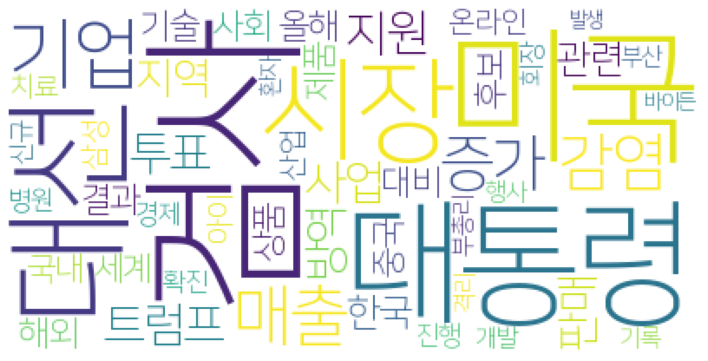

2020.11.03
[]
[]
['우리', '미국', '기업', '대선', '산업', '배터리', '중국', '규제']
['작가', '컬렉터', '아트', '부산', '갤러리', '페어', '작품', '대구', '온라인', '디자인', '경향신문', '행사', '주요', '국내외', '참여', '전이']
['부총리', '대통령', '반려', '청와대', '사표', '경제', '국회', '사의', '국민일보']
['영화']
['투표', '페어팩스', '시각', '미국', '유권자', '정도', '시작', '지금']
['시설']
['일본']
['시험', '수능', '수험생', '확진', '학생']
['건강검진', '검진', '조선', '때문']
['거래', '사기', '온라인', '피해', '중고', '연합뉴스']
['빼빼로데이', '상품', '협업', '편의점', '할인', '경향신문', '진행']
['물가', '상승', '경향신문', '지원', '소비자', '이후', '하락']
['북한', '국정원', '위원장', '노동당', '의원', '현장', '관련', '보고', '열병', '확인', '부대', '공개', '지도']
['일본']
['용의자']
['후보', '행정부', '트럼프', '미국', '바이든', '대통령', '중국', '이란', '면서', '러시아', '대선', '당선']
['버스', '마을', '운행', '지하철', '지원', '시내버스', '사정', '승객', '업체', '주민', '회사', '올해', '운영']
['운영', '사정', '마을', '버스', '운행', '지하철', '지원', '시내버스', '승객', '주민', '회사', '올해', '업체']
['방역', '북한', '대응', '국정원']
['치료']
['일본']
['경찰', '상점', '필라델피아', '사태', '약탈']
['학생', '수능', '감염', '수험생']
['윌밍턴', '후보', '바이든', '선거', '이후', '준비', '무대', '연설']
['의원', '북한',

['검사', '영국', '리버풀', '지역', '계획']
['단계', '금지', '신규']
['헬스장', '검사', '감염', '환자']
['부총리', '청와대', '대통령', '반려', '사의']
['인도']
['표명', '대통령', '부총리', '사의', '반려']
['우편', '대선', '사전투표', '투표', '출구조사', '대한', '현장', '미국', '방송사', '사전', '지지자', '컨소시엄', '조사', '시간', '결과']
['판정', '인천', '격리']
['부산']
['아이']
['관련', '동향', '국정원', '북한', '김정은', '보고', '대선', '의원', '대회', '방역', '위원장', '대해', '분석', '잠수함', '공개', '김병기', '김여정', '정보', '노동당', '가능성']
['북한', '의원']
['점자', '학생', '여사', '학교', '교육', '시각장애인']
['공간', '홈스테이', '가구', '배치', '책상', '정리정돈', '재택근무', '집안', '인테리어', '사람']
['자금', '스타트업', '창업', '올해', '취업', '분위기', '확보']
['사이트', '베팅', '운영']
['위생', '등급제']
['등급제', '위생']
['치료', '임상시험']
['주주', '감자', '아시아나', '항공', '결정', '주의', '주가', '금호']
['위험', '시설', '단계', '방역', '관리', '거리', '두기', '이용', '검사']
['검사', '정부', '리버풀', '영국']
['사교육', '해당', '운영', '학교', '플랫폼', '기업', '사업', '교육부', '학습', '참여', '과정', '에듀', '테크', '교육', '업체', '멘토링', '콘텐츠', '학생', '활용', '대해', '우려', '방식', '홍보', '사이트']
['유지', '투자자', '주주', '기준', '정부', '부총리', '논란', '동학', '개미', '주식', '도세', '개인']

['자연', '미술', '대학원', '학과', '컬러', '진행', '교육', '큐브']
['서대문', '환자']
['아시아나', '항공', '감자']
['시험', '수능', '수험생', '교육부', '별도', '확진', '병원', '당일', '응시', '판정', '이데일리', '올해', '지정', '오전']
['레슨', '학생', '교수', '수업', '연주', '음대', '전달', '대면', '진행', '제대로', '합주', '지도', '경우', '프로그램', '소리', '비대', '화성', '음악', '파악', '컴퓨터']
['부총리', '대통령', '사의', '반려']
['검사', '장관', '검찰', '총장', '개혁', '정치', '커밍아웃', '국민', '비판', '청원']
['지역', '신규', '감염', '발생']
['트럼프', '후보', '대통령', '바이든', '대선', '승리', '우리', '여론조사', '투표']
['카카오', '커머스']
['교회', '종교', '시대', '한국']
['면접', '구직']
['북한', '방역', '간사']
['부산', '사용', '병원', '마스크', '망사', '사진', '의원', '장관', '일보', '중앙']
['국정원', '북한']
['북한', '국정원']
['부총리', '정치', '의원', '책임', '공직자', '생각']
['영업', '이익', '매출', '사업']
['투자', '기업']
['부총리', '사의', '주주', '표명', '주식']
['결제', '규모', '평균', '지난해', '대비', '카드', '비대', '이용']
['데이터', '라우', '분석', '하이브리드', '시장', '클라우드', '플랫폼', '지원', '고객', '실행', '기업']
['버스', '합의', '위원회', '운수', '산업', '노사', '이번']
['업소', '방역', '핵심', '수칙', '광명시']
['단백질', '식품', '시장', '프로', '출시', '업체', '제품', '건강', '렉스']

['광주', '대구']
['호텔', '서비스', '롯데', '품질', '아이', '고객', '부문']
['오스트리아', '유럽', '테러', '봉쇄', '프랑스', '조치', '시위', '총격', '이탈리아', '반대', '현지', '시간', '발생']
['대통령', '청와대', '주주', '부총리', '재산세', '신임', '요건', '기준']
['동선', '접촉', '방역', '제주', '조사', '역학']
['후보', '건립', '수원', '국민연금', '공단', '부지', '정읍시', '내장산', '시장', '유치']
['마스크', '국내', '중국산', '박스']
['할인', '참여', '타이어', '쿠폰', '퀴즈', '증정']
['세금', '공시가격', '증세', '지사', '현실']
['재정', '건전성', '분석']
['키트', '세계', '진단', '수출', '제품', '생산']
['세계', '진단', '키트', '수출', '제품', '생산']
['의원', '선거', '우리', '위원장', '민주당', '국민', '우리당', '부산', '호남', '지지율']
['투표', '우편', '대선', '미국', '선거', '개표', '트럼프', '현장', '결과', '선거인단', '제도', '당일', '기준', '지난', '주의', '후보', '주마', '대통령', '이후', '용지', '불복', '때문']
['운영', '파업', '학교']
['카메라', '경기', '심판', '중계']
['산업', '디지털', '전환', '정부', '정책', '기업', '부처', '기술', '모델', '지원', '제조', '투자', '데이터', '뉴딜', '비즈니스', '과정', '규제', '구축', '민간']
['지역', '경제', '통합', '시도', '뉴딜']
['부산']
['중국', '올해', '두산', '두산인프라코어', '시장', '매각']
['구리', '수국', '기증', '공원']
['부산', '어르신']
['사용', '착용', '병원', '사진', '

['혁신', '디지털', '의사결정', '데이터', '라우', '기업', '지원', '코리아', '사례', '세션', '금융', '신한', '서비스', '분석', '통해', '고객', '위해', '플랫폼', '비즈니스', '솔루션', '기반']
['총격', '오스트리아', '발생', '사건']
['상담', '또래', '청소년', '부산']
['스타트업', '행사', '컴업', '창업', '온라인', '진행']
['후보', '투표', '민주당', '자정', '공화당', '대통령', '딕스빌']
['여성', '이번', '중증', '임산부', '연구', '감염', '위험', '경우', '임신', '대상', '미국']
['아이', '진단', '추출']
['공적', '지금', '비정규직', '지자체', '학교', '교실', '경남', '민영화', '교육청', '파업', '지부', '중단', '교육', '노동조합', '아이', '현관', '전국', '윤성효', '선포']
['체계', '이케아', '한국', '노동자', '근무', '노조', '글로벌', '임금', '주장', '기준', '법인', '최저임금', '착취', '스케줄', '직원', '대우', '코리아', '해외', '노동', '차별', '수당', '적용']
['방위', '대통령', '폭력', '사태', '선거', '소집', '신문', '지방', '위해']
['서비스', '일본', '배급', '코퍼스', '한류', '시장', '콘텐츠', '코리아', '플랫폼', '주요', '합병', '개발', '사업', '저작권', '보유']
['콘텐츠', '확보', '통해', '저작권', '일본', '한류', '배급', '코퍼스', '코리아', '대표', '드라마', '합병', '플랫폼', '개발', '시장', '글로벌', '아이', '확대', '제작', '자체', '웹툰']
['창업', '관련', '체납', '시스템', '괴산군', '통합']
['임상시험', '치료', '환자', '심사', '백신', '개발', '경우', '

['중소기업', '변화', '부산', '확대', '울산', '근무', '환경', '채용']
['회장', '데이터', '경영', '고객', '강조']
[]
[]
[]
[]
['진단', '허가', '제품', '바이오']
[]
['파우치', '트럼프', '대통령', '소장', '해고']
['거리', '두기', '체계', '단계', '반장', '발생']
['헌혈', '보건', '혈액']
['시범', '피온', '방역', '자율', '주행', '서비스', '운용', '모빌리티', '메이커']
['투표', '대선', '현장', '결과', '사전투표', '대통령', '트럼프', '유권자', '여론조사', '민주당', '바이든', '선거', '참여', '경합주', '날씨', '후보', '플로리다', '지난', '평가', '조사', '펜실베이니아']
['소장', '연구', '삼성', '리서치', '전자', '기술', '극복', '미국', '교수']
['연구', '삼성', '소장', '리서치', '전자', '기술', '극복', '미국', '교수']
['진행', '스타트업', '컴업', '개국', '이후', '조직', '투자']
['마을', '사업', '모집', '기업', '지역', '차년', '법인', '선정', '심사']
['학원', '검사', '강사', '지난달']
['키트', '수출', '진단', '제품', '허가']
['마스크', '정부', '비축', '생산', '업체', '시장', '지원', '업계', '대책']
['버거킹', '패스트푸드', '영국', '이용', '법인']
['현대', '중공업', '지역', '장학금', '어머니', '학생']
['헬스장']
['교부', '사업', '확보', '증액']
['청소년', '상담', '복지', '센터', '중학교', '심리검사', '프로그램']
['위험', '수능', '시험', '방역', '부총리', '학교']
['집회', '여사', '학생', '청와대', '학교', '인근', '고통', '점자']
['편성', '교육']
[

['조사', '서귀포시', '관광객', '관광', '제주', '가장', '여행', '이용', '자연', '감상']
['진단', '키트', '제품', '허가', '수출']
['입원', '부산', '환자']
['통합', '지역', '전남', '시도', '지사', '사업', '뉴딜']
['사업', '업계', '지난', '참여', '결제', '마케팅', '카드', '외식', '추가', '활성화', '하나카드']
['체험']
['감사', '종합', '은행', '연합', '금융위', '이번']
['대해', '광주시', '정책', '대응', '취약', '계층', '시민', '긍정', '만족도']
['마스크', '국내', '유통', '업체', '시장', '불법', '수입', '위해', '지원']
['출자', '도쿄도', '입자', '인구']
['확진', '판정', '서울시']
[]
['청소년', '체험', '운동', '화순', '홈트', '활동', '꾸러미', '제공']
['월마트', '로봇', '재고', '보사노바', '매장', '로보틱스', '확인']
['생산']
['종사', '불안', '우울', '결과', '근무', '의료', '환자', '대한', '위험', '감염']
[]
['고용', '협의', '고용노동부', '중소기업', '유지', '원금', '구성', '본부', '중앙회']
['당뇨', '이상', '입원', '사망', '혈당', '감염', '질환', '위험', '바이러스', '당뇨병', '보고', '중증', '진행', '가장', '취약', '환자', '병원', '예후', '관리', '고혈압', '조절', '내과', '영향', '교수', '경우', '영남대', '대한']
['재외동포', '재외동포재단', '의원', '한인', '이사장', '김성곤', '세계', '신임', '국회의원', '연합', '민주', '권익', '회의', '임명']
['스페인', '프랑스', '기록', '신규', '발생', '검사', '지난', '수가']
['프랑스', '발생', '수가', 

[]
[]
[]
[]
[]
['감염', '국내', '방역', '선제', '검사', '연속', '시설']
['무증상', '사례', '퇴원', '본토', '확진']
[]
[]
['수도권', '지역', '발생']
['캠프', '조기', '트럼프', '승리', '선언', '대통령', '투표', '주장', '대선']
['시간', '사용', '작년', '이용', '증가']
['이데일리']
[]
[]
[]
['국내', '환자', '확인']
['로봇', '월마트', '보사노바', '매장', '관리', '관계자']
[]
['이용', '한국인', '시간', '지난해', '유튜브', '분석', '올해']
['수도권', '지역', '신규', '부산']
['지역', '수도권', '신규', '부산']
[]
[]
[]
['사무', '브러', '수스', '총장', '접촉']
['노사', '현대차', '회장', '발전', '산업', '부장', '회사', '관계', '조합원', '노력', '변화', '울산', '사업', '임금', '위해', '미래']
['신규']
[]
['상가', '증가', '실률', '지난', '대비', '지역', '기록', '분기', '시장', '가장', '침체', '전국', '상권', '아이', '분위기']
['베트남', '의장', '한국', '관계', '양국', '협력', '노동자']
[]
[]
[]
['회장', '회사', '노사', '현대차', '울산']
['부산', '노동권', '센터', '부산시']
[]
['사업', '국내', '인터넷', '주년']
['시스템', '한화', '사업']
['트럼프', '우편', '대통령', '대선', '바이든', '투표', '후보', '대해', '결정', '주장']
['시스템', '한화']
['청소년', '교육', '활동', '대학생', '환경', '화학', '멘토']
['아토', '피부', '코스', '아모레퍼시픽', '그룹', '장벽', '성분', '라마']
['두산인프라코어', '중국', '시장', '굴착기', '생산', '

['미국', '총리', '방미', '일정', '대통령', '당선', '일본', '내년', '정부', '방문']
['내년', '미국', '총리', '방미', '일정', '대통령', '당선', '일본', '정부', '방문']
['생산', '혈장', '치료', '녹십자', '의료', '완치', '기관']
['치료', '생산', '혈장', '녹십자', '의료', '완치', '기관']
['출구조사', '선거', '투표', '올해']
['김치', '김장', '조선', '수출']
['검사', '국민', '슬로바키아', '실시', '판정']
['하락', '물가', '승률', '동월', '개월', '대비', '통신비', '서비스', '품목', '소비자']
['제안', '중앙', '우수', '선정']
['용의자', '공격', '경찰', '테러', '발생', '이번', '오스트리아', '사건', '총격', '우리', '여러']
['딸기', '진심', '카페']
['물가', '지난달', '기록', '품목', '소비자', '제외', '대비', '마이너스', '동월', '승률', '지수']
['치료', '병원', '녹십자', '혈장', '의료', '기관', '생산', '목적', '사용']
['민주당', '영역', '경선', '복지', '탄소세', '진짜', '생각', '이재명', '상황', '국민', '우리', '보수', '지지율', '원칙', '질서', '경기도', '방법', '경제', '출마', '대선', '사회', '국가', '탄소', '검찰', '지금', '진보', '대한', '사람', '문제', '지지', '기본소득', '후보', '화석', '성과', '권우', '때문', '오마이', '지사', '하나', '권력', '정책', '과거', '대해', '검사', '노동']
['광주']
['광주']
[]
['신규', '환자']
['부산', '여행', '상품', '지원', '예약']
['할인', '쿠폰']
['교육', '강화', '시설', '마이스', '마케팅']
['샤넬', '가격

['후보', '사무', '총장', '통신', '오콘', '알라', '회의']
['백신', '내년', '상파울루', '아스', '시작', '생산', '부탄', '연구소']
['백신', '내년', '상파울루', '아스', '시작', '생산', '연구소', '부탄']
['일본', '평가', '전문가', '수집']
['일본', '평가', '전문가', '수집']
['선거', '현장', '출구조사', '투표', '방송사', '올해', '사전투표', '대한', '유권자', '신뢰', '결과', '조기', '조사', '선거일', '예측', '우편', '때문']
['증상', '서북구', '호흡기', '전담', '클리', '병원', '진료', '보건소', '천안', '환자']
['일본']
['시상식', '국제', '환경상', '아시', '한국', '사진']
['다음']
['진단', '키트', '항원', '셀트리온', '미국']
['회장', '세계', '지역', '월드비전', '사업', '한국', '난민', '아동', '모금', '구호', '전쟁', '후원', '지금', '후원자', '자원', '지원']
['온라인', '교육', '사람', '정부', '대면', '우리', '다른', '문제', '변화', '시간', '역할', '때문', '교수', '접촉', '노멀']
['네이버', '결제', '페이', '오프라인', '온라인', '포인트', '서비스', '매장']
['상어', '조회', '세계', '유튜브', '대표', '아기']
['러시아', '푸틴', '지방', '현지']
['제품', '기능', '위생', '살균', '주방용품', '도마', '서비스', '관리', '칫솔', '세균']
['건설', '디지털', '전환']
['시위', '스페인', '유럽', '사망자', '마드리드', '프랑스', '치료', '환자']
[]
['미세먼지', '단속', '차량', '전국', '배출', '가스', '농도', '계절', '올해', '부과', '조치', '기간', '경우', '계획', '이

['사회', '경남대', '복지관']
['사업', '이익', '지난해', '건설', '매출', '영업', '주택', '실적', '기록', '신규', '동기', '올해', '대형', '증가', '해외', '수주', '산업', '확보', '국내']
['매출', '영업', '이익', '사업', '실적']
['신규', '기준', '거주', '발생', '경로', '증가', '감소', '지역', '관련', '해외', '국내', '수도권', '기록', '환자', '아산', '입국', '일일', '지난달', '판정', '헬스장', '강남구', '제외', '유입', '감염', '확진', '천안', '충남', '인천', '최근', '사우나', '추가', '사례', '광주', '전일', '주점']
['금융', '기술', '평가', '대출', '은행', '레벨', '심사', '중소기업', '기업']
['발전', '기술', '전력', '효율', '개발', '신재생에너지', '운전']
['물가', '지원', '하락', '통신비', '상승', '소비자', '영향', '대비', '이후', '신선', '가격']
[]
['빼빼로데이', '빼빼로', '롯데', '제과', '매출', '소비', '업계', '학교', '불매운동', '평일', '과자']
['빼빼로데이', '빼빼로', '롯데', '제과', '매출', '소비', '업계', '학교', '불매운동', '과자', '평일']
['원유', '상승', '경제', '선물', '유가', '버스', '미국', '하락', '수익률', '대선', '매수', '신한', '기록', '지난', '최근', '연속']
['백신', '코백스', '사노피', '세계', '글로벌']
['교육부', '시간', '시도', '시험', '수험생', '수능', '오전', '확진', '대책', '상황', '이동', '위해', '시행', '소음', '격리', '마련', '발생', '운행']
['재단', '경제', '금융', '교육', '아이', '청소년', '특성화고', '나눔',

['매출', '영업', '이익', '기록', '사업']
['노컷뉴스', '지원', '대응', '위해', '탄자니아', '달러']
['매출', '영업', '이익', '기록', '사업']
['아이', '반도체', '증가']
['아이', '증가', '반도체']
[]
['키트', '진단', '수젠텍', '공급', '계약', '항원', '독감', '독일']
['인천']
['검사', '한국', '중국', '출발', '승객', '경유', '입국', '경우']
['서비스', '통신', '통합', '코어', '기술', '국내', '구축', '장비', '도입', '제공', '기업', '네트워크', '수용']
['남해', '코스', '개통', '완보']
['대한', '방역', '체험', '의료기기', '무료', '지침', '세부']
['수험생', '문제', '대학', '풀이', '수능', '시험', '올해', '교육청', '공부', '방역', '따라서']
['백신', '코백스', '퍼실리티']
['아이', '신규']
['수능', '시험', '교육부', '오전', '수험생', '병원', '치료', '관리', '시도']
['체험', '방역', '의료기기', '무료', '생활', '위해', '이상', '지침', '준수']
['산업', '변화', '노사', '현대차', '회사', '발전', '미래', '회장', '관계', '부장', '안정', '조합원', '협력', '공동', '공장', '노력', '자동차', '품질', '위해', '노조', '임금', '울산', '고용', '사회']
['경향신문', '이후', '물가', '하락', '상승', '소비자', '정부', '지원']
['오전', '시험', '수능', '수험생', '전인', '시간']
['교수', '계명대', '포럼', '트렌드', '디자인', '이번', '미술']
['관광']
['관광']
['도심', '융합', '특구', '예산', '광주', '사업', '반영']
['공장', '이익', '전기차', '매출', '사업', '증가'

['시도', '시험', '수험생', '수능', '시행', '확진', '교육부', '격리', '병원', '응시', '위해', '운행', '지정', '오전', '소음', '방역', '상황', '대책', '별도']
['시험', '수험생', '수능', '오전', '교육부', '응시', '교육청', '격리', '확보', '차량', '이동', '시도', '발생', '자가', '대책', '상황', '위해', '요청', '당일', '시행', '시간', '경우']
['부산']
['전날', '감염', '관련']
['성인', '다시', '전파', '학교', '아이', '지역', '경우', '바이러스', '사회', '발생', '로버트', '감염', '데이터', '나이', '증가', '어린이', '집단', '하스', '분석', '미국', '박사', '가능성', '과학']
[]
['업체', '지원', '관광', '부산']
['지원', '관광', '부산', '업체']
['당일', '시험', '수능', '수험생', '오전', '시간', '교육부']
['모빌리티', '국토부', '권고', '택시', '차량', '허가', '업계', '서비스', '혁신', '운송', '시장', '플랫폼', '납부', '업체', '대수', '기여']
['신규', '하루', '감염']
['벡스코', '무역', '부산', '행사', '수산', '수산물', '엑스포', '참여', '상담', '예정', '온라인', '기업', '진행', '주관', '국제', '한국', '국내', '개최', '전달']
['서비스', '시스템', '한화', '사업']
['시행', '시험', '수능', '수험생', '격리', '확진', '대책', '자가', '오전', '준비', '별도', '치료', '발생', '당일', '관리', '병원', '응시', '지정', '시도']
['중국', '시장', '두산인프라코어', '굴착기', '생산', '기록', '고객', '기업', '사업', '희망']
['유권자', '투표', '사전투표', '우편', 

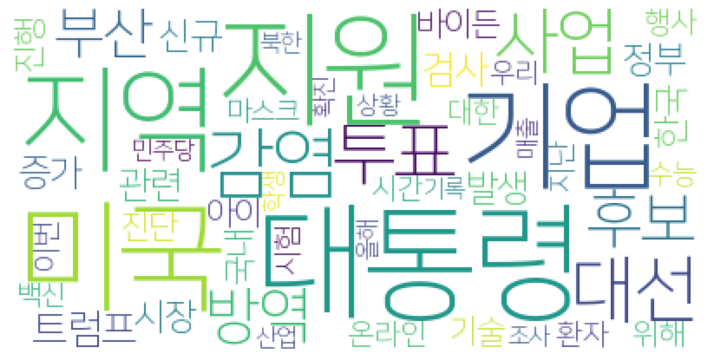

2020.11.02
[]
['인구', '증가', '진천군', '충북']
['충북', '백신']
[]
[]
[]
['시위', '봉쇄', '스페인', '이탈리아', '정부']
['안전', '여행', '체크', '리스트', '경향신문', '하나투어']
['시장', '전세']
['식약처', '규제', '과제', '개발', '지원']
['미디어', '개최', '교류', '방송', '콘텐츠', '행사', '아이', '온라인', '전략', '한국어', '제작']
['실적', '라면', '수출', '김치', '경향신문', '식품']
['확진', '감염', '사우나', '아산', '포차', '업주', '집단', '천안']
['대책', '주택', '부동산', '전세', '실장', '시장', '정부']
['시장', '전세', '주택', '대책', '김상조', '실장', '정부', '대해', '부동산', '재산세', '생각', '가지']
['시장', '전세', '실장', '안정', '대책', '주택']
['방호복', '간호사', '환자', '인력', '간호', '병동', '의료', '경향신문', '기준', '근무']
['투표', '내일', '결과', '플로리다']
['확진', '추가', '관련', '감염', '판정', '접촉', '지난달', '강남구', '가족', '검사', '헬스장']
['추가', '관련', '확진', '감염', '판정', '접촉', '강남구', '지난달', '가족', '헬스장', '검사']
['이사', '계좌', '옵티머스', '스킨', '조선']
['전세', '실장', '시장', '대책', '주택']
['고용', '감소', '소득', '특고', '프리랜서', '신청', '원금', '긴급', '경향신문', '사람', '보험']
['원금', '긴급', '소득', '특고', '프리랜서', '감소', '신청', '경향신문', '보험', '고용', '사람']
['한국', '중국', '승객']
['소장', '대선', '파우치', '트럼프', '해임']
['간호사', '간

['교회', '하나님', '전달', '세계', '성금', '지역', '구호', '지원', '봉사', '피해']
['대통령']
['기록', '실적', '녹십자', '매출', '사업', '백신', '분기', '증가', '부문']
['핸드', '크림']
['경제', '대통령', '회복', '문재인', '우리', '연합뉴스']
['단편', '영화제', '극장', '상영', '광주', '여성', '부문', '온라인', '경쟁', '영화', '직위']
['교육', '편성', '무상교육', '예산', '학교', '조성', '경기도', '교육청', '대비', '미래', '수입', '운영', '이전', '사업', '환경', '고교']
['경향신문', '부총리', '행사']
['단지', '분양', '가구', '전망', '청약', '상제', '경쟁률', '적용', '공급']
['러시아', '스노', '망명', '미국', '국적', '모스크바', '거주']
['포스트', '국가', '우리', '정부', '시대', '자유', '경제', '대기업', '격차', '기업', '개혁']
[]
[]
['터키', '그리스', '피해']
['시설', '재활', '요양', '감염', '경기도', '노인', '취약', '위험', '병원']
['효성', '시장', '유럽', '글로벌', '생산', '스판덱스', '터키', '증설', '티앤']
['타이어', '한국', '증가', '판매', '인치', '소비자']
['증가', '기아차', '판매량', '현대차', '판매', '동월', '대비', '해외', '감소', '수출', '기록', '한국', '대로', '개사', '시장', '비교', '실적', '회복', '국내']
['아동', '방임', '학대']
['삭감', '예산', '심사', '예산안', '사업', '내년', '규모', '한국판', '뉴딜', '야당', '국가채무']
['응답', '감정노동', '증가', '콜센터', '회사', '업무', '노동자', '교육', '지원', '보호', '센터',

['시설', '경기도', '감염', '위험', '의료', '관련', '집중', '요양', '대한', '검사', '복지', '재활', '환자', '긴급']
['진행', '사업', '프린팅', '퇴직', '희망', '인력', '부문', '통해', '관련']
['퇴직', '사업', '프린팅', '희망', '인력', '부문', '통해', '관련', '진행']
['환자', '확진']
['위생', '살균', '제품', '주방용품', '기능', '도마', '서비스', '관리', '칫솔', '세균']
['경제', '세계', '포스트', '전망', '기업', '한국']
['판매', '완성', '증가', '작년', '국내', '실적', '대로', '감소', '수출', '해외', '급감', '모두', '기록', '대비', '기간']
['분기', '부문', '녹십자', '매출', '실적', '이익', '영업', '기록', '증가']
['르노', '판매', '전월', '대비', '실적', '수출', '증가']
['판매', '르노', '전월', '대비', '실적', '수출', '증가']
['아이', '위로', '감사', '사연', '대한', '친구', '팔로워', '우리', '사랑', '닉네임', '포스트', '마음', '정말', '엄마', '가족', '사람']
['배달', '사업', '기업', '공공', '시민', '상황', '모델', '플랫폼', '영역', '수수료', '서비스', '노동', '주목', '인지', '소비자']
['미국', '글로벌', '후보', '트럼프', '대통령', '유럽', '지수', '봉쇄', '인수']
['단계', '수도권', '강원', '감염', '두기', '시설', '전국', '이상', '집단', '거리', '발생']
['강원', '단계', '감염', '시설', '전국', '이상', '거리', '두기', '집단', '발생', '수도권']
['공연', '안성맞춤', '아트']
['감염', '발생', '시설', '검사', '수가', '추가', '지난달', 

['경제', '대통령', '수출', '우리', '제조업', '회복', '더욱', '강조', '강국', '위기', '반등', '성장', '증가', '발견']
['사용', '발행', '지역화폐', '상품권', '제주도', '지역', '전주시', '제주', '카드', '가맹', '조례']
['행사', '갤러리', '대구', '작가', '미술', '아트', '올해', '개최']
['여행객', '여름', '캠핑', '여행', '국내', '거리', '두기', '사람', '인기', '관광', '업계', '올해', '캠핑장', '매년', '아웃도어', '여행지', '해수욕장', '휴가', '완도', '여행사']
['경남', '마이스', '온라인', '녹지', '단체']
['아이', '사내', '레이스']
['소득', '일자리', '지원']
['일자리', '소득', '지원']
['전남', '판정', '검사', '지난달', '확진', '접촉']
['호흡기', '전담', '클리', '진료', '병원', '환자', '한국']
['제주', '국비', '확보', '예산', '국민', '협의', '국회', '제주도', '지원', '현안', '사업', '정책', '계획', '진행']
['치료', '전북']
['헌혈증', '전달']
['개인', '지수', '하락', '아이', '불확실', '레버리지', '종목', '매수', '코스피', '상승', '투자자']
['태백시', '보고', '회의']
['동기', '매출', '증가', '녹십자', '백신', '실적', '분기', '최대', '영업', '이익', '대비', '기록']
['경제', '수출', '대통령', '위기', '이후', '기록', '실적', '증가', '우리', '제조업', '더욱', '회복', '개월', '노력', '제조', '반등', '플러스', '산업', '모두', '방역', '강국', '상황', '세계', '지속', '뉴딜', '혁신', '동안', '생산', '위축', '모범', '성장', '정부', '평균', '국가', 

['지원', '복지', '실업자', '소득', '사업', '고용', '장기', '공단', '급여', '취업', '구직']
['특고', '감소', '급여', '수급', '소득', '고용', '프리랜서', '근로자', '원금', '긴급', '구직', '임금', '경우', '보험']
['에너지', '기술', '행사', '온라인', '활용']
['경기도', '국회', '아파트', '라며', '지사', '이재명', '주택', '의원', '공급', '예산', '대출', '추진', '사람', '대해', '가장']
['시장', '대선', '투자자', '증시', '이후', '트럼프', '대통령', '투자', '전망', '결과', '누가', '선거']
['조치', '극단', '봉쇄', '증가', '영국', '선택', '전문가', '서한']
['검사', '시설', '확인', '종사', '정부', '진행', '환자', '병원', '수도권']
['한국', '회장', '전국', '단체', '유통', '중앙회', '중소', '상인', '경제', '자영', '업자']
['제조업', '대통령', '경제', '수출']
['지원', '환경', '기업', '조사', '충북도', '애로']
['기업', '지원', '조사', '충북도', '환경', '애로']
['사업', '지원', '방문', '신청']
['수입', '교육청', '감소', '예산', '교육', '학교', '편성', '환경', '조성', '경기도', '이전', '사업', '운영', '재원', '대비', '지원', '고교', '위해', '미래']
['시험']
['광주', '영화제', '여성', '감독', '극장', '상영', '영화', '통해', '작품', '춘희', '진행', '토크', '위로', '집행', '심사', '관객', '공감', '개막', '세상', '위원장']
['중소기업', '기업은행', '방문']
['감염', '취약', '방역', '선제', '검사', '시설', '전국', '무증상', '환자', '병원', '증상', '

['콘텐츠', '전시회', '광주', '행사', '인공', '지능', '동영상', '서비스', '문화', '한국', '센터', '산업', '게임', '아트', '온라인', '개최', '인터넷', '체험', '주관', '주제', '방송', '국내', '투자', '통해']
['콘텐츠', '전시회', '광주', '행사', '인공', '지능', '동영상', '서비스', '게임', '온라인', '주관', '주제', '문화', '방송', '체험', '개최', '인터넷', '산업', '아트', '한국', '투자', '국내', '센터', '통해']
['마스크']
[]
['김장', '구매', '지난해', '김치', '응답', '올해', '포장', '가장', '계획', '차지', '구입', '횟수', '포기', '이유', '상승', '부담', '증가', '대한', '답변', '질문', '집밥']
['경기도', '투입', '경기', '복지', '사업', '경제', '증가', '분야', '대비', '반영', '지원', '올해', '편성', '예산안', '기본소득', '민선']
['지원', '중앙회', '중소기업', '김정우']
['시험', '수험생', '교육청', '부산', '모든', '방역', '이상', '마스크']
['중소기업', '지원', '중앙회', '판로', '조달']
['충남', '환자', '요양', '시설', '검사', '병원', '감염', '실시', '수도권', '방역', '관리']
[]
['차세대', '디지털', '채용', '티맥스', '프론티어', '인력', '부문', '마케팅', '컨설팅', '소프트웨어', '전형']
['자료', '영세', '교사', '소득', '고용', '특고', '프리랜서', '원금', '매출', '올해', '감소', '대상', '평균', '긴급', '안정', '수준', '사람', '직종', '방문', '사태', '신청', '가장', '보험', '자영', '업자']
['렉스', '운동', '단백질']
['직원', '창립', '기념', '행사

['훈련', '미세먼지', '환경부', '상황', '농도', '모의', '점검', '발생', '대응', '차관', '조치', '시행', '한강']
['미세먼지', '훈련', '환경부', '농도', '모의', '상황', '경보', '시행', '점검']
['세자', '교사', '노컷뉴스', '이상', '소득', '특고', '감소', '수급', '보험', '원금', '긴급', '하위', '프리랜서', '해당', '휴직', '비교', '경우', '영업', '종사', '비율', '방문', '고용', '직종', '확인']
['수급', '방문', '소득', '특고', '감소', '보험', '원금', '긴급', '비율', '노컷뉴스', '하위', '휴직', '프리랜서', '경우', '종사', '교사', '고용', '해당', '직종', '영업', '이상', '비교', '확인', '세자']
['수급', '감소', '자료', '보험', '특고', '프리랜서', '업자', '매출', '긴급', '고용', '소득', '자영', '파악', '경우', '가장', '영세', '하위', '평균', '여성', '제출', '이하', '종사', '원금', '관련']
['디지털', '정부', '네이션', '장관', '회의']
['훈련', '미세먼지', '상황', '환경부', '시행', '농도', '모의', '점검', '조치']
['코웨이', '인재']
['관련', '시설', '최초', '조사', '추가', '가족', '검사']
['소프트웨어', '교육', '인공', '지능']
['긴급', '영업', '소득', '특고', '프리랜서', '종사', '비율', '신청', '직종', '보험', '관련', '세자', '감소', '원금', '고용', '별로']
['훈련', '모의', '미세먼지', '환경부', '농도', '상황', '점검', '조치', '시행']
['디지털', '정부', '네이션', '장관', '대응', '헌장']
['체험', '교육', '소프트웨어', '온라인', '인공', '지능', '행

['단계', '거리', '두기', '방역', '지침', '상황', '지적', '체계', '기준', '전국', '유행', '개편', '조정', '이상', '경제', '수도권', '대해']
['포럼', '학습', '삼성', '교수', '기술', '전자', '연구자', '미국', '분야', '발표', '부회장', '대학교', '연구', '주제', '문제', '세계']
['배달']
['지역', '대구시', '환자', '검사', '관련', '발생', '현재', '확진', '감염', '발표', '진료', '시행', '조사', '판정', '추가']
['평가', '항공', '항목', '정시']
['중심', '교회', '신도', '예수']
[]
['기념', '전자', '회장', '부회장', '직원', '위해']
['부산', '사회', '지원', '기업', '경제', '펀딩', '지역', '금융', '기금']
['코웨이', '인재', '지원', '통해']
['산업', '임대료', '인하', '단지', '지원']
['퇴원', '사례', '본토', '확진', '무증상']
['서비스', '고객', '배달', '킹크랩', '백화점', '랍스터', '대게', '마리', '직접', '현대', '지역', '오후', '투홈']
['은행', '수협', '사회', '활동']
['아동', '응답', '부모', '조사', '결과', '기아', '대책', '생활']
['분권', '부산시', '지방', '추진', '자치', '전국', '협의', '부산', '메가시티', '관련', '회의', '토론회', '정책']
['국내']
['호날두', '후반', '세리에']
['호날두', '후반', '세리에']
['전날', '지역', '누적', '기준', '경기', '지난달']
['시설', '단계', '방안', '방역']
['단계', '해외', '전날', '지역', '감염', '가운데', '신규', '유입', '검사', '경기', '누적', '지난달', '발생', '수도권', '시설']
['최대', '구매', '고

[]
['코스', '걷기', '한강', '린지', '참여', '시민', '방역', '시청']
[]
['치료', '임상시험', '항체', '셀트리온', '클론']
['부산시', '분권', '지방', '자치', '전국', '협의', '추진', '정책', '부산', '이번', '메가시티', '관련', '토론회', '회의']
['책임', '거리', '맞춤', '실천', '방역', '대응', '두기', '개별', '분권', '발표', '자율', '지역', '정부', '지자체', '분권화', '자유', '상황', '지금', '조건', '주체', '경제', '사회', '기사', '내용', '개인', '준비', '대책']
['의원', '연구원', '민주당', '친문', '정부']
['파주시', '확진']
[]
['교회', '신도']
['면책', '회생', '특별', '법원', '신청', '절차']
['이익', '개선', '영업']
['사회', '단계', '거리', '두기', '정부', '핼러윈데이', '상황']
['백신', '접종']
['민원', '접수', '시험', '수능', '관련', '불편', '건의', '수험생', '문의', '발생']
['데이', '이벤트', '매일', '행사', '구매', '온라인', '고객', '할인', '상품', '쿠폰', '혜택', '이상', '최대', '증정', '플러스', '제공', '통해', '오후', '홈플러스']
['파주시', '확진', '가족', '고양시']
['구마모토시', '교류', '도시', '산시', '우호', '협력', '시장', '분야']
['용건', '자전거', '세종시', '어울링', '수단']
['선거', '자신', '트럼프', '투표', '대통령', '당일', '대선', '개표', '승리', '바이든', '공화당', '선언', '결과', '신기루', '계획', '민주당', '우편', '경우', '오스', '선거인단', '가능성', '현장']
['앨범', '내년', '증가', '판매량', '공연', '실적']
['백

['흑인', '미국', '사건', '유권자', '오바마', '트럼프', '선거', '지난', '대선', '올해', '바이든', '민주당', '투표', '이상', '백인', '시위', '대통령']
['감염', '당국', '사회', '기준', '단계', '방역', '거리', '두기', '상황', '경제', '발생', '수도권', '세분', '유행', '대규모', '전국', '정부', '위험', '조치', '국민']
['평균', '자동차', '수출', '증가', '개월', '감소', '경제', '플러스']
['감염', '매일신문']
['사건', '이춘', '법정', '재판', '증인', '출석', '법원', '재심', '방청', '윤씨', '위해']
['시설', '발생', '전날', '단계', '감염', '수도권', '집단', '핼러윈데이', '두기', '최근', '전국', '방역', '이상', '거리']
['조치', '위험', '시설', '병상', '유행', '수도권', '이상', '제한', '기존', '상황', '모임', '착용', '평균', '개편', '방역', '거리', '권역', '활동', '강화', '중앙', '증가', '과태료', '금지', '격상', '경우', '기준', '의무', '다른', '등교', '경제', '단계', '두기', '사회', '우리', '실외', '발생', '미만', '대응', '행사', '체계', '마스크', '입장', '중점', '수준', '식사', '재택근무', '인원', '전국', '조정', '적용', '정부', '실내', '인구', '본부', '스포츠', '중단', '영상', '관리', '대본', '지속', '경기', '고려']
['프리미엄', '카드', '부가', '서비스', '적립', '혜택', '출시', '할인', '포인트']
['올해', '때문', '이직', '조종사', '전역', '공군', '항사', '신청', '이후', '진급', '베테', '채용', '매년', '항공사', '숙련']
['단계', '정부', '위

['파티', '공연', '관객', '배우', '뮤지컬', '영상', '각각', '변화', '사람', '킬러', '참여']
['달성', '건설', '한국', '테크놀로지', '매출', '영업', '이익', '실적']
['항공', '항공기', '과징금', '예방']
[]
['진단', '키트']
['자전거', '이용', '세종시', '어울링', '이후', '경향신문', '사태', '사람', '건수']
[]
['대출', '규제', '금융', '부위', '원장', '경제', '금융위', '금융정책', '당국', '국장', '관리']
['성장', '봉쇄', '재개', '유럽', '경제', '유로존', '전망', '시위', '영국', '지난달']
['경제', '대선', '후보', '당선', '바이든', '연구원', '결과', '대통령', '트럼프', '영향', '금융', '경우', '미국']
['격리', '검사', '중심', '교회', '관련']
[]
['디지털', '산업', '전환', '한국']
['루크', '디자인', '브랜드', '현대차', '그룹', '담당', '동커볼케', '부사', '유럽', '커뮤니케이션', '모빌리티', '역할', '업무', '시장']
['렉스', '운동']
['수입', '지원', '대비', '편성', '예산', '교육', '학교', '환경', '조성', '이전', '교육청', '무상교육', '미래', '운영', '경기도', '내년', '사업', '위해', '고교']
['유럽', '역할', '디자인', '브랜드', '현대차', '그룹', '담당', '루크', '동커볼케', '부사', '커뮤니케이션', '업무', '모빌리티', '시장']
['부담', '고용', '유지', '원금', '지원']
['공연', '공사', '주민', '참여', '행사', '참가']
['수주']
['디자인', '사회', '포럼', '국제']
['관련', '서울시', '감염']
[]
['진단', '항원', '키트']
['수주', '한국', '조선해']
['자전거', '도로

['코웨이', '인재']
[]
['경제', '일본', '지사', '한국', '한일', '자신', '문제', '대해', '기업']
['대표', '잡지', '전문']
['학생', '학교']
['기술', '출원', '특허', '정화', '공기', '항균항', '바이러스', '실내', '국내']
['전날', '가운데', '지역']
['가구', '소득']
['가격', '인상', '샤넬', '명품', '백화점', '지난', '클래식', '브랜드', '매출', '국내', '인기']
['학생', '학교']
['학생', '학교']
['학생']
['의료', '환자', '치료']
['파우치', '소장', '미국', '트럼프', '대통령', '백악관', '대응', '대해']
[]
['도서관', '부산', '오후', '운영', '오전', '부산시', '개관', '시민', '자료', '공간', '대표']
['하나은행', '서비스', '근로자', '선지']
['윌리엄', '왕자', '왕실']
['신청', '지원']
['지원', '신청']
['인재', '코웨이']
[]
['부회장', '회장', '기업', '삼성', '창립', '메시지', '경영', '우리', '행사', '이건희', '구축', '사회', '기념', '통해', '직원', '도전', '행보', '경우', '주년', '별도', '대표이사', '인사', '전자', '미래', '지난해']
['아이', '하나은행', '급여', '선지', '서비스', '통해']
['미국', '셀트리온', '진단', '키트']
['소득', '가구', '위기', '긴급', '신청', '지원']
['가구', '위기', '긴급', '신청', '지원', '소득']
['진단', '미국', '셀트리온', '키트', '계약', '체결', '신속', '항원']
['진단', '미국', '셀트리온', '키트', '계약', '체결', '신속', '항원']
['하양', '지점', '농협', '판정', '검사']
['관련', '업체', '누적', '병원']
['급여', '선지

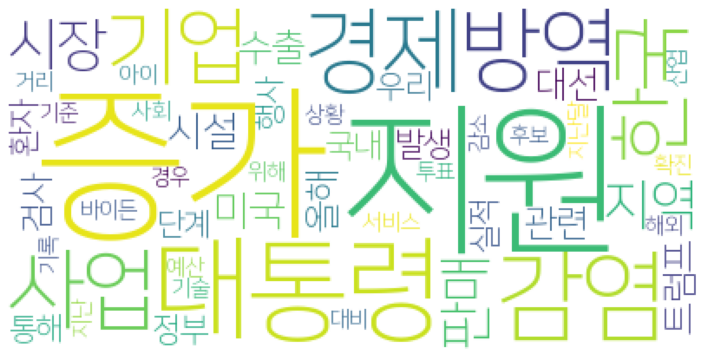

2020.11.01
['프랑스', '아시아']
[]
['도쿄', '지난달', '감염', '일본']
[]
['관리']
[]
[]
['일산화탄소', '텐트', '사고', '난방', '중독', '사용', '위험', '야영장']
['거리', '두기', '중점', '위험', '단계', '시설', '금지', '관리', '방역', '집합', '체계', '감염', '적용', '운영', '중단', '마스크', '기준']
['프랑스', '중국인', '아시아', '중국']
['감염']
['감염', '확인', '확진', '포장마차', '사우나', '방역', '당국']
[]
['방산', '기업', '온라인', '해군', '창원', '수출', '행사', '오아시스', '이번', '해외', '글로벌', '참여', '미래', '산업', '기술', '공동', '개최', '한국']
['양평군', '양평', '상공', '지원', '신청']
['트렌드', '소비자', '분석', '대중', '변화', '소비', '대한', '사람', '전망', '상황', '시대', '사회', '모니터', '가장', '중심', '생각']
[]
['제주']
['수준', '달러', '보험', '환율', '상품', '외화', '투자', '금융', '보험금', '약세', '보험료', '예금', '현재', '경향신문', '금리', '주의', '원화']
[]
['건축가', '건물', '공간', '정원']
['호빵', '제품', '경향신문', '샴푸']
['가전', '소비자', '전자', '컬러', '인테리어', '냉장고', '맞춤', '색상', '백색', '조합', '제품', '부문', '출시', '경향신문', '취향', '스포크']
['행사', '진행', '온라인', '할인', '경향신문', '최대']
[]
['확진', '가족', '함평', '원격', '수업']
['단계', '이상', '주간', '수도권', '전국', '발생', '격상', '상황', '유행', '환자', '기준', '체계', '일일', '수준', '의료', 

['단계', '시설', '수도권', '방역', '적용', '조치', '이상', '관리', '거리', '강원', '제주', '두기', '부산', '전국', '고려']
['오바마', '조선', '트럼프', '바이든', '유세', '대통령']
['트럼프', '바이든', '오바마', '유세', '조선', '대통령']
['서면', '부산', '핼러윈', '데이', '제대로', '술집']
['전달', '연탄', '물품', '한수원', '부산']
['부산', '감염', '추가']
['우편', '투표', '대선', '선거', '도착']
['개방', '북악산', '대통령', '탐방', '둘레길']
['판정']
['단계', '수도권', '거리', '두기', '전국', '이상', '상황']
['스파이어', '미국', '브랜즈', '프랜차이즈', '던킨', '배스킨라빈스']
['예산안', '뉴딜', '예산', '사업', '국회', '심사', '한국판', '국민', '삭감', '문재인', '처리', '지난달', '정부', '펀드']
['영화제', '올해', '관객', '부산', '감독', '진행', '경험', '행사', '온라인', '때문']
['방역', '체계', '단계', '거리', '두기', '부산', '개편', '대응', '경제']
['도쿄', '지난달', '감염', '일본']
['도쿄', '일본', '지난달', '감염']
['일자리', '일루', '부산', '부산시', '정책']
['미국', '확산', '증시', '기업', '대한', '투자', '재정정책', '가능성', '침체', '대응']
['영화제', '영화', '관객', '질문', '김민우', '온라인', '작품', '상황', '예매', '연구원', '김채', '상영', '부산', '올해', '김충', '섹션', '연구소', '문관', '강지원', '진행', '국제', '소장', '일보', '시스템', '주화']
['에디', '판화', '부산', '알리앙스', '세계', '데이비드', '호크', '리지', '대표', 

['소비', '소비자', '대한', '지역', '마늘']
['자주', '전문점', '매장', '브랜드', '라이프스타일', '마트', '성장', '확대', '대표', '스타벅스']
['그룹', '당국', '금융', '대손충당금', '올해', '충당금', '적립', '사모펀드', '지난해', '은행', '대비']
['시설', '경우', '유행', '단계', '방역', '거리', '두기', '금지', '사회', '관리', '체계', '수도권', '정부', '실내', '제한', '이번', '개편', '설명', '집합']
['조사', '조사원']
['재정', '기준', '준칙', '한국', '사태', '중앙은행', '노멀', '정부', '통화', '때문', '관리', '요건', '이후']
['중국']
['택시', '리스', '전국', '기사', '업계', '노동조합']
['현지', '캐나다']
['찾기', '쇼핑', '할인', '상품', '오전', '행사', '백화점', '진행', '온라인', '초특', '자체', '올해', '마트', '코세', '코세페', '경우', '코리아']
['두기', '단계', '기존', '거리', '방역', '세분', '기준', '전국', '시설', '사회']
['주택', '지난달', '금융', '대출', '증가', '은행', '관리', '신용', '규제', '가계']
['비상', '투자', '개인', '조합', '자금', '업계', '결성', '투자자', '단계']
['방역', '시설', '이태원', '마스크', '단속']
['예배', '교회', '방역', '점검', '교인']
['무역', '미국', '세금', '트럼프', '중국', '대통령', '관세', '협정', '재선', '부과', '가능성', '대한', '단계', '정책', '예상', '생각', '행정부', '제품', '관계']
['인구', '추가', '방문', '조사', '통계', '주택', '여부', '가구', '통계청', '보유', '대상']
['제재', '생산', '스마트

[]
[]
[]
[]
[]
[]
[]
['검사', '어린이집', '함평', '동선', '전남', '약국', '판정', '초등학교', '방역', '현재', '결과', '파악', '접촉']
['재난', '안전', '부지', '행정', '경기도', '관리', '지사', '도민', '사의', '수원시', '이재명']
['마스크', '거리', '방역', '사람', '핼러윈데이', '이태원', '클럽']
['교회', '예배', '신도', '사랑', '목사', '폐쇄', '조치']
['교회', '예배', '신도', '사랑', '목사', '폐쇄', '조치']
['노래방', '단계', '업주', '수칙', '방역', '카페', '거리', '두기', '적용', '정부', '반응', '코인', '크게', '때문', '세분']
['안동', '자전거', '대회', '출발', '시민운동', '안동시']
['국악', '음악', '방송', '대회', '한국', '대상']
['기업', '생산', '기술', '우리', '전략', '사회', '현재', '스마트', '산업', '변화', '미래', '디자인', '과제', '방안', '대응', '전기차', '충전', '제조업', '모든', '협력', '에너지', '제조', '지능', '정부', '시장', '추진', '지원', '인구', '투자', '감소', '데이터', '이상', '확보', '상황', '서비스', '구축', '이차전지', '한국', '인력', '인프라', '지속', '방향', '시간', '업무', '우리나라', '국가', '집중', '국내', '최근', '정책', '미국', '문제', '다른', '수준', '전지', '국산', '체계', '발전', '시스템', '자동차', '대표']
['스마트폰', '촬영', '방지', '큐브', '솔루션', '화면', '보안', '유출', '정보', '이상']
['중국', '미국', '라며', '이후']
['단계', '학교', '거리', '두기', '밀집', '방역', '사회', '운영', '이하

['제한', '집회', '실외', '인원', '착용', '방역', '유행', '마스크', '단계', '시설', '이상', '모임', '활동', '원칙', '경기', '이내', '행사', '금지', '밀집', '의무', '유지', '경우', '시위', '다만', '지역', '전국', '관리']
['단계', '과태료', '중점', '시설', '인원', '제한', '거리', '두기', '이상', '등교', '모임', '모두', '셧다운', '마스크', '격상', '행사', '의무', '실내', '금지', '실외', '재택근무', '위험', '착용', '관리', '활동', '방역']
['의무', '착용', '이용', '방역', '시설', '수칙', '관리', '마스크', '음식점', '생활', '이상', '현재', '공연장', '정부', '활동', '중점', '일반', '대한', '위반', '대해', '종합', '지침', '단계', '경우', '확산']
['기존', '위험', '평균', '두기', '사회', '격상', '경제', '체계', '단계', '거리', '방역', '유행', '금지', '초과', '수도권', '확산', '조치', '일일', '국민', '기준', '시설', '의료']
['시설', '단계', '관리', '방역', '이용', '거리', '두기', '마스크', '의무', '실내', '위험', '중점', '금지', '착용', '카페', '감염', '경우', '인원', '제한', '판매', '수칙']
['전국', '격상', '생활', '초과', '상황', '호남', '이상', '유행', '방역', '수준', '경남', '다중', '충청', '시설', '평균', '권역', '의료', '일일', '증가', '지역', '수도권', '단계', '발생', '환자', '이용', '체계', '감염', '경북', '두기', '미만', '지역별', '금지', '대응', '경우', '강원', '기준', '거리']
['금지', '연습장', '착용', '단계', '관리', '

['광주시']
['광주시']
['방역', '개편', '단계', '시설', '사회', '이번', '관리']
['방역', '단계', '시설', '개편', '사회', '이번', '관리']
['방역', '시설']
[]
['경향신문']
['크리스마스', '갤러리아', '트리', '브랜드', '기프트', '협업']
[]
[]
['방역', '시설', '총리', '관리']
['아산', '포장마차', '감염', '사우나']
['교수', '역학', '수도', '상황', '감염', '집단', '핼러윈', '사람', '코드']
[]
['배달', '우편', '투표', '대선', '법원', '선거', '명령', '용지', '배송']
['트럼프', '대통령', '바이든', '후보', '이스라엘', '대선', '국가', '한국', '재선', '문제', '미국', '정부', '중국']
[]
['야행', '고분']
['시설', '방역']
['시설', '방역']
[]
['방역', '단계', '경제', '총리', '시설', '관리']
[]
[]
[]
[]
[]
['방역', '총리', '단계', '사회', '거리', '두기', '개편', '시설']
['방역', '시설']
[]
['프린터', '보안', '회사', '출력', '올해']
[]
['이상', '영업', '환자', '발생', '착용', '이용', '유행', '전국', '방역', '관리', '거리', '격상', '핵심', '사회', '조치', '금지', '위험', '의무', '정부', '시설', '활동', '별로', '운영', '체계', '마스크', '의료', '다중', '두기', '제한', '미만', '적용', '권역', '모임', '평균', '경우', '단계', '이후', '상황', '중단', '지역', '주간', '권고']
['관리', '방역', '개편', '단계', '시설', '사회', '이번', '거리', '두기']
['대회', '기술', '발표', '스마트', '포항', '제철소']
['라며', '경합주', '대통령', '트럼프',

['데이', '핼러윈', '위반', '음식점']
['대회', '요트', '국제', '해역', '부산']
['후보', '트럼프', '대통령', '바이든', '미국', '민주당']
['천안', '아산', '사우나', '감염', '지난달']
['최대', '할인', '행사', '제공']
[]
['측은', '교회', '예배', '사랑', '현장', '오늘', '목사', '감염', '방역', '정부', '지난']
['교회', '사랑', '폐쇄', '명령', '예배', '교인', '채널']
['커머스', '상품', '할인', '행사', '쇼핑', '진행', '코리아', '위메프', '최대', '통해', '매일', '판매', '회원', '고객', '마일', '쿠폰', '세일', '빅스', '혜택', '라이브', '온라인', '이베이', '티몬', '적립', '규모', '업계', '페스', '브랜드', '제공', '마켓', '데이', '제품']
['감독', '평가', '시험', '기술', '환경', '실시', '클라우드', '치의학', '대학원', '활용', '데블', '에스', '비대']
['인천']
['사업', '리테일', '호텔', '영업', '인터컨티넨탈', '파르나스', '재개', '실적', '조선']
['어제', '사람', '확산']
['어제', '사람', '확산']
['미래', '자동차', '산업', '연합', '한국', '정부']
['참여', '국민', '원자력', '안전']
['국민', '참여', '원자력', '안전', '정책']
['검사', '파주시']
['쿠팡']
['조사']
['전남', '감염', '지난', '지역', '함평', '수업']
['감염', '지난', '전남', '지역', '함평', '수업']
['차관', '내정자', '주택', '청와대', '인사', '정책', '실장', '처분', '기획', '대해']
['일자리', '기업', '일루', '취업', '정보', '온라인', '부산', '전략', '정책', '행사']
['차관', '내정', '청와

['아동', '조사', '확산', '식사', '아이', '사회', '제공']
['한국', '참여', '미래', '방산', '기업', '해군', '온라인', '수출', '개최', '오아시스', '해외', '통해', '공동', '상담', '산업', '기술', '글로벌']
['파주시']
['센터', '불암산', '치유', '산림', '프로그램', '체험', '건강', '진행', '운영', '시간', '활용', '대상', '공간', '활동', '정원', '자기', '이용']
['시민', '공간', '예술', '안양천', '목감천', '광명시', '조성', '설치', '공원', '계획', '구간', '조명', '사업', '대교']
['울산']
['부분', '손실', '독일', '경제', '폐쇄', '발생']
['단계', '거리', '두기', '지침', '금지', '좌석']
['천안', '판정', '확진', '사우나', '지난달', '감염']
['배우', '시리즈', '본드', '코너', '레이', '영국', '주인공', '주연', '영화', '제임스', '무어', '개봉']
['일본']
[]
['독일', '부분', '폐쇄', '발생', '손실']
['파우치', '소장']
['후보', '개혁', '내년', '말씀', '법무부', '시작', '진정', '검사', '시장', '문제', '사건', '안철수', '독립', '부산시', '가능성', '국민', '선거', '의원', '내용', '개정', '일단', '성추행', '중도', '앵커', '대선', '대표', '투표', '이번', '인물', '권력', '출마', '검찰', '대통령', '상황', '사실', '부산', '장성호', '이낙연', '그동안', '검찰총장', '추미애', '이기', '불구', '이슈', '생각', '결과', '서울시장', '당원', '얘기', '이제', '재보궐선거', '교수', '민주당', '정당', '가지', '사과', '경우', '여기', '때문', '지금', '공천', '문재인', '보궐선거

['투자', '트럼프', '미국', '대선', '투표', '확산', '상황', '봉쇄', '이벤트', '사전투표', '참여', '결과', '증시', '설명', '예정', '가능성', '선거', '지난', '증권', '판단', '연구원', '코스피', '바이든']
['트럼프', '샤이', '이번', '부동', '여론조사', '바이든', '결과', '유권자', '미국', '대부분', '때문', '전문가', '조사', '대통령', '지지자', '선거', '지지', '규모', '클린턴', '이상']
['피해', '이지', '학대', '아동', '보호', '아이', '유플러스', '지원', '보안', '서비스', '사회', '지킴', '감지', '가정', '우리', '보장']
['물류', '에너지', '화물차', '운전자', '트럭', '하우스', '서비스']
['에너지', '서비스', '물류', '화물차', '운전자', '트럭', '하우스']
['지난달', '발생', '지역', '감염', '집단', '신규', '전날', '누적', '경기', '시설']
['가공', '수출', '상담', '광양', '광양시', '중국']
['캐나다', '텔레콤', '아이', '현지', '여행기']
['디엠지', '평화', '가치']
['수출', '개월', '기록', '평균', '증가', '플러스', '연속', '처음', '대비']
[]
['총련', '재일동포', '조선', '동포']
['플랫폼', '처음', '보육', '노동', '시간', '선생님', '아이', '동생', '사람', '모든', '주의', '수업', '프리미엄', '사회', '지원', '이야기', '임금', '구조', '다른', '통해', '일다', '초등학생', '감정', '어린이', '학력', '이미지', '이용', '여성', '선택', '대학', '취소', '상황', '홍보', '제공', '학벌', '생각', '노동자', '가격', '경험', '때문', '아르바이트', '하루', '사랑', '안정']
['사용', '

['수업', '한국', '경희대', '대면', '학생', '캠퍼스', '진행', '학교', '모습', '방역', '사람', '대학']
['영국', '백신', '승인', '가디언']
['조치', '봉쇄', '유럽']
['출시', '떡볶이', '메뉴', '파스타', '불닭', '소스', '스쿨', '푸드', '까르보나라', '어묵', '매콤', '소비자']
[]
['일루', '일자리', '행사']
['마스크', '집합', '시설', '착용', '대상', '서울시', '위험', '과태료', '제한']
['위험']
['스파이어', '던킨', '브랜즈', '브랜드', '프랜차이즈', '인수', '양사', '미국', '거래']
['장관', '판정', '파주']
['유럽']
['다시', '결과', '포기', '문항', '실제', '공부', '집중', '수시', '부분', '문제', '경우', '개념', '정리', '유형', '학생', '과목', '때문', '준비', '출제', '시험', '올해', '기출', '마지막', '수능', '학습', '지금', '대학', '전략', '내용']
['위험', '시설', '마스크', '착용', '단속', '과태료', '집합', '제한']
['정신', '정의당', '사업', '노회찬', '정치', '재단', '사회', '사무', '총장', '정치가', '의원', '회원', '경향신문', '이분', '정당', '우리', '노동자', '버스', '활동', '진보']
[]
['마련', '비대', '선정', '위원회', '대책', '과제', '계획', '의료', '의회', '추진', '사업', '체계', '회의', '중점', '행정', '제시']
['브랜즈', '스파이어', '체인', '인수', '계약', '레스토랑', '팬데믹']
['대한', '규제', '미국', '무역', '수입', '조사', '장벽', '국가', '중국', '반덤핑']
[]
[]
['단계', '감염', '경보', '덴마크', '시스템', '위기', '확산', '상황', '장

['효율', '전자', '투자', '수요', '시장', '내년', '사업', '업계', '확산', '운영', '수익', '불확실', '실적', '예상']
['환율', '원화', '달러', '약세', '대선', '강세', '흐름', '가능성', '위안화', '회복', '경제']
['바이든', '기업', '트럼프', '후보', '정책', '투자', '연구원', '업종', '증권', '당선', '경우', '관련', '성장', '긍정', '섹터', '수혜', '친환경', '규제', '대한', '대선', '증시']
['프랑스', '총격', '테러', '사건', '그리스', '사제', '참수', '이슬람']
['이태원', '핼러윈', '사람', '감염', '거리', '마스크', '점검']
['테러', '리옹', '프랑스', '신부', '발생']
['의원', '후원', '모금', '원금']
['일본', '실험', '가운데', '감염']
['우려', '이전', '석유', '봉쇄', '수요', '하루', '전망', '충격', '확산', '소비', '유가', '유럽']
['상병', '노동자', '한국']
['트럼프', '대통령', '후보', '유세', '바이든', '미국', '의료', '주장']
['봉쇄', '조치', '바이러스', '프랑스']
['이후', '정부', '성장', '경제', '생산', '미국', '고든', '분석', '하락', '그래프', '국가', '교수', '영국', '혁신', '자본', '노동', '한국', '산업', '기술', '증가', '산업혁명', '전망', '세계', '경제성장률']
['구진', '논문']
['시위', '로마', '최고', '현지', '제한', '조처', '도입']
['증후군', '방역', '사례', '소아', '다기', '염증']
['급식', '어르신', '마스크', '복지관', '무료', '거리']
['집합', '금지', '예방', '클럽']
['확진', '판정']
['방역', '이태원', '마스크', '클럽', '점검', '주점'

['태안사', '단풍', '광자', '풍경', '조태일', '절집', '숲길', '이돈', '시인', '신숭겸', '가을', '금지', '고려', '시집', '계곡', '문학', '판매', '기념관', '자유', '시문학', '대사']
['가격', '명품', '샤넬', '인상', '백화점', '미리', '소비자', '매출']
['내년', '연구원', '올해', '증가', '투자', '건설']
['관련', '강남구']
['부산시', '일자리', '정보', '부산', '축제', '기업']
['경향신문']
['창업', '캠퍼스', '타운', '대회', '대상', '기업', '개팀', '제품', '페스티벌', '진행']
['공모전', '여행', '제주항공', '남도', '무안국제공항']
['대회', '언어', '이중', '경남', '본선']
['종교', '제주', '콘서트', '중창']
['서울시', '캠퍼스', '타운']
['캠퍼스', '타운', '창업', '확대', '기업', '판로']
['진행', '캠퍼스', '타운', '창업', '대회', '판로', '지원', '경진', '기업', '온라인']
['창업', '대회', '캠퍼스', '타운', '지원', '기업', '판로', '진행', '최종', '경진']
['캠퍼스', '타운', '창업', '공간']
['대통령', '멜라', '트럼프', '위해', '니아', '여사', '바이든', '유세', '시간']
['시위', '홍콩', '마스크']
['교회', '교인', '예배', '사랑', '관계자']
['조사', '가구', '방문', '조사원', '위해', '대상']
['관계자', '교회', '교인', '예배', '사랑']
['의사', '미국', '트럼프', '대통령', '유세', '구진', '환자', '주장']
['청와대', '차관', '내정자', '실장', '비서', '정책']
['투자', '경연', '건설', '내년', '증가', '올해']
['간담', '중소기업', '포천시', '현장', '소통', '통해']
[

['대응', '단계', '거리', '두기', '방역', '사회', '정부', '체계']
['페스', '대비', '할인', '차종', '최대', '혜택', '제공', '구매', '쏘나타', '고객', '지원', '정상', '이자', '할부']
['제공', '할인', '차종', '최대', '혜택', '구매', '쏘나타', '대비', '이자', '할부', '고객', '지원', '페스', '정상']
['병원', '관련', '지역', '기록', '해외', '충남', '발생', '지난달', '검사', '판정', '환자', '기준', '집단', '거주', '추이', '접촉', '추가', '분류', '실시', '명의', '신규', '증가', '전남', '남천', '군포', '감염', '확진']
['사탕', '시장', '올해', '젤리']
['신청', '아동']
[]
['중국', '미국', '판매', '대비']
['매일', '다람쥐', '한스', '버거', '레스토랑', '음식']
['제공', '독감', '위험', '정보', '백신', '건강', '디지털', '질환', '데이터', '환자', '서비스', '공포', '빅케어', '관리', '예방']
['국내', '발생', '신규']
['투표', '경합주', '현장', '대선', '신규']
[]
['자릿수']
['대선', '미국', '외교', '방치', '위원장', '트럼프', '후보', '협상', '토론', '오바마', '상황', '정책', '당선', '대통령', '바이든', '전략', '방식', '인내', '북미', '반면', '정부', '강조', '북한', '문제', '관계', '김정은', '대북', '전망', '지난', '경우', '민주당']
['금리', '국채', '내년', '전망', '증권', '한국', '국고', '발행', '투자', '경기', '국내', '올해', '채권', '상승', '영향', '한국은행']
['직원', '모비스', '업무', '재택근무', '시행', '재택근무제', '도입', '시스템']
['윤

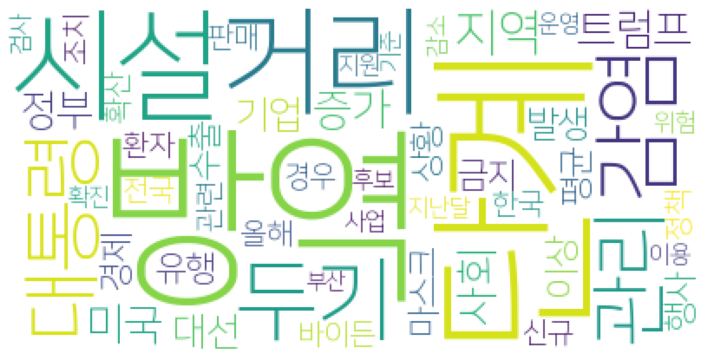

2020.10.31
['일본', '감염', '전날', '실험']
['핼러윈', '사람', '우려', '이태원', '방역', '홍대', '주점', '클럽', '거리', '감성', '번화가', '수칙']
['시설', '감염', '확진']
['청담러닝', '중국', '매출', '온라인', '로열티', '학생', '대비']
['악산', '로프웨이', '춘천', '관광', '관광객']
[]
['바이러스']
[]
['반정부', '국왕']
['대응', '한국', '유럽', '오스트리아', '부국', '대통령', '통해', '성공', '라며', '우리', '사설']
['신규', '미국']
['신규', '미국']
[]
[]
['거리', '사람']
[]
['두기', '전시', '거리', '예술', '작품']
[]
['코리아', '쿠팡', '배달', '할인', '브랜드']
['함평', '가족', '확진', '어린이집', '자녀', '오늘', '지난']
[]
['아산', '천안', '확진', '판정', '방역', '당국']
[]
[]
['방역', '부산', '선원', '러시아', '판정']
['마을', '관광객', '전주시']
['세월호']
['사고', '교각', '낚싯배']
['사고', '낚싯배', '교각']
['공동', '김효주', '더파', '선두', '우승']
['신문', '한국', '오스트리아']
['핼러윈', '방역', '확산', '사람']
['의사', '독일', '의대', '의료', '병상', '병원', '정원', '베를린', '지방', '현재']
['강서구', '감염', '접촉', '관내', '관련', '집단', '강남구', '발생', '검사', '지역', '경로']
['거리', '사람']
['북한', '미국', '바이든', '문제', '트럼프', '전망', '대선', '후보', '북미']
['감염', '병원', '집단', '확인']
['트럼프', '후보', '바이든', '대선', '북부']
['방역', '기업', '베트남', '수출', '한국']
['한국']
['오

['위기', '한국', '시작', '시대', '명견', '우리', '사회', '방향', '대한민국', '참여', '기후', '청년', '무엇', '도시', '불안', '시즌', '만리', '질문', '세계', '미래', '경제', '부작', '시청자', '패널', '교수', '대한', '가운데', '분야', '위해', '전환']
['레나', '샹송', '문화', '공연', '밴드', '프랑스']
['쿠팡']
['학원']
['프레', '콘서트', '시안', '공연', '경북', '인문학']
['경남', '검사', '접촉', '지난', '번은', '마을', '확진', '현재']
['경남', '검사', '접촉', '지난', '번은', '확진', '마을', '현재']
['확진', '경남', '검사', '접촉', '지난', '번은', '마을', '현재']
['인원', '올해', '중개사', '시험', '응시']
['아웃', '정부', '영국', '외식', '확산', '프로그램', '감염', '헬프', '분석', '조치', '지원']
['정부', '프로그램', '아웃', '영국', '외식', '확산', '감염', '조치', '헬프', '지원', '분석']
['사회', '거리', '두기']
['감염', '발생', '국내', '현재', '위험', '방역', '상황', '신규', '두기', '부장', '거리', '유행', '부본']
['관련', '지난', '부장', '당국', '부본', '감염', '시설', '확산', '방역', '교회', '격리', '기관', '가족', '발생', '현재', '병원', '추가', '직장', '검사', '관리', '집단', '지인', '환자', '분산', '조사', '결과', '요양', '의료', '확진', '판정', '동료', '접촉', '재활', '입원', '송파구']
['관련', '감염', '추가', '집단', '방역', '연합뉴스', '누적']
['연합뉴스', '관련', '감염', '추가', '집단', '방역', '누적']
['복지', 

['호스텔', '공간', '숙소', '여행', '도시', '마라케시', '빵빵']
['미국', '확산', '신규', '하루', '집계', '환자']
['직접', '검사', '교육', '신임', '부장']
['염증', '사례', '소아', '청소년', '증후군', '다기', '대본']
['아산', '판정', '확진']
['아산']
['회장', '합의', '위원장', '국민']
['관련', '확진']
['경기']
['이코노미스트', '트럼프', '바이든', '미국']
['트럼프', '바이든', '미국', '이코노미스트']
['병원', '관련', '감염', '확진', '가족', '누적']
['인천']
['사례', '염증', '증후군', '소아', '청소년']
['확진', '안양']
['감염', '관련', '확진', '병원', '대본', '전날', '가족', '누적']
['밍크', '제품', '의류', '패딩', '모피']
['의원', '국시']
['부산', '의료관광', '에어부산', '해외']
['발생', '이후', '판정', '사례', '치료', '염증', '증상', '발열', '지난', '면역', '다기', '청소년', '결과', '퇴원', '소아', '국내', '확인', '감염', '관련']
[]
['오산']
['검사', '교육', '신임', '강연']
['방역', '신규']
['교회', '사랑', '예배']
['교회', '사랑', '예배']
['안양', '발생']
['부동산', '도전', '아버지', '시험', '응시', '공인', '중개사', '김씨']
['국내', '염증', '소아', '청소년', '증후군', '환자']
['코세', '추진', '참여', '페스', '진행', '업계', '행사', '기부', '코리아', '국민', '세일', '위원회', '개막식']
['세계', '위원장', '위기', '전환']
['이데일리']
['위원장', '합의', '국민']
['천안', '아산']
['국내', '소아', '청소년', '증후군', '환자', '지난', 

['바이든', '트럼프', '대통령', '후보', '유세', '위스콘신주', '바이러스']
['온정', '광주', '봉사', '나눔', '교사', '연탄']
['봉사', '가족', '활동']
[]
[]
['엑슨모빌', '셰브런', '실적', '기업', '에너지', '발표', '석유', '유가', '토탈', '절감', '대비', '수준', '순이익', '기존']
['무스', '경기', '선수', '크롱']
[]
['허가', '수출', '진단', '키트', '국내', '동시', '업체', '대한']
['지원', '김포', '학생', '중소기업', '학교']
['위원장', '합의']
[]
['학원']
['북한', '정부', '사건', '보고', '공무원', '킨타', '사살']
[]
['국민', '의원', '합의']
['미국', '바이든']
['이태원', '연합뉴스']
['평택']
['평택']
[]
['비대', '확산', '부동산', '근무', '가격', '변화', '재택근무', '상업', '팬데믹', '임대료', '아파트', '출근', '종식', '우리', '주거', '주요', '평균', '미국', '주택', '형태', '금융', '필요', '대한', '오피스', '침체', '집합', '하락', '평가', '국내', '뉴욕', '실율', '직장', '기업', '업무', '때문', '문화', '경우', '통해', '한국', '시스템']
['관련', '집단', '감염', '강남구']
['프랑스', '갈등', '터키', '테러']
['사례', '중국']
['중국', '사례']
['청와대', '북악산', '개방', '측면', '대통령', '시민', '청운대', '청장', '둘레길', '문화재']
['내장산', '단풍', '풍객', '사무소']
['부산', '환자']
['시험', '수험생', '공인', '응시', '중개사', '부동산', '준비', '집값', '취업']
['식당', '검사', '강서구']
[]
['인권', '북한', '정부', '사건', '공무원', '유엔

['통장', '생각', '우울증', '민주당', '의원', '증가', '알콜중독', '자료', '청년', '음주', '관련', '대의', '마이너스', '빈도', '결과', '올해', '환자']
['항공사', '정치', '재산세', '등록']
['접견', '조두순', '지난', '이후', '헤럴드경제', '외부', '인과']
['수용', '치유', '심신', '교정', '전주교도소', '시설', '노래방', '스트레스', '협의', '설치', '국민', '마련', '청원']
['순환', '경기', '개월', '동행', '지수', '수축', '경제', '국면']
['운영', '호텔', '여행', '국내', '해외', '소비', '카시', '브랜드']
['감염']
['청약', '호반', '건설', '견본주택', '분양', '써밋', '환기', '기술', '마케팅', '포스트', '시스템', '사이버', '시대', '비대']
['대선', '트럼프', '미네소타', '바이든', '대통령', '위스콘신', '포인트', '유세', '후보', '미시간']
['부산']
['국가', '해외', '감염', '호주', '트래블', '버블', '국민', '한국', '입국', '협정', '검사', '음성', '여행', '뉴질랜드', '행업', '외국인', '경제', '격리', '업계', '방역', '항공', '국내']
['신한카드', '온라인', '금융', '고객', '패널', '소비자', '간담', '환경', '제도']
['그룹', '삼성', '이건희', '회장', '상속세', '물산', '별세']
['블록', '투표', '연주', '대선', '음악가', '캠페인']
['장터', '행사', '남도', '할인', '최대']
['한중', '행사', '중국', '개최', '어업', '공동', '위원회', '해양', '푸드', '글로벌', '올해', '수산물']
['산업', '기술', '개최', '무역']
['대학교', '정보', '입학', '코엑스', '국내', '호주', '유학', '

['초콜릿', '가나', '포트', '다크', '아몬드', '헤이즐넛']
['올해', '시험', '공인', '중개사', '공단', '응시', '진행']
['연구원', '매출', '아이폰', '출시', '모델', '애플', '분기', '증가', '동기', '가이던스', '판매']
['지사', '경기도', '기본', '대선', '국민', '경기', '기본권', '분도', '지역']
['그룹', '대표', '지난', '엔터테인먼트', '미디어', '퍼시픽', '반도', '회생', '키위', '사업', '보유', '매출', '숫자', '건설', '인수', '자산', '절차', '수익', '투자', '기준', '통해', '산업', '한진', '영화', '관계', '현금', '지주사', '흐름', '확보', '법원', '당시', '기간', '기업', '누구', '전무', '취득', '분양', '지난해', '신청']
['보이스피싱', '금융', '피해', '송금', '보상', '거래', '사칭', '서비스', '지난', '진단', '당국', '사기', '경찰']
['강조', '과학기술', '인공', '앵커', '북한', '차미연', '김필국', '기술', '개발', '상황', '인민', '지능', '과학']
['페소', '아르헨티나', '트럭', '경찰', '현찰', '현지']
['사태', '크레인', '건물', '타워', '사고', '뉴욕', '높이', '발생']
['이탈리아', '차관', '전략', '협력', '경제', '대화', '의장', '한편']
['마운', '브랜드', '직원', '영상', '티아', '소비자', '모델', '디자인']
['지수', '미국', '증시', '이후', '거래', '지난', '기록', '하락', '가장']
['핼러윈', '파티']
[]
['방역', '단속', '핼러윈', '수칙']
['경제', '확산', '코스피', '하락', '지난', '미국', '상승', '개인', '매수', '대선']
['지수']
['확진', '사우나', '판정'

['카드', '연체', '정부', '대출', '우려', '크게', '확대']
['시내버스', '기사', '생각', '차이', '업체', '버스', '마을', '노선', '이군', '차량', '곳도', '평가', '배차', '교통', '운행', '이야기', '거리', '특징', '때문', '다른', '경향신문', '이용', '공공']
['인플레이션', '경제', '골디락스', '수준', '우리나라', '수프', '경기']
['공원', '위해', '구역', '예술의전당', '반포', '산책로', '선릉', '안장', '양재천', '소망', '코스', '선생', '정현왕후', '산책', '성종', '카페', '도산', '정릉', '빌딩', '수상', '한강', '시설', '조성', '길이', '주민', '우면산', '이정표', '둘레', '분수', '반포대교', '대성사', '공간', '유상규', '거리', '산행']
['시스템', '통해', '보안', '결제', '카드', '사이버', '지급', '글로벌', '강화', '사이버범죄', '가맹', '기술']
['반등', '저가', '발표', '방안', '영향', '성장', '생산', '주택', '재산세', '수출', '서민', '부동산', '부담', '실질', '회복', '산업', '소비', '경제', '공시가격', '대비', '증가', '보유']
['금융', '은행', '지주', '주가', '배당', '대비', '분기']
['지수', '대선', '포인트']
['증가', '지수', '시장', '대선', '미국', '상황', '발표', '하락', '주가', '대한']
['미국']
['미국', '신규', '기록', '최근']
['부회장', '주식', '삼성', '생명', '전자', '상속세', '지배구조', '마련', '회장', '그룹', '가능성', '이재용', '재원', '재판', '매각', '승계', '물산', '경영', '보유', '통해']
['트럼프', '바이든', '대통령', '후보', '미국', '대선', 

['중국', '봉쇄', '핼러윈']
['전날', '지수', '포인트']
[]
['이탈리아', '하루', '기록']
[]
[]
['백신', '임상시험', '국가', '위생', '감시', '스푸트니크', '러시아', '정부', '브라질']
['미국', '트럼프', '봉쇄', '백신']
['두바이', '호텔', '아랍에미리트', '분수', '관광']
['하루', '이탈리아', '바이러스']
['클럽', '유흥', '시설', '방역']
['기업', '손실', '분기', '지난']
['크라운', '생산', '광고', '경향신문', '고급', '응접실', '신진자동차', '토요타', '차량', '이후']
['트럼프', '미국', '셧다운', '멜라', '대통령', '플로리다', '바이든', '후보', '대선', '유세', '선거', '여사', '니아', '우리']
['중국', '영향', '기업', '재선', '한국', '무역', '경제', '동맹국', '대통령', '미국', '대선', '강조', '관세', '바이든', '수출', '트럼프', '정책', '통상', '세계', '당선', '실리콘밸리', '정부', '기조', '협력', '상황', '때문', '국내', '민주당', '달러']
['손실', '분기', '기업', '최대', '엑손모빌', '지난', '달러']
['푸드', '센터', '김포시', '토론회', '정책', '플랜']
['경제', '지역화폐', '소비', '지사', '나라']
[]
['자살', '청소년', '효과', '문제', '지금', '우리', '위기', '사람', '중앙', '교육']
['세계', '시장', '샤오미', '대비', '분기', '하량', '리얼', '중국', '애플', '성장', '점유', '스마트폰', '인도', '주요', '미국', '기록', '화웨이', '시리즈']
['북한', '시신', '서해', '사건']
['상속세', '도입', '상속', '부의', '경영', '위해', '과세', '부과', '경우', '로마', '조세']
[

['감식', '현장', '요원', '범행', '사건', '범인', '수사', '과학', '피해자', '지문', '증거', '절도', '장비', '유전자', '경우', '분석', '위해', '확보']
['팬더', '비디오', '일본', '수입', '당시', '인터넷', '산업', '콘텐츠', '미디어', '전대물', '넷플릭스', '울트라맨', '후뢰시맨']
['고객', '다른', '솔루션', '니즈', '제품', '우리', '문제', '대한', '해결', '구매', '개발', '이사', '설명', '상대방', '판매', '거실', '빨래', '건조기', '과정', '이야기', '대해']
['빼빼로', '이벤트', '인생', '빼빼로데이', '패키지']
['사업', '도입', '헬기', '해군', '해상', '작전', '링스']
['시정', '도주', '막걸리', '대한', '원내대표', '경제', '국민', '이번', '국회', '대표', '연설', '대통령', '논란', '야당', '정부', '입장', '사건', '의원', '청와대', '경호처', '강조', '예산안', '본회의', '여당', '당나귀', '경호', '수색', '문제', '여야']
['감염', '무증상', '카슈가르']
['매장', '이니스프리', '북미', '직영', '올해', '중국']
['검색', '대비', '자동차', '전기차', '증가', '검색량', '이용', '이후', '올해', '트렌드', '서비스', '마트', '장소', '사람']
['교회', '사랑']
['비대', '수요', '원룸', '수업', '월세', '학생', '임대', '건물', '대면']
['원룸', '수업', '비대', '월세', '학생', '임대', '건물', '수요', '대면']
['러시아', '부산', '선원', '선박', '감천']
['시험', '하반기', '삼성', '진행', '상반기', '온라인']
[]
['총장', '기원', '사무', '위해']
['관련', '누적']
['증상', '전파', '가구

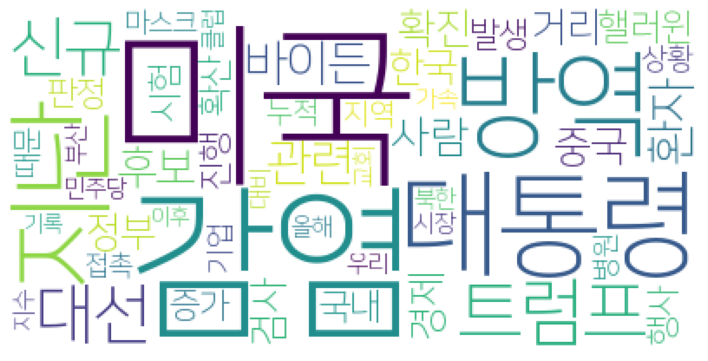

2020.10.30
[]
[]
[]
['일본', '정부', '한국', '지역', '레벨']
['일본', '정부', '한국', '지역', '레벨']
['절경', '단풍', '절정']
['국화', '축제', '마산', '가을', '차량']
['수출', '소비', '생산', '회복', '경제']
['예식장', '확진', '감염', '검사', '천안', '여성']
['단풍', '절정', '절경']
['아우', '프랑스', '현지', '이탈리아', '주민', '튀니지', '우이', '람페두사', '바리']
['쿠팡', '직원']
[]
['접종', '백신', '독감', '보건', '사망']
[]
['대구', '교인', '모임', '감염', '교회', '확진']
['예배', '노컷뉴스']
['교회', '신도']
['이태원']
['이태원']
['영화제', '부산', '국제', '영화', '관객', '상영']
['한국', '레벨', '일본', '대상', '위험', '완화']
['일본', '입국', '레벨']
['일본', '한국', '입국', '대상']
['일본']
['바리', '현지', '람페두사', '주민', '이탈리아', '튀니지', '아우', '우이', '프랑스', '난민', '수용', '시설']
['서울시', '서초구', '조례', '재산세', '대해']
['영화', '방학', '시간', '친구', '마스크']
['일본', '레벨', '한국', '지역', '단계']
['일본', '한국', '지역']
['서초구', '서울시', '재산세', '조례', '대해', '정부']
[]
['일본']
['베트남', '의장', '방문', '이번', '국회의장', '의원']
['개정', '서초구', '서울시', '조례', '재산세', '주택', '대법원', '신청', '집행정지']
['지역']
['시민', '실험', '관중', '요코하마']
['일본', '정부', '한국', '지역', '레벨']
['시설', '지금', '이태원', '감염', '방역', '거리', '확인', '유흥']
[

['방통위', '방안', '승인', '방송', '처분', '정지', '개월', '결정', '영업정지', '전체', '예정', '심사', '전부', '업무', '취소', '자본금', '종편', '위원']
['실적', '가전', '영업', '이익', '증가', '매출', '전자', '내년', '전장', '생활', '부문', '온라인', '사업', '개선', '확대', '올해', '역대', '제품', '마케팅', '비용', '미국', '측은', '적자', '수요', '기록', '판매', '회사', '상반기']
['경제', '중국', '장기', '계획', '발전']
['포럼', '콘서트']
[]
['우리', '협력', '싱가포르', '양국', '의료', '영상', '문화', '한식']
['미국', '전자', '증시', '코스피지수', '개인', '외국인', '대선', '투자', '급락', '최대', '마감', '시장', '확산', '하락', '상황', '매수', '지수']
['대회', '업체', '포커', '청주시']
['교육', '혁신']
['교육', '혁신']
['백신', '개발', '생산', '총리', '센터', '우리', '바이오']
['호텔', '신라', '손실', '적자', '한옥호텔', '공사', '기간', '매출']
['실적', '보급', '화웨이', '전자', '매출', '사업', '아이', '스마트폰', '적자', '본부', '개선', '영업', '확대', '유럽']
['미국', '지수', '증시', '외국인', '개인', '대선', '시장', '매수', '투자', '전자', '최대']
['공간', '데이터', '투자', '관리', '시장', '한국', '운영', '서비스', '제공']
['보류', '호텔', '신라', '기간', '공사']
['인플루엔자']
['공사', '호텔', '신라', '기간', '보류']
['계획', '중국', '장기', '경제', '권력', '발전']
['호텔']
['신규', '하루', '크레인', '서초구', '조례']


['삼성', '회장', '장관', '대통령', '아이폰', '오후', '이건희', '오전', '택배', '의원', '한형', '노컷뉴스', '선고', '박종민', '윤창', '대체복무', '법무부', '변호사', '황진환', '대한', '전자', '관계자', '국회']
['전라남도', '전남', '독립운동', '기념', '항일']
['직원', '감염', '점원', '식료품', '근무', '고객']
['북한', '의원', '서해', '사건', '시신']
[]
['가격', '하락', '서버', '트렌드', '포스', '낸드', '고정', '거래', '공급', '평균', '약세']
['지역', '인증', '진해구', '시장', '서비스', '창원시', '고용', '위기', '품질', '콜센터', '국제', '야시장', '민원', '경남', '산업', '개장', '창동', '시스템', '시민', '눈꽃']
['주주', '동학', '개미', '정부', '지사']
['광고', '아이', '아프리카', '플랫폼', '매출']
['핼러윈', '데이', '방역', '점검', '이태원', '축제']
[]
['데이', '부산', '핼러윈', '서면', '클럽', '부산진', '구청']
['영업', '이익']
['전자']
['전기자전거', '할리', '데이비드', '시리얼', '자전거', '시속']
['사회', '기업', '캠페인', '위해', '핸드', '참여']
[]
['영업']
['국가', '협력', '북방', '무역', '디지털', '시대', '공동', '협회', '토론']
['조선', '누적']
['지역', '개발', '폐광', '지원', '현안', '사업', '국민', '특별법', '국회', '관심', '협의', '주요', '정책', '강원']
['하락', '코스피', '마감', '전날', '포인트']
['세계', '관광', '제주', '지사', '팬더믹']
['형제', '아이', '기업']
['의정부', '재판']
['매출', '손실', '중공업', '프로젝트']
['

['시장', '동기', '판매', '구조', '이익', '대비', '본부', '가전', '원가', '역대', '사업', '수요', '프리미엄', '분기', '생활', '글로벌', '북미', '경쟁', '레드', '증가', '매출', '영업', '손실', '기록', '제품', '계획', '확대', '개선', '예상', '트렌드']
['영화제', '포럼']
['프로젝트', '손실']
['매출', '본부', '영업', '이익', '사업']
['국장', '협의', '일본', '총리', '대해', '이번', '취임', '한국']
['감염병', '관리', '질병']
['사령관', '미군', '격리', '에이브', '럼스']
['사업', '영업', '매출', '이익', '대비', '기록', '동기', '증가', '가전', '확대', '분기', '손실', '생활', '기준', '글로벌', '본부']
['중공업', '매출', '손실', '대비', '개선', '프로젝트', '적자']
['적자', '프로젝트']
['적자', '프로젝트']
['축구', '친선', '참가', '경기', '대회', '김학범', '대표팀', '남자', '이집트', '소집', '이번', '사우디아라비아']
['외식']
['애플', '달러', '매출', '아이폰', '기록', '아이', '시장', '아이패드']
['매입', '정산']
['프랑스', '파리', '봉쇄']
['감염', '모임', '누적', '연합뉴스']
['지역', '모임', '감염', '누적']
['방문', '학습', '모임', '관련', '추가', '가족', '교사', '전파', '확진', '지인', '누적', '판정', '수강생', '집단']
['사회', '지원', '미래', '현대차', '노사', '협력', '기업', '부품', '대통령', '공장', '울산', '노력', '전환', '대해', '자동차']
['감염', '관련', '발생', '집단', '사례', '경기', '모임', '경향신문']
['아이', '대비', '증가', '트위터

['노조', '한국', '파업', '협상', '생산', '쟁의', '손실', '부분파업', '조합원', '잔업']
['뱅크', '영업', '이익', '공장']
['공장', '흑자', '뱅크', '영업', '이익', '사업']
[]
['뱅크', '영업', '정유', '이익', '사업', '흑자', '달성', '대비']
['상사', '실적', '증가']
['교복', '관행', '채용', '환자', '인지', '사회', '국민', '강화', '정성', '프로그램', '확대', '대한', '정부', '업체', '방지', '제공', '개발', '계획', '치매', '공공기관', '추진', '제재', '광고', '안심', '서비스', '위해']
['고객', '출시', '행사', '통해', '유플러스', '체험', '할인', '아이폰', '애플', '진행', '아이패드', '공간', '팩토리', '프로그램', '텔레콤', '서비스', '넷플릭스', '론칭', '무료', '슈퍼', '특별', '제공', '전날', '참여']
['진도군', '진도', '평가', '유튜브', '최우수상']
['혁신', '교육', '계명대', '시대', '포스트', '대학', '방향', '포럼', '과제', '계명', '추진']
[]
[]
[]
[]
[]
[]
['골프', '브랜드', '시장', '유통', '매출', '의견', '인기', '용품', '판매', '이마트', '올해', '호황', '웨어', '골퍼', '지난해', '세대']
['등교']
[]
[]
['미국', '하루', '신규', '최고']
['공모전', '정책', '아이디어', '혁신', '사업', '중진', '심사', '중소', '벤처기업', '헤럴드', '지원', '선정', '국민', '제안', '이사장', '김학도', '대표']
['토론', '시민', '정책', '제안', '소통', '울산', '참여', '실행', '시가', '이방', '의견', '온라인', '운영', '시정', '산시']
['등교']
['사례', '경기', '

['교육', '화학', '울산', '산업', '석유화학', '기념', '공정', '인력']
['도시', '지역', '생활권', '계획', '울산', '공청회', '인구', '도심']
['작가', '아트', '국내', '작품', '페어', '미술', '온라인', '마니프', '그림', '시장', '처음', '구매', '판매', '전시', '가격', '언론', '매년', '감상', '유통']
['화학', '교육', '공정', '폴리텍', '석유화학', '울산', '산업', '개원', '안전', '규모']
['취업', '남성', '여성', '택배', '연말정산']
[]
['아이폰', '출시', '행사', '부산']
['회계', '기념']
[]
[]
['승객', '호출', '문제', '설명', '택시', '기사', '카카오', '배차', '모빌리티', '수락', '사실', '가맹', '거절', '일반', '알고리즘', '경기도', '조사', '공개', '시간', '자동']
['예멘']
['혁신', '중국', '주석', '강조', '과학기술', '세계']
['서울시', '클럽', '감염', '관련', '시설', '모임', '방역', '확진', '이태원', '풍선', '점검', '가족', '영업', '지역', '추가', '전부', '집단', '강남', '효과', '유흥', '휴업', '누적', '강남구', '사우나']
['성장', '경제', '미국']
['결혼']
['자택', '동선', '마을', '판정', '접촉', '주민', '결과', '검사', '대해']
['지난', '미국', '신규', '기록', '하루', '집계', '수가', '누적', '사망자', '평균', '증가', '보도']
[]
[]
['관광지', '비응', '파지', '관광', '선정', '비대', '바다']
['중국']
['자가', '격리', '방역', '경기도', '무단이탈', '시설', '공무원', '위험', '발생', '조치', '대상', '여부', '고발', '점검', '관리', '준수']
[

['격리', '병원', '부산', '환자', '추가', '요양', '확진', '입원', '접촉', '지역']
['응모', '법정', '방청권', '추첨', '서울중앙지법', '방청', '교수']
['결혼식장', '천안', '시설', '천안시', '검사', '거주', '확인', '보건']
['확진']
['산업', '개발', '현대차', '이상', '자율', '전기차', '세계', '자동차', '시장', '부품', '행차', '수출', '사업', '협력', '충전', '울산', '국민', '여러분', '생산', '사회', '수소차', '기업', '기술', '경쟁', '공장', '친환', '경쟁력', '시대', '주행', '노사', '강국', '지원', '미래', '수소', '최초', '경차', '상용', '보급', '대통령', '고속도로', '성능', '우리', '선도', '중심', '계획', '투자', '추진', '구매']
['캠핑', '난로']
['캠핑', '난로']
['비즈니스']
['병원', '해뜨락', '요양', '환자', '부산', '격리']
['개통', '의정부역', '푸르지오', '센트럴', '가구', '의정부', '분양', '예정', '단지']
['증가']
['신규', '집계']
['미래', '기업', '대통령', '자동차', '현대차', '산업', '수소차']
['온라인', '참석', '영화제', '부산', '국제', '상영', '관객', '올해']
['트럼프', '바이든', '미국', '마스크']
[]
[]
['증가']
['업계', '광물', '위원회', '건설', '비금속']
['백신', '위해', '임상시험', '정부', '지원', '기업', '치료', '개발', '해외', '환자', '국민']
['남극', '연구', '월동', '과학', '아라온호', '기지', '항해', '장보고과학기지', '세종', '교대']
['의사', '의대', '국시', '응시', '정부', '의료', '협의', '의협', '합의', '국민', '의정', '파업'

['교수', '감염', '소비', '쿠폰']
[]
[]
[]
[]
['입국', '판정']
['신규', '확산', '조치', '미국', '최근', '지역', '하루']
[]
[]
[]
['의협', '의사', '의대', '응시', '국시', '의료', '정부', '정원', '문제', '차관', '의정', '협의', '지난달']
['금호', '타이어', '할인', '행사']
[]
['산업', '부산', '패션', '비즈니스', '섬유', '연합', '지원', '신발', '지역', '협약']
[]
['앨범', '뉴욕', '페인', '사진', '위해', '노래', '음악']
['사진', '노래', '페인', '앨범', '뉴욕', '위해', '음악']
[]
[]
['증가', '감소', '상승', '이후', '생산', '전월', '개월', '지수', '영향', '판매', '제조업', '확산', '자동차', '순환', '지난', '서비스업', '경기', '변동', '동향', '소비', '거리', '수출', '소매', '반도체', '산업', '두기']
['밀워키', '제품', '히팅']
['발생']
['홈쇼핑', '프로그램', '소통', '방청객', '방송', '랜선', '특집', '참여', '빅쇼']
['검사']
[]
['대상포진']
['교인', '감염', '교회', '확진']
['교인', '감염', '교회', '확진']
['매각', '사업', '자산', '예보']
['격리', '위반']
['한국', '플랜', '넷플릭스', '인상', '구독료']
['지표', '부총리', '발표', '산업', '방역', '지수']
['금융', '신한카드', '고객', '금융감독원', '패널', '소비자', '온라인', '환경', '관계자', '제도', '현장']
['현지', '민주당', '공화당', '시간', '트럼프', '대통령', '후보', '플로리다', '바이든', '투표', '예정']
['백신', '관련']
['소비', '지난', '판매', '증가', '생산', '경기', '산업',

['교회', '추가', '신도']
['세계', '신규', '사망자']
['사건']
['미국', '신규', '지난', '유럽', '세계', '사망자']
['미국', '유세']
['다시', '포인트', '지출', '대비', '속도', '미국', '올해', '성장', '회복', '경제', '증가', '내년', '기업', '투자', '이후', '때문', '소비', '주택', '실업', '시장', '급여', '소비자', '부양책', '최근']
['세계', '신규', '미국', '유럽', '하루', '사망자']
['관리', '제품', '밴드', '노미', '운동']
['관광', '할인', '외식', '확산', '소비', '방역', '쿠폰', '숙박', '재개', '상황', '사업', '여행', '제공']
['할인', '외식', '관광', '확산', '소비', '방역', '쿠폰', '제공', '여행', '숙박', '사업', '상황', '재개']
['대한', '알바생', '아르바이트', '감염', '응답', '불안감', '이후', '가장', '현재']
[]
['테러', '프랑스', '성당', '니스', '이탈리아', '규탄', '공격']
['트럼프', '미국', '후보', '대통령', '바이든', '플로리다', '접전', '경합주']
['할인']
['연구', '봉쇄', '사회', '우울', '증가', '나코', '사람', '불안', '결과', '독일', '정신건강', '분석', '증세', '크게', '비교', '스트레스', '여러', '팬데믹']
['성장', '미국']
['증가', '생산', '산업', '소비', '반도체', '대비']
['대통령', '테슬라', '기업', '당선', '투자', '정책', '에너지', '미국', '바이든', '대선', '부동산', '캐스터', '분석', '가장', '마틴', '경우', '퍼스트', '주가', '트럼프', '역시', '생산', '로스', '정부', '현재', '수혜', '대한', '대마초', '인프라', '넥스트', '후보', 

['패션', '브랜드', '행사', '롯데', '최대', '백화점', '코리아', '마켓', '할인', '진행']
['동기', '발행', '대출', '주택', '증가', '대비', '금융', '공사', '채권', '전환', '기초', '안심']
['특구', '관광', '빛초롱', '축제', '서울시']
['참여', '패션', '코리아', '행사', '마켓', '백화점']
['패션', '진행', '행사', '아이', '롯데', '백화점', '코리아', '마켓']
['담보', '대출', '주택', '은행', '금리', '이자율', '기준금리', '포인트', '인하', '지난', '이후']
['블루문', '핼러윈', '보름달']
['가격연동제', '수거', '연휴', '스티로폼', '주택', '단지', '재활용', '환경부', '가격', '조사', '판매', '민간', '시장', '전국', '별장', '대상', '안정화', '공동', '재활용품', '반입량', '적용', '증가']
['소규모', '수용률', '증가', '지난해', '기숙사', '비율', '대비', '강의', '강좌', '감소', '수익', '분할', '실험', '대학', '전문', '카드', '포인트', '법인', '공시', '실습', '부담', '확보', '경우', '상승', '수도권', '강사', '재산', '납부', '사립', '올해', '현금', '학기', '담당']
['패션', '참여', '코리아', '마켓', '행사']
['패션', '코리아', '마켓', '참여', '시즌', '행사']
['북방', '비즈니스', '지역', '상담', '뉴미디어', '활용', '확대', '적극', '온라인', '진출']
['코리아', '패션', '마켓', '차관', '롯데', '백화점', '참여']
['마스크', '무역', '수출', '협회', '설명', '위원']
['제품', '온라인', '중소기업', '판매']
['핼러윈', '주점', '데이', '클럽', '파티', '호텔', '의상']
['스마트',

['이익', '석유', '가격', '수요', '영업', '매출', '상승', '기록', '배터리', '회복', '관련', '손실', '영향', '사업', '가동', '규모', '흑자', '생산', '전환', '유가', '재고', '시장', '증가', '분기', '적자', '중국', '확대', '실적', '헝가리', '화학', '대비', '상반기', '이노베이션', '개선', '본격', '미국', '공장', '해외']
['재발', '여권', '신청', '온라인', '민원', '서비스', '경우', '방문']
['도서관', '학교', '독서']
['회계', '기념']
['처리', '아이폰', '애플', '애플스토어', '입장']
['안심', '농식품부', '식당', '관리', '중이']
['대비', '전월', '응답', '하락', '물가', '포인트', '환율', '시장', '채권', '금리', '관련', '상승', '전망', '심리', '악화']
['클럽', '핼러윈데이', '지역', '유흥', '시설', '점검', '서울시', '방역', '이태원', '집단', '국장', '휴업', '감염']
['무예', '세계', '컨벤션', '학술', '대회']
['무예', '학술', '세계', '컨벤션', '대회']
['구조', '형태', '특수', '산업', '택배', '노동자', '국민', '고용', '보호']
['인권', '노력', '노동']
['관련', '서울시', '확진', '강남구', '지난', '사우나', '모임', '이후', '감염', '국장']
['한도', '증권', '청약', '모주', '서비스', '대신', '펀드']
['비일', '상의', '아이폰', '고객', '출시', '프로', '모델', '비중', '참여', '유튜브', '애플', '예약', '시리즈', '행사', '세대', '별로', '배송', '제공', '인기', '진행', '일상']
['교육', '예술', '지원', '학교']
['문화센터', '학기', '강좌', '홈플러스', '온라인',

['재산세', '피해']
['매출', '성장', '소형', '지난해', '대비', '채널', '락앤락', '웨어', '가전', '카테고리', '영업', '증가', '중국']
['물품', '꾸러미', '방역', '시설', '민간', '다중', '이용', '강감찬', '지역', '지원']
['지급', '휴직', '무급']
[]
['비율', '작년', '분석', '강의', '대학', '강사', '학기', '포인트', '상승', '전임', '교원', '담당', '대비', '올해', '기숙사']
['국내', '외국어', '사이버', '대학교', '한국', '학생', '학부', '교육', '해외', '학과', '외국인', '교육과정', '온라인']
['아마존', '매출', '넷플릭스', '인상', '세계', '실적', '증가', '구독료']
['판정']
['예보', '매각', '사업', '자산', '회수']
['예보', '매각', '사업', '자산', '회수']
['부산시', '문화', '라운드', '공간', '시설', '지역', '비콘', '개장', '부산', '행사', '시민']
['건설', '업계', '비금속', '광물', '위원회', '중앙회']
['교회', '신도', '추가']
['평화', '남북', '협력', '장관']
['웨어', '가전', '소형', '매출', '대비', '카테고리', '락앤락', '성장']
['아이폰', '애플', '매출', '실적', '출시', '시장', '상치', '신제품']
['롤드컵']
['환자', '보도', '신규', '하루', '미국', '기록', '최고']
['미국', '하루']
['상승', '아이', '분기', '영업', '기록', '사업', '이익', '매출', '적자', '배터리', '공장', '손실', '개선', '증가', '회복', '중국', '이노베이션']
['백신']
['대규모', '확산', '방역']
[]
[]
['의약품', '생산', '진행', '원료', '에이', '인도', '치료', '피알', '지난', '

['핼러윈', '이태원', '방역', '미군', '출입', '금지', '클럽', '신규', '발생']
['이브라히모비치', '즐라탄']
['응시', '시험', '공인', '중개사', '올해', '서씨', '이후', '지난해', '부동산']
['온통']
['순위', '청약', '대방', '마송', '김포', '주택', '단지', '이상', '적용', '가구', '지구', '엘리', '면적']
['분기', '영업', '이익', '사업', '공장', '상승', '매출', '기록', '중국', '개선', '해외', '가격', '이노베이션', '생산', '손실', '가동', '규모', '회복', '증가', '배터리']
['개최', '부산', '축제', '일보']
['공장', '기록', '손실', '규모', '회복', '헝가리', '사업', '분기', '영업', '이익', '배터리', '이노베이션', '가동', '매출', '상승', '가격', '감소', '능력', '중국', '증가', '생산', '해외', '개선']
['관련', '누적', '추가']
['회계', '순위', '위원장', '지난', '기념']
['전날', '감염', '방역', '지역', '모임']
['전날', '감염', '방역', '지역', '모임']
['외식', '결제', '신협', '캐시']
['사업', '납부', '수수료', '면세', '특허', '업계', '사업자', '면세점', '관세', '재난', '매출']
['후보', '유세', '트럼프', '대통령', '바이든', '경제', '대선', '플로리다', '정책']
['배터리', '업체', '화학', '글로벌', '전기차', '국내', '성장', '점유', '대비', '영향', '판매', '사의']
['초콜릿', '포트', '츄러스', '식감', '헤이즐넛', '출시', '푸드', '아이스크림', '베리', '가나', '아몬드', '지안', '프리미엄', '초코', '위해', '다크']
['방역', '총리', '백신', '개발', '면서', '하루'

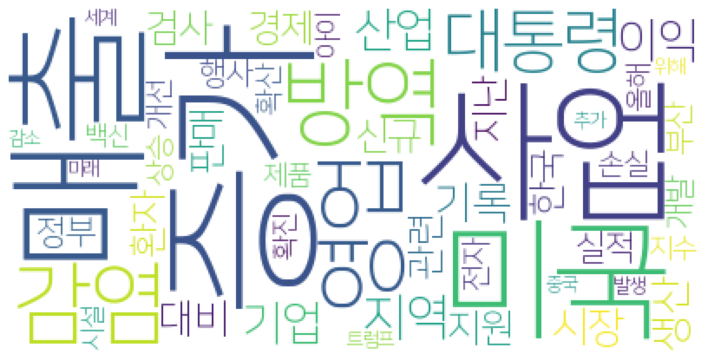

2020.10.29
['학당', '한국', '관광', '세종', '공사', '재단', '확대', '수강생', '대상', '방한']
['가족', '시간', '남녀', '영향']
['금리']
[]
['학급']
['감염', '접촉', '관련', '추가', '검사', '판정', '지난', '학생', '방문', '가족', '보건소', '사우나', '확진', '교사']
['기업', '사회', '올해', '대구']
['형제', '배달', '점포', '검사', '발생']
['성장', '경제', '기록']
['일본', '선수', '대회', '체조', '우치', '국제']
[]
['도쿄', '핼러윈', '시부야', '올해']
['총장', '검찰', '대전', '검사', '방문', '사건']
['일본', '감염', '하루']
['업체', '마스크', '무허가', '조선']
['아이폰', '출시', '애플', '매장', '시리즈', '가로수길', '오후', '픽업', '구매', '서비스', '시간', '방문', '대기']
['계층', '롯데', '홈쇼핑', '자연휴양림', '고객', '전달', '행사', '국립', '관리소', '캠핑', '극복']
['제한']
['테러', '용의자', '프랑스', '만평', '이슬람', '샤를', '교사']
['하루', '일본', '감염']
['일본', '선수', '대회', '체조', '국제', '대표', '우치', '검사']
['지수']
[]
['총장', '대전', '조선', '검사', '검찰']
['의협', '국시', '응시', '의정', '협의', '의료', '경향신문', '의대', '정부', '문제', '국민']
['항체', '나노', '면역', '입자', '크기']
['포털', '기사', '언론사', '언론', '지적', '송경재', '교수', '공적', '제휴', '저널리즘', '경쟁', '지역', '미디어오늘', '문제', '논의', '탐사보도']
['원주시']
['독일']
[]
['신규', '봉쇄']
['접종', '백신', '독감',

['보증', '기업', '지원', '피해', '프로그램', '상공', '소상', '공인']
[]
['이노션', '이익', '웰컴', '그룹', '증가', '매출']
['비타민', '면역', '아연', '제텐', '현대인', '함유', '도움']
['사우나', '모임', '관련']
['홍천', '확진', '판정']
[]
['교육', '사회', '정책', '디지털', '어르신', '스마트폰', '활용', '보급', '역량']
['범죄', '사기']
['준비', '입학', '교복', '서울시', '신입생']
['판정', '부대', '확진']
['울진군', '지역']
['사업', '네이버', '매출', '대비', '판매', '쇼핑', '실적', '동기', '증가']
['건설', '사업', '영업', '이익', '매출', '대비', '동기', '해외', '분양', '증가', '국내']
['독일', '진단', '공급', '키트', '유럽', '제품', '계약', '지난']
['지수', '증시', '미국']
['세대']
['대비', '카드', '동기', '증가', '매출', '업종', '감소', '금액', '승인']
['진행', '대한', '미얀마', '혈액', '투석', '상황', '의료']
['미얀마', '의료', '혈액', '투석', '상황', '진행', '대한']
['백신', '화이자', '개발', '임상시험', '미국', '올해', '최종']
['북악산', '개방', '청와대', '시민', '대통령']
['일자리', '감소', '임금', '근로시간', '근로자', '영향', '업체', '기준', '종사']
['고객', '상품', '명품', '판매', '외국', '매장']
['의료', '의사', '의협', '정부', '의대', '대한의사협회', '응시', '문제', '해결', '정책']
['갤럭시', '시리즈', '스마트폰', '사업', '경쟁']
['무예', '세계', '산업', '행사', '진행', '국제']
[]
[]
['증가', '부문', '실적', '매출'

['해외', '투자', '지난해', '분위기', '예상', '수요', '계열', '자산운용', '올해', '골프장', '골프', '이용', '클럽', '유동성', '주인', '사모펀드', '매물', '분석', '성사', '내년', '최근', '투자자', '인수', '이상', '가격', '회원', '소유', '과거', '여행', '자금', '매매', '플레이어스', '안성', '사업', '거래', '증가', '산업', '이익', '국내', '매각', '참여', '변수', '펀드', '금융', '영업', '레저', '골프클럽', '시장', '가능성', '한국', '계속', '중제', '그룹', '회사', '이후', '파트너', '안정', '매입']
['방문', '장관', '폼페이', '베트남', '추가']
['증가', '카드', '매출', '감소', '승인', '금액', '동기', '대비']
[]
['직원', '국민은행']
['지원', '사업', '여행', '상품', '관광', '예약', '전남', '조기', '할인']
['후보', '지방선거', '브라질', '사망', '도시', '투표']
['점검', '시설']
[]
[]
['탐방', '방역']
[]
['릭트먼', '대통령', '집권', '변수', '교수', '선거', '트럼프', '미국', '결과', '예측', '불안', '행정부']
['삼성', '회장', '시장', '수요', '글로벌', '상황', '반도체', '비용', '위해', '미국', '대응', '매출', '경영', '영업', '우려', '효율', '부문', '전자', '확대', '기록', '대비', '투자', '크게', '제품', '확보', '화웨이', '지속', '이익', '부품', '모바일', '제재']
['헌혈']
['면역', '반응', '항체', '연구', '백신', '환자', '지속', '러시아', '증상', '결과', '검사', '노프', '바이러스', '감염', '시작', '정도', '박사', '실험', '대상', '영국', '위험']


['중심', '결과', '아침', '식사', '결식', '학습', '건강', '능력', '효과', '아침식사']
['등교', '학교']
['예방', '시장', '마스크', '캠페인', '전통', '안전']
['수업', '등교', '대학', '학교']
['학교', '등교', '수업']
[]
['질병', '야생동물', '관리원', '대응', '광주', '국가']
[]
['사업', '삼성', '수요', '전자', '내년', '디스플레이', '예상', '전무', '최근', '라며', '회장', '이건희', '상반기', '연장', '고객']
['진단', '국군', '의학', '연구소', '독감', '동시', '키트', '개발']
['과장', '의료', '환자', '창원', '병원', '사회', '진료']
['학년', '확인', '대본', '확진', '감염', '관련', '모임', '가족', '추가', '집단', '스포츠', '환자', '판정', '지난', '사례', '경기', '골프', '가운데', '교사', '누적', '양성', '사우나', '지인', '발생']
['감사', '디지털', '회계감사', '응답', '보안']
[]
['수업', '학교', '등교', '대학']
['매출', '아이', '모비스', '부품', '영업']
['학급', '학교', '학생', '교육', '중학교', '교육청', '교실', '인원']
['발생']
['아동']
['그룹', '지원', '기술', '호반', '혁신', '공모전', '심사', '건설', '동반성', '기업', '협력', '투자']
['광주']
['우리은행', '직원']
['지수', '심리', '전망', '소비자', '광주']
['울산']
[]
[]
['마스크', '청각장애', '투명', '학생']
['노조', '쟁의', '임단협', '한국', '측은', '생산', '파업', '행위', '요구']
['수업', '학교', '등교', '대학']
['수업', '학교', '등교', '대학']
['가족', '기준', '종사', '검사'

['환자', '리제']
['우리은행', '직원']
['광주', '축제', '현장', '거리', '프린지', '페스티벌', '온라인', '퍼포먼스', '예술', '단체']
['화이자', '백신', '개발', '관련']
['사우나', '관련', '발생', '감염']
['경제', '봉쇄', '지수', '미국', '유럽']
['근로자', '정규직', '정책', '올해', '감소', '비정규직', '기업', '생산', '산업', '문제', '비중', '경제', '교수', '고용', '자체', '의미', '채용', '노동시장', '제로', '증가', '위축', '해고', '경기', '구호', '지적', '일자리', '제조업', '역시', '주요', '노동', '현실', '정부', '임금', '경직', '한국']
['부산', '의료관광']
['지수', '폭락', '거래', '미국', '확산', '포인트', '일보']
['과학', '세기', '최전선', '사상', '문화', '일상', '인문학', '시작', '인간', '팬데믹', '대한', '기획', '일보', '시대', '세계', '시리즈']
['사상', '문화', '과학', '세기', '최전선', '일상', '인문학', '시작', '인간', '팬데믹', '기획', '일보', '시대', '세계', '시리즈', '대한']
['교수', '백신', '감염', '노프', '자신', '면역', '연구', '항체', '바이러스', '실험', '러시아']
['백신', '화이자', '경제', '영국', '출시', '타임스']
['국민은행', '발행', '채권', '아이', '금리', '가능', '대응', '지속', '글로벌']
['경향신문', '거리', '두기', '단계']
['경향신문', '거리', '두기', '단계']
['북악산', '개방']
['업체', '감소', '종사', '경향신문', '일자리', '숙박', '음식']
['종사', '감소']
['거리', '종사', '상용', '지난', '숙박', '서비스업', '개월', '감소

['감소', '종사', '상용', '증가', '지난달', '지난', '숙박', '영향', '음식', '기타', '일용직', '업체', '일자리', '이직', '확대', '임시', '동월', '서비스업']
['대리점', '공급', '계약', '기간', '업종', '가구', '표준', '계약서', '업자', '반품', '통해', '내용', '협의', '거래', '가격', '보일러', '사유', '경우', '이자', '금지', '요청', '도서', '출판', '해지']
['환자', '유행', '일일', '봉쇄', '기록', '병상', '확산', '국가', '누적', '발생', '매일', '현재', '신규', '중국', '프랑스', '통제', '미국', '감염', '중증', '사람', '시작', '하루', '수가', '증가', '지난', '유럽', '우려', '관리', '때문']
['업체', '종사', '감소', '지난달', '개월', '증가']
['미세먼지', '농도', '독감', '감염', '호흡기', '바이러스', '유행', '환자', '마스크']
['증상', '강박', '강박증', '치료', '행동', '청결', '불안']
['기간', '금지', '대리점', '공급', '업자', '계약서', '업종', '표준', '계약', '경우', '가구', '출판', '보장', '비용', '거래', '해지', '보일러', '도서']
['수출', '지수', '금액', '상승', '기준', '개월', '수출입', '물량', '수입']
['건강', '관리', '사업', '보건소', '어르신', '서비스', '시범']
['시장', '전통', '상권', '사업', '경기도', '진흥', '선정', '상인', '경제', '추진', '구역', '공유', '지역']
['흉기', '테러', '프랑스', '공격', '니스', '발생', '교사']
['실업', '미국', '수당', '주간']
['청구', '실업', '수당', '신규']
['청구', '수당', '실업', '신규']
['비정규직

['증가', '경기', '발생', '전날', '확진', '해외', '지역', '판정', '기록', '기준', '지난', '추가', '신규', '검사', '원주', '유입', '관련']
['항원', '형광', '진단', '키트']
['증시', '상원', '바이든', '민주당', '트럼프', '대선', '경기', '미국', '발표', '경제', '실적', '결과', '팬데믹', '대형', '악재', '성장', '가지', '당선', '오늘', '관련', '이후', '믹스']
[]
['구리시']
['유럽', '봉쇄', '경제', '프랑스', '국가', '조치', '독일']
['대표', '통신', '사업', '텔레콤', '기업', '산업', '시장', '성장', '매출', '현재', '유플러스', '정체', '디지털', '통신사', '실적', '전략', '사명', '미디어', '다른']
[]
['부산', '브랜드', '의료관광', '병원', '통합', '서비스', '상품', '환자']
[]
['오피스', '롯데', '청량리역', '예정', '단지']
['방문']
[]
[]
['해외']
['증시', '포인트', '거래']
['스마트폰', '전자', '이익', '매출', '영업', '지난해', '기간', '미국']
['게임', '스포츠', '콘솔', '출시']
['업체', '청약', '사태', '진에어', '유상증자', '실권', '제주항공', '증권', '공모', '규모', '일반', '유증', '자금']
['누적', '전날', '경기', '지역', '신규', '가족', '발생', '확진', '감염', '방역', '집단', '시설']
['이익', '실적', '분기', '부문', '영업', '전자', '반도체', '수요', '기록', '판매', '가전', '하락', '스마트폰']
['기업', '지원', '산업', '자금', '경제', '보증']
['국내', '모임']
['대응']
['렘데', '시비르', '치료', '매출']
[]
[]
['해남', '축제', '미남', '

['이익', '실적', '메모리', '영업', '수요', '매출', '반도체', '증가', '최대', '시스템', '기록', '덕분', '확대', '전자', '대비', '부문', '분기', '모바일', '화웨이', '수익', '판매', '가전', '사업', '경우', '스마트폰']
['대통령']
['대통령']
['미국', '투자', '감염', '기업', '하락', '우려', '신규', '관련']
['전월', '비제', '조업', '포인트', '업황', '상승', '기업', '제조업', '대비', '지난', '경기', '수준', '중소기업', '이후', '기록', '이전']
['스튜어드', '국민연금', '배터리', '화학', '분할', '반대', '사업', '계획', '주주', '전기차', '행사', '의결권', '기업', '분사', '삼성', '시장', '유럽', '주주총회', '가치', '우려', '코드', '확대', '정부']
['뇌졸중', '증상', '발생', '골든타임', '병원']
['대비', '매출', '네이버', '기록', '동기', '분기', '클라우드', '테크', '콘텐츠', '쇼핑', '성장', '커머스', '증가', '사업']
[]
['무예', '행사', '세계', '온라인', '산업']
['전북']
['오늘', '봉쇄', '기록', '상황', '예상', '환자', '치료', '발표', '조치', '실적', '시장', '달러', '손실']
['모스크바', '조치', '이상']
['증가', '네이버', '매출', '대비', '성장', '기록', '분기', '동기', '클라우드', '사업', '테크', '라인', '커머스', '콘텐츠']
['봉쇄', '상승', '달러', '환율', '유럽', '조치', '심리']
['지수', '유럽', '증시', '포인트']
['거주']
['성장', '매출', '베스트', '투자', '증권']
['네이버', '콘텐츠', '대비', '기록', '성장', '동기', '분기', '클라우드', '사업', '라인',

['지수', '포인트', '업황', '상승', '기업', '전망', '가장', '조업', '조사', '산업', '비제']
['포인트', '업황', '상승', '기업', '전망', '가장', '지수', '비제', '조사', '산업', '조업']
['포인트', '상승', '업황', '기업', '제조업', '경제', '지수', '이후', '중소기업']
['방문', '일정', '총장', '검사', '대검', '대전', '장관', '부장']
['조치', '지수', '이후', '상황', '미국', '대선', '증시', '봉쇄', '하락', '폭락', '유럽', '배럴', '중심', '경제', '기술', '거래', '우려']
['독일', '지난', '공격']
['지수', '하락', '미국', '거래', '이후', '발표', '예상', '다시', '포인트']
['조치']
['하락']
['경제']
['상황', '봉쇄', '조치', '지수']
['봉쇄', '지수', '조치', '상황', '대선', '우려', '기술', '이후', '시장', '미국', '경제']
['프랑스', '봉쇄', '마크', '대통령']
['확산', '달러']
['감염', '반려동물', '동물', '사례', '마리', '전파', '사람']
[]
['이란']
['급락', '지수', '이후']
['방역', '비서', '발열', '비대', '자동', '손소독', '세이버', '제품', '크기', '체크', '출시', '여부']
['식품', '배송', '신선', '서비스', '증가', '마트', '위메프', '지난', '동기', '생산자', '상품', '스마일', '기록', '역시', '시장', '이커머스', '장보기', '할인', '대비', '네이버', '마켓', '간편식', '사용자']
['위원', '국회', '시정', '추천', '국민', '연설', '대통령', '특검', '사건', '요청', '정부', '경우', '출범', '처법', '민주당', '권력', '후보', '중형', '시장', '야당', '개정안

['관광', '경영', '공사', '사장', '도민', '위기', '제주도', '제주', '면세점', '사업', '대한', '기자회견', '대해', '직원', '대행']
['학생']
[]
['지역', '구미', '은행', '기업', '강연']
[]
['환자', '항체', '결과']
[]
['투자', '아시아', '트럼프', '한국', '전망', '재선', '자산', '시장', '국가']
['클럽', '휴업', '방역', '감성', '주점']
[]
['센터', '대웅제약', '미국', '치료', '진행', '사마', '약물', '개발']
['대웅제약', '미국', '치료', '진행', '사마', '센터', '개발', '약물']
[]
['숲길', '감정', '자연', '체험']
['발행', '국민은행', '금리', '가능', '채권', '대응', '이번', '지속', '글로벌']
['단체교섭', '전교조', '교육부', '교섭', '노조', '교육청']
['달러', '확산', '조치', '프랑스', '지수', '독일', '유럽', '경제', '봉쇄', '하락']
['신규', '환자', '하루', '기록', '집계', '미국', '평균']
[]
['준비', '교복', '입학', '서울시', '지원', '경제', '신입생', '교육청', '학생']
['북악산', '개방', '시민', '청와대']
['발행', '금리']
['확진', '학생', '포천시', '검사', '전날', '추가']
['교회', '대구', '감염', '중심', '검사', '신도', '접촉']
['식품', '계획', '여파', '채선당', '사업', '매장', '도시락', '기업', '이후', '모델', '수프', '제품', '생존', '운영', '매출']
['브랜드', '부산', '의료관광', '서비스', '통합', '의료', '병원', '산업', '협약', '환자', '통해', '유치']
['냉동식품', '콜드', '통해', '감염', '중국', '바이러스', '수입', '우한', '수산물', '

['사업', '매출', '이익', '대우건설', '동기', '부문', '아이', '해외', '실적', '주택', '영업', '대비', '증가', '감소', '잔고', '기록', '국내']
['불법', '대출', '서민', '이자', '금리', '대부', '업자', '수사']
['검사', '총장', '대전', '고지', '일선', '방문', '장관', '간담', '지난', '대검']
['마스크', '투명', '청각장애', '학생', '사랑', '달팽이']
['입학', '서울시', '신입생', '지원', '고등학교', '준비']
['온통', '대전', '할인', '사용', '이상']
['금리', '적발', '서민', '금융', '불법', '대출', '대부', '행위', '이자', '피해자', '업자', '연체']
['연구개발', '본부', '투자', '혁신', '예산', '정부', '기획', '전문가', '과학기술', '분야']
['대부', '불법', '대출', '이자율', '부업']
['울산', '번은']
['금융기관', '자금', '개월']
['교복', '교육청', '입학', '추진', '학교', '서울시', '지원', '정책', '준비', '물품', '예산']
['교회', '감염']
['이번', '프랑스', '봉쇄', '대통령', '지난', '식당', '조치', '기록', '방역', '주간', '이상', '마크', '신규', '증시', '술집', '수준', '파도']
['백신', '바이러스', '라파스', '마이코', '박테리아', '면역', '조합', '개발', '유전자', '발현', '능력', '세포', '항체', '항원']
['발생', '가족', '경기', '지역', '신규', '전날', '확진', '감염', '방역', '시설']
['엠에스', '진단', '녹십자']
['보안', '기법', '분석', '회계', '감사', '디지털', '경험', '회계감사', '기업', '응답', '자료', '업무', '시스템', '확산', '대한', '데이터', '국내

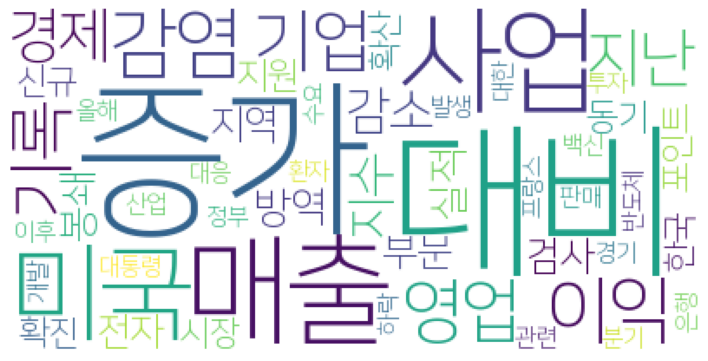

2020.10.28
[]
['사진', '열사', '유관순', '모습', '샤프']
['투자']
[]
[]
['대통령', '격리', '자가']
['철강', '경향신문', '포스코', '회장', '탄소']
['제주']
['원주']
['구리시']
['홈쇼핑', '취급', '기록', '쇼핑', '증가', '모바일']
['사우나']
[]
['환자', '치료']
['지수', '전망', '포인트', '경향신문', '소비자', '조사', '생활', '형편', '소비']
['울산', '입국']
['릴리', '치료', '항체']
['바이든', '대통령', '트럼프', '유세', '오바마', '멜라', '니아', '지원', '여사', '우리']
['할인', '여행', '방역', '지원']
[]
[]
['위러브유', '경향신문', '헌혈', '생명']
['원주', '강원']
[]
[]
[]
['치료', '릴리', '항체', '환자']
['원주']
[]
['생존']
['롯데', '전달', '박스', '캠페인', '상자', '이번', '울산', '경향신문', '레저', '지원']
['상생', '상황', '협력', '기업', '경향신문', '위기', '위해']
['보건소', '서대문구', '확진', '강남구', '추가']
['고독사', '가구', '고립', '활용', '경향신문', '예방', '지난']
['장관', '감찰', '검찰', '조선', '총장']
['이태원', '클럽', '핼러윈데이', '사람', '방역']
['사업', '할인', '방역', '정부', '소비', '외식', '여행', '숙박', '감염', '확산', '경제', '분야', '통해', '대책', '대본']
['유전자', '중증', '영역', '네안데르탈인', '관련', '가능성', '연구', '인류', '발견', '게놈', '염색체', '결과', '분석', '세포', '유전자형']
['재선', '트럼프', '클린턴', '힐러리', '역전', '바이든', '선거', '미국', '진영', '지지율', '분석', '가능

['국민', '대통령', '나라', '연설']
['부자', '자산', '투자', '금융', '소득', '한국', '부동산', '사람', '포트폴리오', '거주', '가장']
['어린이집', '방역', '관리', '점검']
['영업', '시장', '전기', '이익', '매출', '사업', '이노텍', '실적', '아이', '모듈', '기록', '각각']
['에스티', '감소', '치료', '매출', '동아', '대비', '수출', '치매', '부문']
['마련', '비대', '적용', '로봇', '규제', '산업', '기술', '로드맵', '혁신', '통해', '과제', '활용', '안전', '개선', '기준', '한국', '정부', '확산', '체계', '추진', '서비스', '뉴딜', '분야', '발전', '시나리오', '단계', '차관']
['아시아', '국제', '영화제', '필름', '어워즈', '영화', '감독', '영화인']
['캠페인', '총장']
['핼러윈', '감성', '점검', '클럽', '휴업', '주점', '동안', '라텍']
['기술', '산업', '건설', '선정', '개발', '세계', '기기', '전자', '소재', '나노', '공학', '성과']
['바이오', '개발', '투자', '항체', '치료', '회사', '허밍버드']
['종목', '구성', '정부', '관련', '주가', '뉴딜', '발표', '투자', '펀드', '정책', '기록', '성장', '지수', '변동성', '올해', '개발', '하락', '장주', '기업', '거래소', '현재', '상품', '대부분', '상황', '지적', '조정', '한국', '상장']
['쇼핑', '증가', '취급', '기록', '모바일']
['한국', '모건스탠리', '회복']
['가장', '후보', '언론', '멜라', '니아', '바이든', '남편', '퍼스트레이디', '유세', '트럼프', '평가', '미국', '대통령', '행보', '대선', '부통령']
['중국', '바이러스

['경험', '금융', '부자', '자산', '소득', '감소', '종합', '가치', '가장', '경우', '포트폴리오', '점검', '투자']
['재정']
['시설', '검사', '대상', '종사', '병원', '요양', '전수', '감염']
['병원', '요양', '시설', '검사', '대상', '종사', '전수', '감염']
['지원', '재개', '할인', '여행', '외식', '방역']
['매출', '사업', '실적', '이노텍', '아이폰', '모듈']
['백신', '세계']
['카드', '대비', '비용', '동기', '충당금', '아이', '증가', '업계', '마케팅']
['의원', '우리', '대표', '국민']
['수용', '시설', '전주교도소', '인권', '향상', '노래방', '설치']
['수용', '시설', '전주교도소', '인권', '향상', '노래방', '설치']
['기준', '증가', '순이익', '동기', '대비', '이익', '기록']
['클럽', '핼러윈', '호텔', '방역', '거리', '휴업', '이태원']
['의혹', '온라인', '강원랜드', '국정감사', '의원', '사태', '카지노', '포스트', '위기', '폐광']
['공연', '문화', '태백', '예술', '회관', '예매']
['부자', '자산', '금융', '소득', '증가', '경향신문', '감소', '부동산']
['보건소']
['평가', '대교협', '위해', '대학', '수험생', '격리', '대학별', '전문', '부총리', '간담', '교육부']
['대비', '순이익', '동기']
['달러', '환율']
['모듈', '분기', '실적', '사업', '대비', '매출', '이노텍', '증가', '기록', '동기', '확대', '성장', '종료', '제품']
['대통령', '경제', '확장', '재정정책', '회복', '국민']
['택시', '라이트', '격벽', '설치', '서비스', '기사', '차량', '베이직', '가맹', '회사',

['사용', '백신', '효과']
['넷마블', '게임', '콘서트', '강연', '주제', '기술']
[]
['통해', '코끼리', '홈페이지', '소개', '상품', '불교', '마음', '온라인', '명상', '스님', '작가', '박람회', '프로그램', '업체', '습관']
['완도', '해양', '치유', '체험', '해변', '프로그램']
[]
['장관']
['등교', '학교']
['노동', '아세안', '장관', '고용', '정책', '회의', '확대', '지원']
['중국', '문제', '경우', '인물', '주목', '당선', '우파', '정책', '스가', '아베', '대한', '디지털', '대부분', '자유', '정치', '바시', '가장', '북한', '결과', '한국', '미국', '민주주의', '평가', '정치가', '외교', '대해', '나라', '일본', '인권', '당시', '트럼프', '총리', '전랑', '대응', '한층', '김정은', '모두', '세계', '관계', '차원', '모델', '어젠다', '정권', '주변', '인터뷰', '장관', '이념', '로서', '이사장', '이후', '생각']
['회의', '한중일', '노동', '장관', '아세안', '위해', '정책', '고용', '우리', '협력']
['사망자', '방역', '핼러윈', '골프', '모임', '당국', '클럽', '국내']
['전자', '대회', '한국', '골프', '선수']
['방역', '핼러윈', '수칙', '모임']
['능력', '결과']
['소득', '가구', '지원', '감소', '평균']
['등교', '학교', '전날']
['서울시', '핼러윈', '데이', '유흥', '시설', '클럽', '방역', '마스크']
['등교', '수업', '학교', '전날']
['연장', '이상', '위기', '소득', '가구', '신청', '감소', '지원', '생계', '긴급', '기간', '완화', '기준']
['멜라', '니아', '여사', '트럼

['공연', '극장', '화재', '무대', '예술', '명동', '대표', '국립극단', '지난', '현재', '전기', '이번', '문제']
['프랑스', '신규']
['지난', '허가', '미국', '실사', '일정', '신청', '임상시험', '확산', '티스', '진행', '대한', '바이오', '플랜트', '데이터', '중단', '롤론', '신약', '평택', '환자']
['우울증', '환자', '증가', '독감', '감기', '확인', '공단']
['아이']
['프랑스', '조치', '이탈리아', '시위', '중환자실', '봉쇄']
['방역', '할인', '여행', '지원', '거리', '두기', '외식', '사업', '사회', '다음', '관광', '관리', '시설', '중앙', '소비']
['계약서', '납품', '업체', '롯데', '업자', '에스', '반품', '유통', '슈퍼', '파견', '기간', '물건', '공정위', '쇼핑', '행위']
['신규', '사망자', '유럽', '지역', '세계', '전주']
['가족', '센터', '생활', '균형', '사회', '정책', '가정', '서울시', '지원', '마련', '시간', '경제', '형태', '사람', '변화', '기업', '아이', '여성', '문화', '개인', '개념']
[]
['증상', '이상', '독감', '백신', '접종', '질환', '호흡기', '성인', '때문', '내과', '위험', '합병증', '폐렴', '병원', '사망', '치료', '입원', '진료', '감염', '경우', '예방', '노인', '대한', '예방접종', '환자', '교수', '발열', '감소', '유행', '방문', '중앙대', '동시', '효과', '면역']
['비대', '인증', '심사', '제도', '시험', '기업', '절차', '현장']
[]
['결혼', '감소']
['바이든', '미국', '도널드', '선거인단', '트럼프', '대통령', '오바마', '유세', '멜라', '니

[]
['에쓰오일', '적자']
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
['여행', '사업', '분야', '할인', '방역', '외식', '재개', '소비', '정부', '숙박']
['고려대', '소재', '의료']
['시정', '경제', '연설', '방역', '대통령', '등장', '국회', '내년', '언급', '이번', '단어', '지난해']
[]
['시민', '콘텐츠', '공모전', '광주', '부문', '홍보', '이번']
['발표', '해군', '해양', '한국', '안보', '국가', '미국', '참여', '전략', '일본', '토론회', '라며', '대한민국', '대응', '위협', '실장', '박사', '상황', '강국']
['검사', '판정', '확진']
['포스코', '철강', '회장', '철강업', '탄소']
['부산']
[]
['국회', '정부', '대통령', '상황', '국민', '청와대', '이번', '라며']
['백신', '운송', '영하', '미국', '구매', '기술', '도스', '화이자', '온도', '과정', '센서', '저장', '공급', '저온', '접종', '세계', '섭씨', '모든']
['문제', '레지던트', '의대', '의사', '의협', '정부', '응시', '해결', '의료', '인턴', '기회', '부여', '집단', '국시', '국가고시', '입장']
['자산', '증가', '감소', '계획', '부자', '금융', '투자', '보유', '한국', '비중', '영향', '응답', '평균', '현금', '주택', '아파트', '거주', '경우', '경향', '확대', '상승', '주식', '부동산', '원천', '가치']
['시위', '봉쇄', '프랑스', '조치', '이탈리아', '중환자실']
['소득', '가구', '감소', '신청', '위기', '지원', '긴급', '생계', '완화', '대상', '기준']
['소득', '가구', '감소', '신청', '위기', '지원', '

['프랑스', '조치']
[]
[]
[]
['클럽', '방역', '핼러윈']
['방역', '클럽', '핼러윈']
[]
[]
['도민', '경기도', '수술실', '의료', '설치', '대해', '운영', '동의', '조사', '병원']
['항체', '사망자', '영국', '감염']
['증가', '사업', '매출']
[]
[]
['모임', '확진', '골프', '성남', '고깃집', '지인', '가족', '판정']
[]
['감염', '중국', '무증상', '카스', '명의']
['올해', '기업', '사업', '현금']
['마린', '센터', '태양광', '기업', '평택', '사업', '발전', '설비', '전력', '항만']
['경기도', '수술실', '의료', '설치', '운영', '대해', '도민', '동의', '조사', '병원']
['시장', '부총리', '요인', '아파트', '전세']
['양성', '호날두', '이탈리아', '바르셀로나', '메시']
['거래', '호텔', '성장', '특급', '카테고리', '예약']
['인판', '티노', '회장']
['신규', '누적']
['기보']
['호날두', '양성']
['유럽', '해리스', '대변인', '병원']
['호날두', '경기', '메시', '양성', '챔피언스리그', '출전']
['매출', '영업', '증가', '대비', '이익']
['인판', '티노', '회장', '격리', '마라도나']
['방역', '예방접종', '총리']
['신규', '중환자실', '환자', '병원', '엘패소', '수용']
['주택', '분양', '부담', '시장', '공급', '방안', '정부', '부총리', '발표', '관계', '적립', '재산세']
['예방접종', '거리', '두기', '총리', '방역']
['호날두', '양성', '메시', '바르셀로나']
[]
['연설', '대통령']
[]
['감염', '식당']
['프랑스']
['집세', '미국', '입자', '사태']
['롯데', '미쉘', '바스키아', '패

['경제', '생활', '포인트', '전망', '전월', '수준', '소비', '소비자', '형편', '지수', '대한', '하락', '현재', '가계', '확산', '심리', '상승', '지난']
['포인트', '전망', '전월', '수준', '소비', '소비자', '지수', '가계', '하락', '심리', '대한', '상승', '현재', '경제', '확산', '지난', '생활', '형편']
['이번', '무상증자', '바이오', '사이언스', '주식', '발행', '액면', '분할', '총수', '기존', '보통주', '실시', '장외']
['전망', '형편', '소비', '지수', '포인트', '소비자', '가계', '심리', '상승', '조사', '현재', '생활']
['아울렛', '롯데', '행사']
['아울렛', '롯데', '행사']
['상승', '지수', '소비자', '전망', '심리', '포인트', '사회', '거리', '지난', '두기']
['소비자', '심리', '포인트', '상승', '전월', '대비']
['국회']
['지수', '시장', '발표', '미국', '대선', '예상', '기업', '지표', '봉쇄', '대비', '실적', '기술', '상황', '주가', '다시', '조치', '전월', '경제']
['도시']
['대통령', '트럼프', '오바마', '바이든', '대해', '후보', '우리']
['인판', '티노', '회장']
['항체', '사람', '면역', '결과', '바이러스', '감염', '검사', '감소']
['티파니', '인수', '명품', '협상', '소식통']
['환자', '병원', '신규', '중환자실', '엘패소']
['뉴욕', '거래', '실적', '오른']
['당신', '대통령', '트럼프', '오바마', '우리', '바이든', '때문', '대해']
['사진', '하늘', '가을', '세상', '역사']
['준비', '수능', '마스크', '시험', '수험생', '상황', '시율', '착용', '증상', '모의

['정부', '지원', '내년', '극복', '선도', '추진', '지역', '반등', '민생', '국민', '세계', '국가', '우리', '예산', '방역', '재정', '전망', '혁신', '투자', '일자리', '안정', '대한민국', '위해', '수출', '문재인', '미래', '분야', '감염병', '주거', '바이오', '본격', '성공', '모두', '시장', '상황', '노력', '공급', '지금', '더욱', '고용', '평화', '올해', '한국', '또한', '이제', '선방', '시간', '위기', '경제', '나라', '여러분', '사람', '개발', '핵심', '취약', '회복', '의지', '성과', '역할', '매우', '기관', '연금', '주체', '산업', '적극', '국회', '한반도', '반도체', '디지털', '체계', '투입', '확대', '뉴딜', '대한', '한국판', '계층']
['국가', '미래', '국회', '적극', '정책', '혁신', '계층', '공급', '더욱', '지역', '한국판', '사업', '대통령', '개발', '반등', '금융', '재정', '수출', '대한민국', '분야', '한국', '반도체', '추가', '위기', '세계', '스마트', '확산', '민생', '연설', '속도', '일자리', '예산', '여러분', '한반도', '방역', '기반', '사회', '경제', '국민', '확대', '위해', '극복', '지원', '전망', '매우', '이후', '정부', '회복', '디지털', '자금', '예산안', '역할', '균형', '뉴딜', '선도', '내년', '가장', '기업', '모두', '올해', '투자', '우리', '추진', '대한', '평화', '나라', '고용', '산업', '성과', '국방', '한편', '민간', '단어', '우선', '경쟁력']
['흥국화재', '진행', '이벤트', '응원', '캠페인']
['부자', '소득', '감소', '자산', '금융', '경우

['국토부', '유치', '세계', '총회', '교통', '강릉', '한국', '강릉시']
['유치', '세계', '총회', '교통', '강릉', '국토부', '한국', '강릉시']
['철강', '회장', '포스코', '철강업', '산업', '소재', '세계', '발표', '통해', '메가트렌드', '탄소', '시대']
['플랫폼', '시장', '전략', '디지털', '기업', '빅데이터', '사업', '클라우드', '기반', '계획', '분야']
['식품', '명란', '기술', '통조림', '간편식', '가공']
['대비', '투자', '증가', '펀드', '결성', '실적', '감소']
['사업', '세포']
['사업', '아이', '성장', '검체', '검진', '개선']
[]
['거주', '확진', '인천']
['택배', '노동자', '노동', '물류']
['영업', '수요', '손실', '매출', '기록', '이익', '증가', '스프레드', '분기', '에쓰오일', '부문', '정제', '대비', '상승']
['지연', '대통령', '국민', '야당', '관련', '우리', '개혁', '출범']
['감소', '수입', '수출', '작년']
['개발']
['원주']
['세계', '철강', '회장', '포스코', '철강업', '탄소', '강사', '산업', '발표']
['가족', '검사', '판정', '구미', '확진', '접촉']
['대출', '충남', '대전', '잔액', '담보', '증가', '중소기업', '주택', '금융기관', '차지', '지역', '가계', '각각', '수신', '부동산']
[]
['경제', '지원', '확대', '뉴딜', '디지털', '또한', '매우', '치료', '확산', '지역', '국회', '모두', '역할', '나라', '회복', '정부', '국민', '예산', '산업', '성과', '자금', '성장', '일상', '방역', '우리', '일자리', '내년', '추진', '한국판', '올해', '극복', '더욱', 

['초등학교', '학생', '포천시', '확진']
['사업', '네트웍', '성장', '고객', '렌탈', '서비스', '렌터카', '가치']
['판정', '가족', '대구', '확진', '경북', '구미', '격리', '자가', '신규']
['에쓰오일', '적자']
['클럽', '핼러윈데이', '방역', '휴업', '기간', '자체', '단속', '예고', '이태원', '우려', '인원', '당국', '결정', '영업']
['정부', '대통령', '경제', '위기', '재정', '예산안', '내년', '예산']
['설비', '마진', '공급', '증가', '수요', '부문', '상승', '에쓰오일', '스프레드', '영업', '보수', '제한', '제품', '가격', '정제', '정기', '유지', '전망']
['운영', '보험', '가맹', '상생', '이마트', '협약', '지원', '체결', '서비스', '영주', '점포', '통해', '법률', '이번', '협의', '신설', '관련', '노무', '자문']
['국가', '격리', '기간', '단축', '확산', '증상', '일부', '준수', '영국', '미국']
['백신', '유럽연합', '인구', '집행', '위원회', '전체']
['수자원공사', '사업', '중소기업', '기업', '지역', '한국', '입찰', '개선', '지방', '비중', '제도', '대화', '상수도', '낙찰', '위해']
['백신', '개발', '임상시험', '미국', '제약회사', '화이자', '공개']
['감염', '지난', '중국']
['간부']
['감염', '중국']
['도쿄', '전입', '전출']
['정읍', '시청']
[]
['부양책', '미국', '기업', '주요', '최근', '회복', '경기', '가능성', '규모', '민주당']
['학생', '포천시', '초등학교', '확진']
['경기', '노선', '버스', '성남', '판교', '운행', '좌석', '프리미엄', '경기도', '동탄', '화성'

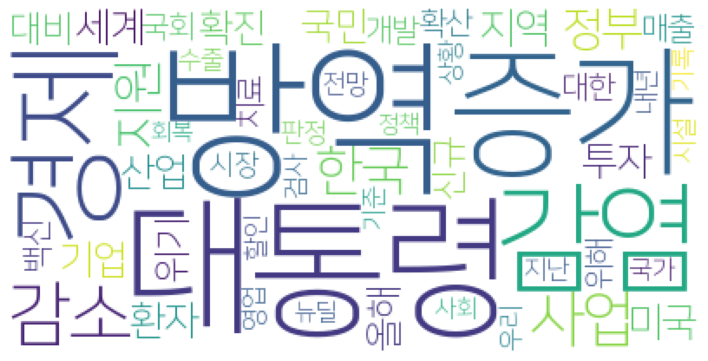

2020.10.27
[]
[]
['자금', '국민연금', '기업', '분할', '투자', '반대', '주주', '가치']
['감염']
['비정규직', '정규직', '일자리', '영향']
['입장', '총리', '본부장', '일본', '국장', '한국', '정부', '자키', '소송', '대한', '협의', '방한', '회의', '외교부', '징용', '한일', '문제', '예정', '보도', '정상', '한중일']
['일본']
[]
['무대', '조선']
['빈소', '고인', '인사', '회장', '조문', '경제', '삼성', '방문', '장례식', '오전', '그룹', '개혁', '베트남', '대사', '부회장', '이건희', '체육', '주한', '재벌']
[]
['이란', '신규']
['일본', '부산']
['조사', '구속영장', '기각', '역학', '교회', '경찰', '신청', '영장', '자료']
['현장', '안전', '영웅', '인터뷰', '의료', '위험', '매몰']
[]
['금융', '순이익', '실적', '은행', '경향신문', '증권', '부문']
['장례식', '구광모', '금융', '그룹', '조문', '고인', '빈소', '이건희', '사장', '지주', '장례', '총재', '대표', '신동빈', '롯데', '부회장', '방문', '지난', '회장', '경제', '이주열', '창업', '삼성', '이병철', '윤종규', '인사']
['일본']
['일본']
['수수료', '택배', '롯데', '조선', '노조']
['인천', '모임', '센터', '소방']
['도시', '인천']
['학생', '학급', '거리', '두기', '학교', '이하', '책상', '교실']
['사회', '방역', '관리']
['일본']
['일본']
['교사', '어린이집', '아기']
['경제', '성장', '흐름', '수출', '우리', '확산', '미국', '수준']
['입력', '조사', '사서', '활용', '역학', '데이터', '정보', 

['영업', '팩토리', '알뜰폰', '매장', '텔레콤', '온라인', '무인', '체험', '가입', '확대', '오프라인', '개통', '위해']
['성장', '확산']
['방류', '대한', '지사', '제주', '회의', '일본', '후쿠시마', '오염수']
['가족', '판정', '확진', '구미']
['가족', '구미', '판정']
['성장', '수출', '경제', '반등', '경기', '회복', '지난', '정부', '다만', '민간', '포인트', '소비', '확산']
['요양원', '입소', '지난', '발생', '확진', '건물', '종사']
['장소', '조치', '보건', '신규']
['네덜란드', '대사', '한국']
['군사', '행보', '위원장', '군단', '참관', '경기', '지역']
['대응', '방역', '의료']
['영업', '이익', '증가', '대비', '지난해', '동기', '매출']
['환자', '인지', '능력', '감염', '호흡', '곤란', '증상']
['지사', '협력', '회의', '경남', '일본', '발표', '대응']
['지사', '대응', '협력', '회의', '경남', '일본', '발표']
['발행', '규모', '상반기', '회사채', '올해', '구채', '회사', '정유', '영업', '손실', '시장']
['골프', '감염', '모임', '가족', '추가', '사례', '집단', '누적', '대본', '발생', '관련', '환자', '지난', '참석자', '시설', '경기', '명의']
['구직', '박람회', '온라인', '취업', '기업', '구인']
['환자', '능력', '감염', '결과']
['대통령', '연설', '국회', '예산안', '경제']
['사업', '제철', '현대', '영업', '해외', '가격', '라며', '수소']
['판결', '가능성', '소송', '연기', '이노베이션', '최종', '화학', '배터리', '영업비밀', '금지', '결정', '침해', '

['대응', '방역', '거리', '위험', '정부', '사회', '단계', '교수', '피해', '정책', '두기', '의료']
[]
['기록', '금융', '대비', '증가', '순이익', '은행', '부문', '동기', '이익', '글로벌', '그룹']
['지난해', '대비', '기록']
['대통령', '결정', '연기', '미국', '배터리', '분쟁', '소송', '합의']
['매출', '사업', '감소', '리테일', '영업', '이익', '대비', '편의점']
['대통령']
['교통사고', '택시', '지원', '대구시', '장착', '제품', '교통', '수집']
['대통령', '연설', '강조', '시정', '예산안', '대한', '여야', '국민', '대해']
[]
['종로구']
['시작', '정도', '전체', '접종', '예방접종', '무료', '이상', '대상자', '의료', '기관', '경우', '백신', '독감', '고령', '기준', '어린이', '일주일']
['영향', '실적', '삼성', '영업', '이익', '매출', '증가', '부문', '기록', '대비', '감소', '물산', '지난해']
['매출', '영업', '감소', '이익', '사업', '년비', '대비', '편의점', '개선', '수퍼', '지난', '기록', '영향']
[]
['보험', '보험료', '실손', '의료', '비급', '청구', '진료', '손해', '위원', '경우', '항목', '할증', '방안', '급여', '할인', '단계', '제안', '적용', '구분']
['회장', '고인', '삼성', '조문', '대표', '부회장', '장관', '구광모']
['항체', '사람', '감소', '완치', '검사']
['하락', '상승', '증시', '마감', '급락', '코스닥', '거래', '종목']
['영업', '이익', '매출', '부문', '영향', '바이오', '감소']
['소득', '감소', '신청', '위기', '가구']
['위기', '소득'

['모임', '집단', '사례', '감염', '가족', '누적', '관련', '구로구', '골프', '지인', '시설', '추가', '대본', '참석자', '경기', '환자', '발생', '확인', '명의']
['그룹', '어린이집', '부영', '보육', '지원']
['접촉', '참석', '전파', '모임', '식사', '골프', '감염', '통해', '부본', '부장']
['부문', '투자', '제철', '사업', '생산', '판매', '수익', '현대', '시장', '흑자', '대응', '가격', '통해', '관련', '회복', '계획', '이익', '제품', '개선', '확대', '수요', '가동', '전사', '설비']
['트럼프', '대통령', '바이든', '후보', '경합주', '펜실베이니아', '승리', '산업', '대선', '포인트', '사전투표', '석유', '선거인단']
['감염', '항체', '검사', '면역', '연구', '체내']
['청년', '사업', '광주', '지원', '금융', '정책', '주택', '대상', '신용', '명의', '주거', '연체', '임차보증금']
['지원', '백신', '캐나다', '디카']
['통화정책', '경제', '추가', '시장', '확산', '경기', '채권', '매입', '회의', '전망']
['대만', '지수']
[]
['소송', '연기', '판결', '이노베이션', '이번', '미국', '가능성', '최종']
['안전', '센터', '소방', '인천', '소방관']
['안전', '센터', '소방']
['하루', '지난', '평균', '감염', '유럽', '여명', '확산', '사망자', '세계']
['신뢰', '점수', '응답', '전략', '역량', '검사', '면접', '게임', '질문', '결과', '채용', '사람', '응시', '다른', '보상', '알고리즘', '표정', '시험', '야망', '자의', '평가', '담당자', '마이', '다스']
['대학', '정부', '지방', '

['행사', '규격', '반도체', '장비', '기술', '전자', '올해', '하이닉스', '공정', '출시', '소개', '기업', '낸드', '전시', '세계']
[]
['백신', '치료', '허가']
['세션', '스마트', '그린', '디지털', '혁신', '기관', '센터', '추진', '사업', '참여', '에너지', '데이터', '협력', '린산', '산업']
['스마트', '그린', '디지털', '혁신', '기관', '센터', '추진', '사업', '참여', '세션', '린산', '산업', '협력', '에너지', '데이터']
['시험', '방역', '수능', '수험생', '교육감', '운영']
['국내', '수도권', '가능성', '상황', '관련', '모임', '추가', '발생', '현재', '시설', '두기', '마스크', '발견', '방역', '접촉', '거리', '행사', '수칙', '명의', '각종', '유행', '누적', '착용']
[]
[]
[]
['창업', '관악구', '서울대', '지원', '밸리', '조성', '스타트업', '기업', '센터', '운영', '공간', '확대']
['허가', '검토', '아스', '백신', '심사', '신청']
[]
['착용', '보건복지부', '범위', '방역', '솔루션', '로봇', '스마트', '마스크', '전자', '기술', '체온계', '출입', '제품']
['학생']
['후보']
['건원릉']
['클럽', '스마일', '빅스', '마일', '데이', '혜택', '이베이', '코리아', '이벤트', '할인', '회원', '브랜드', '제공', '기간', '쇼핑']
['모임', '이데일리']
[]
[]
['시스템', '세대', '아이', '아파트', '단지', '서희', '군자', '시흥', '규모', '힐스', '주거', '스타']
[]
['예방접종', '장관', '독감', '접종']
['예방접종', '장관', '독감', '접종']
['시험', '방역', '전남', '수험생', '교육감

['정부', '서비스업', '비정규직', '정규직', '감소', '일자리', '임금', '재정', '증가', '대비', '근로자', '평균', '사업', '전환', '개월', '고용']
['이란', '신규']
[]
['선수']
['대전', '접촉']
[]
['일본']
['대전']
[]
['전북', '교육', '학생']
['시위', '제한', '현지', '밀라노', '토리노', '폭력', '조처', '항의', '경찰', '일부']
[]
[]
['대출', '가계', '금융']
['이란']
['가족', '소규모', '모임', '발생', '감염', '제사', '확진', '연합뉴스']
['올해', '임금', '비정규직', '근로자', '기간', '고용', '정규직', '격차', '통계청']
['백신', '개발', '치료', '임상시험', '진행', '항바이러스제', '중인', '허가']
['감염', '시설', '방역', '가족']
[]
[]
['후보', '대통령', '트뤼', '캐나다']
['후보', '트뤼', '한국', '대통령', '캐나다', '총리']
['직원', '소속', '안전', '센터', '소방', '인천']
['치료', '릴리', '항체', '개발']
[]
['치료', '임상시험', '백신', '진행', '항바이러스제']
[]
[]
[]
['이익', '제품', '사업', '판매', '생산', '제철', '수익', '부문', '흑자', '대응', '통해', '수요']
['대통령', '총리', '트뤼', '후보', '캐나다']
['비정규직', '정부', '일자리', '임금', '정규직', '감소', '근로자', '통계', '이후', '노인', '고용', '지난해', '기간', '때문', '영향', '증가', '오히려', '비교', '규모', '가장', '통계청']
['회장', '발인', '삼성', '조문']
['성장', '수출', '확산']
['어린이집', '부영', '보육', '그룹', '사랑', '지원']
[]
['포인트', '성장', '경제', '확산'

['증가', '사업', '확대', '매출']
[]
[]
[]
['예술', '문화']
['문화', '예술']
['어린이집', '대전']
['대전', '어린이집']
['사업', '매출', '증가', '물류', '서비스', '부문', '확대']
['환율', '달러', '미국']
['오븐', '매직']
[]
['마켓', '뉘른베르크', '크리스마스', '독일']
['개선', '성장', '회복', '수출']
['훈련', '방역', '시설', '제주']
['교육', '디지털', '유아교육', '대해']
['아스피린', '환자', '위험', '결과']
[]
['수준', '성장', '수출', '부총리', '소비', '확산', '개선']
['회복', '성장', '반등', '수출']
['신세계', '행사', '패션', '코리아', '중소기업', '백화점', '어려움', '기간']
['결과', '동생', '청원', '경찰', '자살', '아질산염', '백신', '사망', '수사', '접종', '타살', '부검', '물병', '질병']
['서비스', '대상', '회의', '혁신', '부총리', '성장', '기준', '기술', '조달', '계약', '확산', '수준', '회복', '설명', '전략', '정부', '미래', '제도', '수출', '개정', '개선', '지원', '공사', '확대', '산업', '시장', '소비', '적극']
[]
[]
['차장']
['배럿', '대선', '대법관', '인준', '연방', '트럼프', '대통령', '보수', '미국', '성향', '민주당', '공화당', '통과', '행사']
[]
[]
[]
['하락', '지수', '포인트', '거래', '한국']
[]
[]
['분기', '경제성장률', '수출', '성장']
['성남시', '환자', '골프대회', '확진', '판정']
['임원', '기업', '조사', '올해', '최연', '등기', '경영', '증가', '케이씨씨', '국내']
['원주', '접촉']
['방역', '대본', '시설', '차장

['산타', '크리스마스', '미국', '행사']
['이노베이션', '연기', '화학', '소송', '최종', '결정', '판결', '배터리', '미국']
['생활', '학생', '조사', '습관', '학교생활', '설문', '교육', '적응', '시간']
['소송', '연기', '최종', '결정', '이노베이션', '화학']
['급락', '지수', '포인트']
['미국', '결정', '연기', '이노베이션', '판결', '노컷뉴스', '화학', '소송']
['걷기', '인식', '운동', '조사', '증가', '건강', '활동', '체중', '동네', '트레이닝']
['증가', '감염', '하루', '사망자', '미국', '지난']
['지수', '하락', '포인트']
['통운', '웹툰', '네이버', '풀필먼트', '콘텐츠', '사업', '글로벌', '경쟁력', '협력', '경우', '시장', '영화', '동맹', '전망', '국내', '제작', '스튜디오', '서비스', '가능성', '물류', '드라마', '배송', '통해', '영상', '규모', '확보', '드래곤', '플랫폼']
['발생', '감염', '무증상', '중국']
['미국', '지수', '부양책', '확산', '백악관', '대선', '의장', '로시']
['현장', '노스캐롤라이나', '사전투표', '투표', '후보', '바이든', '트럼프', '대통령', '대선', '지지', '응답', '플로리다', '참여자', '유권자', '실제', '결과', '민주당', '여론조사', '지층', '경우', '조사']
['트럼프', '바이든', '유권자', '사전투표', '후보', '투표', '대통령', '지지', '미국', '조지아', '조지']
['시험', '백신', '면역', '결과', '임상시험', '노인', '반응', '후보', '물질']
['접종', '어르신', '예방접종', '수준', '백신', '이상', '인플루엔자', '올해', '사망', '독감', '신고', '사업']
['접종', '

['학부모', '학생', '인식', '학교', '대한', '교육', '수업', '변화']
['도움', '타트', '체리', '섭취', '모랑']
[]
[]
[]
['판정', '확진', '원주', '학생']
['접종', '백신', '노인', '독감', '정부', '이상']
['블록', '체인', '사업', '세미나', '기술']
['일본항공']
['원주', '강원도', '확진']
['원주', '강원도', '확진']
['개발', '바이오', '펩타이드', '에이', '조스', '모델', '활용', '물질', '예측', '지능', '역활', '플랫폼', '유도', '진행', '치료', '면역', '구축', '인공']
['오늘', '감염', '시설', '국내']
['관리', '주택', '공동', '규약', '준칙', '전남도', '경비원', '괴롭힘']
['판정', '확진', '원주', '학생']
[]
['사례', '감염', '신규', '관련', '확진', '누적', '집단', '어제']
[]
[]
[]
['거리', '두기', '위험', '대응', '교수', '최소', '정책']
[]
['전남']
['총장', '정치', '의원', '라며', '라디오', '중앙', '주장', '검찰']
['미국']
['수준', '실질', '성장', '수출', '소비', '반등', '이후', '중심', '정부', '증가', '유럽', '분기', '회복', '미국', '경제', '확산', '영향']
['감염', '전남', '지역', '검사', '해외', '추가', '지난']
['학생', '교육', '등교', '전북', '학급', '이하', '제한', '강조', '학교', '수업']
['진단', '키트', '큐릭스', '검사', '의료']
['교육', '직업', '기관', '정부', '산업', '민간', '일자리', '사업', '품질', '중복', '공급', '그간']
['수출', '성장', '중심', '한국은행', '분기', '정부', '지난', '부총리', '실질', '예상', '설명'

['규제', '이탈리아', '제한', '오후']
['개발', '테크놀로지', '개방', '서비스', '스케', '플랫폼', '기반', '건강', '경향신문', '관리', '대회', '디케이']
[]
['경제', '국민', '지역', '총리', '부처', '방역']
['라떼', '홈파티', '할로윈', '상품', '올해', '치즈', '관련', '매출', '출시', '케이크', '코스튬', '증가', '상권', '초콜릿', '리얼']
['북한', '이탈', '주민', '문화', '예술', '극복', '인문학', '예정']
['성탄', '미사', '올해', '가톨릭', '교황', '참석']
['예산']
['특검', '민생', '야당', '국민', '주장', '원내대표', '요구', '예산']
['관련', '판정', '경기', '이후', '복지', '유입', '환자', '가족', '병원', '확인', '발생', '감염', '재활', '확진', '추가', '접촉', '자릿수', '검사', '국내', '최근', '모임', '집단', '가운데', '전날', '지역', '시설', '사회', '장애인', '창원']
['사건', '원내대표', '야당', '특검', '국민', '국회', '주장']
['수준', '소비', '성장', '회복', '반등', '수출', '확산', '민간', '효과', '발표', '국장']
['택배']
['면세']
['시설', '개방', '체육']
['감염', '발생', '경기', '국내', '명의']
[]
['관련', '민주화', '운동', '전형', '입학', '의원', '혜택']
['완치']
['구글', '판매', '센터', '노출', '무료', '등록', '쇼핑']
['개미', '주주', '주식', '장관', '청원', '기재부', '라며', '국민']
['성장', '작년', '반등', '수준', '경제']
['리에주', '의료', '벨기에', '감염']
[]
['태안', '가을', '국화', '원북면', '옥파', '전시회', '주민']
['유

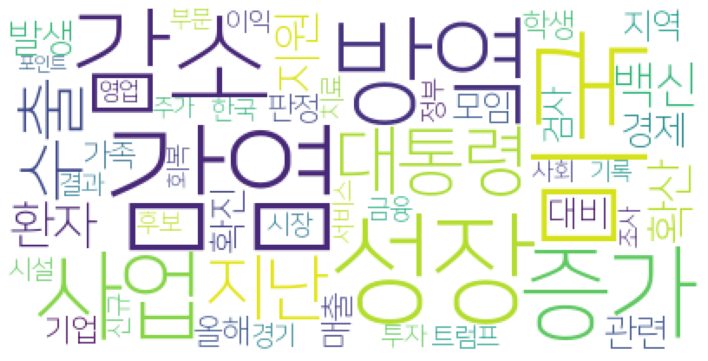

2020.10.26
['서울시', '와이파이', '사업', '서비스', '통신', '정부']
['택시', '기사', '회사', '협동조합', '조합', '조합원']
['국민은행', '임원']
['세포', '감염', '바이러스', '허파꽈리', '연구', '사람', '차원', '개발', '배양']
['연구', '감염', '세포', '바이러스', '허파꽈리', '사람', '차원', '배양', '개발']
['대전']
['환자', '응급실', '병상', '병원']
['경기도', '환경', '김포시', '진흥', '에너지', '센터', '김포', '지역', '기관']
['병원', '교수']
['원주']
['방식', '투자', '펀드', '벤처기업', '운용', '모태', '계약서', '계약', '회사', '상환']
['지역']
['감염', '무증상', '카슈가르', '중국', '지역', '환자', '조사', '대한', '사회', '여성', '지구']
[]
['사전투표', '바이든', '조선', '트럼프']
['보험', '전자', '자산', '주식', '삼성', '생명', '업법', '시장']
['택배', '전국', '노동자', '파업', '롯데', '환경']
['감염', '바이러스', '세포', '사람', '인체', '연구']
['개발', '감염', '인간', '세포', '바이러스', '폐포', '연구', '구진', '사람', '배양', '규명', '모델']
['꽃게', '중국', '어선', '조업', '불법', '조선', '해경']
['바이든', '흑인', '지지자', '우편', '지지율', '중국', '유권자', '트럼프', '대선', '투표', '포인트', '대통령', '부통령', '미국', '캠프', '유세', '민주당', '힐러리', '호황', '경선', '결과', '선거', '가장', '선거인단', '백인', '후보', '지난', '경제', '상황', '현재', '위해', '지지', '대한', '정도', '중도', '자신', '구호']
['조선', '시설',

['관련', '야간', '조치', '봉쇄', '확진', '지난', '접종', '세계', '상황', '백신', '프랑스', '우리', '국내', '나라', '감염', '확산', '다른', '마찬가지', '신규', '관리', '시설', '독감', '현재', '환자', '사람', '때문', '시간', '유럽', '대규모']
['사례', '접종', '독감', '대통령', '문재인', '백신', '사망', '예방접종', '강조']
['전국', '아동', '사례', '지난', '가정방문', '관리', '방문', '여명', '정부', '단체', '형제', '취약', '계층', '지원', '인천', '자치', '광역']
[]
[]
['정상', '회의']
['독감', '대상자', '접종', '백신', '무료', '내과', '어르신', '의원']
['이후', '달러', '환율', '약세', '위안화', '강세', '중국', '가능성']
['전남', '추가', '검사', '확진', '나주', '공무원', '판정', '감염']
['전남', '오전']
['장병', '입국', '미군']
['적자', '쌍용차', '영업']
['임원', '국민은행', '우리은행', '확진']
[]
['송파구']
['활동', '기업', '측정', '한국', '논의', '세미나', '글로벌', '성과', '회계', '전문가', '노력', '위해']
['원유', '미국', '시장']
['대출', '마이너스', '통장', '청년', '채무', '은행', '저축은행', '지난해', '조정']
['위원장', '대통령', '추도']
['소득', '가구', '신청', '지원', '감소', '긴급', '위기', '생계', '기준', '지급', '이하', '대상']
['네이버', '통운', '이번', '교환', '투자', '물류', '사업', '이커머스', '드래곤', '규모', '제안', '방식', '지난', '그룹', '양사', '제휴', '스튜디오', '업계', '업체']
['임원', '국민은행', '우리은행', '

['스폰서', '지스타', '게임', '방송', '온라인', '참가', '현장', '부산', '오프라인', '프로그램', '진행', '이벤트', '기업', '조직', '메인', '라이브']
['투표', '대선', '현장', '조기', '우편', '참여', '미국', '사전투표', '민주당', '기록', '공화당']
['부회장', '삼성', '회장', '이건희', '세계', '이재용', '그룹', '기업', '가능성']
['자가', '부산', '격리', '입국', '병원']
['검사', '감염', '발생']
['고객', '통합', '전환', '디지털', '마케팅', '기술', '솔루션', '기업', '제공', '가속', '이사', '채널', '데이터', '업체', '통해']
['학생']
['위안화', '달러', '환율', '이후', '약세', '하락', '강세', '중국', '가능성']
['강화', '콘서트']
['부실', '예방', '건설', '점검', '공사', '현장', '관리', '상태']
[]
['캐릭터', '고양시']
['집행', '사업', '예산', '관리', '재정', '경제', '규모', '대상', '경우']
['병원', '문진', '방문객', '사전', '여부']
['병원', '문진', '방문객', '사전', '여부']
['관광', '관광업']
['접종', '독감', '대통령', '백신', '부작용', '사례']
['장성호', '주차장', '주차', '기존', '규모', '다리']
['바이러스', '트럼프', '도스', '발언', '비서실', '부통령', '통제', '펜스', '라며', '유세']
['기업', '초고', '타워', '베이징', '중국', '삼성', '한국', '준공', '모집', '마오', '최근', '임대료', '신축', '관계', '센터', '그룹', '사태', '건립', '관계자', '가장', '현대차', '빌딩', '중신', '포스코', '주자', '높이', '허가', '지난', '생명']
['소멸', '수도권', '경북

['사업', '관광', '야간', '공사', '추진', '하동군', '지역', '활성화', '부산']
['백신', '개발']
[]
['엔지니어링', '가능', '보고서', '가치', '경영', '현대']
['확진', '학원', '감염', '강사', '수업']
['문해', '교육', '과정']
['캠핑장', '밀양아리랑', '오토']
['공항', '여성', '검사', '승객', '카타르', '호주', '산아']
['청렴', '업무', '한국', '거래소', '사례', '규정']
['발표', '지스타', '게임', '참가', '온라인', '스폰서', '방송', '현장', '진행', '메인', '오프라인', '부산']
['지스타', '게임', '참가', '온라인', '스폰서', '방송', '현장', '오프라인', '진행', '메인', '발표', '부산']
['게임', '지스타', '참가', '온라인', '스폰서', '방송', '현장', '부산', '메인', '발표', '오프라인', '진행']
[]
['제품', '메이크업', '눈썹', '에센스', '피부', '지난', '브랜드', '출시', '팔레트', '와일드', '매출', '아이', '라카', '마스크', '소비자']
['중증', '환자']
['외식']
['마스크', '미세먼지', '다시', '관련', '초미세먼지', '올해']
['재판', '피고인', '수원', '법정', '진행', '직원', '공판']
['기록', '판매', '손실', '실적']
[]
['시설', '본부장', '검사', '감염', '방역', '증가', '확산', '모임', '해외', '유럽', '요양', '병원', '대해']
['방역', '대통령']
['방역', '대통령']
['펜스']
['경찰', '손소독제', '판매']
['대통령', '독감', '백신', '대해', '사례', '예방접종', '방역', '접종', '사망', '대한']
['신규', '생산', '투자', '기업', '산업', '고용', '협약', '코리아', '경남', '공장'

['금융', '국제', '자금세탁', '위험', '기준']
['구호', '활동', '마음', '칼텍스', '지역', '사회', '위해', '지원', '여수', '프로그램', '전국']
['이산화탄소', '파리', '농도', '지구', '배출', '세계', '농업', '격리', '흡수', '토양', '계획', '기후', '지지', '사용', '대기', '발생', '식물', '한국', '목표', '상승', '탄소', '협약', '노력', '온실가스', '기후변화', '미국', '생산', '후보']
['택배', '롯데', '금지', '노동자', '노조', '조치', '연대', '구역', '조합원', '노동', '수수료']
['증가', '집단', '위험', '모임', '대해', '시설', '감염', '발생', '방역', '당국', '경우', '경기', '검사', '행사', '누적', '추가', '해외', '본부장', '유입', '여행', '지역', '병원', '실시', '신규', '확진', '종사']
['증가', '누적', '종사', '병원', '시설', '감염', '발생', '당국', '신규', '본부장', '위험', '확진', '방역', '유입', '여행', '추가', '모임', '경기', '행사', '집단', '지역', '검사', '경우', '대해', '실시', '해외']
['스스로', '현장', '안전', '근로자', '부문', '작업', '물산']
[]
['사전투표', '현장', '투표', '우편', '공화당', '대선', '유권자', '집계', '경향신문', '신규', '대통령', '등록', '수가', '결과', '민주당', '경합주', '조기', '트럼프', '참여', '전체']
[]
[]
['대해', '확산', '시설', '감염', '방역', '요양', '본부장', '모임', '해외', '병원', '유럽', '증가', '검사']
['통해', '정관', '홍삼', '전국', '직원', '운영', '사회', '활동', '전달', '회사', '농가']
['독

['창원', '확진', '여성', '가족', '경남', '판정', '접촉', '지난']
['감염', '백악관', '통제']
['감염', '세포', '바이러스', '연구', '이번', '경향신문', '구진']
['맥주', '지난해', '감소', '수입']
['셀트리온', '진단', '샘피뉴트']
[]
['반도체', '산업', '장비', '전자', '데이터', '기술', '행사', '기업', '하이닉스']
['데이터', '행사', '반도체', '산업', '장비', '전자', '기술', '하이닉스', '기업']
['판매', '시장', '현대차', '비용', '영업', '작년', '품질', '손실', '개선', '기간']
['감소', '수요', '불구', '판매', '대비', '동기', '영업', '시장', '이익', '비용', '개선', '기록', '현대차', '매출', '손실', '자동차', '증가', '글로벌', '지속', '실적']
['지난', '의료', '관련', '병원', '감염', '시설', '경기도', '연합뉴스']
[]
['여수시', '일자리', '박람회']
['가치', '시스템', '대우건설', '전략', '과제', '기업', '선정', '회사', '통해', '사업', '역량', '세부']
[]
['주민', '양승조', '지사', '마을']
['던킨', '체인', '스파이어', '브랜드', '미국', '인수', '이번']
['아동', '지원', '외국', '국적', '재학생', '중학교', '학교', '원금']
['등교', '수업', '학교']
[]
['평화', '사업', '관광', '정비', '화천']
['대비', '비용', '관련', '또한', '동기', '개선', '영업', '시장', '판매', '아이', '지속', '방안', '실적', '현대차', '매출', '충당금', '불구', '엔진', '품질', '증가', '이익', '글로벌', '향후', '감소', '수요', '영향', '환경', '기록', '확대', '손실', '신차', '자동차',

['재정', '반대', '위기', '시행', '준칙', '도입', '정부', '국회', '국가', '의원', '주주', '기준', '확대', '국가채무', '비율', '내용', '한국']
['국토부', '공청회', '공시가격', '부동산', '현실']
['공제', '폐업', '지급', '상공', '환급금', '사업', '재기', '우산', '올해', '안내', '중앙회']
['사업', '중앙회', '환급금', '공제', '폐업', '지급', '상공', '재기', '우산', '올해', '안내']
['업무', '사례', '거래소', '우수', '한국', '청렴', '행정', '대한', '확산', '규정', '공시', '직원']
['대웅제약', '영업비밀', '수입', '판결', '균주', '미국', '디톡스', '예비', '주장', '최종', '침해', '보툴리눔', '의견', '금지', '제품', '보톡스']
['경제', '입금', '택배', '사업', '개선', '성장', '재무', '매출', '올해', '물류', '통운', '증가', '부문', '대규모', '지난해', '기간', '글로벌', '수익', '구조', '속도', '더욱', '투자', '부담']
['합창단', '공연', '음악', '모테트', '민간', '단장', '단원', '월급']
[]
['마을', '사업', '주민', '분야', '제안', '화성', '공동체']
['지속', '가치', '엔지니어링', '가능', '경영', '보고서', '현대', '글로벌']
['우울증', '불안', '증상']
['우울증', '불안', '증상']
['인도', '감염', '상태', '최근']
['증상', '가족', '거주', '기침', '중이', '검사']
['현실', '목표', '부동산', '공청회']
['쟁의', '지난', '측은', '생산', '아이', '한국', '지엠', '협상', '회사', '행위', '결정', '차질', '노조', '매우']
['연회']
[]
['집합', '금지', '광주', '위반',

['확산', '미국', '역대', '신규', '수가', '최대']
['뉴딜', '하나', '금융', '운용', '테크', '금융투자', '정부', '투자', '선취']
['우리은행', '판정']
['확산', '미국', '백악관', '통제', '신규', '백신']
['증권', '자산']
['백신', '접종', '독감', '사망', '무료', '정부', '장관', '올해']
['기록', '미국', '프랑스', '지난']
['방한', '이유', '국내', '위원장', '바흐', '평화상', '배석', '취소', '때문', '시각', '문화재단', '한국', '파리', '방문', '스위스', '체육', '위원', '청와대', '문체부', '결정', '오후', '체육회', '스포츠']
['미얀마', '농협', '은행']
['낙동강', '모래톱', '개방', '생태', '연합', '수문', '백신', '하류', '창녕함안보', '마창진']
['개방', '낙동강', '모래톱', '생태', '연합', '수문', '백신', '하류', '창녕함안보', '마창진']
['부산', '교육청', '협의', '추진']
['부산', '추진', '교육청', '협의']
['접종', '백신', '독감', '사망', '예방접종', '강조', '플루', '전문가']
[]
['소통', '고객', '트릭', '디지털', '온택트']
['고객', '유심', '편의점', '아이', '알뜰폰', '이마트', '가입', '헬로모바일', '확대', '비중']
[]
[]
[]
[]
['회장', '조문', '그룹', '연합뉴스', '진행', '빈소', '삼성', '병원']
['회장', '빈소', '삼성', '조문', '진행', '그룹', '병원', '연합뉴스']
['고객', '유심', '편의점', '가입', '비중', '헬로모바일']
['아저씨', '아이', '소리', '아파트', '소음', '층간소음', '이사', '산이', '엄마', '마음', '띵동', '해결', '아빠', '서로', '이야기']
['예방'

['단계', '방역', '지역', '발생', '감염', '시설', '수도권', '병원']
['프랑스']
[]
['훈련', '직업', '문제', '근무', '관리', '일자리', '기술', '커리어', '관리직', '숙련', '시대', '노동자', '포스트', '기업', '교수', '시장', '조선', '원격', '중간']
['확산', '언급', '우리', '도스', '트럼프', '부통령', '비서실', '통제', '마스크', '그것', '펜스', '유세', '바이러스', '감염']
['페루', '한국', '문화', '동화', '세계', '우호', '대표', '그림', '어린이', '행사', '중남미', '대회', '대사관', '그림책', '아동', '대상', '김동휘', '도서전', '그간', '도서', '정부', '아이', '박물관']
['프랑스', '검사', '지난', '기록', '하루']
['정부', '결론', '백신', '접종', '예방접종', '독감', '사망', '사망자', '이상', '판단', '피해', '조사', '지난', '노인', '아나필락시스']
['대통령', '트럼프', '여성', '후보', '바이든', '유세', '대선', '지지', '호소', '경합주', '가장', '민주당', '해리스', '캠프', '펜실베이니아', '플로리다주', '미국', '플로리다']
['부통령', '펜스', '양성', '감염', '판정', '보좌']
['한국', '미국', '감염', '에이', '장관', '교회']
['변화', '지난', '연말', '대한', '전략', '부문', '조직', '올해', '회장', '인사', '그룹', '경영', '부회장', '삼성', '사업', '승진', '단행', '정기', '만큼', '가능성', '장단', '지난해', '관계자', '임원', '재계', '관측', '한화', '교체', '상황', '업무', '전망', '대표', '아이', '이번', '사장', '관련', '재판', '진행', '롯데']
['사업', '일자리', 

['대해', '장관', '결의', '중국', '북한', '입장', '올해']
['자연', '하늘', '해발']
['손실', '개선', '판매', '절감', '추세', '효과', '출시', '회복']
['국민의당', '대표', '의료', '봉사', '허위', '사실']
['직원', '시청', '경제']
['판정', '천안', '확진', '감염', '사우나', '지역', '입국']
['관련', '지난', '요양원', '발생', '접촉', '입소', '종사', '건물']
['대상', '백신', '개발', '임상시험', '항체', '바이러스', '다국적']
[]
['사업']
['문자', '재난', '발송', '지자체', '송출', '설정', '행안부', '의원', '지적', '정보', '보고', '대해']
['문자', '재난', '발송', '지자체', '송출', '설정', '행안부', '의원', '지적', '대해', '보고', '정보']
[]
[]
['비상', '이탈리아', '스페인', '총리', '신규', '국가', '확산', '조치', '사태', '경제']
['결혼식', '선상']
['비서실', '트럼프', '언급', '통제', '미국', '도스', '그것', '확산', '바이러스', '감염', '부통령']
[]
['백악관', '통제', '후보', '도스', '확산', '그것']
['도스', '트럼프', '언급', '통제', '미국', '그것', '감염', '비서실', '확산', '바이러스', '부통령']
['두기', '점검', '시설', '방역', '거리']
['스포츠', '표준', '대회', '중국', '이상헌', '의원', '정부', '국제', '문화']
['독감', '사망', '통계청']
['독감', '사망', '통계청']
['학생', '학급']
['감염병', '지원', '의료', '대응', '보건', '필리핀', '차관', '정책']
['기념', '김대건', '신부', '메달', '탄생', '당진', '주년']
['예술', '프로젝트', '문화', '고양

['플러스', '레드', '교육', '산림', '산림청', '온라인', '교육과정', '진행', '이번']
['생산', '공장', '현재', '넥실리스', '두께', '배터리', '대표', '증설', '제품', '정읍', '회사', '올해', '기술', '저희', '투자']
['환자', '중증']
[]
['행사', '제공', '진행', '증권', '자산', '강연', '관리']
[]
['수도권', '지역', '전날', '유입']
['대비', '통해', '손실', '기록', '판매', '영업', '출시', '올해', '실적', '모델', '연속', '개선', '효과', '회복']
['증가', '독감', '사망', '사망자', '백신', '통계', '최근', '접종']
['접종', '백신', '예방접종', '독감', '대상', '무료', '이상', '시작']
['지역']
['트릭', '고객', '가상', '소통', '전시']
['트릭', '고객', '가상', '소통', '전시']
['백신', '승인', '효과']
['시각', '미국', '감염', '인구', '현지', '우리', '도스', '봉쇄', '백신']
['방역', '질문', '백신', '시설', '발생', '감염', '확진', '관리', '전파', '가능성', '독감', '상황', '접종', '집단']
['시스웍']
['감염', '여주', '확진', '요양원', '관련', '병원', '추가', '입소', '검사', '지난', '접촉', '종사', '동두천', '시설']
['심사', '작품']
['상품', '행사', '키즈', '소개', '고객', '진행', '구매', '크림']
['검사', '나주시']
['여성']
['경남', '여성']
['경남', '여성']
['호나우지뉴', '브라질', '달러']
['관련', '로봇', '출원', '증가', '서비스로봇', '기술']
['한우', '홈뉴', '트리', '건강', '스테이크', '관리', '가지', '양념', '방법', '가장', '영양', '부위', '

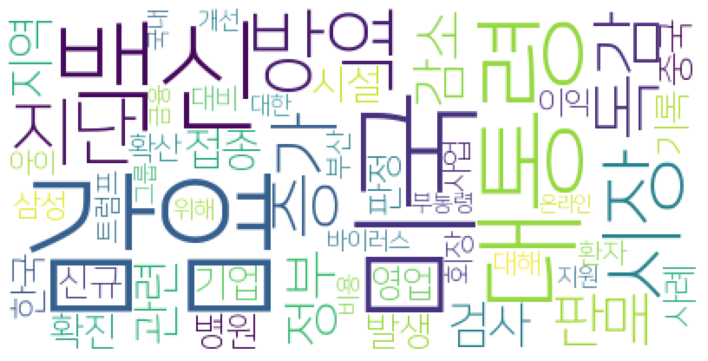

2020.10.25
['백신']
['문화유산', '콘텐츠', '몬스타', '엑스', '다보탑', '동전', '지주연']
['문화유산', '다보탑', '콘텐츠', '몬스타', '엑스', '연합뉴스', '동전', '지주연']
['대통령', '이건희', '회장', '기업', '삼성', '빈소', '유족']
['빈소', '그룹', '부회장', '회장', '삼성', '조문', '장례식', '오후', '인사', '병원', '마련', '시작', '가족', '유족', '직원']
['미래', '사회', '한국', '대응', '평가', '명견', '만리', '미디어오늘', '국민', '가장', '질문', '연령']
['미래', '사회', '한국', '대응', '평가', '명견', '만리', '미디어오늘', '연령', '질문', '가장', '국민']
['대구']
['빈소', '회장']
['확진']
['회장']
[]
['신용', '융자', '잔고', '증가', '투자자', '투자']
['확진', '여성']
['쁘라윳', '총리']
['대통령']
['콜롬비아', '누적']
['대통령']
['대통령']
['백신', '미국']
['미국', '추가']
['대통령', '한국', '빈소', '삼성', '경제']
['통해', '대통령', '지난']
['대통령', '통해', '지난']
['도쿄', '감염']
[]
[]
['미국']
['미국']
['대통령', '폴란드']
[]
['아이']
[]
['도착', '가족', '재계', '부회장', '회장', '빈소', '장례식', '삼성', '유족', '대통령', '조화', '병원', '그룹', '고인', '마련', '조문', '위로', '오후']
[]
['대통령']
['자본주의', '가치', '정부', '투자', '유럽', '경제', '지출', '민간', '도시화', '활동', '경향신문', '개념', '때문', '이후', '연기금', '역할']
['미국']
['대통령']
['시설', '지역', '감염', '관련', '발생']
['회장', '빈소', '

['대표', '처벌', '진상', '규명', '광주', '민주당', '의원', '관련', '묘지', '개정안', '지난']
['부회장', '이재용', '현장', '올해', '출장']
['회장', '장례식', '삼성', '부회장', '빈소', '가족', '이재용', '전자', '조문', '이재현', '도착', '그룹', '고인', '유족']
['기업', '상담', '뿌리']
['감염', '대해', '방역', '시설', '점검', '여부', '집단', '차장', '병원', '확산', '이용', '준수', '최근', '발생', '종사']
['프랑스']
['결혼식', '선상', '완도', '하객']
['타임', '표지']
['부산', '방역', '등교', '학교', '전면', '학생', '학부모', '감염']
['역사', '세계', '통해', '해양', '기술', '부산', '매립', '서양', '도시', '산업', '영도', '동양', '북항', '이후', '촉발', '일본', '우연']
['삼성', '전자', '부회장', '회장', '지배구조', '개편', '경영', '이사장', '체제', '호텔', '이건희', '사장', '생명', '최대', '이재용']
['빈소', '경영', '전자', '삼성', '회장', '장례식', '이건희', '그룹', '병원', '강남구', '마련', '연합뉴스', '세계', '별세', '원불교', '기업']
['발생', '관련', '확진', '인천', '시설', '판정', '요양', '요양원', '감염']
['뉴딜', '한국판', '입법', '과제']
['국민', '위원', '추천', '처법']
['편집', '부산', '일보', '부문', '차장', '지면']
['지난', '발생', '병원', '조사', '감염', '유지', '시설', '광주시', '지역', '광주', '집합', '제한']
['대통령']
['점검', '방역', '시설', '대상']
['방역', '시설', '점검', '대상']
['투자', '금리', '상품', '손실'

['예방접종', '접종', '백신', '독감', '사망', '차장', '사례', '시간', '전문가', '의견', '불안']
['페이크', '제품', '실제', '가상', '맥스', '인스타그램']
['양식', '교육', '도내', '기술', '어업', '가리비']
['경제', '세계', '산업', '회장', '삼성', '고인', '한국', '기업', '애도', '우리', '추모', '반도체', '변화']
['출산', '대한', '입양', '미혼모', '아이', '제도', '절차', '지원', '제주도', '기관', '산후조리']
['선수', '학생', '스포츠', '대회', '청소년']
['주간', '방역', '증가', '거리', '두기', '단계', '감염', '점검', '평균', '집단', '안전', '발생', '지난', '여부', '직전', '이후']
['거리', '주간', '방역', '증가', '두기', '단계', '발생', '직전', '감염', '이후', '안전', '평균', '지난', '여부', '집단', '점검']
['접종', '사례', '백신', '사망', '독감', '예방접종', '중단', '대한', '정부', '사망자']
['총리', '의원', '대선', '광화문', '포럼', '민주당']
['총리', '의원', '광화문', '민주당', '대선', '포럼']
['접종', '예방접종', '독감', '반응']
['미국']
['리비아', '원유', '증가', '유가', '미국']
['일부', '항공사', '스케줄', '오픈', '동계']
['리포트', '프렌치', '냉장고', '도어', '컨슈머', '용량', '인치', '제품', '이상', '모델', '전자', '평가']
['토론회']
['회장', '미래', '사업', '삼성', '부회장', '경영', '위기', '반도체', '전자', '이재용']
['부통령', '펜스', '확진', '판정']
[]
['트럼프', '대선', '투표', '대통령', '후보', '바이든', '경합주', '미국', '

['정부', '확인', '발생', '예방접종', '사례', '국민', '전문가', '접종', '사망', '보고', '계속', '질병', '이상', '방역', '총리', '당부', '독감', '진행', '판단', '관리']
['핼러윈', '금연', '대구', '아파트']
['삼성', '회장', '병원', '빈소', '예정']
['접종']
['박스', '완성', '영세', '업체', '가격', '시장', '국내', '제조업체', '조합', '공급', '인상', '재료', '원지', '판지', '차지']
[]
['태광', '그룹', '산업', '행사', '직원', '사회', '열사', '진행', '지난', '전달']
[]
['진행', '태광', '그룹', '산업', '행사', '직원', '사회', '열사', '지난', '전달']
['그룹', '태광', '산업', '행사', '직원', '사회', '열사', '진행', '지난', '전달']
['관련', '본인', '전자', '공감', '제한', '작성', '사천', '기간', '댓글', '매경', '레이어', '섹션', '구미', '확진', '반복', '삭제', '기사', '언론사', '활동', '모음', '원칙', '일부', '아파트', '지난', '경우', '고객', '때문', '운영', '사람', '정보', '삼성', '사업', '내용', '포토', '제공', '기업', '다시', '공유', '분류', '글쓰기', '확인', '포함', '이용']
['확진']
['경제']
['접종']
['기본소득', '지사', '경제']
['총리', '대표', '의원', '민주당', '모임']
['환자', '관련', '추가', '확진', '누적', '신규', '경기']
['뉴딜', '한국판', '대표', '추진', '지역', '노컷뉴스', '국민', '전환']
['사망', '이상', '백신', '접종', '인플루엔자', '예방접종', '사망자', '가운데', '예방', '질병', '피해', '확인', '이후', '조사', '경우',

['라파엘', '추가', '접촉']
['노인', '검사', '시설', '감염']
['환자', '지인', '접촉', '요양원', '무용', '가족', '관련', '병원', '감염', '추가', '이용자', '포함', '학원', '확진', '현재', '조사', '전파', '명과', '지표']
['과학']
['강남', '아트', '프라', '이즈']
['접촉', '감염', '추정']
['단풍', '등산', '무등산']
['기록', '철강', '포스코', '기준', '영업', '이익', '가격', '수요', '실적', '전망', '개선']
['회장', '내부']
['제주', '성북구']
['미국', '한국', '대통령', '사망자', '오바마']
['의료', '환자', '병원', '경기도', '유치', '기관', '외국인', '온라인', '해외']
['라파엘', '입소']
[]
['투자', '센터', '장비', '반도체', '신성', '케이엠', '더블유', '대비', '분야', '엔지니어링', '이후', '과천', '이전', '경기도', '관계자', '본사', '용인', '관련', '인프라', '회장']
['제주', '접촉', '확인', '김포', '오후', '아시아나', '조치']
['대출', '증가', '경향신문', '신용']
['동계', '오픈', '스케줄', '일부', '노선', '항공사', '운항', '경우', '수요']
['이태원', '거리', '클럽', '연합뉴스']
['지역', '금고', '광주', '은행', '순천시']
['김포', '접촉', '제주', '확인', '오후', '아시아나', '조치']
[]
['매출', '증가', '오프라인']
['리츠', '상장', '투자', '배당', '이지스']
['리츠', '상장', '투자', '배당', '이지스']
[]
['입소']
['우편', '승리', '예측', '투표', '결과', '선거', '개표', '조사']
['보랏', '트럼프', '대통령', '사샤', '배런', '코언', '백악관', '영화', 

['후보', '중국', '대통령', '트럼프', '바이든', '우리나라', '정책', '미국', '대선', '예상', '당선', '경제', '환경']
['자치', '산정', '지자체', '사무', '이양', '지방', '추진', '일괄', '재정', '권한', '계획', '지원', '지역', '국가', '비용', '분권', '방안']
['문서', '서비스', '모바일', '공문서']
['제지', '박스', '판지', '가격', '인상']
['모바일', '문서', '공문서', '서비스', '제출']
['환경', '기업', '박람회', '면접', '구직', '인재']
['설계', '소득', '보험', '영업', '연구원', '양극화', '사의', '현상', '고객']
['후보', '바이든', '환경', '대통령', '국제', '보고서']
['대비', '지난', '증가', '투자자', '투자', '잔고', '신용', '주가', '비율', '계좌']
['신용', '개인', '융자', '잔고', '증가', '투자', '지난해', '계좌', '주식', '종목', '이상', '투자자', '코스피', '미만', '비율', '올해']
['박스', '가격', '인상', '제지', '판지', '업계', '시장', '경우']
['농협', '로부터', '납품', '업체', '유통', '거래', '하나로', '장려', '시작', '물류']
['중국', '운항', '베이징', '한국', '정기', '위해']
['한국', '정기', '중국', '베이징', '위해', '운항']
['충전', '환경부', '수소차', '보급']
['학교', '이북', '사진전', '북간도', '도민', '모습', '현장', '전투']
['우편물', '수취', '등기', '배달', '보관', '우체국', '집배원', '장소', '지정', '위해', '개선']
['공문서', '문서', '제출', '모바일']
['행사']
['박스', '가격', '인상', '제지', '판지', '업계', '계열', '시장', '경제

['상담', '기업', '수출', '뿌리', '코트라', '비대']
['보유', '승계', '삼성', '부회장', '회장', '경영', '지배구조', '총수', '재판', '일가', '최대', '전자', '상속']
['반도체', '최고', '위원', '사원']
['상표', '디자인', '특허청', '협력', '세계', '개국', '공동', '회의', '출원', '심사']
['잔고', '융자', '지난', '규모', '용공', '신용', '증가', '작년', '담보', '미만', '반대', '투자', '매도', '용융', '별로', '하락', '계좌', '이상']
['반도체', '최고', '위원']
[]
['선언', '개발', '제주', '사업', '우려', '대해', '지사', '환경', '투자', '공항', '송악산', '추진', '라며', '대규모', '타운']
['원금', '신청']
['개발', '환경보전', '기여', '제주', '추진', '사업', '환경', '지사', '대해', '송악산', '도입', '경관', '모든', '제주도']
['관계', '중국', '북중', '친선', '참전', '북한', '전쟁']
[]
['우리은행', '검사', '확진']
['감염', '부통령', '펜스', '판정', '대변인']
['화상', '상담', '수출', '업체', '해외', '개사']
['삼성', '무디스', '기업', '사업']
['독도', '상품']
['미국', '신규', '라며', '하루']
['조치', '요양', '시설', '방역', '여부', '병원', '점검']
['홀딩스', '직원']
['인베스트먼트', '시리즈', '제페토', '투자', '파트너', '반려동물', '규모', '치료', '프렌즈']
['상승세', '개선', '전월', '개월', '연속', '자동차', '업종']
['개표', '투표', '우편', '대선', '미국', '트럼프', '결과', '대통령', '플로리다', '러스트벨트', '바이든', '후보', '유권자', '당일', '전

['백신', '접종', '예방접종', '독감', '질병', '사망', '청장', '자료', '지난해']
['협의', '주간', '기획', '양성평등', '광명시', '단체', '기념', '사진전', '행사', '사진', '작품']
['청년', '광명시', '사업', '진행', '공연', '정장']
['울릉도', '식물', '독도', '학술', '대회', '경북', '교수', '보전']
['울릉도', '식물', '독도', '학술', '대회', '경북', '교수', '보전']
['경기', '한국']
['계명대', '병원', '동산의료원', '동산병원', '대구', '지역']
['트럼프', '대통령', '바이든', '유세', '후보', '대선', '자신', '미국', '청중', '투표', '언론']
['금리', '주식', '부동산', '투자', '도박', '급등', '사람', '로또', '올해', '청원']
['시정', '부산', '시민', '보고', '내년', '여건', '계획', '부산시', '확보', '운영']
['사회', '경일대', '취약', '계층', '장터', '키트']
['지원', '관광']
['부산', '시정', '보고', '시민', '내년', '운영', '여건', '부산시', '업무', '권한', '계획', '대행']
['청년', '축제', '이데일리', '기업', '사회', '미래']
['담론', '성향', '대가', '사람', '정치', '진보', '교수', '현재', '그룹', '사회', '참여', '통해', '주도', '기회', '세대', '장기', '보수', '경향신문', '생각', '때문', '경험', '지지', '국면', '정권', '데이터', '대의', '가치', '일관']
['기본소득']
['한국', '에이', '미국', '장관', '교회', '대응', '감염']
['조처', '제한', '영업']
['미국', '마스크']
[]
['제품', '응답', '마일', '아이', '지출', '빅스', '데이', '이상', '할인', '조사'

['항공', '버블', '트래블', '해외여행', '자가', '격리', '정부', '국가', '외국인', '체결', '면제']
['영업', '매출', '증가', '이익', '세트', '최대', '생활', '건강', '예약판매', '대비', '동기', '중국', '브랜드', '위안']
['회사', '직무', '업계', '실무', '조언', '관리', '사람', '시장', '관리자', '산업', '역량', '실력', '수요', '일자리', '다른', '취업', '자신', '임원', '주니어', '외국', '채용', '경우', '커리어', '헤드헌터', '이직', '경력', '식품', '때문', '최근', '경험', '업무', '포스트', '사례', '데이터', '기업', '신입', '고민', '관련', '직장인', '업종', '기술', '플랫폼', '협력', '전문성', '시대', '대한', '지식', '진행', '온라인', '기회', '시니어', '담당', '위해', '프로젝트', '빅데이터', '영어', '조선', '영업']
['예방접종', '중단', '신고', '결과', '권고', '독감', '상황', '접종', '불안감', '유행', '지속', '청장', '질병', '인플루엔자', '백신', '사망', '사례', '사망자', '대한', '사람', '관계', '사업', '기관', '의료', '생각', '전날', '조사', '일정']
['수업', '교사', '등교', '방향', '상황', '학교']
['건강', '확인', '워치', '애플', '산소', '느낌', '혈중', '측정', '기능', '페이스', '관리', '아이폰', '수면', '손씻기', '포화', '바로', '호흡', '착용', '시간', '손목', '운동', '시계']
['백신', '우리나라', '성장', '내년', '경제', '올해', '전망', '전문가', '지난', '연구원', '망치', '조선', '한국', '정부', '비즈', '사용', '제시']
['페이', '준비', '상품', 

['투자', '기업', '기술', '지원', '서울시', '창업', '성장', '센터', '규모', '전문', '사업', '연구원', '기관', '매출', '확대', '유치', '해외', '한국', '전략', '기술이전']
['기술', '센터', '기업', '서울시', '창업', '투자', '성장', '지원', '사업', '연구원', '한국']
['한국', '기업', '기술', '투자', '지원', '창업', '성장', '센터', '매출', '사업', '확대', '자금', '연구원', '과학기술', '기술이전', '규모', '해외', '전략', '연구기관', '유치', '서울시', '기관', '전문']
['세계', '미식', '레스토랑', '관광', '한식']
[]
['서울시', '가구', '공감', '영상']
['도전', '전시']
['라이트', '작품', '시민']
['전시', '작품', '예술', '우주', '주제', '공간', '작가', '기획', '에스컬레이터', '협력', '문화', '일상', '우이', '사진', '설치', '도전', '신설']
['야영장', '가족', '야영', '방역', '활동', '텐트']
['최근', '관련', '신규', '환자', '추가', '병원', '비중', '기록', '지난', '재활', '증가', '접촉', '유입', '수도권', '감염', '감소', '구로구', '발생', '지역', '해외', '사례', '판정', '대전', '가족', '학원', '전일', '집단', '무용', '경기도', '부산', '경로', '확진', '경기', '제주', '명의']
['시설', '마스크', '착용', '과태료', '부과', '대상']
['미국', '대통령', '오바마', '한국', '인구']
['방식', '바이든', '대통령', '트럼프', '후보', '유세', '우리', '대선', '슈퍼', '경합주', '사이', '오바마', '라며', '회복']
['격리', '부대', '추가']
['위해', '지사']
['불법', '도박'

['환자', '주말']
['다른', '요양원', '지금', '확진', '방역', '건물', '감염', '어제', '병원', '당국', '판정', '지난', '확산', '시설', '가족', '추가']
['참외', '성주']
['발생', '하루', '자릿수']
['백신', '접종', '독감', '사망', '질병']
['지식', '토론회', '재산권', '재산', '협력', '극복', '세계', '사례', '경제', '국제', '공유', '기관', '이번', '분야']
['감염', '무증상', '중국', '모든']
['무증상', '감염', '중국', '모든']
['경기', '전날', '감염', '신규', '누적', '지역']
['삼성', '무디스', '그룹']
['상공', '합천군', '재난', '원금', '지원', '추가', '사업자', '부산']
[]
['기부', '삼남', '캠페인', '코오롱', '사회', '참여', '거리']
['환자', '병원', '기관', '치료', '사회', '보험', '의료', '지원', '문제', '검사', '보건복지부', '질환', '비용', '종합병원', '건강', '때문', '방역', '제주', '불평등', '상급', '입원', '정부', '대해']
['학교', '유럽', '금지']
['노선', '입국', '항공', '운항', '일본', '중국', '재개', '인천', '국제선', '확대', '항공사', '대한항공']
['금지', '유럽', '학교']
['병원', '추가', '누적', '확진', '관련', '환자', '접촉', '발생', '입원']
['접종', '수집', '사망', '윤석열', '전문', '보기', '신종', '코로나바이러스', '법무부', '정부', '올해', '백신', '재판', '감염증', '광고', '개인정보', '검사', '조사', '독감', '접대']
['평균기온', '역대', '기록', '지구', '전체', '우리나라', '올해', '기상청']
['북중', '관계', '중국']
['택배', '작업'

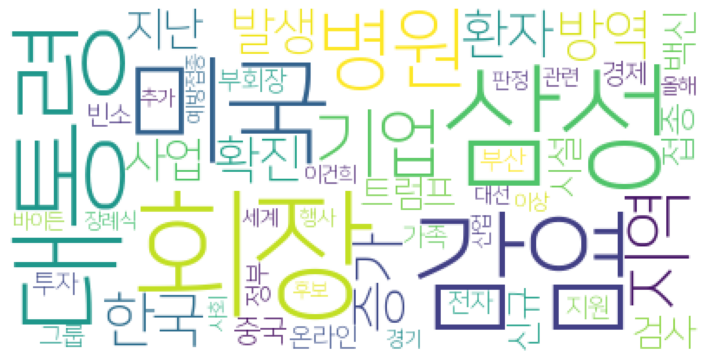

2020.10.24
['트럼프', '오바마', '대통령', '후보', '바이든', '지지자', '대선', '애리조나', '지난', '열흘', '공화당', '나라', '상황', '펜실베이니아', '민주당', '필라델피아', '이번', '앵커', '경합주', '특파원', '유세', '미국', '다시', '예측', '위해', '결과', '선거', '투표']
['때문', '백신', '접종', '독감', '무료', '건강', '관리', '사람', '경우']
['설치']
['사망', '엘리', '미국인', '박사']
['감염', '접촉', '검사', '지역', '관내', '발생']
['접종', '사망', '독감', '백신', '유행', '매우', '질병', '고려']
[]
[]
[]
[]
['환자', '유입', '퇴원', '이중']
[]
[]
[]
['경기']
[]
[]
[]
['검사', '로봇', '면봉', '감염', '의료', '위해']
[]
['입점', '어디', '부산', '배달', '남구', '상점', '사무실', '코리아', '센터', '고객정보', '제공', '경제']
['일본']
[]
[]
[]
['디지털', '혁신', '금융', '빅테크', '금융업', '규제', '테크']
['독감', '백신', '접종', '시민', '병원']
['공연', '연습', '위해', '관객', '무대', '방역']
['비행', '상품', '여행', '관광']
['언론', '미디어오늘', '중앙', '비판', '지원', '사업', '취재', '기획', '지방정부', '도움', '방식', '주장', '예산', '기금', '지역', '역량', '발전', '신문', '경우', '대한', '개선', '인정', '재단', '지적', '관계자', '해당', '문제', '효과']
['정부', '택배', '노동자', '배송', '부산', '과로사', '죽음', '대책', '노동', '호소', '지난', '오후', '근무', '얼마나']
[]
['신규', '워싱턴']
['롯데', '상품']
[

['마당', '소리', '방아', '행사', '마도']
['검사', '학원', '부천', '초등학교', '학교', '초등학생', '해당', '확진', '부천시']
['경제', '세계', '침체', '시장']
['경제', '세계', '침체', '시장']
['하이닉스', '인텔', '낸드', '시장', '기업', '공장', '플로', '게이트', '다롄', '플래시', '사업', '평가', '분석', '계약', '생산', '개발', '반도체', '수준', '세계', '방식', '인수', '투자', '대해']
['공동', '시위', '비정규직', '경남', '노동자', '차량', '윤성효', '전국', '학교', '노동조합', '오후', '궐기', '교육청', '대회', '누구', '도로', '철폐', '차별', '우리', '아이', '영남권', '행동', '집회', '지부', '교육']
['코스피', '대선', '개인', '금융', '전자']
['제품', '이건창', '건축']
['단풍', '국립공원', '연합뉴스']
['호떡', '이디야', '통차', '커피', '대추']
['경북']
['경북']
['학원', '부천시', '초등학생', '확진', '부천']
['산악', '자동차', '영화제', '올해', '영화', '상영', '관람객', '연합뉴스']
['이상', '백신', '접종', '독감', '예방접종', '신고', '반응', '사례', '인과성', '가운데', '사망자', '사망', '질병', '관련']
['대통령', '파우치', '소장', '트럼프', '회의']
['학원', '부천시', '초등학교', '검사']
['학원', '확진', '초등학생', '판정', '초등학교', '검사']
['감염', '신규', '의료', '기관', '추가', '지역', '발생']
['광고', '고문', '이방', '트럼프', '대통령', '링컨', '프로젝트', '쿠슈너', '변호사']
['활동']
['경북']
['경북']
['접종', '사례', '독감', '사망', '백신'

['그림', '대통령', '미술', '화가', '저자']
[]
[]
[]
[]
['독일']
['판정', '대통령']
['추가', '신규', '확진', '감염']
[]
['유엔', '킨타', '북한', '인권', '보고', '공무원', '사건']
[]
['오늘', '응원', '캠페인', '연합뉴스']
['사망', '질병', '매우', '예방접종', '인플루엔자', '사례', '결과', '백신', '대해', '접종', '청장', '판단', '검토', '조사']
[]
[]
[]
['항공', '운항', '승무원', '기내', '고도', '위해', '관광', '풍경', '승객', '제공', '캐빈', '아시아나', '비행', '선회', '한라산', '기내식', '이번', '상공', '때문', '통해', '모두', '감상', '여행', '제주', '면서', '항공기', '탑승']
['예방접종', '유행', '정도', '계속', '문제', '질병', '과정', '인과성', '사망자', '상황', '신고', '판단', '관련', '사인', '노력', '위험', '반응', '조사', '확인', '올해', '아나필락시스', '지속', '얘기', '대해', '이상', '대한', '피해', '하나', '기관', '가장', '교수', '접종', '말씀', '부분', '감염', '오늘', '회의', '시기', '독감', '결과', '때문', '어르신', '당국', '인과관계', '백신', '사례', '인플루엔자', '관리', '검토', '부검', '사실', '보통', '앵커', '저희', '가지', '중증', '제조', '유통', '사항', '모두', '지금', '신상', '방역', '경우', '이후', '결론', '사람', '사망', '의료', '매우', '국민', '현재', '어찌']
['폴란드']
['유행', '방역', '상황']
['예방접종', '접종', '조사', '인플루엔자', '사망', '사례', '결과', '질병', '유행']
['사망', '예방접종', '접종']
['폴

['농협', '안동', '일손', '부족', '농가', '올해']
['신청', '최대', '안정', '제도', '융자', '자금', '이용', '이상', '생활', '임금', '감소', '개월', '생계비', '혼례', '소득']
['역사', '총리', '청산리대첩']
['우리은행', '검사']
['울산']
['울산']
['요양원']
['요양원']
['이데일리', '가족']
['부산', '환자']
['후보', '미국', '대통령', '바이든', '트럼프', '대선', '북한', '민주당', '김정은', '인터뷰']
['서비스', '타이어', '출장', '교체', '이혁', '세차']
['미국']
['국내', '착용', '발생', '관련', '방역', '시설', '명의', '확인', '병원', '검사', '행사', '추가', '발견', '또한', '모임', '시기', '신고', '거리', '준수', '치료', '주시', '증상', '상황', '두기', '마스크', '다음', '환자', '현재', '사람', '누적']
['매출', '배달', '마트', '편의점', '민족', '김문영']
['캠핑장', '예약', '사기', '자리', '강세훈', '인터뷰', '장박']
['단풍', '설악산', '탐방', '사람', '길환']
['수업', '두기', '대면', '학생', '거리', '진행', '전면', '비대', '방침', '학교', '게시', '지난']
['부산', '환자', '추가', '발생']
['부산', '환자', '추가', '발생']
['판정', '부산', '평강', '의원', '감염']
[]
[]
['오피스', '공유', '기업', '지점', '공간', '통해', '부동산', '국내', '운영', '제공', '투자', '호점', '오픈', '아이', '강남', '업무', '어학', '매출', '계약', '강남역', '지난', '공급', '플러스', '서비스', '패스트', '건물', '상장', '스파크', '빌딩', '파이브', '시장']
['회장', '노

['면제', '재정', '준칙', '수지', '통합']
[]
['억새', '남알프스', '신불산']
['유행', '미국', '한국', '하루', '수가', '지금', '상황', '방식', '감염', '대응']
['내년', '국가', '문재인', '지난', '지출', '대비', '혁신', '규모', '결과', '시사', '회의', '차관', '조사', '위원회', '비공개', '편성', '부총리', '정부', '예산안', '올해', '이데일리', '장관', '이후', '뉴딜', '청사', '동향', '점검', '계획', '기재부', '연구원', '전망', '국가채무', '한국', '준칙', '정책', '대책', '주간', '입장', '예산', '상승', '경제', '부가', '기획재정부', '적자', '재정', '국회', '증가', '심의', '기업', '이하', '기준', '한국판', '산업', '시행', '세종', '성장', '고용', '확장']
['재정', '준칙', '경우']
['시민', '교대', '경복궁', '덕수궁']
['여성', '대통령', '트럼프', '사회주의', '후보', '바이든']
['바이든', '후보', '트럼프', '대통령', '대선', '민주당', '여론조사', '포인트', '선거인단', '경우', '경합주', '투표', '예측']
['입국']
['미국', '지난', '이상']
['석유', '판매', '경유', '등유', '가짜', '소비자']
['석유', '판매', '경유', '등유', '가짜', '소비자']
['대표', '광주', '열사', '참배']
['충북도', '지역', '수당', '농민', '지원', '감소', '교부', '재정', '법안', '농업인', '경우', '공익', '농어', '예산']
['올해', '보편', '투표', '우편', '선거', '용지', '유권자', '대선', '지적', '부재자', '서명', '미국', '사기', '가능성', '현장', '사전투표', '공화당', '확대', '등록']
['투표', 

['최우수', '호반', '건설', '협력', '평가', '등급', '상생', '그룹', '상호', '업계', '공정', '협약', '우수', '동반성', '거래', '위해', '해소', '중소기업', '이상', '획득', '위원회']
['사회', '참여', '위원장', '사무', '민주', '노총', '대화', '후보', '선거', '회의', '본부장', '도부', '지난', '위원회', '원장', '부위', '총장', '등록', '노조']
['가지', '램프', '네이버', '기능', '조명', '스피커', '생각', '스탠드', '독서', '기기', '충전', '경험', '사과', '때문', '음성', '아이', '이용자', '스스로', '영어', '출시', '점도']
['공헌', '진행', '사회', '활동', '비대', '그린', '직원', '헌혈']
['규제', '샌드박스', '정부', '지역']
['설계', '개발', '브랜드', '구미', '단지', '아이파크', '아파트', '구미시', '세대', '분양', '산업', '주택', '공원', '적용', '공간', '경상북도', '포스코건설', '청약', '모델하우스', '지역', '면적', '전용']
['펜타시큐리티', '클라우드', '보안', '스타트업', '브릭', '대표', '시스템']
['서비스', '안이', '반대', '기반', '사업', '주민', '발의', '투표', '운전자', '리프트', '통과', '기업', '시행', '계약', '회사', '부결', '캘리포니아', '우버', '때문', '공유경제', '찬성', '대통령', '기존', '선거', '이번', '중단', '결정', '노미', '운명', '결과', '상황']
['공연', '온라인', '컴퍼니']
['유엔', '위해', '보고', '북한', '한국', '킨타', '인권', '대표', '인도주의', '사건']
['우리', '전력', '분석', '사람', '지난', '포병', '무기', '북한', '중앙', '부분', '주년

['키트', '요리', '아동', '가족', '프로그램']
['토론', '대선', '후보', '평가', '바이든', '트럼프', '우리', '그것']
['스튜디오', '교육', '온라인', '콘텐츠', '제작', '영상', '미디어', '센터', '실시간']
['블랙', '디스플레이', '라이트', '때문', '사용', '발광', '컬러', '노컷뉴스', '제품', '소자', '스스로']
['신내', '사랑', '주민', '콜센터', '활동']
['콜롬비아', '부통령']
['콜롬비아', '부통령']
['임상시험', '백신', '부작용', '아스', '후보', '재개', '물질']
['지수', '시장', '부양책', '대선', '미국']
['어선', '중국', '단속']
['건물', '요양원']
[]
[]
['치료', '렘데', '시비르', '결과']
['토론', '대선', '시청자', '트럼프']
['토론', '대선', '시청자', '트럼프']
['중국', '민족주의', '정부', '마오쩌둥', '우한', '왕팡', '주석']
['지수', '미국', '대선', '증시', '부양책', '거래', '기록']
['미국', '부양책', '지수', '대선', '증시', '거래', '기록']
['동생', '형제', '학교']
[]
['중소기업', '제품', '홈앤쇼핑', '일사천리', '상품', '사업', '영양', '김치', '지역', '통해', '지원', '하루']
['게임', '파트너', '쏘나타', '라인', '스포츠', '프로게이머', '카트라이더', '리그', '선수', '시즌']
[]
['대선', '부양책', '지수', '미국', '시장', '민주당', '지속', '포인트', '합의', '관련', '트럼프', '후보', '상황', '대통령', '바이든']
['유럽', '확산', '스페인', '감염']
['필수', '감소', '섭취', '단백질', '비타민', '이상', '유병률', '결과', '세대', '영양', '여성', '연구', '식품']
['경기',

['지난', '우울', '교수', '상황', '정신건강', '문제', '블루', '정신', '건강', '아이', '결과', '자신', '경험', '대상', '조사', '센터', '극단']
['펑기', '마을', '주민', '돌고래', '모습', '아일랜드', '딩글', '지난', '일부']
['대통령', '우루과이', '기간', '세계', '재임', '국민', '게릴라', '사업']
['코이카', '사무소', '감봉', '여성', '직원', '징계', '사례', '진술']
['데크', '도산', '안동', '마을', '선비', '순례', '시작', '퇴계', '조성', '길이', '수상', '단지', '안동댐', '고향', '서당', '군자', '문화', '호수']
['비율', '재생산', '신규', '정보', '이상', '의미', '지역', '전파', '감염', '상황', '파악', '방역', '관리', '지수', '공개', '유행']
['영화제', '국제', '부산', '영화', '관객', '행사', '주말', '진행', '분위기', '오프라인']
['이후', '의혹', '의원', '장관', '금리', '시장', '지난', '부동산', '정책', '전월세', '때문', '가격', '국감', '전세', '국토부', '주택', '여야', '골프장']
['가장', '식감', '두부', '곤약', '미역', '소스', '국수', '냄새', '출시', '탄수화물', '제품', '라면', '비빔', '나트륨', '다이어트', '음식', '편이', '시도', '국물']
['프랑스']
['사람', '검사', '학원', '강사']
['사망', '감염', '병원', '방역', '독감', '백신', '전날', '모임', '재활', '당국', '지역', '우려', '시설', '집단', '확산', '접종', '상황', '발생']
['거리', '방역', '테이블']
['감염', '병원', '방역', '독감', '백신', '발생', '집단', '모임', '재활', '확산', '당국'

['홉스', '국가', '권력', '시민', '리바이어던', '자유', '위해', '사회', '서로', '얼굴']
['경제', '중국', '미국', '세계', '위안화', '달러', '무역', '최근', '은행']
['사람', '거리', '한번', '약속', '사회', '두기']
['콘서트', '디엠지', '평화', '가치', '방역']
['에이', '백신', '접종', '미국', '장관', '준비']
['유동성', '경제', '대출']
['이용', '현금', '중국', '모바일', '결제', '선전', '자동']
['뮤지컬', '캣츠', '공연', '리지', '한국', '배우', '무대']
['백신', '접종', '사람', '면역']
['건강', '경우', '백신', '접종', '독감', '무료', '관리', '사람', '때문']
['기업', '지난해', '올해', '한계']
[]
['예술', '축제', '어린이', '놀이터', '키즈', '트리', '날레', '공장']
['어사', '단풍', '무주', '거리', '구천동']
['백신', '질병', '매우', '관리자', '발생', '사람', '효과', '리스크', '테러']
['관리', '백신', '접종', '독감', '병원', '예방접종', '사망', '질병', '무료', '의협', '정부', '신고', '내과', '권고', '사망자', '수입', '이상']
['결과', '대통령', '바이든', '대선', '선거인단', '토론', '지지율', '지난', '민주당', '트럼프', '이번', '확보', '포인트', '경합주', '승리', '격차', '후보', '공화당', '투표', '현재', '위해', '애리조나', '여론조사']
['의협', '권고', '사망자', '백신', '접종', '독감', '병원', '예방접종', '사망', '내과', '신고', '정부', '수입', '무료', '이상', '관리', '질병']
['주춤', '추위', '가을', '미세먼지', '기온']
['역사', '일본', '접촉',

['관절', '손상', '의학', '경우', '백년', '산소', '신체', '무산소운동', '근육', '허리', '척추', '윗몸일으키기', '때문', '치료', '우리', '시청', '반대', '감소', '요추', '정선근', '디스크', '통증', '환자', '운동', '시작', '정도', '좌독', '사망률', '크게', '교수', '동작', '재활', '자세', '가지', '하루', '유산소운동', '어깨', '저주', '과정', '시간', '근력', '엉덩이', '개월', '상태', '방법', '문제', '병원', '요통', '사람', '탈출', '중강', '이상', '무릎', '위해', '다시']
[]
['신규']
['확진', '추가', '누적', '가족', '관련', '전날', '발생', '감염', '접촉', '기존', '학원']
['협의', '치구', '전국', '기초의회', '의회', '회장', '강화', '노력', '경제', '의장', '의원', '확대', '지방의회', '군자', '권한', '시도', '분권', '자치', '대표']
['우리은행', '검사']
['감염', '태국', '여성', '판정', '당국', '격리', '확진']
['사망자', '미국', '마스크', '보고서', '이번', '머레이', '디렉터']
[]
['경남']
[]
['발생', '확진', '판정', '대전', '기준', '지난', '지역', '접촉', '사우나', '해외', '누적', '자가', '전날', '추가', '신규', '관련', '검사', '감염', '명의', '천안', '증세', '병원', '격리', '감소', '인천']
['미국']
['유엔', '대한민국']
['접촉', '추가', '확진', '누적', '가족', '관련', '전날', '발생', '학원', '감염', '기존']
['환승', '할인', '광역', '진주시', '진주', '시스템']
['계약', '이용', '국내', '송금', '카카오', '온라인', '투자', '클래스', '서비스', '

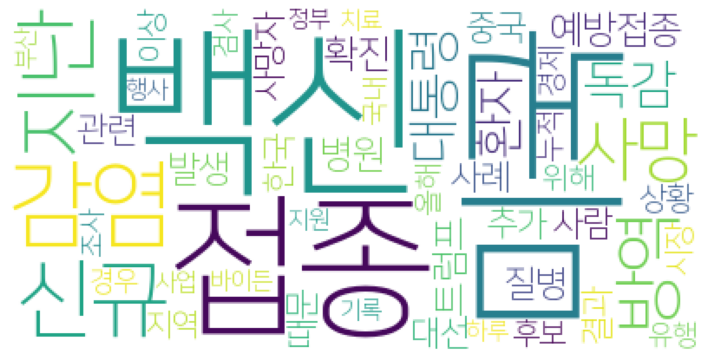

2020.10.23
['예방접종', '검토', '접종', '사망', '질병', '백신', '사례', '대해', '이상', '확인', '결과', '현재', '진행', '논의']
['협의']
['접종', '독감', '백신']
['마을', '탄소', '지정', '청정', '청암면', '중립', '벨트', '완성', '대표', '단계', '추진']
['장관', '사진', '전세']
['장관']
['대면', '행사', '방역', '공연', '이번', '콘서트', '경제', '문화', '예술', '온라인', '디엠지', '음악']
['예방접종', '독감', '이데일리', '피해', '조사', '대해']
['부천시']
[]
['미얀마', '코이카', '국내', '피난민', '방역', '지원', '협력']
['강원', '관광', '여행사', '강원도']
['독감', '지난', '접종', '백신', '광주', '오늘', '병원', '여수', '방역', '사망', '당국', '사례', '영암', '신고']
[]
['충남', '백신', '접종', '사망자', '독감', '사우나', '대전', '천안', '감염']
['경영', '그룹', '스토리', '전략', '경향신문', '파이', '낸셜', '기업', '가치', '세미나']
['요양원', '집단', '확진', '종사']
['일본']
[]
['바이든', '트럼프', '후보', '조선', '토론', '김정은']
['트럼프', '바이든', '후보', '대통령', '북한', '민주당']
['공단', '공장', '산업', '단지', '업체', '조선']
[]
[]
[]
[]
[]
[]
['고령', '가장', '감염', '유럽', '조치', '이상', '봉쇄', '노인', '각국', '인구', '연령']
[]
[]
[]
[]
[]
['사장', '수위']
['사장', '수위']
['방역', '사례', '감염', '백신', '이후', '병원', '독감', '예방접종', '사망', '시설', '권고', '관련', '클럽', '예정', '질병'

['반려견', '스튜디오', '반려동물', '보호자', '가족', '간식', '경우', '체험', '부스', '우리', '시식']
['아스피린', '환자', '위험', '결과', '혈전']
['실행', '스토리', '파이', '낸셜', '성장', '회장', '신뢰', '그룹', '가치', '세미나', '방안']
['부산시', '만덕동', '주민', '출입', '방역', '감염', '제한', '혐오', '의원', '조치']
['갤럭시', '출시', '노트', '시리즈', '일정', '기능', '내년', '인식', '삼성', '예상']
['갤럭시', '출시', '노트', '시리즈', '일정', '기능', '내년', '삼성', '인식', '예상']
['임금', '러시아', '노동자', '노동', '이민', '부족', '인력', '분야', '중앙', '정도', '배송', '시장']
['접종', '사망자', '사망', '백신', '독감', '신고', '질병', '중단', '사례', '시민', '병원', '예방접종', '질환', '확인', '입장']
['에프', '상장', '화장품', '소재', '성장']
['요양원']
['본부', '분류', '택배', '투입', '인력', '우정', '사업', '노동자', '추가', '노조', '통운', '과로사', '주장', '발표', '추석']
['바이러스', '비말', '사용', '마스크', '마네킹', '실험', '경우']
['전략', '파이', '낸셜', '스토리', '신뢰', '시장', '기업', '세미나', '제시', '공감', '성장', '기업가', '관계', '가치', '회장', '실행', '그룹', '변화', '이번', '중심']
['북미', '북한', '남북', '정부', '대화', '협력', '이후', '비핵화', '선언', '협상', '미국']
['사례', '오마이', '지금', '사망', '청장', '보도', '백신', '상황', '독감', '생각', '현재', '인플루엔자', '교수', '설명', '한국', 

['사망', '신고', '사례', '백신', '접종', '질병']
['네덜란드']
['수사', '검사']
['백신', '접종', '독일', '조선']
['올해', '택배', '노동자', '투입', '과로사', '인력', '추석', '대책', '위원회', '부산']
['방문', '중국', '방한', '한국', '장관', '일본', '다음', '폼페이', '가능성', '부장']
['국민카드', '미얀마', '현지', '전달', '티셔츠']
['문화', '아세안', '장관', '회의', '박양우', '협력', '기구', '아시아']
['수업', '대면', '강원']
['의약품']
['의약품']
['후원', '보육원']
['자산', '감소', '증가', '한국', '억만장자', '세계', '경제', '수준', '백만장자']
['복지', '사회', '기관', '올해', '재단', '지역', '차량', '전달', '지원', '회복', '지난', '전국']
['복지', '사회', '기관', '올해', '재단', '지역', '차량', '전달', '지원', '회복', '지난', '전국']
['교육청', '나래', '재정', '유치원', '공영', '운영', '사립', '공립', '부담', '공공']
['재정', '공공', '유치원', '공영', '운영', '교육청', '나래', '사립', '공립', '부담']
['인류']
['사단', '기념', '작전']
['수백', '주장', '접종', '사망', '대한', '국내', '중국산', '연구', '지난', '재단', '미국', '독감', '사업', '백신', '내추럴', '게이츠', '팩트', '게재', '중국', '연합뉴스', '바이오', '회사', '제조', '인도', '정부', '온라인']
['감염', '신규', '기록', '병원']
['대비', '하나', '금융', '분기', '동기', '이익', '누적', '충당금', '배당', '증가']
['총괄', '명품', '백화점', '신세계', '사장', '고객']
[]
['디

['의사', '접수', '시험', '관련', '국민', '의료', '정책', '대해', '실기', '청원', '의대', '라며', '논의', '취소', '비서', '정부', '대한의사협회']
['접종', '기관', '어린이', '의료', '예방', '이상', '어르신', '위탁', '무료']
['회식', '전망', '거리', '두기', '저녁', '직원', '완화', '단계', '회사', '경기']
['국민', '참여', '국세청', '납세', '서비스', '국세', '개선', '논의', '행정']
['사람', '면서', '백신', '팩트', '체크', '정보', '관련', '대한', '저널리즘', '오마이', '감정', '인포', '사실', '언론', '재단', '보도', '인포데믹', '혐오', '접종', '데믹', '루머', '독감', '방역']
['감염']
['분향소', '우리', '공화당', '서울시', '철거', '광화문', '광장', '대통령', '기간']
['이익', '대비', '생산', '회복', '감소', '증가', '매출', '영업', '완성', '물류', '해외', '글로비스', '판매', '물량']
['참여', '코세', '추진', '행사']
['역학', '천안시', '조사', '사우나', '고발', '조치', '동선', '접촉', '관련', '단계', '확진', '일보', '수준', '판정']
['대비', '이익', '동기', '감소', '글로비스', '부문', '영업', '매출', '지배구조', '모비스', '유통', '현대차']
['공모', '상장']
['청원', '경제', '국민', '정부', '답변', '청와대', '시무', '부동산', '정책']
['독감', '백신', '접종', '사망']
['청원', '욕구', '관료', '답변', '가치', '군왕', '대해', '아이', '어미', '대신', '정부', '부동산', '거리', '권리', '국가', '실리', '또한', '감성', '외교', '소인', '꿀꿀', '위해', 

['병원', '등교', '환자', '개교', '광주', '중학교', '방역', '조치', '당국', '입원', '감염', '접촉', '대해', '격리', '전남', '검사', '추가', '초등학교']
['독도', '사랑', '운동', '티셔츠']
['질문', '도널드', '미국', '트럼프', '대통령', '인터뷰', '앵커', '마스크']
['백서', '동래구', '대응', '과정', '대한', '발생', '내용', '상황', '부산']
['부산']
['환자', '검사', '부산']
['대웅제약', '디톡스', '판결', '보툴리눔', '균주', '최종', '영업비밀']
['독도']
['택배', '투입', '사업', '분류', '우정', '본부', '인력', '노동자', '주장', '발표', '통운', '노조', '과로사']
['투입', '우정', '통운', '택배', '분류', '사업', '본부', '인력', '노동자', '과로사', '주장', '노조', '발표']
['대해', '일자리', '평균', '사회', '미래', '대응', '평가', '가장', '만리', '우리', '국민', '복지', '제도', '명견', '전체', '조사', '낙관', '세대', '양질', '한국', '답변', '응답', '상황', '과제', '연령', '대한', '미디어', '비관', '방역', '강화', '팬데믹', '능력', '경제']
['명견', '만리', '사회', '미래', '대응', '평가', '가장', '답변', '미디어', '우리', '전체', '평균', '낙관', '응답', '일자리', '강화', '국민', '방역', '양질', '과제', '상황', '대해', '비관', '경제', '능력', '팬데믹', '연령', '제도', '조사', '한국', '세대', '대한', '복지']
['가격', '실적', '전망', '장기', '포스코', '판매량', '분기', '영업', '증가', '이익', '흑자', '지난해', '가동', '개선', '가장', '감소', '목표

['특산', '쇼핑몰', '지역', '속초', '대응', '활성화', '지원']
['프랑스', '조치', '유럽', '중심']
['프랑스', '조치', '유럽', '중심']
['부회장', '출장', '베트남', '사업']
['지시', '어쨌든', '비판', '여러', '부하', '계속', '관리', '생각', '장관', '수사', '검사', '대해', '대검', '의원', '얘기', '지휘', '검찰', '부분', '감찰', '발언', '상황', '필요', '하나', '검찰총장', '거기', '추미애', '임기', '충돌', '사람', '다시', '발동', '청장', '여야', '이종근', '앵커', '보고', '조금', '검찰청', '사퇴', '특검', '지금', '정치', '때문', '가지', '관련', '여당', '논리', '법무부', '어제', '최창렬', '국민', '라임', '청문회', '오늘', '민주당', '사건', '대한', '의혹', '국감', '그때', '대통령', '말씀', '총장', '윤석열', '사실', '문제', '문재인', '독감', '진행', '질문', '전문가']
['할인', '문화', '행사', '참여', '올해', '코세', '산업부', '추진', '소비', '유통업', '코세페']
[]
[]
[]
[]
[]
[]
['평가', '포인트', '지지율', '하락', '부정', '민주당']
['시설', '발생', '방역', '요양', '증가', '감염', '단계']
[]
['시비르', '임상시험', '식약처', '치료', '렘데', '결과', '사용', '발표', '환자', '판단', '시험']
['미세먼지', '기후', '자동차', '유세', '유차', '운송', '환경', '화물자동차', '국가', '조정', '회의', '인상', '가격', '과제', '경유']
['환자', '집단', '독감', '방역', '접종', '우려', '감염', '백신', '의료', '당국', '시설', '경우', '최근', '일선', '하루', '병

['유정', '백신', '접종', '독감', '사망', '방식', '사례', '세계', '신고', '효능', '매년', '수입', '생산', '국산']
['재산세', '서초구', '조례', '서울시', '공포', '지난', '거부']
['부회장', '베트남', '삼성', '사업', '전자', '출장', '총리', '부산']
['코세', '소비', '규모', '행사', '코세페']
['백신', '의료', '대한', '중단', '사망', '발생', '안전성', '증후군', '지난', '사례', '독감', '문제', '예방접종', '건강', '의사', '접종', '관계', '예방', '박사', '고령', '이상', '한국', '미국', '예상', '협회']
['포스코', '분기', '회복', '각각', '판매량']
['천안']
['위원장', '김정은', '대통령', '오바마', '북한', '트럼프', '바이든', '관련', '대해', '질문', '사회자']
['확진', '집단', '병원', '감염', '경기', '격리', '요양원', '판정']
['사전', '국회', '제한', '방역', '조치', '출입', '유지', '회의장', '세미나', '인원', '완화']
['증가', '기록', '투자', '생산', '대비', '분기', '포스코', '이익', '판매량', '기준', '수익', '영업', '원료', '제품', '확대']
[]
['추가', '검사', '광주', '병원', '환자', '입원', '조치']
['환자', '신규', '미국', '확산', '치료', '렘데', '시비르', '입원', '노스다코타주', '겨울']
['사업', '철강', '세계', '포스코', '대비', '기록', '증가', '제품', '부문', '철광석', '실적', '회장', '분기', '판매량', '이익', '회복', '올해', '가격', '성장', '수익', '원료', '경제', '수준', '기준', '영업', '개선']
['포스코', '판매', '철강', '실적', '제품', '

['방역', '병원', '시설', '감염', '단계', '집단', '지난', '지인', '발생']
['사례', '백신', '추가', '사망', '신고', '확인', '접종', '질병', '관련', '경기']
['부산', '취업', '박람회', '여성']
['현대차', '모빌리티', '그룹', '미래', '아이', '혁신', '위해', '논의', '주제', '진행', '현대']
['모빌리티', '미래', '그룹', '현대차']
[]
[]
['상품', '보험', '변액', '에이', '플러스', '솔루션', '판매', '자산', '투자']
['의료', '병원']
['환자', '신규', '미국', '하루', '사망자', '인구', '접촉']
[]
[]
['택배', '기사', '근무', '고용', '도입', '수수료', '국내', '제한']
['베트남', '부회장', '사업', '출장', '지난']
['이용', '마케팅', '페이', '간편', '결제', '사업자', '지난해', '증가', '금액']
['환자', '광주', '전남']
['안양', '가족', '세상', '센터', '확진']
[]
['프랑스', '조치', '카스', '인구', '텍스', '정부', '통금', '총리']
['방역']
['변화', '세계', '기술', '아프리카', '인도', '시장', '전망', '경제', '미래', '여성', '기옌', '교수', '산업', '가족', '전문가', '이상', '사회', '소비']
[]
['팟빵', '아이', '음악', '무료']
['트럼프', '대통령', '시간', '대선']
['팟빵', '업무', '무료', '저작권', '팟캐스트', '콘텐츠', '음악', '이용', '계약', '기록', '대표', '협약', '이번', '방송', '음저협']
['인텔', '대비', '매출', '미국', '감소', '상승', '반면', '달러']
['나폴리', '알크마르', '선수']
['전남', '병원', '광주']
['환자', '치료', '렘데', '시비르', '입원'

['경로당', '마을', '노인', '식탁', '식판']
['부회장', '사업', '출장', '베트남', '삼성', '지난']
['승인', '렘데', '시비르', '환자', '치료', '미국', '길리']
['입원', '미국', '렘데', '시비르', '환자', '치료', '결과', '연구', '길리', '승인']
['마네킹', '비말', '경우', '마스크', '바이러스', '사용']
['프랑스']
['투표', '사전투표', '대선', '참여', '선거', '로이터', '대통령', '유권자', '현장']
[]
['트럼프', '대통령', '인터뷰', '투표', '공개', '민주당', '바이든', '후보', '플로리다', '사전', '방송', '뉴욕', '플로리다주', '일방']
['치료', '렘데', '시비르']
['시설', '지인', '확산', '방역', '감염', '병원', '거리', '두기', '확진', '단계', '집단', '발생', '신규', '당국', '요양', '지난']
['프랑스', '조치', '발표']
[]
['총회', '선출', '광주', '조합', '선정', '사업', '시공사', '임원진', '재개발', '지난해', '해임', '개최', '징역']
['독도', '연주회', '리테일']
['돕기', '일손', '농협생명', '농촌']
['환자', '공식', '렘데', '시비르', '치료', '승인', '제로', '길리어드', '회복', '결과']
['풍력', '해상', '산업', '울산', '발표', '부유', '한국', '사업', '포럼', '프로젝트']
['풍력', '해상', '울산', '부유', '산업', '행사', '한국', '발표', '케이', '포럼', '관련']
['죽음', '분석', '미국', '보고서']
['마스크', '스위스', '지난', '연방', '정부', '착용', '문제', '자체']
['오페라', '베토벤', '공연']
['기업인', '단축', '의원', '중소기업', '기간', '무역', '입국', '경제', '

['통운', '택배', '기사', '노동자', '사망', '근무', '강도', '지난']
['오메가', '사용', '슬릿', '장치', '상징', '디자인', '캐럿', '클래식', '블루', '배럴', '눈길', '통해', '처리', '소재', '브레게', '베젤', '패덤', '방향', '특징', '모습', '마린', '골드', '트래디션', '워치', '프티', '비용', '빌레레', '레드', '시계', '패턴', '스트랩', '다이얼', '케이스', '완성', '컬렉션', '다이버', '투르', '그래프', '블랑팡', '기술', '모양', '버전', '장식', '무브먼트', '레이', '회전', '버스', '로마', '컬러', '브레이', '모델', '마스터', '숫자', '영감']
['백신', '운송', '보안', '추적', '위해']
['백신', '운송', '보안', '추적', '위해']
['단백질', '감염', '조절', '환자', '진단', '치료']
['프랑스', '확진', '자가']
['하루']
['정치', '트럼프', '대통령', '매체', '시간']
['정치', '트럼프', '대통령', '매체', '시간']
['프랑스']
['프랑스', '확진', '조치', '지역']
['프랑스']
['프랑스']
['메시지', '외벽', '롯데', '월드', '타워', '핼러윈', '마블', '히어로', '오후', '의미', '응원', '축제', '진행', '극복', '행사', '미디어', '전달', '연출', '대한민국', '라이브', '희망', '코스튬', '인기']
['면세점']
['행사', '사회', '경제', '종교']
['판매', '약수', '월명동']
['디지털', '콘퍼런스', '카이스트', '위해', '싱가포르', '국립대', '교육', '대응', '시대', '리스크', '기술']
['수요', '제품', '실제', '하우스', '공간', '인테리어', '롯데', '마트', '상품', '사용', '기능', '디자인', '홈리빙', '대한'

['우울증', '정신', '평가', '건강', '소득', '극단', '선택', '여성', '연구', '직업', '동이', '위험', '남성은', '미만', '신체', '전인', '사회', '우울']
[]
['갤럽', '부정', '긍정']
['운영', '부산시', '부산', '중소기업', '공공', '모바일', '마켓', '시장', '서비스', '위해', '상품', '전통', '구축', '온라인', '지역', '사업자', '플랫폼', '백전', '배달', '공인', '수수료', '사업']
['마스크', '전량', '공문', '회수', '학생', '대구시', '교육청', '나노', '필터', '학교']
[]
['의료', '처리', '폐기물', '운반', '소각', '격리', '당일', '이상', '발생', '업체', '배출', '기준', '지역']
['의료', '격리', '기준', '처리', '폐기물', '운반', '소각', '당일', '이상', '발생', '지역', '업체', '배출']
['의원', '재판']
['무료', '팟빵', '음악', '업무', '저작권', '협약']
['로봇', '로보틱스', '치킨', '제조', '조리', '개발', '협동']
['사전투표', '투표', '선거', '유권자', '대선', '트럼프', '대통령', '미국', '현장', '후보', '사전', '우편', '민주당', '바이든', '지지']
['청과', '치료', '렘데', '시비르', '결과', '식약처', '시험', '질병', '판단', '검토', '사용', '임상시험']
['기관', '복지', '사회', '지원', '차량', '지역', '재단', '전국', '회복', '지난']
['독감', '접종', '백신', '제주도', '제주', '의원', '불안감', '해소', '도민']
['금융', '시스템']
['구직']
['신청', '업종']
['시대', '이후', '위드', '지속', '교수', '산업', '글로벌', '기술', '기업', '변화', '통해', '분업', '

['재난', '체험', '안전', '활동', '재단', '위해', '적십자', '회복', '센터']
['신규', '지역']
['요양원', '건물', '감염', '방역', '집단']
['사진', '화보', '국방부', '국군', '국방']
['대통령', '바이든', '트럼프', '후보']
['위원장', '교육', '문학', '창작', '총서', '불멸']
['누적', '확진', '지난', '추가', '발생']
['일보']
['절감', '수익', '포스코', '원료', '제품', '원가', '가격', '통해', '기준', '회복', '대비', '안정']
['이전', '기부', '정책', '세종시', '부처']
[]
[]
[]
['아이템', '창업', '바빈스커피', '오픈', '매장', '경쟁력', '지원']
['창업', '바빈스커피', '오픈', '아이템', '매장', '경쟁력', '지원']
['동산', '공연', '통일']
['공연', '통일', '동산']
['정책', '중소', '벤처기업', '이전', '세종']
['자동화', '로봇', '로보틱스', '개발', '매장', '투입', '조리', '치킨', '협동', '산업']
['독감', '질문', '수영장', '치료', '사망', '사례', '병원', '현재', '교수', '승인', '접종', '백신', '발생', '개발', '오늘', '감염', '상황', '중단', '대해', '경우', '사망자', '집단']
['접종', '사례', '현재', '사망', '백신', '질문', '독감', '경우', '치료', '교수', '대해', '승인', '병원', '개발', '중단', '사망자', '오늘', '감염', '수영장', '상황', '집단', '발생']
['인천']
['치매', '진주시', '검사']
['독감', '반응', '백신', '접종', '사망', '사례', '질병', '이상', '확인', '증상']
['관련', '연속', '발생', '감염', '경기', '환자', '지역', '명과', '지난', '증가'

['급등', '금리', '주식', '부동산', '투자', '도박', '사람', '올해', '로또', '청원']
['부회장']
['치료', '심사', '신속', '제품']
['로봇', '로보틱스', '치킨', '푸드', '테크', '제조', '개발', '조리']
['조사', '재택근무', '생산']
['바이러스', '치료', '항체', '개발', '에이', '중화']
['트럼프', '바이든', '토론', '연방', '앵커', '누적', '연합뉴스', '후보', '대선', '대법관', '위원회', '경우', '모두', '미국', '보수', '대통령', '선거인단', '오늘', '여론조사', '소식', '경합주', '신규', '배럿', '프랑스', '여섯', '사망자', '상원', '인준', '시간', '기록', '후보자', '이번', '민주당', '가운데', '대법원', '하루', '플로리다', '지난']
['확산', '기록', '병원', '어제', '요양', '신규', '명대', '시설', '오늘', '감염', '지역', '경기', '지난', '이후', '재활']
['사례', '통계']
['분야', '정부', '우수', '사례', '통계', '비대', '혁신', '통계청']
['정부', '상황', '기재부', '포함', '예산안', '활용', '노동자', '필수', '예산', '지원', '기준', '마련', '범위', '시작', '국회', '종사', '안전', '의료', '확보', '고용', '지난', '배달', '관계자', '위해', '사업']
['중소기업', '장관', '디지털', '상공', '지원', '비대', '디지털화']
['중소기업', '디지털', '노컷뉴스', '장관', '상공']
['중소기업', '장관', '디지털화']
['정책', '지원', '기업', '중소기업', '디지털화', '장관', '위해', '상공', '디지털', '강조', '회의', '경제', '협력', '혁신', '공유', '박영선', '비대', '플랫폼']
['바비인형', '마텔'

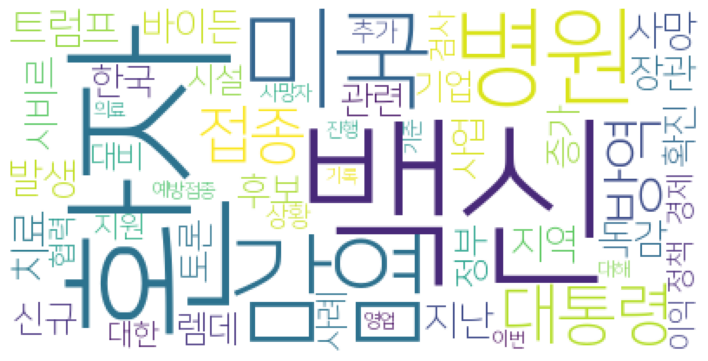

2020.10.22
['광명', '발굴', '광명시', '핀셋', '희망', '복지사', '지대', '나기', '지역', '위해', '본부', '전달', '운동']
['독감', '백신', '접종']
[]
[]
['일본']
['발생', '노인', '감염', '집단', '안양', '센터', '보호', '병원']
['슬레', '상품', '롯데', '백화점', '경향신문', '창립', '웨어', '라인']
['배송', '할인', '경향신문', '알뜰폰', '아이폰', '고객', '애플', '사전예약', '제공', '이통', '프로모션']
['계약', '헬스장', '피해', '해지', '관련', '신청', '경향신문', '소비자', '구제']
[]
['총리', '벨기에']
['종사', '요양원', '입소', '건물']
['리복', '시장', '아디다스', '스포츠', '인수']
[]
['요양원', '확진', '입소', '추가', '종사']
[]
['요양원', '입소', '종사', '추가']
['미세먼지', '중국']
['요양원']
['경향신문', '학년', '무상교육', '교육청', '시행', '경기도']
['관람', '지역', '공연', '방역', '콘서트', '경향신문']
['조선', '병원', '시설', '감염', '확진']
['입소', '요양원']
['요양원', '입소']
['대통령', '카자흐스탄', '통화', '지지', '토카']
['요양원', '입소']
[]
['요양원', '입소', '종사', '감염']
['입소', '요양원', '종사', '확진']
['업무', '노동자', '쿠팡', '택배', '장씨', '유가족', '직원', '장덕준', '면담', '설명', '동료', '지원', '고인', '당사', '워터']
['터미널', '물류', '택배', '노동자', '산재']
['백신', '접종', '독감', '예방접종', '사망', '사망자', '신고', '조사', '현재', '경향신문', '사례', '대한', '올해', '중단', '이상']
['확진', '

['합창', '부산', '국제', '합창단', '영상', '대상']
['광주', '확진', '판정']
['여성', '대표', '국회', '치료']
[]
['마스크', '바이러스', '마네킹']
['기업', '투자', '상반기', '감소']
['대응', '부분', '활용', '판매', '최근', '실적', '가장', '고객', '안정', '여러', '기술', '환경', '제품', '현재', '디스플레이', '수요', '경쟁력', '개선', '더욱', '요인', '부문', '바탕', '상황', '사업', '전략', '확대', '혁신', '공급', '운영', '수준', '인치', '내년', '상반기', '확보', '경쟁', '기반', '범위', '성과', '예상', '거래', '재개', '시장', '하반기', '설비', '유기발광다이오드', '진행', '시청', '보유', '본격', '지속', '전환', '역량', '가지', '중국', '생각', '패널', '구조', '생산', '판단', '캐파', '미니', '객향', '변동성', '공장', '변화', '고려', '준비', '수급', '인력', '금년']
['생각', '접종', '독감', '백신', '결과']
['하원', '정부', '스페인', '야당', '복스', '마드리드']
['중국', '미국', '방한', '문재인', '북한', '주권', '한반도', '한미', '체제', '폼페이', '취소', '계획', '세력', '정부', '관계', '때문', '대선', '이번', '대응', '참여', '연설', '국제', '철수', '평화협정', '인권', '쿼드', '구축', '문제', '국가', '대한', '자신', '아시아', '상황', '한국', '종전', '대통령', '그것', '공산당', '협력', '선언', '외교', '미군', '전략', '지금', '가치', '만약', '신뢰', '평화', '동맹', '위해', '외교부', '장관', '사드', '국민', '대중', '원칙']
['수익', '노인', '사

['메이드', '브랜드', '대표', '푸드', '나무', '다이어트', '중소기업', '상품', '통해', '건강', '식품', '소비자']
['부산', '병원']
[]
['리빙', '인천', '디자인', '페어']
['인천', '리빙', '디자인', '페어']
['디스플레이', '패널']
['지연', '운항', '항공기']
['순환도로', '공익', '협상', '광주시', '쿼리', '광주', '의원', '결과', '브로커', '부담', '지적', '조화', '투자', '처분', '지난', '대한', '사업']
[]
[]
[]
['감염', '집단', '사례', '방역', '추가', '경기']
['수출입', '금융', '기업', '지원', '국민은행', '서비스']
['부문', '대응', '디스플레이', '매출', '확대', '고객']
['디스플레이', '대응', '상황', '부문', '확대', '고객', '매출', '대비', '지속', '환경', '패널']
['대한', '백신', '접종', '신뢰', '비율']
['회원', '미국', '이민자', '감소', '나라']
['북미', '업체', '국내', '농기', '매출', '시장', '공업', '양물', '소형', '각각']
['영업', '중단']
['프로젝트', '디자인', '내용', '개선', '광주시', '치매', '광주', '문화', '사업', '교차로', '이번', '렌터카', '조성', '교통사고', '비엔날레', '예술', '계획', '전시관', '진료', '공간', '건물', '보훈청', '선정', '광장', '시설', '공공미술', '경관', '확보', '국제', '설치', '도시', '통해', '건립', '동구', '주변', '야간', '광산구', '단속', '지역', '전담', '사거리', '추진', '밝기', '위해', '조물', '영업']
['금융', '보안', '아이']
['사례', '백신', '접종', '독감', '사망', '예방접종', '사망자', '여성', '남성', '국가',

['기안', '유지', '고용', '케이', '아시아나', '산업', '은행', '항공', '노동자', '기금', '하청', '채권', '해고', '지난', '해고자', '지원', '정책금융']
['기관', '업무', '협력', '간담', '보건소', '체계', '구축']
['패널', '디스플레이', '시장', '생산', '계획', '수요', '공급', '대응', '부문', '사업', '기록']
['영화제', '충주', '무예', '액션', '관람']
['대책', '택배', '기사', '통운', '대표이사', '사망', '분류', '물량']
['순이익', '누적', '추가', '증가', '이익', '대비', '실적', '수수료', '분기', '이자', '증권', '금리', '대손충당금', '영향', '동기', '하락', '금융', '보험', '그룹', '올해']
['금융', '건전성', '신용', '대비', '순이익', '이익', '비율', '증가', '실적', '수수료', '대출']
['바이어', '상담', '기업', '자동차', '엑스포']
['사망자', '백신', '독감', '접종', '가능성', '이후', '상황']
['렌터카', '점검', '영업', '미성년', '카셰어링', '단속', '확인', '여부']
['삼성', '부회장', '베트남', '전자', '방문']
['문자', '말씀', '오마이', '이야기', '용건', '공해', '시간', '소통', '누구', '마감', '신문사']
[]
['형제', '아이']
['생산', '뉴딜', '에너지', '전기차', '배터리', '재생', '전력', '인프라', '세계', '주가', '때문', '판매', '대체', '기술', '한국', '풍력', '정도', '그린', '태양광', '전체', '미국', '상승', '시간', '하락', '가능성', '시장', '투자']
['스마트', '방문', '시티', '대통령', '도시', '뉴딜', '한국판']
['생산', '삼성', '베트남', '사업', '전자', 

['공화당', '지지자', '투표', '민주당', '조기투표', '선거', '비율', '바이든', '트럼프', '참가자', '사람', '지층']
['렌터카', '단속']
['천안', '사우나', '충남', '천안시', '일보', '감염']
['규모', '계약', '위해', '정부', '체결', '통화', '이데일리', '통화스왑', '위안화', '확대', '스와프', '중국', '무역', '결제', '이후', '원화', '금융', '교역', '국제화', '활용', '자금']
['대상', '여성', '단체', '전국', '대구시', '협의']
['투입', '택배', '기사', '통운', '분류', '예정', '업무', '배송', '지원', '근무']
['미성년', '렌터카', '영업', '카셰어링', '단속', '여부', '점검']
['의원', '국시', '의대', '장관', '시험', '문제', '거부']
['택배', '기사', '통운']
['총리', '여성']
['올리브영', '중소기업', '입점', '상생', '품평', '브랜드', '지원', '동행']
['인터폴', '총회']
['대표이사', '택배', '통운']
[]
['영업', '증권', '이익', '부문', '현대차', '분기', '최대', '수익', '급증', '실적', '사상']
['엔지니어링', '현장', '폴란드']
['투게더', '비즈니스', '패키지', '신라', '호텔', '행사', '노멀', '업계', '개최', '연회']
['경찰', '성매매']
['광장', '조성', '형태', '중앙', '행정', '일제', '역시', '왕복', '지적', '도로명', '오세훈', '도로', '조화', '차선', '천안문', '서울시장', '세월호', '아이디어', '현재', '서울시', '시장', '은행나무', '청사', '계획', '차도', '체제', '동상', '정부', '공사', '대행', '국가', '해태', '분리', '변경', '이름', '세종로', '문제', '사거리', '광화문', 

['경남', '카드', '극복', '이벤트', '홈페이지', '결제']
[]
['매출', '이익', '영업', '브랜드', '사업', '화장품', '증가', '최대', '뷰티', '생활', '건강', '각각', '채널', '기록']
['오후', '근무', '강씨', '택배', '과로사', '대책위', '지난', '노동', '노동자', '터미널', '통운', '허브', '장시간', '확인']
['자연', '예술', '초대', '환경', '지리산', '예술제', '국제', '작가', '아트', '작품', '위기', '세계', '미술', '특별', '부산']
['사업', '중소기업', '유보', '소득', '과세', '초과', '조사', '반대', '이유', '개사', '의견']
[]
['자금', '업종', '지급', '희망', '접수', '상공']
[]
[]
[]
['자동차', '해외', '기업', '상담', '엑스포', '지역', '준비', '대구시', '바이어', '대구', '국내', '엑스코']
[]
['중국', '통화', '스와프', '위안화', '규모', '확대', '경제', '계약', '연장', '조화', '전망', '무역', '기간']
['확진', '학생', '등교', '지난', '수업', '이후']
['전면', '학교', '등교', '부산', '수업']
['감염', '시험', '영국', '백신', '참가자', '실험', '바이러스']
['백신', '재개', '개발', '중단', '아스', '시험', '접종']
['이익', '영업', '기간', '매출', '성장', '대비', '화장품', '채널', '증가', '사업', '브랜드', '기록', '디지털']
['포토', '국화', '전시', '조형', '구역']
['식품', '시장', '네슬레', '매출', '올해', '대유행', '제품', '실적', '성장']
['여성', '단체', '전국', '협의']
['백신', '접종', '국민', '의원']
['총장', '대학']
['폼페이', '장관']
['환

['손상', '사이토카인', '폭풍', '환자', '물질', '경향신문', '치료']
['채널', '뷰티', '매출', '이익', '영업', '대비', '증가', '동기', '사업', '브랜드', '성장', '기록', '실적', '감소', '화장품']
['매출', '이익', '대비', '영업', '증가', '동기', '브랜드', '화장품', '사업', '경쟁', '성장', '지속', '제품', '기록', '채널', '뷰티', '디지털', '감소']
['통제', '지난', '불가능', '병원', '사람', '기준', '조사', '심리', '발생']
['중국', '수출', '해남군', '군수', '해남', '대사', '방문', '대한']
['부산', '병원', '입원', '환자', '확진', '보건', '당국', '판정']
['여행', '중국', '단체']
['오후', '택배', '사망', '파악', '대책위', '출근']
['추가', '관련', '지인', '지난', '사망자', '서울시', '양성', '최초', '수영장', '검사', '판정', '확진']
['매출']
['백신', '독감', '접종', '사망', '병원', '사망자', '질병', '부모님', '발생', '생각', '사례', '이상']
['미국', '우리', '방역', '대통령', '감염', '지난', '마스크', '백악관', '오히려', '트럼프', '연방', '절대', '최고', '확산', '상황', '진단', '키트', '세계', '걱정', '개발', '대한', '국민', '행사', '백신', '자신', '사실']
['래빗', '미국', '독감', '트럼프', '대통령', '주장', '사람', '대선']
['경남', '가맹', '이벤트', '비씨카드', '결제']
['병원', '입원', '환자']
['중소기업', '과세', '유보', '기업', '중앙회', '정부', '일부', '소득']
['병원']
['매출', '대비', '채널', '성장', '이익', '아이', '영업', '사업', '디지

['사람', '아주', '부분', '정도', '동철', '이기', '상태', '지금', '얘기', '정말', '이제', '수도', '위험', '백신', '독감', '조사', '교수', '질병', '연관', '대해', '정은경', '생각', '신고', '김현정', '지병', '관리', '이재', '문제', '사실', '반응', '알레르기', '경우', '일단', '직접', '사례', '대한', '어제', '그때', '그게', '상황', '접종', '가능성', '병원', '의견', '역학', '원인', '발생', '시간', '여러', '결과', '사망', '아나필락시스', '인플루엔자', '보시', '청장', '올해', '때문', '말씀', '가지', '부작용', '다른']
['독감', '백신']
['백신', '독감']
['보건', '발급', '민간', '의료', '기관', '수수료', '보건소']
[]
['백신', '중단', '존슨', '시험']
['행사', '호텔', '패키지', '아이', '노멀', '연회', '신라']
['주류', '계약', '업체', '도매', '대출', '조항', '갱신', '권고', '경우', '거래', '위해', '공정']
['행사', '호텔', '패키지', '아이', '노멀', '연회', '신라']
['동시', '앤디', '포스', '진단', '인플루엔자', '키트', '신속', '수출', '허가']
['일본', '대사', '권태신', '부회장', '전경련', '한일', '정상회담', '노력']
['후보', '토론', '트럼프', '대통령', '바이든', '마지막', '대선', '방해', '발언', '미국', '차례', '이번', '상대방', '경우']
['감염', '재난', '안전', '총괄', '정관', '집단']
['시설']
['경남', '지역', '형제', '상공', '소상', '공인', '업무', '협약', '협력', '프로그램']
['브라질', '사망자', '진행', '백신', '아스', '감시', '시험']
[]
['정

['이슬람', '학생', '프랑스', '정부', '대한', '샤를', '에브도', '권리', '자유', '학교', '시민', '소녀', '교사', '표현', '무함마드', '공화국', '살해', '테러', '종교', '태도', '마크', '통해', '근본', '수업', '사건', '공동체', '체첸', '주의', '학부모', '소년', '아버지', '모든']
['조치', '지역', '이동', '제한', '정부', '스페인', '실시', '마드리드', '지난']
['지난', '지역', '스페인', '조치', '실시', '정부', '마드리드', '이동', '제한']
['창작', '개막', '뮤지컬', '축제', '제작', '초청', '대구', '공연', '공식', '올해']
['일본', '부회장']
['한국', '비즈니스', '입국', '단기', '일본', '정부', '대상', '허용', '체류']
['임상시험', '백신', '브라질', '아스', '참가자', '보건부', '사망자']
['부산', '학교', '클레', '수협', '군부', '물질', '납품', '일보', '수산물']
['부산', '영화', '행사', '국제', '영화제', '영화의전당', '공원', '조성', '나루', '권한', '대행', '이사장']
['드림', '항공기', '개발', '맥스', '보잉', '라이너']
['투어', '스콧', '대회']
['강연', '금융', '전략', '전환', '시대', '디지털', '포럼']
['최고', '북한', '상임', '원장', '김위', '위원회', '중국', '노동신문', '참배', '노동당', '인민군', '인민', '전쟁', '회의', '위원', '회창군', '자묘', '위원장', '정치국', '한국', '중앙', '부위', '주년', '꽃바구니']
['울산', '강의']
['스위스', '금지']
['정원', '체험']
['코리아', '센터', '부문', '매출', '해외', '직구', '성장', '이익', '커머스', '해당', '영업']


['일자리', '인간', '기계', '시간', '분야']
['일자리', '산업', '교역', '제조업', '고용', '서비스업', '효과', '지역', '충격']
['일자리', '제조업', '서비스업', '지역']
['실험', '참가자', '시험', '백신', '영국', '감염', '바이러스', '논란']
['흡연', '담배', '아파트', '자제']
['사람', '우울', '블루', '조사']
['감독', '영화제', '상영', '국제', '부산', '영화']
['검증', '훈련', '국방', '전작권', '전환', '단계', '한미', '내년', '미국', '진행', '능력', '임기', '연합', '한국', '사업', '정부']
['전작권', '정부', '전환', '임기']
['검증', '단계', '내년', '전작권', '전환', '미국', '한미', '한국', '정부', '운용', '임기']
[]
['중단', '임상시험', '아스', '브라질', '백신', '미국', '영국', '사고', '재개']
['체코', '신규']
['대추', '축제', '온라인', '보은', '충북']
['독일', '장관', '슈판']
[]
['부문', '매출', '영업', '이익', '최대', '전지', '확대', '분기', '개선', '주요', '수요', '제품', '증가', '지속', '화학', '기록', '실적', '사상']
['프랑스', '정부']
['체코', '정부', '병원', '신규']
['체코', '정부', '병원', '신규']
[]
['장관', '판정', '양성', '파주']
['확진', '슈판', '장관', '판정']
['슈판', '장관', '확진', '판정']
['울산']
[]
['강원', '강원도', '경제', '지역', '일보']
['강원', '행사', '컨벤션']
[]
['사무소', '동북아', '협력', '다자', '주의', '유엔', '경제', '지역', '국가', '대응', '위기']
['선수', '골프', '골프장', '골퍼', '한국', '이

['낚시', '바다낚시', '통해', '승선', '민간', '시스템', '이용', '출항', '해수부', '협업', '예약']
['수영장', '관련', '지인', '추가', '검사']
['아시아', '고용', '인종', '비율', '학력', '실업률', '감소', '미국인']
['활성화', '사회', '종교', '경제', '행사', '개최']
['사업', '예술', '문화', '지원', '축제', '문화재단', '온라인']
[]
['공장', '확진', '양주시', '직원']
[]
['국내', '시장', '곡물', '식량', '포스코', '사료', '터미널', '인터내셔널', '우크라이나', '수출', '사업', '수입', '옥수수']
['인터내셔널', '국내', '우크라이나', '수출', '식량', '곡물', '사료', '포스코', '수입', '사업', '안보', '옥수수', '회사', '터미널', '시장', '안정', '해외', '통해', '농협']
['국내', '해외', '곡물', '사료', '식량', '수입', '포스코', '인터내셔널', '안정', '우크라이나', '터미널', '농협', '시장', '통해', '안보']
['농산물', '우수', '관리', '사례', '대회', '제도', '유통', '인증', '심사', '유통업체']
['농산물', '심사', '우수', '관리', '사례', '대회', '제도', '유통', '인증', '유통업체']
[]
['회의']
['가족', '감염', '시설', '발생', '집단', '노인', '경기', '확진', '보호', '주간']
['병원', '국내', '환자', '추가', '판정', '검사', '확진', '관련', '경기', '유입', '이후', '자릿수', '지역', '발생', '격리', '하루', '접촉', '전날', '명대', '가족', '해외', '재활', '집계', '감염', '가운데']
['금융', '교육']
['금융', '지원']
['환자', '확진', '시설', '안양', '병원', '감염', '지난

['국내', '대본']
['격리']
['격리']
['슬로건', '학생']
['물자', '북한', '반출', '방역', '통일부']
['일본', '북한']
['일본', '북한']
['출시', '글라스', '오브', '제품', '가전', '컬렉션', '냉장고', '전자', '공간', '도어', '재질', '냉장', '디자인', '인테리어', '냉동', '색상']
['생산', '녹십자', '백신']
['백신', '생산', '녹십자']
['병원', '환자', '입원', '요양', '확진', '추가', '다른']
['부산', '환자', '병원', '입원', '격리', '검사', '확진', '전날', '집단', '누적']
['베트남', '격리', '도내', '기업']
['확인', '사업', '아동', '보호', '점검', '대상', '조사', '안전', '기관', '서비스', '복지', '경기도', '합동']
['그룹', '프로그램', '학생', '코리아', '어프렌티스']
['정책', '기술', '위해', '디지털', '교육', '대응', '콘퍼런스', '싱가포르', '국립대', '혁신', '대학원']
['행사', '영동', '진행', '지역']
['지난', '정읍', '감염', '방역', '접촉']
['북한', '국무부', '제재', '유엔', '미국', '대북', '비핵화']
['접종', '신규', '백신', '감염', '독감', '발생', '신고']
['청소년', '지역', '진로', '교육', '청렴', '탐색', '행사']
['마스크', '지원', '방역']
[]
['관광지', '인센티브', '경우', '보령시', '관광', '유료', '단체', '관광객', '지원', '식당']
['오브', '용량', '가격', '색상', '냉동', '냉장고', '전자', '도어', '제품', '재질', '아이', '김치냉장고', '컬렉션', '리터', '살균', '글라스', '적용', '출시', '베이지', '네이처', '보관', '공간', '솔리드', '신제품', '빌트'

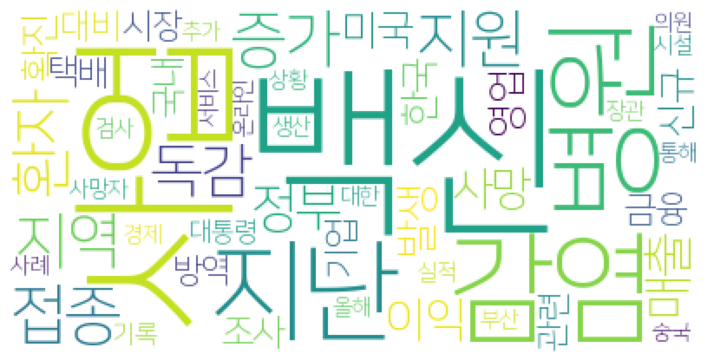

2020.10.21
['백신', '접종', '독감', '사망자', '사망', '자체', '문제', '연합뉴스']
['독감', '유행', '증상', '대책', '환자', '보험', '적용', '정부', '투여', '발열', '건강']
['스위스', '신규']
['스위스', '신규']
['스위스']
[]
['학원', '창원', '창원시', '차단', '연합']
['신규', '스위스']
[]
['센터', '미래에셋', '아마존', '금융', '물류', '투자', '펀드', '경향신문', '바탕']
['닭고기', '지난', '매출', '돼지고기', '항생제', '인증', '경향신문', '이마트']
['조선', '백신', '영국', '사람', '감염']
['학원', '강사']
['천안', '천안시', '확진', '당국', '접촉']
['폐업', '가게', '사람', '신촌', '이대']
['폐업', '가게', '사람', '신촌', '이대']
['스위스', '신규']
['스위스', '신규']
['체코']
['이상', '여성', '남성', '감염', '연령']
['이브', '남편', '요양원', '직원']
['병원', '재활', '환자', '방역', '요양', '경향신문', '지난', '인력']
['감독', '영화', '영화제', '부산', '국제', '상영']
['증가', '중고', '교생', '응답', '청소년', '고학년', '경향신문', '가장', '공부', '초등']
[]
['부품', '취재']
['독감', '면역', '접종', '아나필락시스', '반응', '백신', '예방접종', '항원', '질병', '증후군', '매우', '알레르기', '원인', '경우', '항체']
['학원', '강사', '검사', '병원']
['엄마', '입금', '피해자', '생각']
['판정', '부총리', '확진']
['상황', '백신', '사망', '접종', '확인', '결론', '예방']
['캐세이퍼시픽', '직원']
['사람', '시민', '독감', '조선', '접종', '예방접

['백신', '예방접종', '반응', '독감', '사망', '접종', '조사', '대한', '논의', '직접', '이상', '사례', '결과', '확인', '중증']
['독감', '문제', '사망자', '백신', '사망', '발생', '접종', '사례', '이상', '반응', '예방접종', '질환']
[]
['강남구', '구장', '발생', '강사']
['경제', '대통령', '상황']
['미국', '백신', '영국', '개발', '중단', '시험', '결과', '중인']
['중고', '해결', '거래', '헬로', '마켓', '직거래', '비대', '택배', '안전', '페이', '허용', '이용']
['페이']
['영광', '영광군', '포스트']
['지난', '트럼프', '대통령', '바이든', '후보', '헌터', '지지율', '대선', '선거', '장관']
['호주', '검사', '위험']
['백신', '접종', '앵커', '사망자', '위험']
['건설', '사옥']
['비트코인', '지난', '가상', '자산']
['대구', '프리']
['중국', '경향신문', '양국', '관계', '한국']
['화상']
['실적', '영업', '매출', '이익', '부문', '기록', '화학', '배터리', '노컷뉴스', '최대', '자동차', '수요']
['상태', '형제', '동생', '오늘', '의식', '호전']
['가맹', '지원', '협약', '이니스프리', '상생', '점주', '수익']
['병원', '재활', '광주시', '환자']
[]
[]
[]
['접종', '질병', '백신', '사망', '독감', '사례', '예방접종', '아나필락시스', '때문', '반응', '증후군', '가능성', '대해', '교수', '당국', '확인', '발생', '국민', '사고', '사망자']
['주문', '홈쇼핑', '이상', '롯데', '쇼핑']
['택배', '노동자', '통운', '사망']
['경찰관']
['중환자']
[]
['주유소', '방역']
['백신',

['지원', '예방', '우울', '시민', '사업', '계획', '추진', '심리']
['주식회사', '매출', '경기도', '중국', '중소기업', '개척', '지원', '판로']
['질병', '예방접종', '백신', '사례', '대해', '사망', '인플루엔자', '반응', '접종', '의료', '나머지', '보고', '조사']
['멕시코', '차관', '외교부', '방문', '양국', '기업', '고위', '협력', '관계']
[]
['화재', '화상']
['백신', '접종', '독감', '환자', '사망', '사례', '무료', '다른', '청소년', '걱정', '조사', '엄마']
['학교', '굿네이버스']
[]
[]
['피부', '뷰티', '기기', '사업', '전자', '제품', '시장', '아이', '케어']
[]
['확인', '사례', '부작용', '진행', '정은경', '우선', '인과관계', '가능성', '보고', '사실', '가지', '유정', '현황', '먼저', '환자', '경우', '대해', '정도', '발표', '내용', '바로', '결과', '접종', '대부분', '말씀', '발생', '사이', '세포배양', '갑자기', '어르신', '사망', '저희', '앵커', '피해', '인플루엔자', '위험', '대상자', '자체', '반응', '신상', '아나필락시스', '신고', '원인', '문제', '관련', '독감', '부분', '수가', '사업', '부검', '조사', '통해', '시간', '검토', '고령', '상황', '브리핑', '예방접종', '때문', '질환', '현재', '오늘', '기관', '병원', '결론', '방역', '백신', '이상', '지금', '알레르기', '의료', '직접', '사람']
['예산', '여성', '선발', '대회', '지원', '미스코리아', '경북', '경상북도', '심사', '성차별', '위원', '대구', '세금', '대구시', '지사', '청도군', '올해', '단체', '행사', 

['영화', '부산', '감독', '영화제', '국제', '올해']
['보건', '감염', '확진', '판정', '검사', '천안', '접촉', '발생', '확인', '대전', '증상', '경로', '당국']
['청주', '접촉']
['판정', '확진', '공장']
['오피스', '시장', '권역', '거래', '분기', '매각', '공급', '빌딩', '강남', '전망']
[]
[]
[]
['전자', '베트남', '부회장', '삼성', '재판', '반도체', '경영']
['스포츠', '지역', '올해', '아마추어', '대회']
['보증', '피해', '이사장', '기업']
['정책', '시민', '토론회', '수원시', '의견', '공감', '운영', '주제', '토론']
['고양이', '하루키', '아버지']
['할인', '온통', '대전', '소비']
[]
[]
['개최', '도민', '기념', '행사', '전남', '전남도']
[]
[]
[]
['티쿤', '성장', '매출', '글로벌', '기업', '온라인']
['두기', '방역', '거리', '단계', '자율', '단체', '부산']
['병원']
['병원']
['부산', '김해시', '방역', '종교', '단체', '협조', '자율', '시행', '적극']
['예술', '공연', '삼육대']
['종로', '교육', '혁신', '마을', '청소년', '진행', '종로구', '학부모', '역할', '특강', '중심', '프로그램', '영상', '우리']
[]
['취업', '인생', '연락', '생각', '근무', '아버지', '마음', '어르신', '구직', '나이', '시흥', '주거', '최선', '출근', '자신', '스타트업', '이야기', '업무', '정년', '워크넷', '지원', '도전', '방문', '지난', '자리', '다시', '병원', '신발', '사람', '복지', '홀몸', '세대', '매일', '등록', '근면', '시간', '인턴']
['최선', '방문', '나이', '이야기

['거제시', '지급', '신청', '긴급', '재난', '원금', '세대주', '부산']
['시설', '병동', '환자', '병원', '부산', '입원', '간병인', '검사', '요양', '격리', '조치', '대한', '감염']
['호흡', '진단']
[]
[]
['매출', '점유', '연구원', '올해', '하이닉스', '인텔', '인수', '낸드', '시장', '투자', '중국', '사업', '설비', '키옥', '생산', '부문', '수익', '기록', '다롄', '주가', '증권', '시아', '현재']
['기록', '주가', '현재', '시아', '하이닉스', '인텔', '인수', '낸드', '증권', '시장', '투자', '중국', '사업', '점유', '다롄', '올해', '키옥', '연구원', '설비', '생산', '수익', '매출', '부문']
['대한', '시설', '방역', '위험', '이용', '점검', '정부', '클럽', '감염', '조처', '총괄', '금지', '대변인']
['여행', '방역', '관광', '안전', '소비', '문체부', '캠페인', '숙박', '업계', '대신', '추가', '관광지', '쿠폰', '침체', '사업', '이번', '가을', '국민', '주간', '프로그램', '당국', '시행', '할인', '국내', '행주', '지원', '재개', '계획', '완화', '회복', '협의', '융자', '추진', '통해']
['출국', '상병', '해외']
[]
['선수', '부여', '카누', '대회', '전국', '성적', '동메달']
[]
['할로윈', '시사저널', '이태원', '반응', '확인', '이상', '클럽', '방역', '이벤트', '행사']
[]
['네이버', '조치', '방심위', '가장']
['한국', '경제', '총재', '에바', '부총리', '지원', '대응', '협력', '세계', '회원', '피해']
['마스크', '에티오피아', '화천군', '지원', '현지']
['검사', 

['백신', '신규', '독감', '접종', '지난']
[]
['산업', '일자리', '제조업', '교역', '충격', '감소', '분야']
[]
['병원']
[]
['미국', '사망자', '보고서']
['산업', '교역', '일자리', '지역', '서비스업', '위원', '서비스', '고용', '추정', '충격', '대한', '경우']
[]
[]
['학원', '강사', '검사', '관내', '대한', '대상', '해당', '상황', '학생', '연합뉴스']
['건설', '규모', '수주', '사업', '구역', '올해', '재건축', '포스코건설', '롯데', '대우건설', '정비', '재개발', '부산', '실적']
['긴급', '백신', '중국', '정부', '임상시험', '기자회견', '접종', '개발']
['여사', '멜라', '니아', '트럼프', '대통령', '유세', '경향신문', '판정', '기침', '계속']
[]
[]
[]
[]
['물류', '투자', '미래에셋', '아마존', '부동산', '자산운용', '센터', '펀드', '자산', '투자자', '임차', '제공']
['진행', '준비', '롯데', '행사', '상품', '구스', '백화점', '올해', '고객', '브랜드', '참여']
['멜라', '니아', '대통령', '유세']
['예정', '대해', '디지털', '기업', '발표', '대표', '행사', '빅데이터', '역량', '현모', '전환', '통한', '전략', '박윤', '센터', '세션', '개최', '사장']
['역량', '전환', '예정', '대해', '디지털', '기업', '발표', '대표', '개최', '세션', '행사', '빅데이터', '박윤', '사장', '센터', '현모', '전략', '통한']
['접종', '백신', '대상', '중국', '보건', '당국', '소흥시', '중점', '요원']
['대상', '중국', '백신', '접종', '보건', '당국', '소흥시', '중점', '요원']
['사례', '

['방역', '성과', '전투', '북한']
['연구', '농업', '한국', '고인', '학술']
['세계', '유네스코', '유산', '텔레콤', '이벤트']
['아동', '퓨처', '학습', '청소년', '교육', '아이', '개발', '툴팩', '지원', '청각장애', '서비스', '통역']
['태안', '태안군', '지역', '문화', '예술', '사업', '단체']
['앤디', '포스', '진단', '키트', '공급']
['포스', '앤디', '진단', '키트', '공급']
[]
['항체', '개발', '치료', '다이노', '금호', '에이치']
[]
['대표', '점수', '기업', '평가', '스코어', '셀트리온', '경영', '가장', '고용']
['감염', '실험', '백신', '자원']
['실리', '환자', '효과', '결과']
['환자', '실리', '효과', '결과']
[]
[]
['전자랜드', '지원', '서비스', '클린', '미혼모', '센터', '이번']
['가입자', '증가', '발표', '시간', '넷플릭스', '실적', '크게', '주가']
['세계', '유산', '유네스코', '아이']
['세계', '유네스코', '유산', '한국']
[]
['유료', '로이터', '넷플릭스', '가입자', '한국', '세계', '증가', '신규']
['감염', '병원', '마스크', '정부', '학원', '방역']
['증권', '증시', '투자', '전략', '세션', '포럼', '시대', '주식']
['수출', '국가', '시장', '수요', '방역', '진단', '키트']
[]
[]
[]
[]
[]
[]
[]
['멜라', '대통령', '니아', '여사', '트럼프', '유세']
['멜라', '니아', '여사', '트럼프', '대통령', '유세']
['수출', '감소', '증가', '조업', '일수', '작년']
['예정', '대해', '발표', '기업', '디지털', '빅데이터', '진행', '역량', '행사', '박윤', '센터

['발령', '오존', '감소', '연구원']
['가능성', '포스트', '트럼프', '대통령', '바이든', '헌터', '조사', '러시아', '장관', '대선', '이슈', '정보', '캠프', '뉴욕']
['금지', '조처', '도입', '지역', '봉쇄', '유럽']
['하루', '평균', '신규']
[]
['배달', '다희', '아나운서', '이후', '음식', '수요']
['박사', '구달', '사람', '세계', '동물']
['멜라', '유세', '니아', '트럼프', '계획', '대통령', '동참', '대선', '백악관']
[]
[]
['남편', '여사', '멜라', '니아', '유세', '트럼프', '동참']
[]
['단풍', '가을', '전망', '절정', '접종']
['폭력', '생활', '범죄', '검거', '피의자']
['운영', '투석', '칠곡', '지역', '감염', '치료', '중증', '의료', '지정', '현재', '병상', '환자', '적정', '음압', '최고', '평가', '혈액', '연속', '국가', '발생', '대구', '기관', '생활', '지난', '병원', '경북', '센터', '진료', '모두', '뇌졸중']
['부양책', '협상', '지수', '합의', '기대', '상승', '포인트', '백신', '로시', '의장']
['바이든', '대통령', '후보', '트럼프', '격차', '포인트']
['최근', '점도', '감염', '방역', '발생', '병원', '전파', '자릿수', '환자', '상황', '대책', '일간', '지역']
['가장', '조치', '봉쇄', '모두', '금지', '집계']
['여론조사', '지난', '포인트', '바이든', '후보', '트럼프', '대통령', '펜실베이니아', '분석', '격차', '경합주', '결과', '범위', '오차']
['업종', '정책', '고용', '사업', '호텔', '위기', '정리해고', '정부', '조사', '행업', '휴직', '원금', '지난', 

['대표', '캠페인', '트럼프', '대통령', '박스', '세계', '비드', '본부']
['정부', '시설', '방역', '금지', '위험', '대한', '클럽', '이용', '점검', '핵심', '대변인', '감염', '총괄', '조처']
['시장', '성장', '다인', '치약', '브랜드', '매출', '제품', '민감', '오프라인', '관리', '구강', '대한', '증상']
['항바이러스제', '독감', '유행', '대본', '검사', '건강', '보험', '적용', '증상', '발열', '의료']
['설명', '전략', '주주', '현대차', '투자자', '실적', '전자', '활동', '한국', '적극', '대상', '소통', '장기']
['회관', '문화', '예술', '기업', '시대', '토론회', '지원', '한국', '세종']
['경제', '축제', '취소', '지역']
['영국']
['인플루엔자', '유행']
['쌍방울', '김수현', '기업', '세대']
['검사', '진료']
[]
['경찰', '대통령', '국민', '책임', '역량']
['비대', '중소기업', '대표', '협의', '민간']
['세미나', '투자', '진행', '증권', '신청', '구독']
['환자', '신규', '방역', '감염', '시설']
['환자', '신규', '방역', '감염', '시설']
['중국', '베이징', '대사', '상황', '중단']
['수사', '경찰관', '비롯', '국민', '아산', '여러분', '우리', '책임', '활동', '현장', '도시', '방역', '행정', '치안', '변화', '최소', '기념', '최선', '위해', '경찰', '헌신', '국가', '국가수', '통해', '민주', '가족', '안보', '역량', '집회', '제도', '재개발', '대통령', '생활', '이준규', '당부', '개혁', '역할', '혁신', '사람', '시민', '대응', '충남', '관련', '수사권', '안전', '기반']


['경찰', '안전', '제도', '재개발', '통해', '여러분', '우리', '아산', '가족', '이준규', '충남', '대통령', '활동', '시민', '사람', '치안', '국민', '책임', '역량', '수사', '사회', '업무', '현장', '방역', '대한민국', '인권', '경찰관', '위해', '헌신', '대응', '존경', '도시']
['제도', '책임', '방역', '대응', '여러분', '우리', '아산', '활동', '현장', '헌신', '경찰관', '국민', '사람', '치안', '가족', '수사', '인권', '시민', '업무', '안전', '통해', '위해', '경찰', '역량', '도시', '이준규']
['보성', '권역', '삼삼오오']
['황해', '포럼', '평화', '방안']
['휴게소', '방역']
['사망']
['국감', '가맹', '매장', '점주', '화장품', '온라인', '가격', '아리따움', '브랜드', '아모레퍼시픽', '제품', '협의']
['지역', '기부', '부산', '마스크', '위해']
['울산', '기록', '도시', '경관']
['넷플릭스', '가입자', '한국', '국내', '유료', '리지', '콘텐츠', '시장']
['넷플릭스', '가입자', '한국', '국내', '유료', '리지', '콘텐츠', '시장']
['퇴원', '환자', '증상', '이상', '지속', '확인', '장기']
['서로', '거리', '하이네켄', '두기']
['축제', '경제', '지역', '취소']
['켐온', '평가']
['포렌식', '재판', '진행', '디스커버리', '디지털', '문서', '법정', '영상', '관련', '서비스', '제공', '데이터']
['생명']
['국민', '현장', '경찰', '여러분', '우리', '아산', '활동', '경찰관', '시민', '가족', '수사', '도시', '안전', '통해', '방역', '이준규', '역량', '제도', '책임', '업무', '대응', '사람

['채취', '키트', '검체', '공급', '진단']
[]
['대통령', '트럼프', '애틀러스', '전문가']
['분데스리가', '경기', '챔피언스리그', '뮌헨', '구단']
['키트', '앤디', '포스', '진단', '중동', '아이', '공급', '협약', '쿠웨이트', '진행', '이번', '국가']
['경우', '검사', '사망', '방역', '상황', '본인', '바로', '의료', '조금', '해외', '호흡기', '미열', '가장', '생각', '거의', '지금', '비용', '계속', '갑자기', '쇼크', '은미', '증상', '문제', '질환', '이내', '두기', '보험', '독감', '병원', '감염', '접종', '확산', '부담', '무료', '백신', '우리', '격리', '정부', '자체', '사실', '정도', '감기', '건강', '수능', '우리나라', '거리', '내용', '개인', '완화', '다시', '과정', '부작용', '때문', '앵커', '환자', '입국', '코호트', '모임', '확인', '대해', '위험']
[]
['대표', '경제', '장관', '사회', '격차', '강조', '정부', '고용', '추진']
['대상', '프로그램']
[]
[]
['전남']
['신규', '유입', '감염', '해외']
['기념', '경찰']
['행사', '경찰관', '경찰', '현장', '영상', '경찰청', '올해', '대한민국', '독도', '사건', '수사']
['지역', '신규', '전날']
['어도비', '크리에이티브', '클라우드', '콘텐츠', '맥스', '행사', '공개', '기능', '아이패드']
['이후', '캠페인', '위해']
['관련', '효과', '비만', '백신', '사람', '박사', '환자', '면역', '초기', '문제', '병원', '결과', '우리', '대학', '데이터', '일부', '대한', '반응', '감염', '연구', '구결']
['경찰', '영상', '국민', '사건'

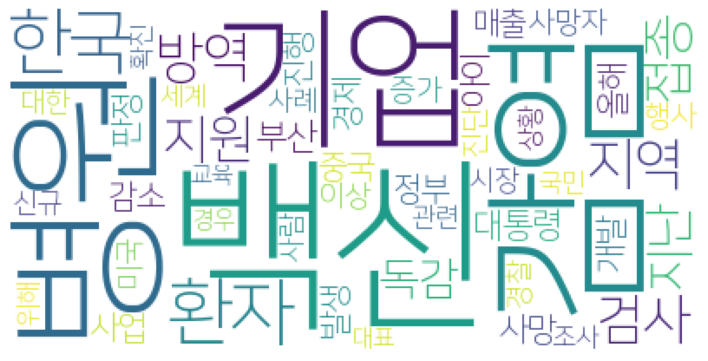

2020.10.20
['트럼프', '파우치', '대통령', '박사']
[]
['백신', '중국', '중국산', '시험']
['곤충']
['미세먼지', '하늘', '초미세먼지']
['대통령', '일본', '총리', '인도네시아', '베트남', '조코위', '협력', '방문']
[]
['등교', '확진', '형제']
['병원', '확진']
['백신', '접종', '독감', '어린이', '물량', '이하', '병원']
[]
['하이닉스', '낸드', '시장', '인텔', '사업', '인수', '부문', '글로벌', '삼성', '반도체', '비중', '경향신문']
[]
['일본']
['이탈리아', '현지', '시행']
['경향신문', '상원의원', '공화당', '선거', '상원', '민주당', '트럼프', '대통령', '의원', '현재', '장악', '지난']
['파우치', '대통령', '소장', '트럼프', '경향신문']
['감염', '지난', '환자', '확진', '입원', '격리', '보건소', '북구', '부산', '검사', '추가', '누적', '접촉', '병원']
['행정관', '옵티머스', '조선', '청와대', '손소독제']
[]
[]
['베트남', '삼성', '부회장', '생산', '출장', '한국', '전자', '응우옌쑤언푹', '법인', '면담', '디스플레이', '위해']
['경기도', '국감', '지사', '공무원', '국회', '자료', '요구']
[]
[]
['일본']
['일본']
['부회장', '베트남', '삼성', '전자', '총리', '총리와', '면담', '사업', '방문', '논의', '생산']
['베트남', '전자', '면담', '삼성', '부회장', '총리', '총리와', '생산', '사업', '방문', '논의']
['로하스']
['뉴딜', '대통령', '보고']
['백신', '독감', '접종', '앵커', '상온', '노출', '부작용', '문제', '조선', '사망']
['한국', '통화', '대통령', '지지', '본부장'

['신청서', '신청', '대해', '산재', '보험', '적용', '의원', '제외', '택배', '특고', '기사', '노동자', '대리점', '작성', '종사']
['단계', '병원', '방역', '거리', '두기', '집단', '감염', '추가']
['병원', '방역', '단계', '거리', '두기', '집단', '감염', '추가']
['뉴딜', '경제', '대통령', '지역', '균형']
['도시', '시도', '기업', '전라남도', '미래', '뉴딜', '중이', '지구', '조성', '자동차']
['인수', '대표', '미국', '골드만삭스', '금융', '대형', '업체', '책임자', '팬데믹', '경제', '업계', '투자', '국제', '과정', '최대', '글로벌', '이데일리', '규모']
['저축은행']
['디지털', '시대', '상황', '우리', '대한']
['심야', '근무', '항진', '기능', '질병', '평균', '사망', '시간', '택배', '과로사', '하루', '야간', '질환', '장시간', '위험', '심장', '우리나라', '노동', '업무', '노동자', '이상', '총알', '다음', '관련성', '노동시간', '증가', '경우', '작업', '배송', '주간', '원인']
['기업', '은행', '설명', '채권', '발행', '금융', '사회', '자금', '금융업', '금리', '시장', '규모', '사업', '관계자']
['뉴딜', '대통령', '부총리']
['최고', '민주당', '관계자', '집중', '지난', '추진', '도지사', '대한', '기업', '라며', '입장', '공정', '재계', '경영', '당내', '경제', '논의', '도부', '주식', '제도', '가능성', '의결권', '위원회', '이재명', '위원', '오마이', '감사', '법안', '회의', '내용', '재벌', '개혁', '투표제', '이낙연', '국회', '복수', '대표', '반발']
['뉴딜', '대통령'

['뷰티', '기업', '제품', '오송', '엑스포', '홈페이지']
['백신']
[]
['연기금', '기관', '확대', '투자', '대체', '펀드', '해외', '증가', '비중', '투자자', '부동산', '수탁', '대한', '시장']
['재난', '인포', '데믹', '관련', '사회', '발생', '연구원', '사례', '정보', '자연', '안전', '피해', '인포데믹', '감염병', '허위']
['디지털', '판매', '재정', '영업', '알릭스파트너스', '전환', '제공', '서비스', '기업', '역할', '구축', '비대', '세계', '비즈니스', '대한', '조직', '체계', '고객', '원격', '관리', '기회', '채널', '솔루션', '환경', '기술', '위기', '변화', '수요', '시장']
['국내', '스타트업', '강남', '오피스', '기업', '공유', '스파크', '플러스', '상장', '호점', '파이브', '이후', '회사', '위워', '지점', '패스트', '운영']
['조치', '아일랜드', '봉쇄']
['수익률', '농산물', '선물', '가격', '투자신탁', '곡물']
['등급', '상황', '방역', '북한', '특급', '비상', '봉쇄', '국경', '지역', '발생']
['사업', '제주', '동물', '테마', '파크', '제주도']
['직원']
['확인', '보급', '감염', '코바', '마을', '기증']
['현장', '노인', '지사', '주민', '마을', '공주시', '양승조', '일자리']
['점검', '의료', '병원', '감염', '현지', '근로자', '해외', '건설', '건강', '현대', '파견', '중인', '협력', '현장', '체류']
['독감', '사망', '백신', '접종', '사고', '무료', '학부모']
['금융', '협의', '국제', '논의', '우리', '그린', '정책', '뉴딜', '유럽연합', '방안', '소개', '측은', '녹색'

['대통령', '노동자', '정부', '불평등', '소득', '국민', '지원', '위기', '마련', '정책', '라며', '보호', '계층']
['미코', '진단', '키트', '바이', '오메', '인도']
['인도', '백신', '생산', '유통', '혈청', '연구소']
[]
['채권', '발행']
['택시', '지원', '지급', '운전기사']
['방청권', '신청', '신천지', '회장', '재판', '배부', '방식', '공판', '방청', '피해자']
['사업']
['중동', '진단', '공급', '키트']
[]
['미세먼지', '농도', '중국', '초미세먼지', '영향', '수준']
['명상', '마가스', '공개']
['환율', '달러', '중국', '시장']
['여성', '감염', '경향신문', '경로']
['외식', '희망', '퇴직', '브랜드', '푸드', '드빌', '대상', '빕스', '매각', '이후']
['혈액']
['운항', '이스라엘', '항공', '에티하드', '아부다비', '여객기', '처음']
['빕스', '계절', '밥상', '퇴직', '경영', '푸드']
['발생', '감염', '확진', '추가', '백신', '신규', '누적', '독감', '접종', '집단', '경기', '당국', '환자']
['세이프', '바이러스', '방역', '제거', '시험', '평가', '공공장소', '이상', '속성']
['바이러스', '시험', '세이프', '방역', '제거', '평가', '공공장소', '속성', '이상']
['치료', '임상시험', '바이러스']
['에어쇼', '블랙이글스', '사천', '비행', '예정']
['산림']
['국내', '삼성', '협업', '한국어', '서비스', '기능', '시장', '카카오', '업무', '기업', '그룹', '네이버', '보안', '브리티웍스', '웍스', '제품', '사용자', '회사']
['소장', '파우치', '트럼프']
['지역', '집합', '발생', '감염', '시설'

['환자', '확진', '병원', '직원', '검체', '채취', '검사', '부산', '보건소']
['서초구', '재산세', '주택', '서울시', '조례', '재의', '구간', '이하', '위반', '신청', '법률', '지방', '세법', '가처분', '요구', '대해', '가구', '상황', '검토']
['진단', '바비', '중동', '키트', '공급', '루스']
['엔투텍', '섬유', '나노', '마스크', '투셀', '통해', '마스터', '배치', '기술', '관계자', '확대', '회사', '필터', '시장']
['노컷뉴스']
['감독', '홍콩', '극장', '상영', '영화제', '부산영화제', '배우', '올해', '예매', '부산', '관객', '개막', '좌석', '공식', '영화', '아시아']
['관리', '시스템', '환자', '격리']
['확산', '올해', '임대료', '실률']
['부산', '보건소', '환자', '병원', '직원', '검사', '당국', '접촉', '발생', '북구', '확진']
['토론', '주제', '트럼프', '후보', '미국', '대통령', '대선']
[]
['상병', '부대']
['전자', '진입', '제품', '글로벌', '브랜드', '가치', '지속', '인터', '처음', '캠페인', '부산', '위해', '통해', '평가', '활동', '출시', '달러']
['글로벌', '캠페인', '인터', '브랜드', '지속', '전자', '가치', '제품', '분야', '소비자', '고객', '투자', '기업', '출시', '위해', '활동', '아이', '통해', '처음', '시장', '평가', '경영', '기술', '혁신', '삼성']
[]
['브랜드', '가치', '글로벌', '인터', '전자', '처음', '상승', '자동차', '현대차', '평가', '지속']
[]
['대전']
['채권', '등급', '발생', '매각', '모집', '주문', '회사채', '예측', '진행', '파라다이스

['미세먼지', '농도', '수준', '초미세먼지', '지방', '겨울', '평균', '시작']
['병원', '요양', '검사', '시설', '진단', '종사', '수도권', '지역', '대한', '출퇴근', '기적']
['노동자', '국민']
[]
['지역', '통계', '정책', '활용', '우수', '올해', '소상', '공인']
['중국', '경제', '은행']
['학원', '방역', '차단', '시설']
['낸드', '플래시', '이번', '하이닉스', '인수', '사업', '기업', '그룹', '회장', '인텔', '통신', '반도체', '점유', '전자', '분야', '미국']
['면세점', '공항', '입찰', '임대료', '매출', '면세']
['부산', '센터', '남구청', '어디', '배달', '남구', '사무실', '상점', '코리아', '입점', '고객정보', '경제', '제공']
['상반기', '음식점', '주점', '취업', '올해', '감소', '청년', '노컷뉴스', '임금', '가장', '지난해', '가운데']
['국민은행', '다음', '은행', '금융', '후보', '임기', '대표', '추천', '그룹', '상황', '경영']
['주점', '관련', '취업', '임금', '서비스업', '가장', '종사', '근로자', '음식점', '산업', '비중', '사업', '교육', '분류', '미만', '감소']
['협약', '외국인', '국가', '트래블', '해외여행', '버블']
['캐릭터', '빼빼로', '광고', '해외', '롯데', '제과']
['교수', '일보', '교육', '통일', '언론', '사회', '한국', '의제', '제도', '작가', '중앙', '기획', '분야', '김훈', '이상', '예산', '문제', '대통령', '경향신문', '제안', '지난', '대안']
['조처', '국가', '아일랜드', '유럽', '확산', '상황']
['조처', '아일랜드', '유럽', '확산', '국가', '상황']


['관리', '위해', '재택근무', '발전', '발생', '업무', '근무', '방역']
['변화', '산업', '콘텐츠', '해외', '시장', '보고서', '소비', '진출', '온라인', '각국']
['업무', '감사', '해외', '지사', '수출', '온라인']
['브랜드', '전자', '가치', '글로벌']
['의료', '하위', '수준', '수검', '검진', '국가', '대상자', '유방암', '자의', '수급', '국민', '대장암', '기준', '자궁경부암', '최근', '보험료', '위암', '부과', '해당', '폐암', '간암']
['재개', '공연', '극장', '관객', '영국', '내셔널']
['브랜드', '현대차', '글로벌', '자동차', '모빌리티', '전기차', '아이', '시장', '기록', '사업', '전용', '가치', '미래', '대응']
['저수지', '은행나무', '괴산군', '문광면', '주변']
['지원', '농어촌', '교회', '재단', '장로', '수해', '우양', '복구']
[]
['전기차', '시장', '전용', '사업', '미래', '브랜드', '현대차', '자동차', '글로벌', '모빌리티', '기록', '평가', '성과', '대응', '상황', '고객', '가치']
['현대차', '전용', '브랜드', '글로벌', '자동차', '가치', '전기차', '모빌리티', '미래']
['학원']
['전기차', '브랜드', '글로벌', '현대차', '자동차', '가치', '기록', '순위', '평가', '상황', '미래', '인터', '시장']
['백신', '접종', '독감', '사망', '사고', '고민', '상황', '유료', '이번', '무료']
['상황', '고객', '시장', '브랜드', '자동차', '현대차', '글로벌', '전기차', '가치', '모빌리티', '아이오', '기록', '전용', '성과', '미래', '순위', '평가']
['상황', '글로벌', '브랜드', '현대차', '자동차

[]
['백신', '러시아', '스푸트니크']
['전국', '환자']
['전국', '별미', '배민', '지역', '상공', '서비스']
[]
['연체', '지역', '가계', '대출', '의원', '부산', '경남', '한국은행', '김두관', '울산']
['오리온']
['전시', '작가', '작품', '철거', '전시관', '서울시', '건축', '지난', '기간']
['전국', '별미', '서비스', '상공', '지역', '배달', '민족', '확대', '형제', '통해']
['기아차', '사회', '사업', '복지관', '차량', '지원', '노후']
['올해', '그랑프리', '광고', '수상작', '대상', '국제', '작품', '온라인', '부산', '세계', '부문']
['배터리', '기술', '화학', '제품', '모어', '에너지', '참가', '세계', '전기차']
['사업', '사회', '복지관', '차량', '지원', '기아차', '노후']
['핼러윈', '마블', '롯데', '월드', '히어로', '타워', '진행', '인기', '코스튬']
['트럼프', '자신', '시간', '국제공항', '연설', '선거', '경찰', '대선', '도착', '강조', '문제', '투손', '미국', '오후', '유세', '공항', '지지율', '백악관', '시작', '행사', '동안', '현지', '지지', '지지자', '유권자', '후보', '마련', '제인스', '바이든', '대통령', '모습', '장면', '오전', '차이', '공화당', '포인트', '리저', '민주당', '비행기', '헬기', '일정', '여론조사', '백인']
['제거', '이상', '바이러스', '세이프', '시험', '방역', '바이오']
['성균관대', '학교', '컨퍼런스', '오전', '오후']
['와이파이', '속도']
['임상시험']
['마케팅', '마켓', '경우', '마케터', '지식', '중심', '가치', '데이터', '서비스', '과정', '성장', 

['격리', '확인', '협회', '방역', '여행', '업계', '세계', '산업', '진단', '자가', '검사', '방안', '국가', '경우', '시점', '기구', '공항', '의무', '통해', '대한', '위해', '글로벌', '관련', '항공', '입출국', '논의', '국제', '운송']
['스푸트니크', '러시아', '한국', '백신']
['러시아', '백신', '한국']
['감염', '검사', '종사', '병원', '시설', '요양', '집단', '지역', '이용자', '사회', '정신병원', '발생', '사망자']
['시설', '병원', '감염', '요양', '집단', '지역', '사회', '종사', '정신병원', '검사', '발생', '사망자', '이용자']
['환자', '집계', '신규', '미국', '하루', '소장', '가장']
[]
['파우치', '트럼프', '대통령', '미국']
['조달', '채권', '지난', '대비', '창구', '카드', '발행', '자금', '해외', '본드', '전채', '규모', '시장', '설명']
['조사', '가용성', '속도', '서비스', '평균', '우리나라', '가장', '주파수']
['안전', '대응', '조선', '거리', '방역', '기업', '모범', '근무', '보건', '두기', '직원', '케이스', '참여', '건강', '구성원', '상황', '관리', '금지', '재택근무', '방침', '업무', '사업', '위기', '자체', '극복', '이하', '시스템', '산업', '발생', '준수', '현장', '초기', '담당', '스터디', '지침', '그룹', '임원', '국내', '통해', '대한']
['부양책', '미국', '지수', '대선', '로시', '의장', '대한', '예상', '타결', '중국', '합의']
['시작', '행사', '할인', '롯데', '그룹', '참여', '페스', '규모', '코리아']
['트럼프', '부인', '여사', '대통령', '남편

['백신', '접종', '독감', '사망', '아이', '인천', '예약', '무료', '취소']
['기아차', '사회', '차량', '사업', '복지관', '지원', '노후', '정비']
['반응', '사례', '과정', '앞서', '지금', '백신', '접종', '사망', '독감', '이상', '유통', '부작용', '신고', '조사', '질병', '확인', '상황']
['그룹', '인사', '롯데', '회장', '임원']
['오리온', '스타', '지원', '지역']
[]
['콘텐츠', '점프', '텔레콤', '제작', '스튜디오', '사업', '기업', '기술', '서비스', '비용', '회사', '해외', '이용', '기반', '확장', '대표']
['거리', '반장', '병원', '방역', '대한', '검사', '정부', '두기', '관련', '발표', '체계', '요양', '대응', '상황', '전략']
['지인', '모임']
['진단']
['외국인', '일본', '입국', '정부', '체류', '중국', '금지', '왕래', '국가', '관계자', '재개', '비즈니스', '조치', '단기']
['관광', '제주', '세미나', '대응', '지역', '정책', '스마트', '참여']
['아일랜드', '조치']
['관광', '제주', '세미나', '대응', '지역', '정책', '스마트', '참여']
[]
[]
[]
[]
[]
[]
['부산']
['증권', '고객', '한국', '조사', '산업', '콜센터']
['악액질', '녹십자', '웰빙', '질환', '환자']
['접종', '독감', '백신', '무료', '사망', '헤럴드경제']
['외식', '퇴직', '매출', '희망', '지난해']
['노동자', '대통령', '사회']
['희망', '퇴직']
['중남미', '피해', '지역', '아르헨티나', '국가']
['사천', '블랙이글스', '에어쇼', '예정', '공군']
['포차', '항구', '목포', '시간']
['증가', '동기', '

['확산', '환자', '캐나다']
['트럼프', '대통령', '토론', '판정', '마지막', '음성', '감염']
['대통령', '노동자']
['걸음', '그룹', '사회', '기부', '공헌', '활동']
['사업', '국회', '확보', '정부', '발전']
['벨기에', '상황']
[]
['중국']
['치료', '환자', '병원', '혈장', '사용', '녹십자', '목적', '승인', '임상시험']
['치매', '면회', '제한', '아버지', '호소', '김씨', '환자', '상황', '가족']
['치매', '허씨', '환자', '활동', '센터', '외출', '보호', '어머니', '때문']
['대통령', '노동자', '정부', '라면', '청사']
['발행', '증권']
['노동자', '대통령']
['노동자', '대통령']
['신종', '발행', '증권']
['달러', '환율', '위안화', '하락', '강세', '중국']
['운송', '여객기', '화물']
['차단', '진행', '토론', '후보', '대통령', '트럼프', '시간', '바이든', '상대방', '대선', '마이크', '답변', '규칙']
['노동자', '면서', '대통령', '정부', '국민']
['수급', '마스크', '부직포', '필터', '수출', '생산', '산업']
['위원장', '가게', '청구권', '대책', '유성호', '매출', '관리', '두산', '매달', '운영', '할인', '관광객', '적자', '판매', '요구', '인하', '그룹', '임대', '벌써', '길이', '비상', '때문', '명의', '수준', '이정현', '행사', '임대료', '상인', '가죽', '상가', '경우', '개시', '다른', '폐업', '얘기', '감액', '상황', '청구', '입장', '이후', '수수료', '현재', '가방', '건물', '올해', '지난', '오마이', '몰이']
['건설', '현장']
['분석', '하락', '봉구', '대표', '저가', '

['고객', '롯데', '렌터카', '차박', '무료']
['경남', '한국은행', '지역', '의원', '가계', '대출', '연체']
['백신', '러시아', '스푸트니크']
['와이파이', '인터넷', '고객']
['시설', '산림', '치유', '이용', '경향신문', '복지', '경북', '국립']
['감염']
['조성', '임진각', '놀이', '시설', '누리', '평화', '관광', '모험', '어린이']
['평화', '시설', '누리', '관광', '모험', '어린이', '조성', '임진각', '놀이']
[]
['국민은행', '위원회', '후보', '은행', '추천', '선정', '계열', '대표이사', '검증', '영업']
['연구', '학술', '대회', '스마트미디어', '학회', '활동', '사업', '양성', '융합', '인재', '시대', '회원', '개최', '산업혁명']
['개인', '아마존', '신한은행', '사업자', '입점', '한국', '세미나']
['한국', '증권', '고객', '조사', '산업', '콜센터']
['평가', '포스코건설', '신용등급', '신용', '상향', '한국', '안정']
['세수', '납세', '정지원', '지역', '피해', '대한']
[]
['병원', '발생', '감염', '신규']
['격리', '기준', '감소', '지역', '기록', '해외', '발생', '가족', '환자', '확진', '검사', '판정', '지난', '학원', '신규', '감염', '전날', '인천', '병원', '접촉', '입국', '유입']
['발생', '방역', '사망자', '고령자', '노인', '국내', '당국', '지난', '이상', '취약']
['시장', '기아차', '현대차', '비용', '목표']
['토론', '트럼프', '후보', '대통령', '바이든', '마지막', '발언', '시간']
['낸드', '하이닉스', '플래시', '시장', '사업', '점유', '전자', '실적', '하락', '컨트롤러'

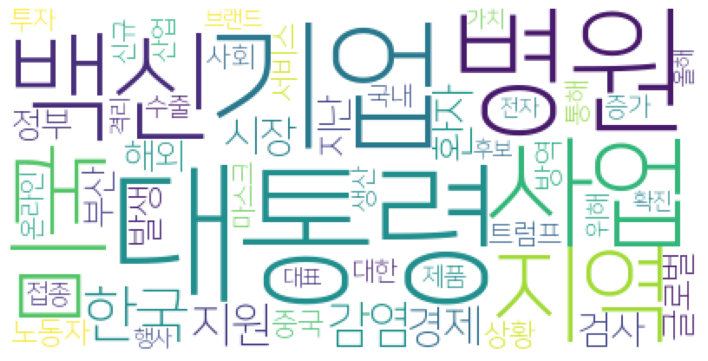

2020.10.19
['쿠르드', '한국', '행사', '지역']
['확진', '지난', '입국']
['신규', '하루', '최대', '모스크바', '러시아']
['농민', '농산물', '판매', '농협', '마을']
[]
['간호사', '그림', '의료']
['심사', '정책', '구민', '성북', '성북구', '직원', '아이디어', '시대', '소통', '미래']
['마스크', '업체', '강원랜드', '지난', '납품']
['고용', '업체', '유지', '원금', '행업', '정부', '직원']
['대응', '보건소', '감염병', '상황']
['충북', '지난']
['등산', '사고']
[]
['검사', '병원', '진료', '시설', '화성시', '요양', '의료', '정신']
['확진']
[]
['충북도', '충북', '검사']
['학원', '대치동', '감염', '강남구', '검사', '접촉', '강사', '판정']
['전세', '국토부', '거래량', '보도', '임대차', '자료', '가격', '금리']
['사용', '경향신문', '식사', '식당']
['추가', '병원', '감염', '시설', '발생', '의료', '검사', '요양', '환자', '기관']
['유럽', '미국']
['미국', '유럽']
['수사', '지휘', '사건', '총장', '의혹', '법무부', '라임', '가족', '관련']
['접촉', '대치동', '검사', '감염', '학원', '강사', '판정']
['대통령', '경제', '회복', '반등', '문재인', '연합뉴스']
['기능', '훈련', '학교', '경북', '학생', '동의', '아이', '의원', '교사', '지난', '대회', '공개', '학부모', '경기', '교육감', '교육청']
['거래량', '국토부', '전세', '보도', '언론', '설명', '자료', '입장', '금리']
['경제', '대통령', '반등', '문재인', '정부', '방역']
['방역', '병원', '감염', '유지',

[]
['발생', '감염', '병원', '추가', '신규', '누적', '연합뉴스']
['창구', '종이', '서류', '디지털', '대출', '의원', '도입', '중진', '진공']
['대통령', '무히딘', '사무', '총장', '본부장', '정상', '총리', '통상', '통화']
['경제', '중국']
[]
['판정']
['경향신문']
['관광', '농촌', '경북', '체험', '휴양', '마을']
[]
['간호사', '봉사', '사회', '재단', '부문', '유한', '병원', '교육', '유재', '복지', '지역']
['국내', '자동차', '수출']
['주상', '사업', '건설', '공사', '복합', '반도', '주택', '수주', '용지', '신도시', '지난']
['이익', '수주', '부문', '영업', '신규', '매출', '주택', '사업']
['수준', '영화관', '연기', '제작', '피해', '영화계', '매출', '현장', '영화', '개봉', '대비', '급감', '중단', '관객']
['본부장', '총리', '대통령', '무히딘', '통화']
['대통령', '경제', '의원', '일자리', '면서', '우리', '이후']
['경합', '트럼프', '대통령', '후보', '바이든', '미국', '토론', '대선', '여론조사', '민주당', '캠프', '유세']
['경제', '성장', '지난해', '기간', '중국', '지난', '소비', '회복', '충격', '기록', '증가', '플러스', '경제성장률', '투자', '수출', '변수', '대비', '시장']
['판정']
['대비', '성장', '경제', '유럽', '미국', '확산', '조치', '경기', '망치', '부양책', '기록', '예상', '영국', '신규', '가능성', '회복', '침체', '협상', '하향', '조정', '발표', '이코노미스트', '분기', '더블딥']
['신규', '미국', '유럽']
['출석', '재판', '회장', '증인',

['복합', '지난', '건설', '사업', '반도', '용지', '공사', '개발', '주택', '주상', '수주']
['세계', '인공', '미래', '시대', '정치', '프로젝트', '변화', '지능']
['문재인', '경제', '반등', '회복', '대통령']
['부문', '사업', '이익', '수주', '성장', '매출', '신규', '영업', '주택', '건축']
['사업', '삼진', '제약', '심전도', '패치', '스케', '의료기기', '웰리시스', '카르', '기술', '디오']
['수업', '등교', '학교', '초등학교', '학년', '매일', '인원']
['등교', '학교', '초등학교', '학년', '매일', '수업', '인원']
['의료', '포스코', '공연']
['뱅크']
['중앙']
['시험', '호주', '대웅제약', '확인', '대상']
['시험', '대웅제약', '호주', '확인', '대상']
['중앙']
['병원', '광주', '재활', '학교', '광주시', '추가']
['중앙']
['증가', '재정', '국가채무', '정책', '운용', '보고서', '지출']
['도쿄도']
['지역', '설립', '체계', '발생', '구축', '사업', '뉴딜', '시장', '서비스', '의료', '추진', '울산', '복지', '시설', '병원', '운영', '신종', '송철호', '발표', '일자리', '내용', '위해', '확대', '감염병', '사회', '분야', '보건', '건강']
['부산', '경남']
['커피빈', '코리아', '매각', '프랜차이즈', '지난해']
['해상', '사량면', '국립공원', '통영시', '환경부', '구역', '주민']
['삼양식품', '포스코건설', '공장', '건설']
['단백질', '코로나바이러스', '상호작용', '분석', '약물', '사스', '바이러스', '환자', '세포', '치료', '연구소']
['보험', '통해', '고용', '가입', '소득', '정보', '경향신

['증가', '해외', '시설', '방역', '감염', '발생', '병원', '위험', '요양', '집단', '두기', '관리', '준수', '거리', '본부장', '상황', '단계']
['캐세이', '퍼시픽']
['대법원']
['대법원']
['백신', '접종', '신규', '상황', '독감']
['상황', '백신', '접종', '신규', '독감']
['복합', '건설', '사업', '반도', '공사', '용지', '지난', '주택', '개발', '주상', '신도시', '수주']
['학교', '등교', '전교생', '수업', '매일', '전체']
['조치', '택배', '기사', '여부', '사망', '대리점', '산재', '보험', '적용', '조사', '과로사', '통운', '안전', '의혹', '점검', '과로', '실시', '신청', '공단', '제외', '대필']
['병원', '환자', '재활', '보호자', '검사']
['변국', '참배', '야스쿠니', '신사', '일본', '총리', '전쟁', '집단', '공물', '아베', '국회의원', '모임', '각료', '패전', '지난']
['참배', '야스쿠니', '신사', '일본', '총리', '전쟁', '집단', '국회의원', '지난', '패전', '아베', '변국', '공물', '모임', '각료']
['풍선', '콘서트', '밴드']
[]
[]
['백신', '사망', '접종']
['방역', '고용', '경제', '대통령', '정부', '일자리', '확산', '소비']
['나파', '스타트', '제제', '진행']
['입원', '환자', '퇴원', '재활', '회복', '연구', '감염', '일부', '결과', '호흡기', '증상', '호흡', '손상']
['수업', '학습', '학생', '대학생', '온라인', '교육', '학교', '학부모', '프로그램', '중학생', '격차', '공부']
[]
[]
['집단', '마을']
['여수']
['협력', '대법원', '회담']
['일본', '총리', 

['네이버', '브랜드', '협업', '국내', '웍스', '스모', '바일', '업무']
['전시', '가을', '수목원', '세종', '국립', '식물']
['발생', '환자', '인천', '단계', '누적']
['지난해', '아시아', '중국', '영향력', '미국', '호주', '파워', '지수', '영향']
['상황', '경제', '방역', '확산', '일자리', '고용', '소비', '정부', '위기', '반등', '국민', '대통령', '집행', '회복', '최근', '다시']
['소득', '고용', '보험', '정보', '정부', '지대', '해소', '계획']
['대통령', '경제', '방역', '확산']
['택배', '대책위', '한진택배', '김씨', '배송', '노동자', '새벽', '대해', '죽음', '확인', '라며', '인력', '지난', '고인', '사망', '과로사', '기사', '물량', '지병']
['정보', '기업', '관광', '구직', '일자리', '박람회', '채용', '취업', '산업']
['금융', '거래', '집중', '자본', '불공정', '대해', '계획', '공시', '점검', '처벌', '관련']
['운수', '종사', '전세버스']
[]
['영화제', '국제', '위원장', '포럼', '강릉', '개최', '세계', '집행', '올해', '패널']
['접종', '조사', '예방접종', '반응']
['안전', '생물', '관리', '국가', '대회']
['증가', '기업', '한계', '지원', '수은']
['지원', '경제', '방역', '대통령', '주기', '정부', '소비', '상황']
['총장', '종식', '캠페인']
['대통령', '일자리', '경제', '정부', '고용', '주기', '방역']
[]
['경제', '반등', '위해']
[]
['감소', '중소기업', '취업', '증가', '대기업', '지난달', '동기', '대비']
[]
[]
[]
['대통령', '방역', '상황', '경제',

['거래', '공정', '문화', '상생']
['교육', '직원', '신규', '출근']
['구직', '지원', '관광', '기업', '일자리', '채용', '취업', '산업', '준비', '청년', '정보', '박람회', '온라인']
['제한', '내년', '투자자', '거래', '증권', '불공정', '위반', '최대', '대응', '금융', '관련', '집중', '점검', '신고', '시장', '불법', '대해', '불건전', '금지', '기간', '금융위', '행위', '공시', '현재']
['관광', '정보', '기업', '구직', '일자리', '박람회', '취업', '산업', '준비', '채용']
['발견', '정기석', '걱정', '일단', '한림대', '검사', '시기', '진단', '그것', '현장', '백신', '우리', '호흡기', '과정', '보고', '예방접종', '이번', '온도', '말씀', '트윈데믹', '사실', '만성', '경보', '다른', '형성', '그다음', '독감', '문제', '단백질', '감염', '부분', '바이러스', '올해', '계속', '취약', '상식', '냉장고', '항체', '때문', '병원', '자체', '접종', '신속', '내과', '지금', '이야기', '시간', '사람', '조금', '경우', '환자', '대한', '음성', '부작용', '관리', '교수', '제대로', '요양']
['할인', '방역', '영화', '쿠폰', '정부', '예매']
['환자', '이상']
['자금', '희망', '신청']
['연체', '상환']
[]
[]
['접종', '백신', '시민', '중국', '해외', '이우시']
['추모', '프랑스', '집회', '교사', '시민', '자유', '프티', '테러', '수업', '우리', '사건', '샤를']
['부산', '마스터', '사회', '르노', '삼성', '지역', '회복', '노사', '위해']
['중국', '증가', '경제', '회복', '통계', '국가',

['서울시장', '후보', '민주당', '정은경', '청장', '차출', '보도', '정세균', '총리', '상황']
['식당', '안심', '안산시', '지정']
['대웅제약', '호주', '대상', '확인', '결과', '바이러스']
['지원', '대책', '원금', '피해', '긴급', '재난', '추진']
['마을', '주민', '제한', '정읍', '지원', '조치', '해제', '시민', '양지']
['꽃차', '수선화', '교육']
['인천', '형제', '아동']
['인천', '형제', '아동']
['매출', '쇼핑', '증가', '올해', '중국', '전망', '소매', '대비', '동기']
['올해', '대비', '매출', '쇼핑', '증가', '중국', '전망', '소매', '동기']
['다시', '감염', '유럽', '경제', '침체', '봉쇄', '두번째', '발생', '이코노미스트', '조치', '다른', '중앙은행', '수석', '파동']
['매출', '쇼핑', '증가', '올해', '중국', '전망', '소매', '동기', '대비']
[]
['인천', '노선']
['인형', '여행', '제주', '공사', '투어', '관광', '캐릭터']
[]
['수출', '증가', '자동차', '판매', '국내', '생산', '대로', '회복', '성장', '지난', '동월', '경차', '신차', '친환', '전기차']
['가족', '산후조리원', '입양', '미혼모', '아이', '출산', '경우', '부모', '도움', '지원', '산후조리', '게시', '경제', '과정', '기관', '절차']
['뉴딜', '시리즈', '지수']
['검사', '선제', '확진', '일반인', '의료', '서울시', '감염']
['트럼프', '대통령', '바이든', '후보', '미국', '토론', '민주당', '유세', '여론조사', '캠프', '경합', '대선']
['공개', '접촉']
['교육', '직원', '신규', '제주', '드림', '타워', '

['확산', '신규', '유럽', '누적', '가장', '봉쇄']
['누구', '서비스']
['징계', '직원', '감경']
['비즈니스', '서비스', '누구', '컨퍼런스', '텔레콤']
['냉동식품', '포장', '바이러스', '부산', '중국']
['방역', '김장', '체험', '괴산', '괴산군', '양념', '축제', '배추', '온라인', '행사', '절임']
['자치사무', '국정감사', '며느리', '요구', '공무원', '감사', '대한', '질의', '원칙', '자료', '부엌', '내일', '지사']
['서비스', '강연', '누구', '컨퍼런스', '텔레콤', '아이']
['공유경제', '사회', '성남시', '경제']
['병원', '대한', '검사', '관리', '방역', '시설', '차장', '감염', '위험']
['이사', '기업', '보수', '지배구조', '이사회', '위원회', '모바일', '미국', '보상', '한국', '수당', '영향', '평균', '지난해', '한경', '증가', '장사', '지급']
['대출', '신용', '신규', '대가', '증가', '대비']
['롱기스트', '레이스', '어린이', '언택트', '공원', '참가', '참가자', '이벤트', '운영', '시간']
[]
['박사', '개발', '무투', '백신']
['텔레콤', '컨퍼런스', '누구', '서비스', '통해', '강연']
['바이오', '전시회', '헬스', '온라인', '해외', '기업', '이번', '방역', '홍보', '분야']
['다문화', '우리', '결혼식', '경제', '우리금융', '커플']
[]
['확산', '지난', '신규', '증가', '결혼식', '앵커', '현재', '유럽', '하루', '세계', '제한', '누적', '미국', '국가']
['수어', '사용']
['병원', '감염', '위험', '시설', '방역']
['사업', '해외', '국가']
['사업', '해외', '국가']
['병원', '감염', '위

['환자', '지사', '신규', '증가', '미국', '하루', '입원']
['중소기업', '취업', '감소', '동월', '지난달', '미만']
['할인', '체육', '방역', '소비', '예매', '정부', '티켓', '지원', '분야', '온라인', '재개', '시설']
['결혼식', '금지']
['영국', '무디스']
['누적', '세계', '확산']
[]
['접종', '어르신']
['사업', '미만', '근로기준법', '휴가', '연차', '적용', '근로시간', '취업', '노동', '영세', '서비스업', '업체', '실태', '근로']
['병원', '검사', '등교']
['정부', '거리', '두기', '소비', '확산', '할인', '방역', '단계', '대책', '쿠폰', '행사', '예매', '회복', '온라인']
['대선', '트럼프', '대통령', '포인트', '노년', '후보', '지난']
['검사', '병원']
['신규', '감염', '프랑스', '유럽', '하루', '시간', '현지', '장관', '규모', '파리']
['기준', '시행', '발생', '학교', '학급', '수도권', '고등학교', '학생', '등교', '전면', '초등학교', '상황', '밀집', '제외', '수업', '수가', '사회', '전교생', '경우', '지역', '감염', '미만']
['학교', '등교', '완화']
['이번', '월경', '캠페인', '생리대']
['상담사', '남성', '정신건강', '문제', '상담', '대표', '로스트', '고객', '정도', '센터', '대한', '사람', '직장인', '심리상담', '이용']
['냉동식품', '포장', '바이러스', '중국']
[]
['세차', '업계', '화재보험', '증가', '조세일보', '비교', '교보', '수익', '보고서', '화재', '중간', '상반기', '공시', '보험', '순이익', '보험료', '법인세', '해상', '세율', '기간', '유효', '기록', '규모'

['시민', '분야', '조사', '평가', '긍정', '도시', '시정', '정운영', '지난해', '추진', '환경']
['빅히트', '상장', '주가', '하락', '투자자']
['상영', '경우', '검토', '방침']
['준비', '국회', '공무원', '감사', '국정감사', '자치사무', '지방정부', '며느리', '대한', '자료', '지사', '요구', '질의']
['형제', '일본', '배달', '시장', '서비스', '진출', '음식', '네코', '현지', '베트남']
['관광객', '지난', '연휴', '평균', '단계', '관광', '제주', '거리', '두기', '제주도', '완화', '한글날']
[]
['홍천']
['국정감사', '국회', '자치사무', '감사', '대한', '공무원', '질의', '지사', '내일', '요구']
['임상시험', '전략', '계획', '치료', '코방스', '신청', '효능', '시험', '문관', '비임', '평가', '데이터', '진행', '축적', '결과']
['금산', '축제', '인삼', '온라인']
['인삼', '금산', '온라인', '축제']
['시장', '후베이성', '산업', '분야']
['부산']
['청년', '기록', '취업', '실업자', '잠재', '일자리', '인구', '경제활동', '최대', '내년', '가능성', '관련', '지난달', '역대']
['결과', '호주']
['홍천']
['경제', '남방', '국가', '협력', '지역', '기업', '우리', '산업', '비즈니스', '한국']
['제주', '행사', '드라이브', '구매']
['기업', '일자리', '박람회', '광주', '면접', '지역', '취업', '고용', '구직', '온라인', '정보', '시스템', '중심']
['농막', '농지']
['희생', '대표', '명예', '오전', '면서', '추념', '유족', '사건', '참석', '추모', '민간인', '상생', '처음', '지역', '화합', '

['국내선', '할인', '제주', '노선', '편도', '운임']
['국정감사', '국회', '감사', '경기도', '공무원', '지방정부', '대한', '자치사무', '국감', '지사', '질의', '내일', '며느리', '요구']
['중단', '견학', '판문점', '통일부', '이전']
['교육', '제주', '직원', '드림', '타워', '신규']
['동서식품', '클래식', '커피', '앨범']
['네이버', '브랜드', '웍스', '국내', '글로벌']
['그룹', '공채', '테스트', '시험', '실시', '기업', '온라인', '하반기', '전형', '채용', '포스코', '이후', '검사', '오프라인', '인적', '직무', '통해', '필기', '계열', '삼성', '방식', '신세계', '주요', '역량', '평가', '전환']
['중국', '백신', '접종', '해외', '일반인', '당국']
['마을', '제한']
['시험', '실시', '기업', '온라인', '하반기', '전형', '채용', '검사', '인적', '직무', '공채', '통해', '역량', '방식', '포스코', '계열', '이후', '신세계', '테스트', '전환', '삼성', '그룹', '오프라인', '주요', '필기', '평가']
['제품', '소비자', '변화', '대한', '백서', '전략', '가치', '통해', '사회', '세계', '경제', '제공', '가지']
['판문점', '견학']
['수출', '증가', '판매', '자동차', '친환', '경차', '동월', '전기차', '하이브리드', '신차', '최대', '회복', '시장', '개월', '비중', '생산', '대비', '국산']
['네이버', '브랜드', '웍스', '글로벌', '일본', '업무']
['안전', '생물', '관리', '국가', '컨퍼런스', '병원체', '위해', '시설']
['동월', '증가', '수출', '판매', '대비', '자동차', '전기차', '산업', '기록', 

['효과', '미국', '치료', '가지']
[]
[]
['대상', '목소리', '활동', '사회', '아이', '기부', '신입사원', '나눔', '녹음', '진행']
[]
['재정', '국가채무', '증가', '운용', '속도', '국가', '계획', '지출']
['경제', '공유경제', '사회']
['세계', '변화', '포럼', '지속', '위기', '이전', '설정', '한국']
['교육청', '국적']
['의료', '한독', '병원']
['만들기', '봉사']
[]
['사회', '채권', '발행', '캐피탈']
[]
[]
[]
['관람', '인상', '영화']
['창업', '지원', '기업', '비대', '개발']
[]
['경남', '거주', '접촉', '지난', '김해시']
['관람', '인상', '영화']
['자세', '경추', '머리', '디스크', '시간', '근육']
['디스크', '머리', '시간', '자세', '경추', '근육']
['참가자', '어린이', '롱기스트', '공원', '참가', '친환경', '통해', '시간', '조성', '레이스']
['가장', '증가', '출원', '특허', '중소기업', '상표', '역시', '분야', '경향신문', '대비']
['바인스', '원금']
['발생', '해외', '환자', '관련', '감염', '집단', '잠언', '사례', '전날', '명의', '의료', '접촉', '지역', '대전', '기록', '광주', '송파구', '신규', '기준', '가족', '입국', '확진']
[]
['임상시험', '효능', '전략', '계획', '치료', '미국', '신청', '코방스', '비임', '문관', '시험', '데이터', '축적']
['근로', '환노위', '우려', '경우', '법안', '고용', '규제', '경연', '부담', '사업', '노동', '업무', '공시', '국회', '노조', '발의', '내용', '금지', '노동시장', '사용자', '기업']
['면접', '체험', '도서관',

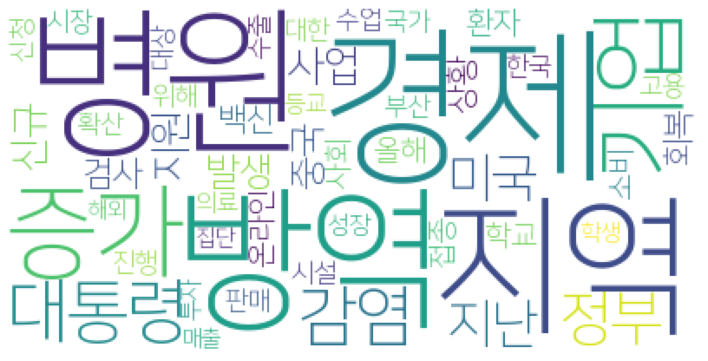

2020.10.18
['접종', '백신', '임상시험']
['백신', '접종', '임상시험']
['할인', '소비', '방역', '분야', '지원', '정부', '재개', '온라인', '예매']
['백신', '접종', '이상', '대상', '무료']
['매일', '등교', '학교', '초등학교', '방역', '인원', '학년']
[]
['금지', '교회', '예배', '교인', '대면', '감염', '마스크', '방역']
['발생']
['지난', '확진', '판정', '환자', '감염', '격리', '검사', '집단', '추가', '진단']
['발생', '국내']
['병원']
['병원', '병실', '문제', '감염', '환자', '재활', '집단', '생활', '해결']
[]
[]
['소비', '할인', '티켓', '온라인', '숙박', '외식', '대책', '재개', '방역']
['접종', '백신', '중국', '이우시']
['업무', '금감원', '근무', '마사지']
[]
['산업', '화학', '최대', '은행', '실시', '개최', '대표', '컨퍼런스', '온라인', '증인', '넷플릭스', '종합', '어도비', '기술', '출석', '레드햇', '금융', '업계', '네이버', '연구원', '맥스', '배터리', '방위', '행사', '질의', '연례', '위원회', '전자', '실적', '연설', '정무', '포럼', '진행', '예정', '국감', '성숙', '공개', '이번', '부회장', '올해', '발전', '전망', '텔레콤', '오픈소스', '한국', '결제', '퀄컴', '구글', '삼성', '누구', '디스플레이']
['확진']
['콘서트']
['쓰레기', '운동']
[]
[]
['백신', '접종', '중국', '해외', '시민', '이우시']
['혈액', '혈장', '병원', '약사', '가격', '수혈', '공급', '적십자']
['빈곤', '총리', '뉴질랜드', '노동당', '정부', '집권', '녹색당', '단독', 

['일본', '대한', '총리', '중국', '아세안', '지역', '외교', '정부']
['대표', '연맹', '총리', '일본', '간사장', '공물', '관계', '유감', '야스쿠니신사', '대해', '위해', '배상', '표명', '의견', '의원', '한일', '민주당', '봉납']
['확진', '판정', '병원', '추가']
['대표', '셀트리온', '치료', '바이오', '조기', '헬스']
['서비스', '기기', '건강', '웨어', '러블', '관리', '의료', '기업', '플랫폼', '환자', '데이터']
['완성', '작년', '전기차', '국내', '아이오', '테슬라', '판매', '내년', '모델', '사고', '판매량', '화재', '출시', '각각', '신차', '플랫폼', '시장', '현대차']
['기업', '한국', '중국', '인건비', '국내', '진출', '동남아', '이전', '공장', '복귀', '생산', '현지', '산업']
['일본', '손타쿠', '총리']
['시장', '도수', '알코올', '맥주', '주류', '하이트진로', '음주', '브랜드', '업계', '규모', '제로', '분위기']
['누적']
['당시', '총리', '노동당']
['총리', '노동당', '당시']
['트럼프', '대통령', '후보', '바이든', '경합', '플로리다', '여론조사', '포인트', '승리', '정권', '대선', '언급', '격차', '지지율', '결과']
['장관', '베르크']
['경향신문']
['세계', '누적']
['장관', '베르크']
['경향신문']
['할인', '소비', '방역', '분야', '지원', '정부', '재개', '온라인', '예매']
['확진']
['권한', '대행', '서울시', '단계', '행정', '공무원', '시정']
['검사']
[]
['누적', '세계']
['누적', '세계']
['시위', '태국', '민주화', '정부', '해산', '왕실', '강제', '방콕', '집회']

['검사']
['부회장', '재판', '경영', '이데일리', '의혹', '삼성']
['광주', '등교', '학교', '학생', '개교', '수업']
['허가', '사업', '하루', '직장', '노동자', '고용', '사장', '변경', '농장', '임금', '요구', '센터', '증언', '이주노', '강제', '출신', '주의', '사실', '노동', '지난', '회사']
['사장', '노동자', '사업', '고용', '허가', '변경', '임금', '강제', '사실', '하루', '증언', '이주노', '회사', '노동', '출신', '요구', '직장', '주의', '센터', '지난', '농장']
['노조', '국회', '관련', '민주당', '정부', '법안', '기업', '경제', '개정안', '입법', '관계자', '한국', '의견', '내용', '추진', '제출', '협약', '금지', '비준', '강화', '사업', '의원', '규제', '종사', '정기']
['사람', '두기', '정부', '클럽', '방역', '거리', '단계', '사회', '마스크', '모습']
['온라인', '할인', '예매', '방역']
['등교', '수업', '초등학교']
['교육', '유플러스', '청담러닝']
['뉴질랜드', '노동당', '총선']
['마스크', '업체', '센터', '판매', '기관', '공급', '구매', '위해', '공공기관', '계약', '유통']
['회복']
['가족', '미국', '실종']
['홍보', '지사', '경기도', '예산', '집행', '국민']
['도민', '경기도']
['수업', '대면', '학생', '비대', '운영', '과목', '대학', '강의', '확대', '학기', '전면', '이하', '한국']
['셀트리온', '조기', '대표', '바이오', '강조', '뉴딜', '헬스', '국제사회']
['국가', '성장', '경제', '전망', '세계', '올해']
['학생', '교사', '학습', '상담', '한국']
[

['정책', '추진', '반대', '정부', '기업', '경제', '개혁', '경영', '내용', '재계', '차원', '명분', '여당', '역시', '전문가', '의견']
[]
['예매', '분야', '할인', '정부', '소비']
['현지', '실적', '시장', '중국', '판매', '그룹', '현대차', '자동차', '베이징', '올해', '최근', '모델']
[]
[]
['방역', '할인', '지원', '체육', '소비', '관리', '한도', '정부', '예매', '재개', '사용', '온라인', '시설']
['위해', '개방', '시민', '사회', '정부', '혁신', '개발자', '시빅', '마스크', '아이', '기업', '해결', '사례', '서비스', '코리아', '활동', '데이터', '상황', '해커', '공공', '공적', '제안', '약국', '코드', '혼란', '판매', '민간', '대응', '제공', '요청']
['선박', '미국', '수출', '국내']
['마스크', '착용', '시설', '과태료', '부과']
[]
['지구', '세상']
['고객', '금리', '제공', '가입', '뱅크', '특판', '적금', '이벤트']
['격리']
['법무부', '때문', '의혹', '주장', '과정', '내용', '검찰', '입장', '권력', '신성범', '옵티머스', '조사', '기소', '총장', '그것', '문제', '지금', '라임', '로비', '민주당', '여당', '남부', '얘기', '야당', '이번', '사건', '지휘', '정도', '실제', '이름', '사부', '김형주', '국민', '아마', '윤석열', '계속', '특별검사', '앵커', '관련', '게이트', '수석', '하나', '부분', '강기정', '다른', '투자', '가지', '논란', '본인', '수사', '특검', '비리', '어쨌든', '원내대표', '부가', '사범', '사실', '의원', '검사', '확인', '생각', '보이', '우

['마스크', '유통', '회사', '직원', '기관', '구매', '의원', '업체', '조사', '공공기관', '판매', '공적', '계약']
['총리', '뉴질랜드', '노동당', '득표율', '총선', '인기', '세계', '축하', '찬사']
['대회', '육상', '선수', '유망', '전국', '경기']
['대통령', '총리']
[]
['뉴질랜드', '한국']
['총리', '베트남']
[]
[]
[]
['두기', '축제', '신영근', '거리', '사회', '지역', '방역', '식당', '장터', '시민', '예산군']
['경향신문', '소형', '사업', '프로']
['창업', '운영', '상가', '노포', '디앤티', '홀딩스', '성공', '매장']
['강연', '군위', '작가', '인문']
['오름', '영화제', '평창', '평창군']
['평창군', '평창', '오름', '영화제']
[]
[]
[]
['유황', '가격', '배럴', '유의', '설비', '선박', '올해', '수요', '생산', '하락', '지난해', '수익']
[]
[]
[]
[]
['방역', '총리']
[]
['교육', '안양', '만들기', '박물관', '온라인', '영상', '문화', '꾸러미']
['방역', '상황', '경제', '할인', '지급', '총리']
[]
[]
[]
[]
[]
['재판', '의원', '기소', '위반']
['재판', '의원', '기소', '위반']
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
['브라이언', '보좌', '실장', '측은', '북한', '대변인', '협상', '언급', '방미', '올림픽', '관련']
['대란', '장관', '아이', '의원', '라며', '세상']
['환경', '배출', '점검', '시설', '여부', '환경오염', '물질', '합동']
['대구', '대구시', '거리', '두기', '시설', '착용', '지난', '방역', '마스크']
['상황', '방역', '경제'

[]
['회의', '문제', '한중일', '중국', '연합뉴스']
['연합뉴스', '문제', '회의', '한중일', '중국']
['가을', '보관', '식중독', '발생', '조리']
[]
[]
['감자']
[]
['보수', '정치', '정당', '국민', '무당', '총선', '지지도', '진보', '민주당', '각각', '조사', '위기', '포인트']
['감자']
['감자']
['감자']
['감자']
['중국', '일본', '총리', '해외', '이번', '순방']
[]
['개선', '회복', '세계']
[]
['조치', '확산', '술집', '식당', '제한', '베를린', '감염']
['손해', '보험', '스타즈', '의정부시', '의료', '방호복', '기부', '의정부']
['영화', '중국', '세계', '시장']
['방역', '감염', '집회', '진행', '금지', '당국']
['나눔', '김만덕']
['병원', '재활', '검사', '환자', '관련', '판정']
['부산', '환자']
['예배', '교회', '대면', '단계', '신도', '방역', '연합뉴스']
['신도', '예배', '교회', '대면', '단계', '방역', '연합뉴스']
['확진', '양병', '격리', '환자', '부산', '병원', '입국', '추가', '종사', '해외', '포함']
['인상']
[]
[]
['중소기업', '포럼']
['운행', '청주시', '시내버스', '운수업체']
['확대', '대출', '규제', '방안', '차주', '위험']
['의원', '기소', '선거', '국회의원', '벌금', '지난']
['세계', '미국', '신규']
['캠페인', '리테일', '유기동물', '입양', '활동']
['국악', '대전']
['사업', '충북도', '구간', '국회', '지원', '건의', '국가', '국감', '확장']
['정보', '관련', '개인정보', '질병', '수집', '보존', '조사', '감염병', '마련', '근거', '파기', '

['채무', '조정', '채무자', '연체', '상환', '신청', '압류', '예금', '금융', '유예', '기간', '범위', '채권']
['채무자', '상환', '확대', '지원', '유예', '대상', '조정', '취약', '채무', '기간']
['채무', '지원', '상환', '채무자', '조정', '유예', '대상', '기간', '금융', '확대', '예금', '회복', '신청', '연체', '미취', '압류', '청년']
['회복', '개선']
['대해', '취약', '신청', '능력', '조정', '적용', '소득', '유예', '금융', '감소', '제도', '확대', '채무자', '채무', '이하', '취업', '기간', '상환', '연체', '회복', '범위', '금융위', '대상', '모든', '경우', '특례', '원금', '지원', '대출', '기존', '신용', '청년', '면책']
['위해', '중소기업', '경제', '포럼', '주제']
['스타트업']
['스타트업']
['러시아']
['러시아']
['주제', '중소기업', '믹스', '확산', '포럼']
['혁신', '기술', '러시아', '협력', '기업', '개최', '포럼', '통해', '양국', '진출', '빈국', '지원', '참여', '시장', '한국', '온라인', '투자']
['스타트업', '국내', '기업']
['채무자', '지원', '채무', '상환', '조정', '신청', '유예', '연장', '정상', '금융', '대출', '기간', '대상', '만기']
['기술', '러시아', '혁신', '협력']
['소비', '개선', '회복', '세계', '서비스', '부진', '전망', '중심']
['기술', '양국', '온라인', '혁신', '러시아', '협력', '기업', '투자', '통해', '진흥', '포럼', '개최', '한국', '센터', '진출']
['박승원', '공정무역', '광명시', '인증', '도시', '행사', '광명', '한국', '제품', 

['효과', '반등', '단계', '소비', '정부', '회복', '확산', '시행', '쿠폰', '정책', '대책', '추진', '감소', '고용', '거리', '두기', '완화', '다만', '개선']
['전날', '감염', '신규', '지역', '수도권', '발생', '방역', '지난', '누적', '인천']
['사범', '총선', '선거']
['대한항공', '확보', '서울시', '매각', '추가', '사업', '자금']
['환자']
['환자']
['현장', '영화계', '위기', '피해', '영화', '지원', '예산', '매출', '수준', '연기', '비정규직', '운영', '중단', '의원', '영화관', '개봉', '제작', '남북', '급감', '상황', '대비', '사업', '교류']
[]
['명목', '비율', '대비', '상승', '기준']
['문화', '부문', '예술', '수상자']
['해외', '지역', '강남구', '신규', '판정']
[]
['감염', '감소', '환자', '발생', '병원', '치료', '기준', '확인', '확진', '이후', '자릿수', '전날', '국내', '수가', '명대', '부산', '유입']
['이데일리', '병원', '감염', '수도권', '위중', '환자']
['마을']
['검사', '누적', '전날', '국내', '발생', '신규', '판정']
['증가', '지난', '환자', '지역', '발생', '전날', '격리', '기록', '주간', '신규', '기준', '확진', '해외', '판정', '명보', '이틀', '연속', '간병인']
['자동차', '교육', '미래', '학교', '현대차', '초등학교', '진로', '교육부', '수업']
['방역', '예산', '지원', '사업', '등교', '수업', '학교', '인력', '물품', '집행']
['인천', '노선', '운행']
['응급', '어르신', '서비스', '노인', '안전', '위해', '홀로', '세대', '지원']
['아이돌

['아이돌']
['가족']
['손해', '비교', '손보', '보험', '자동차', '아이', '개선', '업계', '보험사', '지난해', '기록']
['가족']
['가족']
['가족']
['가족']
['진단', '한국', '키트', '미얀마', '달러', '항원', '확산', '지원', '대사관']
['백신', '온라인', '합격', '교육', '이번', '입시', '예정', '설명', '지원', '서초구', '예방', '맞춤', '대입', '수능', '수험생', '진행', '컨설팅', '전략', '센터', '학생']
['안전', '발생', '산악', '사고', '등산', '전남소방', '소방', '구조대']
['도서관', '가족', '행사', '진행']
['교황', '교황청', '산타', '마르타', '감염']
['신안군', '평택시', '가거도']
['모비스', '사업', '주주', '방안', '주가', '현대차', '지배구조', '개편', '회사', '합병', '순환', '강화', '글로비스', '보유', '대주', '출자', '가능성', '구조', '개편안', '존속', '주의', '추진', '그룹', '기아차', '현대', '시장', '회장']
['신규', '미국']
['강사', '채용', '강의', '개월', '자격증', '측은', '자격', '경희대', '대상', '문씨', '학교', '최씨', '교육', '학생', '시간', '대학', '생각', '학기', '지난', '우리', '수업', '전환', '교원', '공고', '한국어', '기관', '노동위', '이상', '대한', '처우', '시급', '서울대', '문제', '무기계약직', '경향신문', '직원', '지난해', '처음', '지금', '연세대', '해고', '계약', '계약서', '시작', '사회']
['교육청', '등교', '학교', '매일', '제한', '학년', '인원', '교육부', '수도권', '확대']
['시설', '추석', '방역', '금지', '제주', '체육', '제

['대표', '정책', '종사', '노동자', '필수', '민주당', '지원', '대한', '계획', '산업', '정부', '제도']
['전환', '포스', '생산', '패널', '업체', '중국', '디스플레이', '시장', '점유', '국내', '모니터', '트렌드', '평가', '내년', '노트북', '프리미엄']
['상장', '기업', '모주', '코스닥', '빅히트', '청약', '공모', '시장', '일반']
['신규']
['비율', '대비', '명목', '기준', '상승', '수준']
['방안', '대출', '규제', '금융', '확대', '주택', '담보', '신용', '관계자', '현재', '적용']
['소진', '정부', '은행', '금리', '긴급', '소상', '공인', '지난달', '상공', '적용', '한도', '최근', '대출', '시중', '실행', '농협', '은행권', '금융', '상품', '영향', '관계자']
['소진', '농협', '실행', '상품', '긴급', '소상', '공인', '상공', '금융', '영향', '관계자', '지난달', '정부', '은행', '금리', '대출', '시중', '적용', '최근', '은행권', '한도']
['확대', '차주', '대출', '규제', '금융', '신용', '적용', '전면', '방안', '관계자', '금감원']
['차주', '대출', '규제', '금융', '확대', '신용', '적용', '전면', '금감원', '방안', '관계자']
['학급', '일일', '방역', '사회', '등교', '학교', '수업', '초등학교', '수도권', '전면', '전교생', '지역', '기준', '매일', '밀집', '학생', '지난']
['휴대폰', '서비스', '고객', '교체', '주문', '이용', '배송']
['자산', '상위', '전체', '하위', '소득', '수준', '심화', '지난', '사태', '보유', '조사', '격차', '현재', '미국']
['달러', '자산', '글로

['희망', '사진', '용기', '시민', '전시', '공개']
['포럼', '평생교육', '정책']
[]
[]
['운현궁', '공연', '퇴근길']
['스타트업', '관광', '창업', '아카데미', '전략']
['쿠폰', '소비', '외식', '관광']
['운현궁']
['운현궁']
['은행나무', '그림', '괴산', '괴산군', '저수지', '단풍', '유색']
['경향신문', '기준', '확진']
['감소', '모두']
['한국', '심리상담', '예술인', '심리', '개인']
['서울시', '감염']
['서울시', '감염']
['제조업체', '상담', '의료기기']
['감사']
['대표', '레이', '트레이싱', '실리콘', '반도체', '기술', '기업', '업체', '엔비디아', '디지털', '일리', '삼성', '표준', '전력', '시스템', '개발']
['발행', '금리', '우리카드']
['홍콩', '정신건강', '젊은이', '대한', '호소']
['중국', '칭다오']
['총선', '선거', '기소', '입건', '재판', '사범', '의원']
['베트남', '방문', '부회장', '출장', '지난']
['대해', '강연', '사람', '고민', '제주도', '권력', '오늘', '당선', '경선', '우리', '지사', '자신', '의미', '출마', '마포', '수석', '토론', '얘기', '시작', '민주당', '여러분', '제일', '원희룡', '마라톤', '대한', '내년', '안철수', '대표', '무엇', '대한민국', '중도', '서울시장', '김무성', '거기', '대통령', '대선', '생각', '변화', '제주', '세상', '가지', '질문', '자기', '주자', '서브', '선거', '지금', '미래', '지지도', '보수', '후보', '부분', '때문', '하나', '시대정신', '국민', '준비', '과거', '여론조사', '홍준표', '정치', '모델', '포럼', '다시', '정치인', '정말', 

['글로벌', '경향신문', '이익', '빅히트', '가치', '상장', '자산', '회사', '기업가', '기업', '순이익', '플랫폼', '엔터테인먼트', '영업', '공모', '수익', '자금']
['총선', '선거', '시효']
['대회', '스포츠', '개최', '게임']
['기소', '총선', '검찰', '선거', '시효', '사범', '재판', '가운데', '구속']
['기소', '사범', '구속', '시효', '총선', '검찰', '선거', '재판', '가운데']
['총선']
['홍보', '지사', '집행']
['참여', '진행', '단계', '도민', '심사', '경기도', '노래', '작곡', '선정', '전문가', '접수', '오디션', '지난', '공모']
['홍보', '지사', '집행']
['제한', '고객', '활동', '제공', '섹션', '공감', '작성', '삭제', '제안', '댓글', '기사', '택배', '위원회', '운영', '일자리', '특수', '글쓰기', '기간', '정부', '경우', '보험', '정보', '포토', '때문', '특고', '원칙', '일부', '레이어', '일보', '본인', '반복', '고용', '분류', '공유', '확인', '언론사', '등록', '모음', '포함', '도입']
['마스크', '크리스', '백악관', '감염', '대통령', '실수', '트럼프', '행사', '뉴저지', '지명', '지사', '사람']
['발생', '지역', '신규']
['사범', '총선', '선거', '감소']
['지역', '누적', '발생', '병원', '전날', '감염', '지난', '유입', '인천', '신규', '가운데', '검사', '수도권', '현재', '판정']
['대구시', '환자', '현재', '발생', '해외', '확진', '지역', '대구', '진료', '병원']
['세대', '흐름', '주식', '베이비', '부머', '밀레', '매도', '시장']
['발생', '국내']
['바이러스', 

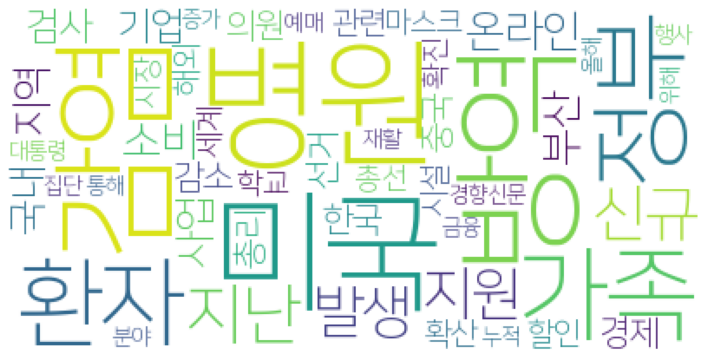

2020.10.17
['재활', '병원', '감염', '방역', '집단']
['순례']
['방역', '감염']
['방역', '감염']
['택배']
['벌초', '새마을', '지도자', '협의', '봉사']
['판정']
[]
['식물', '수목원', '세종', '온실', '국립']
['산행', '단풍', '방역']
['대구']
['추가', '감염', '요양', '병원', '집단', '부산']
['생명', '디지털']
['금지', '도시', '단계', '확산', '독일']
[]
[]
['금융', '책임', '보고서', '경영', '사회', '그룹', '지속가능성', '가능', '기업']
['미국', '서훈', '실장']
[]
['계층', '취약', '소득', '일자리']
['계층', '취약', '소득', '일자리']
[]
['병원', '요양', '노인', '음성', '변조', '장례식', '사회']
['병원', '분당', '서울대', '응급', '병동']
['바이어', '경기', '섬유', '기업', '북부', '양주시', '지원']
['이탈리아']
['바이러스', '이탈리아', '보건', '당국']
['당국', '바이러스', '이탈리아', '보건']
['대출', '증가', '신용', '가계', '기업', '의원', '취약']
['국립공원', '산행', '단풍', '방역', '단체', '마스크']
['러시아']
['도민', '경기도', '세상']
['병원', '감염', '방역', '관련', '집단', '발생', '당국', '확진', '간병인', '환자']
['협상']
[]
['바이러스', '이탈리아', '보건', '당국']
['힉스', '트럼프', '대통령', '보좌', '무대']
['뉴질랜드', '총리', '노동당', '의석', '지난', '총선', '국민당', '선거', '지지']
['병원', '백신', '중국']
['보좌', '힉스', '트럼프', '대통령', '판정']
['병원', '분당', '서울대', '여성']
[]
['행정부', '비판', '트럼프',

['화이자', '긴급', '조선']
['경기도', '도민']
[]
['은행', '세계', '부총리', '소득', '채무', '사국']
['우한', '위신', '간호사', '중국', '보도']
['청년', '스타트업', '창업', '센터', '경향신문', '캠프', '사회', '경험', '멘턴']
['거열', '사적', '산성', '거창', '지정', '국가', '고유', '기념', '하부', '약수터', '거창군', '군청']
['시험', '필기', '응시', '공무원']
['비율', '혈액형', '환자', '결과', '연구', '비교', '사람', '진행', '혈액', '명의', '중증', '가능성']
['경남', '검사', '접촉']
['도민', '경기도', '경기', '기념']
['상황']
['상황']
['매출', '때문', '통신', '롯데', '그룹', '디지털', '사업', '투자', '정부', '실적', '대비', '연구원', '데이터']
['아들', '택배', '통운', '노동자', '대책위', '집회', '과로사']
['통운', '택배', '노동자', '대책위', '집회', '과로사', '아들']
['도민', '경기도']
['판정', '확진', '자가', '격리', '검사']
['총장', '과학자', '교육', '혁신', '발표', '전남대', '세계', '청년', '회의', '대해']
['아동권리', '공연', '충북', '증평군']
['확진', '추가']
['필기', '시험']
['비서실', '트럼프', '대통령', '켈리']
['간호사', '위신', '우한', '그녀', '상태', '보도', '언론', '이의']
[]
['위중', '중증', '환자', '단계', '분류', '치료', '산소마스크']
['병원', '발생', '집단', '방역', '감염', '추가', '당국', '관련']
['집회', '경찰', '차벽']
[]
['트럼프', '대통령', '비서실']
['필기', '응시', '시험', '공무원']
['국가', '인터뷰', '부장

['렘데', '시비르', '연구', '관련', '치료', '결과', '입원', '환자']
['병원', '추가', '관련', '재활', '감염', '확진', '환자', '단계', '대본']
['박쥐', '과일', '싱가포르', '바나나', '지역', '페어', '프라', '이스']
['감염', '병원', '사례', '추가', '누적']
['추가', '병원', '누적', '접촉', '조사', '확진']
['감염', '병원', '추가']
['김정은', '미사일', '위해', '전략', '대선', '연구원', '미국', '열병', '경우', '강조', '언급', '수령', '추정', '주민', '사용', '대통령', '북극성', '트럼프', '무기', '신형', '탑재', '자신', '시험', '북한', '화성', '탄두', '위협', '발사', '눈물', '이번', '공개', '연설', '분석', '억제', '정권', '잠수함', '우리', '때문', '체제', '선제', '국가', '길이', '직경', '거치', '표현', '애민', '악어', '타격']
['발사', '화성', '직경', '선제', '시험', '강조', '표현', '공개', '트럼프', '분석', '전략', '대선', '탑재', '미사일', '경우', '언급', '수령', '애민', '북한', '길이', '연설', '체제', '자신', '김정은', '탄두', '위해', '북극성', '주민', '위협', '국가', '연구원', '신형', '미국', '이번', '사용', '추정', '눈물', '열병', '우리', '타격', '대통령', '때문', '정권', '무기', '악어', '억제', '거치', '잠수함']
[]
['렘데', '시비르', '연구', '관련', '치료', '결과', '입원', '환자']
['렘데', '시비르', '연구', '관련', '치료', '결과', '입원', '환자']
[]
['렘데', '부장', '시비르', '치료', '환자', '지침', '전문가']
['학생']
['거리',

['독일', '확산']
['뮤지컬', '광주', '거리', '두기', '무대', '공연']
['일본']
[]
[]
[]
[]
[]
['바이러스', '이탈리아', '확산', '보건', '당국']
[]
['방미', '북한', '미국', '실장', '한미', '대한', '귀국', '관계', '종전', '지난', '선언']
['면세점', '매출', '공항', '입찰', '인천공항', '시내']
['관내', '접촉', '신규', '지역', '발생', '감염', '텔레', '닉스', '강남구', '조사', '관련', '추가', '집단', '검사', '중랑구']
['택배', '기사', '과로사', '김원종']
['사고', '차량']
['이란']
['가구', '지원', '소득', '생계', '신청', '긴급']
['북미', '테이블', '협상', '북한', '종전', '선언', '미국', '올림픽']
['시험', '필기']
['결과', '환자', '치료', '검토', '국내']
[]
['가을', '정취']
['가을', '나들이']
[]
['동두천']
['수도권']
['검사', '병원', '종사']
['산악', '안전', '사고', '등산', '소방', '구조대']
['등산', '산악', '사고', '안전', '소방', '구조대']
['병원', '환자', '부산', '해뜨락', '요양']
['쿠팡', '물류', '센터', '주장', '업무', '직원', '과로사', '작업', '근무', '대책위', '사망', '사실', '분류']
['미국', '정부', '재정', '적자']
['대상', '오피스', '주택', '공모전', '아이디어', '공간', '작품', '포스트', '도심', '건축', '공원', '건물', '사회', '건축가']
['공간', '건물', '공모전', '아이디어', '작품', '도심', '건축', '공원', '건축가', '포스트', '주택', '오피스', '대상', '사회']
['신규', '경기', '감염', '병원', '지역', '누적', '사례', '발생

['그룹', '회장', '사업', '시장', '내년', '열사', '계획', '자동차', '인사', '전기차', '현대차']
['전격', '이사회', '회장', '사실', '태희', '앵커', '임종윤', '정몽구', '경영', '승계', '정의선', '현대차', '윤성훈', '선임', '단계', '부회장', '전기차', '평가', '부문', '디자인', '조직', '명예', '취임', '그룹', '자동차', '미래', '도심', '지난', '모빌리티', '당시', '글로벌']
['기념', '부산', '민주', '항쟁', '부산시', '민주당', '기념관', '부마', '위원장', '공항', '보궐선거', '후보', '국민', '의원', '예산', '재단', '내년', '건립', '가덕도', '거론', '민심', '라임']
['오란씨', '모델', '출시', '환타', '광고', '페스티벌', '오렌지', '당시', '발매', '마케팅']
['순천', '분양', '입지']
['메뉴', '치킨', '피자', '최근', '인용', '피자헛', '매장', '뷔페']
['지난', '부산시', '병원', '북구', '부산', '요양', '직원', '조치', '방역', '단계', '두기', '만덕동', '발생', '거리', '지역', '감염', '최근', '완화']
['리즈', '테론', '보모', '아이', '툴리', '영화', '엄마', '육아', '이야기', '샤를', '출산', '야간', '장면']
['체험', '수학']
['규제', '풍경', '프로그램', '거래', '분양', '조정', '투기', '조성', '단지', '공급', '청약', '수도권', '목적', '운정신도시', '지역', '시설', '지구', '수요', '방문', '경우', '예정', '대상', '아파트', '제공', '주민', '주택', '퍼스트', '센터', '커뮤니티', '내집마련', '파주', '인프라', '생활']
['직원', '저축은행', '헌혈증', '사회', '기부', '백혈병'

['규모', '결정', '취득', '제조', '공시']
['쪽방', '피트', '홍콩', '공공', '주택', '월세', '임대주택', '스퀘어', '공간', '홍콩달러']
['환자', '감염', '병원', '확진', '방역']
['거래', '뉴욕', '일보']
['실적', '증권', '성장', '주가', '대비', '매출', '투자', '시장', '증가', '목표', '이익', '연구원', '수요', '인테리어', '가구']
['미국', '빅히트', '코스피', '지난', '매수', '하락', '개인']
['입국', '조치', '개국', '국가', '한국', '금지', '외교부', '경제', '지난']
['시간', '장관', '국민', '시장', '생각', '아파트', '전세', '대해', '상황', '안정화', '관련', '가격']
['선고', '지사', '무죄', '파기', '허위', '공표', '환송', '혐의', '강제', '판결', '이재명', '국민', '사실', '지지자', '재판', '대선']
['감소', '취업']
['쿠팡']
['집회', '금지', '자유', '규모']
[]
['순경', '이씨', '민원', '층간소음', '지난해']
['정부', '투자', '벤처기업']
['환기', '실내', '바이러스', '기온', '공기', '여름철', '최근']
['환기', '실내', '바이러스', '기온', '공기', '최근', '여름철']
['키트', '진단', '검사', '인도네시아', '바디', '공장', '생산', '반둥', '항체', '현지', '한국', '항원', '시트', '직원', '작업장', '다른', '확인', '시약', '습도', '기술', '정확도']
[]
['증시', '바이든', '미국', '대통령', '후보', '가능성', '대선', '지지율', '트럼프', '포인트', '승리']
['경로당', '노인', '복지관', '할머니', '방역', '운영', '마스크', '재개', '두기', '프로그램', '가명', '거리', '대

['후보', '타운', '방송', '트럼프', '대통령', '시청자', '토론', '바이든', '시청률']
[]
['미식', '떡볶이', '음식', '주간', '치킨', '위로']
['올해', '지원', '시설', '여건', '국방부', '기지', '위해', '국민', '사실', '내용', '방위', '상황', '장관', '관계자', '관련', '배치', '비분', '미군', '평가', '미사일', '동성', '포대', '기본', '미국', '한국', '주둔', '확인', '영향', '사드', '노컷뉴스', '발사', '환경', '진행', '정식', '언급', '협상', '때문', '몰래', '안정', '보고', '설명', '성주']
['오프라인', '매장', '유통', '통합', '정기', '인사', '롯데', '그룹', '올해', '이마트', '대표', '만큼', '온라인', '담당', '주요', '시기', '단행', '지주', '사업']
['축제', '개최', '겨울', '결정', '산천어', '화천', '지역', '취소', '화천군', '때문', '상황', '평창', '홍천', '여부', '송어', '준비', '고민', '주민']
['쓰레기', '온라인', '배달', '음식', '상황', '우리', '변화', '쇼핑', '플라스틱', '포장', '재활용']
['그녀', '우한', '중국', '간호사', '모두', '사람', '위신', '군인']
['인도', '칸나', '요리사', '요리', '스타', '셰프', '어머니', '위해', '음식', '아시아', '뉴욕', '캠페인', '사람', '미국', '식당']
['임대료', '임대', '기존', '인상', '김씨', '임차', '보증금', '측은', '건물', '임대차', '빌스', '요구', '인테리어', '지난', '무시', '제시', '월세']
['부동산', '의원', '통계', '장관', '국민', '정부', '감정', '국토', '위로', '테스', '강조', '지적', '전세', '국감']


['나이', '취업', '사회', '결혼', '생각', '사람', '군대', '정해', '진로', '졸업', '부담', '제한', '스트레스', '얘기', '때문', '휴학', '세대', '대학', '고민', '적령']
['호텔', '사건', '실종', '대리', '임원', '과장', '발견', '현장']
['경제', '노동', '개혁', '고용', '일자리']
['렘데', '환자', '시비르']
['올림픽', '북한', '협상', '브라이언', '보좌', '비핵화', '생각']
['미술관', '울산', '예술', '시립', '기술']
['환경', '태양광', '개교', '중앙', '지난해', '국제', '제주도', '도시', '지역', '학교', '관광', '투자', '이양', '교육', '운영', '지방', '자치', '특별자치도', '관광객', '과제', '분권', '확대', '산업', '제도', '특별법', '영어', '자유', '외국', '신재생에너지', '청정', '한국', '제주']
['기사']
['도토리', '사람', '나무', '때문']
['쓰레기', '폐품']
['현지', '경찰', '시위', '시간', '금지', '확산', '정부', '동물', '태국']
['기술', '농업', '천안시', '스마트', '신설', '인력', '지원', '사업', '관리', '조례', '운영', '정원', '기구', '구축']
[]
['원내대표', '대통령', '국민', '경선', '얘기', '논란', '지난', '소담', '준비', '만큼', '위원회', '웃음', '공무원', '지하', '빌딩', '총선', '위원장', '편지', '사무', '총장', '타이핑', '여의도', '민주당', '의원', '치킨', '공개', '이번', '임대료', '상황', '초코파이', '국정감사', '간식', '청와대', '답장', '유족', '전달', '비판', '당사', '대위', '인사', '관련']
['옵티머스', '청와대', '대통령', '투자', '사태', '의혹

['소득', '가구', '지원', '감소', '생계']
['백신', '화이자']
['검사', '해외', '대구', '입국', '판정', '진단', '격리']
['사망자', '세계']
['치료', '환자']
['병원']
['완치']
[]
['병원', '환자', '간병인']
['검사', '칭다오', '감염']
['검사', '칭다오', '감염']
['해외']
[]
['해외', '접촉', '양성', '거주', '감염', '판정', '경기', '발생', '환자', '관련', '병원', '부산']
['지역']
[]
[]
[]
['북한', '유엔', '미사일', '회의', '대표']
['의회', '위원회', '지방의회', '현장', '의장', '정책', '경기도', '공약', '활동', '장현', '분권', '후반기', '구성', '의정', '도의', '추진', '부의', '자치']
[]
['특위', '미세먼지', '이하', '이상']
['전날', '신규', '지역', '자릿수', '누적', '사례', '경기']
[]
['고양시', '피크닉', '플라워', '공원', '북카페', '가을', '지난']
[]
['전날', '신규', '발생', '누적', '확진', '지역', '경기']
[]
['자릿수', '수도권']
['경남']
['해외', '송금', '부동산', '거주', '국내', '취득', '자의', '올해']
[]
['손보', '스타즈', '의정부시', '의료', '방호복', '기부', '의정부']
['갱생', '우리', '국경', '자력', '북한', '전투']
['감염', '신규', '병원', '누적', '지역', '경기']
['신규', '발생', '전날', '환자', '증가', '지역', '병원', '관련', '해당', '격리', '거주', '기준', '기록', '해외', '판정', '경기', '감염', '부산', '지난']
['취업', '감소', '청년', '고용', '여파', '근로자', '대비']
['전날', '경기', '지역', '신규', '유입', '환자

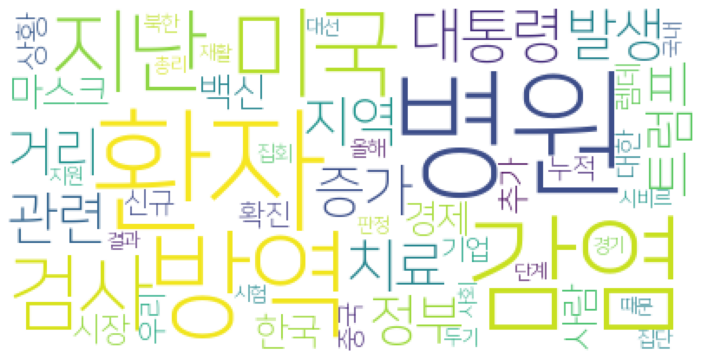

2020.10.16
['신청', '백신', '승인', '사용', '화이자', '미국']
['승인', '백신', '사용', '화이자', '미국', '신청']
[]
['평가', '병원', '요양', '군립', '운영']
['경남', '지난', '연휴', '한글날', '방문', '접촉']
['일자리', '취업', '사회', '고용']
['승인', '사용', '화이자', '백신', '신청']
['택배', '장씨', '노동자', '쿠팡', '업무', '물류', '센터']
['북한', '미국']
['식량', '세계', '문제', '기아']
['조선', '고용']
['클럽', '마스크', '거리', '두기', '손님', '다시', '연합뉴스']
['장관', '한중', '회의', '협력', '산업', '부산']
['현재', '바이든', '후보', '트럼프', '대통령', '여론조사', '이번', '대선']
['경합주', '대선', '후보']
['북한', '총회', '미국', '열병']
['일본']
['단장', '북한', '일본', '미국', '군사']
['일본']
['소비', '쿠폰', '추진']
['택배', '기사', '통운', '박승택', '하루', '시간', '물량', '연합뉴스']
['시간', '택배', '기사', '통운', '박승택', '하루', '물량', '연합뉴스']
['여왕', '마스크', '영국', '구진']
['백신']
['택시', '휴업', '부산']
['메탄', '배출', '가스', '시설', '케이로스', '석유', '산업']
['시설', '메탄', '배출', '가스', '케이로스', '석유', '산업']
[]
[]
[]
['사업', '모빌리티', '택시', '우버', '시장', '서비스', '기업', '텔레콤', '호출', '국내', '카카오', '경향신문', '차량', '운영', '업계']
['환자', '효과', '렘데', '시비르', '치료', '결과', '연구', '경향신문', '지난', '보고']
['감염', '술집', '사람', '집단']


['그룹', '사업', '회장', '열사', '시장', '내년', '인사', '계획']
['지난달', '취업', '감소', '고용']
['연구원', '연구', '원장', '창립', '기념']
['대추', '축제', '온라인', '보은']
['렘데', '시비르', '치료']
[]
['재정', '준칙', '의원', '총재', '상황']
['근로', '복지', '안정']
['청년', '신청', '원금']
['전자', '회사', '평가']
['하루', '증가', '신규', '모스크바', '최대', '지난', '조치', '누적', '러시아']
['백신', '미국', '임상시험', '승인', '개발', '진행', '접종', '응답', '상황', '중단']
['지적', '트럼프', '대통령', '후보', '바이든', '행사', '타운', '대해', '질문', '미국', '비난']
['택배', '쿠팡', '과로사', '노동자', '대책위', '근무', '물류', '센터', '고인', '오마이', '노동', '업무', '문제', '요구', '지난', '대구', '야간', '촉구', '작업', '해결', '유족', '분류']
['수산', '세계', '대학', '장관', '부산', '한국', '사업', '부경대', '학생', '분야', '유엔', '교육']
['자녀']
['판정', '학생', '검사']
['발표', '국내', '환자', '치료', '렘데', '시비르', '연구', '결과', '검토', '실험', '효과', '관리', '입원', '지난', '연대', '미국', '투약', '이번', '사망률', '효능', '비르', '산소']
['커피', '머신', '자동', '원두', '카페', '유라', '추출', '에스프레소', '브레빌', '블루', '분쇄']
['보성군', '캐릭터']
['강조', '트럼프', '대통령', '바이든', '문제', '대해', '대선', '부통령', '대법관', '토론', '미팅', '스리', '선거', '타운', '캠프', '진행자', '질문'

['버스', '인천', '운행']
['지수', '하락', '포인트', '외국인']
['감염', '발생', '관련', '선원']
['발생', '감염', '관련', '선원']
['쿠팡', '노동자', '물류', '근무', '택배', '센터', '야간', '분류', '작업', '강도', '대책위', '노동']
['미국', '마감', '경제', '봉쇄', '전날']
['마감', '경제', '봉쇄', '전날', '미국']
['매출', '감소', '패션', '지난해', '티파니']
['자영', '영업', '가구', '업자', '고용']
['대사', '대통령', '한국', '신임장', '경제']
['미국', '하락', '포인트', '외국인', '전날']
['방역', '접촉', '경제', '검사']
['가맹', '지원', '아리따움', '협약', '아모레퍼시픽', '협의', '상품']
['시험', '수능', '수험생', '별도', '방역', '지침', '관리', '감독', '자가', '마스크', '격리']
['축제', '방역', '취소', '인천', '불꽃']
['경제', '은행']
['클린', '핸드', '제품', '디펜스', '모든']
['쿠폰', '소비', '지급', '요건', '완화', '외식']
['화물', '기내', '전용기', '운송', '사업', '좌석', '방식', '진에어', '업계', '국토부', '시트', '관계자', '경우', '전환', '개조', '승인', '노선']
['택배', '노동자', '대구', '과로사', '쿠팡']
['하락', '미국', '포인트', '외국인', '전날']
['후보', '클린턴', '대선', '바이든', '트럼프', '여론조사', '대통령', '가능성', '선거', '투표', '확률', '개표', '때문', '상황', '차이', '결과', '반전', '토론', '승리', '포인트']
['문제', '이스타항공', '조치', '의원']
['근로', '복지', '고용', '기부', '안정']
[]
['대중문화', '중국', '한

['항쟁', '부산', '부마', '민주', '기념', '규명', '피해자', '시민', '여러분']
[]
['칭다오시', '칭다오', '당국', '방역', '환자', '조사', '검사', '감염', '집단', '발생', '베이징시']
['준칙', '재정', '의원', '총재', '상황']
['춘천', '축제', '중도', '영상', '공연', '어바웃타임', '예술인']
['직원', '이마트', '검사', '상봉']
['예술원', '분야', '미술', '회원', '작품', '대한민국', '전시']
[]
['기업']
[]
[]
['사업', '서비스', '기업']
[]
['프랑스', '정부', '빈곤층', '사람', '위해', '사태', '지난', '단체']
['캐릭터', '보성군', '지역']
['대출', '공인', '소상', '보증', '지원', '정부', '은행', '심사', '신용']
['기업', '전망', '지역', '경기']
['의원', '보고서', '투자', '미래', '뉴딜', '펀드', '석탄', '사업', '산업', '수익률', '야권', '그린', '정부', '대해', '국가', '회장', '강조', '은행', '대한']
['병원', '환자', '해뜨락', '요양', '입원', '실시', '직원', '가운데', '북구', '시설', '검사']
['권태신', '경제', '부회장', '동아시아']
['청년', '특별구', '신청', '원금', '직지', '참여']
['논의', '지역', '신흥', '학회', '회의', '대외', '경제', '위기', '연구', '체인', '한국', '밸류']
['포인트', '평가', '부정', '민주당', '긍정']
['트럼프', '자신', '대통령', '바이든', '후보', '앵커', '타운', '사실', '스리', '행사', '질문', '주장', '계속', '당신']
['빈곤', '차별']
['제주', '공무원', '지사', '도민', '지역', '정치', '중앙', '도전', '대권', '노조']
['기업'

['기업', '오후', '삼성', '시험', '응시', '온라인', '채용', '검사', '실시', '시간', '필기', '역량', '한국', '부정행위', '도입', '오전', '적성검사', '문제']
['클라우드', '네이버', '시장', '솔루션', '기술', '서비스', '제공', '지난', '사업자']
['렘데', '시비르', '부작용', '보고']
['의결권', '복수', '지원', '택시', '기사', '고용', '벤처기업', '법인', '안정', '기업', '원금', '정부', '행사', '부총리', '긴급']
['타트', '체리', '모랑', '섭취']
[]
['여성', '백일장', '온라인', '부문']
[]
['진단', '키트', '수출', '허가', '식약처', '획득', '승인', '제품']
['수험생', '시험', '마스크', '관리', '수능', '교육부', '경제', '칸막이', '시도', '교육청', '지침']
['경향신문', '병원', '요양', '환자', '직원']
['비누', '항균', '알코올', '모든', '세균', '소독제', '바이러스', '성분']
[]
['트럼프', '대통령', '감염', '치료', '입원']
[]
['시험', '수험생', '수능', '마스크', '경우', '관리', '방역', '별도', '격리', '자가', '착용', '증상', '식사', '유증', '일반', '위해', '칸막이']
['수능', '시험', '마스크', '수험생', '착용', '관리', '별도', '예정', '일반', '방역', '대해', '격리']
['시험', '마스크', '수험생', '확인', '증상', '방역', '별도', '착용', '자가', '조치', '본인', '교육부', '격리', '수능']
['시험', '마스크', '수험생', '수능', '방역', '별도', '경우', '착용', '보건', '증상', '의심', '위해', '이상']
['시험', '감독', '수험생', '별도', '수능', '착용', '마스크', '답안

['관광', '문산', '자유시장']
['사망자', '충남', '천안']
['부양책', '협상', '맥밀런', '타결', '미국', '정부', '올해']
['대통령', '트럼프']
[]
['확대', '트럼프', '대통령', '바이든', '질문', '토론', '대해', '연방', '정원', '지지', '대법관', '자신', '경제', '모습']
['유럽']
['항소', '선고', '인천']
['호반', '전시', '아트', '초대권', '리움', '문화', '지역', '교육', '전달']
['후각', '치료', '장애', '원인', '질환', '효과', '스테로이드', '증상', '환자', '재활', '연구']
['가구', '소득', '지원', '접수', '지급', '긴급', '현장', '신청', '복지']
['상황', '재정', '준칙', '의원', '총재']
[]
['지난', '생각', '비율']
['전자', '기업']
['실험', '확산', '관중', '일본', '정부', '입장', '프로야구']
['쿼리', '호텔']
['재정', '의원', '총재', '준칙', '정부', '발언']
['패스트', '리테일', '실적', '매출', '일본', '한국', '순이익']
['공주']
['위험', '금리', '경기', '경제', '대유행', '침체', '지속', '위기']
['공주']
['지사', '이재명', '선고', '무죄', '지지자', '도민']
['생명', '낙태', '주교', '신임', '대해', '반대']
['전자', '영화', '갤럭시', '언택트', '상영', '촬영', '감독', '삼성', '화질', '시네마', '영상', '소비자']
['바이든', '후보', '대통령', '트럼프', '대선', '대법관']
['상담', '청소년', '정신건강']
['정부', '상황', '사회', '무엇', '이희', '국민', '소장', '포털', '개혁', '인권', '미디어', '언론사', '언론', '발전', '위원회', '대한', '경쟁', '어뷰징', 

['지난', '감소', '고용', '취업', '증가', '구직', '경향신문', '전보', '이후', '숙박', '상황']
['경향신문', '전보', '감소', '고용', '취업', '증가', '구직', '지난', '이후', '상황', '숙박']
['이후', '감소', '전보', '근로자', '포인트', '고용', '취업', '기준']
['탐방', '산림', '연구소', '도립']
['연구소', '도립', '탐방', '산림']
['취업', '감소', '고용', '수가', '이후', '증가']
['기준', '실업자', '취업', '감소', '이후', '개월', '증가', '휴직', '실업률', '인구', '지난', '무급', '가장', '확산', '근로자', '상승', '자도', '통계', '고용', '동월', '청년', '이상']
['병원', '치유']
['북한']
['후보', '바이든', '캠프', '해리스', '확진', '판정', '유세', '대면', '상황']
['서비스', '사업', '투자', '모빌리티', '기업']
['지원', '장학재단', '지역', '모집']
['진단', '항원', '키트']
['면접', '비대', '교육']
[]
['빅히트', '중이', '미국', '전날', '기록', '상승', '하락']
['부마', '민주', '항쟁', '대통령', '기념']
['안마', '위메프', '협회', '시각장애인']
['미국']
['백신', '치료', '개발', '대통령', '회장', '바이오']
['인천', '행사', '기업']
['동아오츠카', '리그']
[]
['치료', '렘데', '시비르', '환자', '결과', '입원', '진행', '비르']
['도움']
['두레', '주민', '콘서트', '마을']
['고인', '교수', '지난', '강경화', '장관', '연세대', '명예']
['단계', '조치', '정부', '영국', '런던', '대응', '지역별', '지역']
['투자', '서비스', '사업', '모빌리티', '기업']
['사업',

['개월', '감소', '취업']
['면접', '시흥', '시흥시', '구직', '박람회', '위해', '구인', '일자리']
['비대', '면접', '교육']
[]
['백신', '개발', '후보', '물질', '사노피', '트랜', '슬레이트', '중인']
['감소', '포인트', '고용', '근로자', '전보', '취업', '이후', '임금', '인구', '기준']
['국민', '응시', '의원', '의대', '시험', '정부', '국시', '라며', '의사', '의료', '국시원', '거부', '보건', '기회', '경제', '문제', '복지부']
['주민', '지역', '야간', '통행금지', '시간', '오후']
['정상', '회의', '폰데', '라이', '집행', '위원장']
['신규', '백신']
['다시', '간밤', '협상', '확산', '로시', '지난', '어레이', '합의', '정상', '공개', '미국', '증가', '므누신', '의장', '이후', '장관', '오늘', '주간', '계속', '에너지']
['취업', '대비', '집계', '감소', '고용', '증가', '수가', '동월', '근로자']
['렘데', '시비르']
['엔리케', '로레스', '프린터', '변화', '기술', '사진', '향후', '근무']
['엔리케', '로레스', '프린터', '변화', '기술', '사진', '향후', '근무']
['공동']
['개발', '백신', '대통령', '치료', '회장']
['취업', '감소']
['가장', '백신', '감염병', '미생물', '세계', '개발', '저자', '독감', '역학', '치료', '치명', '오스', '터홈', '모기', '대유행', '발생', '살인']
['전자', '메모리', '시장', '스마트폰', '반도체', '상반기', '글로벌', '기록', '대비', '증가', '점유']
['후각', '장애', '냄새', '문제']
[]
['동월', '이후', '기준']
['취업', '감소']
['감소', '

['위해', '개발', '백신', '치료', '방문', '회장']
[]
['지침', '분사', '경우', '소독', '소독제', '방역', '방식', '효과', '봉사', '교육', '보건', '분무', '표면', '바이러스', '지자체', '자치구', '시설', '사람', '지역', '야외', '체크', '거리']
['지난', '마드리드', '유럽', '지역', '프랑스', '야간', '각국', '파리', '정부', '겨울', '봉쇄', '영국', '방역', '환자']
['대표', '이마트', '신세계', '온라인']
['징역', '구형', '선고', '이씨', '손정우', '특가법', '절도']
['확진', '환자', '지난', '병원', '직원']
[]
[]
['비타민', '효과', '감기', '보충', '이상', '경우']
['총리', '나카소네', '장관', '대한', '일본', '조의', '표명', '국립대', '비판', '내각', '정부', '장례식', '비용', '자치', '가토', '단체', '합동', '요구', '문서', '문부과학성', '교육', '제기', '위원회']
['환자', '접촉', '보건', '판정', '전북']
['정책', '다만', '관계자', '목표', '예산', '어린이집', '공립', '센터', '거점', '사업', '올해', '서울시', '지원', '운영', '관련', '우리동네', '설치', '기준', '상황', '확충', '지난해']
['광견병', '인도', '치료', '마리']
['대책', '방역', '모임', '감염', '우려', '가을', '단풍', '핼러윈데이']
['수목원', '세종', '중앙', '조성', '공원', '사업', '전시', '국립', '한국', '정원', '단계']
['격차', '경제', '트럼프', '대통령', '바이든', '지지율', '타운', '경합주', '여론조사', '토론', '방송', '플로리다', '예정', '중계', '행사', '유세', '대선', '포인트', '후보', '시간

['안전', '박스', '지원']
['진행', '응답', '지난', '중재', '절차', '한국', '판정', '질의', '의장', '론스타', '사건', '비니', '부가']
['연휴', '병상', '중환자', '환자', '발생', '의료', '기관', '반장', '전략기획']
['병상', '중환자', '환자', '발생', '의료', '기관', '반장', '연휴', '전략기획']
['신규', '미국', '확산']
['시설', '운영', '사회', '복지', '재개', '이용', '거리', '두기', '방역', '지난', '복지관']
['렘데', '시비르', '부작용', '사용', '치료', '보고', '환자', '투여']
['부마', '총리', '민주', '항쟁', '공동체', '국민', '정부']
['소득', '가구']
['중환자', '대본', '병상', '환자', '집회', '금지']
[]
['지사', '관련', '정치', '대선', '지난', '언론', '기본소득', '부동산', '옵티머스', '도지사', '판결']
['사업', '올해', '고객', '그룹', '회장', '전략', '계열', '경제', '보고', '업보', '방안']
[]
[]
['추진']
['소득', '가구', '지원', '접수', '현장']
['고객']
['분단', '민주당', '주의', '정치', '의장', '평화', '강조', '정부', '지난', '국민', '우리', '변호사', '민화협', '한반도', '권위', '대통령', '카잘스', '이제', '생각', '가장']
['보도', '영국', '단계', '여왕', '엘리자베스', '마스크']
['의장', '주교', '한국', '사목', '생명', '희년', '천주교', '주년', '회의', '가톨릭', '미사']
[]
['병원', '요양', '감염', '집단', '어르신', '위험', '부산', '발생', '상황', '방역', '환자', '시설']
['훈련', '부대']
['인도네시아', '추가', '누적', '필리핀']
['

['하나은행', '지점']
['업자', '자영', '영상', '금융', '경제', '신한은행', '위해']
['대비', '증가', '근로자', '광주', '취업', '개월', '감소', '임금']
['미티', '행사', '미국', '통해']
['인도', '대기오염']
['자연휴양림', '국립', '체험', '이용']
['치료', '비용', '국민', '입원', '차관', '지원', '확산', '조치', '방역', '청원', '사회', '감염병', '집회', '경우', '대해', '광화문', '방법']
['안마', '위메프']
['명품', '패션', '브랜드', '실적', '예상', '매출', '감소', '애널', '리스트']
['명품', '브랜드', '실적', '예상', '매출', '패션', '애널', '리스트', '감소']
['병원', '국군', '의사', '장병', '환자', '명당', '진료', '우리나라']
['대비', '감소', '상승', '수출', '효과', '경제', '동월', '회복', '확산', '영향', '전월', '경기', '물가', '확대', '흐름', '지표', '증가', '생산', '재정', '최근', '불확실']
['영업', '매출', '유니클로', '한국', '적자', '감소', '패스트', '리테일', '실적']
['센터']
[]
['센터']
['렘데', '시비르', '부작용', '치료', '사용', '환자', '투여']
['고객', '업보', '구광모', '회장', '사업', '열사', '진행']
['방역', '소독', '사용', '제품', '제주시', '환경부', '승인']
[]
['방역', '소독', '사용', '제품', '제주시', '환경부', '승인']
['전선', '해상', '케이블']
['고객', '설치']
['개선', '지원', '총재', '국내', '회복', '위해', '경제', '이후', '안정', '한국은행', '완화', '금융', '자금']
['단계', '조치', '금지', '영국', '제한', '술집']
[

['경제', '확대', '상승', '실물', '대비', '감소', '불확실', '물가']
['피고인', '감염', '선고', '인천', '항소', '학원', '진술', '이하']
['김치냉장고', '김치', '보관', '전자', '모드', '아이', '판매', '도어', '맞춤', '용기', '가전', '적용', '제품', '소비자', '업계', '딤채', '신제품', '기능']
['여행', '주의보']
['경남']
['경남']
['고용', '취업', '감소', '개월']
['회장', '사업', '고객']
['경제', '회복', '아이', '국내', '개선', '총재', '중심', '흐름']
['경제', '치료', '차관', '경우', '비용', '국민', '감염병']
['정부', '디지털', '평가', '전환', '추진', '한국', '차지', '결과', '국민', '적극', '노력', '항목', '개국', '지수']
['감소', '회복', '경제', '수출', '증가', '이후', '생산', '확산', '제약', '실물']
['정부', '디지털', '평가', '우리나라', '지수', '개국', '전환', '행안부', '데이터', '개방', '주도', '항목']
['경제', '증가', '지난', '수출', '이후', '상승', '회복', '감소', '지수', '실물']
['테라', '한정', '판매', '참이슬']
['아이', '안전', '박스']
['경제']
['김치', '김치냉장고']
['수출', '경제', '증가', '상승', '회복', '고용', '동월', '대비']
['경제']
['트럼프', '정부', '승리', '캠프', '미국', '대통령', '바이든', '후보', '대표', '전략', '선거', '정치', '문제']
['정부', '디지털', '평가', '한국', '항목', '기록', '국민', '지수', '추진']
['정상', '회의', '폰데', '라이', '집행']
['정상', '회의', '폰데', '라이', '집행']
['백신', '파우치

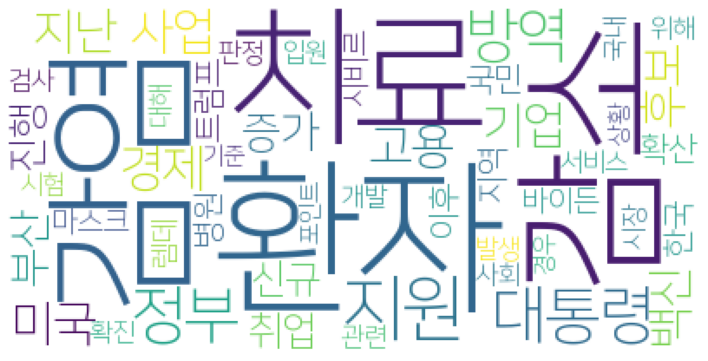

2020.10.15
['감염', '병원', '환자', '부산시', '집단', '취약', '지난', '시설', '해뜨락', '판정', '요양', '관련']
[]
['아마존', '회사', '우리', '미국', '노동자', '해고', '직원', '달러', '시위', '창고', '크리스']
['시설']
[]
[]
['동전', '바이러스', '표면', '지폐']
['유럽', '지난', '다시', '조선']
['제빵', '호감', '파리크라상', '주요', '업체', '가장', '파리', '대표', '명과', '조사', '신라', '던킨도너츠', '바게뜨']
['프랑스', '금지', '체코']
['프랑스', '금지', '체코']
['관련', '모임']
['보물창고', '주민', '도깨비', '운영', '경향신문', '진열', '후원자']
['표면', '러시아', '당국', '지폐', '동전']
['런던', '단계', '금지']
['슈퍼', '운영', '배달', '스마트', '연합뉴스']
['수사', '국민', '의원', '집회', '성추행', '대한', '국감', '시장']
['완치', '후유증', '고통', '호소', '치료', '조선']
['고통', '완치', '후유증', '호소', '치료', '조선']
['집단', '전략', '면역', '전문가', '선언', '백악관', '트럼프', '대통령', '그레이', '보호', '노인', '보건', '경향신문', '집중', '백신', '역학', '배링턴', '미국']
['창원시']
['청와대', '현안']
['이가혁', '생태계', '교란', '핑크', '앵커', '사진', '생물', '팩트', '핑크뮬리', '식물']
['징역', '달걀', '이씨']
['전주', '정읍']
['방역', '시설', '병원', '수도권', '검사', '감염', '지인', '관련', '모임']
['바이러스', '표면', '지폐', '동전']
['보고', '사건', '북한', '권고']
['단계', '다른', '런던', '금지', '지역', '잉

['백신', '개발', '바이오', '대통령']
['정신질환', '치료', '디지털', '허가', '우울증', '개발', '중독', '교수', '정부', '기준']
['점포', '호점', '기술', '스마트', '슈퍼', '무인', '기부', '디지털', '도입', '서비스', '운영', '장관', '지원', '박영선', '경영', '구매', '육성', '모델']
['바이오', '백신', '개발', '정부', '대통령', '치료', '사이언스', '지원', '회장']
['직원', '회사', '다른']
['백신', '대통령', '개발', '치료']
['아세안', '차관', '대사', '협력']
['개발', '면서', '치료', '백신', '대통령', '지원', '정부', '우리', '현장', '기업']
['가장', '은평구', '증상', '전체', '감염', '경향신문', '관내']
[]
['방청권', '신천지', '배부']
['배달', '커피', '이디야', '서비스', '매출']
['배달', '커피', '이디야', '서비스', '매출']
['대통령', '진행', '개발', '백신', '치료', '바이오', '우리', '사이언스', '회장', '대해']
['제품', '건강', '증가', '아이', '허브', '한국']
[]
[]
['기업', '지원', '스파크', '플러스', '프로모션', '호점']
['개발', '백신', '치료', '대통령', '현장', '생산', '지원', '정부', '기업', '위해']
['기침', '연설', '주석']
['치료', '강조', '개발', '대통령', '백신', '지원', '바이오', '상황', '사이언스', '연구원', '정부', '회장', '생산', '격려', '지난']
['기금', '기안', '항공', '지원', '제주항공', '여행', '상품', '상공', '업계', '자금', '비행', '아시아나', '판매', '노컷뉴스', '오후', '하늘']
['개발', '대통령', '백신', '치료', '바이오', '격려',

['교류', '거점국립대', '활성화', '국민일보', '대학', '서울대', '협약', '국립', '학생', '학점', '총장', '수업']
[]
['평화', '광장', '예술', '경기', '문화', '프로그램', '진행']
['관련', '감염', '방역', '집단']
['헌혈', '혈액', '수혈', '관리', '의원', '완치']
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
['걷기', '건강', '지역', '진행', '군민', '행사', '하루', '참여']
['플랫폼', '경제', '사회', '광주', '지역', '의제', '혁신', '추진', '협업', '제안', '구축', '문제', '기관', '발굴', '마을', '해결', '아시아', '공공기관']
['프랑스', '상황', '인구', '신규', '유럽', '미국']
['재판', '이씨', '달걀', '선고', '혐의', '절도', '사건']
['슈퍼', '스마트', '기술', '장관', '무인', '지원', '상공', '디지털화', '디지털', '육성']
['개발', '치료', '대통령', '백신', '바이오']
['부산', '어린이집']
[]
['광주']
[]
[]
['배부', '신천지', '방청권', '지법', '노컷뉴스', '재판', '방식']
['회의', '유엔', '식량', '세계', '위해', '기구', '영상', '농업인', '안보', '시스템', '국제']
['범죄', '달걀', '혐의', '처벌', '재판', '가중']
['재판', '가중', '혐의', '범죄', '처벌', '달걀']
['신청', '집행정지', '경찰', '통고', '집회', '금지', '단체', '법원', '신고', '대해', '거리', '두기', '보수', '판단', '광장', '광화문', '대위']
['접수', '자금', '희망', '지원', '상공', '지급']
[]
['백신', '접종']
['광주시', '도시']
[]
[]
['리버풀']
['여단', '한국', '기갑', '전투', '순환', 

['근로자', '선발', '대구시', '자녀', '심의', '기준']
['모임', '관련']
['부자', '소비', '중국', '미국', '경제', '대유행', '보고서', '중국인', '건강', '기간', '쇼핑', '여행']
['기업', '지원', '프로모션', '호점']
['기업', '지원', '프로모션', '호점']
['캠프', '쿠팡']
[]
['집회', '금지', '법원', '판단', '개천절', '한글날', '통고', '만큼', '광화문', '시민단체', '지난', '광장', '경찰', '정지', '효력']
['보좌', '방문', '실장', '미국', '안보', '방미', '이번', '청와대', '지난', '관련', '면담', '지난달', '정부', '대통령', '한미', '연설', '우리', '브라이언', '대선', '협의', '인사', '한반도', '동맹', '북미']
['감염', '어제', '환자', '발생', '병원', '부산', '지난', '사회', '지인', '모임', '확진', '지역', '누적']
[]
['어린이', '임상시험', '미국', '백신']
['백신']
['기업', '국민은행', '보증', '지원']
[]
['부담', '이륜차', '보험료', '자기', '보험', '운송', '배달', '가입', '업무', '유상', '할인', '사고', '대인', '가정', '담보', '종사']
[]
['백신', '방문', '개발', '치료', '대통령', '현장', '정부', '바이오', '참여', '지원', '사이언스']
['선고', '유예']
[]
['할인', '부담', '이륜차', '보험료', '자기', '보험', '운송', '배달', '가입', '유상', '대인', '종사', '사고', '가정', '업무', '담보']
[]
['시민', '학교', '민주주의', '지수', '교육', '민주', '조사', '교육청', '활용', '자치', '문항']
[]
[]
['부분', '네덜란드', '봉쇄', '단계', '뤼테', '마스크', '

['제주', '격리', '자가', '입국', '장소', '이탈']
['돌연변이', '감염']
['중소기업', '기업']
['조례', '서산', '의원', '생강']
['혈액', '원료', '수익', '인상', '관리', '헌혈', '분획', '복지부', '다시', '자료', '국가', '제제', '독점', '국회', '가격', '적십자', '사업', '보험', '문제', '약사', '혈장', '수혈', '분리', '녹십자', '건강', '대한', '사실', '공급', '협상', '플라즈마', '운영', '원가', '제약', '관련', '팔고']
['엔지니어링', '협력', '물품', '사회']
['사건', '북한', '보고서', '경향신문', '당국']
['대만', '중국', '판정']
['캠프']
['남동구', '주점', '경제', '관련', '남성']
['재건축', '동의', '건축', '규제', '허가', '개선', '건축물', '국민', '간소화', '활성화', '상가']
['협력', '엔지니어링', '사회', '물품', '기증']
['발생', '모임', '지인', '관련', '추가', '종사', '확진', '조사', '집단', '감염', '환자', '병원', '누적', '가족']
[]
['신형', '대중화', '폭스바겐', '제타', '시장', '출시', '수입', '코리아', '가격', '모델', '차량', '사장', '한국', '세대', '판매', '크랍', '제공', '국내', '프로모션']
[]
['발생', '모임', '관련', '추석', '연휴', '가족', '지인']
['모빌리티', '자율', '주행', '로봇', '서비스', '기술', '행사', '기업', '판교', '배달', '순찰', '서빙']
['지원', '프로모션', '공간', '호점']
['아이', '창업', '상가', '운영', '디앤티', '홀딩스', '강연', '노포', '점포', '점주']
['의원', '장관', '공중급유기', '이용', '지적']
['아이', '쿠팡',

['특허', '소송', '이노베이션', '침해', '화학', '관련', '청문회', '미국']
[]
['베트남', '일본', '때문']
['산재', '택배', '보험', '기사', '제외', '통운', '노동자']
['티켓', '영화제', '예매', '부산', '상영']
['목사', '조사', '혐의']
['랜선', '디지털', '웨딩', '예비', '부부', '이벤트', '백화점', '면세점', '취소', '결혼식', '영상', '연기', '현대']
['관광', '지역', '포럼', '한국', '학회', '시대', '수도권', '개최', '정책', '이번', '학술', '산업', '포스트']
['코리아', '센터', '무상증자', '통해', '플랫폼', '주주', '주식', '사업', '신주', '가치', '담당', '배정']
['확산']
['한미', '협의', '방미', '실장', '미국', '의원', '브라이언', '안보', '보좌', '국가', '회의', '동맹', '한반도']
['기사', '혐의']
['투표', '사전투표', '선거', '유권자', '대선', '사전', '전체', '현장', '지난']
['러시아', '백신', '승인']
[]
['말레이시아', '이동', '제한', '신규', '생필품', '사바', '명령']
['조사', '와인']
['대만', '중국', '검사', '판정', '당국', '환자']
['대만', '중국', '검사', '판정', '당국', '환자']
['관광', '스마트', '해남', '조성', '계획']
[]
[]
['자굴산', '둘레길', '등산로']
[]
[]
['행사', '웰니스', '체험']
['체험', '행사', '웰니스']
[]
['자율']
['자율']
[]
['방문', '실장', '미국', '청와대', '한미', '동맹']
['조사', '목사']
['대학', '중심', '경진', '대회']
['정부', '영향', '국가', '재정', '한국', '평가', '준칙', '신용등급', '전망', '부채', '킴엥',

['근무', '머프', '디렉터', '깃랩', '직원', '기업', '업무', '재택근무', '산업', '디지털', '시간', '원격']
['학생', '전국', '방역', '인력', '학기', '학교', '교육청', '가장', '배치']
['변화', '가장', '설명', '트렌드', '교수', '소비', '레이어', '사람', '바이러스', '경제', '워드', '자신', '롤코', '이제']
['헌혈', '혈액', '단체']
['인터넷', '편지', '훈련병', '육군훈련소', '서비스', '의원']
['호흡기', '환자', '진료', '클리', '전담', '보건소', '증상']
['대만', '중국', '판정', '검사']
['진료', '전담', '호흡기', '클리', '환자', '보건소', '증상']
['청와대', '안보', '협의', '미국', '실장', '서훈', '방문', '한미', '동맹', '이번', '연합뉴스']
['개관', '도서관', '부산', '부산시']
['지출', '부채', '재정', '수준', '회복', '경제', '각국', '정부', '보고서', '이후', '세계']
['캄보디아', '주민', '경제', '코이카', '세트']
[]
['부여', '문화재', '야행', '온라인', '통해', '유튜브', '체험', '가족']
[]
[]
['비율', '상무', '정부', '한국', '재정', '지역', '전망', '요소', '고용', '준칙', '도달', '아태', '평가', '국가채무', '영향', '킴엥', '유지', '관리', '경제', '다른', '국가신용등급', '수준', '국가']
['물방울', '기술', '미세']
['미세', '물방울', '기술']
['경제', '대한', '포스트', '변화', '산업', '사회', '미래', '생산', '시대', '건설', '논의', '이후']
['가격', '증시', '투자', '지수', '상환', '지난', '개월', '규모', '투자자', '수익', '급락', '발행', '기준', '최

['전환', '전작권', '장관', '방위', '한미', '에스퍼', '국방', '단계', '이견', '조건', '기자회견', '시간', '능력', '동성']
['죽도', '김씨', '사람', '죽도시장', '손님', '경북', '포항', '카페', '소년', '오마이', '시작', '운영', '시장', '김희준', '가게', '단골', '상인', '전통', '매일', '이상', '주위']
['기업', '국민', '경제', '자유', '구역', '규제', '개선', '사회', '조정', '방안', '총리', '정부', '논의', '의료']
['우유', '원유', '제품']
['통제']
['기술', '전기', '국내']
['객실', '요가', '프로그램', '신라', '리드', '세리머니', '디럭스']
['수업']
['취업', '구직', '경향신문', '준비', '합격', '응답', '가장', '채용', '직무']
['취업', '구직', '경향신문', '준비', '합격', '응답', '가장', '채용', '직무']
['백신', '러시아', '개발', '승인', '방식', '안전성']
['아이', '요가', '프로그램', '호텔', '리드', '야외', '신라', '디럭스', '세리머니', '객실']
['한미', '합의', '미군', '운용', '여건', '모색', '더욱', '남북', '방어', '동맹', '군사', '에스퍼', '이행', '대해', '추진', '협의', '활동', '지역', '준비', '협력', '전환', '안보', '대한민국', '주목', '대응', '신뢰', '제공', '장관', '논의', '안정', '상호', '효과', '상황', '반환', '목표', '전작권', '태세', '국방', '통해', '증진', '관련', '기여', '개최', '연구', '사이버', '연합', '평가', '또한', '확인', '발전', '강조', '회의', '보완', '보장', '지속', '능력', '방위', '공약', '평화', '표명', '위해', '측은'

['모임', '추수감사절']
['임상시험', '브라질', '소렌토', '제약', '치료']
['부양책', '지수', '미국', '실적']
['대통령', '여사', '트럼프', '멜라', '니아', '대선']
['조치', '통행금지', '적용', '바이러스', '지역', '프랑스', '저녁', '경우', '파리']
['수출', '회복', '지원', '기업', '시장', '아세안', '중국', '경기', '대감', '전망', '개선']
['이용', '철도']
['한미', '장관', '북한', '안보']
['감염', '면역', '암치료']
['어린이', '친구', '경향신문', '아이']
['발생', '병원', '감염', '양병', '검사', '노인', '집단', '부산', '진단', '키트', '요양', '방역', '환자', '대구', '관리', '수도권']
['미국', '부양책', '지수', '시장', '실적']
['한미', '동맹', '확인', '대응', '관련', '국방', '협의', '기여', '제공', '측은', '발전', '훈련', '표명', '작전', '변화', '상황', '강조', '태세', '유지', '추진', '사의', '신뢰', '방지', '보장', '장관', '또한', '평화', '증진', '전작권', '국방부', '분야', '조치', '수행', '안보', '대해', '공동', '활동', '포함', '반환', '역량', '위원회', '공감', '연합', '방위', '에스퍼', '대한민국', '공약', '안정', '필요성', '우주', '위협', '상호', '지역', '환경', '지속', '평가', '조건', '이행', '논의', '양국', '기초', '협력', '한반도', '능력', '대한', '미군', '노력', '통해', '회의', '획득', '준비', '위해', '군사', '전환', '계획', '주목', '합의', '한국', '유엔', '효과']
['판정', '음성']
['판정']
['빅히트', '상장', '공모', '주식', '기념']

[]
[]
['승인', '백신']
['세계']
[]
[]
['춘천']
['학생', '운동회', '당시', '학교', '시민']
['가구', '지원', '생계', '소득']
['가구', '지원', '생계', '소득']
[]
['강원']
['이후', '확산', '조치', '술집', '금지', '유럽', '지난주', '인구', '신규', '지난', '최고', '발생', '영국', '하루', '동안', '감염', '지역', '체코', '정부', '식당', '가장', '프랑스', '중국', '기록']
['가장', '검색', '비율', '증가', '여행', '항공권', '편도', '국내', '즉흥', '대비', '지난', '팬데믹', '스카이스캐너', '특징', '여행자', '전세계', '감소', '조사', '검색량', '한국', '한국인', '세계', '수요']
['중단', '치료', '일라이', '릴리', '개발', '백신', '항체', '임상시험']
['면역', '집단', '미국']
['조치', '북아일랜드', '서킷', '브레이크']
['백신', '러시아', '승인', '개발', '센터', '국가']
[]
['대표']
['평택']
[]
['헌혈', '직원', '경제', '캠페인', '우리은행']
['필수', '노동자', '지원', '대책']
[]
['학교']
['반장', '이용자', '검사', '종사', '감염', '병원', '시설', '전수', '정부', '방안', '요양', '입원', '지역', '때문']
['치료', '임상시험', '백신']
['치안', '스토킹', '환경', '정책', '공갈', '범죄', '협박', '경제', '감소', '신고', '증가']
['발생', '부산', '지역', '수도권']
['멜라', '니아', '여사']
['방역', '인력', '전국']
['방역', '인력', '전국']
['장관', '실장', '미국', '안보', '한미', '협의', '폼페이', '시간', '현지', '방미']
['미국', '이번', '한미', '동맹',

['지원', '가구', '생계', '긴급', '소득', '원금']
['백신', '공급', '영국', '인도네시아', '분량', '장관', '레트', '중이']
['인상', '연봉', '협상', '내년', '대감', '인사', '담당자']
['대위', '신고', '주말', '집회', '경찰', '금지', '광화문', '도심', '단체', '지난', '광장']
['안보', '한미', '미국', '협의']
['환자', '각국', '봉쇄', '미국', '조치', '스페인', '유럽', '확산', '지역', '프랑스', '확진', '신규', '정부', '영국', '감염', '병원', '하루', '전문가', '평균', '자수']
['경기', '소금길', '대장정']
['보은', '대추', '축제', '온라인']
['판매', '자동차', '개별', '소비', '인하', '산업', '협회', '올해', '확대']
['등록', '대해', '대출', '금리', '부업', '도민', '법정', '최고', '조사', '수준', '찬성', '공감']
['조직', '사업', '구축', '부사', '체제', '신세계', '대표이사', '이마트', '인사', '담당', '기반', '강화', '그룹', '부문', '미래', '전문성', '시너지', '본부', '경영', '신설']
['협의', '미국', '실장', '한미']
['수소', '경제', '공급', '천연가스', '지원', '총리']
['목사', '조사']
['목사', '조사']
['실장', '한미', '협의']
['아비', '승인', '치료', '신문']
['미국', '실장', '한미', '협의']
['배송', '서비스', '기사', '카드', '안심', '전용', '관리', '필요', '출입']
['완치']
['장소', '해외', '격리', '자가', '이탈', '제주', '입국', '무단', '이하', '모두']
['백신']
['롯데', '건설', '운영', '프로그램', '주민', '엘리스', '언택트']
['신규', '발생

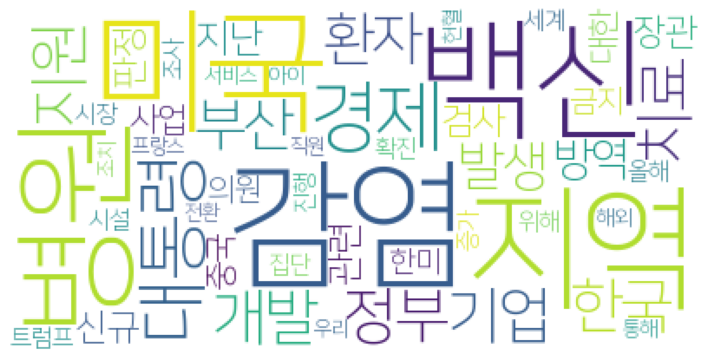

2020.10.14
['러시아', '백신', '승인', '센터', '개발', '스푸트니크']
['미국', '유럽', '상황', '존슨']
['두기', '업주', '거리', '손님']
['검사', '관리', '진단', '확산', '입국', '지역', '공항', '해외', '건의', '검역', '개선', '대해', '결과', '감염', '방역', '방안']
[]
['밍크', '농장', '감염', '처분', '조선']
['격리', '도시락', '원산지', '표시', '시설', '생활', '업체']
['발톱', '다리', '부위']
['바이든', '트럼프', '대통령', '조선', '유세']
['한국', '미국', '공격', '중국', '한미', '비판', '누리꾼', '대한', '관계']
['환자', '병원', '감염', '부산시', '부산', '판정', '조치']
['회장', '현대차', '그룹', '취임', '미래', '조선', '정의선']
[]
['백신', '접종', '무료', '청소년', '소아']
['도청', '경남', '국제', '민주주의', '포럼', '지역', '사회', '혁신', '참여', '시민', '주제', '로컬']
['감염']
['신규', '재개', '러시아', '모스크바', '항공', '지난', '하루', '증가', '정부', '운항', '조치']
[]
['독감', '청소년', '이하', '기관', '백신', '물량', '구매', '의료', '계약', '접종']
['해외', '감염', '앵커', '집단', '병원', '방역', '걱정', '조선']
['해외', '감염', '앵커', '집단', '병원', '방역', '걱정', '조선']
['교황']
['러시아', '모스크바', '신규', '항공', '지난', '하루', '재개', '정부', '운항', '증가', '조치']
['지난', '러시아', '모스크바', '신규', '항공', '하루', '재개', '운항', '정부', '증가', '조치']
['일본']
['치료']
['감염', '노인', 

['환자', '병원', '감염', '직원', '요양', '증상']
['환자', '병원', '감염', '직원', '요양', '증상']
['치료', '청력', '환자', '문제', '교수', '영국', '손실', '경험', '설명']
['공연', '극장', '산울림', '무대', '작품']
['창업', '대회', '아이템', '본선', '심사', '참가']
['수소', '경제', '세계', '에너지', '산업']
['배출량', '영향', '감소', '자료', '분석']
['트럼프', '대통령', '후보', '바이든', '대선', '포인트', '여론조사', '이후', '조사', '가디언']
['휴직', '연장', '기안', '대한항공', '정부', '원금', '기금', '유급']
['사업', '추진', '일자리', '기업', '지원', '환경', '신규', '업체', '드론']
['노르웨이', '백신']
['추모', '사건', '추념', '여수시', '희생', '온라인']
['코미', '스페인', '신청', '치료', '회사']
['불안', '대한', '심리', '보험', '불안감', '이후']
['애플', '인치', '디스플레이', '아이폰', '디지털', '시장', '보조금', '단말', '전략', '출시', '네이버', '국민', '일리', '삼성']
['디스플레이', '네이버', '일리', '아이폰', '애플', '디지털', '시장', '보조금', '단말', '인치', '전략', '삼성', '출시', '국민']
['혈장', '치료']
['아이폰', '시장', '가입자', '판매', '교체', '수요', '국내', '스마트폰', '출시', '올해', '판매량', '이용자', '시리즈', '경쟁', '애플']
['위해', '부장', '품목', '기업', '소재', '협력', '연구', '사업', '글로벌', '지원', '산업부', '계획', '구축', '개발', '고도화', '추진', '기술', '연구개발', '신소재', '부총리']
['개국', '수준', '시

['부장', '계획', '협력', '소재', '산업', '기업', '데이터', '추진', '장비', '위원회', '지원', '연구', '이번', '부품', '개발', '핵심', '품목', '활용', '경쟁력', '공급망', '수립', '강화', '모델', '공급', '전략', '기술']
['소재', '정부', '위원회', '장비', '부품', '품목', '연구', '협력', '계획', '데이터', '기업', '추진', '기술', '부처', '산업', '전략', '이번', '지원', '활용', '공급망', '방안', '모델', '핵심', '사업', '기반']
['사업', '북도', '추진', '일자리', '올해', '고용', '기업', '선제', '드론', '지원', '업체', '산업', '대응']
['납부']
['관리', '입원', '환자', '병원', '감염', '가운데', '관련', '지난', '양병', '직원', '가능성', '확진', '방역', '요양', '부산']
['대출', '축소', '신용', '은행', '증가', '계획', '한도']
['감염', '여성']
['유럽', '방역', '신규', '지난', '체코', '확산', '지난주', '발생']
['자동차', '현대차', '아버지', '당시', '회장', '명예', '글로벌', '경영', '그룹', '미국', '품질', '재계', '현대', '부품']
[]
['장관']
['혈장', '치료', '생산', '녹십자', '완치', '사용', '의료']
['시민', '공연', '소규모']
['행사', '박람회', '구직', '업체', '면접']
['협약', '권리', '처벌', '정부', '모든', '회부', '강조', '특별', '규탄', '이번', '지적', '대통령', '김정은', '규정', '주장', '최고', '우리', '단체', '사무', '국가', '정권', '범죄', '행위', '전문가', '관할권', '관련', '억류', '보호', '유엔', '한국', '보고', '위원회', '조사', 

['방한', '판매', '패딩', '조끼', '용품', '토트넘']
[]
[]
['우리', '미국', '화웨이', '사용', '기업', '협의', '제품', '기술', '경제', '대한', '보안', '네트워크', '업체', '한미', '당국자', '대해', '외교부', '정부', '우려', '설명', '한국', '협력']
['제휴', '증권', '협업', '시장', '일본', '상호', '계약', '양사']
['감염', '사례']
['직업', '현장', '교육청', '취업', '지원', '학생', '센터', '일자리', '실습', '발굴', '양질', '중앙', '운영', '전국', '활동', '협력', '교육부']
['엔진', '설명', '네트워크', '산업', '플랫폼', '원장', '데이터', '각종', '인프라', '현재', '전환', '적용', '솔루션', '디지털', '최적화', '기업', '융합기술원', '활용']
['네이버', '통운', '사업', '중인']
['추경', '예산']
['감염', '사례']
['사례', '감염']
['확진', '환자', '직원', '병원', '부산', '감염', '마스크', '조사', '지난', '간호조무사', '사망']
['올해', '오징어', '한국', '가격', '중국', '어선', '마트']
['밍크', '농장']
['도민', '경기도', '경기']
['지원', '가구', '신청', '소득', '복지']
['부회장', '방문', '귀국', '반도체', '전자', '기술', '네덜란드', '지난', '스위스', '출장', '삼성', '버닝크', '장비', '이번', '생산']
['트럼프', '대통령', '입원', '치료', '박사']
['치료', '트럼프', '대통령', '입원', '박사']
['검사', '방역', '병원', '감염', '진단', '당국', '간호조무사', '환자', '해당', '발생', '시설', '확인', '증상', '전파', '집단']
['수기', '척수', '살균', '웰스', '듀얼'

['개교', '등교', '학생', '지난', '확진', '감염', '교직원', '학교']
['현대차', '시장', '전기차', '신임', '회장', '위해', '자동차', '미래', '중국', '글로벌', '아이오', '기업', '분야', '자율', '사업', '업체', '지난', '모빌리티', '그룹']
['검사', '수도권', '방역', '시설', '지역', '노인', '확대', '위험']
['검사', '병원', '환자', '직원', '감염', '방역', '확진', '종사', '집단', '시설', '판정', '부산', '요양', '반장', '총괄']
[]
['여수시', '사건', '추모']
['등교']
['생생', '교육', '유치원', '영어', '아이', '콘텐츠', '도서관', '그림', '유플러스', '활용', '시범', '학습', '운영', '교재', '효과', '가정']
['영어', '효과', '교육', '유치원', '아이', '콘텐츠', '생생', '도서관', '그림', '학습', '가정', '활용', '교재', '유플러스', '운영']
['문화', '다양성', '시대', '토론회', '유네스코', '한국', '이후', '대한', '위원회']
['미세', '정전', '기술', '물방울', '노즐', '교수', '폴리머', '디컬', '개발', '살균', '이용']
['마스크', '위험', '직업']
['경험', '우울', '불안감', '블루']
['미세', '물방울', '살균', '기술', '인체', '정전', '바이러스']
['방역', '경제', '사회']
['아이디어', '전남도', '국민']
['행복', '희망', '키트', '봉사', '감봉', '사단', '전달']
['중앙']
['중앙']
['회장', '그룹', '총수', '세대', '교체', '승진', '재계', '경영', '부회장', '창업', '현대차', '장남', '부사', '정의선', '사장', '한화']
['수업', '학교', '등교']
[]
[]
['등교']
[]
['병원'

['방문', '부회장', '반도체', '기술', '전자', '장비', '협력', '개발', '방안', '경제', '생산', '출장', '차세대', '논의', '네덜란드', '삼성']
['병원', '환자', '검사', '요양']
['러시아', '백신']
['기술', '부회장', '음성', '장비', '반도체', '생산', '판정', '네덜란드', '귀가', '출장']
['보석', '목사', '청원', '전광훈', '부산', '청와대', '국민', '답변']
['메모', '호텔', '재민', '화재']
[]
['대전']
['청력', '쿰파', '교수', '사례', '영국', '상실', '구진', '손실', '보고']
['백신', '승인', '센터', '러시아', '개발', '스푸트니크']
['집단', '병원', '환자', '부산', '만덕동', '방역', '확진', '요양', '직원', '확인', '이송', '감염', '부산시', '판정']
['개발', '살균', '미세', '물방울', '바이러스', '기술', '디컬', '정전', '노즐']
['일리', '총재', '고용']
['의류', '조폐공사', '기술', '보안', '라벨', '확인', '활용', '공개', '설명', '방지']
['아이디어', '전남도', '국민']
['재미', '할로윈', '음료', '분위기', '시즌', '고객']
['주민', '가운데', '병원', '요양', '해뜨락', '만덕동', '발생', '환자', '확진', '명의', '직원', '오후', '특별', '감염', '방역', '검사', '명과']
['종사', '검사', '병원', '요양', '시설', '감염']
['희생', '참석', '사건', '추모', '여수시', '온라인', '추념', '시민', '영령']
['대회', '민중', '전국', '준비', '집회', '국회']
['대해', '환자', '추가', '감염', '병원', '시설', '단계', '지역', '확진', '검사', '명의', '부산', '오늘', '사회', '부

['그룹', '회장', '미래', '정의선', '자동차', '모빌리티', '현대차', '주행', '취임', '기술', '수소', '세계', '연료', '산업', '자율', '기업']
['신규', '유입']
[]
['공개', '개인정보', '정보']
[]
['고객', '사진', '산업', '경영', '정의선', '자동차', '현대차', '미래', '인류', '성장', '세계', '혁신', '주행', '부회장', '명예', '글로벌', '자율', '강조', '기업', '회장', '그룹', '정몽구', '기술', '모빌리티', '통해', '기아차', '직원', '위해', '친환경', '발전', '행복']
['부산', '병원', '보건', '당국', '환자', '확진', '만덕동', '감염']
[]
['금리', '금통위', '기준금리', '경기', '인하', '동결', '지난']
['확진', '공개', '경로', '환자', '이동', '지침']
[]
['금리', '동결', '기준금리']
['장관', '회의', '서명', '본부장']
['확진', '공개', '개인정보', '환자', '정보', '지자체']
['공개', '개인정보', '확진', '환자', '정보', '지자체']
['피해', '청소년', '수련', '경주', '검토', '시설', '지역', '사항', '대해', '지원']
['항공권', '국내', '여행', '검색', '가장', '증가', '즉흥', '한국', '편도', '조사', '지난', '전세계', '스카이스캐너', '비율', '확산', '년비', '수요', '팬데믹', '검색량']
[]
['프랑스', '마크', '대통령', '방역', '담화', '파리']
[]
[]
['경제', '금통위', '수준', '영향', '회복', '물가']
['자동차', '그룹', '회장', '정의선', '고객', '인류', '미래', '아이', '직원', '현대차', '위해']
['마스크', '스페인독감', '주간경향', '사람', '봉쇄']
['발생']
['최고', '신규

[]
['여행', '항공권', '검색', '증가', '가장', '편도', '국내', '즉흥', '검색량', '팬데믹', '한국인', '대비', '한국', '전세계', '특징', '비율', '수요', '조사', '스카이스캐너', '지난', '여행자', '감소']
['병원', '인천', '누리', '직원', '검사']
['채취', '키트', '검체', '진단']
['불안', '심리', '대한', '보험', '이후', '질환', '그룹']
[]
['투어', '존슨', '호날두']
['환자']
['내각', '지지', '일본', '기록']
['미국', '호날두', '선수', '판정', '존슨']
['호날두', '미국', '선수', '판정', '존슨']
['센터', '도박', '의원', '도박중독', '문제', '지역']
[]
[]
['안정', '전세', '계약', '부총리', '공급', '소득', '기준', '특별', '주택', '맞벌이', '갱신', '청구권', '이하', '물량', '확대', '임차', '거주', '기존', '완화', '효과', '가구', '신혼부부', '도시', '민영', '근로자', '기회', '경우', '시장', '평균']
['판매', '번가', '공인', '소상', '상품', '아이', '기획전']
['백신', '승인', '스푸트니크', '러시아', '개발']
['안전', '릴리', '치료', '개발', '항체', '사용']
['뉴딜', '지역', '한국판']
['프랑스', '신규', '방안']
['선원']
['확산', '조치', '이탈리아', '감염']
['취업', '해외', '내년', '국내', '일본']
['하락', '중단']
['기획전', '공인', '판매', '번가', '소상', '상품']
['전망', '중단', '하락', '미국', '애플', '증시', '실적', '경기', '국내', '연구원', '임상시험', '모델', '역시', '백신', '발표', '금융']
['외화', '외환', '적발', '금액', '반출', '사범', '

['은행', '성장', '하이', '경기', '지원', '총괄', '기반', '순이익', '지방', '충당금', '해외', '크게', '이익', '지난해', '그룹', '증권', '회장', '부문', '증가', '적립', '평균', '베트남', '글로벌', '투자', '영업', '시중', '대출', '전략', '광주', '자산', '캐피탈', '지역', '감소', '결과', '포트폴리오', '현지', '인구', '김지', '인수', '대구', '상반기', '디지털', '비중', '자회사', '금융', '수도권', '부산', '여신', '실적', '기간', '시장', '미래']
['금지']
['아이폰', '출시', '한국', '애플']
['사업', '뉴딜', '한국판', '정부', '지역', '추진', '지자체', '자체', '정책', '계획', '의문']
['대한', '미디어오늘', '언론', '우리', '사회', '시민', '보도', '불평등', '사람', '정책', '질문', '요양원']
['관세', '대한', '미국', '부과', '유럽', '보복', '경제', '무역', '에어버스', '합의']
['맥스', '바이오', '인치', '애플', '아이폰', '프로', '출시', '미니', '탑재', '설명', '지원', '공개', '시리즈', '모델', '전작', '칩셋']
['분쟁', '권한', '미국', '보복', '관세', '보조금', '협상', '판정', '보잉', '키스', '항공기', '규모']
['협상', '분쟁', '항공기', '키스', '미국', '보복', '관세', '보조금', '판정', '보잉', '규모', '권한']
[]
['격차', '트럼프', '바이든', '후보', '대통령', '대선', '지지', '포인트', '경제정책', '모두', '여론조사']
['아이폰', '애플', '시리즈', '공개', '프로', '시작', '행사', '이번', '미니', '인치']
['미래', '자율', '주행', '모빌리티', '기술', '서비스', 

['주식', '사업', '거래', '네이버', '통운', '콘텐츠', '쇼핑', '스튜디오', '드래곤', '보유', '물류', '사주', '교환', '위해']
['직방', '라운지', '공간', '제휴', '이용자', '제공']
['부회장', '부산']
['감염', '증상', '사례']
['병원', '환자', '확진', '간호조무사', '만덕동', '보건', '당국', '직원', '해당', '북구', '방역', '판정', '부산시', '검사', '부산', '진술']
['병원', '환자', '부산', '판정', '직원', '부산시', '확진']
['집단', '중국', '감염', '칭다오', '병원', '이번', '칭다오시', '검사']
['멜라', '니아', '여사', '트럼프', '대통령', '백악관']
[]
['접종', '백신', '광고', '페이스북', '관련', '허용', '차단', '반대']
['이태원', '클럽', '감염', '지난', '방역', '단계', '집단', '거리', '영업', '재개', '돌잔치']
['대한', '이후', '여성', '불안', '보험', '심리', '응답']
['병원']
['대상', '과태료', '마스크', '착용', '시설']
['밀수', '상당', '특송화물', '적발', '마약', '의원', '통관', '작년', '올해', '송화']
['비상', '발생', '시스템', '안전', '설치']
['수업', '부산', '학생', '진행', '교수', '온라인', '센터', '시청자', '미디어', '마을', '실시간', '동명대', '위해', '팀티칭', '도시재생', '발표', '운영', '활용', '명의']
['교수', '트렌드', '이후', '경제', '회복', '대면', '워드']
['코미', '픽스', '계획', '자료', '대한', '염증']
['치료', '사용', '혈장', '생산', '녹십자', '의료']
['정부', '도입', '아파트', '상승', '경실련', '분양', '강남', '전세', '가장', 

['회장', '자동차', '경영', '생산', '명예', '산업', '세계', '정몽구', '그룹', '글로벌', '건설', '공장', '기아차', '업체', '전당', '국내', '품질', '아이']
['생산', '부회장', '장비', '반도체', '전자', '공급', '논의', '기술', '출장', '네덜란드', '협력', '방안']
['납부', '예외', '국민연금', '가입자', '사업', '신청', '의원']
['미국', '환자']
['미국', '환자']
['총리', '일본']
['핵심', '배터리', '회장', '산업', '현대차', '글로벌', '신임', '자동차', '미래', '모빌리티', '사업', '인류', '기아차', '그룹', '주행', '개발', '업체', '기업', '시대', '기술', '전기차', '사회', '수소', '확보', '협력', '변화', '자율', '정의선']
['경제', '수준', '영향', '회복', '물가', '확산', '상승', '금융시장', '통화정책', '국제']
['반도체', '협력', '생산', '기술', '부회장', '전자', '장비', '차세대', '논의', '개발', '방안']
[]
['면세점', '협력', '직원', '업체', '고용', '소속']
['반도체', '기술', '부회장', '전자', '협력', '장비', '출장', '차세대', '방문', '방안', '개발', '생산']
['치료', '혈장', '녹십자', '경제', '환자', '목적', '생산', '사용']
['혈장', '치료', '생산', '녹십자', '사용', '의료']
[]
['블루', '경험', '응답', '조사', '건강', '자의']
[]
['검사', '진단', '진행']
['당국', '간호조무사', '지난', '병원', '환자', '확진', '보건', '부산', '직원', '만덕동', '요양', '검사']
['포스트시즌', '시즌', '카카오', '스페셜', '멤버십', '프로야구', '다이노스', '에디']
[]
['방울',

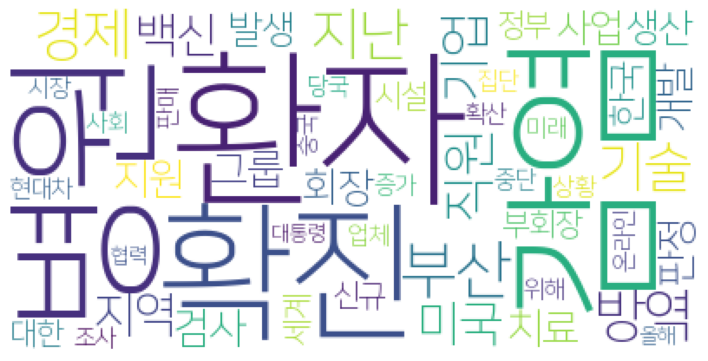

2020.10.13
['망치']
['포인트', '망치', '한국', '전망', '조정', '성장', '올해', '경제성장률', '세계', '경제', '상향']
['모빌리티', '부회장', '생산', '그룹', '현대차', '미래', '싱가포르', '혁신', '연구', '기공식', '고객', '서비스', '자동차', '중심', '실증']
['국회', '방문', '삼성', '출입', '의원', '전자']
['경제']
['선박']
['기업', '지원', '지역', '판로', '온라인', '입점', '중소기업', '제품', '쇼핑몰']
['뉴딜', '광주', '인공', '지능', '산업', '추진', '지역', '대통령', '한국판', '발표', '시민']
['확진', '선박', '선원', '지난', '부산', '입항', '승선', '판정']
['제복', '군사학', '신입생', '행사', '학과']
['트럼프', '유세', '플로리다', '경향신문', '대통령', '대선', '바이든', '부통령', '경합주', '선거', '방문']
['성장', '경우', '망치', '전망', '상향', '세계', '우리나라', '기록', '포인트', '경제', '당초', '개발도상국', '예상', '올해', '지난', '회복', '선진국']
['성장', '경제', '한국', '망치', '상향']
['전망', '회복', '망치', '노컷뉴스', '성장', '올해', '경제', '재정', '상향', '포인트', '정책']
['올해', '전망', '성장', '경제', '세계', '한국', '수준', '다만', '재정', '나라', '개선', '내년', '예상', '영향', '망치']
['성장', '상향', '조정', '전망', '조선']
['전망', '망치', '상향', '성장', '올해', '포인트', '세계', '선진국']
['성장', '전망', '포인트', '경제', '망치', '가운데', '재정', '상향', '회복', '세계', '개선', '선진국']
['한국', '망치', '

['화물', '이용', '사업', '회복', '증가', '항공', '감소', '실적', '수요', '시장']
['싱가포르', '그룹', '혁신', '현대차', '자동차', '모빌리티', '생산']
['지난', '증상', '발생', '확진', '판정', '전파', '진단']
['문화제', '수원화성', '시민']
['식물']
['대출', '은행', '수요', '증가', '자금', '역대', '이후', '지난', '기준', '규모', '기록', '가계', '최대', '확대', '기업', '발행']
['증가', '대출', '자금', '역대', '은행', '이후', '지난', '기준', '기록', '수요', '가계', '확대', '기업', '최대', '규모', '발행']
['직원', '홈플러스', '사업', '점포', '구점', '경제', '근무', '배치', '고려']
['면역', '도움', '푸드', '식단', '구성']
['유엔', '산림', '농업', '산림청', '식량', '세계', '분석']
['희망']
['이탈리아', '지원', '마자']
['부산']
['비정규직', '위원장', '대표', '노동', '노동법', '임금', '노조', '정규직']
['그룹', '회장', '경영', '지난', '현대차', '정의선', '부회장']
['시간', '수당', '해군', '지급', '지침', '변경', '근무', '의원', '경우', '최대', '시간외근무', '삭감']
['수당', '해군', '지급', '지침', '변경', '근무', '의원', '시간', '경우', '최대', '시간외근무', '삭감']
['시장', '판매량', '아이폰', '스마트폰', '출시', '포인트', '카운터']
['등록금', '대학', '학생', '지원', '대출', '수업', '상황', '의원', '이자', '장학재단']
['대출', '증가', '자금']
['방역', '두기', '사회', '단풍', '확인', '부본', '부장', '거리', '상황', '대책', '유행', '라며', 

['사망', '질환', '위험', '연구', '만성', '환자', '미국']
['기술', '부회장', '직원', '혁신', '사업', '화학', '활용', '개발', '과제', '본부']
['방역', '부본', '집단', '감염', '발생', '환자', '부장', '진단', '증상', '유행', '두기', '상황', '확진']
['트럼프', '대통령', '미국', '지도자', '폴리', '티코', '경향신문', '대사', '장관', '정상', '회의', '외교관', '관계']
['마약', '반입']
['마약', '반입']
['뉴딜', '지사', '대통령', '지역', '소속', '경제']
['백신', '존슨', '중단', '앤드', '시험', '이유']
['증상', '병원', '환자', '확인', '주치의', '트럼프', '대통령', '면역', '검사', '판정', '입원', '플로리다주', '백악관']
['한국', '장병']
['관광', '클룩', '대표', '한국', '공사', '업무', '협약', '에단']
['산업', '자동차', '부품']
[]
['증상', '감염', '사례', '면역', '확인', '집단']
['방역']
['세대', '트렌드', '교수', '브이', '워드', '소비', '주목', '믹스']
[]
['기업', '의원', '경제', '재계', '민주당', '경영', '상의', '선임', '정책', '입장', '상근', '대한', '부회장', '공정', '상법', '연구소', '회장', '참석', '공정거래법', '법안', '우려', '감사', '규제', '자리', '위원', '개정안', '입법', '관련']
['투자', '증권', '시대', '대선']
['정읍', '마을', '전달', '정읍시', '양지', '주민']
[]
[]
[]
['가족', '대전', '수련', '감염', '교회']
['증상', '세계', '감염', '사례', '이번', '네바다', '악화', '미국', '면역']
['안동', '바이럴', '한국', '관광', '

['산업', '지방산', '노후', '경제', '수도권', '단지']
['항공', '기업', '가운데', '기금', '기안', '제주항공', '신청', '지원', '지원이', '아이', '업계', '아시아나', '결정', '대한항공', '위기', '방침', '인수']
['병원', '친구', '추가', '가족', '모임', '지인', '감염', '관련', '경기', '의료', '기관', '전파', '집단', '발생', '사례', '대전', '누적', '증가']
['수산업', '광어', '시장']
['확진', '수업', '학생', '판정', '등교', '학교', '교직원', '발생']
['영화', '경남', '은행', '작품', '전시']
['경제', '세계', '인플레', '위기', '우리', '문제', '유동성', '부채', '라며']
['싱가포르', '그룹', '현대차', '혁신', '생산', '모빌리티', '고객', '기술', '검증', '미래', '동남아', '전기차', '시장', '역량']
['반려동물']
[]
[]
['기준', '대출', '증가', '자금', '이후', '주택', '가장', '규모', '금융', '은행', '기업', '수요', '담보', '영향', '추석', '역대']
['방역', '부본', '부장', '수도권', '행위', '국가']
['방역']
['아시아', '상담', '남방', '한국', '무역', '협회', '정책', '비즈니스', '상생', '위원회', '시장', '특별', '수출', '위기', '경제', '국가', '협력']
['전시']
['에어컨', '교체', '필터', '철도', '규정']
['인천', '확진']
['증상', '감염', '사례', '관련', '진단']
['사업', '기업', '기술', '시장', '카메라', '지원', '제품', '개발', '중소기업', '이오', '중진', '대표', '판매', '화상']
['쇼핑', '홈쇼핑', '그룹', '방송']
['접종', '예방접종', '대상자', '무료', '화

['아파트', '클라우드', '감일', '상업시설', '가구', '푸르지오', '마크베르', '분양', '지구']
['어려움', '직원', '아이', '소득', '위해', '지역', '가정']
['팬데믹']
['문화']
['혁신', '고객', '한국', '싱가포르', '그룹', '현대차', '자동차', '생산', '모빌리티', '연구', '중심', '미래']
['모빌리티', '카카오', '채용', '지원', '면접', '경력', '공개', '통해', '인재']
['마스크', '품목']
['특허', '조리', '출원', '국제', '식품']
['활동', '경찰', '치안', '범죄']
['바이어', '상담', '개사', '화상', '기업', '지역']
['교육재정', '전남', '부금', '교육청', '보통', '감소', '예산', '교육', '지방', '감액', '운용']
['회복', '달러', '투자', '기준', '도착']
[]
['접종', '경우', '예방', '백신', '긴급', '사용승인', '미국', '약사', '고문', '워프', '신청', '다국적', '감염', '면역', '바이오', '임상시험', '효과', '집단', '개발', '스피드', '슬라우', '프로젝트']
['예방', '접종', '의원', '무료', '독감']
[]
[]
['국어', '작년', '최고점', '모의', '학생', '출제', '수능', '표준점수', '영역', '비율', '평가', '가형', '수학', '입시', '시험', '과목', '격차', '하위', '평가원', '중위', '커트라인', '점수', '역시', '성적', '하락', '분석', '탐구', '경우']
[]
[]
['기관', '공공기관', '일자리', '한국', '아이디어', '공모전', '분야']
['격리', '자가', '지인', '생일']
['홍성', '홍성군', '오서산', '가을']
['집회', '신고', '금지', '예배', '사무', '총장', '차량', '대위', '자유', '시위']
['로또'

['대통령', '트럼프', '유세', '바이든', '후보', '미국', '대선', '연합뉴스']
['배송', '드론', '로봇', '주문', '서비스', '여수', '시간']
['사업', '북한', '남이섬', '관광', '운항', '자라섬', '가평군', '이용', '시범', '유람선', '추진']
['접종', '백신', '예방접종', '사람', '무료', '시민', '협회', '문제']
['일선', '소독', '방호복', '보건소', '사용', '의원', '성능', '기준', '현장', '차단', '자료', '검증', '레벨', '관리', '이송', '시험']
['관련', '감염', '경기', '대전', '모임']
[]
['중국', '칭다오', '방역', '확산', '당국']
['지명', '트럼프', '배럿', '청문회', '민주당', '공화당', '연방', '대법관', '인준', '대선', '비판', '상원', '케어', '오바마']
['백신', '중단', '개발', '시험']
['아산']
['전투']
['영화', '동물', '인간', '카라', '우리', '영화제', '동물권', '상영', '온라인', '올해', '위기', '통해']
['가구', '소득', '신청']
['모임', '인천', '주민', '화투', '확진', '판정', '접촉', '검사']
['패스트', '인터내셔널', '부품', '전기차', '공급', '베트남', '포스코']
['공기청정기', '올해', '시장', '미세먼지', '케어', '전자']
['법원', '자가', '격리', '지난']
['등급', '점수', '평가', '모의', '학생', '비중', '작년', '비교', '구분', '최고점', '수능', '수학', '성적', '난이도', '표준점수', '영어', '경우']
['대통령', '트럼프', '유세', '음성']
['백악관', '트럼프', '대통령', '판정']
['시나리오', '마스크', '착용', '사망자', '세계', '예측', '경우', '현재', '대조']
['거

['시장', '브라질', '셀트리온', '스케', '바이오', '확대', '정부', '수주', '입찰', '시마', '허쥬마']
['기아', '북한', '세계', '수준', '지수', '비율']
['눈썹', '마스크', '메이크업', '라카']
['직원', '부산', '인수', '이스타항공', '매각', '법정관리', '신청', '기업']
['경기도', '자율', '주행', '모빌리티', '기술', '판교', '서비스', '진행', '랠리', '배달', '행사']
['해외', '수도권', '발생', '두기', '지난', '집단', '가족', '전날', '지역', '이후', '감염', '대전', '유입', '신규', '기준', '모임', '누적', '가운데', '단계', '명대', '경기', '거리', '자릿수']
['관광지', '관광', '공원', '사업', '선정', '여행', '계층', '문체부', '취약', '이상']
['디즈니', '콘텐츠', '스트리밍', '넷플릭스', '서비스']
['음성', '트럼프', '유세', '파우치', '판정', '대해', '사용', '대선', '자신']
['학부모', '학교', '참여', '교육', '지원', '원탁', '토론회', '교육청', '교육활동', '진행', '울산']
['학부모', '학교', '참여', '교육', '지원', '원탁', '토론회', '울산', '교육청', '교육활동', '진행']
['사망자', '국장', '사망']
['일본', '의견', '응답']
['청소년', '학교', '지원']
['힐링', '상품']
['힐링', '상품']
['아스', '케미칼']
['개사', '수출', '기업', '사업', '지원']
[]
['마스크', '착용', '의무', '사람', '서울역', '버스', '대중교통', '가명', '시설', '위해']
['해외', '유입', '전날', '방역', '지역']
['출원', '특허', '국제']
['면역', '집단', '바이러스', '전략', '백신', '확산', '보호']
[

['한전', '현장', '직원', '숙소']
['공무원', '사용', '휴가', '근무', '자녀', '재해', '가족', '경우', '재난']
[]
['행동', '인간', '경제', '장기', '소비', '산업', '제약', '변화']
[]
[]
[]
[]
['가야', '백제', '부여', '사서', '학계', '일본서기', '토기', '회의', '유적', '사비', '발굴', '국제', '대형', '쌍북리', '소국', '건물', '도읍', '비도', '문화재', '대가야', '확인', '왕궁', '일본', '역사', '조사', '한반도', '신라', '기록']
['자녀', '사용', '근무', '휴가', '대체', '공무원', '휴무', '평일', '이상', '확대', '위해', '재난']
['학업', '자녀', '학부모']
['울산']
['치료', '아스', '항체', '미국', '감염']
['백신', '생산', '진행', '바이오', '개발', '사이언스', '기업', '긴급', '공급', '승인']
['마스크', '대통령', '언론', '도스', '백악관', '실장', '트럼프', '지난', '라며']
['제품', '브라질', '매트릭스', '키트', '정식', '허가', '미국', '긴급', '사용승인']
['브라질', '제품']
['치료', '아스', '항체']
[]
[]
[]
[]
[]
['작가']
['보드카', '칵테일', '주류', '홈플러스', '도수', '알코올']
['영업', '애슐리', '뷔페', '매장', '재개', '브랜드']
['관계자', '면세점', '공항', '입찰', '업체', '온라인', '매출', '시내', '비중', '경쟁', '상황', '업계', '면세']
['대회', '집회']
['대회', '집회']
['금액', '거래', '적발', '불법', '외국환']
['기록', '미국', '환자', '영국', '경제', '급증', '발표', '봉쇄', '조치', '체코']
['금액', '거래', '적발', '불법', '외국

['중고차', '경매', '매물', '올해', '롯데', '매장', '딜러', '확인', '낙찰', '스위치', '오토', '옥션', '시장', '온라인', '위해', '때문', '인기', '평균', '고객', '정보']
['행사', '상주시', '주최', '방역', '선교', '세계', '참석', '당국', '신도', '수원', '선교사', '강의']
['골프', '골퍼', '신장', '백화점', '매출', '웨어', '신세계', '의류']
['상반기', '검사', '부문', '금감원', '현장']
['관람', '대극장', '문화', '세종', '회관', '구매', '패스', '공연', '홈페이지', '통해', '티켓']
['구매', '문화', '세종', '회관', '패스', '공연', '관람', '대극장', '홈페이지', '통해', '티켓']
['구빈', '사회보장', '제도', '보험', '영국', '제정', '조세일보', '생존', '노동자', '사회', '산업', '정부']
['발표', '규모', '매입', '금리', '국채', '시장', '국고', '확대', '때문', '지난', '기준금리', '단순', '투자', '효과', '금통위', '증권', '가능성', '연구원']
['일본', '대해', '회장', '총리', '롯데', '총리와', '기업인', '아베', '지난', '한국', '가능성', '인사', '만남', '그룹', '재계']
['영화', '그룹', '한국', '미디어', '진행', '부회장', '이미경', '컬처', '평가', '음악', '적극', '이후', '지난해', '국제', '대중문화', '글로벌', '리포터', '엘리슨', '엔터테인먼트', '그녀', '지난', '슈나벨', '세계', '프로듀서', '투자', '아카데미', '지원', '이자', '조명', '할리우드', '기생충', '올해', '시작', '기업', '스카이', '드림웍스', '통해', '대해', '미국', '문화', '게펜', '이상', '매체', '산업', '케

['한우', '인삼', '홍천', '축제', '명품', '온라인', '행사']
['확진', '판정', '관련', '단계', '이중', '발생', '지역', '해외', '충남', '연휴', '친구', '수도권', '가족', '병원', '거주', '국내', '추석', '부산', '기록', '명의', '환자', '동네', '신규', '동두천', '지난', '누적', '명대', '다나', '유입', '광주', '감소', '전날', '어린이집', '대전', '접촉', '추가', '기준', '감염', '증가', '전일', '집단', '모임', '최근']
['과학기술', '인재', '개발', '교육', '미래', '인력', '정책', '온라인', '혁신', '대한', '수행', '통해', '기관', '사업', '확보', '소통', '정부', '양성', '국가', '디지털', '중앙', '교수']
['패스트', '부품', '포스코', '인터내셔널', '공급']
['존슨', '백신', '시험']
['존슨', '백신', '시험']
['전선', '아시아', '베트남']
['관련', '서울시', '확진', '병원', '발생', '지난', '환자', '모임', '영등포구', '병상']
['스토리', '유통', '위즈', '작가', '콘텐츠', '시장', '제작', '플랫폼', '창작', '스튜디오', '시스템', '기존', '육성', '확보', '사업', '기획', '위해', '글로벌', '투자', '지원', '계획', '웹툰', '진행', '작품', '그룹', '도입', '웹소설', '기반', '형태', '계약', '대표']
['유료', '결제', '금액', '넷플릭스']
['왕인', '박사', '유적지', '재개', '거리', '문화']
['수련', '경향신문']
['수련', '경향신문']
['재판']
['재개', '애슐리', '영업', '매장', '아이', '이랜드', '뷔페', '브랜드', '관리', '고객']
['상품권', '제로', '페이', '가맹', '모바일', '사용

['간편식', '출원', '특허', '가정', '조리', '경향신문']
['관련', '추가', '신규']
['지원', '사업', '관광', '업체', '경영', '행업']
['미국', '식료품', '지난', '업체', '증가']
['원금', '지급', '재난', '지자체', '경향신문']
['방역', '학교', '지원', '학생', '등교', '수업', '물품', '인력', '확대']
['지급', '근로자', '고용', '유지', '원금', '지원', '대상']
[]
['금융']
['분야', '의료', '창업', '산시', '경향신문', '바이오', '해커']
['부대', '판정']
['한국판', '발전', '회의', '적극', '구상', '협력', '추진', '균형발전', '국가', '지역', '정부', '대통령', '핵심', '더욱', '정책', '균형', '라며', '중심', '재정', '지자체', '도지사', '지원', '광역권', '위해', '혁신도시', '사업', '전략', '생활', '뉴딜', '변화', '미래', '프로젝트', '대한민국', '주민', '디지털', '밀착', '스마트', '그린', '일자리', '창의']
['기업', '물류', '미국', '통합', '법인', '기술']
['동맹', '한미', '미국', '대사', '발언', '선택', '미대', '국무부', '우리', '한국', '국정감사', '사관', '강조']
['영상', '기업은행', '홍보', '중소기업', '판로', '지원', '기업']
[]
[]
['사회']
['판매', '라인', '시장', '한국', '스포', '스마트폰', '제공', '어시스트', '기본', '최초', '추가', '드라이빙', '기능', '적용', '브랜드', '가솔린', '자리', '변경', '익스', '아방가르드', '모델', '벤츠', '클래스', '코리아', '마력', '수입', '더뉴', '디스플레이', '클루', '기술', '시스템', '직렬', '세계', '출력', '최고', '기반', 

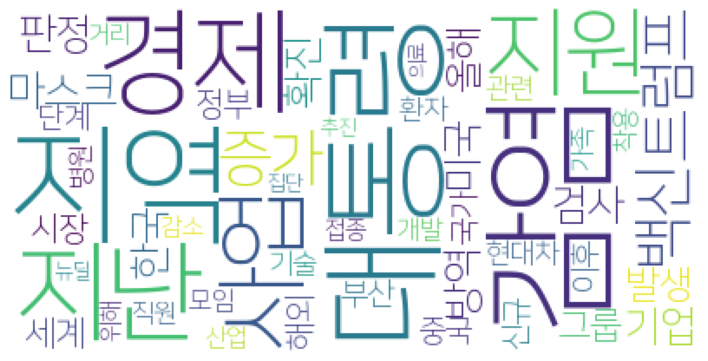

2020.10.12
['교육청', '원칙', '등교', '학교', '수업', '전북']
['평택']
['백신', '무료', '접종', '유료', '독감']
[]
['택시', '증가']
['택시', '증가']
['택시', '증가']
[]
['프랑스', '대통령']
['도올', '인민', '건설', '강압', '사람', '지금', '주진우', '문명', '인류', '가슴', '항상', '숭상', '유위', '누구', '자체', '동안', '하나', '테스', '논리', '대접', '우리', '때문', '자연', '해결', '세기', '걱정', '여기', '질문', '김용옥', '모든', '생각', '그거', '다시', '여백', '선생님', '구속', '메시지', '중국', '노자', '문제', '사실', '철학', '필요', '시대', '인간', '그냥', '가지', '계속', '대한', '오늘', '불교', '그게', '그것', '가장', '인생', '이야기', '무위', '반성', '사상', '사회', '대해', '공부']
['편의점', '홀딩스', '업계', '계약', '말레이시아', '리테일', '마이', '현지', '운영', '진출', '로컬', '브랜드', '시장', '사업', '기업']
['경향신문']
['운영', '거리', '시설', '사람', '제한', '일부', '다시']
['대관', '신천지', '당시', '행사', '장소', '대표', '보좌', '승인']
['여론조사', '정부', '지지율']
['방식']
['센터', '코리아']
['방역', '경향신문', '모임']
['중국']
['국씨', '자가', '격리', '영상', '보건소', '위반']
['활용', '노벨경제학상', '경매', '방식', '위원회', '주파수', '이론', '수상자', '라디오', '교수', '발명', '응찰', '면서', '노벨', '수상', '설명', '윌슨', '스웨덴', '미국', '발표', '노벨상', '올해', '가치']
['감자', '파리', '바게뜨

['글로벌', '제페토', '아바타', '빅히트', '투자', '통해']
['구글', '기업', '매출', '과세', '법인세', '소득', '청장', '외국', '국세청', '사업자', '신고', '한국', '가운데', '회피', '사업', '의원', '국내', '세수', '대한', '이상', '세금', '유튜버', '대해', '수수료', '지난해', '납부']
['일본', '회장', '롯데', '인사', '그룹', '총리', '아베', '경영', '한국']
['병원', '감염', '의정부시', '판정']
['광고', '활용', '지구', '재활용', '가치', '소비', '환경운동']
['드레서', '의류', '이용', '습관', '코스', '통해', '스팀', '선반', '생활', '제공', '에어', '내부', '기능', '놀이', '스마트폰', '정숙', '뽀로로', '정도', '역시', '제거', '전자', '확인', '케어', '표준', '방식', '걸이', '느낌', '삼성', '냄새', '드라이클리닝', '살균', '어린이', '관리', '도어']
['사회', '지난', '거리', '두기', '단계', '연장', '판정', '인원', '제한']
['회장', '일본', '총리', '한일', '양국', '관계', '참석', '롯데', '위해', '총리와', '재계', '이번', '아베', '역할', '경제', '기업인', '교류']
['소득', '가구', '긴급', '지원', '생계', '위기', '사업']
['감소', '기업', '가장', '자금', '경북']
['등교', '단계', '학교', '교육청', '부산']
['바이러스', '표면', '연구', '생존', '결과', '이번']
['강릉']
['인원', '연체', '학자금', '대출', '올해', '소득', '상환', '발생', '청년', '지난해', '취업', '시작']
['칭다오시', '모두', '무증상', '감염', '검사', '환자', '칭다오', '병원', '명의', '관련']
[

['협력', '공생', '건설', '반도', '화상회의', '상생', '공존', '현장']
['펀드', '소비재', '증권', '투자신탁', '주식', '자산운용']
['지원', '지방', '재택근무', '일본', '이주', '사람', '정부', '도쿄']
['방역', '농장', '차단', '도내', '돼지', '환자', '발생', '지난', '울타리', '멧돼지']
['뉴욕시', '방역']
['대비', '거래', '하나투어', '모두투어', '오른', '예상', '영업', '손실', '예정']
['대통령', '방역', '경제']
[]
[]
['노래', '에스트리', '음악', '그대', '김순남', '아이', '우리', '국민', '남성', '솔로']
['장학생', '재단', '종근당']
['분야', '아이', '업체', '파트너', '인수', '방과', '사업', '그동안', '에이', '미디어', '콘텐츠', '교육', '확보', '에듀', '업계', '기술', '엑스레이', '최근', '운영', '관계자', '솔루션', '소프트웨어', '디지털', '교실', '알텍', '미래엔']
['바이러스', '청장', '생존']
['군산', '대학']
['결과', '바이러스', '생존', '본부장', '표면', '실험', '사람', '피부', '연구']
['강릉', '오후', '지난', '판정', '접촉', '강릉시', '확진', '감염', '당국', '지역', '양성']
['이번', '소비자', '제품', '출시', '시장', '관계자', '가격', '전자', '대비', '초고', '하량', '올해', '프리미엄', '이상', '분기', '판매', '일반', '인치', '세계', '수요', '증가', '아이', '지난', '레드', '업계', '화면']
['전면', '교육청', '확대', '등교', '학교', '학년', '매일', '수업', '이하', '인원', '경우', '중학교', '수도권', '초등학교']
['가구', '태안군']
['치료', '증상', '

['국제', '연구소', '백신', '개발']
['가입자', '파트너', '티몬', '타임', '커머스', '증가', '고객', '역시', '회원']
['농업인', '행사', '횡성군']
[]
['위안화', '중국', '가치', '은행']
[]
['치료', '환자', '루미', '임상시험', '렘데', '시비르', '결과', '병용', '요법']
[]
['할인', '구조', '오전', '제도', '도로공사', '출퇴근', '통행료', '개편', '재무', '오후']
[]
['순천시', '신청', '임신부', '건강', '경제', '관리']
[]
['바이러스', '마스크', '구리', '개발', '섬유']
['사회', '기관', '부산', '용호', '어르신', '지역', '회의', '솔루션', '문제']
['단계', '방역']
[]
[]
[]
[]
['예방', '항체']
['예방', '항체']
['북한', '중국', '북중']
['대웅제약', '행사']
['연구', '결과']
['버스', '운행', '노선', '시내버스', '이용', '감축', '원주시', '회사', '운영', '호저', '증차', '운수', '탑승객', '시간']
['월세', '원룸', '경제', '다방']
['등교']
['발생', '환자', '중국', '감염', '무증상', '칭다오시', '명의', '검사']
['방역', '본부장', '감염', '환경', '시설', '거리', '두기', '단계', '여행']
['대출', '가계', '은행', '기업', '신용', '위험', '태도', '금융기관', '노컷뉴스']
['거리', '방역', '환경', '두기', '단계', '요인', '여행', '시설', '위험', '본부장']
['전시', '박물관', '조선', '피초혜', '시대', '유물', '전통', '패션', '특별']
['트럼프', '미국', '대통령', '치료', '신뢰', '과학자', '지적', '팬데믹', '대한', '정치', '백신', '결과', '승인']
['결과', '미국', 

['급여', '노동시장', '고용', '가입자', '보험', '감소', '증가', '사업', '동향', '지난달', '실업', '영향', '사태', '구직', '확산', '일자리', '작년', '동월', '올해', '지급', '정부', '각각']
['확진', '어린이집', '가족']
['표면', '생존', '코로나바이러스', '연구', '이번', '동안', '결과', '물체', '발표', '감염', '바이러스']
['가구', '소득', '감소', '복지', '지원', '신청', '긴급', '원금', '지급']
['성장']
['노컷뉴스']
['도시', '김해시', '개발', '사장', '공사']
['김해시', '개발', '사장', '도시', '공사']
['지급', '마을', '주민', '정읍', '양지', '정읍시', '지원']
['신규', '단계', '방역', '지역', '수도권']
[]
['기간', '관광', '사업', '체납', '연금', '업종', '보험료', '위기', '국민연금', '납부', '근로자', '수급', '개월']
['차주', '지수', '대출', '가계', '태도', '은행', '신용', '위험', '수요', '증가', '금융기관', '대한', '중소기업']
['사건', '내부', '부장', '수사', '검사', '옵티머스', '금융', '의혹', '부패', '로비', '검찰', '경험', '지난', '문건', '중앙', '상황', '확보', '파견']
[]
[]
['집회', '상황', '경찰', '당시', '법원', '신고']
['대출', '중소기업', '비중', '신용', '은행', '금융', '담보', '기술', '대상', '보증', '기업']
['원금', '청년']
['총리', '일본', '회장']
['책상', '수능', '가림', '설치', '부산', '시험']
['대출', '신용', '가계', '기업', '중심', '은행', '태도', '강화', '경기', '위험', '수요', '불확실', '전망', '역시']
['북한', '마

['방역', '신규', '발생', '해외', '유입']
['치료', '대웅제약', '사마', '이드', '진행', '투여', '대웅', '개발', '바이러스', '효과', '임상시험']
['트럼프', '대통령', '대선', '토론', '전염', '선거', '캠프']
['한국', '다수', '보도', '북한', '경제', '대통령', '남북관계', '옵티머스', '일보', '신문', '조선일보', '국감', '중앙', '정부', '미국', '언론']
['전기차', '리서치', '이차전지']
['국제', '권익위', '교수', '정의', '샌델', '회의', '부패', '참여']
['바닥', '청소', '로봇청소기', '제품', '브러시', '구역', '소음', '거나', '탑재', '메인', '센서', '모드', '전자', '최근', '장애물', '물걸레', '환경', '기능']
['제품', '효율', '살균']
['전날', '지역', '단계']
['증가', '캠핑', '상품', '판매량']
['임상시험', '투여', '대웅제약', '사마', '진행']
['트럼프', '백신', '대통령', '에릭']
['남북', '북한', '위원장', '청와대', '열병']
['실적', '화학', '영업', '이익', '잠정', '부문', '최대', '매출', '발표', '전지', '지난', '기준', '석유화학', '사상', '주주', '분할']
['발생', '신규', '해외', '유입']
['투여', '사마', '대웅제약', '이드', '임상시험', '진행', '확인', '효과', '치료', '대웅', '감염', '약물', '바이러스']
['치료', '투여', '대웅제약', '사마', '바이러스', '개발', '이드', '효과', '진행']
['사업', '체납', '연금', '업종', '보험료', '위기', '국민연금', '근로자', '납부', '행업', '수급', '관광', '기간', '개월']
['지난', '이후', '비문', '하루', '대선', '연합뉴스', '소녀'

['뉴질랜드', '캠페인', '관광', '영상']
['농산물', '언택트', '거창', '시대', '사업', '유통', '전략', '소비']
['유전자', '바이오', '진단', '제품']
['위험', '금지', '집합', '시설', '단계', '방역', '수도권', '행사', '인원', '경우', '거리', '판매', '제한', '두기', '감염', '아이', '다만', '이상', '운영', '의무', '모임']
['도서', '거래', '온라인']
['가족', '확진', '전시', '남성', '추석', '연휴']
['축산물', '판매']
['실적', '화학', '부문', '매출', '영업', '이익', '사업', '분기', '배터리', '기록', '자동차', '증권', '시장']
['관광']
['실적', '화학', '배터리', '부문', '사업', '영업', '이익', '분기']
['게임', '대상', '올해', '한국', '산업', '국내', '문화', '협회']
['항저우']
['광주', '경제', '발생']
['신청', '직지', '청년', '원금', '경우', '구직', '특별구', '지급', '취업', '대상', '접수']
['슈퍼맨', '트럼프', '자신', '지난']
['택배', '노조', '기사', '배송']
['항저우']
['생존', '바이러스', '표면', '연구', '결과', '온도']
['판정', '트럼프', '대통령', '부양책', '시간', '규모', '민주당', '현지', '협상', '의장', '로시']
['후쿠오카', '경제', '운항', '아시아나', '항공', '노선']
['가구', '지원', '대상', '소득']
['생존', '소상', '공인', '자금', '지원']
['사마', '바이러스', '인도', '치료', '개발', '활용', '그룹', '이드', '국내', '제로', '계획', '결과', '성분', '진행', '투여', '대상', '대웅제약', '효과', '시험', '대웅']
[]
['원장', '기념', '창건',

['트럼프', '대통령', '전염', '면역', '검사', '사람']
['연금', '공무원', '국민연금', '이전']
['학교', '매일', '조정', '등교', '교육청', '인원', '제한', '교육부', '수도권', '경우']
['트럼프', '대통령', '면역']
['마스크', '시설', '과태료', '부과', '착용', '종사', '두기', '거리', '단계', '실내']
['모임', '허용', '인원', '시설', '방역', '수도권', '제한', '두기', '면적', '운영', '행사', '이상', '실내', '금지', '거리', '단계']
['증가', '하루', '신규', '다시', '조치', '대한', '사망률']
['매점매석', '마스크']
['노컷뉴스', '트럼프', '대통령']
['자료', '기준', '제출', '소득', '가구', '지원', '감소', '신청', '대상']
['트레이닝', '사이클', '운동', '수업', '시장', '클래스', '온라인', '전문', '비대', '실시간']
['대통령', '트럼프', '면역', '주장', '유세', '트윗']
['트럼프', '대통령', '트윗', '면역', '트위터']
['트럼프', '대통령', '면역']
['시설', '입장', '금지', '비율', '허용', '완화', '경제', '두기', '조치', '관중', '제한', '정부', '방역', '거리', '단계', '수도권', '교수', '감염', '학교', '관리', '실내', '전국', '미만', '지침', '인원', '이상', '지역', '등교', '행사', '다만', '운영', '이번', '모임']
['대한항공', '항공', '백신', '화물', '수송', '운송', '업계', '아시아나']
['근무', '발생', '원전', '판정', '무자', '바라카', '양성', '현장', '한국인', '국민일보', '지난달', '검사', '지난', '외국인']
['화상회의', '교류', '행사', '사람', '경험', '인간', '우리',

['북한', '장관', '열병', '발사', '시험', '행사']
['조사', '인구', '가구']
['장애인', '박람회', '취업', '서울시', '온라인', '개최', '참여', '고용', '일자리', '시설', '행사', '기업', '지원', '구인']
['대웅제약']
['지역', '휴가', '장병', '외출', '통제']
['휴가', '장병', '외출', '지역', '통제']
['감염']
['북한', '위원장', '청와대', '열병', '남북']
['한화', '디지털', '경제', '강조', '회장', '위기']
['후각', '갑자기', '사람', '커피', '체크', '사용', '냄새', '감염', '우리', '재료', '환자', '연구', '의심', '마늘']
['등교', '학년', '초등학교', '매일', '중학교', '수업']
['월세', '원룸', '다방']
['추진', '상봉']
['중국', '검사']
['파우치', '소장', '트럼프', '대통령', '발언', '선거', '광고', '캠프', '대응', '경향신문', '인터뷰', '백악관']
['실적', '이익', '영업', '사업', '화학', '매출', '최대', '기록']
['수출', '반도체', '경제', '감소', '기록', '대비', '조업', '일수', '평균', '별로']
['국세청', '청장', '조사']
['시험', '병원']
['대출', '담보', '매년', '비중', '중소기업', '은행', '신용', '금융', '보증', '기업', '시중', '증가', '기준', '자금', '감소', '경제', '기술', '이후']
['상공', '지역']
['검사', '진단', '바이러스', '기술', '개발', '우드', '교수', '구진']
['협력', '통일부', '북한', '열병', '연설', '입장']
['바디', '안마', '의자', '매출', '브랜드', '대표', '랜드', '추석', '코지', '지난', '테크', '최근']
['경제']
['집회', '이상', '금지

['김해시', '사장']
['결과']
['그룹']
['시민', '복지', '정신건강', '부산', '마음', '캠페인', '진행', '센터', '홈페이지', '통해', '세계', '제공']
['경제', '실적', '적자', '재정', '대비']
['연구', '항체', '환자', '지속']
['중국', '연휴', '소비', '국경절', '지출']
['공연', '캣츠']
['셀트리온', '예방', '치료', '승인', '항체', '환자', '대상', '임상시험']
['셀트리온', '예방', '치료', '승인', '항체', '대상', '환자', '임상시험']
[]
[]
['임상시험', '식약처']
['수출', '온라인', '상담', '기업', '달러']
['한화', '그룹', '창립', '회장', '사업', '주년', '활동', '김승연', '비대', '기념', '행사', '진행', '사회', '위기', '직원', '포스트', '디지털']
['회장', '직원', '행사', '한화', '그룹', '창립', '사업', '주년', '활동', '김승연', '기념', '진행', '위기', '포스트', '비대', '디지털', '사회']
['예정', '참여', '정의', '교수', '세션', '샌델', '회의', '특별', '부패', '국제', '개최', '위원장']
['일본', '기업인', '오사카', '노선', '운항', '후쿠오카', '항공', '인천', '재개', '중단', '입국', '한국']
['셀트리온', '예방', '임상시험', '치료', '승인', '항체', '계획', '대상', '환자']
['사장', '김해시', '개발']
['토론', '면역', '트럼프', '주장', '유세', '지지자', '판정', '대통령', '백악관', '대선', '진행', '확진', '후보', '자신', '인터뷰']
[]
[]
['미성년', '계좌', '주식']
['검사', '진단', '항체', '키트']
[]
['영국']
['가구', '아이', '소득', '긴급']
['예방', '셀

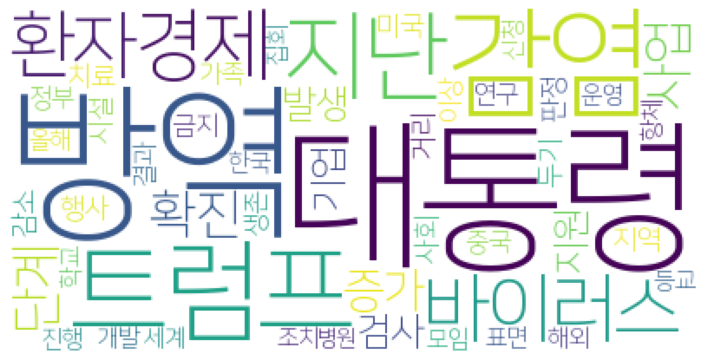

2020.10.11
['작곡가', '손석우', '공연', '콘서트', '보성']
['러시아']
['식품', '건강']
['국민', '집회', '산성', '원내대표', '정권', '사람', '비판', '재인', '경찰']
['집회', '국민', '산성', '원내대표', '정권', '사람', '비판', '재인', '경찰']
['의료']
[]
['캠핑', '쓰레기']
['음식점', '매출']
['조치', '카탈루냐']
[]
['슈퍼맨', '트럼프', '대통령', '지난', '바이든', '후보', '포인트', '퇴원', '지지율', '깜짝']
['부산']
['가족']
['가족']
['사용', '사람']
['노동자', '필수', '정부']
['노래', '클럽', '불법']
['단계', '이상', '시설', '위험', '거리', '두기', '인원']
['미국']
[]
['청주']
['재활용', '쓰레기', '재활용품', '배출']
['마스크']
['일본']
['이라크', '항만']
['수출', '온라인', '상담', '기업', '달러']
[]
['매출', '희망', '지원', '자금', '지급']
['경제', '이란', '사망자']
['운영', '승차', '기관', '도시철도', '무임', '손실', '경제', '규모', '교통']
['일본']
['입국', '검사']
[]
[]
['단계', '연휴', '감염']
['북한', '의원', '무기', '우리', '평화', '열병', '신형']
['평화', '북한', '위원장', '남북관계', '주목', '대해', '청와대', '복원', '한반도', '입장', '공개', '표현', '우리']
['북한', '위원장']
['사용', '사람']
['퇴원', '트럼프', '대통령', '슈퍼맨', '티셔츠', '백악관', '연설']
['김정은', '북한', '미국', '중국', '이번']
['등교', '수업', '인원', '학교', '제한', '운영', '교육부', '완화']
['대통령', '집회', '시위']
['입국', '판정', '

['시설', '위험', '비율', '거리', '감염', '관리', '수도권', '조치', '전국', '단계', '두기', '주간', '방역', '사회', '확산', '안정화', '정도', '상황', '정부', '체계', '의료', '대본', '감소', '생활', '수준', '고려', '유지', '추세', '최근', '차장']
['두기', '단계', '거리', '환자', '정부', '신규', '사회', '방역', '평균']
[]
['경제']
['경우', '시설', '수도권', '방역', '실내', '위험', '행사', '금지', '제한', '단계', '모임', '인원', '부과', '의무', '이상', '감염', '집합', '대본']
['조선', '인원']
['북한', '청와대', '남북', '열병', '대통령', '부산']
['북한', '위원장', '김정은', '메시지']
['북한', '위원장', '김정은', '메시지']
['가족', '검사', '당국', '결과']
['가족', '검사', '대전', '당국', '결과']
['대통령', '트럼프', '슈퍼맨', '백악관', '지난', '티셔츠', '자신']
['시설', '발생', '집합', '방역', '감염']
['강원', '채취', '돼지', '농장', '양돈', '아프리카', '열병', '시료', '마리', '발생', '방역', '처분', '부산', '정밀검사', '중수']
['가족']
['등교', '학교', '교육부', '부산', '인원', '밀집', '적용']
['부산']
[]
['재개', '관람', '국립', '고궁', '박물관', '기관', '제한', '인원', '예정', '전시', '왕실']
['수출', '기업', '중국', '대미', '수입', '무역', '합의', '이행', '미국', '대비', '올해']
['클럽', '경찰']
['바이든', '포인트', '차로', '후보', '트럼프', '대통령', '유권자', '지지율', '경제', '격차']
['수도권', '단계', '인원', '등교', '제

['마스크', '면서', '추석', '여행', '제주', '연휴', '김포공항', '사람', '한글날', '제주도']
[]
['미국', '북한', '위원장', '대통령', '협상', '대선', '신형', '전쟁', '메시지', '트럼프', '제재']
['쇠부리', '울산', '축제', '실험', '온라인', '복원', '올해', '통해']
['사업', '조직', '서비스', '세대', '분과', '주니어', '보드', '출시', '직속', '통신', '대표', '디지털']
['부산']
['방안', '등교', '학교', '부총리', '교육부', '방식', '전면', '교육청', '밀집', '학년', '수업', '완화', '지역', '도입', '학사', '자율', '방역', '운영']
['추석', '연휴', '감소']
['시설', '두기', '대본', '차장', '이하', '경우', '단계', '방역', '거리', '감염', '수도권', '위험', '다만', '실내', '집합', '대해', '행사', '금지', '판매', '위반', '경제', '수준']
['북한']
['부산', '관중', '입장', '축구', '무관', '허용', '시작', '리그', '오후', '경기', '수용', '협회']
['판정', '노선', '운항', '중국', '승객', '해당', '동방항공', '인천', '상하이', '민항국', '중단']
['벽화', '고구려', '박물관', '쌍영총', '무덤', '고분', '조각', '수습', '조사']
['건설', '시위', '집회', '노조', '현장', '정부']
['교회', '보석', '재판', '목사', '구속', '방해', '집회', '전광훈', '사랑', '경찰', '청구', '방역']
['정책', '세미나', '위기', '간담', '의원', '토론회', '민주당', '포스트', '국민', '주최', '관련', '집행', '진행', '개발', '국회의원', '시대', '교육', '미디어오늘', '감염병', '방안']
['포스트', '개

['화재', '울산', '건물', '지원', '호텔', '산시', '감식', '확인', '발화', '지점', '주민']
['거리', '방역', '경우', '부과', '과태료', '단계', '의무', '두기', '핵심', '인원', '행사', '제한', '마스크', '시설', '위반', '사회', '금지', '음식점', '적용', '감염', '카페', '운영', '유지', '이상', '이용', '수도권', '다만', '실내', '착용']
['완화', '인원', '운영', '학교', '등교', '거리', '두기', '수도권', '지역', '교육부', '단계', '조정', '제한', '방역']
['하이닉스', '사장', '우리']
['대통령', '원내대표', '국민', '재인', '산성', '문재인', '정권', '집회']
['재판', '때문', '부회장', '경영', '시작', '삼성', '전자', '공판', '법정', '관련']
['국민', '집회', '원내대표', '대통령']
['학교', '등교']
['금지', '허용', '시설', '방역', '집합', '단계', '완화', '제한', '행사', '인원', '운영', '실내', '확산', '판매', '의무', '유지']
['운영', '등교', '학교', '교육부', '인원', '제한', '수도권', '거리', '두기', '확대', '조정', '완화', '밀집', '지역']
['방역', '단계', '시설', '위험', '수도권', '금지', '실내', '대해', '감염', '판매', '행사', '다만', '경우', '위반', '경제', '집합']
['실적', '전망', '이익', '영업', '기업', '예상', '개선', '증권', '지난해', '시즌', '발표', '국내', '올해', '증가', '어닝', '치가', '기간']
['응답', '지지율', '트럼프', '대통령', '바이든', '후보', '포인트', '유권자', '여론조사']
['남북관계', '위원장']
['축산물', '학교', '급식', '판매',

['한수원', '업체', '원전', '수출', '국내', '중소', '지난해', '해외', '기술']
[]
['거리', '상황', '단계', '감염', '두기', '방역', '수도권', '대본', '감소', '시설', '역시', '고려']
['감소', '유지', '단계', '방역', '거리', '두기', '사회', '환자', '정부', '감염', '추석']
['전국', '수시', '조사', '대학', '개교', '경쟁률', '년도', '경북', '각각', '지방', '모집', '미만', '가장', '이번']
['소득', '상황', '기관', '때문', '제도', '청장', '자료', '조사', '통계', '작성', '관련', '발표', '파악', '의성', '데이터', '통계청', '비대', '가구', '이용', '확산', '기존', '개선', '설명', '정확성', '업체', '참여', '부처', '인구', '실시', '고용', '개발', '주택', '거래', '예산', '위해', '공개', '국가', '사회', '육아휴직', '항목', '온라인', '개월', '정책', '조사원', '경우', '행정', '추가', '조정']
['귀어', '어촌', '전남', '엑스포', '시민', '귀촌', '희망', '이번', '스몰', '경제']
['이탈리아']
['시장', '브랜드', '상인', '이마트', '인천', '상생', '스토어', '휴업', '일요일', '시작', '점포', '전통', '입점']
['노래', '클럽', '영업', '경찰', '경향신문', '베트남', '여성', '몰래']
['화상', '대표', '관광', '한국', '홍보', '박람회', '업체', '회의', '방한', '해외', '참여', '진행', '상품', '온라인', '상담', '국내']
['가구', '지원', '신청', '소득', '경제', '긴급', '위기', '고용']
[]
['경제']
['종전', '선언', '북한', '위원장']
['외교부', '북한', '경제', '선언', '

['거리', '두기', '방역', '경제', '사회', '단계', '정부', '총리', '국민']
[]
['택배', '노조', '노동자', '배송']
['청와대', '북한', '남북', '입장']
['경제', '회의', '장관', '국제', '재무', '소득', '채무', '상환', '유예', '금융', '참석', '연장', '예정', '세션', '논의', '액션', '플랜']
[]
[]
[]
[]
[]
[]
['문학산', '인천', '정상', '시민', '개방', '확대', '경제']
['수송', '항공', '백신', '대한항공', '화물', '운송', '업계', '아시아나']
['종전', '의원', '선언', '위원장']
['공연', '온라인', '무대', '관객', '화면', '이번', '우리', '멤버', '방탄소년단', '노래', '한겨레', '지난', '전세계']
['트럼프', '지지율', '차로', '조사', '후보', '대통령', '바이든', '포인트', '유권자', '격차']
['방역', '제주', '관광', '제주도', '해변']
['바이든', '대통령', '트럼프', '후보', '지지율', '지난달', '격차', '선거인단']
['거리', '두기', '단계', '방역', '총리', '조치']
['방역', '거리', '두기', '단계']
['방역', '단계', '위험']
['거리', '두기', '방역', '사회', '단계', '총리', '정부', '국민']
['방역', '거리', '두기', '사회', '단계']
['북한', '청와대', '열병', '상임', '위원장', '김정은', '국무위원', '노동당', '남북관계', '대해', '주년', '내용', '위원', '분석', '창건']
['통일부']
['마스크', '공적', '재고', '유통', '업체', '정부']
['대통령', '트럼프', '발표', '백악관', '주치의', '사람', '지적', '성명', '바이러스', '판정', '음성', '전염', '검사']
['지원', '대상', '가

['제주', '방역', '가을', '국립공원', '탐방', '전국', '관광지', '연휴', '단풍', '관광객', '거리']
['특고', '고용부', '소득', '청년', '원금', '긴급', '신청', '프리랜서', '지원', '예산', '지급', '신규', '구직', '요건']
[]
[]
[]
['경주', '통해', '온라인', '아송페', '아시아', '네이버']
['통해', '아송페', '경주', '온라인', '아시아', '네이버']
[]
['회의']
[]
[]
[]
[]
[]
[]
['병원', '감염']
['병원', '감염']
['온라인', '진료', '허용', '일본', '전면', '초진', '경제', '대해']
['장관', '회의', '재무', '국제', '금융']
['관광', '온라인', '박람회']
[]
['해외', '페이지', '한국', '콘텐츠', '방송', '빈국', '세계', '행사', '마련', '영상', '국내', '기업', '프로그램', '참여', '온라인', '콘퍼런스', '우리', '소개']
['사용', '살균', '포비돈요오드', '소독', '효과']
['판매', '표시', '통신', '단속', '원산지', '위반']
['회장', '한국', '채용', '설명', '투자', '증권', '통해', '온라인', '학생']
['제주도', '여행', '연휴', '사람', '김포공항', '추석', '마스크', '면서']
['종사', '지난', '환자', '가족', '지인', '모임', '추가', '확진', '발생', '누적', '지표', '포함']
['수입', '브랜드', '판매', '전망', '올해', '시장', '판매량', '흥행', '기록', '요인', '업계']
['영화', '헬렌', '생각', '여성', '처음', '도움', '호주', '감독', '어머니', '때문', '음악', '노래', '개봉', '그때', '우먼', '얘기', '시민', '우린', '매우', '미국', '사람', '작품', '아이']
['거주', '접촉'

['가을', '정원', '주제', '식물원', '연합뉴스']
['북한', '미사일', '미국', '열병', '트윗', '연구원']
['부대', '간부', '검사', '국방부', '병사']
['국내', '관리', '기업', '바이', '보어', '투자', '자산', '상품', '금융투자', '서비스', '이용', '경우', '고객', '수익률', '경제', '펀드', '은행', '수익', '산업', '개인', '저가', '운용', '수준', '주식', '공격', '금융', '직접', '시장', '중심']
['다른', '인건비', '가보', '상비', '공무원', '초과근무', '수당', '삭감', '올해', '채용', '추가', '투입', '금액', '임기', '부처', '운영', '충당']
['임금', '도이체벨레', '파업', '독일', '인상', '예산', '방송', '세계', '미디어오늘']
['도이체벨레', '임금', '파업', '독일', '인상', '예산', '미디어오늘', '세계', '방송']
['의원', '자격정지', '징계', '세종시', '당원', '의장']
['대통령', '경향신문', '트럼프', '검사', '주치의']
['관광객', '제주', '한글날', '연휴', '지난', '방역']
['국민', '김정은', '우리']
['경쟁', '상승', '전망', '유통업', '매출', '경기', '상의', '편의점', '지난', '업체', '대응', '지원', '망치', '업태', '소비', '연말', '대감']
['사람', '공간', '건물', '대표', '개념']
['일자리', '사업', '지역']
['생명보험', '상품', '보험', '미국', '증가', '성장', '대비', '가입']
['노동', '위기', '상황', '지난', '아시아', '부모', '착취', '아이', '학교', '교육', '세계', '이후', '아동', '가능성', '거리', '온라인', '이상', '세이브더칠드런', '일자리', '가정', '봉쇄', '지역', '폐쇄

['대통령']
['브리', '삼성', '시장', '개발', '최근', '분야', '솔루션', '협업', '기업', '서비스', '구축', '메신저', '글로벌', '자동화', '업체', '지원', '업무', '넥스', '업계', '디지털', '상용']
['기업', '제재', '중국', '수입', '대미', '미국', '합의', '화웨이', '무역', '단계', '올해', '대비', '상무부', '확대', '감소', '수출', '목표']
['환자', '미국', '신규']
['재발', '농가', '연기', '돼지', '판문점', '부대', '견학', '발생', '재개', '양돈', '감염', '당국', '경기도', '외부', '강원도', '프로그램', '집단', '육군', '파주', '파주시']
['밍크', '감염', '농장', '지난']
['김정은', '열병', '교수', '북한', '행사']
['거창', '사건', '공간', '역사교육', '국군', '학살', '설치']
['강원']
['강원']
['전주']
['세계', '무예', '국제', '컨벤션', '스포츠']
['신규', '명의', '지역', '환자', '발생', '지난', '확진', '접촉', '해외', '감염', '거주', '가족', '기준', '기록', '전날', '경로', '울산']
['유럽', '신규', '기록', '가장', '프랑스']
['트럼프', '대통령', '연설', '백악관']
['교황']
['우편', '투표', '사기', '선거', '소송']
['투표', '선거', '사기', '우편', '소송']
['위기', '가구', '소득', '신청', '지원']
['가구', '소득', '신청', '지원', '위기']
['수출', '기업', '외투', '달러', '한국', '재편', '코트라', '지난해']
['지역', '전날', '발생']
['전날', '지역', '신규', '감염', '유입', '관련', '부산', '수도권', '판정', '가운데', '누적', '경기']
['초등', '충북', 

['후기', '경제', '기술', '가짜', '배달']
['경찰', '단속', '지점', '노컷뉴스']
['고속도로', '보행자', '사고', '단속', '지점']
['비만', '캠프', '학생']
['어촌', '전남', '귀어', '엑스포', '시민', '희망', '이번']
['경북', '선수', '전국체전', '활약', '차지', '매일신문']
['영국', '전날', '유럽', '기록', '러시아', '프랑스', '확진']
['귀촌', '스몰', '귀어', '전남', '어촌', '엑스포', '시민', '희망', '이번', '전남도']
['웬수', '원수', '풀이', '사투리', '사전', '할배']
['밍크', '감염']
['밍크', '농장', '감염']
['북한', '미국', '열병', '연구원', '도발', '과시', '미사일', '트윗']
['지원', '가구', '생계', '소득', '대상', '긴급', '경제', '신청']
['트럼프', '대통령', '행사']
['등교', '교육부', '학교', '방안', '수업', '확대', '거리', '두기', '단계', '이내', '기준', '방침', '발표']
['영국']
['가격', '아파트', '중위', '승률', '매매', '저가', '기록', '강북', '지역', '거래']
['연설', '트럼프', '대통령', '백악관', '흑인', '행사', '바이든', '집회']
['보우', '누적', '브라질', '사망자', '나루', '대통령']
['가구', '신청', '지원', '소득', '생계', '대상', '긴급']
['청중', '트럼프', '대통령', '티셔츠', '백악관', '행사', '슈퍼맨']
['트럼프', '연설', '대통령', '백악관', '유세', '평가', '바이러스']
['제도', '문병원', '인력', '감염병', '대응', '지방정부', '역량', '위해', '강화', '경기도', '체계', '거버넌스', '개선', '중앙정부', '관리', '방안']
['신형', '북한', '미국',

['렘데', '지난', '환자', '바이러스', '항체', '면역', '개발', '미국', '임상시험', '제로', '다국적', '최근', '트럼프', '효과', '치료', '중이', '혈장', '메타', '시비르', '약사', '반응', '사용', '성분', '승인', '염증', '대통령']
['행사', '백악관', '트럼프', '대통령', '연설', '바이든', '흑인', '집회', '통신']
['전자', '컨센서스', '대비', '추정', '영업', '동기', '실적', '전환', '기업', '지난해', '이익', '기록', '크게', '업종', '여파', '비교', '분기', '적자', '증가', '분석', '개선']
['지역', '전시', '작가', '시민', '작품']
['신규', '환자', '지역', '경제', '미국']
['프랑스']
['북한', '미국', '신형', '무기']
['새벽', '원장', '열병', '신형', '진행', '무기', '공개', '북한', '부위', '수도', '김일성', '중앙', '모습', '기존', '광장', '평양']
['뱅크', '의원', '은행', '금리', '금융', '서비스', '비대', '대출', '소외', '이용', '상품', '인터넷', '고령자', '대면', '신용', '고령', '시중', '혜택']
['북한', '열병', '신형', '김정은']
['프랑스', '이상', '경계']
['북한', '미국', '열병', '도발', '과시', '미사일', '트윗', '연구원']
['북한', '미국', '열병', '도발', '과시', '미사일', '트윗', '연구원']
['수소차', '충전', '수소', '보급', '경우', '상황', '운영', '정부', '인프라', '발생', '소의', '고장', '소가', '산업부']
['트래픽', '가입자', '평균', '전체', '데이터', '이통']
['준비', '주요', '금융위', '국회', '관련', '금융', '국감', '대한', '뉴딜', '인원', '계획

['마스크', '공급', '공적', '보건']
['표시', '위반', '원산지']
['신청', '대구시', '지급', '소상', '공인', '방문', '지원', '상공', '접수', '제외', '생존', '대상', '점포', '온라인', '현재', '자금', '피해', '업종', '사업', '공고']
['경제', '감염']
['트럼프', '대통령', '백악관', '행사', '연설', '시작']
['중국', '미국', '대미', '수입', '무역', '합의', '기업', '화웨이', '목표', '단계', '확대', '제재', '갈등']
['경제', '신규', '감염']
['의원', '의혹', '윤리', '징계', '심판원', '방역', '허위', '세종시', '투기']
['북한', '열병', '미국', '신형', '공개']
[]
['사항', '안전', '시설', '광주', '진단', '점검']
['부대', '검사']
['가구', '신청', '소득', '지급', '지원']
['호텔', '주민', '산시', '화재', '거처', '지원', '세금']
['축산물', '학교', '급식', '판매']
['신규', '감염']
['역량', '서울시', '디지털', '스마트폰', '교육', '어르신', '보급', '스마트']
['시민', '핑크', '응원', '캠페인', '서울시', '영상', '대한', '홍보', '대사', '메시지', '방역', '라이트', '상어', '아기']
['동두천시']
['스마트폰', '체험', '사회', '디지털', '교육', '어르신', '역량', '보급', '개발', '배움터', '스마트', '실태', '격차', '계층', '취약', '조사', '오스', '시민', '활용', '서울시', '맞춤', '이용']
[]
['교육', '역량', '개발', '디지털', '서울시', '어르신', '보급', '스마트폰', '시민']
['어르신', '스마트', '개발', '디지털', '교육', '역량', '스마트폰', '사회', '맞춤', '시민', '로봇

['미국', '신규', '환자']
[]
[]
[]
['농촌']
['사용', '살균', '포비돈요오드', '소독', '효과']
['보고']
['개인', '주주', '소액', '올해', '기준', '연말', '주식', '시장', '작년']
['수출', '부문', '선정']
['두기', '거리', '신규', '자릿수', '사회', '단계', '감염', '정부']
[]
['여사', '열병', '공개', '북한', '주년', '올해', '행사', '부부', '위원장']
['차별', '차별금지법']
['외투', '수출', '기업', '달러']
['정치', '누구', '심상정', '정의당', '대표', '성공']
['관광', '박람회', '온라인', '한국', '이후']
['트럼프', '대통령', '행사']
['화재', '시장', '화학', '배터리', '전기차', '중국', '업체', '한국', '점유', '최근', '업계', '세계', '사태', '안전성', '원인']
['신규']
['트럼프', '연설', '미국', '대통령']
['수출', '기업', '외투']
['분석', '신형', '북한', '공개', '열병', '미국', '미사일', '전문가', '대선', '위원장', '무기', '발사']
['당첨', '이벤트', '오로나', '인증', '이번', '응모', '소비자']
['가구', '지원', '신청', '소득', '긴급', '위기', '고용']
['학교', '청소년', '증가', '지난해', '폭력']
['평균', '회원', '임금', '한국', '증가', '지난해', '개국', '경제']
['밍크', '감염', '농장', '사례', '지난']
['발사', '강조', '북한', '열병', '신형', '무기']
['사업', '월영교', '월영', '공원', '영락교']
['김정은', '북한', '의원']
['신규', '미국', '영국', '환자', '지역', '가장', '영업', '술집', '지난', '기록', '최고', '현지', '시간', '하루', '프랑스'

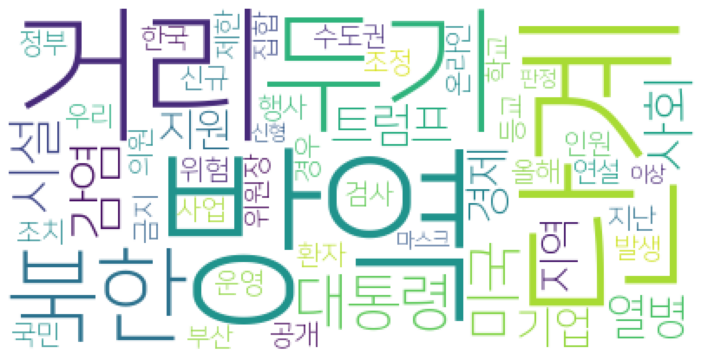

2020.10.10
['방역', '병원']
['방역', '병원']
['클린', '강원', '패스포트']
[]
[]
[]
[]
['방역', '산행', '마스크', '가을', '당국', '등산']
['면서', '진짜', '공연', '여러분', '저희', '아미', '무대', '우리', '콘서트', '온라인', '준비']
['부대']
[]
['연휴', '방역']
['북한']
[]
['신형', '북한', '화성', '열병', '공개', '위원장', '억제', '발사', '연설']
['판정', '확진']
['열병', '김정은', '북한', '인민', '실시', '김일성', '조선', '행사', '우리', '지난', '마음', '새벽', '김여정', '광장', '연설', '진행']
[]
['가구', '소득']
[]
[]
['가구', '소득']
['택배', '김씨', '기사', '노동자', '추석', '아버지', '어제', '대리점', '분류', '김모', '작업', '사고', '인력', '물량']
['어르신', '강의', '문화']
[]
['부동산', '아파트', '내부', '안내']
['대학', '공유', '강의', '온라인', '교류', '플랫폼']
['온누리상품권', '판매', '경제', '할인', '올해']
[]
[]
[]
['자기', '세상', '국가', '군대', '복구', '사람', '노력', '바로', '모든', '장병', '투쟁', '승리', '진정', '우리', '인민', '사회주의', '간고', '방역', '고생', '누구', '전체', '창건', '지금', '마음', '경축', '무엇', '영광', '동지', '기쁨', '나라', '가장', '군사력', '시련', '수호', '명절', '믿음', '위협', '전쟁', '도전', '발전', '모두', '감사', '정말', '가지', '안전', '오늘', '혁명', '열병', '인사', '억제', '세력']
['주민', '화재', '재민', '피해']
['동두천시']
['전문가', '매우', '블루', 

['부산']
['화재', '경제']
['대통령', '트럼프', '백악관', '행사']
['블로그', '남편', '아빠', '김준', '가족', '직장', '사랑', '시작', '작가', '시간', '아내', '생각', '아침', '육아휴직', '아이', '결혼', '낯선', '이제', '생활', '자기', '정말', '유럽', '수업', '당신', '동안', '대한', '폴란드']
['방역', '거리', '두기', '발생', '감염', '당국', '연합뉴스']
['방역', '거리', '두기', '발생', '감염', '당국', '연합뉴스']
['프랑스']
['하루']
['세계', '기아']
['오전', '오후', '국정감사', '국회', '종로구', '집회', '경찰', '여의도', '광화문', '단체', '외교부', '강행', '관계자', '대표', '보수', '위원회']
['울산']
['손님', '백화점', '매장', '명동', '사람', '대기', '거리', '방역', '두기', '추석', '위험', '발생', '연휴']
['하루']
['부사관', '학생', '응급의료', '의무', '합격']
['쿼드', '유지', '자기', '일본', '태평양', '세계', '아시아', '중국', '하나', '관계', '전략', '미국', '회담', '일본인', '오바마', '외무', '한국', '호주', '공개', '트럼프', '체제', '견제', '채택', '때문', '질서', '장관', '인도', '자국', '공동', '사실']
['환자', '프랑스', '하루', '신규', '검사']
['접촉', '검사', '전남', '연휴', '이데일리', '추석', '부부']
['방역', '병원']
['방역', '매출', '체계', '경제', '자영', '업자']
['연휴', '방역']
['멧돼지', '농가', '돼지', '방역', '발생', '양돈', '감염', '연합뉴스']
['영상', '존스', '취직']
['부대']
['연합', '가정', '세계', '총재']
['블루'

[]
[]
['보안', '탑승', '광주', '항공기', '공항', '신분증']
['집단체조', '북한', '공연']
['발생', '상황', '방역', '거리', '두기', '부본', '부장']
['간호조무사', '경제', '환자']
['예술제', '공연', '후원', '국제', '네이버', '영상', '무용']
['대통령', '백악관', '행사', '트럼프']
['관련', '추가', '누적', '사례', '병원', '확진']
['누적', '관련', '추가', '사례', '병원', '확진']
['투명', '대상', '조리', '마스크', '위생', '음식점', '지원', '착용', '서귀포시', '식중독', '예방']
['환자', '보건', '감염', '간호조무사', '확진', '당국', '부산', '가족', '파악', '확인', '경로', '검사', '주사']
[]
['날씨', '공원', '가을', '관광지', '인삼', '확산', '오후', '정취', '관광객', '거리', '인파', '위해', '등산']
['장관', '선거', '지역', '사무', '사실', '본부장', '라운드', '후보', '총장', '세계', '회원', '최종', '아프리카', '여성']
['감염', '부분', '수가', '정도', '유지', '때문', '지금', '환자', '이기', '사실', '대규모', '생각', '상황', '방역', '사람', '이번', '말씀', '신규', '가끔', '병원', '주말', '일어나고', '조정', '단계', '문제', '앵커', '두기', '독감', '연휴', '거의', '대해', '안정', '계속', '집단', '지역', '순영', '추석', '효과', '거리', '보이', '구체', '우리', '진단', '검사', '수도권', '지침', '자체', '사회', '발생', '물량', '가지', '증상', '성률', '국민', '시기', '호흡기', '백신', '아마', '여러', '유료', '실제', '이하', '상온']
['상황', '방역'

['정보', '위해', '디지털', '경제', '중국', '발전', '성장', '기술', '산업', '데이터', '혁신', '발표', '위안', '소비', '아날로그', '라이브', '사태', '비즈니스', '방식']
['중국', '디지털', '발표', '위안', '비즈니스', '경제', '발전', '성장', '기술', '위해', '산업', '정보', '소비', '사태', '혁신', '아날로그', '데이터', '방식', '라이브']
['센터', '수용', '치료', '생활', '수원']
['폼므', '전분', '간식', '감자', '요리', '고속도로', '버터', '주식', '구이', '휴게소', '자재', '치즈', '우리', '노릇', '가루', '요리사', '음식', '점질', '뢰스', '세계']
['감염']
['수업', '교사', '온라인', '학생', '욕설', '침해', '교권', '얼굴', '사진']
['인사', '대통령', '공동']
['보도', '방역', '한국', '사람', '반응', '영상', '추적', '통해', '언론', '손해배상']
[]
[]
['생각', '아미', '공연', '저희', '여러분', '콘서트', '온라인', '방탄소년단', '멤버', '준비', '행진', '우리', '다이너마이트', '사실', '사람']
['감악산', '야간', '폭포']
['주민', '억제', '김정은', '국무위원', '전쟁', '북한', '자신']
['세종대', '면접', '프로그램', '공기업', '대학', '학생', '직무', '채용', '대비', '특강']
['부사관', '학생', '합격']
['북한', '우리', '한국', '방역', '열병']
[]
[]
['신형', '북한', '열병', '공개', '미국']
['행사', '북한', '열병', '축제', '새벽', '분위기']
['미국', '우리', '열병', '북한', '강화', '겨냥', '발사']
['우리', '김정은', '북한', '열병', '강조', '억제', '노동당', '미

['리솜', '리조트', '포레스트', '객실', '호텔', '호반', '건설', '국내', '드라마', '힐링', '스파', '제천']
['그린', '뉴딜', '구리', '사람', '중심', '경제']
['수도권', '전날', '지역', '감염', '발생', '누적', '신규', '유입', '가족', '기준', '모임', '해외', '사례', '지인']
['신규', '세계', '전날', '발생']
['세계']
['대비', '가전', '영업', '매출', '부문', '실적', '이익', '개선', '경제', '영향', '기록', '재고', '연구원', '관리']
['엄마', '버피', '아들', '기네스']
['치료', '항체']
['감염', '가족', '추석', '전날', '검사', '지역', '누적', '연휴', '수도권', '환자', '단계', '유입', '신규', '발생', '모임', '방역', '지인', '기준', '사례', '해외']
['인천', '제주항공', '여행', '비행']
['대통령', '미국', '선거', '상태', '트럼프', '토론', '치료', '확진', '유세', '입원', '판정', '의료']
['토론', '후보', '대선', '노컷뉴스', '예정', '트럼프', '위원회', '진행']
['발생', '신규', '기록']
['연휴', '사람', '방역', '연합뉴스']
['신규', '경향신문']
['부대']
['토론', '바이든', '트럼프', '대통령', '위원회', '캠프', '대선', '취소', '최종']
['신규', '해외', '발생', '지역']
['부대']
['해외']
[]
['단풍', '국립공원', '탐방', '연합뉴스']
['브로드웨이']
['일본']
['위해', '마스크', '핸드']
['독감', '백신', '유행', '접종', '연합뉴스']
[]
['대회', '김세영', '여자', '메이저', '챔피언십', '공동']
['환자', '신규', '경제', '국내']
[]
['지난달', '확진', '발생', '지역', 

[]
['저승']
[]
['항체', '치료']
['항체', '치료']
['항체', '치료']
['토론', '트럼프', '화상', '대통령', '캠프', '바이든']
['수수료', '이자', '이용', '금액', '서비스', '방법', '결제', '리볼빙', '때문', '할부', '연체', '이월', '대금', '나머지', '납부', '카드', '롯데', '비율', '가족', '다음', '일부', '설정', '시불', '연기', '분할']
[]
[]
['방송', '게임']
['지난', '지원', '북한', '식량', '대북', '상황', '활동', '유엔', '영양']
['돼지', '열병']
['총계', '회사', '오염', '기업', '상반기', '공모', '보유', '예측', '바이브', '대표', '위드텍', '개발', '시장', '미코', '다음', '일반', '기록', '관사', '부채', '진행', '오메', '가스', '기술', '최대', '이익', '해체', '원전', '바이', '중이', '전문', '기기', '매출', '상장', '컴퍼니', '투자자', '모주', '청약', '규모', '주주', '설립', '영업', '투자', '손실', '센서']
['아이', '의료', '척추', '학술', '외과', '변형', '교수', '학회', '수술', '신경', '봉사']
['변형', '척추', '학술', '외과', '아이', '교수', '학회', '수술', '의료', '신경', '봉사']
['임차', '임대료', '확산', '부담', '재난']
['콘서트', '온라인']
['접종', '광견병']
['알서포트', '접속', '재택근무', '리모트뷰', '사용', '제어', '평균', '업무', '증가', '크게', '이후', '국내']
['비행', '인천', '여행', '제주항공']
['콘서트', '온라인', '방탄소년단', '공연']
['등록금', '지급', '대학', '연세대', '학부', '반환', '학기']
['트럼프', '대통령']
['사회주

['기획재정부', '주식', '장관', '투자자', '주주', '개인', '정부', '시행']
['증시', '국내', '대선', '주주', '상승', '이상', '노컷뉴스', '미국', '요건', '불확실', '투자자', '확산']
['국내', '상승', '주주', '증시', '대선', '이상', '노컷뉴스', '미국', '확산', '투자자', '요건', '불확실']
['에볼라', '아프리카', '대륙', '방역', '조치', '각국', '국가', '지난', '발생', '확산', '환자', '위해', '인구', '사망자']
['환자', '병원', '구급대원', '이송', '응급환자', '시간', '어디', '인력', '의료', '가야', '시스템', '수배', '우리']
['통해', '사용자', '제품', '핏빗', '센스', '심박수', '스마트워치', '기능', '스트레스', '시장', '기업', '센서']
['종식', '상황', '관광지', '중국', '연휴', '지난', '국경절', '관광', '유명', '인파', '우한', '미국', '감염', '회복', '영상', '기간', '정부']
['전시', '대구', '작가', '작품', '그림', '노컷뉴스']
['의원', '국감', '공무원', '국회', '감사', '지역']
[]
['노동', '노동법', '개혁', '경제', '개정', '문제', '해결', '귀족', '이데일리', '국민', '정권', '노조', '이번', '국회']
['시장']
['요오드', '효과', '바이러스', '포비', '성분', '함유', '연구', '거나', '소독약', '사용', '가글', '결과', '소독']
['사용', '연구', '소독약', '바이러스', '포비', '요오드', '성분', '함유', '소독', '효과', '거나', '가글', '결과']
['대표', '대통령', '지난', '문재인', '여러']
['브랜드', '개관', '호텔', '조선', '롯데', '부산', '신세계', '니엘', '그랜드', '해운

['숲길', '개방', '이용', '조선왕릉', '거리', '경릉']
['노인', '홀몸', '고독사', '증가']
['북한', '가능성', '열병', '주년', '연설', '발사']
['대통령', '트럼프']
['트럼프', '대통령', '유세', '상태', '이후', '확진', '토론', '대해']
['질환', '마스크', '상반기', '환자', '감염병']
['질환', '마스크', '상반기', '환자', '감염병']
['정권', '일병', '안전', '운동', '집권', '대한민국', '통해', '판결', '이번', '포함', '이유', '다른', '연휴', '지금', '국민', '장관', '생각', '피살', '평화', '의원', '자신', '때문', '북한', '아빠', '재산', '군사', '재인', '아내', '우리', '특권', '유공', '사건', '저작권료', '구입', '요트', '결정', '민주당', '공무원', '민주화', '생명', '국가', '강경화', '주장', '의심', '문재인', '정부', '특혜', '수준', '마음', '상황', '청와대', '진실', '추미애', '사실', '외교부', '아들', '대해', '자녀', '민주', '통신', '옵티머스', '대통령', '서비스', '남편', '관련', '해외여행', '신앙']
['디아', '화면', '아이', '부모', '보육', '영국', '베이비', '화상', '미국', '티스', '이용', '시간', '사태', '업체', '언택트', '재택근무']
['북한', '공개', '무기', '주년', '열병', '전략', '발사', '지난']
['이번', '히어로', '자원봉사', '포럼', '초록', '우산', '아이', '리더', '참가', '선발', '홈페이지', '참조', '레이스', '주제']
[]
['호텔', '격리', '투신', '소동', '상황']
['치료', '항체']
['공시', '기업', '세차', '사업', '유효', '중간', '매출', '납액', '올해',

['사람', '회사', '직원', '고객', '레스토랑']
['대통령', '트럼프', '대변인', '판정']
['세대', '말표', '맥주', '구두약', '곰표', '소비자', '밀가루']
['도시', '시간', '사람', '시작', '매일']
['미국', '대응', '중국']
['미국', '대응', '중국']
['감염', '음주', '거리', '두기', '방역', '사회', '추석', '연휴', '제대로', '술집']
['백신', '유행', '독감', '접종', '무료', '병원', '올해', '이하', '예방접종', '우려', '대한']
['외로움', '콘텐츠', '사람', '시간', '영상', '소비자', '위로', '관계']
['시스템', '부품', '산드라', '쓰레기', '플라스틱', '가족']
['방역', '집회', '기본권', '보장', '차벽', '광화문', '규제', '광장', '사회', '경찰']
['패션', '브랜드', '자동차', '프로젝트', '현대차', '영국', '친환경', '리스', '타일', '활용', '런던', '에어백', '소재', '디자이너', '중앙', '지속', '자투리']
['비단', '더덕', '자연', '버섯', '그물', '황금', '야생', '가지', '능이', '국물', '음식', '시장', '찌개', '진액', '때문']
['규제', '개혁', '일본', '추진', '정부']
[]
['요오드', '포비', '징끼', '옥도정기', '만병통치약', '성분']
[]
['트럼프', '대통령', '대변인']
[]
['장관', '대통령', '야당', '라며', '이야기', '방문', '북한', '의원', '국민', '국감', '지난', '의사', '해당', '관계자', '북침', '국회', '상황', '언론', '사실', '국정감사', '대한', '질의', '언급', '청와대', '대해', '위해', '반응', '목소리', '계속', '이후', '왜곡', '미국', '비판', '웃음', '원내대표', '때문', '

['코스모스', '보강']
['가구', '대상', '소득']
['치료', '생활', '센터', '수원', '도내', '수용']
['판매', '온누리상품권', '사용']
['토론', '후보', '대선', '예정', '트럼프', '대통령', '진행']
['비행기', '상품', '기내식', '타고', '연합뉴스']
['온라인', '사업', '카페', '카메라', '상공', '스토어', '캠페인', '운영', '대표', '쇼핑몰', '오프라인', '제휴', '상품', '전환', '지원', '스튜디오', '투자', '판매', '디지털', '월리', '공인', '교육']
[]
['부대']
['평양', '북한', '주재', '대사관']
['조치', '마드리드', '정부', '스페인', '지역']
['증권', '주가', '빅히트', '상장', '업종', '투자', '엔터테인먼트', '지난']
['전날', '감염', '증가', '수액', '신규', '발생', '주민', '판정', '기준', '해외', '추가', '격리', '거주', '병원', '확인', '입국', '주사', '확진', '지역', '경로', '기록', '오후']
['유럽', '중국', '신규', '하루', '기록', '지난', '조치', '세계']
['국내', '유입', '두기', '신규', '추석', '연휴', '거리']
['열병', '북한', '오늘', '신형', '전략', '공개']
[]
['당첨', '복권', '연금복권', '판매점']
['수도권']
['회화', '작업', '하늘', '고갱', '그림', '마리아', '파리', '작품', '시작', '타히티', '원주민', '색채', '작가', '모습', '퐁타방', '마음', '프랑스', '그린', '위해', '세계', '생활', '영향', '다시']
['감염', '전날', '지역', '가족', '모임', '수도권', '연휴', '유입', '사례', '누적', '해외', '지인', '방역', '발생']
['부부', '접촉', '검사']
['콜롬비아', 

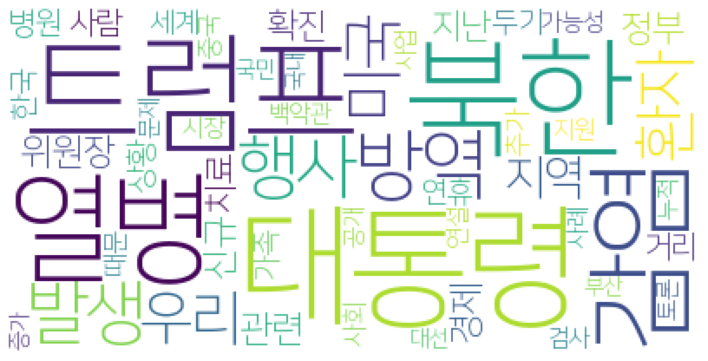

2020.10.09
['구두', '황판', '가게', '선공', '손님']
['확진', '가족', '판정', '학생', '부방']
['가을', '단풍', '조선']
['신규', '모스크바', '러시아', '하루', '증가', '조치']
['주사', '부산', '방문', '관련', '감염', '경로', '간호조무사']
['제주', '관광객', '방역', '연휴']
['신규', '러시아', '하루']
['기아', '식량', '세계']
['식량', '세계', '계획', '조선', '노벨', '위원회', '백신']
['경향신문', '북한']
['러시아']
['중국', '연휴', '국경절', '경제', '지난해']
['세계', '식량', '계획', '북한', '지원', '기아', '백신']
['코백스', '중국', '백신']
['신규']
['선수', '영상', '구단']
['신규', '모스크바', '러시아', '하루', '증가', '조치']
['감염', '가족', '모임', '추석', '방역', '경향신문', '재생산', '거리', '두기']
['감염', '가족', '모임', '주사', '방역', '사례', '추가', '추석', '확인', '전파', '연휴', '통한', '이후', '확진']
['감염', '가족', '사례', '연휴', '집단', '관련', '확진', '환자']
['경찰', '집회', '광화문', '차량', '도심', '광장']
['식량']
['감염', '가족', '주사', '환자', '조선', '간호조무사']
['한글날', '한글', '서체', '디자인', '무료', '빙그레', '배포', '공개', '경향신문', '상품', '을지로', '기념', '장군', '김좌진']
['공원', '조선']
['경향신문', '검사']
['신용등급', '재정', '준칙', '한국', '정부']
['대신', '보수', '집회', '경찰', '금지', '광화문', '광장', '차벽', '시위', '인근', '단체', '시민', '기자회견', '자전거', '펜스']
['첸

['단체', '대표', '집회', '보수', '원금', '목사', '운동', '한겨레', '시위', '석방', '본부', '유튜브', '구속', '방역', '분석', '확산', '금지', '경찰', '국민']
['확진', '시민', '간호조무사', '주사', '수액', '기존', '접촉', '현재', '감염', '부산', '판정', '급성', '검사', '부산시', '방문', '추가', '확인']
['광화문', '집회', '야호', '시작', '오늘', '단체', '반장', '한글', '광장', '기자회견', '금지', '다시', '소식', '모든', '건물', '등장', '풍경', '주민', '한글날', '차벽', '개천절', '곳곳']
['방역', '경제', '정부', '단계', '연합뉴스']
['집회', '국민', '방역', '차벽']
['노컷뉴스']
['의원', '징계', '결정', '의혹', '대해']
[]
['가족', '사례']
[]
['공개', '장소']
['방역']
['방역']
['질환']
['엔터테인먼트', '빅히트', '터주', '매수', '주가', '개인', '상장', '글로벌', '판매량', '실적', '앨범', '팬덤', '하락', '밸류', '다른', '증가']
['경찰', '집회', '방역', '차벽']
['자본시장', '투자자', '검거']
['항체', '개월', '감염', '교수', '환자', '수치', '유지', '뮤노글', '결과', '찰스', '바이러스', '사이언스', '기간', '혈액']
['항체', '개월', '감염', '교수', '환자', '수치', '유지', '기간', '바이러스', '찰스', '뮤노글', '사이언스', '결과', '혈액']
['노벨', '노벨평화상', '식량', '위원회', '기아', '단체', '후보']
['헌혈', '부부', '혈액', '권씨']
['트럼프', '북한', '미국', '관계', '남북', '우리', '사건', '사망', '가능성', '전략', '대통령', '대선', '제시', '평

['신규', '영국', '치료']
['추석', '가족', '모임', '감염', '전파']
['정차', '지하철', '통과']
['아이', '중국', '화웨이', '영국', '장비', '증거', '사업']
['기자회견', '집회', '경찰', '거리', '두기', '행사', '정부', '진행', '지하철']
['미국', '대선', '대통령', '단체', '트럼프', '휘트머', '지사', '극우', '사회', '미시간주', '납치', '사건', '시위']
['한글날', '오후', '집회', '경찰', '차벽', '해제', '개천절']
['상태', '트럼프', '대통령']
['거래', '가맹', '조정', '분쟁', '접수', '불공정', '행위']
['입국', '판정']
['한국', '외교', '박물관', '민선']
['참여', '백신', '중국', '세계']
['간호조무사', '확진', '접촉', '부산시', '주사', '번은']
['트럼프', '대통령', '유세']
['세포', '개발', '항체', '치료', '태아', '트럼프', '리제', '낙태', '대통령', '사용', '백신', '포주', '바이러스', '활용', '조직', '연구']
[]
['북한', '기념일', '무기', '열병', '위원장', '창건', '주년', '통해', '내일', '기념', '보고', '모습', '직접', '통일부', '신형', '정부', '행사', '연설', '진행', '가능성', '전략']
['백성']
['취업']
['감염', '방역', '추석', '이동', '가족', '경로', '두기', '당국', '거리', '모임', '집회']
['두기', '감염', '방역', '추석', '이동', '가족', '거리', '경로', '모임', '집회', '당국']
['국민', '집회', '차벽', '광화문']
['교육', '민방위', '사이버교육']
['하락', '상승', '전월', '사태', '지난', '대비', '경기', '포인트', '해석', '지표', '이후', '확산', '개

['인천', '투자', '건립', '경제', '자유', '센터', '바이오', '청라']
['경제', '청라', '인천', '투자', '건립', '자유', '센터', '바이오']
['집회', '광화문', '광장', '경찰', '기자회견', '오후', '인근', '정부', '시민', '차벽', '설치', '차량', '진행']
['백신', '정부', '예방접종', '공급', '이상']
['기자회견', '시청', '이동', '경찰', '집회', '광화문', '광장', '시민', '통행', '오후', '금지', '차벽', '위해', '개천절']
['인사동', '문화', '축제', '호텔', '아트', '갤러리', '작품']
['경제', '북한', '열병', '이번', '신형', '주년', '미국', '연설', '생중계', '분석', '공개', '미사일', '치명']
['미사일', '주년', '북한', '열병', '이번', '신형', '경제', '미국', '분석', '공개', '치명', '생중계', '연설']
['취업', '맞춤', '채용', '준비']
['미얀마', '태국', '입국', '국경', '확산', '봉쇄']
['활동', '사업', '사립대', '추진', '공영', '대학', '교수']
['실험실', '안전', '매일신문', '대학', '발생', '사고', '보험', '연구실', '연구', '치료', '보장', '보상', '가입']
['국민']
['운영', '지원', '수업']
['시인', '글릭', '노벨문학상']
['렉서스', '판매', '벤츠', '작년', '동기', '대비', '테슬라']
['후보']
['공간', '전시', '설치', '작품', '박경화', '상황']
['당신', '아내', '봉사', '정말', '한겨레', '여보']
['가족', '사례', '연휴', '모임', '감염', '확진', '전파']
['사진', '사진전', '주민', '경제', '채널', '참여']
['부부', '연휴', '방문', '전남', '감염', '환자', '아내',

['판정', '보령', '서산', '오전', '충남', '검사', '입원', '입국', '접촉', '충남도', '아산', '격리']
['의회', '다산', '토론회', '민주당', '경기도', '자유', '실학', '리더십', '교수', '정책', '기획', '위원회', '재정', '주제']
['방역', '감염', '국민', '특별', '추세', '고려', '반장', '방안', '추석', '운영', '대해', '두기', '사회', '증가', '발생', '거리', '부분', '총괄', '전략기획', '기간', '중단', '방향', '준수', '연휴', '분석', '정부', '전체', '조치', '대한', '환자', '체계', '판단', '감소']
['골목', '거리', '개발', '관광', '음식', '다문화', '이야기', '사업', '테마', '지역', '통해', '홍보', '김포', '추진']
['관광', '전남', '협의', '관광업', '기관', '전라남도', '방안']
['화재', '인천', '경찰']
['기준', '결정', '정부', '국회', '주주', '단계', '조정', '주식', '방안']
[]
[]
['가족', '이데일리', '방문', '주사']
['광화문', '경찰', '시민', '통행', '광장', '일부', '일대', '차벽']
[]
[]
['부회장', '준법', '경영', '감시', '삼성', '위원']
['시카고', '판매', '지언', '의료', '기소']
['안내서', '한국', '교수', '역사', '파리']
['국민']
['계대', '마스크']
['집회', '금지', '정부', '국민', '단체']
['경제']
['방송', '채널', '정보', '위반', '사실', '보도', '방송사', '내용', '조선', '허위']
['확진']
['인천']
['대통령', '전두환', '고액', '체납', '의원', '재정', '국감', '탈세', '국민']
['이데일리']
['방역', '대해', '개인', '본부', '주말', '어르신'

['검사', '대전', '지난']
['대전', '검사', '지난']
['트럼프', '백악관', '마스크', '밀접', '신속', '사람', '양성', '지침', '접촉', '반응', '검사', '증상', '거리', '또한', '참석', '보좌', '대통령', '행사', '판정', '음성', '현실', '사람과', '동안', '최소', '감염', '대규모', '다른', '확진', '이후', '모임', '격리', '힉스']
['감염']
['세계', '대통령', '우리', '한글', '한국', '한글날', '한국어']
['전용', '거래', '아파트', '단지', '기록', '강남', '지난달', '리버', '지난', '준공']
['의회', '도민', '집행', '정책', '입법', '의장', '도의', '정례', '현안', '인사', '의원', '부와', '의정', '활동', '전문성', '피해', '지역', '지방의회', '견제', '위해', '전북', '연구', '취임', '분석']
['박사', '대통령', '트럼프', '콘리', '상태', '의료', '진단', '검사']
['제주', '연휴', '입도', '제주도', '동안', '관리']
['공인', '디지털화', '내용', '소상', '홍보', '전통', '시장', '디지털']
['아이', '매트', '제품', '난방', '판매량', '가전', '히터', '판매', '롯데']
['로봇', '구타']
['소상', '스마트', '디지털', '시장', '전통', '공인', '내용', '강석', '소개']
[]
['일본']
['대통령', '트럼프', '인터뷰', '유세', '재개', '판정']
['메르켈', '총리', '조치', '제한']
['대통령', '트럼프', '판정', '대변인', '활동', '의료', '치료']
['국가', '유공']
['인터뷰', '트럼프', '대통령', '폭스뉴스']
['고스트', '패스', '생체', '정보', '셀러', '레이', '인증', '기술', '결제']
['경제', '기업'

['신규']
['트럼프', '대통령', '콘리', '치료', '복귀']
['통영시', '디지털', '통영', '벽화']
['이탄', '지금', '결과', '오히려', '수가', '판결', '대법관', '발의', '미국', '학생', '국민', '사람', '하나', '사실', '구속', '판사', '벌금', '그거', '대법원', '다른', '느낌', '이상', '교육', '국회', '다시', '때문', '우리', '월세', '김현정', '생각', '순위', '이제', '범죄', '대안', '우선', '경우', '웃음', '의원', '학급', '법안', '상황', '그게', '말씀', '이야기', '재판', '그때']
['노르웨이', '세르비아', '유로', '본선', '예선', '플레이오프', '전반', '치가']
['지역', '김포', '골목', '관광', '음식', '거리', '다문화', '이야기', '북변동', '사업', '통해', '추진', '개발', '안산', '홍보', '테마', '원곡동']
['총리', '오늘', '집회', '상황', '방역']
['한글', '한국', '행사', '문화', '우리', '연합뉴스']
[]
[]
['부산']
[]
['발생', '해외', '신규', '관련', '전날', '기록', '증가', '접촉', '간호조무사', '기준', '관악구']
[]
['골목', '경제', '관광', '사업']
['일손', '인력', '농가', '돕기']
['자릿수', '기록']
[]
[]
[]
[]
['경찰', '광화문', '집회']
['진료', '시스템']
['할인', '행사', '티몬', '상품']
[]
['국내', '발생']
['신규']
['경제']
['오늘']
['방역', '연휴']
['연휴', '방역']
['경관', '밀양', '교량', '조성', '시민']
[]
[]
[]
[]
[]
['목포', '경제', '지난']
['신규', '확인']
[]
['연합뉴스']
[]
[]
[]
['발생', '해외', '신규']
[]
['트럼프', '

['재계', '감사', '선임', '경제', '위원', '공정', '경영', '기업', '처리', '민주당', '제도', '간담', '정부', '단체', '상법', '여당', '입장', '법안', '개정안', '관련', '주주']
['판단']
['노컷뉴스']
['노컷뉴스']
['두기', '거리', '사회', '인구', '감염']
['아이', '온라인', '센터', '수업', '도움', '다문화']
[]
['토론', '후보', '트럼프', '바이든']
['병원', '발생', '고령', '위중', '환자', '감염', '때문', '시설']
['원주', '제주', '노선', '운항']
['제주', '원주', '노선', '운항']
['관광', '국립공원']
['투표', '재외국민', '방식', '총선', '선거', '재외선거']
['변경', '바이든', '토론', '방식', '트럼프', '대통령', '토론회', '후보', '일정', '대선', '예정', '경제']
['대통령', '지사', '단체', '납치', '휘트머', '무장', '계획']
['센터', '여성']
['커버', '리지', '국회', '투자']
['토론', '화상', '트럼프', '바이든', '후보', '캠프', '대통령', '방식']
['수업', '찌아', '한글', '찌아찌아어', '선생님', '부톤섬', '교육', '교사', '초등학교', '인도네시아', '한국어', '학교']
['토론', '트럼프', '방식', '대통령', '대선', '결정', '예정', '비대', '후보', '위원회', '가상']
['백신', '브라질', '누적', '보건부', '전날', '연구소', '부탄']
['이탈리아', '신규', '영국', '조치', '지난']
['고성군', '영화관', '운영']
['부양책', '합의']
['트럼프', '항체', '대통령', '리제', '치료']
['탈북민', '우리', '이후', '북한', '귀순', '정부', '보호', '통일부', '입국']
['부통령', '해리스', '토론', 

['설치', '집회', '경찰', '오늘', '차벽', '개천절', '의원']
['배우', '송승환', '연극', '공연', '작품', '이야기', '무대', '선생님', '연기자', '드레서', '연출', '상황']
['협상', '부양책', '지수', '합의', '미국', '로시', '의장', '트럼프', '포괄', '시장', '주요', '대통령', '대선', '논의']
['대통령', '단체', '페이스북', '계정', '트럼프', '삭제', '가짜', '대한']
['미디어', '구조조정']
['모습', '백화점', '홈쇼핑', '장마', '확산', '업계', '매출', '수요', '두기', '사회', '거리', '소비']
['등록', '키트', '진단', '제품', '국산', '국제', '기구', '품질', '국내', '절차']
['증시', '지수', '트럼프', '대통령', '상승', '부양책', '미국']
['차관', '국감', '장관', '태양광', '산업부', '산업', '정책', '산지', '폐쇄', '호기', '야당', '정부']
['학교', '공부', '학생', '어르신', '수업', '수강생']
['학교', '공부', '학생', '어르신', '수업', '수강생']
['강사', '인천', '학원', '선고']
['감염', '가족', '추석', '벌초', '대전', '확산', '확진']
['토론', '트럼프', '바이든', '후보', '대통령', '민주당', '대선', '화상', '입장']
['사건', '접근', '대상', '성범죄', '온라인', '그루밍', '가해자', '청소년', '채팅', '피해자', '비중', '아동', '영상', '피해', '디지털', '차지', '연령', '범죄']
['지사', '정부', '계획']
['납치', '휘트머', '지사']
['미국', '반영', '경제', '증권', '센터', '증시', '리서치', '상승', '이후', '금리', '국내', '둔화', '버블', '대선', '확산', '작용', '증권사',

['차량', '예고', '집회', '경찰', '시위', '불법', '정부', '자제', '지난', '한글날', '개천절', '단체', '위해', '차벽', '서울시', '대해', '대응']
['토론', '대통령', '트럼프', '대선', '후보', '방식', '바이든']
['미국', '부차', '관보', '트럼프', '대통령']
['전세계', '지난']
['의료', '문제', '시험', '의사', '배출', '거부', '의대', '응시', '정부', '국가']
['희망', '기준', '사회', '협동조합', '지원', '대상', '자금', '조합', '구두', '소상', '포함', '전체', '공인']
['치료', '리제', '항체']
['거리', '두기', '방역', '완화']
['수업', '등교', '교육부', '확대', '격차', '학부모', '온라인', '학교']
['실험', '포비', '요오드', '베타딘', '인후', '스프레이', '사용', '코로나바이러스', '제품', '함유']
['화상', '바이든', '토론', '트럼프', '후보', '미국', '대통령', '일정', '캠프']
['한국어', '영상', '때문']
['평가', '처음', '동물', '지난', '블록', '이용자', '메타', '버스', '게임', '로얄', '플랫폼', '세계', '파티', '시간', '가상', '세상', '포트', '공개', '개발자', '현실', '나이트', '시대', '이상', '로블록스', '닌텐도']
['국민', '장관', '사람', '해외여행', '포스터']
['펜스', '중국', '대통령', '후보', '토론', '트럼프', '대선', '부통령', '해리스', '영향']
['실적', '부회장', '이익', '반도체', '분기', '전자', '영업', '최고', '부문', '삼성', '경영']
['롯데', '지주', '대표이사']
['성동구', '필수', '노동자', '조례', '청장', '전국', '지원', '지난달', '서울시', '대책', '정부

['사업', '반도체', '전자', '스마트폰', '소비']
['반도체', '부회장', '유럽', '스위스', '시스템']
['감시', '면담', '준법', '부회장', '시위', '삼성', '경영', '위원']
['학습', '한글', '공부', '어르신']
['어르신', '한글', '공부', '학습']
['영업', '이익', '사업', '전자', '예상', '본부']
['워커', '구글', '대표', '코리아', '한국', '국회', '출석', '미국', '법인']
['장관', '대해', '선거', '의원', '검찰', '혐의', '수사', '사건', '무혐의', '처분', '공직선거법', '여당', '민주당', '검사', '인사', '기소']
[]
['방역']
[]
['개인', '과세', '주식', '대상', '보유', '투자자', '주주', '기준', '도세', '증가', '올해']
['경찰', '집회', '금지', '통고', '기각', '신청', '경찰서', '한글날', '제기', '행정법원', '도심']
['잠정', '실적', '전자', '매출', '달성']
['조건', '한미', '전환', '전작권', '한국', '검증', '수정', '작업']
['시인', '미국', '수상', '수상자', '작품', '글릭', '시집', '노벨', '문학상', '작가']
['전작권', '안보', '조건', '한미', '전환', '능력', '협의', '확보', '충족', '평가']
['회장']
['사장']
['인촌', '수상자', '선생', '동아일보', '위해', '시상식', '분야', '수상', '감독']
['한글', '에티오피아', '손편지', '멜레세', '참전용사', '회장', '칠곡군']
[]
['편지', '의무', '복무', '군인', '군대', '사람', '부대', '경향신문', '훈련병', '용지', '기간']
['시간', '노동', '사회', '고용', '초단', '장시간', '경향신문', '배송', '택배']
['부통령', '백신', '펜스', '

['진행', '대상', '노숙인', '쪽방', '독감', '무료']
['서울시', '농업', '진행']
['서울시', '노숙인', '쪽방', '독감', '주민', '예방접종', '결핵', '무료', '진료', '봉사']
[]
['보령']
['유치', '용인시']
['총리', '한글']
['미얀마', '경험', '한국', '총선', '선거', '관리', '방역', '최고']
['생활임금', '광주']
['이데일리', '연휴', '추석', '거리', '두기']
[]
['사례', '신규', '감염']
['홍성군', '대전', '동선', '공개', '밀접', '접촉', '분류', '검사']
['홍성군', '대전', '동선', '공개', '밀접', '접촉', '분류', '검사']
['일자리', '김포시', '전국', '대상', '고용노동부', '자치', '단체', '지역']
['군산', '제주', '운항']
['경제']
[]
['전쟁법', '정책', '경제', '때문', '이유', '정권', '아베', '민주당', '야당', '대규모', '비판', '사임', '시위', '정치', '평가', '입헌민주당', '일본', '상징', '레이어', '섹션', '사람', '원전', '반대', '분류', '표명', '결과', '재편', '연합', '국민', '계속', '검찰청', '사회', '총리', '문제', '시민', '개정', '운동', '행동', '트위터', '이후', '선거', '언론', '지지', '자민당', '헌법', '기사', '세력', '법안', '집회', '대중', '정당']
['실적', '추정', '영업', '이익', '가전', '부문', '전자', '분기', '경제', '대비', '기록', '사업']
['광장', '광화문', '국민', '차벽']
['경찰', '광화문', '광장', '통행', '시민', '일부', '금지', '일대', '버스', '불편', '집회', '호선', '차벽', '개천절', '인도']
['취업', '지역', '혁신도시', '공공기관',

[]
[]
['관련', '누적', '추가']
['관련', '누적', '추가']
[]
['미얀마', '총선', '한국', '대사관', '관리', '선거', '방역', '선관위', '대해', '경험', '투표']
['팬톤', '색상', '월경']
['대통령', '트럼프']
['건설', '필리핀', '공사', '계약', '철도', '남북', '공구', '화상', '서명', '수주', '온라인', '기술', '현대']
['경제']
[]
['총리', '상황', '방역', '발생', '회의', '확산', '다시']
['비대', '토론', '트럼프', '방식', '대선', '대통령', '미국', '후보', '입장', '납치', '지사']
[]
['우리', '문화', '대한민국', '총리', '사람', '선도']
['케네디', '조달', '트럼프', '쿠슈너', '고발', '지난', '봉사자']
['차지', '수출', '완성', '시장', '차종', '대수', '업계', '부가가치', '자동차', '감소']
['대구', '차량', '시위', '집회', '금지', '네거리', '경찰', '우리', '공화당']
['전남', '여성', '지역', '지난']
['과정', '우선', '때문', '기회', '인사', '가족', '문제', '취업', '수시', '기업', '회사', '신입사원', '임원', '방식', '이후', '공사', '입사', '채용', '조합원', '대기업', '경영', '기준', '비리', '세습', '정규직', '그룹', '공개', '인근', '선발', '뽑기', '특별', '재벌', '조항', '민간', '노동자', '찬스', '고용', '비정규직', '모집', '회장', '전환', '불공정', '비공개', '구조', '주장', '몰래', '자녀', '감사', '언론', '차별', '노동시장', '미디어오늘', '사회', '부모', '청년', '노동조합', '대해', '현대차', '이유', '보수', '단체', '진행']
['경제']
['안전', '회의', 

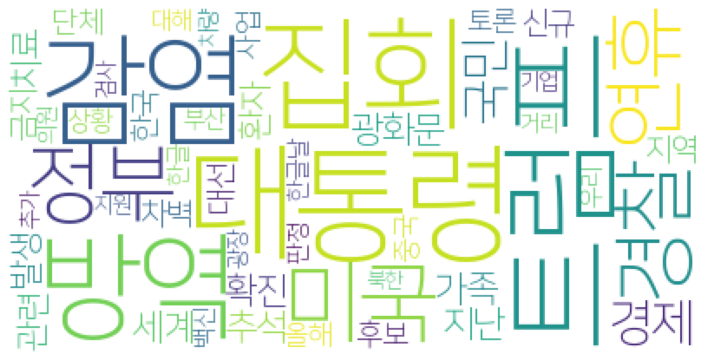

2020.10.08
['백신', '존슨']
['백신', '개발']
[]
['트럼프', '치료', '대통령']
[]
['집회', '경찰', '개천절', '불법', '지난', '차벽', '단체']
['주사', '간호조무사', '사람']
['토론', '대통령', '부통령', '트럼프', '바이든', '미국', '화상', '후보']
['집회', '금지', '신청', '처분', '집행정지']
['토론', '트럼프', '대선', '후보', '대통령', '토론회', '결정', '바이든']
['집회', '금지', '신청', '기각', '집행정지']
['격리', '접촉']
['도시락', '조선', '경북', '의료', '셰프']
['조선', '도시락', '경북', '의료', '셰프']
['오스트리아']
['외화', '가입', '달러', '적금', '경향신문', '하나은행']
['제주', '진에어', '제주항공', '군산', '군산공항', '운항', '승객', '노선']
['원격', '트럼프', '토론회', '대통령', '비대', '토론']
['양성', '판정', '근무']
['청주의료원']
['백신', '개발']
['집회', '신청', '금지', '집행정지', '기각']
['집회', '신청', '금지', '집행정지']
['집행정지', '집회', '신청', '금지']
['경향신문', '조사']
['조사', '경향신문']
['백신', '존슨']
['공화당', '확산', '판단', '처분', '집행정지', '소송', '금지', '신청', '효력', '기각', '통보', '경찰서', '옥외', '한글날', '상대로', '가처분', '자유', '통고', '사무', '우리', '법원', '사건', '정지', '집회', '제한', '총장', '참가']
['조선', '감염', '인천', '학원', '강사', '재판', '역학', '조사']
['집회', '금지', '신청', '처분', '집행정지', '효력', '기각', '옥외', '공화당', '한글날', '정지', '우리', '통보', '소

['라운드', '최종', '본부장', '사무', '총장', '후보', '장관', '선출', '지지', '산업부', '통상', '회원']
['라운드', '아프리카', '후보', '여성', '사무', '총장', '본부장', '통상', '회원', '오콘', '세계', '장관', '때문', '아시아', '한국', '상황', '이웰', '후보자']
['트럼프', '사망자', '독감', '폐렴', '대통령']
['지역', '억만장자', '갑부', '증가']
['집회', '경찰', '광화문', '의원', '확산', '설치', '국민', '불법', '차벽', '대응', '수사권', '위해']
['안내', '관광', '코스', '제작', '지도', '도심']
['도심', '코스', '제작', '지도', '안내', '관광']
['반도체', '대비', '소비', '전자', '사업', '스마트폰', '시장', '실적', '이익', '증가']
['집회', '금지', '부산']
['격리', '자가', '장소', '해외', '입국', '이하']
[]
['확산', '유럽', '국가']
['삼성', '준법', '부회장', '감시', '위원회', '지난', '아이', '기자회견', '경영', '회의', '정기']
['트럼프', '미국', '대선', '세계', '대통령', '정치', '확진', '때문', '선거', '부산', '한국']
['집회', '금지', '법원', '신청', '대위']
[]
['정자', '바이러스']
['시장', '기록', '호조', '실적', '전자', '이익', '영업', '반도체', '판매', '매출', '최고', '부문', '전망', '부회장', '증권', '세트', '모바일', '사업']
['실적', '전자', '이익', '영업', '반도체', '판매', '시장', '모바일', '증권', '부회장', '매출', '전망', '기록', '세트', '호조', '최고', '부문', '사업']
['치료']
['사업', '예방접종', '접종', '노출', '이상', '상온'

['세인트루시아', '투자', '투자자', '옵션', '시민권', '옐런', '스타', '국가', '제공', '총리']
['유전자', '시약', '진단', '허가']
['집회', '경찰', '한글날', '금지', '차벽']
['기후', '민주당', '의장', '도당', '경남', '식량', '위기', '농민', '농민공', '김성만', '위해', '농정', '전환', '행동', '농업', '식량주권', '대응', '농지', '농산물', '윤성효', '연합', '오후', '시대', '라며', '실현', '요구']
['입국', '일본', '정부', '방침']
[]
['소득', '가구']
['증가', '최대', '영업', '전자', '이익', '실적', '가전', '판매', '매출', '사업', '개선', '대비', '스마트폰', '분기', '부문']
['가구', '생계', '신청', '긴급', '소득', '위기', '지원', '감소']
['연휴', '추석', '방역', '감염', '정부', '이번', '수도권']
['인천', '재판', '연합뉴스']
['시장', '증가', '전자', '실적', '사업', '이익', '영업', '본부', '개선', '회복', '가전', '예상', '부문', '아이', '매출']
['대전']
['극빈', '인구', '세계', '최대', '빈곤', '위기', '이후']
['경향신문', '광화문', '의료', '원장', '현판', '낙태죄']
['사회', '경제', '지원', '기업', '항공사', '한국', '협약', '체결']
['서비스', '대통령', '위험', '대면', '활동', '보호', '사회']
['입원', '비용', '트럼프', '미국', '대통령', '치료', '진료', '검사', '보험']
['부산', '간호조무사', '주사']
['반도체', '조명', '매출', '제품']
['치료', '트럼프', '대통령', '부양책', '미국', '협상', '집무실', '검사', '보고', '비용']
['학원', '진술', '아이

['베트남', '콘텐츠', '비즈니스', '센터', '한류', '한국', '남방', '교류', '지역', '진원', '시장', '협력', '문화']
['올해', '중앙은행', '매각', '매입', '상승']
['매각', '중앙은행', '매입', '상승', '올해']
['정신', '의료', '정신병원', '사망자']
['가전', '이익', '실적', '영업', '전자', '매출', '증가', '판매']
['영업', '증가', '이익', '실적', '전자', '매출', '가전', '판매']
['소득', '가구']
['여러분', '여사', '한국어', '한국인']
['행보', '부회장', '반도체', '전자', '광장', '글로벌', '확보']
['얼굴', '감염', '접촉', '빈도', '시간']
['광주시', '제안', '회의', '지방', '광주', '협업', '추진', '특별', '행정기관', '지역', '기관', '현안', '사업', '과제', '협력']
['수업', '등교', '대학']
['방역', '사업', '지원', '물품', '경제', '광주', '광역시', '마스크', '신청', '고용']
['디즈니', '스트리밍', '미디어', '로브', '영화', '영화관', '투자']
['기업', '자산', '무형', '카바', '유형', '경량', '경제', '플랫폼']
['진술', '허위', '학원', '거짓말', '감염', '혐의', '강사', '조사', '인천', '징역']
['그룹', '사장', '효성', '캠페인', '활동']
['수업', '학교', '등교']
['행정', '법률', '법무부', '적극', '우수', '사례', '업무', '시스템']
['접촉', '대전', '지난', '교사', '확진']
['의료', '대통령', '우즈베키스탄', '고려인', '독거', '노인', '아리랑']
['상권', '영등포역', '평균', '유동']
['발생', '방역', '분석관', '한글날', '집회', '관련', '진단']
['연탄', '가구', '은행

['가족', '추석', '연휴', '모임', '발생', '추가', '환자', '관련', '감염', '경기', '확진', '누적']
['서비스', '사회', '대통령', '복지']
['임대료', '점포', '시장', '공설', '연장']
['도구', '진단', '의료', '개발', '기관', '산업', '허가', '보건', '검사', '기업', '서비스', '병원', '검체']
['백악관', '국방부', '사령관', '자가', '격리']
['검사', '주사', '간호조무사']
['응시', '의료', '의사', '국민', '의대', '국시', '문제', '원장']
['강원도', '농협', '시스템', '축산물']
['시스템', '농협', '강원도', '축산물']
['사업', '사례', '사회보장', '고양시', '협의', '극복', '우수', '공모전', '부문', '아이디어']
['주사', '검사', '간호조무사', '부산']
['주사', '검사', '간호조무사', '부산']
['감염', '추가', '가족', '모임', '지인', '연휴', '누적']
['엑셀', '템플릿', '버전', '데이터', '누락', '발생', '보건', '집계']
['사업', '일자리', '성남']
['방역', '특별', '추이', '추석', '기간', '거리', '두기', '정안', '연휴', '발표', '이번', '정부', '사회', '단계']
['치료', '항체', '리제', '트럼프', '대통령', '사용', '승인', '백신', '세포', '클론']
['얼굴', '방역', '감염', '접촉', '손씻기', '전파', '분석관', '평균']
['방역', '당국', '접촉', '검사', '지난', '조사', '교사', '대전']
['대전', '임금', '비정규직', '본부', '파업', '의료', '을지대', '노사', '보건', '주장', '병원', '노조', '협상', '교섭', '전국', '직원', '처우', '대학병원', '로비', '요구', '인력', '지역', '충남'

['가구', '신청', '지원', '생계', '소득', '긴급', '원금', '온라인']
['지원', '가구', '신청', '소득', '생계', '긴급']
['자재', '마트', '장관', '지적', '의원', '관련']
['오후', '스코틀랜드', '판매', '조치', '영업']
['선호', '정신건강', '사람', '근로자', '스트레스', '불안감', '재택근무', '직장', '응답']
['뱃사람', '현상', '모의', '번개', '방전', '비행']
['모의', '현상', '번개', '방전', '비행', '뱃사람']
['취소', '소금강', '행사']
['관광']
['박씨', '장애인', '지원', '간담', '서비스', '사회', '종사', '제공', '위해', '생활', '처우', '공공', '개선', '긴급']
[]
['미국', '한미', '국방부', '예정', '장관']
['이익', '영업', '전자', '실적', '증가', '이상', '부문', '삼성', '대비', '역대', '수요']
['영상', '효과', '대통령', '트럼프', '치료', '여러분', '리제', '자신', '촬영', '상태']
['체납', '세금', '상반기', '지난해', '연간', '올해', '정리', '보류']
['항공', '희망', '퇴직', '삭감', '그룹', '임금', '지급']
['진행', '치료', '인도', '승인', '에이', '완료']
['연휴', '집회', '방역', '감염', '추석', '반장', '집단', '기간', '정부', '특별', '관련']
['확진', '집회', '발생', '감염', '가족']
['소비자', '금투', '시행', '발표', '금융', '하나', '소비자보호', '상품', '금융투자', '대한', '판매', '포럼', '사기', '제도', '회사', '주제', '주요']
['연휴', '추가', '확진', '환자', '감염', '가족']
['소득', '가구', '생계']
['금융', '금융투자', '하나', '소비자보호',

['교량', '대우건설', '아프리카', '보츠와나', '사장교', '잠비아', '엑스트라', '케이블']
['캠페인', '토스']
['방역', '건물']
['정자', '세포', '바이러스', '고환', '기능', '연구', '수용체', '라이']
['바다', '호룡곡산', '고개', '하나', '무의도', '실미도', '소무의도', '해변', '해수욕장', '시간', '거리', '정상', '호룡', '이름', '영화', '데크', '호랑이', '유지', '산행', '길이', '곡산', '시작', '금지', '야영', '빼기', '정도', '용유역', '나무']
['비용', '보험', '대통령', '미국', '트럼프', '검사', '부산', '입원', '의료']
['조치', '뉴욕', '유대교도']
['지역', '전날']
['부문', '이익', '실적', '영업', '전자', '사업', '스마트폰', '예상']
['연구소', '정책', '교육', '교육부', '중점']
['친환경', '자동차', '패션', '폐기물', '소재', '사이클링', '협업', '에어백']
['말티재', '속리산', '산림청', '경향신문', '단풍']
['아시아나', '바스키아', '화물', '항공', '운송', '작품', '아이', '이번', '롯데']
['신규', '전날', '누적', '격리']
[]
[]
['하량', '부문', '실적', '이익', '영업', '전자', '반도체', '스마트폰', '증가', '예상', '이상', '크게', '화웨이', '가전', '수요', '개선', '추정', '영향']
['구독', '정기']
['백악관']
['입국', '일본', '제한', '한국', '해제', '일본인', '외국인', '면제', '정부', '조치', '신문', '주간']
['영상', '문화', '파주', '행사', '온라인', '참여', '평화', '기념', '축제', '시민']
['방역', '연휴', '경찰', '자치', '비상', '제주', '점검', '특별', '취약', 

['참전용사', '마음', '선언', '행사', '위해', '관계', '양국', '한반도', '코리아', '화상', '친구', '마스크', '평화', '한국', '협력', '국제사회', '소사이어티', '축하', '발전', '역할', '여러분', '미국', '종전', '소통', '신뢰', '동맹', '통해', '정상회담', '귀빈', '연설', '대응', '문화', '전쟁', '이해', '국민', '교류', '진전', '한미', '대통령', '위기', '지난', '적극', '회장', '우리', '장의']
['증가', '실적', '부문', '전자', '영업', '이익', '반도체', '개선']
['추석', '가족', '확진']
['가구', '지원', '긴급', '생계', '신청']
[]
[]
[]
[]
['실적']
['트럼프', '대통령']
['가을', '자외선', '피부', '건강', '코딱지', '콧속', '헬스']
['불평등', '옥스팜', '정책', '해소', '한국', '부문', '개국']
['항체', '대통령', '트럼프', '집무실', '복귀']
['한국', '불평등', '순위', '부문', '평가', '지표', '국가']
['대화', '질문', '총리', '정책']
['컬리', '냉동', '센터', '근무', '직원', '방역', '진행']
['예술', '작가', '롯데', '백화점', '신당', '창작', '아케이드', '호기']
['치료', '환자', '항체', '승인']
['을숙도', '낙동강', '시민']
['치료', '릴리', '환자', '일라이', '항체', '긴급', '사용', '승인', '입원']
['포럼', '세계', '경제', '조사']
['대통령', '한미', '동맹', '선언', '한반도', '평화', '종전', '적극', '한국', '미국']
['전라남도', '특산', '지역', '협약', '롯데', '홈쇼핑', '상품', '개발', '활용']
['실적', '영업', '이익', '전자', '이후', '매출', '분기']
['

['환자', '치료', '일라이', '릴리']
['건물', '방역', '경제', '희망', '일자리']
['항체', '공급', '릴리', '치료', '일라이']
[]
['정부', '체코', '유럽', '신규', '기록']
['재정', '추가', '지원', '경제']
['사업', '성남', '일자리']
['트럼프', '대통령', '백악관']
['대통령', '트럼프', '집무실', '복귀']
['브라질']
['부문', '영업', '예상', '스마트폰', '이익']
['병원', '치료', '트럼프', '대통령', '미국', '검사', '비용', '환자', '보험', '의료', '헬기']
['트럼프', '대통령', '비판']
['집회', '금지', '비상', '대책', '위원회', '확산', '경찰']
['대통령', '트럼프', '백악관', '집무실', '퇴원', '증상', '판정', '양성', '지난', '복귀', '경향신문', '대해']
['설립', '위해', '단체', '운영', '탄압', '업무', '상황', '답변', '제시', '법인', '활동', '노사', '이유', '악화', '이자', '용도', '학교', '임금', '수입', '지난', '교수', '중단', '예산', '사용', '대학', '직원', '대해', '문제', '교육', '가지', '재정', '설명', '협상', '건물', '건양', '급여', '주차장', '조합원', '노조', '해당', '캠퍼스', '학장', '입출', '학년', '부총', '교직원', '노동조합', '탈퇴', '인사', '제한', '현재', '공간', '등록금', '교육부', '기록', '시설', '건양대', '성과급', '지급', '동의', '지출', '학교법인', '연구', '인건비', '학원', '측은']
['현재', '치료', '항체', '셀트리온', '진행', '바이러스', '임상시험', '개발', '계획', '지난', '능력', '국내']
['치료', '항체', '셀트리온', '진행', '바이러스', '지난

['대표']
['베를린', '지역', '독일', '제한']
['베를린', '지역', '독일', '제한']
['의료기기', '온라인', '강원', '전시회', '상담', '기업']
['수출', '기업', '조사', '해외', '감소', '사항', '지원']
['여성', '사회', '문화']
['변화', '경제', '이후', '지역', '로컬', '지자체', '평창', '대비', '인구']
[]
['대통령', '트럼프']
['대표']
[]
['관련', '피해', '트레이닝', '기구', '신청', '부산']
['지역', '연구소', '기온']
['세포', '인플루엔자', '체세포', '사람', '전염병', '돌연변이', '백신', '바이러스', '감염', '발생', '진화', '버전', '생기', '항체', '다른', '염기', '대부분', '유전자', '숙주', '대한', '모양', '유전', '말라리아', '개발', '면역', '신체', '적혈구', '코로나바이러스', '현재', '전파', '유행', '걱정']
['커리어', '중견', '채용', '기업', '기간', '올해', '강소', '작년', '히든챔피언', '분야', '감소']
['가맹', '공정위', '프랜차이즈', '선정', '기업', '이상', '월간', '업체', '경고', '지원', '로부터', '본부']
['국방부', '북한', '전략', '무기', '열병', '가능성', '등장', '공개']
[]
[]
['국민일보', '집회', '경찰', '금지', '차벽', '광장']
['웅진씽크빅', '학습', '교육', '학생', '인공', '지능', '스마트', '편차', '문제', '선생님', '확인', '제공', '서비스', '활용', '수업']
['트럼프', '대통령', '백악관']
['전자', '이익', '사업', '영업', '실적', '가전', '매출', '수요', '기록', '부문', '달성', '지난해']
['기업', '비중', '상담', '화상', '바이어', '코트라', '참가', 

['증가', '가장', '음식', '온라인', '올해', '통해', '크게', '믹스', '도전', '메이드', '매출', '인기', '영상', '베이', '커피', '트레이닝', '최근', '제품', '개봉', '평균', '생활', '주문', '요리', '판매량', '관련', '초콜릿', '영향', '영화', '쿠키', '관심', '시간', '동기', '전통주', '대세', '조사', '공연', '헬스장', '응답', '판매', '역시', '대비', '급증', '유튜브', '분석', '넷플릭스', '체중', '문화', '집콕', '아이', '사람', '운동', '대한', '배달', '직접']
[]
['감소', '흑자', '개월', '연속']
['원내대표', '양도소득세', '주식', '주주', '기준', '과세', '완화', '투자자', '요건', '검토', '정부']
['원장', '응시', '의대', '사과', '의료', '기회', '국민', '의사', '시험', '병원', '국시', '국가']
['대회', '학술', '경기도', '임상병리사', '수원', '개최', '국제', '유치', '회의']
['수원', '대회', '개최', '임상병리사', '학술', '경기도', '국제', '유치', '회의']
['발리', '인도네시아', '호텔', '공항', '귀신', '관광객']
['매출', '펀딩', '가량', '제품', '상품', '작년', '부문']
['백악관', '일리', '실장', '경향신문', '사령관']
['트럼프', '대통령', '치료', '리제']
['대통령', '리제', '트럼프', '치료']
['경기도', '의원', '농정', '산업']
['국민', '의료']
['시민', '집회']
['백악관']
['백악관']
['발생', '병원', '신규', '지역']
['공간', '현대', '대학', '과천', '야외', '미술관', '국립', '설치', '관객', '건축']
['진행', '치료', '인도', '승인', '에이', '완료']
['오후', 

['대한', '총리', '대화', '질문', '정책', '해소', '질의', '사회']
[]
['마스크', '웰킵스', '매각', '현재', '시장', '업계', '브랜드']
[]
['빌보드', '부문', '뮤직', '어워즈', '생중계']
['신규', '누적', '감염', '발생']
[]
[]
[]
['대회', '국제', '수원', '경기도', '개최', '임상병리사', '학술', '유치', '회의']
['개발', '국제', '백신', '팬젠', '연구소']
['중앙은행', '올해', '구매', '현재', '지난', '기록']
['디지털', '경향신문', '신상', '정보', '무단', '교도소', '게시']
['주주', '정책', '요건', '원내대표', '주식', '투자자']
['해소', '불평등', '세계', '부문', '한국', '실천', '보고서']
['미국', '치료', '비용', '보험', '검사', '트럼프', '대통령', '의료']
[]
['세포', '정자', '바이러스', '고환', '기능', '라이', '수용체', '연구']
['마스크', '기술', '검수']
['경남', '확진']
[]
[]
[]
['부산']
[]
['검사', '페루', '항체', '장비', '감염']
['경북', '국회', '대구', '감사', '국정감사', '대한', '진행']
['온라인', '범죄', '건수', '발생']
['아이', '자릿수', '지역']
['신규', '확진']
['파넨카', '체코슬로바키아']
['의학', '대한', '사설', '트럼프', '대선', '후보', '미국', '의견', '표명', '지지', '정치']
['토스', '캠페인']
['국화축제', '월출산', '축제', '국화']
['총장', '세계', '통상', '후보', '사무', '라운드', '최종', '장관', '아프리카']
['에어', '티볼리', '차박', '쌍용차', '캠핑', '증정']
['예술', '고객', '작품', '백화점', '작가', '롯데', '전시', '행사', 

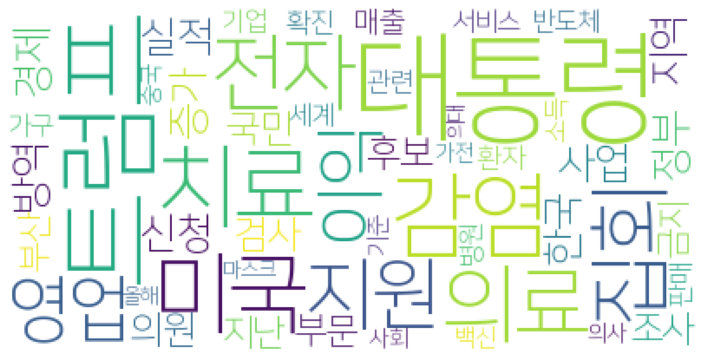

2020.10.07
['시설', '임시', '생활']
['부분', '경우', '노래방', '업주', '저작권료', '면제', '규정', '지난', '협회', '음악', '지원', '저작권']
[]
['개정', '관계', '부총리']
[]
['개정', '관계', '부총리']
['장관', '국민', '부산', '외교부', '남편', '미국', '의원']
['장관', '국민', '부산', '외교부', '남편', '미국', '의원']
['의대', '사과', '의사', '국시', '문제', '국민', '시험', '응시', '원장', '성명', '해결', '정부', '의료', '청원', '기회', '공감']
['셰프', '도시락', '의료', '조선']
['전북', '일자리']
['전라', '감영']
['검사', '감염', '마을', '추가', '확진', '주민', '방역', '가족', '가능성', '추석', '격리', '확인', '연휴', '당국', '다른', '상황']
['사랑', '비대', '방식', '교회', '예배', '생각', '우리', '노컷뉴스', '사회', '목사', '이후', '상황', '이제', '지금', '최병락', '예수님', '회복', '대면', '이번']
['트럼프', '대통령', '백악관', '조선']
['레벨', '일본', '입국', '국가', '한국', '감염증', '등급', '권고', '국민', '여행', '정부']
['중국', '대표']
['자금', '규모', '정부', '조달', '가계', '금융시장', '운용', '확대', '최대', '증가']
['퇴직', '직원', '희망', '무급', '휴직', '호텔', '조선', '업체']
['투자', '국채', '투자자', '중국', '위안화', '가치', '경제', '시장', '달러화', '강세', '환율', '외국', '채권', '대통령', '정부', '상승', '세계', '가장']
['의정부', '병원', '환자', '보건', '확진', '당국', '검사', '입원', '증상', '보

['질문', '오늘', '국정감사', '법무부', '국감', '문제', '민주당', '시작', '국민', '추미애', '장관', '올해', '대해', '증인', '사과', '질병', '국회', '여야', '보건복지부', '의료', '시간', '의원', '관리', '대한', '의대']
['국감', '국회', '법무부', '증인', '국민', '국정감사', '문제', '민주당', '시작', '사과', '보건복지부', '질문', '의원', '시간', '추미애', '의료', '대해', '올해', '의대', '대한', '장관', '여야', '관리', '오늘', '질병']
['시작', '의원', '올해', '국민', '국정감사', '법무부', '국감', '문제', '민주당', '장관', '국회', '시간', '증인', '의대', '대한', '오늘', '보건복지부', '질문', '추미애', '여야', '사과', '관리', '대해', '질병', '의료']
['수출', '기업', '조사', '피해']
['백신', '분배', '위해']
['소주', '대선', '가격']
['상담', '화상', '바이어']
['상담', '화상', '바이어']
['백신']
['아이', '국감']
['아이', '국감']
['칠면조', '크기']
['개발', '오픈', '치료', '물질', '기술', '올릭스', '후보', '습성', '추가', '수출', '계약', '망막', '질환', '규모', '황반변성', '유전자', '단계', '바이오', '기술이전', '이노베이션', '건성']
['확진', '접촉', '판정']
['사업']
['억새', '화장실', '산행', '민둥산', '위해', '정선', '가을']
['백신', '바이오', '임상시험', '직스', '후보', '물질', '단백질']
[]
['아이', '모델', '새마을금고']
['경찰', '신상']
['부지', '공원', '계획', '결정', '서울시', '송현동', '대한항공', '협의', '방식', '단위', '결론', '기관', '대해

['위반', '신고', '이송', '접수', '관련', '송치', '가장', '격리']
['선수', '열차', '프로레슬링']
[]
['바이러스', '무료', '수거', '백신', '독감', '접종', '도스', '정부', '가운데', '물량', '예방접종', '대상']
['기지국', '정보', '수집', '개인정보', '공개', '개인', '의원', '동선', '지자체', '권고']
['은행', '대구']
['업체', '시간', '도보', '신선', '점포', '배송', '배달', '오프라인', '경쟁', '씨유', '편의점', '대비', '전자상거래', '최근', '때문', '히어로', '활용', '중심', '서비스', '분석', '주문', '오토바이', '반경', '딜리', '이내', '운영', '물류']
['연휴', '방역', '시설', '추석']
['경북', '감사', '국회', '위원회']
[]
['의원', '이스타항공', '사태', '증인', '국회', '국정감사', '출석', '채택']
['인천']
['상업시설', '낙찰', '경매', '업무', '가율', '법원', '변경', '기일', '감정', '전국', '아파트', '입찰', '개월']
['시설', '탈출']
['지원', '학교', '기관', '청소년', '대안교육', '센터', '학생', '방역', '지역', '운영', '관련', '현재', '관계자', '지원이', '상담', '수업', '면서', '서울시', '일반', '경우', '예산', '거나', '요청', '정부', '마스크', '입장']
['수술', '의료', '병원', '확진', '입원', '감염', '판정', '산모', '수술실']
['학교', '등교', '교육청']
['공연', '상반기', '매출', '프리랜서', '조사', '피해', '예술', '예술인', '분야', '고용', '문화', '취소', '감소', '자료', '추정', '전시']
['부총리', '답변', '정부', '기준', '과세', '주주', '합산', '주

['살균', '소독제', '불법', '적발', '방역']
[]
['조치', '응답', '과잉', '아이']
['교도관', '판정', '확진']
['연극제', '공연', '극단', '대한민국', '진행']
['공연', '극단', '연극제', '대한민국', '진행']
['사업', '일자리', '주민', '동작구', '참여', '고용']
[]
['감염', '환자', '누적', '집단', '사례', '병원', '관련', '추가']
['기사', '택시', '법인']
['택시', '법인', '기사']
[]
[]
[]
[]
['제일제당']
[]
['독감', '사망자', '트럼프', '대통령', '평균', '사람', '동안', '사망']
['전북', '정읍시', '마을', '가족', '주민', '남매', '마스크', '기부', '공무원']
['증상', '브레인', '포그', '손상', '사람', '정신', '기억']
['등교', '수업']
['스테이', '신라']
['채용', '기간', '기업']
['백악관', '대통령', '트럼프', '후보', '보좌']
['전시', '성과', '직원']
['백신', '유통', '보급', '개발', '제조', '시설', '세계', '문제']
['노컷뉴스']
['노컷뉴스']
['경제']
['임신부', '보성군']
['포비', '요오드', '바이러스']
['바이어', '상담', '화상', '코트', '참가', '비중']
['아들', '경남', '여성', '감염', '판정']
[]
['대학', '플루', '복사', '환자', '결과', '치료', '입원']
['독감', '트럼프', '시즌', '대통령', '미국', '사망자']
['미국', '사망자', '독감', '트럼프', '시즌', '대통령']
['가치', '글로벌', '기업', '평가', '정보', '변화', '투자', '투자자']
['양안', '공화당', '인준', '트럼프', '대통령', '협상', '민주당', '추가', '기부', '대법관', '결정', '지수', '중단', '연방',

['법안', '외교부', '의원', '미국', '비자', '로비']
['일본']
['일본']
['대전', '확진', '조사']
['베를린']
[]
['의원', '수집', '개인정보', '조사', '역학', '위해', '방역', '개인', '클럽', '기지국', '공개', '접속', '정보']
['방역', '코드', '관리', '매뉴얼', '점검', '보위', '관련']
['집회', '국민', '경찰', '개천절', '의원', '정부', '대응', '장관', '차단', '방역', '시위', '문제']
['입원', '검사', '환자']
[]
[]
['판정']
[]
['뮤지컬', '지역', '공연', '대구', '공연예술']
['지역', '기업', '벤처기업', '스타트업', '투자', '자금', '지원']
['환자', '호흡기', '전담', '클리', '병원', '설치', '민간', '의원']
['포인트']
['베를린', '제한', '지역', '독일']
[]
['운송', '수송', '세계', '백신', '대한항공', '화물', '의약품', '시설', '보관', '위해', '규모', '온도']
['지난', '구리시', '사회', '어르신', '안부', '지역', '온라인', '위해', '위기', '정신건강', '사업', '통해', '극복', '전화', '시민']
[]
[]
[]
[]
[]
['상담', '화상', '바이어']
['분야']
[]
['초등학교', '등교']
['외국인', '무단이탈', '격리']
[]
['대표', '항공', '항공사']
['주주', '기준', '부총리', '과세', '대상']
['대선', '소주', '가격', '지역']
['제한', '관계자', '국회', '국정감사', '공동', '취재', '사진', '오전', '코로나바이러스', '감염증', '보이', '기관', '복도', '자료', '피감', '준비', '신종', '오마이', '시작', '조치', '예방', '예년', '여의도', '좌석', '모습']
['제일제당']
['제일제당']
[

['부산', '박람회', '온라인', '채용', '면접']
['대통령', '백악관', '판정', '트럼프', '보좌', '밀러', '확진', '감염', '양성', '격리', '자가', '선임']
['기업', '법안', '회장', '국회', '부담', '논의']
['대통령', '백악관', '판정', '트럼프', '감염', '가방', '경제']
[]
['사진', '백신']
['서비스', '해마', '푸드']
['경영', '기업', '회장', '부회장', '부담', '상황', '법안', '고용']
['경제', '증가']
['병원', '환자', '감염']
['메인', '포장', '주문', '배민', '방문', '서비스', '배달']
['참가', '현재', '수출', '상담', '화상', '코트', '기업', '바이어', '지난', '무역']
['대통령', '트럼프', '페이스북', '트위터']
['직원', '롯데', '영역', '블루', '조사', '사회', '프로그램', '정서', '감정', '건강', '지속', '인지']
['스페셜', '고객', '이벤트', '진행', '제공']
['스페셜', '고객', '이벤트', '진행', '제공']
['단체', '활동', '지원', '예술', '문화', '예술인', '울산', '긴급', '대상', '제외']
['파견', '영사관', '성추행', '소속', '경찰']
['외항', '피해', '관련', '소비자', '항공', '상담', '구제', '계약', '올해', '지난해', '이행', '신청']
['트럼프', '대통령', '판정', '보좌', '확진']
['점수', '평가', '대비', '독일', '효율', '차지', '보건']
['누적', '브라질']
['컬리', '아우', '기능', '착용', '제품']
['방역', '어린이집', '관내', '특별']
['치료', '바이러스', '인터페론', '개발', '진행']
['백악관', '밀러', '트럼프', '선임', '보좌']
['한미', '사령관', '격리', '자가', '

['병원', '영남대', '환자', '진료', '간호사', '검사', '의료', '지역', '운영', '지난', '국민', '진표', '호흡기', '수기', '시간', '국내', '세계', '안심', '시스템', '부문', '작성']
['은행', '지역', '통해', '금융', '바탕', '고객', '취임', '지점']
['광장', '판단', '헌재', '제지', '차벽', '경찰', '집회', '설치', '수단', '통제', '위헌', '통행', '금지', '위험', '예방', '확산', '조치', '침해', '지침', '감염']
['대통령', '토론', '트럼프', '트윗', '후보', '바이든']
['백신', '공급', '세계', '우리', '현재']
['가짜', '복지부', '수사', '의뢰', '유출']
['납부', '항공', '재외국민', '입국', '경제']
['원내대표']
['우리', '백신', '공급', '세계', '현재']
['수도', '증상', '감염', '피로', '비드', '사람', '장기', '환자', '손상', '문제', '트럼프', '교수', '코로나바이러스', '지속', '바이러스']
['대통령', '백악관', '트럼프', '토론']
['트럼프', '대통령', '민주당', '기부', '양안', '협상', '추가', '의장', '지수']
['일본', '교류', '입국', '한일', '한국', '기업인', '합의', '절차']
['백신', '세계', '워드', '로스', '사무', '총장', '공급']
['백신']
['대통령', '트럼프', '부양책', '협상', '경제', '지수', '하락', '민주당', '뉴욕', '대선', '거래', '의장']
['계획', '한성항공', '인수', '회생', '이스타항공', '절차', '항공', '의혹', '기업', '법원', '의원', '운항']
['학생', '국제', '공업고등학교', '온라인', '컨퍼런스', '발표', '참가', '해외', '교육', '고등학교']
['학생', '국제', 

['추석', '경기도', '경남', '거주', '지난', '지역', '감염', '가족', '확진', '연휴', '증상', '방역', '남도']
['마을', '주민', '감염', '격리', '확진', '가족', '여명', '집단', '지난']
['여행', '럭셔리', '푸드', '퍼밀', '사과', '커피']
['부총리', '전형', '수능', '확대']
[]
['판정', '직원', '제일제당', '본사']
['디지털', '교도소', '혐의', '신상']
['스페셜', '고객', '이벤트', '진행', '제공']
['피치', '등급', '한국', '전망', '국가신용등급', '재정', '위험', '평가', '신용등급', '개국', '대한']
['구로', '총재', '아시아', '경제', '확대', '금융']
['여행', '장관', '송구']
['배달', '편의점', '마트', '서비스', '배민', '매출', '상권', '플랫폼']
['신용등급', '조정', '피치', '한국', '평가', '재정']
['쇼핑몰', '온라인', '창업', '카페']
['문화', '분야', '피해', '관광', '경향신문', '감소']
['콘텐츠', '사업', '비용', '행사', '비대', '지원', '부산', '아이디어', '개최', '기업']
['제약', '메타', '치료', '아시아', '대통령', '한국', '유니온', '트럼프', '경제', '생산']
[]
[]
[]
[]
['한국', '재무', '설계', '국제', '예정']
[]
[]
[]
['지난', '달러', '세계', '감소', '회복', '무역적자', '망치', '미국', '증가']
['신규']
['지난달', '소상', '대출', '개편', '기업', '공인', '금융', '지원', '증가', '프로그램', '부위', '원장']
['발생', '방역']
['결과', '확진', '검사', '감염', '질병', '발표', '수가', '누적', '조사', '확진율', '무작위', '코로나바이러스', '통계', '대상'

['진단', '바이오', '니아', '공급', '검사', '시약', '카타르', '장비', '시장']
['방역', '관광', '제주', '점검']
['연극제', '세종', '대한민국', '공연']
['연극제', '세종', '대한민국', '공연']
['방역', '훈련', '소방', '교육']
['북한', '한국', '부부', '소식통', '미국', '북미', '방미', '트럼프', '대통령', '위원장', '협의']
['정치권']
['대출', '한국은행', '감소', '규모', '이후', '부채', '지난', '매입', '예금', '대차대조표', '자금', '정부', '증가']
['타고']
['마을', '주민']
['피치', '전망']
['세계', '백신', '운송', '대한항공', '수송', '화물', '의약품', '온도', '특수', '보관', '시설', '항공']
['수송', '백신', '운송', '대한항공', '화물', '온도']
['발병', '올해', '지난해', '범죄', '발생', '접수']
['백신', '운송', '수송', '화물', '대한항공', '온도']
['판정', '밀러', '보좌', '백악관', '선임']
['베타딘', '바이러스']
['연휴', '추석', '감염', '신규', '누적', '발생', '이상', '가족', '최근']
[]
['정부']
[]
['포스코', '인터내셔널', '강소', '부품', '지원', '수출']
['경제', '정부', '정책', '부총리', '투자']
[]
['가짜', '경제', '수사', '의뢰', '복지부']
['한국', '자산', '신탁', '부동산', '사업', '경기', '비중', '준공', '관리', '평가', '경우', '전망', '가운데', '토지', '수익', '차입', '탁사', '분양', '기업']
['해외', '방역', '지역']
['사업']
['외국인', '보고', '신규', '중국', '명의', '해외']
['바이러스']
['공연', '피해', '관광', '감소', '분야', '매출'

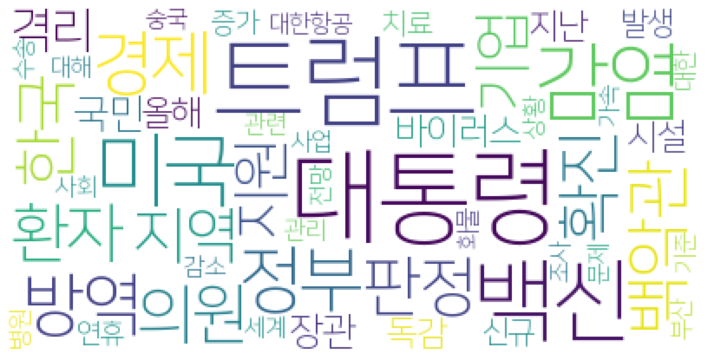

2020.10.06
['대통령', '백악관', '트럼프']
['이탈리아', '바이러스']
['경제', '이탈리아']
['탄산', '파프리카', '액체', '이산화탄소']
['이탈리아', '바이러스']
['마을', '판정', '주민', '이동']
['파산', '개인', '회생', '법원', '지난해', '증가', '연합뉴스']
['개인', '법원', '지난해', '파산', '회생', '증가', '연합뉴스']
['문자', '재난', '지자체', '정부', '발송', '조선', '긴급', '내용']
['중국', '폼페이', '장관', '위협', '문제', '일본']
['폼페이', '중국', '미국', '장관', '일본']
['마을', '전북']
['항공', '전세기', '외교부']
['버스', '지원', '승객', '사람', '고용']
['블랙홀', '노벨', '위원회', '질량', '겐첼', '물리학상', '은하', '천체', '올해', '연구', '아인슈타인', '우리', '펜로즈', '게즈', '초대', '발견']
['조선', '트럼프', '대통령', '백악관']
[]
['장관', '의원', '경향신문']
['러시아']
['병원', '환자', '감염']
['일본', '특별', '입국', '절차', '제도', '기업인', '인적', '교류', '한국', '트랙', '연합뉴스']
['입국', '확인']
['경향신문']
['장관', '문제', '중국', '일본', '폼페이', '미국', '방문', '지역']
['생계', '지원', '긴급', '경제', '복지', '가구', '급여']
['블랙홀', '겐젤', '물리학상', '교수', '노벨', '존재', '게즈', '수상자', '펜로즈', '증명', '박사', '이론']
['이태원', '거리', '사람']
['일본', '입국', '한일', '기업인', '한국', '조치', '격리', '절차', '교류', '재개', '외교부', '특별', '합의', '관계', '총리']
['환자', '보호자', '경향신문', '병원'

['접종', '수거', '백신', '물량', '마을', '조치', '당국', '격리', '이상', '이동', '차량', '확인', '감염', '집단', '과정', '대상', '가운데', '온도', '사례']
['원내대표']
[]
['원내대표']
['경제', '대응', '기획재정부', '자료', '아세안', '정책', '대한']
['원내대표']
['이천시', '하이닉스', '의료', '이천']
['외교부', '장관', '국민', '의원', '여행', '미국', '요트', '남편', '출국']
['탄산', '파프리카', '액체', '이산화탄소']
['원내대표']
['원내대표']
['병원', '환자', '보호자', '보건', '당국']
[]
['구리', '필름', '루미', '항균', '바이러스', '맥스', '플러스', '효과', '기업', '한양대', '생산']
['게임', '헝그리앱', '최강', '협객']
['운영', '기간', '중단', '채용', '시설', '근로자', '경우', '지급', '도서관', '실내', '강사', '재개', '인력']
['보호', '집단', '면역', '바이러스', '교수', '취약', '계층']
['백악관', '감염', '대통령', '판정', '취재', '확진', '직원']
['로보틱스', '대표', '로봇', '사업', '서비스', '기술']
['덕양구', '감염', '판정', '고양시', '주민', '보건소']
['확산', '재택근무', '직원', '아이', '전자', '추석', '연휴', '실시', '대상', '기간', '근무', '이후']
['원내대표']
[]
['집단', '면역', '주장', '교수', '우리']
['미국', '국민', '황교안', '대표', '방문', '계획']
['생산', '공장', '케이블', '전선', '폴란드', '부품', '인도', '통신', '계획', '전장', '시장']
['마을', '전북도', '감염', '격리', '검사', '전북', '추석', '정읍', '접촉', '판정', '가족'

['입국', '트랙', '절차', '한국', '합의', '우리', '일본', '기업인', '특별', '체류', '활동', '적용', '비즈니스', '양국', '인적', '재개', '조치', '금지', '정부']
['비타민', '효과', '치료', '감염', '면역', '바이러스', '복용', '보충', '제로', '내과', '연구', '예방', '교수', '연합뉴스', '기능', '염증']
['비타민', '효과', '치료', '감염', '면역', '바이러스', '제로', '염증', '보충', '내과', '연구', '연합뉴스', '기능', '복용', '예방', '교수']
['진단', '유전자', '감염', '경향신문', '긴급', '제품']
['경찰', '당시', '차벽', '집회', '위헌', '아이', '설치', '개천절']
['세트', '매출', '선물', '증가', '판매', '추석', '건강', '백화점', '대구', '지난해', '각각', '하락', '명품', '과일', '대비', '상승']
[]
['면역', '집단', '교수', '보호']
['연휴', '사례', '감염', '추석', '방역', '전파', '관련', '발생', '환자', '당국', '확인', '접촉', '확진', '지표', '추가']
['사례', '감염', '추석', '연휴', '방역', '전파', '지표', '환자', '확진', '접촉', '추가', '발생', '당국', '관련', '확인']
['절차', '격리', '일본', '기업인', '양국', '입국', '우리', '합의', '특별', '트랙']
['입국', '일본', '기업인', '한국', '정부', '절차', '경향신문', '격리', '트랙', '체류', '특별']
['병원', '환자']
[]
[]
['일본', '격리', '입국', '기업인', '절차', '특별', '한국', '트랙']
['입국', '우리', '일본', '기업인', '한일', '적용', '인적', '특별', '교류', '절차', '체류', '트랙', '격리'

['트럼프', '대통령', '마스크', '무시', '방역', '전문가', '발언', '미국']
['항불안제', '올해', '환자', '처방']
['로슈진단', '한국', '진단', '검사', '의료', '로슈', '맞춤', '치료', '사업', '환자', '기술', '미래', '데이터', '스케', '디지털', '시약']
['중소기업', '지원', '대통령', '경제', '수출']
['지바', '롯데', '선수']
['농산물', '꾸러미']
['고객']
['시설']
['진단', '제품', '허가', '키트']
['소득', '가구', '신청', '지원', '복지', '부산']
['슈로더', '투자', '트럼프', '대통령', '확진', '선거']
['물질', '수출']
['트럼프', '대통령', '동안', '퇴원', '백악관', '병원', '치료']
['백악관', '대통령', '판정', '양성', '트럼프', '감염', '대변인', '마스크', '지난', '취재', '확진', '보좌']
['경찰', '여명', '검사']
['판다', '제공', '초등', '와이즈캠프', '학습', '수업', '콘텐츠', '개뼈', '수학', '교과', '개념', '심화']
['토론', '바이든', '대통령', '트럼프', '퇴원', '후보', '대선']
['아동', '위기', '조사', '의원', '아동학대', '신고', '기간']
['바이러스', '생존', '피부', '독감']
[]
[]
['단계', '두기', '불명', '반장', '거리', '감염', '발생', '경로', '비율', '증가', '수가', '감소', '집단', '자체', '일일', '방역']
[]
['세계', '감염', '파리']
['일자리', '사업', '모집', '정읍']
['가구', '소득']
[]
[]
[]
[]
[]
[]
[]
['진단', '시약', '허가', '제품', '유전자']
['시대', '기관', '협력', '출연', '바이오', '한국', '연구원', '국가', '분야', '위해', '해결'

['국무회의', '경제', '대통령', '중소기업', '벤처기업', '기업', '지원']
['총리', '트럼프', '대통령', '존슨', '미국', '영국', '지도자', '투병']
['트럼프', '대통령', '백악관', '부산', '미국']
['광주', '공항', '올해', '무안공항', '여수공항', '활용']
['아이', '주유소', '방역']
['질환', '환자', '연구']
['연구', '질환', '환자']
['교수', '장관', '배우자', '생각', '일병', '자유', '개인']
['판정']
['청주공항', '이용', '지난해']
['집회', '차벽', '경찰', '통행']
['센터', '이성', '치료', '전문의', '수강', '환자']
['모임']
['리제', '치료', '사용', '항체']
['이후', '전날', '지역', '명대', '가족', '감염', '신규', '확진', '수도권', '발생', '가운데', '누적', '유입', '유지', '모임', '사례']
['국내', '신규', '지역', '격리']
['감사', '회계', '기업', '디지털', '비대', '응답']
['연구', '성과', '방역', '감염병', '사업', '교류']
['바이든', '대통령', '응답', '후보', '트럼프', '포인트', '여론조사']
['과세', '배당', '법인', '유보', '개인', '유사', '중소기업', '사내', '소득', '주주', '기업', '제도']
['대통령', '백악관', '트럼프', '병원', '비판', '메시지', '마스크', '지적', '국민']
['영향', '최소', '감사', '디지털', '응답', '회계감사', '업무', '플랫폼', '비대', '확산']
['수출', '이번', '진단', '키트', '계약', '녹십자', '엠에스', '제품', '유럽', '공급']
['가슴', '상품', '양치', '크게', '관련', '승닭']
['가슴', '상품']
['신규', '환자']
['부대', '포천시', '감염', '조

['연수', '교육청', '교재', '추진', '계획', '드라이브스루', '교습', '교육', '발송', '도학', '연합', '온라인교육', '예산', '소이', '문자', '강원도', '거나', '이번', '매년', '내용', '온라인', '학원', '관계자']
['대통령', '트럼프', '병원']
['트럼프', '대통령', '의료', '퇴원', '오후', '병원', '상태', '백악관']
['트럼프', '대통령']
['점유', '자동차', '증가', '판매', '국내', '판매량', '회복']
['트럼프', '대통령', '퇴원', '병원', '백악관', '선거']
['트럼프', '대통령']
['트럼프', '대통령', '백악관', '판정', '대변인', '양성', '경향신문']
['바이러스', '필터', '실내', '장치']
[]
[]
['트럼프', '대통령']
['공개', '수사', '신상', '운영', '노컷뉴스', '디지털', '교도소', '통해', '경찰', '베트남']
['백신', '접종', '상파울루', '정부']
['감염', '공기', '사람']
['위기', '지원', '가구', '복지', '정부', '증가', '발굴', '체납', '서비스', '시스템', '상반기', '행복']
['청문회', '상원', '배럿']
['증가', '사업', '개선', '매출', '전자', '실적', '이익', '대비', '영업', '스마트폰', '증권', '반도체', '리스트', '생활', '양사', '예상', '비용', '애널', '가전', '삼성']
['봉쇄', '금지']
[]
['위원', '위원장', '칭호', '중앙', '정치국', '회의', '위원회', '군사', '대회', '노동당', '결정', '전당', '원수', '전투', '통신']
['트럼프', '대통령']
['디지털', '교도소']
[]
['상주', '여성']
['수업', '브라질', '등교', '누적', '재개']
['퇴원', '대통령', '트럼프', '병원', '우리', '경향신문', '트

['판정', '백악관', '트럼프', '양성', '사실', '자신', '브리핑', '힉스']
['관광', '제주', '토론회', '마련', '대응', '위원장', '전략', '웰니스', '주제', '이후']
['정부', '누락', '발생']
['신고', '이데일리', '상장', '기업', '신규', '시장', '지난', '증권', '바이오', '예측', '수요', '메타', '리츠', '정정', '장사', '파마', '노브']
['백악관', '반응']
['백악관', '대변인', '확진', '판정']
['트럼프', '대통령']
['경제']
[]
[]
[]
[]
[]
['멜라', '니아', '여사']
['육상자위대', '감염', '대원', '투어']
['감염', '육상자위대']
['누락', '정부', '지난', '영국', '발생', '잉글랜드', '추적']
['폐광', '기금', '사업', '강원랜드', '강원도', '지역', '병원', '중단', '내년', '군립', '중이', '정선군', '납부']
['도쿄도', '감염', '일본', '환자', '가나가와현', '가운데']
['분노', '장애인', '취약', '사람', '건강', '불평등', '사회', '계층', '가족', '우리', '대한', '영향', '대피', '애인', '감정', '더욱', '비장', '경험', '또한']
['로펌', '변호사']
['감염병', '개발', '백신', '우리', '바이러스', '코로나바이러스', '홍역']
['자동차', '한국', '미국', '산업', '미래', '시장']
['이상', '프랑스', '지역', '금지', '봉쇄', '신규']
['가맹', '전국', '거리', '편의점', '기준', '점주', '매출', '지정', '규약', '자율', '소매', '확대', '때문', '담배', '본부', '평균', '점포', '지난']
['경향신문', '세계', '추정']
['국회', '부사', '기업', '국감', '증인', '대기업', '기업인', '간담', '관계자', '

['분야', '도서', '사회', '경제', '경영', '정치', '세계', '가장']
['채용', '지역', '인재', '공공기관', '한국', '취업', '설명', '참여', '부산']
['진단', '키트', '계약', '공급']
['공항', '이용', '포항', '지방']
['경제', '중소기업', '지원', '대통령', '역할', '수출', '창업', '벤처기업', '위기', '더욱', '혁신']
['바이오', '피톤', '치드', '씨엘', '바이러스', '시험', '출원', '물질', '결과', '효과', '특허', '사멸']
['미국', '사망자', '감염', '세계', '집계']
['차관', '국제']
['질환', '환자', '연구', '대조군']
['중소기업', '대통령', '지원', '위기', '역할', '수출']
['간호사', '뮤직비디오', '성적', '대상', '대한', '블랙', '핑크', '장면', '복장', '러브', '걸즈', '엔터테인먼트', '사랑', '공개', '직업', '고민', '의료', '해당', '등장', '관련', '보건']
['수용', '임시', '우한', '환자', '중국', '확산', '농구']
['중소기업', '대통령', '지원', '경제']
['중소기업', '경제', '혁신', '벤처기업', '우리', '지원', '대통령', '중심', '디지털', '창업', '기업']
['부대']
['환자']
['신규', '최근', '이상', '지난', '영업', '금지', '영국', '하루', '수가', '수도', '술집', '이후']
['이후', '최근', '이상', '지난', '영업', '금지', '영국', '신규', '하루', '술집', '수가', '수도']
['진단']
['국제', '보건', '차관']
['감염병', '성과', '연구', '사업', '예정', '세션', '대응', '교류', '발표', '감시', '대하']
['지역', '신규']
['창고', '아마존', '베이', '조스', '시위', '미국', '

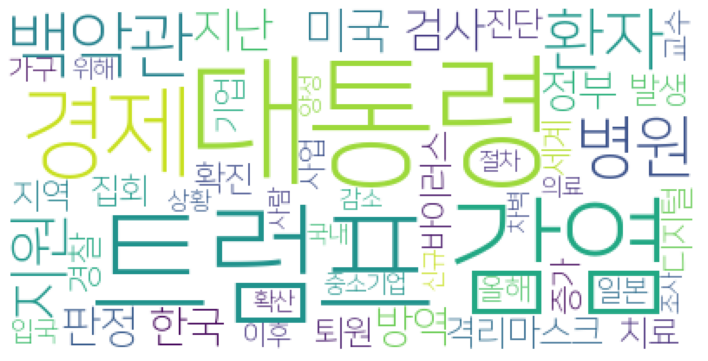

2020.10.05
['판정', '울산', '확진']
[]
['세계']
['가구']
[]
['환자', '병원', '가족', '요양', '어머니']
['허위', '사실', '유포']
[]
[]
['울산', '부산', '판정', '번의']
['병사', '경향신문']
['세계']
[]
['세계']
['트럼프', '바이든', '후보', '판정', '대통령', '당시']
['대통령']
['대통령']
['전세계', '감염']
['대통령', '트럼프']
['중국', '방한', '폼페이', '외교', '미국', '외교부']
['트럼프', '대통령', '건강']
[]
['대통령']
['판정']
['방한', '폼페이', '취소', '외교부', '외교', '장관', '부장']
['선수']
['대통령']
['부산', '서면', '당시', '포장마차', '시민', '사고']
['재정', '준칙', '국가채무', '마련', '비율', '위기', '시행']
['투표', '대통령', '트럼프', '투여', '발표', '렘데', '시비르']
[]
['바이러스', '라이스', '연구', '백신', '교수', '개발', '코로나바이러스', '간염', '단백질', '면역', '인체', '호턴', '사스']
['감염', '전세계', '인구']
['회장', '트럼프', '대통령', '참석']
['위해', '광장', '집회', '경찰', '차벽', '통행', '이번']
['백신', '독감', '중국', '가격', '이상']
['세계']
['세계']
['세계']
['공화당', '상원', '인준', '경향신문', '대법관', '청문회']
['증가', '가구', '위기', '서비스', '지원', '발굴', '복지', '상반기', '올해', '행복', '체납', '월세', '주거', '경향신문', '민간', '단수', '정부']
['경향신문']
['바이러스', '독감', '조선']
['염증', '증후군', '기관', '사례', '판정', '환자', '감염', '경향신문', '처음', '연휴']
['노벨', 

['도입', '독일', '국가', '재정', '준칙', '비율', '관리', '기준', '국가채무', '선진국', '정부', '운용', '수지', '적자']
['방역', '폐쇄', '뉴욕', '학교', '조처', '제한', '발생', '확산', '실시', '지역', '발표', '최대', '프랑스', '도시', '모든', '주간', '일부', '파리']
['사례', '치료', '질환', '이후', '감염', '검사', '모두', '발열', '경우', '방역', '신고', '부합', '제제', '소아', '청소년', '판정', '설명', '염증', '연관', '당국']
['경제', '점검', '방역', '연휴', '시설']
['발생', '연휴']
['진단', '제품', '시약', '사용', '바이러스', '검사', '확인', '국내', '유전자', '인식', '독감', '프라이머']
['활용', '통합', '재정', '비율', '준칙', '국가채무', '기준', '수지', '정부', '유연성', '탄력', '때문', '교수', '올해', '적용', '계산', '대비', '하나', '경제', '지표', '설명', '위기']
['가입자']
['폰데', '라이', '집행']
['폰데', '라이', '집행']
['사람', '단백질', '포유동물', '감염', '동물', '바이러스', '가능성']
['대통령', '방역']
['단풍', '설악산', '얼음', '관측', '기온']
['기술', '분야', '해커', '아이', '문제', '엔비디아', '스케', '지스트', '모색', '경진', '대회', '진단']
['교수', '무역', '글로벌', '디지털', '세계', '경제', '충격', '위기', '대응', '재정', '국제', '한국', '금융', '경기', '금융위기', '확대']
['확산', '봉쇄', '정부', '영국', '유럽', '지난', '확진', '체코', '조치', '보건', '신규']
[]
['산소', '주치의', '포화', '환자', '상태', '메

['장관', '교수']
['후보', '입장', '차원', '이기', '치료', '기간', '보고', '결정', '오히려', '당선', '때문', '대선', '부분', '협상', '영향', '범위', '미국', '선택', '경합주', '민주당', '차이', '바이든', '생각', '북한', '유세', '체적', '아마', '그것', '전략', '거기', '외교', '트럼프', '지금', '사람', '막판', '수도', '한국', '상황', '대화', '자기', '위원', '앵커', '이내', '정책', '김정은', '여기', '전망', '방식', '정부', '상태', '확진', '정도', '문제', '가능성', '대통령', '선거', '사실', '예상', '퇴원', '역전', '조금', '모두']
['지역', '독일', '동독', '서독', '인구', '경제', '사람', '바이러스']
['학교', '등교', '수업', '시험']
['협력', '리드', '백신', '개발', '화학', '생산', '협약', '체결', '바이러스', '사업']
['거래', '온라인', '배달', '음식']
['공원', '지역', '조치', '만덕동', '방역', '가게', '음식점', '주민', '북구', '명령', '감염', '위험', '상인', '집합']
['염증', '사용', '치료', '메타', '대통령', '트럼프', '환자', '투여', '지난', '청장', '초기']
['치료', '염증', '메타', '대통령', '트럼프', '환자', '투여', '청장', '지난', '초기', '사용']
['경찰', '차량', '집회', '금지', '개천절', '시위', '지난', '김창룡', '위험', '조치', '설치']
['이케아', '매장', '투자', '결정', '관계자', '가구', '계룡시', '규모', '업계', '사업']
['나훈아', '국민', '콘서트']
['사업', '교수', '기념', '표창', '대학']
['배달', '도보', '주문', '서비스', '사업',

['경제', '대통령', '디지털', '콘텐츠', '역량', '우리']
['지역', '민주주의', '경남', '혁신', '포럼', '참여', '사회', '국제', '시민', '세션']
['거래', '지난', '온라인쇼핑', '증가', '음식', '서비스', '역대', '모바일', '비중', '온라인', '쇼핑']
['의회']
['미국', '부동산', '투자', '이민', '국민', '이주', '변호사']
['교수', '확대', '경제', '글로벌', '디지털', '금융', '국제', '충격', '한국', '세계', '경기', '위기', '무역', '대응', '재정']
['대통령', '연휴', '방역']
['미국', '남성은', '결과', '입원', '분비', '반응', '사이토카인', '병원', '사망률', '염증', '비만', '위험', '여성', '면역', '남성', '환자', '사망', '연구', '경우', '세포', '대통령', '국내', '질환', '나이', '감염', '중증', '트럼프']
['기온', '영향', '방역', '바이러스', '생존', '날씨', '증가']
['여행', '추석', '거리', '사람', '두기', '사회', '지침']
['건강', '여성', '우울증', '운동', '스트레스', '전후']
['방역', '대통령', '경찰', '경제', '차벽', '국민', '기간', '감소', '연휴']
['발생', '경기도']
['경제', '교황', '프란치스코', '사회']
['증가', '시장', '지난', '판매', '비교', '쌍용차', '활동', '확대', '회복']
['거래']
['판정', '사례', '소아', '청소년', '염증', '결과', '부합', '경향신문', '회의', '퇴원', '증후군', '대본', '전문가']
['겐조', '파리', '패션', '프랑스', '디자이너', '일본', '브랜드', '부산']
['불법', '어선', '퇴거', '차단', '해경', '서해', '조업', '중국', '나포', '협정', '침

['재정', '정부', '준칙', '비율', '기준', '수지', '국가채무', '수준', '규정', '지적', '통합', '이내', '적자', '한도', '방식', '시행', '관리', '설정', '목표', '유지', '고려', '적용', '전문가', '교수', '의미']
['대통령', '트럼프', '치료', '퇴원', '의료', '차량', '백악관', '유세', '가능성', '상태', '병원']
['국민', '기업', '경제', '공정', '정치', '재벌', '신뢰', '경쟁', '리민', '질서', '발목', '정당', '입법', '지사', '찬성', '경쟁력', '위원장', '정부', '발휘', '국가']
['해커', '스케', '엔비디아', '지스트', '진행']
['해커', '스케', '엔비디아', '지스트', '진행']
['트럼프', '감염', '백악관', '행사', '대통령', '참석자', '공화당', '가든', '당시']
[]
[]
['포스트', '문화', '김포', '도시', '김포시', '토론회', '분야']
['부대', '감염', '휴가', '격리', '외출', '통제', '관련', '대상', '간부']
['재정']
['빌딩', '위원장', '당사', '노동', '경제', '국민', '개혁', '이데일리', '여의도', '공정', '관계', '개정', '남중', '김종인']
[]
['이상', '일보', '닭고기', '소비', '가정', '부산', '조사', '비량', '증가']
[]
['가장', '하락', '가격', '오피스텔', '분기', '광주', '매매', '전국', '지난']
['생명과학', '시험', '부산']
[]
[]
[]
['백신', '개발', '화학', '리드', '체결', '생산']
['준칙', '재정', '정부', '비율']
['소득', '조사', '진행', '원격', '학습', '우리', '환경', '경우', '이상', '계층', '전국', '제도', '상황', '대한', '문제', '수업', '교육', '정책', 

['단지', '동기', '국가', '산업', '수출', '생산', '상반기', '감소', '기업', '고용', '각각']
[]
['연휴', '확산', '방역', '이번', '지난', '기간', '거리', '두기', '주말', '증가']
['기간', '주말', '연휴', '확산', '방역', '이번', '지난', '거리', '두기', '증가']
['교회']
['개천절', '집회', '경찰', '금지', '설치']
['국민', '기업', '경제', '공정', '정치', '재벌', '신뢰', '정당', '찬성', '경쟁']
['분석', '바이러스', '염기서열', '기술', '정보', '해독', '개발', '스마트폰', '서열', '유전', '미니']
['형제', '의식', '화상']
[]
['집회', '경찰', '금지', '개천절', '설치']
[]
['겐조', '디자이너']
['형제', '의식']
['화상', '형제', '인천', '의식', '미추홀', '대화']
['백신', '개발', '리드']
['공원']
['진료', '국민', '대비', '감소']
['개발', '바이오', '테라', '진단', '기술', '분석', '연구', '검사', '감염병']
['의회']
['정부', '사태']
['증후군', '진료', '국민', '증가']
['백신', '개발', '화학']
['발생', '간부', '부대', '감염', '휴가', '해당', '격리', '대상', '관련']
['개발', '백신', '리드', '생산']
['상반기', '노컷뉴스', '산업', '단지', '국가', '수출', '생산', '감소', '각각']
['항만', '발생', '부산', '포항', '선원', '선박']
['백신', '개발', '리드', '지난', '화학']
['대통령', '트럼프', '판정', '사실', '양성']
['장관', '외교부', '미국', '여행', '남편', '요트', '상황', '생각', '교수']
['장관', '외교부', '미국', '여행', '남편', '요트', '상황',

['민주주의', '국민', '집회']
['민주주의', '국민', '집회']
['대통령', '지지율', '트럼프', '대한', '여론조사', '후보']
['경호원', '병원', '트럼프', '대통령', '지지자', '위해', '자신', '차량']
['여론조사', '대통령', '트럼프', '응답', '후보', '바이든', '포인트', '대선', '격차', '결과', '확진', '유권자', '지지율', '조사']
['대회', '전국', '개최', '예정', '북도', '내년']
['원산지', '표시', '배달', '위반', '단속', '판매', '문화']
['감염', '부대', '발생', '상황', '경로', '휴가']
['부대']
['최대', '신규', '지난', '미국', '확산', '기준', '위스콘신주', '입원', '집계', '주간']
[]
['대통령', '트럼프', '병원', '의료']
['트럼프', '배럿', '대통령', '미국', '백악관', '행사', '확진']
['집회', '방역', '한글날', '주장']
['겐조', '프랑스']
['부대', '감염']
['시비르', '대통령', '치료', '트럼프', '환자', '메타', '산소', '투여', '티코', '증상', '렘데', '보충', '상태', '사용', '의료', '지난']
['겐조', '부산', '일본']
['겐조', '부산', '일본']
[]
['추석', '연휴', '이번', '고속도로', '휴게소', '이용', '작년', '통행료']
['영국', '시스템']
['지역', '봉쇄', '뉴욕주']
['예술', '공연', '문화', '관객']
['패션', '겐조', '파리', '브랜드', '디자이너', '패션계']
['논란', '파리', '겐조', '브랜드', '욱일기', '일본', '프랑스', '상징', '패션계', '상품']
['트럼프', '대통령', '증시', '확진', '소식', '거래', '하락']
['백신', '바이러스', '접종', '생백신', '모두']
['시간', '병원', '

[]
['순례', '스님', '상월', '선원']
['접속', '기록', '직원', '공사', '결과', '근무', '관리']
['전자', '가전', '영업', '실적', '반도체', '이익', '스마트폰', '화웨이', '사업', '글로벌', '하락']
['의료', '국민', '기관', '의원', '병원', '진료']
['기업', '이익', '음식', '시장', '증가', '업종', '미국', '제일제당', '영업', '내년', '매출', '연구원', '비중', '식품', '주목', '상승', '해외', '대상', '부정', '올해', '국내', '풀무원', '세계', '농심', '영향', '주가', '조정', '실적', '오리온', '삼양식품', '하이트진로']
['방역', '시설', '수도권', '위험', '판매', '금지', '집합', '행사', '조처', '실내', '대해', '계속']
['이후', '연휴', '방역', '추석', '상황', '기간', '정부', '규모', '발생', '확산', '거리', '감염', '단계', '이번', '유행', '전날', '두기', '대책', '특별']
['특별', '단계', '대책', '연휴', '방역', '추석', '상황', '감염', '유행', '기간', '규모', '이후', '거리', '이번', '정부', '발생', '전날', '두기', '확산']
['지지율', '트럼프', '대통령', '후보', '포인트']
['트럼프', '지지율', '대통령', '후보', '포인트']
['가정', '공헌', '롯데', '건설', '활동', '사회', '지원', '지난', '계층', '아동', '청소년', '기부', '놀이']
['추석', '자제', '연휴', '동안', '국민', '확산', '보건', '정부', '상황']
['지역', '일부', '대상']
['건설', '대우건설', '이라크', '구역', '재개발', '가구', '수주', '운정신도시']
['복지관', '주민', '프로그램', '사회', '상황', '취약',

['장관', '아들', '명절', '휴가', '시민', '군대', '복무', '아버지']
['인턴', '채용', '정규직', '기업', '전환', '올해']
['장관', '교체', '개각', '대통령', '여권']
['파키스탄']
[]
[]
['대규모', '바이오', '분석', '테라', '진단', '연구', '개발', '기술', '감염병', '검사']
[]
['감염', '경로']
['환자', '교수']
['트럼프', '시나리오', '미국', '하락', '부양책', '대통령', '경우', '이후', '판정', '다시', '국정', '시장', '상태', '운영']
[]
[]
['영화관', '업체', '신용등급', '강등', '지난']
['바이러스', '공기', '농축', '개발', '독감', '교수', '입자', '농도', '포집', '기술']
['연휴', '중국', '기간']
['사람', '봉쇄', '미켈레', '이야기', '이탈리아', '사랑']
[]
[]
['경매', '시장', '자금']
['주택', '전달', '셋값', '상승', '지난달', '개월', '전국', '오름', '지역', '승률', '가장', '기록', '수도권']
['부대', '간부']
['부대', '간부']
['겐조']
['학살', '북한', '유엔']
['지급', '경제', '조선이공대', '학생', '특별', '장학금', '대학']
[]
['달러', '투자자', '전망', '대선', '대한']
[]
['추석', '연휴', '방역', '중앙', '대책', '본부']
['발전', '동포', '세계', '조국', '여러분', '한인', '방역', '재외동포', '대한민국', '대통령', '협력', '안부', '개국']
['감염', '부대', '발생']
['경제', '감염', '판정']
['허위', '사실', '유포']
['경로', '부대', '확진', '감염', '격리']
['격리', '부대', '확진', '감염', '경로']
['경제']
[]
['경제', '관계', '사태', '노동법',

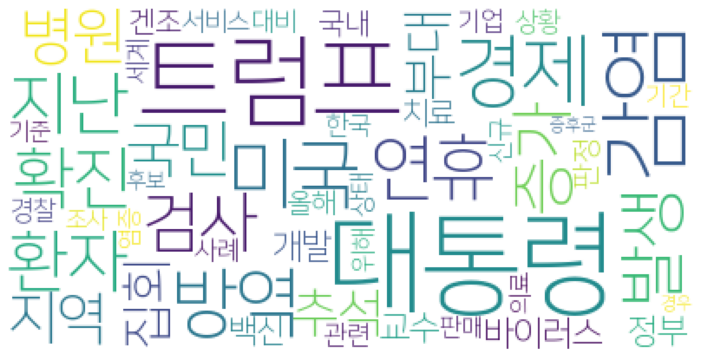

2020.10.04
['정기', '성지순례', '사우디', '하루']
['북한', '위원장', '우리', '사살', '대한']
['방역', '감염', '부산시']
[]
[]
['발생', '누적']
['등교', '수업', '이후', '교육청', '추석', '연휴', '학습', '온라인']
['집회', '개천절', '국민']
[]
['영국']
[]
['연휴', '추석']
[]
['관리', '질병', '접종', '백신', '의료', '기관', '무료', '중단']
['시흥', '축제', '갯골', '시흥시', '갯골랜', '합창단', '영상', '미술', '대회']
['트럼프', '대통령', '여론조사', '바이든', '후보']
['연휴', '지역']
['여행', '장관', '교수', '요트', '확산', '국민', '외교부', '남편', '구입']
[]
['판정', '격리']
[]
[]
['국회', '경제', '원내대표', '정기', '여야', '추천', '민생', '민주당', '선정', '공정', '국민']
['로봇', '사람', '대화', '반려']
['후보']
['동물원', '동물', '문제', '관리']
['실내', '동물', '동물원', '문제', '관리']
['집회']
['부산', '계속', '감염', '부산시', '집합', '집단', '의원', '관련', '추석', '발생', '이후', '목욕탕']
['그린', '사업', '석탄', '정부', '베트남', '한전', '화력발전', '환경', '정책', '기후', '개도국', '결정', '한국', '이사회', '참여', '화력발전소']
['감염', '트럼프', '바이든', '대통령']
['트럼프', '대통령', '대선', '후보', '바이든']
['대통령', '상원']
['이데일리', '트럼프', '시장', '경제', '금융']
[]
['트럼프', '대통령', '병원', '입원', '상태', '며칠']
['집회', '경향신문', '의원', '국민', '원내대표', '개천절']
['영국']
['출동', '

['전문', '대통령', '트럼프', '위로', '기원', '미국', '판정', '부부']
['폼페이', '장관', '미국', '방한', '방문']
['대통령', '확진', '트럼프', '백악관', '병원', '치료', '입원', '의회', '중인', '동안', '의료', '대선', '병세', '상원', '베데스다', '공화당', '판정', '의원']
['기록', '만선', '유럽']
['취업', '응답', '기업', '대학생', '작년', '채용']
['대통령', '입원', '동영상', '트위터', '트럼프', '백악관', '병원', '확진', '대선', '통해', '언론', '행사']
['수출', '증가', '개월', '시장', '품목', '올해', '이후', '중국', '성장']
['트럼프', '가든', '검사', '행사', '확진', '대통령', '마스크', '판정', '백악관', '크리스', '대선', '감염', '후보', '토론', '언론', '준비', '대법관', '지명', '보수', '참석자', '가능성', '연방', '공화당']
['토론', '크리스', '대통령', '백악관', '검사', '행사', '확진', '마스크', '판정', '대법관', '가능성', '트럼프', '감염', '보수', '후보', '연방', '가든', '지명', '대선', '언론', '참석자', '공화당', '준비']
['검사', '확진', '토론', '백악관', '대통령', '행사', '감염', '가든', '대법관', '판정', '참석자', '연방', '대선', '후보', '마스크', '공화당', '보수', '가능성', '트럼프', '지명', '준비', '언론', '크리스']
['나훈아', '추석', '공연', '부산', '국민']
['크루', '요트', '교수', '여행', '미국', '블로그', '나이', '남편', '정리', '위해', '준비', '장관']
['상온', '현재', '중단', '접종', '독감', '백신', '무료', '재개', '노출', '사고', '

['현장', '금지', '방역', '제주', '경제', '지난', '포커', '조치', '제주도', '카드게임']
['집합', '금지', '방역', '제한', '경제', '조치', '시설', '대해', '완화']
['방역', '집회', '시민', '금지', '질문', '하나', '차벽', '사회']
[]
['토론', '포인트', '예정', '트럼프', '대통령', '확진', '바이든', '선거', '부통령', '마스크', '경합주', '후보', '대선']
['판매량', '기아차', '미국', '지난달', '증가', '이후', '현대차']
['온라인', '의원', '쿠팡', '업체', '유통', '판매', '소명', '경로', '입점', '황씨', '연락', '조씨', '상품', '물건', '명세서', '플랫폼']
['부산', '발생', '항만', '선원', '일보', '선박', '입항']
['세계', '출항', '만선', '화물', '컨선', '부산']
['바이러스', '투표', '대통령', '트럼프', '대선', '후보', '미국', '경우']
['대통령', '트럼프']
['원내대표', '사건', '북한', '방역', '공무원', '우리', '지시', '장관', '사살']
['장관', '남편', '교수', '국민', '요트', '논란', '여행', '미국', '구매', '공직자', '외교부', '계획']
['집회', '국민', '산성', '경찰', '광화문', '봉쇄', '방역', '불법', '대통령']
['연휴', '중국', '관광', '지난해']
['대통령', '트럼프', '콘리', '의료', '상태', '발언', '도스', '치료', '동영상', '산소호흡', '백악관']
[]
['기아차', '딜러', '조사', '사업', '인도', '승용차', '브랜드', '부문']
['경찰', '집회', '국민', '광화문', '봉쇄', '민주당', '불법', '한글날', '보수', '예고', '방역', '단체', '헌법']
['집회', '국민', '광화문', '봉

['외교부', '장관', '명예', '교수', '여행', '생각', '출국']
['단계', '대상', '의료', '질병', '마스크', '착용', '과태료', '의무', '시설', '거리', '두기', '관리', '종사', '사람', '부과', '행정명령', '방안']
['장관', '국민', '남편', '대해', '목소리']
['양국', '협상', '기업인', '입국', '합의', '완화', '이번', '상황']
['환자', '트럼프', '대통령', '렘데', '시비르', '약물', '치료', '항체', '초기', '교수', '증상', '억제', '감염', '중증', '미국', '내과', '효과', '증식', '바이러스', '사용']
['자제', '국민', '여행', '해외여행', '교수', '장관', '권고', '정부', '외교부']
['교육', '시스템', '방향', '강의', '화생', '실시간', '화상']
['사회', '영업', '고객', '대면', '보험', '전씨', '설계', '체온계', '미팅']
['대표', '경제', '방역']
['집회', '경찰', '차벽', '금지', '통행', '광장', '시위', '설치', '경향신문']
['가구', '분양', '작년', '주택', '감소', '아파트', '물량', '수도권', '대비', '시장', '전국', '지방']
['병원', '격리', '환자', '의료인', '관리']
['가격', '아파트', '신고', '집값', '거래', '가가', '부동산', '시장', '이후', '매물', '규제', '라며', '정부', '전망', '저가', '보합']
['좌석', '예매', '명절', '광주', '버스', '승객', '추석']
['시설', '감염', '거리', '환자', '조금', '행사', '연휴', '방역', '상황', '국민', '관리', '이번', '마스크', '기간', '단계', '부과', '확산', '센터', '안전', '노력', '과태료', '방안', '운영', '양상', '특별', '두기'

['행복', '페이', '대구']
['학생', '용인', '용인시', '확진', '대지', '판정', '가족', '감염', '지난', '죽전고', '추가', '환자']
['학생', '용인', '용인시', '확진', '대지', '판정', '가족', '추가', '감염', '죽전고', '지난', '환자']
['입원', '부산', '확진', '판정', '환자', '검사', '감염']
['시설', '집합', '방역']
['외교부', '장관', '해외여행', '자제', '정부']
['신청', '여명', '지급', '원금', '대상', '절차', '대한', '추석', '정부', '추가']
['사실', '지금', '원내대표', '생각', '사과', '전체', '여당', '주장', '신성범', '주호영', '실제', '어쨌든', '대한민국', '처분', '우리', '그것', '오늘', '하라', '대통령', '국정감사', '사건', '아들', '북한', '추석', '아마', '일단', '그게', '육성', '앵커', '부분', '나훈아', '자기', '우선', '처음', '집회', '의원', '확인', '내용', '추미애', '말씀', '마지막', '필요', '장관', '때문', '이야기', '입장', '대한', '연휴', '하나', '그다음', '가지', '조사', '정부', '여러', '기본', '문제', '다른', '보고', '어제', '대해', '관련', '법무부', '야당', '이번', '사살', '국민', '김형주', '지시', '국방부', '경찰', '휴가', '보좌']
['로봇', '랜드', '입장', '추석']
['방역', '위험', '집합', '부산시', '시설', '감염']
['집회', '경찰', '정부', '총리']
['병원', '다나']
['요청', '여행', '장관', '외교부', '배우자']
['판매', '전기차', '자동차', '크게', '수소차', '시장', '올해', '판매량', '업체', '기아차', '기록', '기간', '대의', '동기',

['복구', '지급', '수해', '정부', '충북도', '국비', '사업', '지역', '피해']
['복구', '지급', '수해', '정부', '충북도', '국비', '사업', '지역', '피해']
['프로그램', '서비스', '제품', '이상', '부산']
['제품', '프로그램', '서비스', '이상', '부산']
['여행', '외교부', '장관', '교수']
['여행', '외교부', '장관', '교수']
['연휴', '집회', '정부', '방역', '어르신', '국민', '감염']
['지난']
['판정', '자가', '확진', '격리', '전북', '목욕']
['경제', '내년', '국내', '보고서', '예상']
['발생', '가정폭력', '지난해', '연휴', '추석', '범죄', '신고', '감소', '대비']
['백악관', '트럼프', '대통령', '루나']
[]
['백악관', '트럼프', '대통령', '루나']
['기간', '지역', '검사', '입원', '고향', '전체', '요양원', '지금', '이번', '앵커', '부산', '단계', '북구', '안정', '환자', '류재복', '집단', '집회', '등교', '나흘', '병원', '감염', '연휴', '상황', '동안', '고등학교', '정도', '증상', '어르신', '본격', '접촉', '계속', '사람', '정세균', '방역', '추석', '수업', '우리', '결정', '일부', '조금', '때문', '정부', '그다음', '거리', '확진', '학생', '얘기', '국민', '광주', '발생', '유지', '말씀', '방침', '사회', '자릿수', '최대', '영향', '방향']
['국민', '외교부', '장관', '남편']
['국민', '외교부', '장관', '남편']
['국민', '방역', '광화문']
['지원']
['관련', '야당', '조사', '사실']
['원내대표', '북한', '대해', '방역', '국민', '우리', '정보', '경찰', '정부', '관련', '

['환자', '추가', '부산', '접촉', '관련', '격리', '입원', '종합병원', '검사', '부산시']
['트럼프', '대통령', '미국']
['트럼프', '대통령']
['베트남', '권고', '여행', '지역', '교수', '감염', '장관', '최소', '정부', '지난', '방문', '중국', '해외여행']
['대회', '제주', '방역', '조치']
['한글', '문화', '행사', '한글날', '진행', '공연', '세종', '세종대왕', '학술', '부문', '한국']
['대한', '검찰', '국감', '국민', '경우', '국정감사', '청와대', '장관', '위원회', '훼손', '국방부', '예상', '관련', '민간인', '관심', '아이', '올해', '대상', '비판', '국회', '집중', '참고인', '문제', '북한', '사살', '의원', '정부', '추미애', '전망', '사건', '야당']
['우리나라', '글레', '리아', '파울러', '감염', '환경', '정책', '미국', '아메바']
['추석', '범죄', '경제', '감소', '범죄예방', '명절', '연휴', '신고', '경찰']
['추석', '명절', '평균', '범죄', '신고']
['사업', '일자리', '부산', '지역', '일보']
['사업', '일자리', '부산', '지역', '일보']
[]
[]
['관련', '사건', '정보', '우리', '국민', '북한', '원내대표', '사살', '공무원', '대해']
['정보', '우리', '국민', '북한', '원내대표', '사살', '관련', '공무원', '대해', '사건']
['기업', '목표', '경영', '유지']
['지원', '대출', '신용', '경기', '경향신문', '신청', '접수']
['여행', '아이']
['유적지', '메소포타미아', '이후', '중심', '신앙', '아르', '히말라야', '성좌', '모자', '콤마', '이자', '메이', '이유', '거리', '인공', '일

['올해', '노벨상', '세계', '교수', '수상자', '후보', '분야', '과학', '거론', '시상식', '노벨', '문학상', '연구', '발표', '스웨덴', '미국']
['휴게소', '방역', '운영', '연휴', '한국', '도로공사', '이용']
['트럼프', '대통령', '바이든', '대선', '후보']
['개최', '온라인']
['일본']
['백악관', '트럼프', '보좌', '대통령', '루나', '확진', '판정']
['개천절', '원내대표', '집회', '국민', '의원', '주호영', '방역']
['포천시', '부대']
['대통령', '트럼프', '미국']
['퍼레이드', '카니발', '삼바', '리우', '연기', '거리', '브라질', '학교', '내년']
['대회', '올림픽', '일본', '정부', '입국', '개최', '도쿄올림픽', '확산']
['영국', '신규']
['부대']
[]
['포천시', '부대']
[]
[]
['원내대표']
['연휴', '제주', '방역', '제주도']
['광주', '방역']
['감염', '집단', '방역', '예배', '출입', '지난']
['지급', '원금', '추석', '신청', '대한', '절차', '시작', '대상', '지원']
[]
[]
['마스크', '출원', '특허', '조절']
['감염', '확진', '전시', '방역', '확산', '남성']
[]
[]
['예술', '공연', '문화', '관객']
['마스크', '과태료', '착용', '정부', '대상', '단계', '시설']
['원내대표', '국회']
['원내대표']
['집합', '방역', '시설', '금지', '조치', '광주', '연휴']
['추석']
['청주', '판정']
['집합', '금지']
['영국', '하루']
['승리', '포인트', '트럼프', '바이든', '확진', '여론조사', '이후']
['대통령', '트럼프', '면서', '영상', '입원', '병원']
['펜스', '부통령', '백신']
[]
['일정',

['기아차', '부문', '딜러', '자동차', '인도', '조사', '사업', '차지']
['여행', '해외여행', '교수', '미국', '정부', '외교부', '권고', '요트', '주의보']
['구스', '상품']
['신규']
['신청', '시작', '지원', '지급', '원금', '대상', '절차', '추석', '대한', '감소', '소득']
['학술', '한국어', '한글', '문화', '행사', '한국', '세종', '우리', '세종대왕', '표창', '주간', '한글날', '대회', '문화원', '주제', '참여', '부문', '공연']
['대회', '제네시스', '선수', '챔피언십', '국내', '제공', '번홀']
['바이든', '트럼프', '대선', '지지', '대통령', '후보', '유권자', '토론', '조사', '펜실베이니아주', '결과', '플로리다주', '응답', '포인트', '백인', '대한']
['크리스']
['외교부', '장관', '요트', '여행', '교수', '구입', '출국']
['기록', '발생', '이데일리']
['기록', '발생', '이데일리']
['광주', '경제']
[]
['대통령', '트럼프']
['트럼프', '대통령']
['고객', '팝콘', '맛소금', '미원', '상품', '디자인', '증가']
['원금', '미만', '재난', '이상', '소득', '사용', '비율', '가구']
['신규']
['흡연', '불법행위', '항공']
['이상', '프로그램']
['경제', '프로그램', '서비스', '제품']
['부산', '기업', '온라인']
['신규', '명대']
[]
['광고', '적발', '허위', '예방']
[]
['트럼프', '우리', '지난']
['감염', '각각', '발생', '신규', '확인', '근무', '전날', '중랑구', '국내']
['여행', '미국', '교수', '외교부', '요트']
['신규', '명대']
[]
['인천', '거주', '환자', '발생', '해외', '감염', '전

['버스', '이용', '라운지', '경기도']
['청년', '지원', '취업', '교육', '구직', '활동', '카드', '이번', '선정', '프로그램']
['글로벌', '장비', '부품', '개발', '국산', '기업', '지원', '기술', '사업', '진출', '경기도', '통해']
['재정', '경제', '흑자']
['흑자', '재정', '경제']
[]
['진행', '팬덤', '규모', '기업', '빅히트', '엔터테인먼트', '버스', '투자자', '방탄소년단', '경쟁률', '카카오', '공모', '국내', '투자', '온라인', '게임', '일반', '청약', '그룹', '증권', '네이버', '한국']
['물가', '재정', '발표', '흑자', '수출']
['지침', '정부', '접종', '백신', '예방접종', '관리', '무료', '대상', '국가', '가능성', '경제', '위탁', '기관', '조사', '질병', '의료', '운송', '독감', '노출', '이번', '상온']
['프랑스']
['대통령', '트럼프', '상태', '시간', '소식통', '현지', '지난', '진단', '선거']
['상황', '연휴', '방역', '수가', '검사', '기간', '명중', '당국', '성률', '추석']
['이탈리아', '인공', '지능', '기술', '다른', '나라', '가격']
['중국']
['비교', '기업가', '상장', '엔터테인먼트', '투자자', '증권', '예측', '투자', '기업', '바이오', '빅히트', '시장', '관사', '이상', '주가', '개인', '참여', '기준', '공모', '바이', '밴드', '진단', '게임', '파마', '메타', '피플', '올해', '희망', '카카오', '관심', '오메', '평가', '미코', '기관', '코넥스', '노브', '모주', '청약', '제시', '최근']
['수가', '연휴', '검사', '명중', '성률', '방역']
['대통령', '트럼프', '의료',

['신용', '신규', '금액', '경우', '대표', '대출', '은행', '비대', '금리', '대면', '상품', '기준', '기존', '영업', '시중', '가운데', '포인트', '비중', '인터넷']
['판정', '트럼프', '대통령', '치료', '대선', '항체', '콘리', '주치의', '캠프', '부통령', '시비르', '렘데', '개발', '투약', '진행', '후보', '예정', '미국', '리제', '백악관', '본부장']
['단체', '대표', '업종', '경제', '상의', '재계', '전경련', '목소리', '정부', '공동', '기업', '과거', '행사', '협회', '관계자', '상법', '역할', '의견']
['원금', '연휴', '시작', '공인', '지급', '대상', '추석', '신청', '절차', '정부', '대한', '가동', '희망', '감소', '소상', '소득', '아동', '지원']
['양국', '입국', '이번', '협상', '일본', '합의', '기업인', '제한']
['규모', '차입', '재정', '증권', '이자', '정부', '일시', '올해', '기준']
['형태', '기능', '아이폰', '갤럭시', '스마트폰', '카메라', '화면', '출시', '전자', '시리즈', '인치', '가격', '사용', '제품', '탑재', '국내']
['시간', '출퇴근', '기능', '아이', '업무', '명상']
['운임', '이후', '해운업', '선박', '대비', '공급', '급등', '감소', '선사', '지난', '글로벌', '노컷뉴스', '역량']
['이불', '구스', '차렵', '침구', '사용']
['그룹', '달성', '푸드', '매각', '사업', '올리브영', '아이', '베스트', '주식회사', '뚜레쥬르', '브랜드', '자금', '월드', '제일제당', '통해', '최근']
['매출', '감소', '대형', '마트', '사태', '증가', '수요']
['매출', '백화점', '업계

['판정', '검사', '양성', '강화군']
['바이든', '유세', '부통령', '트럼프', '대통령', '바이러스', '판정', '음성', '감염', '대선', '레이스', '선거', '캠프']
['제네시스']
['입소', '판정', '요양원', '치매']
['폼페이', '국무부', '한국', '장관', '아시아', '외교부', '방문', '방한']
['재활용', '장관', '연휴', '폐기물', '수거', '처리']
['수거', '장관', '재활용', '연휴', '폐기물', '처리']
['감소', '상황', '확산', '경제', '산업', '전월', '대비', '한국', '생산', '개월', '포인트', '심리', '이후']
['인천', '판정', '결과', '양성', '거주', '검체', '강화군', '검사', '공개']
['대표', '세계']
['금융', '유통', '프로젝트', '공공', '솔루션', '그룹', '포스코', '사업', '시작', '산업', '제품', '도입', '개발', '분야']
['연구원', '경제', '내년', '국내']
['팝콘']
['승률', '강남', '상승', '아파트', '셋값', '연속', '전세', '가격', '포인트', '전주', '지난달', '상승세', '유지', '기록']
[]
['울산']
['대회', '일본', '도쿄올림픽', '방안', '위해', '입국', '검토', '개최']
['인천', '확진', '추석', '판정', '검사', '강화군']
['트럼프', '대통령']
['장관', '국무부', '아시아', '방문', '폼페이', '일본', '일정', '한국', '몽골', '순방']
[]
['대비', '허가', '가구', '물량', '작년', '주택', '분양', '착공', '실적']
['보수', '경찰', '광화문', '집회', '차벽', '교수', '대통령', '광장', '단체', '사진', '일대', '국민', '차량', '산성']
['지급', '원금', '절차', '이번', '신청']
['전자파',

['휴게소', '연휴', '오늘', '방역', '만남', '광장', '특별', '마지막', '이용', '고속도로']
['전라북도', '생활임금', '노동자', '결정', '민간', '적용']
[]
['집회', '라며', '경제', '국민']
['한국', '올해', '중국', '성장', '경제']
['경제', '대표', '세계']
[]
['폼페이', '장관', '방문', '아시아']
['지원', '진출', '기업', '국산', '부품', '개발', '글로벌', '통해', '경기도', '기술', '사업', '에이', '직스']
[]
['지난달', '전주', '보증금', '아파트', '상승', '연속', '승률', '셋값', '전세', '강남', '가격', '기록']
['사료', '역사', '통신', '전시', '체험']
['임기', '경기', '경기도', '지사', '만료', '재단', '교체']
['트럼프', '대통령']
['차량', '집회', '보수', '광화문', '단체', '정부', '개천절', '경찰', '통제', '봉쇄', '대규모', '한글날']
['대출', '신용', '비대', '은행', '대면']
[]
['대통령', '트럼프', '면서', '영상', '입원', '병원']
['기소', '도박', '불법', '범죄', '감소', '올해', '스포츠', '전문가', '관련', '확산']
['주문', '음성', '오스', '결제', '모델', '소비자', '티원', '브레인', '기술']
['국민']
['추가', '학생']
['무역', '학과', '사업', '사례']
['대통령', '트럼프', '시점', '확진', '주치의', '판정', '진단', '시간', '기자회견', '검사', '백악관']
['대표', '방역']
['팝콘', '맛소금', '상품', '미원', '디자인', '고객']
['정부', '지급', '원금', '대상', '절차', '신청', '추석', '지원', '연휴', '소득', '감소', '소상', '시작', '대한', '공인', '희망'

['연휴', '전날', '추석', '신규', '감염', '명대', '지역', '인천', '양성', '판정', '수도권', '발생', '누적', '경기', '지난달', '이후']
['컨테이너선', '세계', '해운', '운임', '지난', '선박', '초대형', '운항', '선복량', '확보', '물동량', '개선', '상황', '선사', '목표']
['지난', '컨테이너선', '상황', '세계', '해운', '운임', '선박', '물동량', '개선', '선사', '초대형', '운항', '선복량', '목표', '확보']
['폐업', '브이', '영상', '유튜버', '시작', '로그', '운영', '지난달', '과정', '식당', '핏블리', '호텔']
['교육', '시스템', '방향', '실시간', '오프라인', '강사']
['화생', '실시간', '강의', '교육', '방식', '영업']
['음주', '스트레스', '홈술']
['음주', '홈술', '스트레스']
['환자', '발생']
['경남']
['한글', '학술', '문화', '행사', '한글날', '우리', '진행', '공연', '세종', '세종대왕', '부문', '한국']
['실시간', '교육', '시스템', '방향', '강의', '화생', '화상']
['원금', '지급', '절차']
['교육', '경제']
['교육', '학습자', '강의', '실시간', '시스템', '비대']
['발생', '주택', '순방', '바이든', '트럼프', '미국', '조정', '신종', '코로나바이러스', '교사', '보증금', '전문', '보기', '가운데', '입국', '격전', '신청', '며칠', '분쟁', '감염증', '한국', '고속도로', '양국', '장관', '대통령', '결과', '어린이집']
['상황', '선거', '얘기', '대통령', '트럼프', '시장', '부양책', '라며', '승리', '미국', '경우', '영향', '확진', '상태', '입원', '의료']
[]
['대통령', '트럼프', '

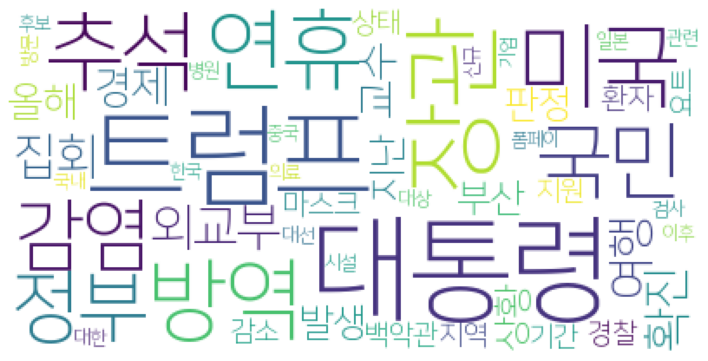

2020.10.03
['정부', '시위']
['검사', '판정']
['트럼프', '대통령', '대선', '대한', '미국', '확진', '전망']
['경제', '콘웨이', '백악관', '판정', '배럿', '지명', '의원']
[]
['추가', '확인', '병원', '검사']
[]
['두기', '방역', '거리', '정책']
['온라인', '시장', '라이브', '커머스', '방송', '전통']
['검사', '판정', '지명', '의원', '백악관', '트럼프', '대통령', '참석자', '공화당', '배럿', '행사', '콘웨이', '상원의원']
['대전', '확진', '남성']
['집회', '대표', '불법']
[]
['집회', '국민', '시위', '시민', '인근', '광화문', '광장', '경찰', '기자회견', '단체', '우리', '대위', '도심', '보수', '자유', '정부']
['온라인']
['환자', '판정', '부산', '오늘', '확진', '감염', '어제']
['여행', '요트']
['트럼프', '대통령', '우드워드', '지난', '인터뷰']
['집회', '차량', '시위', '경찰']
['집회', '자유', '광화문', '경찰', '개천절', '광장']
['검사']
[]
['캠핑', '텐트']
['대통령', '트럼프', '노컷뉴스', '치료']
['연휴', '가운데', '방역', '관련', '현재', '검사']
['전주시', '연휴']
[]
['외교부', '격리', '자가', '장관']
['일본']
['여행', '외교부', '요트', '장관', '배우자', '일병', '미국', '출국', '목적', '구입']
['여행', '요트', '외교부', '장관', '배우자', '일병', '미국', '출국', '목적', '구입']
[]
['때문', '사과', '얘기', '조사', '정보', '입장', '대통령', '우리', '정부', '지금', '북미', '김정은', '공동', '종전', '공무원', '선언', '답변', '이제', '말씀'

['검찰', '진술', '국민', '정치', '조사', '결과', '기자회견', '이야기', '보도자료', '내용', '의혹', '과정', '장관', '수사', '이번', '법무부', '지시', '사건', '누구', '공개', '사람', '연락', '보좌', '동부', '카카오', '논란', '정황', '관련', '판단', '형사', '제기', '경우', '발표', '아들', '부분', '사실', '설명', '김관', '문제', '추미애']
['국민', '광화문', '경찰', '대변인']
['트럼프', '대통령', '확진', '판정', '행사']
['여사', '인도', '관계', '간디']
['기념', '총리', '관계', '간디', '인도', '여사', '나라', '축사', '카디', '웨비', '영상', '모디']
['축사', '전통', '운동', '나라', '인도', '간디', '여사', '관계', '기념', '웨비', '행사', '위원회', '직물', '카디']
['간디', '인도', '여사', '물레', '직물', '카디', '나라', '행사', '모디', '상징', '총리', '관계', '전통', '기념', '문재인']
['인도', '간디', '여사', '방문', '대통령', '평화', '기념', '모디', '축사', '총리']
['웨비', '간디', '인도', '여사', '관계']
['간디', '인도', '여사', '관계', '축사', '이번', '물레', '위원회', '웨비', '나라', '카디', '직물', '참석', '전통', '모디', '총리']
['카디', '모디', '기념', '여사', '간디', '인도', '관계', '총리', '직물', '전통', '나라', '물레', '축사', '주년', '운동', '행사', '문재인', '탄생', '위원회', '참석', '변화', '문화', '평화', '웨비', '우의', '상징', '정부', '연대', '한국', '정신']
['렘데', '시비르', '트럼프', '대통령', '치료', '파미셀', 

['연휴', '이후', '확인', '내용', '검사', '이동', '추석', '발생', '거주', '경우', '사례', '부산', '우리나라', '환자', '기간', '방문', '감염', '연구', '유행', '확진', '조금', '다른', '해당', '증상', '상황', '진단', '시설', '통해', '판정', '운동선수', '방역', '지난']
['린지', '지역']
['용인', '확진', '학생', '환자', '추가', '대지', '판정']
['용인', '확진', '학생', '환자', '추가', '대지', '판정']
['연휴', '기간', '감염', '추석', '집회', '이번', '확산', '지역', '발생', '방역', '대규모']
['집회', '이용', '광장', '차량', '일부', '기자회견', '시민', '참가자', '인근', '오후', '광화문', '광화문역', '항의', '차단', '드라이브', '경찰', '세종', '일대', '통행', '출입', '자유', '시위', '보수', '대위', '단체', '통제', '경향신문', '오전']
['치료', '대통령', '항체', '트럼프', '콘리', '주치의', '렘데', '중인', '개발', '통신', '백악관', '투약', '중증', '리제', '시비르']
['단계', '비율', '변화', '상황', '혼술']
['변호사', '광화문']
['집회', '경제', '총리']
['정부', '광화문', '집회', '비판']
['광화문', '기자회견', '목사', '경찰', '광장', '관계자', '사랑', '교회', '집회', '대통령', '시위', '서신', '형태']
['환자', '격리', '부산', '병동']
['연방', '통해', '결정', '대신', '주민', '사건', '만일', '대법관', '상황', '후보', '시설', '제도', '더욱', '누구', '급여', '오바마', '소송', '보수', '의견', '법원', '임명', '세상', '제기', '인준', '경우', '당시', '동

['추석', '거리', '감염', '방역', '두기', '부본', '기간', '발생', '부장', '이후']
['대통령', '감염', '트럼프', '누구', '연휴']
['하락', '기업', '채권', '실적', '투자', '미국', '가능성', '증권', '위원', '기대', '가격', '대통령', '달러', '대선', '전망', '불확실', '신규', '정책', '최근']
['포스터', '추석', '장관', '차관']
['부산', '환자', '입원', '격리', '접촉']
['트럼프', '생각', '대해', '정도', '진행', '토론', '대한', '이야기', '김정은', '영상', '병원', '마스크', '보좌', '문제', '그다음', '과연', '오늘', '여러', '트럼트', '지금', '사실', '경우', '유세', '증상', '가능성', '다시', '사람', '계속', '결정', '대행', '통해', '대통령', '본인', '확진', '매우', '일단', '후보', '권한', '정엽', '앵커', '가지', '판정', '결과', '상황', '현재', '건강', '선거', '부분', '취소', '직무', '모습', '내용', '워낙', '다른', '코로나바이러스', '얘기', '때문', '상태', '미국', '메시지', '과정', '자발', '연령', '백악관', '만약', '차원']
['한국', '공매도', '주장', '주식', '금지', '미국']
['목사', '대통령', '문재인', '자유']
[]
['연휴', '확진', '판정', '이후']
['대통령', '트럼프', '판정', '바이든', '후보', '행사', '확진', '결과', '예정', '검사', '토론']
['확진']
['약물', '항체', '트럼프', '대통령', '리제']
['라이브', '쇼핑', '커머스', '네이버', '시장', '업계', '콘텐츠', '백화점', '플랫폼']
[]
[]
['단체', '시위', '차량', '집회', '기자회견', '보수', '진행', '경찰'

['투자', '매출', '이익', '실적', '전기차', '증권', '배터리', '영업', '사업', '전망', '증설', '부문', '분기', '개선', '삼성', '달성', '이노베이션', '화학', '전지']
[]
['병원', '전날', '판정', '감염']
['트럼프', '대통령', '바이든', '대선', '유세', '일정', '미국', '확진', '방역', '상황', '병원', '백악관']
['관련', '부산', '판정', '발생', '수도권', '확진', '국내', '신규', '추석', '전날', '연휴', '지역', '양성', '경기']
['관련', '부산', '판정', '발생', '국내', '양성', '경기', '지역', '수도권', '연휴', '추석', '전날', '신규', '확진']
['테슬라', '모델']
[]
['집회', '도심', '단체', '차량']
['영향', '대통령', '트럼프', '후보', '대선', '유세', '부통령', '마스크', '바이든', '지층']
['광화문', '시위', '집회', '경찰', '금지', '공지유', '때문', '사람']
['당신', '경향신문', '전문']
['위원장', '행위']
['약물', '대통령', '항체', '주치의', '트럼프', '임상실험', '치료', '때문']
['가족', '장례식', '감염', '발생', '추가', '방역', '상주']
['운영', '사업', '과정', '마을', '토고', '체험', '자연', '친환경', '학교', '자치', '중심', '주민', '판매', '농촌', '화천', '프로그램', '우렁이', '문화', '추진', '농산물']
['사업', '전선', '그룹', '수주', '아시아', '경제', '에너지', '관련', '전망', '증가', '트릭']
['전쟁', '중국', '한국', '참전', '면서', '미원']
[]
[]
['누적']
['누적']
['위원장', '트럼프', '북한', '대통령', '공개', '위로', '전문', '북미', '미국', '

['특보', '대통령', '강조', '종전', '선언']
['확진']
['외교부', '장관', '교수', '요트', '한국', '방송', '해외여행']
['일자리', '비정규직', '상황', '부모님']
['노동자', '논의', '고용', '보험', '국민', '특수', '국회', '골프장', '캐디', '대통령', '민주당', '보험료', '부담']
['고용', '국회', '보험', '국민', '특수', '노동자', '골프장', '캐디', '논의', '민주당', '보험료', '대통령', '부담']
['중국', '일본']
['광화문', '집회', '단체', '한글날', '신고']
['마스크', '사람']
['마스크', '사람']
['투표', '선거', '의회', '후보', '대선', '선거일', '대통령', '로이터', '당선인', '선거인단']
['개발', '패혈증', '발생', '예측', '의료', '루닛', '환자', '정확도', '경제', '기술', '진단', '현장', '알고리즘']
['영향', '부양책', '시장']
['사람', '열차']
['김정은', '북미', '트럼프', '대통령', '확인', '전문', '정상', '위원장']
['울산']
['울산']
[]
[]
['울산']
['공연', '광주']
['공연', '광주']
[]
[]
['교통', '부담', '유발']
['지명', '판정']
['백악관', '트럼프', '대통령', '치료', '판정', '콘웨이']
['교회', '예배', '노회']
['민주당', '국민', '개천절', '방역', '대표', '광장']
['중국', '라무', '여성']
[]
[]
[]
['트럼프', '대통령', '위로', '전문', '당신', '부부', '영부인', '총리', '기원', '통해', '트위터']
['광화문', '차벽', '광장', '경찰', '방역', '일대']
['조건', '집회', '장관', '차량', '시위', '법원', '단체']
['트럼프', '대통령', '중국']
['차량', '경찰', '집회'

['개봉']
['현지', '대통령', '트럼프', '바이든', '시간', '영부인']
['명대']
['대통령', '트럼프', '병원']
[]
['방역']
[]
['여성', '중국', '주석', '시진핑', '권익', '면서']
[]
['대통령', '트럼프', '앵커', '병원', '판정', '추가', '예정', '행사', '일정']
['국민']
['구글', '사람', '대통령', '후보', '트럼프', '미국', '바이든', '검색', '사실', '대한', '마이크', '데이터', '펜스', '때문', '부통령', '대선', '관심']
[]
['토론', '트럼프', '후보', '부통령', '대통령']
[]
['당신', '트럼프', '판정', '대통령', '위로']
['대통령', '트럼프', '병원', '상태', '월터', '리드']
['마스크', '대통령', '착용', '후보', '트럼프', '바이든', '사람']
[]
['대통령', '바이든', '위원장', '트럼프', '후보', '김정은', '위로', '당신', '북한', '분석', '전문', '미국']
['마스크', '바이든', '후보', '착용', '트럼프', '대통령', '문제']
[]
['트럼프', '후보', '부통령', '확진', '대통령', '백악관', '판정', '토론', '인사', '방역', '이동', '음성', '앵커', '바이든', '감염', '도스', '앞서', '병원', '마스크', '비서실', '대선', '힉스', '보좌', '워싱턴']
[]
['신규', '명대']
[]
[]
[]
['북한']
[]
['배럿', '판정', '상원', '지명자', '확진', '트럼프', '대통령', '청문회', '공화당', '대법관', '인준', '의원', '가능성', '상원의원', '감염', '지명', '그레이엄', '위원장', '행사']
['청문회', '인준', '배럿', '지명자', '확진', '트럼프', '대통령', '판정', '위원장', '공화당', '상원', '상원의원', '감염', '대법관'

['전남']
['트럼프', '대통령', '일정', '연기', '행사']
['대통령', '트럼프', '병원']
['트럼프', '대통령', '백악관', '확진', '병원', '상태']
['가족']
['트럼프', '대통령', '소식', '트윗', '트위터', '표시', '확진']
['조상', '토지', '서비스', '찾기']
['일자리', '혁신', '사업', '모델', '추진', '위원회', '안동', '산업', '예산']
['트럼프', '대통령', '월터', '리드', '병원']
['리드', '트럼프', '대통령', '월터', '병원']
['판정']
['대통령', '당신', '위로', '전문', '트럼프']
['대통령', '당신', '위로', '전문', '트럼프']
['마스크', '후보', '착용', '트럼프', '대통령', '바이든']
[]
['판지', '시장', '제지', '업계', '사업', '최근', '인수', '업체']
['대통령', '트럼프', '병원', '상태', '이동', '인용', '월터', '리드']
['거래', '지수', '하락', '포인트', '증시', '마감']
['트럼프', '음모론', '대통령', '트위터', '가짜', '대선', '공유', '체포', '감염', '확산']
['백악관', '트럼프', '대통령']
['외국인', '시장', '선물', '지난달', '코스피', '지수', '가격', '현물', '한국', '지난', '인도', '매수', '증시', '조정', '매도', '데이', '현상', '때문', '차익', '거래', '하락']
['의전', '문화', '중구', '운영', '발레', '작품', '백조', '영국', '무대', '실황', '상영', '호수']
['대통령', '트럼프', '감염', '이후', '힉스', '보좌', '최근']
['대통령', '트럼프', '감염', '이후', '힉스', '보좌', '최근']
['대통령', '당신', '판정', '위로', '영부인']
['의장', '로시', '합의', '항공사', '추가

['중고차', '온라인', '거래', '차량', '판매', '방식', '시장', '직거래', '입찰', '소비자', '진행', '플랫폼', '경매', '통해', '경제', '중간', '대면', '유통', '경쟁']
['리트', '회장', '한미', '경제', '대통령', '그룹', '한국', '협력', '증진', '관계']
['추석', '제품', '가을', '만주', '가족', '도넛', '사과', '용량', '미쯔', '연휴', '야구', '구성', '출시', '아이스크림']
['대통령', '트럼프', '병원', '증상', '상태', '경제', '업무', '리드', '월터', '니아', '여사', '멜라', '판정', '백악관', '자신']
['배달', '시장', '배민', '지난해', '정산']
['실적', '금융', '순이익', '하반기', '하나', '상반기', '대비', '연간', '감소', '성장', '증권', '우리금융', '전망', '이자', '캐피탈']
['트럼프', '대통령', '백악관']
['대통령', '트럼프', '판정', '후보', '확진', '바이든', '예정', '대선', '백악관', '통해', '일정', '유세', '검사', '행사', '막판', '업무', '음성', '선거', '건강']
[]
['대통령', '트럼프', '위로', '당신', '전문', '위원장', '판정']
['대통령', '트럼프', '병원', '부통령']
['트럼프', '대통령', '시장', '지수', '확진', '고용', '부양책', '포인트']
['대통령']
['트럼프', '대통령', '판정', '병원', '백악관', '부통령']
['보좌', '트럼프', '힉스', '대통령', '백악관']
['트럼프', '대통령', '총리', '정상']
['트럼프', '대통령']
['논설', '인민', '우리']
['대통령', '트럼프', '확진', '유세']
['증상', '부담', '검사', '비용', '경우', '기침', '순서', '설사', '진료', '구토', '개인'

[]
[]
['그리팅맨', '설치', '한국', '작품', '뉴저지']
['위프', '저작권', '음악', '렉스', '한음']
['대통령', '트럼프', '마스크', '백악관', '업무']
['업무', '대통령', '트럼프', '마스크', '백악관']
['인천', '여객선', '운항']
['바이든', '후보']
[]
['트럼프', '대통령']
['대통령', '트럼프', '상태', '경제', '판정', '병원', '업무', '증상']
['토론', '대통령', '바이든', '후보', '트럼프', '검사', '음성', '판정']
['지수', '미국', '부양책', '대통령']
['베네수엘라', '러시아', '백신']
['트럼프', '대통령', '병원']
['트럼프', '대통령', '부양책', '증시', '하락', '마감', '지수', '포인트', '뉴욕', '경기', '지표']
['특수', '논의', '고용', '보험', '국민', '국회', '노동자', '골프장', '캐디', '민주당', '보험료', '부담', '대통령']
['대통령', '트럼프', '정신', '판정', '리제']
['회의', '원격', '국회', '비대', '본회의', '표결', '의원']
['트럼프', '대통령', '미국', '마스크', '영화배우']
['연휴', '종교', '행사', '모임', '추석', '기간', '전파', '방역', '격리', '요인', '위험', '유입', '집회', '발생']
['부양책', '마감', '대통령', '트럼프', '확진', '경제', '미국', '하락', '시장', '뉴욕']
['대통령', '트럼프', '업무', '백악관']
['대통령', '트럼프', '병원']
['심리', '정신건강', '학생', '센터', '재난', '아이', '격리', '학교']
['방향', '미래', '원격교육', '운영', '중심', '교육', '학습', '실시간', '사업', '과제', '가장', '교사', '수업', '학생', '피드백', '교육부', '효과', '방식', '

['세율', '국내', '가치', '법인세', '사슬', '기업', '법인', '과세', '국가', '한국', '보고서', '글로벌', '투자', '체계', '특허', '영토', '주의', '제도', '재편', '해외']
['전략', '신형', '도발', '북한', '잠수함', '발사', '미사일', '미국', '준비', '시험', '지난해']
['트럼프', '대통령', '연기', '행사', '일정']
['국회', '국감', '세종', '회의장', '기관', '국회의원', '국장', '과장']
['마스크', '가장', '사람', '세척', '바다', '미세', '쓰레기', '인간', '오염', '영향', '위기', '용기', '이후', '방역', '바이러스', '일회용', '물질', '일회용품', '비닐', '경우', '배출', '때문', '플라스틱', '지금', '사용', '폐기물']
['환자', '중증', '감염', '발생', '지난', '야외', '음식', '질환', '모임']
['입학', '전형', '대학', '인하', '지난해', '의원', '대입', '지원', '지시', '교육부', '대통령']
['가장', '추석', '유엔', '결정', '하나', '대검', '대통령', '표류', '정권', '민주당', '통일전선부', '자신', '집회', '사살', '공연', '시작', '조사', '상황', '카톡', '마음', '국민', '문재인', '사건', '공무원', '장관', '정부', '확인', '연휴', '화장', '생각', '보고', '사실', '휴가', '프레임', '위선', '파편', '피살', '발표', '아들', '주장', '차량', '방송', '나라', '정치', '북한', '추미애', '대해', '수사', '평가', '위해', '지금', '경찰', '대한민국', '나훈아', '지문', '김정은', '검찰', '지난달', '때문', '애완견', '사람', '의혹', '동부', '여러분', '사과', '이번', '말씀', '무엇', '시간'

['계곡', '코스', '길이', '마을', '비수구미', '맑은', '감악산', '청송', '생태', '여행', '저수지', '내내', '걷기', '이용', '입구', '숲길', '청정']
['창업', '사업', '기업', '자금', '기술', '지원', '투자', '위해']
['달러', '베르가']
['가을', '스케치북', '무대', '방송', '유희열']
['검사']
['안보리', '상임이사국', '일본', '유엔', '연구원']
['교회', '예배', '노회', '소속']
['누적']
['도봉구', '감염', '강남구', '관련', '관악구', '발생', '병원', '사망자', '격리', '기타', '확진', '전날', '경로', '신규', '접촉']
[]
['금지', '광화문', '집회', '경찰', '단체', '일대', '기자회견', '광장']
[]
['대통령', '국제', '트럼프', '가능성', '확진', '대선', '금융시장', '시장', '대한', '회복', '불확실', '자산', '영향', '강세', '정도', '극복', '안전', '미국', '경우', '달러', '여론', '경향신문']
['대우조선', '중공업', '심사', '위원회', '기업', '결합', '집행', '해양', '통과']
['총리', '국민', '대한민국', '세계', '위기', '정부']
['주치의', '통신', '항체', '약물', '대통령', '처방', '트럼프', '리제', '치료', '코리']
['의원', '검사', '공화당', '리스', '상원의원', '배럿']
['트럼프', '대통령', '확진']
['의원', '검사', '공화당', '리스', '상원의원', '배럿']
['트럼프', '대통령', '확진']
['전북도', '도내', '집회', '불법', '수도권', '참석', '확인', '경제', '집결', '조치', '전세버스', '대한']
['대통령', '항체', '약물', '트럼프', '리제', '치료', '처방', '코리', '주치의']
['대통령', 

['결혼식', '신혼부부']
['병원']
['집회', '전세버스', '수도권', '불법', '참석']
['대통령']
['국내', '마트', '대형', '생수', '시장', '브랜드', '업체', '워터', '삼다수', '규모', '경쟁력', '편의점', '오리온']
['대통령']
['대통령']
['대통령']
['병원']
['재정', '준칙', '한국']
['통과', '중공업', '심사', '대우조선', '해양', '기업', '결합', '위원회', '집행']
['상황', '트럼프', '감염', '바이든', '대선', '미국', '자신', '수도', '대통령', '토론회', '이번', '후보', '부각', '더욱', '지지율']
['미국', '이번', '부각', '트럼프', '감염', '바이든', '대선', '상황', '대통령', '지지율', '더욱', '자신', '후보', '토론회', '수도']
['병원', '입원', '환자', '판정', '검사']
['부통령', '트럼프', '펜스', '대통령']
[]
['장비', '투자', '통신사', '기지국', '업체', '통신', '글로벌', '미국', '공급', '본격', '주가', '전자', '투자가', '고객', '예상', '올해', '중국', '체인', '국내', '아이', '업자', '상승', '일본', '수혜']
['이사장', '소피스트', '소크라테스', '교수', '주장']
['중국', '미국', '트럼프', '대통령']
['북한', '방역']
[]
['트럼프', '대통령', '트윗', '표시', '시간']
['대한민국', '위기', '국민']
['설악산', '단풍', '시작', '연합뉴스']
['핫도그', '바람', '언덕', '재판', '거제']
['확진', '국제', '부양책', '안전', '달러', '트럼프', '정도', '자산', '시장', '대통령', '가능성', '미국', '금융시장', '불확실', '위험', '강세', '이슈']
['시각장애인', '코드', '이용', '시설', '휴대전화',

['업체', '그룹', '수소', '수소차', '현대차', '개발', '미국', '연료', '트럭', '시장', '수출', '사업', '기술', '넥쏘', '자동차', '전기차', '스위스', '양산', '에너지']
['구매', '주류', '상품', '와인', '매출', '추석', '세트', '대비', '올해', '안주', '선물', '경제', '동반', '이상']
['학생', '연구', '교사', '상담']
['부산', '취약', '무료', '급식', '연휴', '사람', '계층', '추석', '단체', '올해', '명절']
['항공', '업계', '항공사', '이스타항공', '지원', '상황', '구조조정', '항공기', '인수']
['직원', '추석', '생각', '회사', '감염', '업무', '울산']
['대통령', '트럼프', '미국']
[]
['위원회', '중공업', '심사', '대우조선', '해양', '기업', '결합', '집행', '통과']
['도널드', '집회', '방향', '빅히트', '트럼프', '신종', '코로나바이러스', '감염증', '확진', '하락', '이후', '전문', '대통령', '고속도로', '당신', '모두', '보기', '미국', '시위', '추석', '위로', '투자자', '청약', '판정', '탈북민', '경찰', '연휴']
['결혼', '패키지', '찜질방', '여행', '신혼부부', '호텔', '신혼여행', '도로', '예식', '해외', '효소', '이씨', '준비', '제주도', '김씨', '서비스', '고생', '부부', '분위기', '계획', '해안', '사람']
['남파', '고택', '음식', '간장', '오픈', '백화점', '한식당', '강정숙', '소금', '종가', '김선경', '나주', '배추', '롯데', '동치미']
['로봇', '배달', '서비스', '반려', '개발', '주행', '마스크', '달러', '기술', '착용', '호텔', '서빙', '로보틱스', '자율']
['진행', '채용

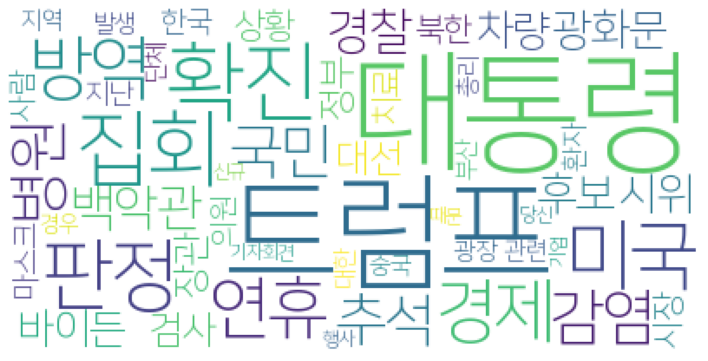

2020.10.02
['집회', '허가', '시위', '차량', '도심', '예고', '경찰']
['대통령', '부통령', '펜스']
['대통령', '트럼프', '회복']
['집회', '감염']
['존슨', '대통령', '총리', '감염', '영국', '판정', '보리스']
[]
['대구시', '거리']
['모두', '추가', '부산', '검사', '평강', '의원', '확산', '가운데']
['판정']
['트럼프', '대통령', '미국', '확진', '한국', '영향', '기업', '대선', '관련', '대한', '무역']
['대통령', '위로']
['트럼프', '대통령', '감염', '힉스', '백악관', '시간']
['대화', '북미', '대통령', '트럼프', '한반도', '서프라이즈', '우리']
['경제', '부통령', '판정']
['대통령', '트럼프']
['트럼프', '토론', '대통령', '바이든', '후보', '미국', '대선']
['대통령', '미국', '트럼프', '확진']
['대통령', '트럼프', '판정']
['부통령']
['대전']
[]
['대통령', '부통령', '트럼프', '펜스', '판정', '부부']
['하락', '트럼프', '대통령', '확진']
['하락', '트럼프', '대통령', '확진']
['하락', '트럼프', '대통령', '확진']
['폼페이', '장관', '대통령', '트럼프', '미국', '국무장관']
[]
['부통령']
['대통령', '트럼프']
['트럼프', '대통령', '마스크', '백악관', '확진', '격리', '선거', '유세', '바이든', '대선', '후보', '사람', '착용']
['차량', '집회', '금지', '경찰', '시위']
['트럼프', '파이브', '결과', '대통령', '예측', '선거', '당시', '가능성', '대선', '후보']
['폐업']
['집회']
[]
['토론', '트럼프', '대통령', '판정']
['펜스', '부통령', '미국', '대통령']
['대통령', '트럼프'

['백신', '대통령', '푸틴', '트럼프', '러시아', '접종']
['정체', '차량']
[]
['뷰티', '미얀마', '언니', '한국', '대표', '샛별', '화장품', '고객', '지금', '제품', '가장', '현지', '시장', '저희', '정도', '변화', '통해', '매출', '플랫폼', '사람', '구매', '처음', '콘텐츠', '시작', '에디터', '상황', '진출', '마케팅', '정보', '여성', '사용', '현재', '미용', '브랜드', '온라인', '스타트업', '주목']
['대통령', '트럼프', '유세', '대선', '격리']
['후보', '바이든', '트럼프', '대통령']
['폼페이', '장관']
['대통령', '트럼프', '장관', '폼페이', '미국', '확진', '한반도', '순방', '가능성', '선언', '대해', '아시아', '방문', '문제', '대선', '종전', '판정']
['트럼프', '대통령', '중국', '경제']
['트럼프', '대통령', '중국', '경제']
['트럼프', '일정', '폼페이', '장관', '대통령', '확진', '순방', '지난달']
['폐업']
['지하상가', '임대료', '상인', '서울시', '매출', '상가', '조선']
['집회']
[]
['남북', '북미', '대통령', '북한', '대화', '상황', '관계', '돌발', '트럼프', '한반도', '종전', '미국', '대한', '부부']
['긴급', '치료', '승인', '연내', '사용']
[]
['영상편지', '조선', '추석', '북한']
['고기', '주인', '양주시', '백가', '국물', '가마솥', '식당', '떡갈비', '꼬리', '무쇠', '변영숙', '곰탕', '음식', '시간', '가래', '손님', '사람', '그대로', '우려', '장사']
['조선', '재활용품', '쓰레기', '스티로폼', '지자체']
['의원', '페리', '스코틀랜드', '확진', '이후']
['판정', '지난

[]
[]
['중국', '관광지', '동기', '대비', '하루', '마스크', '베이징', '연인원', '사람', '이동', '위안']
['대통령', '트럼프', '백악관', '보좌', '힉스']
['대통령', '트럼프', '위험', '확진']
['부산', '버스', '경남']
['트럼프', '대통령', '증상', '상태', '주치의']
['집회', '시위', '차량', '금지', '경찰', '보수', '단체', '미만', '통고', '신고', '일파', '대위', '대해', '경우', '불법', '확산', '지방', '한국', '오후', '도심', '광복절', '참여', '교회', '광화문', '대규모', '인근', '주최', '결정', '상태', '개최', '측은', '여명', '인용', '현재', '개천절', '서울시', '행정소송', '일대', '강동구', '형식', '방침', '기자회견', '사랑', '광장', '당국']
['울산', '입원', '치료', '감염']
['강서구', '검사', '자가', '격리']
['트럼프', '미국', '대통령']
['후보', '바이든', '트럼프', '대통령', '토론', '마스크', '감염', '대선']
['광고', '채널']
['집회', '국민', '개천절', '드라이브', '스루', '방역', '의원']
['승인', '대표', '치료', '긴급', '사용', '진단']
['중국', '트럼프', '대통령', '쾌유', '소식', '미국', '편집장', '트위터', '확진']
['인도', '의사', '의료', '환자']
['간호사', '모습', '가천대', '길병원', '전시']
['하루', '수가']
['대통령', '양성', '트럼프', '격리', '백악관', '검사', '판정']
['자화', '오마이', '이야기', '갑남', '꽃받침']
['하루', '수가']
['국민', '강조', '드라이브스루', '집회', '법원', '광화문', '행위', '대변인', '개천절', '방역', '정부', '허용']
[]


['올해', '음식', '명절', '추석', '가지', '취업', '준비', '고향']
['트럼프', '지금', '말씀', '확진', '크게', '후보', '마스크', '대선', '백악관', '일단', '보좌', '힉스', '국정', '토론', '증상', '대해', '대통령', '얘기', '아마', '문제', '정상', '전반', '수도', '확인', '교수', '영향', '내용', '부통령', '상황', '때문', '검사', '치료', '계속', '미국', '경우', '감염', '사실', '방역', '직무', '앵커', '변수', '투표', '얼마', '가능성', '유세', '양성', '운영', '본인', '제기', '판정', '접촉', '주치의', '현재', '고요', '공백', '상태', '전체', '따라서']
['국내', '대선', '변동성', '증시', '트럼프', '미국', '대통령', '결과', '증권', '지수', '시장', '불확실', '지난달', '금융시장', '전망', '정책', '한국']
['교향악단', '시리즈', '이번', '오케스트라', '공연', '대구', '지휘자', '축제', '피아니스트', '무대', '시립', '광주', '심포니', '월드']
['방역', '기간', '연휴', '감염', '모임', '추석', '발생', '부산', '경제', '이후', '확산', '우려', '곳곳', '지인']
['지역', '남부', '내일', '기온']
['법원', '집회', '개천절', '국민', '내일', '허용', '관련']
['판정', '확진', '총리', '존슨', '양성', '대통령', '정상', '사례', '국왕']
['후보', '트럼프', '바이든', '대통령', '대선']
['대통령', '트럼프', '멜라', '니아']
['집회', '경찰', '차량', '법원', '개천절', '시위', '허가', '대해', '한국', '광화문', '통고', '대면', '금지', '일부', '불법']
['감염', '집회']
['트럼프', '대통

['대통령', '트럼프', '보좌', '니아', '여사', '양성', '판정', '감염', '힉스']
['트럼프', '대통령', '보좌', '니아', '여사', '양성', '판정', '힉스', '감염']
['시민', '모습', '놀이동산', '방역', '이용', '거리', '두기', '연휴', '고향', '위해', '연합뉴스', '사람']
['놀이동산', '거리', '시민', '모습', '방역', '이용', '두기', '연휴', '위해', '고향', '연합뉴스', '사람']
['바이러스', '바이오', '교수', '대해', '때문', '세미나', '사람', '세계', '신종', '전달', '백신', '우리', '하나', '활동', '병원체', '그것', '의료', '연구', '라며', '산업', '미국', '환자']
['대선', '트럼프', '대통령', '바이든', '후보', '마스크']
['트럼프', '대통령', '판정', '대선']
['본부장', '모임', '종교', '행사', '집회']
['신영근', '해미읍성', '시민', '서산', '전통', '행사', '취소', '관광객']
['환자', '감염', '관련', '사례', '목욕탕', '가운데', '확진', '방역', '신규', '현재', '지난달']
['대통령', '트럼프', '판정', '선물', '확진']
['환자', '확진', '포항']
['공연', '서커스', '축제', '연합뉴스']
['트럼프', '대통령', '판정', '미국', '대선', '확진', '토론']
['대통령', '트럼프', '아이', '감염']
['대통령', '트럼프']
[]
[]
[]
['트럼프', '대통령', '판정', '확진']
['영부인', '고문', '트럼프', '대통령', '우리', '힉스', '백악관', '검사', '마스크']
['고문', '트럼프', '대통령', '우리', '힉스', '백악관', '검사', '영부인', '마스크']
['가족', '모두', '그레이엄', '악몽', '제시카']
['트럼프', '대통령']

['캐릭터', '마우스', '미키', '펭수', '국회', '참고인', '연기자', '의원', '국감', '미상', '개념', '채택', '세계관', '보도', '증인', '출석', '연기', '위원회', '사람', '뽀로로', '황보', '법적']
['가구', '미사', '센터', '긴급']
['보이스피싱', '피해', '금액', '경제']
['영화', '추석', '담보', '당일', '관객']
['광주', '시민', '사람', '물건', '구입', '가족', '인근', '모습', '위해']
['발생', '신규', '사례', '연휴', '검사', '최근']
['집회', '문제', '북한', '사실', '말씀', '대해', '분위기', '우리', '정부', '차례', '최영일', '확산', '조건', '하나', '우려', '차량', '경로', '발생', '대응', '광화문', '그때', '소각', '목소리', '방역', '걱정', '실제', '이후', '시작', '수치', '금지', '앵커', '시위', '계속', '때문', '환자', '감염', '어제', '보고', '지금', '국민', '이종근', '확인', '당국', '야당', '그다음', '어쨌든', '여야', '병원', '여러', '허가', '갓집', '생각', '가족', '가지', '수가', '법원', '내용', '주호영', '방식', '추석', '상황', '확진', '그것', '정도', '검진', '이야기']
['집회', '법원', '금지', '경제']
['판매', '미국', '판매량', '동기', '대비', '소매', '실적']
['검사', '음성', '판정']
['기온']
[]
['도시락', '추석', '병사', '격리', '센터', '급식', '휴가', '육군', '사단', '문제', '군인', '오마이']
['집회', '국민', '차단']
['트럼프', '대통령', '힉스', '백악관', '고문', '우리', '검사', '마스크']
['세스', '한국', '코스피']
['연휴', '신규', 

['데이터', '어플', '라이언스', '인프라', '러닝', '분야', '학습', '구축', '디지털', '정부', '분석', '경쟁력', '최근', '사업', '일리', '결합']
[]
['환자', '관련', '검사', '확진', '방문자', '확인', '번은']
['추석', '관광객', '제주', '연휴', '제주도', '관광']
['사람', '시민', '이사장', '유시민', '계몽군주', '비판', '정치', '김정은', '레오', '위원장', '북한', '소크라테스']
['강화', '여행', '현숙', '직물', '시간', '코스', '강화도', '성당', '책방', '교동', '강화읍', '풍경', '마을', '방직']
['집회', '경찰', '차량', '법원', '개천절', '금지', '일부', '대면', '신청', '신고', '한국', '통고', '시위', '광화문', '불법']
['관련', '누적']
['음성', '검사', '결과', '격리', '방역']
['검사', '결과', '음성', '격리', '방역']
['검사', '결과', '음성', '격리', '방역']
['대통령', '트럼프']
['판매', '미국', '소매', '증가', '판매량', '실적']
['상반기', '식품', '증가', '제조업', '수요']
['방송', '나훈아', '발언', '국민', '공연']
[]
['집회', '국민']
['입국']
['집회', '국민', '행위', '차단', '개천절', '법원']
['달러', '옵션', '미국', '매수', '기술', '주가', '거래', '나스닥', '상승', '증시', '소프트뱅크', '주식']
['여수', '대상', '관광', '도시', '브랜드']
['지난달', '개미', '탁금', '투자자', '투자']
['국민', '장관', '의원', '대해', '북한', '검찰', '공무원', '대통령']
['입국']
['부근', '분기점', '고속도로', '구간', '오후', '차량', '정체', '휴게소', '방향']
['중국'

['교육']
['연기', '일본', '개최', '도쿄올림픽', '올림픽', '내년', '연합뉴스']
['방역', '추석', '연휴']
['마스크', '착용', '연합뉴스']
['디자인', '기업', '사업', '지원']
['사업', '불법', '광고', '정비', '일자리']
['등록금', '대학', '반환', '학생', '연합뉴스']
['대상', '복지', '대출', '신용', '경기', '지원', '상담', '금융', '사업', '경기도', '접수', '도민', '신용등급']
['환자', '병원', '경주', '경제', '굿모닝', '푸른', '검사', '입원']
['환자', '질환', '치명', '이상', '위험']
['집회', '차량', '경찰', '시위', '개천절', '연합뉴스']
['포항', '환자']
['가짜', '트럼프', '대통령', '치료', '결과', '요인', '분석', '정보']
['학부모', '교육', '추진', '등교', '수업', '학습', '방안', '학교', '학년', '매일', '입장', '유치원', '전면', '학생', '제안', '대한', '이데일리', '실시', '교육부', '초등학교']
['관광지', '연합뉴스']
['유네스코', '일본', '외무', '정부', '테기', '독일', '소녀', '장관', '상이', '요청', '철거', '포함', '유산', '입장', '베를린']
['상이', '포함', '일본', '외무', '정부', '테기', '독일', '소녀', '장관', '유네스코', '요청', '베를린', '유산', '입장', '철거']
['휴대전화', '스미싱', '클릭', '설치', '문자']
['인신매매', '등급', '지원', '국가', '관련', '무역', '대해', '경제', '실태', '하위', '비인도적', '기준', '정부', '북한']
['은행', '독일', '베트남', '개발']
['북한', '지원', '인신매매', '국가', '미국', '관련', '기준', '쿠바', '시리아']
['중국'

['베를린', '통일']
['보충', '프로', '단백질', '식품', '운동', '음료', '건강', '분말', '형태']
[]
['추석', '이번', '어르신', '온라인', '올해', '가족', '관계', '영상통화', '부모님', '대면', '자식']
['대회', '선수']
['마드리드', '스페인', '봉쇄']
[]
['올해', '레반도프스키', '뮌헨', '최우수']
['기업', '상장', '기업가', '시장', '카카오', '바이오', '투자', '사이언스', '크래프톤', '공모', '백신', '가치', '게임', '증권', '뱅크', '주목', '올해']
['정부', '모임', '제한', '독일', '술집', '유럽', '시간', '감염', '금지']
['감염', '격리', '시비르', '관리', '완치', '바이러스', '의원', '지난', '부작용', '재검', '국내', '조치', '입원', '방역', '렘데', '사람', '사례', '치료', '발생']
['비닐', '때문', '일반', '포장재', '배출', '폐기물', '재활용', '종량제', '택배', '선물', '쓰레기', '봉투', '상자', '명절', '증가', '아이스팩', '과태료', '플라스틱', '분리']
['하락', '자동차', '산업', '하반기', '경기', '판매']
['이야기', '다른', '서로', '때문', '명절', '경우', '김씨', '부산', '부모님', '언성', '이번', '대화', '의견']
['가구', '여행', '문화', '추석', '서울시', '영상', '음악', '공연', '운영', '오후', '만들기']
['학습', '무료', '개념', '푸르넷', '추석', '제공', '수학', '특강', '강의', '클럽', '대상', '화상', '캠블리', '체험', '할인', '영어', '아이', '위해', '도서', '진행']
['시험', '변호사', '판례', '사례', '기록', '변호사시험', '합격', '강조']
['미국', '좌석', 

['계획', '정책', '테크노', '주택', '예정', '개발', '가구', '인근', '지하', '폴리스', '만큼', '부동산', '면적', '정보', '통해', '홈페이지', '사업', '당진', '추석', '지구', '아파트', '산업', '전용', '단지', '공급', '지상', '남산', '분양', '확인', '호재', '교통', '도시', '지역', '국가', '중심', '조성', '롯데']
['클린', '청결', '위생', '피부', '케어', '자극', '탄력', '세트', '성분', '진정', '보습', '트리', '마스크', '제품', '추석', '추출', '선물', '패드', '구성']
['대회', '판소리', '명창']
['지역', '아들', '의원', '장관', '추미애', '정부', '때문', '우리', '투쟁', '말씀', '목소리', '관련', '정권', '대구', '지원', '김승수']
['온라인', '서비스', '텔레콤', '이용', '휴대폰', '구매', '고객', '바로', '이동통신', '다이렉트', '가입', '채널']
['간호', '중수', '대통령', '사랑', '직원', '상황', '간호사', '본부', '위로', '선물', '방역', '고백', '격려', '영웅']
['전시', '예정', '문화원', '폴란드', '한국', '문화', '진행', '공연', '행사', '박물관']
['서비스', '이용', '저축은행', '사기', '금융', '피해', '대출', '모바일', '경제', '제공', '수법', '관련', '웰컴']
['모임', '비대', '회원', '방식', '채팅']
['대학', '학생', '지원', '교육', '봉사', '학교', '영역', '학습']
[]
['재정', '증가', '국가채무', '부총리', '설명', '역할']
['고발', '기업', '공정위', '규제', '사업자', '공정거래법', '플랫폼', '대한', '담합', '자금', '경우', '정보', '언시', '경제', '폐지', 

['미세먼지', '대기오염', '바이러스', '인간', '초미세먼지', '교수', '이산화탄소', '호흡기', '활동', '감소', '이산화질소', '사망률', '기후변화', '대응', '통제', '이후']
['나이지리아', '스키', '루크', '소장', '치빈', '선고', '카노']
['용산', '만물상', '가야산', '태실', '가장', '계곡', '성주호', '서원', '야생화', '마을', '고택', '조선', '회연', '성주', '밖숲', '힐링']
['상장', '바이오', '회사', '카카오', '게임', '기업', '시장']
['상장', '게임', '기업', '바이오', '회사', '카카오', '시장']
['아동', '그라샤', '베테', '한국', '아이', '법무부', '심사', '부부', '공항', '루렌', '난민', '가족', '재판', '인정', '항소심', '지난', '조사', '신청', '실로', '취업', '쌍둥이', '생활', '상황', '쿠카', '판결', '행정소송', '지적', '결정', '남매']
['호수', '도시', '나라', '스위스']
['방역', '확산', '연휴', '추석', '지난달', '신규', '단계', '이후', '감염', '명대', '지역', '발생', '상황', '자릿수', '센터']
['발생', '지난달', '방역', '연휴', '추석', '감염', '자릿수', '센터', '이후', '확산', '신규', '상황', '지역', '단계', '명대']
['벨라루스', '정상', '제재', '회원', '회의', '키프로스', '문제', '터키']
['때문', '사람']
['지폐', '헤알', '브라질', '발행', '고액']
['문화재', '박물관', '촬영', '국립', '중앙']
['국민', '민심', '만행', '조경태', '나라', '정권', '의원', '북한', '데일리안', '조해진', '말씀', '이야기', '대해', '추미애', '정부', '우리', '대통령', '대한', '경남', '

['금지', '핼러윈', '연휴', '명절', '중국', '가운데', '지역', '시작', '사탕', '봉쇄', '세계', '추수감사절', '이동', '이스라엘']
[]
['실적', '연구원', '팩터', '자동차', '이익', '장비', '조정', '업종', '영업', '증가', '전망', '의료', '모멘텀', '반등', '증시', '증권', '관련', '양호', '상향', '바이오', '반도체', '서비스']
['연휴', '유입', '검사', '전날', '지역', '이후', '부산', '감염', '누적', '신규', '발생', '명대', '추석', '수도권', '가운데']
['질문', '백신', '방역']
['기업', '서비스', '플랫폼', '상품', '크몽', '클래스', '비즈니스', '경제']
['임금', '절차', '근로', '체불', '감독', '노동자', '국가', '사용자', '대해', '피해', '우리', '확인', '지급', '근로자', '이유', '시스템', '문제', '추석', '연장', '고용노동부']
['인천', '우울', '상담', '심리', '경제', '지원', '정신건강', '복지', '센터']
['신종', '노숙인', '감염', '사회', '검사']
['사태', '운영', '국감', '국회', '의원', '촬영', '비대', '지난달', '변화', '총회', '도입', '지역구', '화상회의', '실시']
['보수', '국민', '장덕진', '교수', '여야', '진보', '국회', '야당', '추미애', '조국', '진영', '민주당', '정부', '정치', '문제', '박명림', '자격', '여당', '권력', '중심', '라며', '정책', '비판']
['기록', '관련', '신규', '증가', '국내', '유입', '확진', '최근', '발생', '지역', '해외', '감소', '감염', '제외', '판정', '용인', '경기도', '부산', '거주', '접촉', '기준', '명의', '수도권', '전일', '북구'

['측정', '착용', '상태', '애플', '산소', '워치', '혈중', '관리', '수면', '시간', '확인', '결과', '포화', '기능', '건강', '충전']
['부총리', '대표', '장관', '정부', '이낙연', '경제', '자리', '사령탑', '사람', '기재부', '취임', '재임', '지급']
['기업', '분야', '인수', '투자', '핵심', '기술', '미국', '역량', '업체', '게임']
['캐릭터', '광주', '지역']
['규방', '이사장', '문화', '한국', '다례', '보유', '협회', '증보', '사진']
['공장', '봉제']
['방역', '제주', '추석', '검사', '유지']
['농산물', '농업', '생산', '지난해', '브라질', '수확량', '가치']
['일본', '대표팀', '선수', '소집']
['영화', '공연', '다양성', '경기', '콘텐츠', '진흥', '추석', '작품', '온라인', '연휴', '지원', '웹툰']
['남동구', '인천', '검사']
['미국', '소비', '물가', '전월']
['실업', '주간', '수당', '미국', '청구', '최근', '건수']
['화이자', '내년', '백신', '개발', '접종', '사망자', '보급', '상황', '경고', '진행']
['공사', '건축', '민간', '지역', '하도급', '현장', '건설', '업체', '참여', '대형', '목표', '달성']
['집회', '허가', '시위', '차량', '도심', '예고', '경찰', '대통령', '부통령', '펜스', '대통령', '트럼프', '회복', '집회', '감염', '존슨', '대통령', '총리', '감염', '영국', '판정', '보리스', '대구시', '거리', '모두', '추가', '부산', '검사', '평강', '의원', '확산', '가운데', '판정', '트럼프', '대통령', '미국', '확진', '한국', '영향', '기업', '대선', '관련', '대

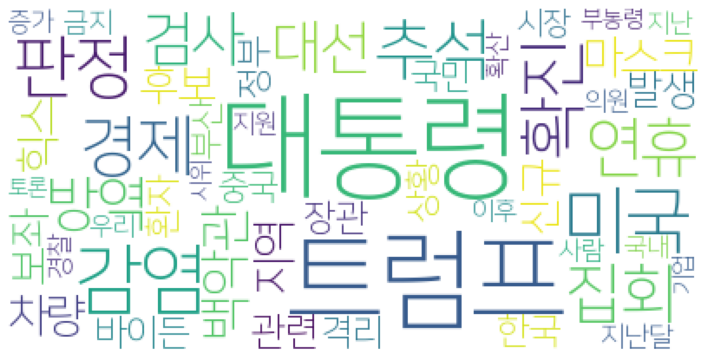

2020.10.01
[]
['명절', '혼추족', '혼자', '추석', '편의점', '백화점', '도시락', '위해', '음식', '잡채']
['광주', '성묘']
['부산', '감염', '방역', '지역', '접촉']
[]
['환자', '감염']
['환자', '감염']
['감염', '추가', '병원', '확진']
['사람', '때문']
['운영', '성묘', '가족', '예약', '차례']
['대표']
['대표']
['부산', '병원', '부산시', '만덕동']
['시장', '쇼핑몰', '일본', '바이', '재팬', '고도', '출시', '서비스', '글로벌', '해외']
[]
['종친']
['할머니', '이름']
['추석', '연휴', '진료', '방역']
['올해', '출산율']
['본부장', '대통령', '한국', '메르켈', '독일', '통화', '지지', '총리', '통일']
['상황']
['배달', '노동자', '시간', '라이더', '직접', '배민', '배차', '거리', '평점']
['배달', '노동자', '시간', '라이더', '직접', '배민', '배차', '거리', '평점']
['미국', '하락', '보사', '금리', '보험', '감소', '이상', '투자']
['트럼프', '마스크', '대통령', '토론', '착용', '바이든', '가족', '후보']
[]
['메르켈', '총리', '정상', '한국', '대통령', '독일']
['소득', '우울', '응답', '대해']
['탈북민', '북한', '추석', '오지']
['유시민', '북한', '국민', '노무현재단', '이사장', '계몽', '군주', '어제', '소식', '위원장']
['문제']
['감염', '병원', '다나', '접촉', '증상', '지난달', '공개', '입원', '거주', '발생', '성동구', '추가', '지역', '판정']
['집회', '법원']
['헝가리']
['이용', '공항', '지금', '방역', '마스크', '착용']
['방역', '추석', '연휴'

['저개발국', '경제', '경우', '성과', '전세계', '고통', '조치', '올해', '상황', '선진국', '보건', '역시', '그동안', '보고서']
['대통령', '추석', '리센룽', '총리']
['경력', '복귀', '과학기술', '사업', '지원']
['미국', '구조조정', '디즈니']
['대표']
['대표']
['증가', '반도체', '수출', '개월', '이후', '기록', '품목', '자동차', '조업', '시장', '일수', '올해', '미국', '가장', '작년', '플러스', '평균', '모두']
['지난달', '지역', '수도권']
['점포', '판매', '소매', '배달', '부산']
['학교', '도릴', '수업']
['요양보호사', '판정', '격리', '감염']
['요양보호사', '판정', '격리', '감염']
['지난달', '병원', '격리', '환자']
['감염', '추가', '병원', '확진']
['여객선']
['행사', '니콜라', '트럭', '니콜']
['마드리드']
['게임', '스트레스', '명절', '연휴', '추석', '스토리', '마피아', '수도', '오늘', '이번', '통해', '방탄소년단', '모두의마블', '사람', '이야기', '부수', '주인공', '시간']
['허위', '미국', '대통령', '정보', '트럼프']
['대표']
['경찰', '집회', '차량', '조건', '개천절']
['대표']
['테마', '파크']
['백신', '중국', '개발']
['이사장', '계몽군주', '교수', '비유', '비판', '김정은', '북한', '사람', '대해', '라며']
[]
['양안', '기부', '경제', '규모']
['고속도로', '추석', '오전', '보이', '구간']
['감염', '스페인', '마드리드', '조치', '연합뉴스']
[]
['병원', '도봉구', '다나', '사람', '연합뉴스']
['학습', '연합뉴스', '등교', '수업']
['정보', '불법']
['기부', '규

['부산', '가족', '감염', '접촉', '번은', '각각']
[]
[]
[]
[]
[]
['중국', '백신']
['정도', '정체', '구간', '방향', '부근']
['한국', '싱가포르']
['인천', '남동구', '판정', '결과']
['추석', '마을', '올해']
['추가', '감염', '검사', '접촉', '관련']
['대통령', '총리', '한국', '추석', '소개', '페이스북']
['추모', '성묘', '온라인', '추석', '가족', '봉안당', '입장', '수원시']
['나훈아', '국민']
['대한민국', '나훈아', '공연', '스페셜', '방송', '어게인', '영상']
['추석', '오늘']
['인천', '확진']
['인천', '확진']
['콘텐츠', '유튜브', '목소리', '오디오', '배우', '오디오북', '음성', '시간', '동영상', '라디오', '동시', '인식', '연예인', '스피커', '소리', '기술', '수면', '사람', '서비스', '아침', '이상', '지난해', '때문', '활용']
['인도']
['중국', '외국인']
['중국', '외국인']
['시드', '시리즈', '탬파베이', '양키스']
['유럽', '투자', '한국', '규모', '부동산', '지난', '물류', '창고']
['추석', '명절', '경계', '가족', '장병']
['한국', '총리', '대통령', '추석']
['감염', '신규', '감소', '연휴', '평일', '방역', '검사', '가족']
['나훈아']
['나훈아', '국민']
['미국', '구조조정']
['한국', '집회', '차량', '신고', '경찰', '금지', '결정', '규모', '주차장', '확산']
[]
['부산']
['용인', '병원', '확진', '판정', '세브란스병원', '의사', '지난달']
['확진', '환자', '관련', '감염', '가족', '부산', '위중', '지난달', '지인', '이후', '방문자', '누적', '판정', '중증',

['리즈', '여행', '우리', '마음', '그녀', '이혼', '누구', '이탈리아어', '사랑', '드라마', '때문', '미소']
['총리', '한국', '추석']
['축제', '화천군', '지역', '영향']
['린지']
['백신', '중국']
['벌초', '대행', '산림조합']
['복권', '판매', '증가', '권위', '올해', '설명', '경기']
['선거', '본부장']
['정보', '유튜브', '채용', '취업', '기업', '그룹', '제공']
['제보', '공익', '롯데', '운영', '마트', '업체', '윤씨', '공정위', '과징금', '납품', '정부', '회사', '이후']
['집회', '정부', '개천절', '상인', '강행', '광화문']
['아이', '수업', '소동', '발달장애', '부모', '대표', '부방']
['전통주', '대구', '차례', '매출', '가장']
['카툰', '참여', '이번', '공공미술', '사업', '지역', '프로젝트', '작가', '송도', '어촌', '캠퍼스', '연수구', '주민', '재단', '문화', '예술가', '대표', '계획', '지원', '미술', '인천', '기회']
['연결', '기술', '인공', '지능', '스피커', '사람', '드라마', '가족', '통해', '미래', '역할', '이식', '능력', '정치', '컴퓨터', '이용', '현재']
['부총리', '집행', '추경', '사업', '설명', '지원']
['차비', '언택트', '주차장', '클라우드', '시스템', '번호판', '파킹', '아이', '주차', '기술', '마트', '정보', '차량', '전국', '컴퓨터', '결제', '위해', '운영', '위치', '개발', '문자', '실시간', '무인', '서비스', '확인', '시대', '인식', '관제']
['백신', '중국']
[]
['집회', '경찰', '조건', '차량', '금지', '한국', '확산']
['중국', '백신', '가격',

[]
['방역', '추석', '연휴', '관광지', '강릉', '관광객']
['신세경', '사진']
['한국', '주일', '대사관', '행사', '손예진', '협력', '국경일', '온라인', '사랑', '통해', '배우', '일본']
['아버지']
[]
['격리', '요양원']
['경제', '구걸', '실버']
['수원시', '추모', '추석', '가족', '성묘', '온라인', '봉안당', '명절']
['정체', '방향', '분기점', '부근', '구간', '정도']
['화물', '상공', '비행', '관광', '항공', '여객기', '아시아나', '운항', '화물기', '개조', '대한항공', '수송', '전세기']
['순천', '순천시', '방문', '지역', '오후']
[]
['중국', '교황청', '합의', '폼페이', '주교', '임명']
['실험', '백신', '중국']
['토론', '트럼프', '대통령', '후보', '바이든', '미국', '대선', '정치', '평가', '유권자', '결과', '시간', '토론회', '방해', '현지', '선거', '진행자']
['마을']
['부산']
['개월', '이자', '고객', '쉐보레', '아이', '차량', '할부', '제공', '진행', '혜택']
['테크', '디지털', '서비스', '자산', '달러', '고객', '기술', '전략', '이상', '개발', '시장']
[]
['완료', '지급', '원금', '고용', '고용부', '경우', '추석', '경제', '오류', '지원', '프리랜서', '신청', '특고', '안정', '계좌', '대해', '대상', '마무리']
['나훈아', '가황', '공연', '방송', '어게인', '추석', '시청률', '대한민국']
['방역', '위협', '요인', '집단', '의료', '교회', '연구원']
['공연', '나훈아', '방송', '시청자', '무대']
['나훈아', '공연', '대한민국', '신곡', '방송', '어게인', '관객', '무대']


['나훈아', '시청률', '방송', '고향']
['추석', '해경', '명절', '바다', '고향', '부모님', '연합뉴스']
['공연', '방송', '나훈아']
['김태림', '추석', '연휴', '한복', '골프장']
['드라마', '가족', '시즌', '뱀파이어', '추천', '미국', '작품', '이야기']
['부대', '연합뉴스', '추석']
['최저임금', '스위스', '제네바', '파운드', '시간', '도입', '프랑스']
['수출', '달러', '증가', '노컷뉴스', '이후', '개월']
['고객', '개월', '할부', '쉐보레', '이자', '경제', '차량']
['청주', '문화재', '야행']
['수출', '플러스', '전환', '지난', '기록', '감소']
['설치', '공항', '화상', '카메라', '연합뉴스']
[]
['부양책', '우려', '기록', '포인트', '미국', '지수', '대선', '대한', '시장', '협상', '결과', '상승', '백신', '합의', '소식', '토론']
['연합뉴스']
['니콜라', '트럭', '발표', '협력']
['쉐보레', '한국', '고객', '할부', '개월', '차량', '이자', '지엠', '진행', '통해', '구매', '제공']
['보건', '당국', '감염', '판정', '검사', '결과']
['개월']
['기업', '내년', '카카오', '상장', '게임', '최근', '관사', '선정']
['방역', '공원', '추모', '성묘', '연합뉴스']
['실적', '브랜드', '뱅뱅', '청바지', '지난', '매출', '뱅어', '패럴', '최근']
['추석', '교정', '대통령', '행사', '수용', '징역', '사건']
['수출', '기록', '플러스', '평균', '최고', '이후']
['회식', '미니', '모임', '대면', '인턴', '비대', '각자', '프로그램', '시간', '사진', '가면', '국민일보', '우리']
['사람', '교회', '약혼

['총격', '사건', '추석', '대통령', '연휴', '이번', '북한', '어머니', '차례', '관저', '상황', '고향', '청와대', '방역', '시간', '직접', '지난해']
['추석', '대표', '우리', '국민', '지원', '면서']
['공연', '서울시', '유튜브', '추석', '연휴', '채널', '이번', '가수', '네이버', '가족', '문화', '마을', '공개']
['공연', '방송', '나훈아']
['추석', '가족', '만남']
['제주', '마스크', '거리']
['행사', '하동', '세계', '엑스포', '산업']
['수납', '처음', '방송', '생각', '물건', '공간', '가구', '바구니', '우리', '사람', '이야기', '하나', '국민일보', '시작', '고객', '필요', '정리', '빨래', '정말', '대표', '제일', '아이', '감동', '자신', '시간', '방법', '컨설팅']
['한국', '한일', '대사관', '일본', '메시지']
['지역', '방역', '확산', '다시', '전날', '확진', '발생', '지난달']
['누비', '발행', '상품권']
['순서', '동쪽', '서쪽', '차례상', '과일', '왼쪽', '제주']
['투자자', '국내', '증시', '테슬라', '애플', '매수', '지난달', '보유']
['투자자', '국내', '증시', '테슬라', '애플', '매수', '지난달', '보유']
['반정부', '집회', '의회', '군주제', '개혁', '개헌', '목소리', '정국', '세력']
['시민', '부캐']
['대선', '협치', '지사', '민주당', '대표', '보이', '민심', '자신', '이낙연', '로서', '이후', '원칙', '이제', '부분', '성과', '시작', '정치', '장관', '의원', '대해', '아들', '이슈', '정책', '평가', '계속', '경향신문', '이재명', '관계자', '소속']
['검찰', '절차',

['클래스']
['민주화', '운동', '주민', '광주', '포럼']
['다이어리', '어피', '에디', '카카오', '매력', '러블리', '치의', '출시']
['진단', '씨젠', '바이러스', '기술', '분자', '일상', '검사']
['조리', '추석', '식사', '마스크', '음식', '교수', '방역', '감염', '가족', '내과']
['로봇', '배달', '클라우드', '서비스', '호텔', '자율', '주행', '스마트', '텔레콤', '전망', '활용', '데이터', '플랫폼', '처리', '기술', '음식']
['국회', '서울시', '지원', '보조금', '동우회', '지방행정', '공무원', '지자체', '행안부', '사업', '지급', '회원', '제정', '대한', '편성', '퇴직', '의원', '운영', '도모', '정안', '예산', '금지', '친목단체', '국민', '단체', '법률']
['화면', '스마트폰', '유지', '영상', '시청', '자세']
['화면', '스마트폰', '유지', '영상', '시청', '자세']
['음주운전']
[]
['가격', '부동산', '상승', '시장', '집값', '변수', '매매', '연구원', '정책']
['콘텐츠', '넷플릭스', '감상', '최신', '영상']
['영상통화', '이번', '명절', '현충원', '운영']
['무급', '매출', '휴직', '항공', '업계', '항공사', '직원', '유급', '상황', '고용', '구조조정', '저비용항공사', '내년', '유지', '정리해고', '사태', '정부']
['신청', '학기', '대학', '휴학', '학생', '한국']
['바이러스', '진단', '독감', '수출', '검사']
['투자자', '발의', '공매도', '주식', '의원', '주주', '개미', '개인', '투자', '금지', '동학', '주식시장', '지난달', '보유', '노컷뉴스']
['수법', '지인', '경우', '가족', '송금', '문자

['지원', '추석', '업종', '안정', '택시', '가구', '확인', '원금', '신청', '지급', '금은', '대상', '자금', '접수', '연휴', '고용', '아동', '지난달', '정부', '긴급', '희망', '사람', '추가', '이후', '절차']
['스미싱', '서비스', '금융', '문자', '관련', '당국', '추석', '사칭', '사기', '이용자', '보이스피싱']
['우리', '펀드', '어린이', '수익률', '미래에셋', '개월', '아이', '자산운용', '기준']
['자산', '보사', '기준금리', '생명', '수익률', '금리', '업계', '다시', '투자', '올해', '자산운용']
['부동산', '증가', '지역', '변화', '투자', '국내', '해외', '투자자', '자산', '수요', '시장', '유럽', '대한', '리스크', '규모', '확대', '전체', '기관', '활동', '코리아']
['선물', '서비스', '모바일', '가족', '통화', '최대']
['활용', '개발', '신약', '플랫폼', '바이오', '오픈', '이노베이션', '연구', '협력', '계획', '네이버', '질환', '센터', '산학', '혁신', '산업']
['연중', '추석', '영업', '레스토랑', '등심', '당일', '휴무']
['로이', '포스코', '철광석', '광산', '원료', '투자', '배당', '확보', '생산', '홀딩스']
['로움', '실현', '공정', '정의', '청년', '불평등', '생각', '세대', '정치', '사회', '장애인', '경쟁', '여성', '시대', '지금', '결과', '위기', '문제', '소득', '기후', '현실', '정부', '정책']
['외교', '대통령', '장관', '추석', '국정', '구상', '한반도', '남북관계', '개각', '평가', '청와대', '미국', '변화', '가능성', '일정']
['전통', '상품', '시장', '커머스', '경

['추석', '지역', '주민', '인천', '연휴', '집콕', '가족']
[]
['중국', '백신', '개발']
['은행', '비용', '디지털', '수익', '금융', '보고서', '뱅크', '라며', '전환']
['미국', '선거', '시장', '트럼프', '대선', '당선', '가능성', '대통령', '상황', '바이든', '경우', '결과', '분석', '상원']
['관련', '추가']
['감염']
['추미애', '절차', '국회', '공무원', '징계', '장관', '정무', '국감', '국가공무원', '규정', '대한', '작동', '사퇴']
['경북', '포항', '접촉', '사망자', '경주', '누적', '판정', '추가', '검사', '영천', '입원']
['정상', '대통령', '메르켈']
['선물', '추석', '지역', '대표', '메시지', '원내대표', '영광', '의미', '여야', '굴비']
['사망자']
['중국', '백신', '개발']
['차례']
['구조조정']
['코드', '넷플릭스', '국내', '콘텐츠', '플랫폼', '웨이브', '구독', '온라인', '복수', '드라마', '왓챠', '경제', '리지', '서비스', '가입', '제공', '아시아', '시장']
['이후', '증가', '수출', '개월', '품목', '시장', '회복', '플러스', '처음', '평균', '최고', '주력', '긍정', '가장', '주요', '조업', '실적', '반등', '미국', '일수', '반도체', '성장', '감소', '기록', '자동차', '올해', '전환', '모두', '영향']
['전환', '최고', '일수', '성장', '이후', '품목', '시장', '회복', '증가', '기록', '반등', '처음', '반도체', '개월', '수출', '플러스', '주요', '주력', '평균', '감소', '가장', '미국', '긍정', '조업', '영향', '실적', '올해', '모두', '자동차']
['경찰', '집회', '조

['이벤트', '게임', '정책', '기부', '소상', '공인', '디지털']
['수출', '지원', '물류', '임산물', '추가', '위해']
[]
['대전']
['대한', '사무', '총장', '선거']
['대한', '사무', '총장', '선거']
['자전거', '교통사고', '다발', '지역', '발생', '사고']
['국내', '하루', '신규', '자릿수', '모두']
[]
['지난달', '유입', '명대', '수도권', '지역', '신규', '검사', '수가', '국내', '감염', '발생', '해외', '누적']
['로봇', '마스크', '거리', '목걸이', '연합뉴스']
['나훈아', '대한민국', '공연', '국민', '세월']
['투표', '페이스북', '대선', '주장']
['수출', '증가', '기록', '개월', '이후', '플러스', '품목', '대비', '수입', '영향', '반도체', '처음', '모두']
['국민', '공연', '나훈아', '대한민국', '여러분', '출연', '방송', '우리', '세계', '무게']
['추석', '연휴', '방송', '지원', '정보', '방송사', '방통위', '가족', '프로그램']
['지원', '방송사', '추석', '연휴', '방송', '정보', '방통위', '가족', '프로그램']
['전기차', '증가', '감소', '지난', '중국', '대비', '배터리', '용량', '자릿수', '판매량', '동월', '성장', '시장']
['논란', '니콜라', '트럭', '행사', '니콜']
[]
['가격']
['거주', '지난달', '전날', '확진', '환자', '감소', '부산', '판정', '감염', '자릿수', '신규', '추정', '격리', '수도권', '추석', '가족', '국내', '발생', '접촉', '검사']
['개월', '수출', '플러스', '달러', '이후', '증가', '아이', '기록', '올해', '연속', '전환']
['개월', '수출', '플러스', '달러'

['명절', '혼추족', '혼자', '추석', '편의점', '백화점', '도시락', '위해', '음식', '잡채', '광주', '성묘', '부산', '감염', '방역', '지역', '접촉', '환자', '감염', '환자', '감염', '감염', '추가', '병원', '확진', '사람', '때문', '운영', '성묘', '가족', '예약', '차례', '대표', '대표', '부산', '병원', '부산시', '만덕동', '시장', '쇼핑몰', '일본', '바이', '재팬', '고도', '출시', '서비스', '글로벌', '해외', '종친', '할머니', '이름', '추석', '연휴', '진료', '방역', '올해', '출산율', '본부장', '대통령', '한국', '메르켈', '독일', '통화', '지지', '총리', '통일', '상황', '배달', '노동자', '시간', '라이더', '직접', '배민', '배차', '거리', '평점', '배달', '노동자', '시간', '라이더', '직접', '배민', '배차', '거리', '평점', '미국', '하락', '보사', '금리', '보험', '감소', '이상', '투자', '트럼프', '마스크', '대통령', '토론', '착용', '바이든', '가족', '후보', '메르켈', '총리', '정상', '한국', '대통령', '독일', '소득', '우울', '응답', '대해', '탈북민', '북한', '추석', '오지', '유시민', '북한', '국민', '노무현재단', '이사장', '계몽', '군주', '어제', '소식', '위원장', '문제', '감염', '병원', '다나', '접촉', '증상', '지난달', '공개', '입원', '거주', '발생', '성동구', '추가', '지역', '판정', '집회', '법원', '헝가리', '이용', '공항', '지금', '방역', '마스크', '착용', '방역', '추석', '연휴', '진료', '대표', '경제', '중국', '경향신문', '홍콩', '상황', '시설', '가

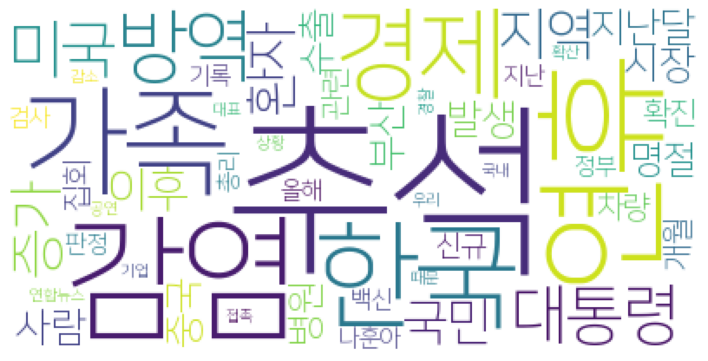

2020.09.30
['영상', '명절', '할머니']
[]
[]
[]
['일본']
['고향', '위도', '여객선']
['시장', '상인', '명절', '사람']
['농악', '고창', '공연']
['대구', '확진', '접촉']
['일본']
['대구', '확진', '접촉']
['일본']
['추석', '명절', '가족']
['고향', '열차']
['추석', '분위기']
[]
[]
['방역', '북한', '비상', '강조', '사업']
['영화', '영화제', '조선', '세계', '반도', '흥행']
['식품', '거래', '온라인']
['식품', '거래', '온라인']
['대학', '취업', '용접', '조선', '기술', '중년', '한국', '폴리텍', '정원']
['폐업', '부산', '자영', '업자']
['지난', '트럼프', '대통령', '바이든', '대선', '민주당', '후보', '미국', '도널드', '우리', '조선']
['집회', '차량', '경찰', '금지', '신청', '신고']
['판매', '행사']
[]
['조선', '바이든', '트럼프', '당신', '토론']
['뉴욕시', '감염', '학교']
['전화', '영상', '메시지']
['감염', '인도', '연구', '결과', '이상']
['감염', '인도', '연구', '결과', '이상']
['미국', '경제', '문제', '일자리', '임금', '노동자', '앵커', '계층', '식당', '가장', '격차', '불평등']
['부산', '확진', '추석', '판정']
['휴게소']
[]
[]
['예산', '관광지', '방역', '조선']
['대통령', '후보', '바이든', '토론', '트럼프', '대선', '워싱턴', '김웅', '결과', '질문', '진행자', '세금', '토론회']
['학년', '체육대회', '전북사대부고', '영상']
['일자리', '자치', '단체', '청년', '대상']
['청년', '일자리', '자치', '단체', '대상']
['제주', '마스크', 

['교통', '정체', '고속도로', '예상', '시간']
['보위', '정경택', '개성', '북한', '국가', '사건', '강등', '사회', '통제', '대장', '탈북민', '회의', '방역', '지난']
['포항', '접촉']
['사회', '정경택', '지난', '보위', '북한', '국가', '사건', '강등', '통제', '대장', '방역', '탈북민', '개성', '회의']
[]
[]
['병원', '방역', '다나', '조치', '연합뉴스']
['집회']
['집단', '감염', '연휴', '급증', '추석', '연합뉴스']
['보험', '정신건강', '관리', '업계', '서비스', '지원', '사태', '경제', '블루', '필요']
['집회', '신고']
['체험', '남이섬', '단풍', '최대', '이용', '사진']
['백신', '개발', '등록', '승인', '센터', '토르', '절차']
['연휴', '가격', '추석', '휘발유', '하락', '가장', '나우', '휴게소', '기름값', '당일', '경유', '유가', '상승', '리터', '고속도로']
['집회', '신고']
['서울역', '열차']
['산불', '대형', '면적', '경향신문', '발생']
['선생', '오마이', '구속', '어머니', '우원식', '상봉', '고인', '여사', '국회의원', '영식', '덕혜', '의원', '정혜', '누님', '원식', '원정', '사건', '부친', '사망', '폭탄', '남편', '김례정', '지난', '독립운동가', '우정혜']
['백신', '승인', '러시아', '센터']
['추석', '가정폭력', '명절', '상담', '연휴', '증가']
['상담', '증가', '추석', '가정폭력', '명절', '연휴']
['환자', '병원', '입원', '감염']
['마스크', '착용', '사무', '총장']
['관광객', '연휴', '방역', '제주', '마스크', '사람']
['개천절', '집회', '차량', '한국', 

['학생', '체험', '여학생', '기술', '경기', '산업', '걸스데이', '행사']
['취업', '기업', '청년', '일자리', '폐업', '대학생', '채용']
['중국', '지수', '제조업', '통계', '경기', '확장', '국면', '포인트', '전월']
['광주', '판정']
['정책', '신재생에너지', '기술', '에너지', '그린', '뉴딜', '트릭', '전기', '저장', '태양광', '전환', '전력', '한국', '시스템', '기후', '디지털', '사업', '중심', '분야', '효율', '스마트', '생산', '세계', '위기']
['영화', '시작', '김포', '행사', '공연']
['미국', '감소', '연방', '중국', '트럼프', '대통령', '후보', '바이든', '토론', '자신', '오바마', '폭력', '대응', '대선', '대유행', '발언', '경제', '행정부', '주장', '일자리']
['북한']
['후보', '바이든', '토론']
['부들', '어깨', '허리', '무릎', '이용', '척추', '운전', '경우', '성묘', '사용', '때문', '피로', '음식', '통증', '손목', '무리', '증상', '추석', '준비', '장시간', '자주', '증후군', '자세', '관절', '디스크', '명절', '스트레칭']
['지급', '원금']
['지급', '원금']
['의심', '증상', '감염', '검사', '확진', '판정', '부산', '접촉', '추가', '북구', '양성', '부산진구', '전날']
['연휴', '확인', '방역', '확진', '추가', '감염']
['고용', '지급', '원금', '추석', '신청', '긴급', '대상', '정부', '소상', '아동', '공인', '안정']
['병원', '도봉구', '환자', '입원', '판정', '검사', '부산', '다나']
['병원', '도봉구', '환자', '입원', '판정', '검사', '부산', '다나']
['토론', '

['대구시', '감염', '확진', '환자', '점검', '대구', '지역', '지난', '시행']
['원금', '지급', '소득', '고용', '노컷뉴스', '대상자']
['우편', '트럼프', '대선', '투표', '결과', '선거', '주장']
['연합뉴스', '여객선', '터미널', '모습', '마스크']
['이용', '고속도로', '휴게소', '노컷뉴스']
['주문', '배달', '음식', '추석', '메뉴']
['코레일', '이용', '추석']
['쓰레기', '고속도로', '발생', '무단']
[]
[]
[]
[]
['감염', '환자', '관련', '가운데', '방역', '센터']
[]
[]
[]
[]
[]
[]
[]
['인권', '북한', '보고', '대해', '우리', '침입', '타나', '시신', '불법']
['전교조', '교사', '해직', '정부', '노조', '박근혜', '법외', '대법원', '조합원', '정말', '처분', '이야기', '생각', '교단', '판결', '세상', '문제', '통보', '때문']
['방역', '추석', '연휴', '하루', '신규', '확진', '병원', '추가', '집단']
['고속도로', '이용', '휴게소']
['고속도로', '정체', '요금소', '지금', '이용']
['공인', '안정', '신청', '지급', '원금', '추석', '지원', '긴급', '대상', '고용', '아동', '대상자', '소상']
['매장', '확산', '손바닥', '아마존', '인증', '접촉', '도입', '기기', '기술', '등록', '서명']
['후보', '토론', '대통령', '트럼프', '바이든', '대선', '연방', '미국', '대법관', '대해', '지명', '주장', '주제', '진행', '앵커']
['부근', '방향', '고속도로', '구간', '분기점', '정체']
['감염', '발생', '정신병원', '병원', '환자', '집단', '지난', '병동', '입원', '질환', '조사', '방역',

['분석', '주의보', '농도', '초미세먼지', '미세먼지', '영향', '올해', '발령', '대기', '경보', '평균', '횟수', '기간', '경우', '지난해', '중국', '기준', '정도']
['대법원', '명절', '추석', '지난', '대통령', '보석', '징역', '혐의']
['미세먼지', '농도', '초미세먼지', '영향', '올해', '발령', '대기', '분석', '경보', '기간', '경우', '횟수', '주의보', '지난해', '중국', '정도', '평균', '기준']
['정책', '소상', '공인', '디지털', '경제', '게임']
['보석', '대법원', '명절', '추석', '지난', '대통령', '징역', '혐의']
['하팍로이드', '조선', '업체', '한국', '발주', '중국', '추진', '가격', '기술', '제안']
['영상', '고향', '추석', '부모님', '가족', '자녀', '이번', '대구']
['정책', '게임', '디지털']
['정책', '게임', '디지털']
[]
['대통령', '추석', '청와대', '연휴', '명절', '부부', '방역', '당부', '고향', '방문', '상황']
['의성군', '어르신', '여사', '추석', '김정숙', '라며', '경북', '영상', '고향', '마음', '지난', '제공', '방문', '한문', '명절', '전달', '자녀', '생활']
['추석', '대통령', '우리', '국민', '메시지', '서로', '방역', '라며', '마음', '한가위']
['선물', '매출', '세트', '추석', '판매', '경제', '이상']
['배달', '택배', '서비스', '수요', '생각', '저항', '배송', '라이더', '시간', '비용', '시대', '우리', '경우', '과연']
['위원회', '요건', '주식', '기준', '금융', '도세', '주주', '의원', '가족', '보유', '이상', '상황', '유예']
['시장', '상인', '추석

[]
[]
['라며', '대통령', '마음', '우리', '추석']
['방안', '재정', '준칙', '정부', '도입', '대비', '지출', '수지', '수입', '관리', '통해', '살림', '한국', '상황', '지표', '국가', '나라', '비율', '적자']
[]
['의료', '이번', '센터', '생활', '보건소', '연휴', '진료', '근무', '치료', '생각', '명절', '가족', '비상', '운영', '추석', '영통구', '공무원', '방역', '모두', '마음', '걱정']
['토론']
[]
[]
['추석', '연휴', '경찰서', '방서']
['비말', '대화', '발화', '실내', '분사', '기류']
['비말', '대화', '발화', '실내', '분사', '기류']
[]
[]
[]
[]
[]
[]
['공격', '공급망', '해킹', '해커']
['해킹', '공격', '공급망', '해커']
['공격', '공급망', '해킹', '해커']
['목표', '중국', '성장', '계획']
['공항', '사람', '연휴', '김포공항', '계속', '방역']
['트럼프', '대통령', '세금', '바이든', '후보']
['연휴']
['트럼프', '바이든', '대통령', '미국', '경제', '부통령', '대선', '강조', '사태']
['트럼프', '바이든', '대통령', '미국', '경제', '부통령', '대선', '강조', '사태']
['연휴', '고속도로', '오늘', '추석', '교통']
['인도', '항체', '형성', '감염', '공식', '이상', '조사']
['버스', '고향', '고속버스', '터미널', '방역', '연합뉴스']
['신규', '추석', '연휴', '기록']
['광장', '집회', '시위', '금지', '경찰', '호선', '개천절']
[]
['추석', '방역', '연휴', '경제', '기간']
['대통령', '트럼프', '대한', '후보', '바이든', '경제']
['추석', '노인', '시설', '영

['이번', '기간', '명절', '연휴', '시민', '가족', '친지', '갈등', '추석', '시간', '방문', '응답', '모씨', '이후', '친척', '질문', '유행']
['명절', '연휴', '시민', '가족', '추석', '이번', '시간', '방문', '친척', '응답', '친지', '기간', '갈등', '유행', '이후', '모씨', '질문']
['발매', '승차권', '열차', '구간']
['버스', '고속버스', '터미널', '모습', '방역']
['열차', '추석', '마스크']
['명절', '어르신']
['명절', '어르신']
['국내', '연휴', '추석', '차장', '자릿수', '감염', '상황', '발생', '고향', '위험', '시설', '방문']
['추석', '연휴', '의심', '증상']
['충북', '온라인']
['부품', '연합뉴스']
['토론', '바이든', '트럼프', '부통령', '대통령', '현재', '이번']
['영향', '해양', '평가', '환경', '사업', '제도', '개발', '해역', '부처', '해양수산부', '운영', '규제']
['고속도로', '이용', '휴게소']
['전남', '지역', '환자', '치료']
['확진', '격리', '포항', '검사']
['손바닥', '아마존', '기술', '인식', '인증', '이용', '결제', '때문', '단말기']
['차례', '추석', '가족', '연합뉴스']
['증가', '기간', '판매량', '매출', '이번', '관련']
[]
[]
[]
['추석', '광주', '방역', '송정역', '지원']
['치료', '지역']
['대본', '차장', '상황', '연휴', '발생', '추석']
['원금', '지급', '소득', '고용', '노동부']
['명절', '생활', '세트', '선물', '추석', '마스크', '인기', '변화', '음식']
['추석', '어르신', '연휴', '고독사', '안부']
['외교', '장관', '폼페이', '방한', '회

['미국', '토론', '후보', '토론회', '대통령', '정도', '오늘', '앵커', '트럼프']
['차량', '방향']
[]
['트럼프', '대통령', '바이든', '후보', '토론', '세금', '소득세']
['확대', '전망', '완화', '기록', '경제', '성장', '하락', '수준', '소비', '부진', '회복', '서비스', '개선', '투자', '내년', '상승', '정처', '예상', '대비']
['마스크', '운동', '사이즈', '얼굴', '사용', '국민일보', '구매']
['광고']
['변동성', '지수', '상승', '미국', '하락', '증시']
['대표', '노동자', '지난', '위원장', '회장', '의료', '정부', '정치', '탄핵', '개원', '반발', '투쟁', '환자', '선거', '위원회', '대책', '목소리', '의협', '의사', '건강', '시민', '갈등', '문재인', '노환규', '최대', '케어', '파업', '사실', '시작', '합의', '활동', '극우', '대한']
['웹툰', '학생', '제작', '기념일', '독립운동', '교육', '참여']
['시간', '중간고사', '목표', '준비', '수능', '대비', '기간', '집중', '전개', '개념', '평소', '라면', '유형', '유지', '학습', '연휴', '계획', '경우', '동안', '공부', '여유', '긴장', '과목', '수립', '평가', '면접', '추석', '소장', '기출', '문제', '학년', '정도', '만큼', '학기', '실천', '모두', '시기', '대학별', '성적']
['법무부', '집회', '개천절', '금지', '대위', '시위', '집행정지', '신청', '정부', '개최', '법원', '확산', '광화문', '경찰', '처분', '위험성', '행위', '국민', '참가', '엄정', '대응', '불법']
['목포', '관광', '선정', '도시', '음식', '도심']
['배출량'

[]
['미국', '증시', '가능성', '기간', '연휴', '전망', '대선', '고용']
['미국', '증시', '가능성', '기간', '연휴', '전망', '대선', '고용']
['제한', '감염', '독일', '메르켈', '총리']
['이탈리아', '비상', '사태', '국가', '기한', '정부']
['포비아', '명절', '응답', '복수', '추석', '결혼', '가장', '기혼']
['라이브', '개그우먼', '소비자', '시장', '서비스', '전통', '배달', '커머스', '종합', '온라인', '주문', '동네', '변화', '장보기', '시도', '관련']
['북한', '대사', '유엔', '위해']
['운동', '공원', '거리', '두기', '시설', '시민', '다이어트']
['토론', '후보']
['스타', '항공', '다른', '노동자', '고용', '해고', '직원', '회사', '조종사']
['감염', '제한']
[]
['이용', '고객', '렌터카', '추석', '카셰어링', '차량', '롯데', '연휴', '진행', '대여', '업계', '분위기']
['출제', '수능', '위원', '평가원', '방역', '본부', '입소', '관계자']
['방역', '휴게소', '연휴']
['지수', '증시', '하락', '거래', '뉴욕']
['최종', '소송', '판결', '이노베이션', '패소', '조기', '미국', '배터리', '화학', '침해']
['정체', '차량', '휴게소']
['중국', '여행', '렌터카', '국내', '면세', '소비', '연휴', '국경절', '하이난', '올해', '해외', '경제', '수요', '시즌', '정책', '기간']
['뷰티', '투자', '중국', '퍼펙트', '다이어리', '브랜드', '제품', '화장품', '미국', '시장', '매출', '매장', '소셜미디어', '세대', '대비', '지난해']
['국민연금', '보험료', '가입', '가입자', '지대', '근로자', '제도

['연휴', '환자', '진료', '추석', '응급의료', '이용', '경우', '보건복지부', '센터', '기침']
['활동', '모기', '사용', '진드기', '효과', '홈키', '야외', '기피', '마이', '가을', '미스트', '매트', '키파', '피부', '해충']
['추석', '화재', '평균', '하루', '연휴', '소방청', '기간', '이송']
['기억', '추석', '저하', '연휴', '가족']
['임대주택', '주택', '주거', '운영', '공급']
['교통사고', '연휴', '가입', '운전', '운전자', '보험', '사고', '아이', '추석', '장거리', '시간', '평균', '업계', '특약', '확대', '발생']
['정보', '자제', '추석', '연휴', '방송', '활용', '지원', '방통위', '방송사', '프로그램', '방문', '고향', '가족']
['여행', '진행', '맥주', '국내', '상하', '농원', '체험', '프로그램']
['공단', '운행']
['관광']
['관광']
['접종', '시기', '예방접종', '백신', '부모', '독감', '포인트', '영유', '관리', '생후', '예방', '일정', '개월', '감염', '질병', '홍역', '간염', '아이']
['착용', '마스크', '독감', '감염', '이상', '예방접종', '두기', '호흡기', '예방', '방역', '사회', '감기', '사람', '거리']
['장관', '부총리', '경제', '기록', '재정', '역대', '사령탑', '지급', '올해', '대비']
['이번', '대통령', '바이든', '후보', '토론', '트럼프', '대선']
['열차', '승차권', '구간', '발매']
['재정', '준칙', '경제', '발표', '기재부']
['구간', '교차로', '나들목', '국도', '고속도로', '정체', '우회', '분기점', '부선', '추석', '국토부', '상습', '이용']
['비대', '대학',

['치료', '한국', '표준']
['전월', '감소', '대비', '생산', '증가', '개월']
['음식', '어머니', '임씨', '자연', '재료', '요리']
['생산', '경기', '감소', '산업', '포인트', '개월', '기업', '제조업', '전달']
['대우건설', '이라크', '현장', '공사', '진단', '키트', '정부', '포우', '장관', '관리', '항만']
[]
['금연', '흡연', '담배', '센터', '격리', '자가', '바이러스', '흡연실', '마스크', '캠프']
['광주']
['완치', '후유증', '조사']
['출산율']
['휴게소', '이용', '음식', '명부', '방역', '직원']
['병동', '간호사', '추석', '의료', '연휴', '사람']
['주식', '개미', '투자', '주가', '경제', '증시', '국내', '빚투']
['시위', '집회', '금지', '경찰', '통고', '법원', '단체', '결정', '대위', '규모', '신고', '광화문', '광장', '판단', '개천절', '도심', '차량']
['중국', '북한', '보고서', '유엔', '제재', '탄두', '개발', '전문가', '패널', '수출', '수입']
['음식', '추석', '차례', '홀몸', '노인', '완도군']
['평균', '성장', '중국', '목표', '제시']
['텍사스', '추신수', '선수']
['집회', '금지']
['트럼프', '바이든', '후보', '대통령', '토론', '주장']
['정부', '민주당', '도입', '재정', '준칙', '채무', '국가', '기재부', '여당', '이후', '건전성', '위기']
['요리', '재료', '들풀', '어머니', '음식', '비트']
['경합주', '트럼프', '후보', '대통령', '바이든', '선거인단', '선거', '대선', '명의', '포인트']
['재정', '준칙', '정부', '예외']
['시장', '대통령', '청와대', '추석', 

['최고', '대표', '의원', '지사', '민주당', '엄중', '평가', '감찰', '지지율', '낙연', '정치권', '자기', '위원', '정치', '당내', '대한', '분석', '대권', '도부', '최근', '제명', '상황', '결과', '대해', '논란']
['후보', '바이든', '트럼프', '대통령']
['시장', '추석', '전통', '연합뉴스']
['지급', '원금', '지원', '대상자', '신청', '사업', '신속', '긴급', '통해', '정부']
[]
['기간', '확산', '추석', '외국인', '법무부', '연휴', '방역', '방지', '모임', '여행']
['웹툰', '제작', '학생', '청주', '항일', '교육지원청', '독립운동']
['추석']
['대선', '후보']
[]
['진료', '운영', '추석', '연휴', '응급의료', '기관', '발생']
['터미널', '버스', '고속버스', '모습', '방역', '연합뉴스']
[]
['명확', '서명', '발급', '민원', '본인', '확인', '사실', '자본', '행정', '반면', '증가', '서류', '사용']
[]
['사망자']
['이데일리', '감염', '정신병원', '시설', '추가']
['대형', '시장', '마트', '전통', '가격', '경제', '추석']
['경제']
[]
['트럼프', '대통령', '후보', '바이든', '미국', '토론', '대법관']
['반장', '신규']
['테마', '파크', '사업', '디즈니']
['신청', '지급']
[]
['진료', '추석', '운영', '연휴', '응급의료']
['용인', '세브란스병원']
['해외', '수도권', '최근', '울산', '경주', '발생', '지역', '포항', '전일', '여성', '전북', '유입', '기록', '경로', '도봉구', '남성', '명의', '증가', '추가', '제외', '광주', '확진', '신규', '접촉', '급증', '지난', '중이', '감염', '

['연기', '영화', '코미디', '가족', '추석', '유머', '범죄', '개봉']
['이개', '지역', '의원']
['수해', '마을', '복구', '지역', '활동', '피해']
['북한', '타나', '인권', '보고', '생명']
['쌍용차', '세대', '투싼', '티볼리', '에어', '현대차', '공간', '제네시스', '출시', '차박', '모델']
[]
['호선', '우회', '경제', '교통', '버스', '노선']
['관광지', '주요', '방역', '관광', '전북', '홍보']
['대통령', '트럼프', '바이든', '선거', '후보', '토론', '시작', '대법관', '임명', '문제']
['판정', '광주']
['식품', '중국', '수입', '건강', '시장', '프로바이오틱스', '증가', '기능', '관심']
['전자', '토론']
['경제', '중국', '중국인']
['경제', '중국', '중국인']
['집회', '금지', '개천절', '시위', '연합뉴스']
['추석', '청주', '상여금', '지난해']
['신규']
['호선', '우회', '경우', '노선', '교통', '집회', '통제', '버스']
['북한', '주장']
['음악', '뮤직', '가평', '음원', '스튜디오']
[]
[]
['신규']
['대통령', '추석']
[]
[]
[]
['호선', '경우', '버스']
['노선', '교통', '경우', '호선', '우회', '경향신문', '시행', '서울시', '버스']
['교통', '인근', '우회', '집회', '서울시', '광화문', '정차', '노선', '버스', '호선', '상황']
[]
['버스', '머리', '처음', '가족', '사람', '빙고', '우리', '한복', '김별', '모두', '김씨', '여성', '남자', '할머니', '차별', '아버지', '하나', '목사', '방울', '휠체어', '김법', '김별이', '위로', '마스크', '무가', '송이', '노영심', '차별금지

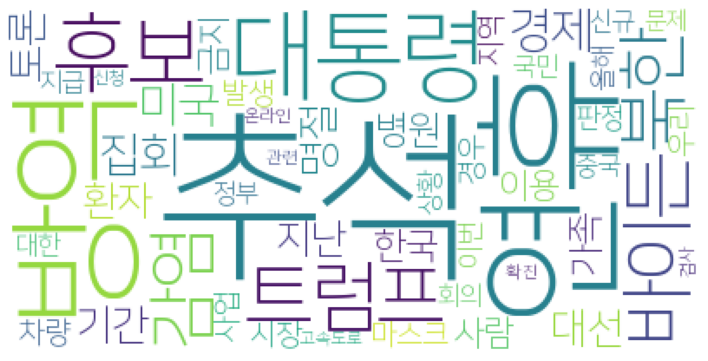

2020.09.29
['버스', '마스크', '연합뉴스']
['판정']
['수업', '학생', '부산']
['확진']
['판정']
['장관', '메콩', '협력', '개국', '외교부']
['조선', '추석', '오지']
['집회', '금지', '차량', '자유', '원칙', '방침', '시위', '라며', '전면']
['방역', '연휴', '휴게소', '추석']
['집회', '금지', '차량', '자유', '원칙', '방침', '시위', '전면', '라며']
['투어', '유럽', '골프', '사우디아라비아', '여성', '사우디']
['마스크', '제주', '연휴', '근무', '방역']
['울산', '판정', '부산']
['울산', '판정', '부산']
['폐업', '사람']
['폐업']
['폐업']
['임금', '체불', '회사', '영상']
['조선', '산업']
['선인', '업자', '소상', '공인', '폐업', '중고', '철거', '식당', '업체', '호황', '컴퓨터', '상가', '주방', '매출', '문의', '점포', '경향신문', '매장', '자영', '대출']
['여행사', '대표', '사무실', '직원', '업계']
['차량', '집회', '금지', '한국', '처분', '시위', '유지', '신청']
['사망자', '치료', '확진']
['사망자', '치료', '확진']
['춘절', '연휴', '우한', '시작', '사람']
['집회', '국민', '조선', '법원', '차량', '운동', '본부']
['트럼프', '후보', '바이든', '대통령', '토론', '지지', '여론조사', '민주당', '미국']
['수업', '등교', '부총리']
[]
['조선', '버스']
['질서', '집회', '개천절', '법원', '시위', '경찰', '금지']
['박상훈', '어머니', '엄마', '간호사', '사랑', '의료', '전담', '상훈', '아들', '우리', '성숙', '박성훈', '지원', '물리치료사']
[]
['감염',

['서울시', '집회']
['위약금', '분쟁', '소비자', '기준', '감염병', '발생', '경우']
['교육', '아동', '국적', '학생', '다문화', '차별', '경향신문', '정부']
['집회', '금지', '대위', '감염', '위험', '재판', '참가자', '질서', '대한', '주장']
['경제', '부총리', '우리', '기재부']
['시험', '의학', '의사', '의료', '정부', '의대', '국시', '거부', '경제', '기회', '국민', '건강']
['외국', '국적', '지원', '학생', '교육감', '아동', '교육부', '지급', '대한', '정부', '특별', '지난', '오마이', '검토', '일본', '대상', '교육청', '원금', '차별', '대해', '시도']
['모습', '명절', '평등', '가족', '시민', '응원', '추석', '메시지', '서울시', '여성', '참여', '계획', '직접', '격려', '지인', '제시', '친구', '재단']
['명절', '평등', '가족', '시민', '응원', '추석', '메시지', '서울시', '여성', '계획', '참여', '제시', '재단', '직접', '격려', '모습', '친구', '지인']
['트럼프', '대한', '신율', '이유', '센터', '변화', '격차', '경제', '가능성', '상황', '부분', '문제', '측면', '우리', '결과', '증시', '매우', '미국', '계속', '이슈', '북한', '시위', '제일', '이야기', '접근', '이번', '실제', '주식', '다른', '그것', '대통령', '지지율', '영향', '선거', '조정', '정치', '오히려', '바이든', '대선', '때문', '정도', '사실', '우려', '환경', '평균', '생각', '입장', '기적', '관련', '집권', '기본', '안정', '가장', '현재', '불복', '이벤트', '장기', '다시', '정책', '예측', '교수'

['집회', '금지', '경찰', '개천절', '대위', '통고', '법원', '측은', '처분', '방역', '한국', '집행정지', '신청']
['시설', '지급', '원금', '특별', '휴업', '접수', '고양시', '위험', '신청']
['포항', '확진']
['신세계', '이마트', '대졸', '채용', '공채', '진행', '조선']
['기업', '대기업', '포인트', '하락', '확산', '경기', '중소기업', '상승']
['운영', '추석', '연휴', '대책', '시민']
[]
['수출', '가스', '장관', '기업', '산업', '트론', '방문']
['미국', '백신', '임상시험', '개발', '후보', '물질', '중국', '접종', '지난']
['지급', '폐업', '소상', '공인', '오늘']
['백신', '러시아', '대통령']
['노컷뉴스', '대통령', '시장', '상인', '추석', '방문', '걱정']
['대통령', '추석', '시장', '방문']
[]
['인왕', '여사', '대통령', '시장', '상인', '추석', '재래시장', '방문', '연휴', '격려', '이번', '걱정']
['추석', '선물', '연휴', '방역', '자제', '시설', '방문', '정부', '고속도로', '성묘', '우려']
['고속도로', '추석', '선물', '연휴', '방역', '자제', '시설', '방문', '성묘', '정부', '우려']
['장관', '외교부', '라브', '영국', '한국', '대해', '강경화', '전략', '대화']
['추석', '명절', '연휴', '이용', '고향']
['고령자', '치명', '방역', '이상', '사망자', '환자', '질환']
[]
['주민', '경제', '사업', '신재생에너지']
['취미', '하비']
[]
['사업', '지역', '사회', '재활', '복지', '부산']
['수출', '가스']
['수출', '장관', '이후', '가스', '우리', '회복', '전환']
['

['출시', '후면', '스마트폰', '아이폰', '카메라', '디스플레이', '프로', '전자', '미니', '회전', '화소', '업계', '국내', '모델', '광각', '맥스', '기능', '사용', '인치', '갤럭시', '전망', '다음', '탑재', '시리즈', '지원']
[]
['확산', '가림', '설치']
['반려동물', '호텔', '여행', '동물']
['교육', '학교', '협력', '지역', '경남', '교육청', '기관', '사업', '혁신']
[]
['열차', '추석', '예매', '좌석', '발매']
['수주', '선박']
['전북']
['수출', '바이러스', '진단', '독감', '검사']
['방역', '활동', '시설', '점검']
['부산', '이용', '연합뉴스']
['의료', '기간', '정보', '진료', '제공', '연휴', '굿닥', '서비스']
['등교']
['수도권', '단계', '감염', '방역', '지수', '연휴', '상황', '재생산', '거리', '효과', '수가', '추석', '집단', '미만', '부장', '신규', '두기', '부본', '당국', '지난']
['부총리', '경제', '우리', '기재부']
['부장', '감염', '방역', '부본', '거리', '두기', '효과', '감소', '연휴']
['후유증']
['아동', '지급', '원금', '미취', '지원']
['포항']
['상어', '백신', '스쿠알렌', '개발', '마리', '멸종', '희생']
[]
[]
['공연', '방송', '나훈아', '한국']
['회사', '백신', '접종', '진행']
['시장', '사망', '루마니아', '알리', '이온']
['키트', '지급', '검사', '진단', '소득', '국가', '바이러스', '게이츠']
['후유증']
['제주', '검사', '방역', '발열']
['추석', '시민', '삼척', '당부', '모두', '예방', '방역']
['모두', '추석', '시민', '삼척', '당부', 

['시설', '동해시', '명령', '공기업', '시민']
['교수', '관계', '관리', '일본', '한일관계', '최고', '지도자', '대통령', '우선']
['위약금', '취소', '소비자', '예식', '결혼식', '계약']
['부산', '검사', '부민', '감염', '격리', '동아대', '접촉', '부산시', '판정', '캠퍼스', '학생', '환자', '누적', '가운데', '동아리', '조사']
['차관', '의료', '보건', '시험', '대해', '정책', '상황']
['개발', '비대', '표준', '경제', '아이', '디지털', '포럼', '표준화', '기술', '서비스', '추진', '국제']
['노비', '진행', '미국', '백신', '임상시험', '세포', '면역', '개발', '현재', '또한']
['영상', '김정숙', '어르신', '추석', '여사', '마음', '부모님', '자식', '인사말', '국민', '의성군', '편지', '자제', '명절']
['의료', '백신', '냉장고', '보관', '온도', '보건소', '과정', '조사', '유지', '바이러스', '경우', '독감', '기관']
['감염']
['재검', '완치', '부산', '비율', '출자', '바이러스']
['부산', '재검', '완치', '비율', '출자', '바이러스']
['연휴', '버스', '모습', '연합뉴스']
['점검', '방역', '행정지도', '휴게소', '식약처']
['북한', '국민', '주장', '의원', '조선']
['방역', '로봇']
[]
['교육청', '학교', '교육감', '도청', '플랫폼', '경남', '교육', '협력', '지역', '측은', '지원', '체계', '사업', '아이', '혁신', '김경수', '지사', '발굴', '추진', '통합교육', '공동', '박종훈', '공동체', '남도', '모델', '합의']
['매출', '면세점', '국내', '지난']
['출산율', '사회', '관련']
['집회',

['시험', '의료', '차관', '보건']
['달러', '중국', '위안화', '이후', '금리']
['구간', '부선', '발생', '사고', '경향신문']
['지명']
[]
['서비스', '자전거', '모빌리티', '퍼스', '이동', '수단', '확대', '공유', '보험', '보드', '사람', '운영', '경제', '카카오', '최근', '도로']
['진행', '강연', '실시간', '센터']
['보건소', '그림']
['상어', '스쿠알렌', '백신', '마리']
[]
['위약금', '예식']
['경찰', '난간', '격리', '부산']
['연휴', '연합뉴스']
['진단']
['조금', '업자', '명절', '운영', '강씨', '추석', '회사', '자영', '배달']
['치료']
['교육', '한국', '브레인', '진흥', '통해', '뇌교육', '진로']
['상어', '백신', '스쿠알렌', '마리']
[]
['인수', '두산인프라코어', '중공업', '건설', '기계', '업계', '매각', '이스타항공', '수준', '항공', '은행', '지원']
['치료', '인플루엔자', '감염', '투여', '사마', '효과', '바이러스', '요법', '사망률', '이드']
['인플루엔자', '치료', '감염', '투여', '사마', '효과', '바이러스', '요법', '사망률', '이드']
[]
['교육', '어린이', '영상', '교통', '공단', '안전']
['제한', '라면', '불허', '대해', '집회', '경찰', '차량', '시위', '기본권', '국민', '방역', '면허', '라며', '취소', '금지', '지적']
[]
['보증금', '주택', '이하', '가구', '지원', '경우', '최대', '신혼부부']
['지급', '아동', '원금', '초등학생', '중학생', '특별', '신청', '추석']
['창업', '국가', '아이', '장애인']
['신세계', '이마트', '주가', '증여', '하락', '증권', '결정

[]
['키트', '진단']
['구간', '소득', '통합', '상위', '명의']
[]
['휴게소', '이용']
['뜸부기', '호주', '수출']
['게임', '추석', '영상통화', '이벤트', '연휴', '박스', '활용', '가족', '체크', '안부', '인사', '출석']
['문화', '음주', '건전', '오비맥주', '직원', '글로벌']
['연휴', '추석', '집회']
['서비스', '새벽', '쿠팡', '배송', '당일', '추석', '연휴', '상품', '기간', '마켓', '프레', '전날', '명절', '컬리']
['조달', '진단', '키트', '네오플', '렉스', '공급', '글로벌']
['연휴', '이데일리', '추석', '이용', '계획']
['우라늄', '시설', '회원', '전문가', '보고서', '패널', '활동', '선박', '제재', '제품', '지난', '북한', '소형', '탄도미사일', '중이', '조달', '석탄', '보고', '불법', '수출', '시도', '실험', '대북', '해외', '개발', '내용', '수입', '올해', '계속', '파악', '정유', '평가', '농축']
['흑인', '소득', '가구', '자산', '백인', '하위', '주택', '부의', '가계', '경제', '조사']
['미술관', '전시기획자', '예술', '미술', '해외', '현대', '인사', '국내', '국내외']
['전시기획자', '예술', '미술', '해외', '현대', '인사', '국내', '국내외', '미술관']
['신세계', '이마트', '경영', '그룹', '회장', '부회장', '총괄', '사장']
['공기', '청정', '시스템', '미세먼지', '연구', '결과', '대한', '청약', '실내']
['건강', '홍삼', '기능', '식품', '선물', '스틱', '추석', '일화', '제품', '인기', '만만', '대표']
['공익', '활동가', '재단', '서울시', '비영리단체', '융자', 

['보호', '아동', '민간', '조사', '아동학대', '기관', '전담', '공무원']
['토론', '대통령', '트럼프', '바이든', '라며', '대선']
[]
['휴게소', '도로공사', '운영']
[]
['올해', '기증', '장기', '이식']
['접종', '러시아', '백신']
['이란', '석탄', '북한', '제재', '수출', '활동', '무기', '회사', '유엔', '대북', '보고서']
['사기', '무역', '기업', '이메일', '업체', '송금', '거래', '발생', '코트라', '수출']
['진단']
[]
[]
['동시', '독감', '감염', '유행', '방역', '바이러스']
['휴게소', '추석', '연휴', '고속도로', '입구']
['북한', '사망자', '감염', '방역', '연합뉴스']
['귀성', '국민', '인사', '생략', '추석', '당부', '정부', '상황', '일정']
[]
['수유', '모유', '연구', '결과']
['미국', '상승', '부양책', '에너지', '지수', '대한', '거래', '중국']
['병가', '민원', '관계자', '특혜', '청탁', '논란', '장관', '의혹', '보좌', '아들', '정황', '수사', '추미애', '보고', '당시', '휴가', '대해', '관련', '연장', '국방부', '검찰', '지난', '확인', '군무', '기피', '법무부', '사실', '판단', '조사', '결과', '혐의', '서씨', '발표', '설명', '제기', '전화', '정치', '국민', '정기', '복귀', '결론', '지적', '대한', '국회']
['요건', '시행', '법안', '주주', '하향', '정부', '개인', '투자자', '주식', '기재부', '의원', '유예', '개정', '여당', '도세', '소속', '위원회', '기준', '결정', '때문']
['질환', '혈관', '위험', '복용', '심장', '환자', '예방']
['항공사', '항공', 

['개발', '실험', '바이러스', '봉쇄', '확산']
['기후', '변화', '나토']
['명절', '음식', '기간', '가족', '감염', '교수', '개인', '면역', '도움', '경우', '마스크', '건강']
['그룹', '한화', '사업', '부문', '솔루션', '전략', '회사', '대표']
['사람', '전통', '시장', '손님', '추석', '상인', '연휴', '송편', '가격', '매출', '올해']
['총재', '집회']
['보건소', '연휴', '기간', '상담', '진료', '운영']
['서비스', '구축', '머신', '오라클', '시장', '기업', '계획', '제공', '직원', '데이터', '요구사항', '맞춤', '빅데이터', '러닝', '관리', '인사', '분석', '솔루션', '성과', '확대', '고객', '지원', '위해', '설계', '비용', '양성', '기술', '기능', '중심', '산업', '한국', '교육', '채용', '사용자', '반영', '콘텐츠', '인재', '경험', '단일', '국내', '스톤', '개발', '기반', '클라우드', '운영', '조직', '업무', '통해', '통합', '적용', '시스템', '인력', '니트', '변화', '모바일']
['경찰', '대위', '측은', '집회', '금지', '개천절', '통고', '처분', '방역']
['지구', '대회', '사랑', '미술', '자원', '연구원', '지질']
['가금', '농가', '방역', '차단', '관리', '발생', '실시', '소독', '구제역', '검사', '위해', '대해', '철새']
['집회', '금지', '경찰', '사무', '총장', '개천절', '통고', '신고', '대위', '대한', '처분']
['청사', '확진']
['인천', '검사', '양성']
['수색', '북한', '우리', '조사', '관련', '승인', '공무원', '반출', '사건', '어제', '오늘', '당국', '강조', '

['병원']
[]
['감염']
['매출', '백화점', '유통업체', '온라인', '작년', '전체', '감소']
['기록', '신규', '발생', '누적']
['그리스']
['검사', '발생', '신규', '감소', '방역', '오마이']
['명절', '추석', '환자', '음식', '이동', '피로', '장거리', '시간']
['음주', '건전', '문화', '오비맥주', '캠페인', '직원']
['가족', '전파', '사우나', '시설', '위험', '감염', '이용', '발생', '경제', '지속', '사람', '지적', '접촉']
['생산', '영향', '상승', '감소', '지난', '지수', '지난달', '대비', '소비', '반등', '동행', '판매', '확산', '전달', '선행', '변동', '노컷뉴스', '순환']
['영상', '어르신', '의성군', '여사', '매일신문', '마음']
[]
[]
['금지', '집합', '명령', '고발']
['스팸', '불법', '이상', '도박', '유통', '부의', '휴대전화', '신고', '급증', '의약품']
['사람', '고혈압', '혈당', '운동', '건강', '허리', '경우', '근육', '환자', '디스크', '당뇨', '자신', '등산', '혈압', '윗몸']
['운동', '사람', '건강', '허리', '경우', '근육', '환자', '윗몸', '고혈압', '혈당', '당뇨', '등산', '디스크', '혈압', '자신']
['진료', '제천시', '운영']
['완도', '코레일', '관광', '완도군', '개발', '협약']
['민원', '부산']
['드림', '타워', '개장', '직원', '교육']
['직원', '리테일', '검사']
['방역', '연휴', '추석', '기간', '준수', '생활', '학생']
['부산', '지역', '동래구']
['스미싱', '문자', '지원', '문자메시지', '원금', '주소', '경우', '대상']
['채용', '직원', '경력', '여명

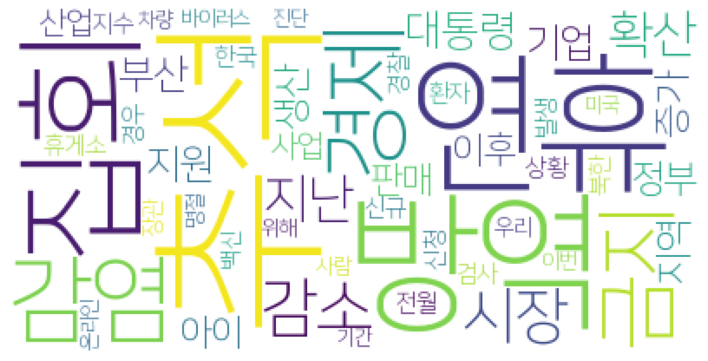

2020.09.28
['남양주', '보건소', '대응', '상황']
['회장', '지원', '매각']
[]
['마스크', '소방', '경기', '화이팅']
[]
['신고', '아동', '조사', '보호', '발굴', '시스템', '경우', '학대', '대상', '위험', '행복', '현장', '관리', '정황']
['교회', '감염', '청주', '현수막']
[]
['사장', '해임', '감사', '절차', '인천공항', '국토부', '공사', '대행', '과정', '권한', '국민일보']
['가구', '임대주택', '제주도']
['기부']
[]
['미군', '장병']
['정유경', '신세계', '그룹', '이마트', '정용진', '부회장', '사장', '회장', '증여']
['미국', '사망자']
['단풍', '설악산', '시작', '올해', '연합뉴스']
['중국', '순환', '계획', '전회', '경제', '중앙', '개년', '회의', '국내']
['자동차', '극장', '이용', '경향신문']
['푸틴', '협력', '대통령', '아이', '한국', '한반도', '발전', '평가', '노력', '분야', '대해', '양국']
['응급의료', '헤럴드경제', '연휴', '비상', '진료']
['백신', '독감', '조선', '동시', '가격', '확인']
['동선', '고발', '대전', '다단계판매업', '전시', '연합뉴스']
['정용진', '신세계', '그룹', '회장', '이마트', '증여', '총괄', '사장', '부회장', '정유경', '보유']
['자금', '부산', '상공', '접수', '공단', '희망', '지급', '지원']
['푸틴', '양국', '발전', '대통령', '협력', '러시아', '정상', '통화', '한국', '관계', '한반도', '부산']
['요오드', '용액', '조동찬', '포비']
['태국']
['사우나', '직원', '확진', '판정', '추가', '감염', '가족', '서울시', '의회', '중앙']
['

['증가', '모스크바', '신규', '이후', '러시아', '하루', '지난']
['경제', '지사', '지역화폐']
['중소기업', '지원', '충북', '피해', '대출']
['백신', '질병', '접종', '의료', '기관', '독감', '사례']
['상담', '통신비', '지원', '관련', '전화', '이동전화', '차감', '요금']
['대표', '한국', '백신', '개발', '센터']
['대표', '한국', '백신', '개발', '센터']
['특별', '철도', '대책', '방역', '점검', '열차', '이용']
['국회', '사무', '상임', '위원회', '방역', '총장', '국정감사', '국감', '김영춘', '참석', '이데일리', '활동', '조치', '관련', '진행']
['지원', '기업', '기금', '회장', '기안', '이스타항공', '대해', '중이', '제주항공']
[]
['솔루션', '한화', '대표', '부문', '그룹', '인사', '내정', '사업', '부사', '전략', '기계', '발탁', '화학', '대표이사', '승진', '방산']
['두산인프라코어', '중공업', '그룹', '두산', '인수', '건설', '기계', '시장', '중국', '국내', '업계', '때문', '예상', '자금', '재무', '은행', '매각', '회사', '투자', '보유', '소송']
['구진', '모유', '바이러스', '세포', '산모', '결과', '감염', '수유']
['춘천시', '버스', '재정', '지원', '지난해', '올해', '수입']
['시위', '방침', '드라이브', '단체', '라며', '금지', '경찰', '정의당', '방역', '차량', '봉쇄', '전면', '확산', '제한', '집회', '대해', '행위', '방법', '불법', '지난', '교통', '대응', '참여연대', '스루', '정부']
['추석', '음복', '제사', '도시락', '참배', '공무원']
['회장', '쌍용차', '대

['사망자', '미국', '전쟁', '수가', '통계', '기준', '브라질']
['광주']
['명의', '경향신문', '홈페이지', '지원']
['웹툰', '순천시', '사업', '지역', '일자리', '청년', '기업', '콘텐츠', '순천', '산업', '만화', '센터', '진행', '지원', '시대', '업무', '교육', '대응', '창의', '글로벌', '창업', '작가', '인재', '제공', '경제', '크리에이터', '프로젝트', '위해', '고용', '맥가이버', '양성', '문화', '근로자']
['집회', '대위', '경찰', '금지']
['스태프', '판정', '촬영']
['과학관']
['감소', '종사', '지난달', '조선']
['유행', '독감', '동시', '확인', '사례', '본부장']
[]
['관리자', '물류', '작업', '감염', '노동자', '쿠팡', '노동', '보고서', '계약', '경향신문', '센터']
['국민', '생활', '가구', '원금', '지급', '공무원', '격리', '대상', '경우', '입원']
[]
[]
[]
['보건소', '격리', '자가', '가족', '위해', '안전', '예산', '접촉']
['확산', '사망자', '백신', '세계', '연합뉴스']
[]
['추석', '명절', '게임', '소개', '이벤트', '앱스토어', '가족', '맞이']
['달님', '대통령', '위원장', '현수막', '영창', '문구']
['백신', '독감']
['확진', '경로', '격리', '입소', '관련', '기준', '요양원', '추가', '지난', '검사', '치료', '병상', '가족', '감염']
['전월', '전망', '광주', '전남', '소비자', '하락', '심리', '대비', '각각', '지수']
['유사', '업체', '불법', '경향신문', '형태']
['물류', '산업', '회장', '구조조정', '관련', '기업', '경제', '면서']
['대해', '이후', '사회', '준

[]
['직장인', '브이', '로그', '회사', '유튜브', '모습', '퇴사', '정말']
['구축', '대한', '노키아', '네트워크', '엔드', '인증', '아이', '프로그램', '과정', '전문가', '개방', '기능', '업체']
['병원', '포항', '격리', '환자', '세명', '기독', '경주', '확진', '지난', '입원', '판정', '명화']
[]
['제주시', '구조조정', '시장', '시민', '뉴딜']
[]
[]
[]
[]
['유학', '영국', '대학교', '학생', '박람회', '대한', '또한', '예정', '제공']
['뱅킹', '인터넷', '이용', '금액', '모바일', '하반기', '지난해', '서비스', '올해', '평균', '상반기', '증가', '대출', '고객']
['패키지', '세트', '반려동물', '추석', '상품', '증가', '관련', '간식', '연휴', '가구', '지난', '올해', '대비', '매출', '전용', '선물']
['문화', '회관', '공연', '세종', '음악']
[]
[]
['신한은행', '적십자사']
['교육청', '마스크', '뮤직비디오', '학생']
['전남', '치료']
[]
[]
[]
[]
[]
[]
[]
[]
['대한', '학습', '해결', '아이', '엄마', '산시', '서비스', '확대', '면서', '의견', '방안', '수립', '어려움', '진보당', '설문', '결과', '육아', '발표']
['기업', '대비', '제조업체', '정상', '경영', '전망', '내년', '상반기', '유지', '상황', '목표', '감소', '기록', '수출', '부문', '결과']
['우즈베키스탄', '광주', '지역', '해외', '입국', '국적', '곧바로', '자택', '격리']
['대구', '문화', '추석', '추천', '경북', '코스', '관광', '드라이브', '여행', '공원', '연휴', '대구시', '걷기']
['순천시', '사망']
[]

['수능', '시험', '방역', '조치', '관리', '수업', '환경', '감독', '학년', '확보', '학교', '주일']
['방역', '보성군']
['조선']
['자금', '연장', '어업', '대출', '부산']
[]
['선물', '세트', '백화점', '매출', '추석', '증가', '판매', '지난해']
['때문', '매출', '마스크']
['신규', '방역', '상담']
['자살', '상담', '전화', '인력', '평균', '계획']
['내년', '무선', '파워넷', '경제']
['북한', '사망자']
['수업', '학습', '혼합형', '등교', '역량', '연수', '교사']
['집회', '차량', '의원', '시위', '자료', '전체', '확진율']
['관리', '대응', '감염병', '조직', '역학']
['감염병', '관리', '대응', '조직', '역학']
['재판']
[]
['중국', '전기차', '모터쇼', '베이징', '차량', '세계', '시장']
['사망자', '세계']
['백신', '세계']
[]
[]
[]
['청주시']
['연휴', '그룹', '중국', '올해', '회장', '추석', '전략', '사업', '부회장', '기간', '국내', '해외', '사태', '시장', '구상', '점검', '경영', '현대차', '장기', '이후', '준비']
['집회', '경찰', '개천절', '면허', '대해', '경우', '관련', '지난', '위험', '벌점', '정지', '금지']
['지원', '종교시설', '건의', '대해', '구리시']
['집회', '금지', '대해', '부산', '차량', '정부', '경우']
[]
[]
['기업', '그린', '선정', '녹색', '뉴딜', '환경부', '혁신', '유망', '사업', '산업', '개사', '정책', '분야', '지원', '장관', '부처', '중소기업']
['접촉', '대구', '판정', '검사', '음성', '빙상', '결과']
[]
[]
['국방부', '우리'

['대응', '차량', '집회', '금지', '대해', '통고', '경우', '개천절', '정부', '강행', '대규모', '확산', '위험성']
['집회', '경우', '차량', '금지', '대해', '대응', '통고', '개천절', '정부', '확산', '강행', '위험성', '대규모']
['과속']
['과속']
['방역', '아이']
['중국', '전기차', '모터쇼', '베이징', '차량', '세계', '시장']
['사망자', '국내', '환자', '기준']
['방역', '지역', '전날']
['부작용']
['신규', '발생', '유입', '국내', '해외']
['국내', '렘데', '시비르', '허가', '치료', '사용', '부산', '부작용', '식약처', '지난']
['조달', '씨젠']
['수출', '진주시', '기업', '물류', '지원', '사업']
[]
['전날', '지역', '신규', '방역']
['아이', '신규', '격리']
['대학', '부산', '영상', '퀴즈', '동명대', '지난', '명소', '정도', '참여', '탐방']
['부산', '영상', '퀴즈', '동명대', '지난', '명소', '탐방', '대학', '정도', '참여']
['때문', '매출', '마스크']
[]
[]
['집회', '차량']
[]
['시험', '분리', '위성', '발사', '러시아', '구진', '차세대', '중형', '진행', '작업', '항우연', '발사체', '지난', '격리']
['위기', '가구', '임대주택']
[]
[]
[]
[]
['논산시', '프로그램', '충남', '운동', '참여자']
['트렌드', '극장', '국민', '분석', '변화', '이동', '이용', '아이', '모빌리티', '통해', '텔레콤', '데이터', '과속', '서비스', '차량', '감소']
[]
[]
[]
[]
[]
['감소', '이데일리', '국내', '발생']
['신규']
['사망자', '인도', '확산']
['대법관', '검사', '세계', '하

['국가']
[]
['의원']
['운영', '방역', '시설', '조치', '금지', '감염', '위험', '집합', '실내']
['주식', '개월', '보유', '평균', '기간', '투자', '의원']
['대학생', '학교', '학생', '음식', '봉쇄']
['사망자']
['세계', '사망자', '누적', '미국']
['사망자']
['휴게소', '고속도로', '운영', '통행료']
['휴게소', '고속도로', '운영', '통행료']
['공원', '낙동강', '시민', '체육']
['상장', '자회사', '카카오', '페이', '증권', '성장', '사업', '내년', '출범', '투자']
['공매도', '금지', '기관', '투자자', '종목', '평균', '셀트리온']
['집회', '확산', '차량']
['개방']
['축제', '평창', '온라인', '때문', '송어', '지역', '가을', '취소', '백일홍', '시민', '행사', '매년', '올해']
['부산']
['소독', '부산', '효과', '바이러스', '배양']
['추석', '감염', '포함', '방역', '수도권', '연휴', '주간', '금지', '판매', '지역', '단계', '신규', '실내', '좌석', '상황', '집단']
['누적', '사망자', '한국']
['입력', '기관', '의료', '데이터', '보건소']
['연휴', '세계', '연합뉴스']
[]
['러시아', '위성', '중형', '발사', '차세대', '한국', '구진', '개발', '예정', '공동']
['기간', '공매도', '금지', '기관', '투자자']
['국내', '탈북민', '입국', '올해', '지난달']
['사망자', '전세계']
[]
['시비르', '국내', '지난', '렘데', '부작용', '치료', '발생', '식약처', '사용', '허가']
['백신', '독감', '사망자']
[]
['탈북민', '국내', '입국', '올해', '지난달', '북한']
['분리', '경량', '개발', '안전

[]
['명절', '시장', '추석', '과일', '올해', '손님', '최씨', '정도', '수입']
['극장', '이용', '텔레콤', '과속']
['호텔', '서비스', '아리아나', '행사', '제공', '직장인']
['상담', '전화', '자살', '인력', '예방']
['방문', '데이터', '과속', '트렌드', '증가']
['연휴', '기간', '추석', '방역', '시설']
['자동화', '도입', '답변', '고용', '이상', '직원', '비용', '임원', '부문', '증가', '기업', '재택근무', '매킨', '관리', '기술', '응답', '자의', '서비스', '안전', '정보기술', '가속', '대상', '이후', '디지털', '비율', '계약', '미국', '로봇']
['현재', '무역', '영국', '위기', '세계', '신흥', '이후', '각국', '종식', '지원', '협정', '국제', '재정', '달러', '시장', '지속', '확산', '브렉', '인플레이션', '채무', '개발', '상황', '가능성', '부채', '불확실', '미국', '시트', '전망', '경제', '백신', '올해']
['청렴', '경제']
['뮤지컬', '오프라인', '딤프', '축제', '개최', '공연', '온라인', '창작']
['사망자', '부산', '세계', '누적']
['대전', '축제', '경제', '국향', '취소', '지역', '함평', '올해', '개최']
['롯데', '주류']
['청렴', '지역', '본부', '시대', '방식', '캠코', '확산', '혁신', '지원']
['이하', '거래', '감소', '다방', '임대', '전세', '원룸', '전월세', '보증금', '차법', '시행', '거래량']
['서울시', '관련', '감염', '경로', '이후', '신규', '감소']
['금융', '비대', '불안감', '서비스', '자산', '관리']
['금융', '비대', '불안감', '서비스', '자산', '관리']

['건설', '회사채', '발행', '금리', '해외', '채권', '상황', '산업']
['매출', '와인', '과자', '편의점', '치즈', '구매', '세븐일레븐']
['치즈', '와인', '과자', '매출', '편의점', '구매', '세븐일레븐']
['한국', '노바티스', '대한', '학회', '협회', '회장', '지원']
[]
['매점매석']
['박스', '마스크', '식료품', '전달', '지역']
['요양원', '면회']
['기업', '자금', '회사채', '발행', '보증', '피해', '산업', '유동화']
[]
['신규', '발생', '이후', '감염', '국내', '환자', '수도권', '격리', '사회', '양성', '지난', '집단', '인천', '확인', '확진', '관련', '가족', '모임', '감소', '명의', '판정', '전날']
['조선']
['무릎', '경우', '추석', '연휴', '시간', '척추', '통증', '우울', '신체', '질환', '배달', '부들', '증후군', '명절', '가족', '습관', '증가', '시차', '노인', '건강', '몸통', '음식', '올해', '부담', '때문']
[]
['차량']
['확산', '재개', '울산', '박물관', '추석', '연휴']
['대응', '감염병', '관리']
['도서관']
['명절', '사람', '손님', '정도', '추석', '시장', '과일', '올해', '선물', '가게', '수입', '준비', '최씨']
['보건소', '검사', '음성군']
['신규', '감염', '지역', '사흘', '집단', '사례', '누적', '발생', '전날']
['유입', '집단', '해외', '감염', '신규', '지역', '발생', '전날', '수도권', '검사', '사례', '방역']
['거래', '감소', '전세', '보증금', '이하', '원룸', '개구', '상승', '지난']
['확진', '발생', '환자', '지난', '판정', '감염', '기준', '

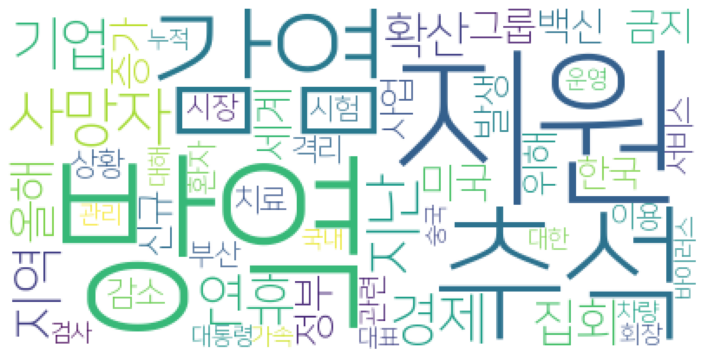

2020.09.27
['이탈리아', '수업', '학교']
[]
['북한', '서해', '우리', '영해', '침범', '주장', '군사', '남북']
['대선', '후보', '토론회', '트럼프', '바이든', '악수', '토론', '이번']
['환자']
[]
[]
['임대료', '건물', '임대']
['대전']
['격리', '병동', '의료', '근무', '중랑구', '간호사', '검사']
['연휴', '가족']
[]
['행사', '인제', '인제군', '군민']
[]
['마을']
[]
['중국', '전기차']
[]
['추모', '추석', '연휴']
['서화면', '국방기술품질원']
['연휴', '미리', '추석', '사람', '명절']
['예고', '집회', '일부', '차량', '보수', '단체', '정세균', '국무총리', '개천절']
['상가', '임대료', '규정', '사유', '계약해지', '감액', '임차', '적용', '초과', '차임', '임대차', '보증금', '임대차보호법', '영업', '경우', '증감', '관련', '경향신문', '분쟁', '급감', '월세', '환산', '청구', '임대', '계약']
['추석', '이번', '선물', '방문', '방역', '올해', '연휴', '마음', '친척']
['추석', '연휴', '가족']
['추석', '시설', '방역', '수도권', '감염']
['투자', '주식', '주가', '경제', '성장', '과도', '한국', '대한', '가격', '버블', '투자자', '장주', '경향신문', '장기', '열풍', '테슬라', '반영', '경우', '마이너스']
['이번', '사건', '관계', '남북', '신뢰', '존중']
['기간', '체계', '방역', '단계', '추석', '시설', '특별', '관련', '현재']
[]
['항공', '백신', '운송', '경향신문', '항공사']
['금리', '증가', '대출', '신용', '은행', '당국', '인상', '경향신문', '금융', '추석'

['인문', '단체', '인문학', '부산', '연대', '진행', '프로젝트', '문화', '행사', '시대', '지역', '그것', '프로그램', '진흥', '지하철', '부산시', '시민']
['차량', '집회', '행진', '금지', '이용', '단체', '경찰', '신고']
['체험', '시민', '공간', '모습', '에스', '파스', '행사', '둥지', '김용', '금호강', '자연', '조형', '자전거', '이번', '마련', '조성', '생태', '텐트']
['신규', '연휴', '최고', '기록', '연합뉴스']
['신규', '연휴', '최고', '기록', '연합뉴스']
['신규', '연휴', '최고', '기록', '연합뉴스']
['시장', '추석', '방역', '전통', '시민', '연합뉴스']
['유학생', '조리', '외국인', '한국']
['방역', '국민', '시설']
['긴급', '국민', '대통령', '시위', '민주당']
['모임', '관련', '접촉']
['대국민', '담화', '총리', '정부', '방역', '국민', '마스크', '금지', '지난', '단계', '발표', '이후', '연휴', '관리', '두기', '시행', '거리', '사회', '국내']
['온라인', '오픈스튜디오', '진행', '청주시']
['가족', '확진', '거주', '안양', '군포시', '군포', '모임', '자녀']
['토론', '후보', '트럼프', '대통령']
['집회', '방역', '정부', '총리']
['방역', '시설', '서울시', '기간', '금지', '연합뉴스']
['강원', '추석', '연휴', '방역', '제주', '지역', '기간', '조치', '발열']
['남북', '북한', '국제사회', '유해', '수습', '조사', '사건', '인권', '관계', '공동']
['연합뉴스', '누적', '신규', '연휴', '관련']
['임대료', '임대', '상가']
['온택트', '축제', '문화제', '송파', '문화', 

['예배', '점검', '교회', '방역', '대면', '현장']
['금지']
['추석', '특별', '기간', '시설', '운영', '방역', '서울시', '체육', '문화', '조치', '치료', '대책', '이용', '연휴', '다중', '유지', '금지']
['연휴', '시설', '운영', '방역', '서울시', '추석', '특별', '기간', '체육', '다중', '조치', '금지', '문화', '대책', '치료', '유지', '이용']
['제품', '이상', '가전', '매출', '증가']
['군포', '가족', '경제', '모임', '확진', '자녀']
['국민', '총리', '집회', '방역', '안전', '우리', '재난', '추석', '이번']
['미국', '주식시장', '투자', '증권', '전망', '조정', '이익']
['감염병', '정보', '의원', '의심', '국민', '수집']
['라며', '집회', '총리', '국민', '추석', '방역']
['충전', '주민', '계획', '구축', '허가', '서울시', '사업', '설명', '산업', '자치구', '탄천', '요구', '수소', '핵심', '센터', '위해', '관련', '재생']
['의원', '의대', '회장']
[]
['우리', '확산', '국민', '총리', '방역', '집회', '안전', '고통', '단체', '추석', '정부', '기간', '연휴', '발표', '특별', '강조', '라며', '이번', '담화', '지난']
['방역', '감소', '수도권', '감염', '주간']
['북한', '차장', '종전', '선언', '본부장', '미국', '한반도', '장관', '유엔', '논의', '관련', '방미', '비핵화', '외교부', '라며', '방문', '국무부', '대선', '한미', '대화', '정부', '평화', '대해', '청와대', '상황']
['집회', '총리', '경향신문', '담화', '발표']
['실황', '기록', '오페라', '프랑스', '공

['서비스', '게임', '시장', '클라우드', '아마존', '루나', '구글', '아이', '컴퓨팅', '공략', '애플']
['감지기', '경찰']
['감지기', '경찰']
['운영', '진료']
['지역', '포항시', '대응', '발생']
['관리', '갈등', '사무소', '층간소음', '해결', '민원', '직원', '사람', '이웃']
['어린이집', '교실', '아이', '부모', '육아', '운영', '공동', '교육', '방과', '엄마', '공동체']
['삭감', '독일', '재정', '준칙', '도입', '적자', '제도', '국가', '채무', '경우', '회원', '대비', '경제', '강제', '정책', '정부', '개국', '미국', '규정', '운영']
['경제', '사회', '참여']
['집회', '정세균', '정부', '총리']
['재정', '정부', '국가채무', '준칙', '비율', '대통령', '추경', '차기', '채무', '이후', '재난', '문재인', '국가']
['조리', '유학생', '외국인']
['속도', '이후', '사망자', '환자', '증가', '위중', '국내', '개월', '고령자', '발생', '지난', '음압', '지역', '병상', '대구', '방역', '중순', '치료']
['준칙', '재정', '국세', '유지', '건전성', '의무', '한도']
['대선', '배럿', '대법관', '보수', '트럼프', '대통령', '후보자', '인준', '판사', '공화당', '주의', '대법원', '상원', '권리', '지명', '미국', '진영', '판결', '연방', '여성']
['시상식', '기여', '방송통신', '위원회', '방송대상', '방송', '인류세', '수상작', '부문', '대상', '프로그램', '온라인', '편의']
['한국', '중국', '데이터', '대사']
[]
['스마트', '시티', '행사', '서울시', '시민', '참여', '포럼', '도시', '용적', '이번',

[]
['감지기']
[]
['문화', '달천', '프로그램', '지역', '울산', '쇠부리', '온라인', '추진', '광산', '주민']
['정부']
[]
['관광객', '시민', '사람', '추석', '공원', '시장', '전통', '발길', '도심', '제주', '연휴', '날씨', '성묘', '나들이', '몰리']
['이상', '자제', '방역', '운영', '기간', '연휴', '추석', '특별', '시민', '집회', '지정', '거리', '시행', '권고', '방문', '시설', '제한', '감염', '다중', '부시장', '판매', '사회', '서울시', '지속', '점검', '이용', '경우', '두기', '금지', '조치', '문화']
['연휴', '발생', '추가', '수도권', '추석', '관련']
['사례', '관련', '감염', '모임', '누적', '접촉']
[]
['사례', '접촉', '감염', '관련', '가운데', '조사', '모임']
['사망자', '확산', '세계', '미국']
['세계', '사망자', '확산', '미국']
['북한', '대해', '본부장', '미국', '한반도', '가능성']
['검사', '추가', '부산', '접촉']
[]
['기술', '전기차', '공개', '하이브리드']
['선고']
['위해', '기관', '그룹', '전자', '참여', '활용', '성과', '과제', '진행', '계획', '중이', '로봇', '적용', '협력', '산업', '적극', '인재', '한국', '유플러스', '기술']
['기간', '방역', '시설', '운영', '추석', '특별', '서울시', '조치', '문화', '연휴', '시민']
['감염', '관련']
['판정', '경주', '지난']
['특강', '드론', '센터', '학생']
['사우나', '발생', '관련', '추가', '감염', '환자', '누적', '가족', '지인', '모임']
['회복', '확산', '증가', '경제', '개선', '생산', '소비'

['황화', '청송', '코스모스', '헤럴드경제']
[]
[]
['푸드', '추석', '간편식', '신세계', '가정', '수용', '전병', '대박', '메밀']
[]
['에너지']
[]
['신청', '원금', '경제', '대구시', '방문', '정부']
['선물', '추석', '음식']
['아동', '지급', '지원', '수당']
['병원', '전화', '의료', '진료', '기관', '비대', '진찰', '청구', '의원', '종합병원', '개소', '시행', '상담']
['네이버', '제공', '체크', '명부', '전자', '출입', '사용', '방역', '관리', '사업자']
[]
['채용', '그룹', '신입', '인턴십']
['선물', '모바일', '쿠폰', '롯데', '추석', '상품', '판매']
['쿠팡', '지역', '배송', '매출', '로켓', '판매', '소상', '공인', '업체', '프레', '수산물', '입점', '고객']
['문서', '화학', '이노베이션', '특허', '침해', '소송', '주장', '의견서', '대해', '선행', '제출', '기술']
['수출', '사례', '업체']
['결혼식', '경북', '부부', '커플', '낭만']
['농식품부', '위문', '부산', '직원', '이웃', '모금', '활동', '일보', '예정']
['활동', '농식품부', '위문', '부산', '직원', '이웃', '모금', '일보', '예정']
['북한', '수색', '지역', '거리', '오늘', '추석', '소녀']
['플랫폼', '바이', '사업', '온라인', '기업', '빅데이터', '디지털', '추천', '코리아', '정보', '시장']
['국민', '민주당', '시위', '긴급', '현안', '질문', '의원', '대통령', '대표', '청와대', '대해', '결의', '원내대표']
['혈액', '헌혈', '감염', '연합뉴스']
['시장', '추석', '전통', '분위기', '시민', '상인', '방역', '

['응답', '제도', '지원', '매출', '활용', '감소', '상공', '긴급']
['명부', '이용', '개인정보', '출입', '코드', '전자']
['네이버', '제공', '체크']
['대응', '기업', '응답', '재편', '지원', '정책', '중국', '영향', '변화', '강화']
['전망', '연합', '자동차', '기업', '업종', '중견', '지수', '대비', '상승', '기록', '분기', '증가']
['중소기업', '증권', '발행', '회사채', '통해', '금융', '자금', '지원', '등급']
['전자', '사업자', '네이버', '체크', '명부', '출입', '관리']
['전환', '축소', '재편', '대응', '기업', '요인', '응답', '강화', '전망', '중국', '확대', '사업', '영향', '예상']
['금융', '발행', '자금', '스케일', '회사채', '지원', '조달', '중소기업', '통해', '기업']
['기후변화', '공청회', '국가', '의견', '기후', '환경부', '적응', '대책']
['공유', '주차장', '무료', '개방']
['매출', '공인', '지원', '제도', '활용', '소상', '상반기', '자금', '응답', '상공', '긴급']
['소방', '대회', '소방본부']
['발행', '회사채', '지원', '자금', '금융', '스케일', '조달', '중소기업', '중소', '시장']
['제도', '감소', '지원', '활용', '상공', '소상', '공인', '매출', '긴급', '자금']
['제도', '매출', '응답', '활용', '지원', '올해']
['응답', '제도', '매출', '지원', '소상', '공인', '올해', '활용', '긴급']
['네이버']
['그랜드', '단계', '지능', '인공', '대회', '분야', '린지', '진행', '기술', '트랙', '도전']
['중소기업', '발행', '금융', '지원', '회사채', '스케일', '

['경제', '세계', '부산시', '금융', '부산', '아시아', '센터', '지수', '중심지']
['게임', '채용', '넷마블', '부문', '업계', '인재', '웹젠', '공개']
['수요', '현금', '화폐', '증가']
['현금', '수요', '화폐', '증가']
['시민', '활성화', '서점', '지역', '대전', '사업', '문화', '독서율']
['사업', '모습', '부산', '북항', '재개발', '홍보', '항의', '주민']
['일본', '디지털', '행정', '카드', '총리', '개혁', '보급', '설립', '정부', '넘버', '경제', '당시', '사용', '장관', '정보', '도장', '지급', '마이', '원금', '문제']
['검사', '감염', '중국', '무증상', '접촉']
['평가', '심사평가원', '우울증', '진료', '외래', '서비스']
['장관', '서울시장', '관련']
['사고', '음주운전', '취소', '올해', '면허', '연구소', '운전면허', '취득', '다시', '적발']
['경제', '판매', '대금', '지급']
['민공', '키트', '부산시', '부산', '뚝딱', '자연', '아트', '예술', '프로그램']
['북한', '조사', '영해', '수색', '우리', '남북', '추가', '정부', '침범', '기준']
['수요', '미국', '잔액', '현금', '고액', '증가', '화폐', '발행']
['주차장', '개방', '무료', '이용']
['체크', '전자', '명부', '네이버', '출입', '동의', '카카오', '사용자', '시설']
['무지개', '롯데', '타워', '희망']
['체크']
['포항', '경주', '감염', '신규']
['포항', '경주', '감염', '신규']
['숭례문', '안내', '음성', '오디오', '서비스', '설명', '성우', '이야기', '관람객']
['소리', '영상', '국립공원']
['소리', '영상', '국립공

['해결', '순환', '금지', '발생', '폐기물', '시멘트', '플라스틱', '산업', '문제', '경제', '처리', '대란', '지난', '쓰레기', '자원', '재활용', '불법']
['근무', '직원', '감염', '지역', '증권', '여의도']
['건설', '투자', '시설', '협회']
['건설', '투자', '시설', '협회']
['증가', '텔레콤', '용량']
['오픈', '전자', '인공', '지능', '협력']
['출입', '패스', '시설', '통신', '고객']
['증가', '텔레콤', '서비스', '통신', '용량']
['출입', '패스']
[]
[]
['통신', '고객', '서비스', '용량', '증가']
['전자', '인공', '지능', '협력', '경제', '그룹', '유플러스', '오픈']
['통신', '출입', '패스', '경제', '시설', '고객']
['서비스', '강연', '번역', '기술', '언어', '통역', '실시간', '문장', '지능', '음성인식', '브레인', '실장', '당시', '엑소', '질문', '개발', '자동', '한국어', '연구실', '학습', '영어', '동시', '음성', '사용', '문제']
['통신', '출입', '패스', '시설', '고객']
['전자', '사장', '기반', '협력']
['건설', '협회', '투자']
['기업', '코리아', '활용', '온라인', '디지털', '바이', '시장', '정보', '상담', '빅데이터', '추천', '서비스', '해외', '무역', '플랫폼']
['관광', '둘레길', '경기', '경기도', '개발']
['서비스', '용량', '증가']
['정의당', '대표', '후보', '투표', '비판']
['마을', '학교', '지원', '운영', '서울시', '학습', '교육', '도담', '활동', '통해']
['식약처', '시설', '위해']
['통신', '용량', '텔레콤', '서비스', '증가']
['학생', '활동', '사업',

['우리', '반사', '사랑', '귀뚜라미', '행동', '마음', '그이', '노래', '때문', '동물', '대상', '사적', '대한', '가을', '자발', '진화', '수도', '소리', '자극', '문제', '반응', '암컷']
['한도', '증권사', '용공', '금융', '신용', '당국', '중단', '증권', '빚투', '투자자', '일부', '규제']
['금리', '우대금리', '자금', '대출', '신용', '은행', '관리', '한도', '당국', '연휴', '인상', '최대', '포인트', '금융', '은행권', '추석', '축소', '목표', '조정']
['금융', '개인', '주식', '투자자', '해외', '투자', '리딩', '정보', '당국', '증권사']
['우리', '상황', '당국', '전통', '침입', '대한', '때문', '구명조끼', '지시', '여부', '경제', '국방부', '정부', '추가', '사건', '요구', '당시', '북한', '총격', '정체', '사격', '규정', '계속', '조사', '시신', '월북', '유물', '해상', '대해', '남북', '확인', '설명', '접근']
['의료', '진료', '비대', '기관', '진찰', '전화', '상담', '병원', '청구', '종합병원', '시행', '의원']
['관련', '판매량', '노래방', '판매', '최근', '용품', '영화관', '지난해', '운동', '증가', '사태', '동기', '대비', '마이크', '이후', '확산']
['런던', '시위', '정부', '조치', '이상', '준수']
['방송', '남성', '중국', '남자', '여성', '가정', '역할', '양미', '고정관념', '여자', '목소리', '드라마', '논란', '출연자', '귀걸이']
['영업', '거리', '두기', '격상', '확산', '사회', '한국', '피해', '경제', '지원', '감염', '정부', '취약', '집회', '상황', '때문'

['사우나', '황실', '경제', '도봉구']
['여성', '서울시', '지원', '위기', '성매매']
[]
['방역', '지원', '여성', '경제', '상담', '환경', '온라인', '성매매']
['대법관', '사형제', '관련', '총기', '연방', '헌법', '대통령', '가톨릭', '대법원', '진영', '판결', '배럿', '트럼프', '정책', '진보', '버그', '당시', '소유', '대선', '권리', '여성', '때문', '문제', '사형', '대해', '보수', '임명', '지명', '임신중절']
['축소', '대출', '신용', '금리', '은행', '한도', '관리', '최대', '포인트', '연휴', '인상', '우대금리']
['대금', '쇼핑', '판매', '지급', '협력']
['여성', '위기', '지원', '플랫폼']
['지원', '상황', '여성', '위기']
['이음', '도서관', '지식', '축제', '프로그램']
['경제']
['협회', '위기', '확대', '주장', '건설', '경제', '투자']
['무지개', '롯데', '타워', '물산']
['명절', '간편식', '전병']
['금지', '집회', '위반', '경찰청']
['소방관', '지원', '이송', '이베이', '코리아', '인천공항', '업무']
['비용', '이야기', '목소리', '감염', '우리', '사람', '사회', '모두', '소리', '정치', '확산', '시민', '수입', '노동자', '경향신문']
['국가', '백신', '인도', '총리', '세계', '유엔', '모디', '연설']
['감염', '신규', '사례', '집단']
['콘텐츠', '축제', '온라인', '한류', '홍보', '한국', '문화', '계획', '케이팝', '음식']
['이하', '시디', '학생', '학급', '교육', '등교', '오이']
['중국', '국경절', '관광', '연휴']
['협력', '대금', '어려움', '쇼핑', '판매']
[]
[]


['멘토링', '대학생', '이노베이션', '프로그램', '직무']
['방역', '추석', '기간', '집회', '연휴']
[]
['이재', '때문', '병원', '상태', '생각', '상인', '의료', '지금', '거기', '노출', '추석', '여러', '유통', '경로', '공급', '주시', '가족', '구매', '어제', '이상', '위생', '부분', '백신', '발생', '정도', '시장', '시간', '시설', '관리', '경우', '접종', '마스크', '얘기', '일부', '유지', '저희', '접촉', '사실', '골프장', '방문', '우려', '증상', '상황', '감염', '방역', '이번', '확인', '그다음', '현재', '문제', '사람', '배송', '당국', '제주도', '계속', '또한', '앵커', '지역', '최근', '착용', '필요', '대부분', '일단', '조금', '내용', '상온', '사우나', '독감', '무료']
['사망자', '고령자', '국내', '방역']
['이송', '코리아', '소방관', '이베이', '인천공항']
['누적', '세계', '사망자', '확진']
[]
['베네수엘라', '지사', '복지', '경제', '국민', '국채', '석유']
['사이', '증가', '명대', '이후', '판정', '환자', '확진', '전날', '검사', '치료', '격리', '감소', '발생', '지난', '하루', '확인', '사우나', '수도권', '지역', '관련', '기준', '경기', '국내', '현재', '감염']
['위해', '전자', '그룹', '참여', '기관', '유플러스', '혁신', '확산', '활용', '인재', '한국', '중이', '협력', '로봇', '디지털', '적용', '산업', '기술', '기반']
['위반', '금지', '집회']
['기업', '수출', '비즈니스', '센터', '시장', '바이어', '경기도', '지원', '중소기업', '분석', '방식', '현지', 

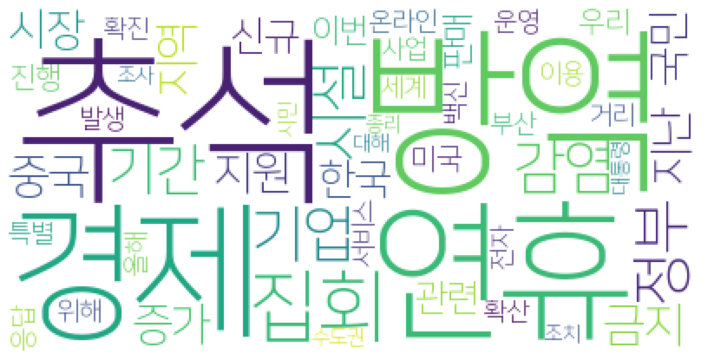

2020.09.26
[]
['사업', '매출', '오토', '에버', '성장', '수주', '연구원']
[]
['어르신', '명절', '추석']
[]
[]
[]
['운항']
['운항']
[]
['일본', '신규']
['북한', '조사', '사건', '공동', '우리', '추가', '가운데']
['승객']
['승객']
['조사', '북한', '공동']
['방역', '추석', '사람']
['충북']
[]
[]
['타이항공', '비행', '상품', '태국', '방콕', '튀김']
['시민', '집회', '경제', '국민', '서울시']
['최고경영자', '골프']
['청주']
['당국', '뎅기열', '환자', '베트남', '올해']
['해경', '북한']
['차량', '집회', '한국']
['백신', '생산', '중국', '공개']
['교민', '중국']
['메트로', '한국', '베트남', '하노이', '호텔']
['확진']
['결혼식', '부부']
['확진']
['결혼식', '부부']
[]
['온라인', '전통', '시장', '추석']
[]
[]
['방역', '감염', '추석', '사람', '당국', '시장', '시설']
['집합', '대구시', '시설', '시민']
['연휴', '조치', '제주', '행정', '추석', '방역', '특별']
['청소년', '재단', '김포시', '캠페인']
[]
[]
['중환자', '업체', '경제', '의류', '치료', '사태', '시사', '기획', '병상', '인력', '종합병원', '상급', '위해']
['입국']
['경로', '거주', '판정', '검사', '접촉', '감염', '확진', '동거인', '확인', '가족', '오전', '결과', '발생', '양성']
['유관순', '열사', '경제', '청장', '추모']
['집회', '취소']
['운동', '버그', '트레이너', '대법관']
['입국']
['중국', '자동차', '전기차', '세계', '시장', '공개']
['지원', '김포시', '북한', '이탈

['의장']
[]
['제주', '연휴', '추석', '조치']
['방역', '수도권', '다시', '감염']
['감염', '방역', '확진', '사우나', '산발', '관련']
['피해', '대표', '복구', '경북', '현장']
['갤럭시', '노트', '판매량', '판매', '자급', '원금', '역대', '전체', '이통', '기록']
['지급', '원금', '고용', '긴급', '안정', '고용부', '경제', '추석', '경우']
['지급', '원금', '고용', '긴급', '안정', '고용부', '경제', '추석', '경우']
['인천']
['음주운전', '취소', '운전면허', '취득', '면허', '다시', '사고', '처벌', '윤창', '비율', '기간', '신규', '운전자']
['관악구']
['경남']
[]
[]
[]
['제주', '연휴', '추석', '방역', '조치', '관광객', '행정', '관광', '특별']
[]
['행사', '한일', '온라인', '도쿄', '교류', '마당']
['행사', '한일', '온라인', '도쿄', '교류', '마당']
['차량', '집회', '시위', '개천절', '단체', '금지']
['강연', '경제', '모집']
['경남']
['경남']
['시위', '개천절', '추미애', '예정', '참여', '퍼레이드', '금지', '한국', '목사', '광화문', '차량', '집회', '주차장', '지역', '신고', '국민', '구역', '사퇴', '정부', '시내', '측은', '우파', '때문', '행진', '운동']
['존슨', '총리', '경제', '영국', '백신']
['조사', '북한', '사건', '추가', '공동', '주장', '측은', '연합뉴스']
['학생', '학년']
['학년', '당국', '방역', '자료', '지난', '연기', '판결', '최종', '관련']
['시진핑', '주석', '중국']
['차별', '주의', '재산', '노동자', '임금', '체불', '피해', '농장

['총리', '도장', '폐지', '디지털화', '일본', '행정']
['명절', '추석', '선물', '농촌', '음식', '상황', '농가', '포장', '수확', '도시', '이번', '사태', '고향', '주문', '시간', '온라인']
['슈퍼엠', '정규앨범', '목사', '이단', '온라인', '논의', '시인', '정기', '교회', '교단', '예술', '총회', '진행', '싱글', '임원', '문화', '합동', '규정', '안도현', '빌보드', '지난', '앨범', '앞서', '개신교', '주요', '통합']
['인도', '보건부']
['인도', '보건부']
['이노베이션', '소송', '판결']
['관련', '센터', '지인', '우디', '감염', '가족', '환자', '확진', '오빌', '지난', '포함', '플러스', '추가', '종사', '지표', '보호', '조사', '누적']
['벚꽃', '가을']
['진료', '가운데', '급여']
['행정', '조치', '연휴', '제주', '추석', '특별']
['청소년', '운영', '프로그램', '온라인', '남구', '비대', '수련', '시설', '문화']
['충북도']
['제주', '조치', '연휴', '행정', '추석', '방역', '특별']
['수입', '일본', '유니클로', '매장', '오픈', '올해', '업계', '한국', '증가', '불매운동']
['문화제', '린다']
['사회', '가정', '학대', '서열', '도전', '동안', '심지어', '우리', '실크로드', '사람', '자신', '자식', '라떼', '차별', '여행', '가족', '꼰대', '자기', '발견', '방임', '꼰대질', '시작', '통과', '남편', '거기', '생각', '인생', '저자', '그것', '중국', '정상', '프랑스', '주의', '부모', '보호', '자전거', '나이', '방치', '여기', '비정상', '경험', '바로', '자녀', '부부']
['꼰대', '

['광명', '검사']
[]
['지급', '아동', '원금']
['한국', '대응', '경제', '월스트리트저널', '라며', '나라', '정부']
[]
['국회의장', '스웨덴', '독일', '의장']
['신규', '모임', '추가', '강남구']
['금지', '방역', '수도권', '조치', '시설']
['도봉구', '사우나']
['촬영', '작품', '캐릭터', '훈련', '영화', '신민아', '다이빙', '디바', '사실', '수영복', '이영', '개봉', '생각', '이야기', '여성']
['스니커즈', '소비자', '관심', '슈즈', '선물', '추석', '제품', '준비', '아이템', '아이', '업계', '건강']
['미얀마', '양곤', '지역']
['병원', '접촉', '판정']
['친서']
['극장', '영화', '국내', '규칙', '상영', '멀티플렉스', '체인', '트롤']
['소송', '최종', '화학', '판결', '이노베이션', '침해', '연기', '영업비밀']
['거리', '시위', '경찰', '영국', '사회', '두기']
[]
['청주', '충북', '의료', '확진', '청주의료원', '격리', '접촉']
['판결', '최종', '미국', '이노베이션', '배터리']
[]
[]
['학과', '입학식', '군사학']
['의회', '시설', '복지']
['의회', '시설', '복지']
['판정']
['교수', '한국', '관계', '중국', '한중', '부채', '역할']
['고용', '노사', '임금', '합의']
[]
[]
['시위', '영국', '런던']
['신규', '최고', '슬로바키아']
['교인']
[]
[]
['마음']
['신규', '최고', '슬로바키아', '누적']
['측면', '유감', '사과문', '국내', '의견', '불법', '북한', '사실', '대해', '남북관계', '자체', '이기', '해상', '과정', '김정은', '국민', '내용', '사과', '그것', '상황', '여러', '

['보안', '소프트캠프', '정보', '제공', '전환']
[]
['이후', '감염', '신규', '전날', '지역', '환자', '해외', '유입', '자릿수', '사례', '수도권', '발생']
['연휴', '주민', '체계', '불편', '비상', '시흥시', '운영', '대책', '센터', '진료', '위해', '상황', '기간', '신고', '시행']
[]
['블랙', '마블', '히어로', '영화', '개봉', '도우']
['명대', '신규', '이후', '연속']
['대응', '한국']
['부산', '전시', '관람', '전시장', '비엔날레', '미술관', '직위', '관람객', '제한']
['입국']
[]
[]
['보건', '장관', '외교부', '다자']
['보건', '장관', '외교부', '다자']
['노사', '합의', '현대차', '임금', '잠정', '경제', '동결', '지난', '결과']
['결과', '노사', '합의', '현대차', '임금', '잠정', '경제', '동결', '지난']
[]
[]
['미국', '성인', '진행', '존슨', '백신', '아동', '대상', '의약품', '개발', '어린이', '소아']
['발생', '확진', '판정', '전날', '지난', '기준', '인천', '추가', '지역', '관련', '신규', '감염', '모임']
['기준', '신규', '발생', '확진', '판정', '전날', '관련', '지역', '인천', '감염', '추가', '모임', '지난']
['추석', '영상', '확산', '마리', '스타', '연합뉴스']
[]
[]
['노사', '임금', '합의', '교섭', '동결', '올해', '잠정', '고용']
['이데일리']
[]
[]
['확인', '발생', '국내', '신규', '환자']
['운동']
['하트', '문화', '희망', '오케스트라', '예술', '콘서트']
['보건', '사업', '의료', '개선']
['발생']
['국내', '전날']
['신규', '명대']
[

['교육', '수업', '미래', '학생', '학습', '온라인', '방향', '정책']
['총리', '일본', '주석', '전화', '회담', '중국', '방일', '관계']
['김진', '증언', '주소', '범죄', '현지', '키트', '진단', '근거', '멘토', '식당', '메릴랜드', '방송', '정치', '장자연', '불명', '문제', '출연자', '연예인', '국내', '법무부', '사용', '채널', '공조', '체포', '해외', '라며', '확인', '우리', '추미애', '위촉', '장관', '발언', '주장', '미디어오늘', '의혹', '대한', '조선', '경찰', '외신', '사실', '상황', '진행자', '돌직구', '논란', '때문', '윤지오', '보도', '소재', '해당']
['동결']
['수도권', '금지', '감염', '시설', '방역', '추석', '확산', '조치', '연휴', '판매']
['루프트한자', '조종사']
['상파울루', '야외', '병동', '누적', '브라질', '설치', '임상시험', '정부', '사망자']
['에이수스', '노트북', '젠북', '사용', '성능', '기존', '베젤', '포트']
['최대', '와인', '한우', '세트', '선물', '프리미엄', '할인', '추석', '상품', '과일', '명절', '송이', '준비', '올해', '구독']
['코스피', '증시', '연휴', '지수', '코스닥', '상승', '하락', '지난', '이후', '거래', '개인', '투자자', '매수', '이번', '감소', '조정', '금은', '주가']
['일꾼', '간부', '실력']
['업계', '서비스', '소비자', '진행', '제품', '맥주', '클래스', '교육', '아이']
['도로공사', '지역', '지급', '온누리상품권']
['어록', '제품']
['판매']
['농민', '추모', '열사', '유관순']
['형제', '동생', '반응', '인천', '상태', '지난'

['스컬', '호텔', '북한', '평양', '방문', '외국인', '관광객', '류경']
[]
['네티즌', '국방부', '결과', '사살', '공무원', '북한', '오후', '대통령', '정부', '시신', '대응', '커뮤니티', '보호', '국민', '문재인', '화장', '오전', '댓글', '반응']
['면역', '일상', '사회', '개발', '환자', '집단', '바이러스', '사스', '시나리오', '대응', '방역', '항체', '코로나바이러스', '중화', '효율', '연구', '백신', '세포', '신종', '형성', '대한', '투여', '치료', '감염', '유전자', '실시', '우리', '예방', '현재', '상황']
['신종', '대응', '우리', '면역', '방역', '집단', '항체', '코로나바이러스', '중화', '형성', '연구', '일상', '감염', '투여', '시나리오', '환자', '사스', '개발', '바이러스', '백신', '현재', '대한', '치료', '세포', '사회', '효율', '예방', '실시', '유전자', '상황']
['심장', '관절', '등산', '발목', '무릎', '운동', '사람', '부상', '증가', '경우']
['추석', '계획', '국내', '컨슈머', '올해', '연휴', '여행', '기간', '포인트']
['상황', '서로', '연민', '젊은이', '박사', '나은', '사람', '모든', '굿맨', '존재', '공동체', '스님', '사랑', '청년', '무엇', '질문', '붓다', '미국', '좌정', '집중', '침묵', '성장', '사회', '우리', '마음', '트루', '고통', '자신', '재능', '도움', '한국', '청소', '생각', '문화', '세상', '문제', '웃음', '통해', '가슴', '명상', '위해', '스승', '센터', '세대', '인간', '지금', '기타', '야망', '가르침', '깊이', '자비', '감정', '수도', '외

['집합', '영업', '업종', '매출', '금지', '운영', '손님', '자영', '상황', '업자']
['금융', '연휴', '은행', '점포', '서비스', '추석', '탄력', '운영', '기간', '거래', '기업', '경우', '입출금', '이용', '확인', '상환']
['제품', '시장', '아울렛', '퍼브', '상품', '소비자', '판매', '확대', '롯데', '지난해', '리퍼', '재고', '티몬', '매장', '업계', '인기', '때문', '유통', '소비', '정상', '불황', '가격', '쇼핑']
['스니커즈', '제품', '포인트']
['한국', '민주당', '경우', '라며', '대통령', '달러', '투자', '기업', '규제', '수혜', '재건', '미국', '트럼프', '지수', '정책', '재선', '대한', '연구원', '바이든', '소비', '대선', '친환경', '경제', '확대', '주식시장', '가능성']
['노조', '관계자', '한국', '공장', '회사', '고용부', '고용', '근로자', '검찰']
['구매', '특수', '손님', '선물', '명절', '추석', '식품', '건강', '코너', '부산', '배송', '사람', '직원', '시장', '매장', '홍삼', '백화점', '마트', '세트', '상인']
['국민', '여야', '협치', '국회', '접종', '백신', '무료', '민생', '통신비']
['아빠', '제대혈', '보관', '육아', '줄기세포']
['코리아', '조작', '벤츠', '메르세데스', '국감', '올해', '수입', '지난', '국회', '증인', '문제', '배출', '사장', '위원회', '의혹', '결함', '키스', '실라', '가스']
['한우', '갈비', '메뉴', '숯불', '명월', '구이', '오후', '리뉴얼', '워커힐', '전문점', '시설']
['증가', '지수', '주가', '상승', '기술', '미국', '위험', '주요', '

['공단', '청구', '진료']
['대통령', '북한', '기념', '국민', '국군', '행사', '언급', '평화', '대응', '우리', '태세']
['장대', '고통', '인간', '신학자', '신성', '연합', '경험', '비젤', '자신', '우리', '속성', '하느님', '어디', '인성', '신의', '바로', '예수', '경향신문', '본회퍼']
['은행', '금융', '사태', '자본', '가능성']
['거인', '자신', '알렉산더', '어린이', '어른', '동생', '누나', '아이', '경향신문', '이야기', '위해']
['고모', '명절', '사랑', '사람', '경향신문', '음식']
['북한', '우리', '남북관계', '정부', '남북', '대화', '협력', '경향신문', '사과', '사건', '국민', '동북아', '대통령', '대한', '정책', '이번']
[]
[]
['훈련', '기업', '참여', '모의', '공개', '모집', '사이버', '대응', '민간']
['정책', '거리', '동물', '이즈미르', '터키', '보호', '유기동물']
['입국']
['젠하이저', '콘텐츠', '가격']
[]
['안치', '버그', '대법관', '의회', '고인', '의사당', '공식']
['갈등', '고르바초프']
['백신', '중국']
['계획', '시티', '뉴딜', '스마트', '문화', '도시', '의정부', '시민', '구축', '사업', '그린', '서비스', '정책', '안심', '일자리', '자원', '발굴', '의정부시', '안전', '분야', '생활', '환경', '참여', '첨단', '추진', '디지털', '조성', '기반', '확산', '브랜드', '지역', '대표', '체육', '지원', '시비', '운영', '정부', '투입', '위해']
['최고']
['공연', '온라인', '유료', '뮤지컬', '채널', '영상']
['지방', '단풍', '설악산', '서비스', '탐방', '올해', '직접

['오후']
['단체', '반찬', '사랑', '경제', '여성', '회원']
['북한']
[]
['보건', '위해', '다자', '장관', '주의']
['북한', '위원장']
['관련', '모임']
['강남구']
['희망', '지급', '지자체', '상공', '자금', '신청', '대상', '추석', '관련', '기부', '우선', '금지']
['유입', '접촉', '센터', '발생', '지역', '해외', '신규', '기록', '감소', '전북', '제외', '주간', '전일', '수도권', '감염', '명의', '보호', '최근', '노인', '판정', '격리', '포항', '증가']
['바이러스', '고열', '지속', '발열', '아이', '방문', '동반', '반드시', '복용', '열성', '때문', '다른', '발생', '이상', '증상', '경우', '소아', '경련', '가와사키', '감염', '병원', '필요', '해열제', '진료', '대부분', '체온', '질환', '감기', '접촉', '호흡', '기침', '환자', '개월']
['감소', '운수', '택시', '전세버스', '종사', '경제', '긴급', '지원', '지급']
['방역', '추석', '거리', '감염', '기간', '대본', '두기', '시설']
['시설', '경제', '이웃']
['경제']
['중앙', '조선', '북한', '위원장']
['위원장', '사과', '북한', '관련', '조선', '중앙', '보도', '중국']
['사망자']
['환자', '각각', '신규', '덕수고', '사례', '검사', '확진', '강남구', '감염', '집단', '학년']
['학년', '덕수고', '환자', '각각', '신규', '확진', '집단', '감염', '사례', '검사', '강남구']
['검사', '접촉', '포항', '판정', '모두', '확진', '지난', '관련', '지역']
['지난', '확진', '포항', '판정', '접촉', '모두', '검사', '지역', '관

['발생', '관련', '신규', '국내', '감염', '환자', '지난', '보호', '경기', '사망자', '이후', '주간', '단계', '센터', '전날', '어린이집']
['기준', '감소', '명의', '파악', '확진', '발생', '감염', '판정', '해외', '어린이집', '증상', '누적', '전날', '접촉', '전북', '환자', '음성', '모임', '검사', '지역', '관련', '인천', '부산', '신규', '확인', '지난', '추가', '여성', '거주', '기록']
['방역', '소독', '국경', '사업']
[]
[]
[]
[]
['임금', '노사', '동결']
['임금', '노사', '동결']
['교통']
[]
['널리', '서비스', '접근성', '네이버', '정보', '진행', '기술', '웨비', '공유']
['발생', '모두']
['생활', '대학', '구직', '때문', '우울', '상담', '직장', '호소']
[]
['논의', '보건', '다자', '장관', '강화', '위해']
['발생', '추석', '태풍', '공비', '무장', '침투', '강릉', '사라', '피해', '당시', '작전']
['퇴사', '직장인', '해고', '유튜브', '회사']
['증가', '국가채무', '비율']
['선고', '캐나다인', '이중', '혐의', '정부', '외교', '억류', '경제', '홍콩', '레이', '중국', '호주', '구금', '부회장', '미국', '외국인', '양헝쥔', '국적', '보안법', '출신', '기소', '조사', '캐나다', '지적', '인질', '대한', '체포']
['오디오', '골드']
['대전']
['대전']
['갤럭시', '아이폰', '시리즈', '출시', '라인업', '전자', '플래그', '모델', '가격']
['계획', '남녀', '인생', '스트레스']
['의장', '스웨덴', '독일', '방문', '국회의장']
['기관', '기간', '의료', '연휴', '병원', '

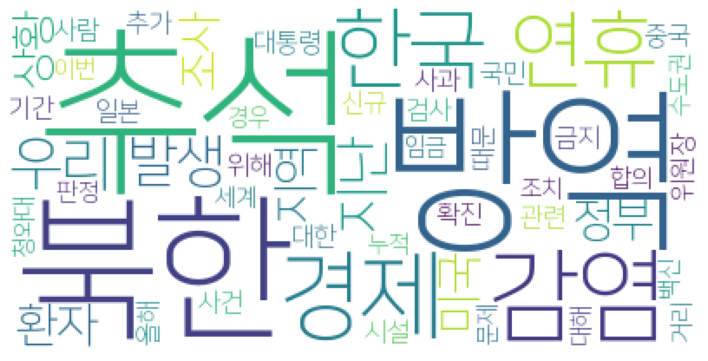

2020.09.25
['등교']
['백화점', '매출', '고객', '기간', '매장']
['청구', '상금', '소송', '교회', '공단', '건보', '방역', '사랑']
['공단', '청구', '상금', '건보', '소송', '방역', '사랑', '교회']
[]
['사랑', '공단', '청구', '교회', '상금', '소송', '대해', '방역']
['지원', '일본', '고투', '사업']
['운행', '감축']
['금지']
['천사', '지인', '검사', '자차', '자택', '접촉', '이후', '구정동', '명화', '경주시', '황성동', '전수', '진료']
['한국', '콜롬비아', '저자', '경향신문', '우리']
['위험', '시설', '방역', '금지', '수도권', '집합', '기간', '관련', '조치', '연휴']
['여행', '한국', '조선', '인형']
['우울증', '치료', '교수', '환자', '증상', '경향신문', '진단', '지속', '의학과', '정신건강']
['총리', '전화', '회담', '경제']
['수도권', '조선', '연휴']
['일본', '지원', '고투', '사업']
[]
['경제']
['진중권', '교수', '사건', '희생', '대통령', '발언', '표현', '문재인', '사람']
['배달', '기사', '도로', '사람', '대행', '위해', '시간', '가게', '사업', '오토바이', '사장', '경험', '외식', '아이스', '블랙', '아내']
['총리', '전화', '회담']
['북한', '조선', '인권']
['청와대', '남북관계', '대통령', '위원장', '북한', '사건', '친서', '경향신문', '남북', '지문', '대해', '대한', '사과']
['일본', '지원', '고투', '사업']
['일본', '지원', '고투', '사업']
['우선', '정치', '백신', '관련', '배분', '정부', '개발', '접종', '공급', '대한', '한국', '교수',

[]
['화상', '형제', '상태', '반응']
['주전자', '핸슨', '창고', '발견', '경매']
[]
[]
['차량', '집회', '도심', '경찰', '금지', '시위']
['신청', '청년', '센터', '순위', '온라인', '구직', '원금']
['공원', '서산시', '희망', '참배']
['북한', '사과', '공무원', '경제', '시신', '보도']
['화상', '형제', '반응', '상태']
['정보', '경향신문', '보고']
['정보', '경향신문', '보고']
['판단', '확인', '사과', '불명', '우리', '북한', '사체', '원장', '침입', '박지원', '해상', '사살', '불법', '사건', '군인', '발생', '수역', '정체', '지시', '과정', '유물', '공무원', '지문', '보고', '단속']
['병원', '서울대', '근무']
['집회', '개천절']
['고용부', '순위', '신청', '청년', '원금', '특별구', '직지', '지원', '대상자', '해당', '사람']
['판단', '공무원', '북한', '사체', '원장', '우리', '사살', '관계자', '지문', '지시', '대한', '정보', '보고', '월북', '국정원']
['연속', '주말', '거리', '두기', '사람']
['병원', '서울대', '근무']
['아이디어', '기술', '테크', '부문', '해커', '논문', '결제', '서비스']
['사건', '정보', '위원장', '국회', '보고', '북한', '판단', '간담', '지문', '박지원', '사과', '공무원', '월북']
[]
['콘서트', '온라인']
['티앤', '공모', '상처', '치료', '기업', '매출', '올해', '상반기']
['시설', '위험', '집합', '동안', '수도권', '금지', '방역', '유흥', '판매', '기간', '음식점', '좌석', '거리', '음식', '실내', '섭취', '추석']
['상금', '공단', 

['구매', '지급', '텔레콤', '기기']
['공단', '명절', '복지관']
['소송', '공단', '청구', '상금', '사랑', '교회', '건보', '부담', '진료']
['아동', '지급', '지원']
['정부', '치료', '백신', '지원']
['정부', '치료', '백신', '지원']
['루스', '제넥신', '백신']
['사과', '북한', '정보']
['김정은', '긴급', '소식', '대해', '북한', '사과', '보도', '통신', '대한', '국무위원', '위원장', '사건', '한국']
['상한', '분양', '조합', '가격', '적용', '둔촌', '재건축', '단지', '강동구', '통보', '지난', '책정', '로부터', '사업', '아파트']
['진천']
['사랑', '공단', '교회', '소송', '건보', '청구', '관련']
['수도권', '방역', '휴게소', '추석', '정부', '집합', '제한', '대책', '특별', '금지', '사람', '교수']
['푸틴', '대통령', '협력']
['대통령', '동포', '친서', '김정은', '문재인', '국무위원', '진심', '남녘', '집중호우', '피해', '우리', '기원', '위로', '공개', '위원장', '어려움', '역시', '태풍', '건강', '최근', '실종', '공무원']
['상황', '남녘', '김정은', '대통령', '친서', '진심', '국무위원', '동포', '위원장', '어려움', '문재인', '우리', '기원', '항상', '건강', '차례', '그것', '마음']
['재판']
['연장', '시설', '사회', '단계', '거리', '다음', '방역', '집합', '집회', '금지']
['감염', '수도권', '발생', '연휴']
['글로벌', '디지털', '구축', '전세계', '카카오페이지', '웹툰', '콘텐츠', '산업', '플랫폼', '시장', '스토리', '문화', '대한민국']
['공단', '청구']
['대통령', '국무

['수색견', '바이러스', '탐지', '승객', '실험']
['수색견', '바이러스', '탐지', '승객', '실험']
['수색견', '바이러스', '탐지', '승객', '실험']
['증가', '감소']
['항체', '유전자', '자기', '환자', '바이러스', '분석', '중증', '인터페론']
['대통령', '문재인', '김정은', '국무위원', '동포', '진심', '친서']
['시설', '금지', '의무', '방역', '추석', '단계', '운영', '수도권', '특별', '기간', '판매', '정부', '거리', '유지', '대해', '좌석', '두기', '관리', '이용', '주간', '조처', '실내', '집합', '연휴', '조치']
['우리', '친서', '대통령', '국무위원', '내용', '문재인', '김정은', '동포']
['친서', '대통령', '국무위원', '동포', '문재인', '김정은', '진심', '어려움', '기원']
['국무위원']
['집회', '불법', '불법행위', '국민']
['집회', '불법', '불법행위', '국민']
['수출', '추진', '상담', '해외', '온라인', '사업', '비대', '마케팅', '창원', '인도']
['질환', '환자', '광주', '위험', '만성', '치료', '전남', '증상', '면역', '경험']
['국무위원', '대통령', '친서', '동포', '우리']
['신청', '청년']
['전주시', '접종', '백신', '노출', '당국']
['국무위원', '대통령', '친서', '동포', '우리']
['중개', '미국', '법인', '영업', '코리안리', '설립', '보험', '시장', '현지', '지점']
['미국', '법인', '영업', '코리안리', '중개', '설립', '보험', '시장', '현지', '지점']
['법인', '코리안리', '보험', '경제', '미국', '중개', '설립', '영업', '시장', '추진', '지점']
['국무위원', '대통령', '친서']

['고객', '대출', '증가', '서비스', '은행', '뱅크', '상품', '금융', '모바일', '채널', '마케팅', '기준', '비대', '출시', '시대', '대비', '언택트']
['살균', '시스템', '자외선', '워크스루', '유버', '기술', '부위', '피부', '감염', '로봇']
[]
[]
['화장', '북한', '김어준', '교수', '사회']
['지문', '우리', '대해', '김정은', '북한', '사건', '발생', '도부']
['방역', '시설', '조치', '주간', '추석', '집합', '금지']
['백신', '바이오', '사이언스', '정부', '개발', '지원', '기업']
['국립', '박물관', '문화', '시설', '중앙']
['미국', '사망자', '통계']
['재산세', '주택', '서초구']
['북한', '보도', '통신', '대해']
['등교']
['감염']
['발생', '감염', '어린이집', '집단', '보고', '지난', '모임', '신규']
['북한', '통신', '지도자', '대해']
['통신', '북한', '지도자', '대해']
['크리스천', '김한수', '한국', '교회', '예배', '교인', '종교', '선교', '이후', '행위', '목사', '확산', '개신교', '대형', '때문', '사랑', '대한', '시대']
['법인', '미국', '중개', '코리안리', '설립', '영업', '보험', '시장', '지점']
['분양', '지역', '필지', '입찰', '제한']
['업무', '에이스', '노동', '콜센터', '현장', '노조', '노동자', '민주', '노총', '점검', '경우', '휴가', '노동부', '감독', '문제', '실적', '기자회견', '연차', '참여', '지적', '부장']
['우리', '단속', '사건', '침입', '발생', '해상', '과정', '수역', '대해', '불명', '도부', '동포', '정체', '유감', '사이', '대하', '관계',

['도시락', '영양', '전달', '사랑', '센터']
[]
['사건', '우리', '침입', '발생', '해상', '수역', '불법', '군인', '남녘', '동포', '불명', '단속', '정체']
['부산']
['인하', '세율', '주택', '재산세', '가구', '서초구', '감경', '자치구', '서울시', '자료', '이하', '환급']
['신청', '상공', '지급', '온라인', '오늘', '번호']
['개발', '치료', '백신', '정부', '임상시험', '지원', '연구', '내년', '방역', '편성', '기초', '감염병', '기업']
[]
[]
['친서', '교환']
['회장', '국내', '삼성', '전략', '재판', '연휴', '부회장', '경영', '사업', '만큼', '자택', '올해', '아이', '그룹', '추석', '기간', '미국', '전반', '사직', '등기', '반도체', '구상', '마련', '재계', '전기차', '다음', '예정', '대한', '점검', '준비', '이번', '동안', '해외', '관계자']
[]
['대금', '협력', '동반성', '사의', '지원', '위해', '경영']
['친서', '최근']
['백신', '국가', '선정', '기업', '지원', '정부', '치료', '개발', '임상시험', '허가', '셀트리온', '해외', '국내', '현황', '계획', '심사', '회의', '정보', '위해', '협력', '진행']
[]
[]
[]
['남녘', '정체', '불명', '군인', '우리', '사건', '침입', '해상', '수역', '발생', '불법', '동포', '대해', '단속']
['우리']
['국립', '박물관', '이용', '시설', '경향신문', '방역', '운영', '중앙']
['신약', '급여', '건강', '한국', '환자', '보험', '접근성', '방안', '대안', '평가', '위해', '네트워크', '미래', '재정', '토론회', '개선', '교수', '대표

[]
[]
['번가', '행복', '아동', '도시락']
['왓챠', '서비스', '이용권', '프리미엄']
['노선', '운행', '지난해', '이용', '감소', '감축', '기간', '대중교통']
['시사', '기획']
['경찰', '차량', '집회', '시위']
['금지', '실내', '다음', '마스크', '기간', '방역', '시설', '운영', '경우', '이상', '이하', '출입', '의무', '수도권', '특별', '공립', '추석', '중단', '인원', '유지', '음식점', '진행', '행사', '거리', '착용', '좌석', '이용', '조치', '대한', '단계', '두기', '주간', '모임', '핵심', '대책', '준수', '대해', '집합', '판매']
[]
['콜센터', '상담', '업무', '노동', '감염']
[]
[]
['시설', '방역', '금지', '위험', '기간', '수도권', '추석', '특별', '실내', '운영', '중단', '착용', '판매', '마스크', '집합', '조치']
['투표', '진행', '현대차', '조합원', '노조', '임금', '합의', '노사', '여부']
['집회', '경찰', '차량', '시위', '개천절', '드라이브스루', '대해', '강행', '감염', '불법']
['물량', '컴퓨터', '수입', '하락', '수출', '지수', '대비', '확대', '유제품', '동월', '교역', '제품', '기기', '상승', '장비', '증가', '반도체', '전자', '전환', '석탄']
['노선']
['비대', '투자', '확산', '소비', '고용', '업체', '가장', '수준', '금융', '이내', '관련', '서비스', '감소', '응답', '영향']
['지원']
['집회', '차량', '개천절', '도심', '경찰', '불법', '시위', '금지', '차단', '위험']
['운영', '국립', '이용', '시설', '박물관', '문화', '방역', '중앙', '제한']


['평가', '긍정', '조사', '포인트', '민주당', '호감', '결과', '부정', '정당', '국민', '응답']
['부산', '확진', '판정', '환자', '검사']
['실내', '금지', '운영', '수도권', '추석', '거리', '두기', '좌석', '이상', '방역']
['생산', '기간', '부산', '수도권', '수준', '소비', '확산', '서비스업', '제외', '지역', '증가', '감소', '영향', '제주', '조사', '나머지', '권역', '업체', '충청권']
['거리', '두기', '조치', '감염', '주말']
[]
['방역', '시설', '금지', '수도권', '집합', '조치', '위험', '실내', '의무', '특별', '모임', '홍보', '거리', '단계', '판매', '출입', '방문', '두기', '좌석', '착용', '기적', '관리', '테이블', '이용', '직접', '지자체', '대해', '동안', '학원', '이상', '핵심', '적용', '유흥주점', '공연장', '대한', '음식점', '마스크', '소독']
['투표', '백악관', '선거', '대통령', '트럼프', '대선', '결과', '질문', '경향신문', '조작', '연방', '브리핑', '사기', '가능성', '생각', '우리', '우편', '이번', '발언', '공화당', '대법원', '이후', '대법관', '불복', '이양']
['중국', '천추스', '감시', '정부']
['일본', '시장', '유니클로', '매장', '부산', '대형', '범일']
['개천절', '검문소', '집회', '차단', '경찰', '방침', '도심', '예정', '금지']
['방역', '테이블', '추석', '음식점', '경우']
['추가', '거부', '의대', '의사', '국시', '응시', '정부', '의료', '국민', '입장', '기회', '학생']
['지원', '부스', '나이지리아', '진단', '경제', '코이카', '한국', '이번',

[]
[]
[]
[]
['트럼프', '투표', '질문', '대통령', '결과', '용지', '선거', '대선', '백악관', '우편', '권력', '발언', '이양', '공화당']
['경진', '창업', '대회', '기업', '인공', '지능', '아이', '종목', '융합', '예선', '본선']
['대회', '기업', '경진', '창업', '인공', '지능', '아이', '종목', '융합', '예선', '본선']
[]
[]
[]
['지역', '부산', '전달']
['뉘르부르크링', '레이스', '고성능', '주행', '브랜드']
['협력', '텔레콤', '대금', '경영']
['상담', '토지', '보상', '하나은행', '서비스', '경제', '드림팀']
[]
['사망자', '사망', '실제', '통계', '지난']
['치료', '물질', '협회', '자원', '바이러스', '신약', '연구', '개발', '합성', '후보', '미국', '형태', '과학', '지원', '구조', '시작', '가상', '업체', '분자', '한국', '설계', '화합물', '지난', '화학', '컴퓨터', '기업']
['린지', '전자', '채팅', '플러스', '고백', '전하', '삼성']
[]
['북한', '인권', '국제', '생명', '유엔', '행위', '범죄', '사건', '모든', '권리', '정부', '위반', '이번', '진상', '조사', '한국', '지적', '단체', '총장']
[]
['지원', '대금', '협력', '동반성', '텔레콤', '위해', '경영']
['북한', '인권']
['신청', '지급', '상공', '오늘']
['인터파크', '상공', '온라인', '공인', '소상']
['노바', '백신', '개발']
['연휴', '추석', '총리', '방역']
['상담', '자산', '보상', '토지', '하나은행', '서비스', '센터', '대한', '부동산']
['롯데', '전달', '홈쇼핑', '소외', '계층', '명절', '음식']
[

['북한', '인권', '대통령', '관계']
['프랑스', '경계', '등급', '최고', '단계']
['인권', '북한', '시신']
['투표', '동결', '임금', '조합원']
['지출', '소비', '감소', '가계', '증가', '사회', '가구', '대한', '소득', '교육', '전체', '반면']
['조사', '자료', '역학', '교회', '방법', '해당', '성북구', '사랑']
['이번', '한국', '북한', '관계', '미국', '사건', '문재인', '대통령', '사살']
['무어', '영국', '경은', '노병']
['장관', '서욱', '국방', '의원', '북한', '시신', '국민', '하태경', '짐작']
['시장', '상황', '주요', '결과', '미국', '지수', '대선', '우려', '상승', '기록', '경제', '요인', '지표', '거래', '오른', '실업', '다만', '추가', '신규', '부양책', '뉴욕']
['임대', '셋값', '시행', '상승세', '이후', '전세', '전월세', '전국', '부동산', '정부', '지수', '청구권', '계약', '시도', '차법', '지속', '시장', '개월', '갱신', '아파트']
['포인트', '하락', '전망', '소비자', '이후', '상황', '대한']
['피해', '이용권', '환불', '업체', '뷔페', '기간', '구매', '사태', '연장', '식사', '외식', '영수증', '선물', '영업', '식당', '때문', '계약', '유효', '폐업', '중단', '카드']
['유럽']
['전망', '확산', '하락', '포인트', '소비', '심리', '지수', '전월', '영향', '소비자']
['상황', '대한', '포인트', '소비자', '전월', '전망', '심리', '지수', '대비', '인식', '가계', '하락']
['전망', '소비자', '포인트', '하락', '확산', '전월']
['심리', '소비자', '지수', '확산'

['심리', '지수', '전망']
['지원', '시장']
['연체']
['천안', '치료', '지난']
['해바라기', '축제', '황룡강']
['집회', '차량', '금지', '입장', '국민', '의원', '개천절', '드라이브', '스루']
[]
['학교', '학생', '당국', '중국']
['위협', '대통령', '행사', '특전사', '광복군', '부대', '대해', '안보', '노컷뉴스', '국군의날', '국민', '대응', '북한', '특수전', '강조', '태세']
['국민', '대한', '안보', '기술', '국산', '세계', '수행', '시작', '여러분', '부대', '오늘', '대통령', '개발', '능력', '복무', '대한민국', '방역', '드론', '특수전', '안전', '생명', '우리', '장병', '위협', '작전', '태세', '대응', '국가', '누구', '계획', '올해', '국방', '공군', '예산', '광복군', '국군', '평화', '미래', '나라', '조국', '무인', '기념']
[]
['사살', '교수']
[]
['고향', '여행', '전남', '추석', '영상', '명절', '관광', '랜선', '가을', '잠시', '남도']
[]
[]
['헬싱키', '냄새', '감염', '탐지견']
[]
[]
[]
['백신', '노바', '시험']
[]
[]
['호텔', '한식', '메뉴', '코스', '와인', '한우', '발효', '입맛', '준비', '구이', '재료', '가을', '무화과', '음식', '식사', '라이브', '추석', '가격', '명월', '공연', '대표', '맥주', '구성', '제공', '독일', '제철']
['청약', '아파트', '분양', '남양', '뉴타운', '한세상', '아이', '지역', '전세', '순위', '매매', '대비', '화성시', '주택', '적용', '소비자', '수도권', '통장']
[]
['직원', '텔레콤', '기기', '제도', '구매', '디지털', '

['푸드', '협력', '지급', '상황', '위해', '대금']
[]
['뎅기열', '환자', '당국', '올해']
[]
['대출', '신용', '우대금리', '은행', '금리', '카카오', '뱅크']
['나무', '심기', '신혼부부', '유한킴벌리']
['방역', '생활', '시스템', '확산', '운영']
['대통령', '기념', '강조', '안보']
['대통령', '기념', '강조', '안보']
['디지털', '과정', '오스', '교육', '활용', '어르신', '비대']
['백신', '노바', '시험', '효능', '경제', '영국']
['주석', '중국', '국가', '세계', '유엔']
['북한', '보도', '단체']
['조사', '지난주', '무당', '부정', '긍정', '이상', '민주당', '지지', '정당', '평가', '국민', '직무', '여성', '대통령', '이번', '연령']
['국군', '국방', '예산']
['부대', '대응', '대한민국', '국민', '장병', '평화', '위협', '우리', '드론', '태세', '방역', '미래', '오늘', '육군', '조국', '광복군', '기술', '예산', '무인', '올해', '복무', '능력', '개발', '나라', '시작', '국산', '작전', '국가', '공군', '한국', '서도', '국군', '특수전', '안보', '여러분', '국방', '대통령', '생명', '세계', '수행', '계획', '누구', '안전', '기념']
['장관', '북한', '대화']
['지역', '부산', '사회', '지원', '후원']
['부산', '국민', '의대', '의사', '병원', '시험', '대한', '국시']
['협력', '텔레콤', '대금', '디지털', '납품']
['국민', '부대', '평화', '수행', '정부', '보호', '행위', '수송', '우리', '드론', '특수전', '정찰', '나라', '전투', '생명', '본격', '차량', '예산', '전통', '

['투표', '잠정', '노조', '합의']
['해상', '풍력', '사업', '군산시']
[]
['번가', '아동', '행복', '도시락', '사회', '통해']
['위원', '부분', '국민', '일단', '정치', '때문', '결과', '대한', '라이브', '김재섭', '대해', '사회', '보고', '국회', '불공정', '예산', '지금', '본인', '해결', '걱정', '뭔가', '탈당', '적극', '이해충돌', '스스로', '최근', '개인', '가지', '웃음', '친구', '윤리', '펭수', '최고', '사실', '과정', '민주당', '말씀', '방지법', '댓글', '생각', '박성민', '의원', '조치', '질문', '차원', '청년', '경우', '사람', '문제', '정치인', '비판', '주거', '앵커', '저희', '우리', '이야기', '여러', '조금', '대통령', '계속', '의미', '박상욱', '비대', '공정', '이제', '정당', '정부']
[]
['신규', '명대', '연속', '자릿수', '누적', '감염']
['사회', '마스크', '복지관']
['부산', '신규']
['노랫소리', '도심', '소음', '수컷', '암컷', '구애', '멧새', '연구', '변화']
['지난', '신규', '해외', '지역', '방역', '감염', '전날', '명대', '발생', '유입', '연속', '국내', '확산', '경기', '누적', '자릿수', '수도권']
['서비스', '기업', '협업', '비대', '선정', '업무', '레이스', '기능']
['사회', '지역', '키트']
['사람', '다큐멘터리']
['운행', '노선', '감축', '감소', '이용', '시내버스']
['아이', '신규']
['추석', '포스코건설', '지역', '가정', '음식', '요리', '활동']
['우리', '장관', '국민', '태세', '주년', '안보']
['지씨', '마약', '미국', '국내', '혐의']
['점

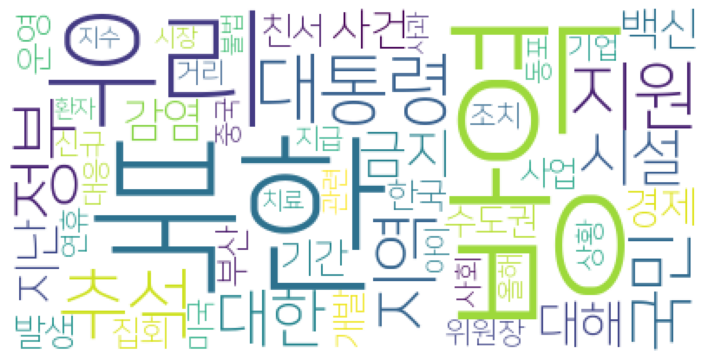

2020.09.24
['일본']
['대회', '개최', '도쿄올림픽', '내년', '위원장', '일본', '바흐', '협력', '올림픽', '정부', '상황', '대책', '회의', '도쿄', '메시지']
[]
['북한', '장관', '대해']
[]
['파주', '병원']
['일본']
['인체', '백신', '바이러스']
['제출', '김씨', '역학', '영상', '조사', '자료', '방법', '목사', '감염병', '해당', '대한']
['대통령', '행위', '국민', '사건', '북한', '국회', '의원', '종전', '정부', '위해', '선언', '국방', '보고', '유엔', '규탄']
[]
['조사', '역학', '자료', '은폐', '혐의', '목사', '감염병', '방법', '예방', '영장', '대한', '법원']
['경제']
['올해', '기업', '한계', '조선']
['베트남', '운항', '항공', '인천', '러시아', '재개', '한국', '정부', '국내']
['동대문구', '오피스텔']
['임대', '임차', '경제', '월세', '계약', '상가']
['일본']
['조사', '역학', '교회', '자료', '감염병', '방법']
[]
['교회', '자료']
['경제']
['집회', '금지', '조선', '경찰']
['경찰', '경제', '교회', '조사']
['심사', '대회', '학생', '기능', '과제', '경기', '경향신문', '이번', '청원', '직업']
['자료', '은폐', '목사', '영장', '역학', '조사', '대한', '혐의', '법원']
['경향신문']
['교회']
['조사', '방법', '자료', '역학', '요청', '감염병']
['경기', '협력', '사업', '구리시', '북부', '극복', '위해', '방역']
['적용', '감액', '임대료', '연체', '계약', '월세', '건물', '입자', '상가', '개월', '조정', '경우', '분쟁']
['파주', '병원']
['백신',

['재난', '보고서', '바이러스', '성공', '사회', '미국', '기사', '사태', '사람', '문제', '한국', '과학']
['감염', '운영', '보건소', '진료', '콜센터']
['회장', '쌍용', '건설', '두바이', '출장', '현장']
['첩보', '대통령', '연설', '청와대', '오전', '유엔', '신빙', '확인', '내용', '관계자', '관련']
[]
['전북']
['변화', '직원', '위기', '경영', '전자', '메시지', '기회', '부문', '환경', '상황', '사장', '재택근무', '근무']
['신규', '도쿄도', '지난', '감염', '도쿄', '이상']
['부산']
['감염', '질환', '기업', '투자', '산업', '은행', '대응', '바이오']
['실내', '공기', '다이슨', '오염', '물질', '미세먼지', '공기청정기', '휘발', '센서', '요리', '발생', '이산화질소', '부산', '유해', '유기화합물', '감지']
['회장', '쌍용', '건설', '두바이', '현장', '호텔']
['한국', '부진', '수출', '경제', '홍헌표', '우리나라', '유럽']
['북한', '사건', '이번', '경향신문', '사살', '대통령']
['광주', '음주운전', '서구', '금지']
['백신', '개발', '인체', '시험', '바이러스', '영국']
['광주', '음주운전', '서구', '금지']
['서구', '광주', '음주운전', '금지']
['개발', '백신', '인체', '시험', '바이러스', '영국']
['광주', '음주운전', '서구청']
['와이파이']
['무어']
['마스크', '전주시']
['진출', '우리', '지역', '기업', '정부', '아프리카', '관련', '지원']
[]
['충주', '충주시', '보청기', '시장', '바이오']
['사건', '북한']
['접종', '사용', '개발', '백신', '중국', '미국', '러시아', '승인', 

['아이', '하락', '종목', '거래']
['공연', '뮤지컬', '조선']
['백신']
['연설', '유엔', '대통령', '청와대', '종전', '선언', '녹화']
[]
['경우', '대학', '수업', '학생', '등록금', '일부', '개정안', '학교', '법안']
['북한', '월북', '오후', '실종자', '실종', '선박', '당국', '해상', '경위', '정황', '시신', '관계자', '소연평도', '측은', '수색', '접근']
['사고', '배송', '새벽', '화물차', '차량', '발생', '심야시간대']
['순창군', '반납', '노인', '예산', '회장']
['법률', '개정안', '대학', '등록금', '교육', '일부', '학교', '교육법', '학생', '고등', '경우', '통과', '개정']
['직원', '선물', '그룹', '상투', '부모님', '이상', '추석', '대상', '명절', '세트', '기업']
['지수', '포인트', '하락', '이후', '종목', '거래']
['출석', '여야', '증인', '대표', '소위', '채택', '참고인', '국감', '국회', '국정감사', '방송', '종합', '의원', '아이', '법안', '넷플릭스', '라며', '카카오', '사업자', '네이버', '구글', '사용', '진행', '의결']
['바이러스', '유행', '효과', '치료', '시험', '확인', '유형']
['유행', '유형', '바이러스', '효과', '치료', '시험', '확인']
['지원', '가구', '생계', '위기', '긴급', '소득', '이하']
[]
['페이', '한중', '사업', '결제', '제로', '가맹', '위챗', '연동', '간편', '진흥', '한국', '수수료', '중국', '통합', '규격']
['백신']
['모델', '전자', '삼성', '제품', '스마트폰', '에디', '일반', '지원', '판매', '출시', '갤럭시', '카메라', '가격', '소비자

['이동통신', '비대', '유통', '대리점', '대기업', '계약', '판매점', '이통', '쿠팡', '상생', '주장', '휴대폰', '협회', '상황']
['소방', '몽골', '차량', '창원시', '기증', '국제', '교류', '협력']
['타이어', '뱅크']
['감염', '노출', '바이러스', '방문', '판매', '단장', '조건']
[]
['임금', '시내버스', '울산', '동결', '노사']
['울산', '임금', '동결', '시내버스', '노사']
[]
['전북', '청장']
['학습', '초등', '와이즈캠프', '수업', '비주']
[]
['증상', '완치', '이상', '연구']
['경향신문', '운전자', '충전', '가스', '보험', '고객', '최대']
['감염', '관련', '확인', '추가', '음성', '소재', '우즈베키스탄', '강남구', '사례', '제출', '확진', '기관', '환자']
['스웨덴', '테그', '바로', '마스크', '전략', '사람', '다른', '나라', '앤더스']
['나눔', '구세군', '키트']
[]
['수업', '마련', '학교', '근거', '경제', '재난', '경우', '등록금', '교육법']
[]
['판결', '양국', '대통령', '총리', '현안', '징용', '의견', '상황', '관계', '협력', '노컷뉴스', '일본', '문제', '극복', '강제']
[]
[]
['개정안', '학생', '재난', '근거', '수업', '경우', '학교', '본회의', '등록금', '정상', '마련']
[]
['연휴', '기간']
[]
['기간', '음주운전', '지난', '차량', '음주', '광주']
['관련', '감염', '병원', '누적', '가운데', '발생', '추가', '집단', '세브란스', '사례', '환자']
['키트', '나눔', '구세군']
['키트', '나눔', '구세군']
['동판', '태국', '시위', '시민', '경찰', '민주화', '지난', 

['교수', '바이러스', '감염', '치명', '전파', '추정', '정도', '집단', '다른', '방역', '유행', '발생', '최근', '계속']
['경우', '아이', '이상', '방문', '증상', '경련', '소아', '발열', '복용', '개월', '체온', '반드시', '필요', '병원', '감염', '해열제', '진료']
['위해', '자극', '효과', '소독', '사용', '경우', '소독제', '분무', '어린이집', '살균', '세탁', '피부', '환경부', '세제', '아이', '표면', '터널', '손상', '바이러스', '제품']
[]
[]
['봉안', '벌초', '방문', '진드기', '추석', '경우', '예방', '시설']
['단체', '집회', '차량', '시위', '광화문', '경찰', '신고']
['감염병', '확산', '집회', '금지', '개천절', '이하', '의원']
[]
['국민', '정권', '집회', '광화문', '경향신문', '개천절', '세력', '금지', '차량']
[]
[]
[]
[]
['개천절', '의원', '광화문']
['원산지', '표시', '단속', '환경']
['학생', '장학금', '지급', '성장']
['신규', '지역']
['클레', '오스', '우스', '지질', '연구원', '과학', '교육', '자원', '비대']
['북한', '국방부', '총격', '파악']
['북한', '관계자', '실종자', '국방부', '실종', '시신', '오후', '월북', '소연평도']
['증가', '기록', '가계', '기업', '신용', '대비', '대출', '규모', '사상', '최대', '올해', '가계부채']
['반려동물', '결과', '구진']
['아동', '지급', '지원', '학교', '초등학생', '중학생', '사업', '신청']
['조사', '재택근무', '기업', '응답', '근로자', '대상', '실시', '담당자', '정보', '인사']
['금지', '집회', '광화문', '

['국민', '생각', '관련', '위원장', '대표', '관심', '후보', '사람', '정치', '집회']
[]
['매출', '공인', '피해', '장사', '추석', '시장', '경제', '소상', '상인', '올해', '상황', '업종', '이후', '우려', '자금', '지급', '라며', '희망', '모씨']
['경남', '부산']
['협력', '노조', '공정']
['우이', '사장', '네트워크', '클라우드', '노키아', '데이터', '처리']
['회의', '영향', '보건', '유엔', '안보', '장관', '연대', '협력', '고위', '화상', '그룹', '우호']
[]
['작가']
['인증', '심사', '기업', '공장', '관리', '대상', '산업', '제품']
['계획', '경기도', '연휴', '추석', '도민', '고향', '방문', '기간', '응답']
['광화문', '금지', '집회', '시위', '문재인', '정권', '차량']
['충북', '격리', '요양원', '모두', '지난', '추가']
[]
[]
['감염', '지난', '신규', '전날', '지역', '수도권', '발생', '연속', '명대', '방역', '누적', '판정', '자릿수', '사례', '유입', '경기']
['구입', '신청', '작품', '가격']
['가구', '소득', '신청', '지원']
['중국', '주석', '세계']
['금지', '집회', '광화문', '문재인', '정권', '정부']
['집회', '드라이브', '스루', '방식', '지사', '라면']
['북한', '사건', '월북', '남북관계', '발생', '경계', '유입', '지역', '차단', '개성', '탈북민', '비상', '조사']
[]
[]
['환자', '지역', '방역', '하루', '신규', '경제', '확인', '집계']
['집회', '광화문', '정권', '금지']
['사망자']
['사망자']
['불법', '야노', '마미', '원주민', '부족', '지역',

['가게', '사장', '시장', '손님']
[]
[]
['추석', '이번', '자기', '경우', '아예', '앵커', '선임', '이성일', '연휴', '정부', '대상', '이야기', '상여금', '사람', '한도', '귀성', '이용', '조사', '지급', '배송']
['백신', '중국', '공개']
[]
['무어', '경은']
[]
['경계', '등급']
['지사', '파슨', '주지', '마스크', '검사', '미주리주', '사진', '선거', '착용', '감염', '사가', '공화당']
['멕시코', '관광객', '유적지']
['소독']
['임대료', '요구', '임대', '건물', '인하']
['하락', '확산', '기술', '미국', '봉쇄']
['영국', '사재기', '일일', '신규', '식료품', '다시']
['식료품', '영국', '사재기', '일일', '신규', '다시']
[]
['백신', '중국', '공개']
['백신', '미국', '접종', '내년']
['직원', '현지', '대사관']
['지수', '하락', '미국', '기술', '거래', '유럽', '증시']
['추석', '연휴', '리조트', '사회', '확진', '제주도', '거리', '두기', '자수', '추세', '발생']
['국민', '백신', '독감', '노출', '상온', '단백질', '접종', '정도', '부작용', '추가', '문제', '우려', '상황']
['응답', '허위', '미국', '정보']
['기술']
['존슨', '미국', '임상시험']
['급락', '주가', '지수', '기술', '미국', '전날']
[]
['신규']
['혼인']
['금융', '지원', '기금', '제주항공', '기간산업', '안정', '정부']
['사재기', '조치', '영국', '식료품']
['확산', '실질', '올해', '성장', '하향']
['대한', '우울증', '블루', '환자', '증가', '움직임']
['로프', '신도', '시베리아']
[]
['이재명', '비판'

['사고', '배송', '새벽', '차량', '심야시간대', '화물차', '운전', '교통사고', '경우', '상반기', '발생', '증가', '시장', '급증']
['술집', '영업', '식당', '경계', '단계', '금지']
['백신', '접종', '효과', '인구', '경제', '교수', '감염', '우선', '미만']
[]
['분석', '기반', '사업', '기술', '기회', '데이터']
['지원', '긴급', '대책', '도민']
['지원', '대책', '긴급', '도민']
['사망자']
['일본', '한국', '총리', '문제']
[]
['기업', '한계', '여신', '크게', '올해', '지난해', '증가', '확률', '별로']
['소비자', '한국', '동남아', '브랜드', '책임자', '시장', '이커머스', '현지', '지역', '이상', '그룹', '온라인', '라즈', '글로벌']
['호텔', '현안', '두바이', '회장', '출장', '쌍용', '건설', '조율', '직원']
['로그', '가입', '개통', '셀프', '알뜰폰', '고객', '편의점', '미디어', '이용']
['열차', '이용', '승차권', '추석', '위해', '구간', '철도', '명절', '기간', '발매']
['문제', '총리', '대통령', '일본', '회담', '한일', '전화', '양국', '한국']
['건설', '두바이', '현장', '쌍용', '회장', '출장', '호텔', '로얄', '아틀란티스', '규모', '현지']
['두바이', '출장', '회장', '쌍용', '건설', '해외', '현장', '규모', '호텔', '현지']
['추석', '코이카', '사회', '본부', '공공기관', '평가', '기부', '한국', '지원', '이사장', '위기', '센터', '지난', '이사']
['주제', '발표', '치유', '농어촌', '포럼', '농촌', '공사', '방안', '논의', '공간', '대해']
['호텔', '브랜드', '롯데'

['지역', '개인', '카카오', '택시', '조사', '평균', '배차', '블루', '운행', '실태', '증감', '매출', '경우', '경기도', '시행일', '감소', '결과']
[]
['도로공사', '방역', '고속도로', '추석', '명절', '경제', '연휴', '통행료', '기간', '대책', '휴게소']
['방역', '고속도로', '추석', '도로공사', '명절', '경제', '연휴', '통행료', '기간', '대책', '휴게소']
['사회', '한국', '콜마', '손소독제', '기부', '홀딩스', '지역']
['예술', '교수', '시대', '생활']
['협의', '종교']
['호텔', '롯데', '회장', '사업', '시애틀', '상장', '그룹', '정상화', '확장', '일본', '지난']
['시스템', '대상', '타액', '때문', '검사', '감염', '활용', '감시', '환자', '시료', '결과', '채취', '면봉', '방식', '양성', '방법', '의료', '시험', '검체', '과학', '진단', '취합', '바이러스', '영국', '통해', '음성']
['자릿수', '신규', '감염']
['신규', '수도권']
['열차', '승차권', '구간', '추석', '이용', '발매', '위해']
[]
[]
[]
[]
['보건', '유엔', '안보', '장관', '연대', '영향', '우호', '고위', '그룹']
['유형', '바이러스', '그룹', '효과', '치료', '감염']
['신규', '감염', '전날', '방역', '집단']
['직원', '충전', '가스', '보험', '이용', '고객', '지원']
['원금', '중학교', '아동', '학교', '연령', '재학생', '지급', '여명']
['추석', '운영', '대책', '종합']
['과학', '감염', '연구', '구진', '바이러스', '홍콩', '비행', '교수', '승무원', '사례', '전파', '한국', '협회']
['열차', '승차권', '추

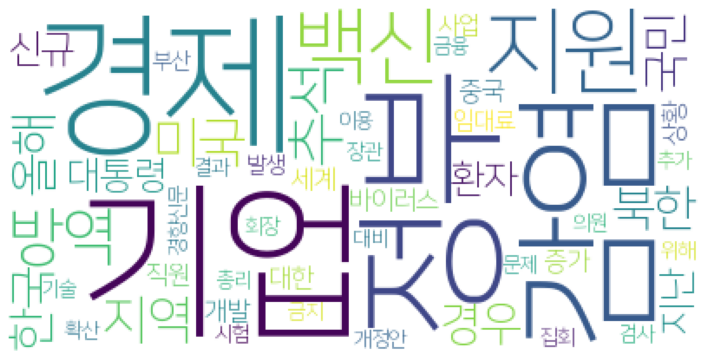

2020.09.23
['국내', '불법', '환전', '성인', '사무실', '경찰', '조직']
['음주운전', '차량', '사고', '음주', '단속', '인천', '운전자']
['노동', '시간', '세계', '감소']
['박애', '명의']
['박애', '명의']
[]
['판다', '조선', '아파트', '사람']
[]
['집회', '광화문']
['세계', '노동', '소득', '감소']
['제주']
[]
['일본', '명대']
['미국', '사망자', '트럼프', '백신', '대통령', '경향신문', '전문가', '전쟁']
['의회', '한국', '테크놀로지', '방역', '살균', '취약', '계층', '자외선', '기부', '서울시']
['노동', '시간', '세계', '감소']
['일본', '명대']
[]
['일본', '명대']
['제주', '판정', '격리']
['제주', '확진', '격리', '방역']
['경향신문']
[]
['백신', '중국', '코백스', '개국', '세계', '공급', '약속', '국제사회', '미국']
['사랑', '교회', '예배', '경찰']
['상인', '추석', '조선', '시장', '과일']
['일본', '명대']
['임차', '임대료', '요구', '앵커', '상가']
['북한', '중국', '달러', '방역', '수입', '당국', '국경']
['희생', '트럼프', '대통령', '미국', '중국', '사망자']
[]
['방한', '북한', '북미', '미국', '상황', '폼페이', '장관', '종전', '선언', '대통령', '가능성', '앵커', '대선', '중국']
['쓰레기', '정부', '처리']
['중국', '바이러스', '미국', '대통령', '책임', '트럼프', '경향신문', '유엔', '연설']
['방한', '미국', '폼페이', '정부', '한국', '대선']
['출생', '인구', '기준', '사망자', '자연', '감소', '기록', '혼인', '통계청']
['유럽']
[]
['통과

['방역', '시민', '대책', '추석', '연휴', '의료']
['허가', '판매', '제품', '중국산', '체온계', '제보', '의료기기', '인증']
['환자', '아동', '성인', '청소년', '선천면역']
['환자', '아동', '성인', '청소년', '선천면역']
['실험', '마리', '탐지견', '구진', '핀란드', '여행객', '검사']
['치료', '성분', '바이러스', '예방']
['기회', '영향', '응답', '전략', '반면', '기후변화', '도성', '위기', '제주', '대한', '대해', '장기', '이인', '가장', '도민', '평가', '문화', '미래', '조사', '생각', '포스트', '시대', '변화', '인식', '이상']
['캠페인', '북부', '본부', '본부장', '인재', '극복']
['대화', '사회', '국민']
['이스라엘']
[]
['개월', '임대료', '감액']
['개월', '임대료', '감액']
['뷰티', '공간', '실제', '최근', '기반', '가상', '기술', '기능', '기업', '게임', '현실', '서비스', '사물', '효과', '정보', '세계', '메이크업', '플랫폼', '활용', '단계', '배치', '작업']
['노래방', '노래', '서비스', '부스', '규제', '무선', '통과', '정보', '충전', '실증특례', '버스']
['경찰청', '디지털', '교도소', '신상', '베트남', '검거', '인터폴', '수사']
['임대료', '임차', '임대', '요구', '개정안', '감염병', '감액', '계약']
['북구', '시민', '청구', '구상권', '부산', '자가', '격리', '지자체', '방역', '손해배상', '순천시', '피해', '전파']
['동아리', '대학', '모집', '축제', '온라인', '문화', '신입생']
['근무', '전자', '서관', '직원', '트윈타워', '판정', '확진']
['개교', '대학', '신청

[]
['혈액']
['올해', '해외', '증가', '라면', '글로벌', '전략', '상승', '동기', '식품', '수출', '작년', '미국', '업체', '생산', '중국', '현지', '판촉', '확대', '추진', '푸드', '물류', '세계', '한국', '상반기', '시장', '각각', '수요', '대비', '공장']
['배달', '주행', '로봇', '아파트', '실내', '사업', '때문', '서비스', '실외', '수행']
['동국제강', '항균', '바이오', '스틸', '국내', '진료']
['상황', '학교', '파란색', '세계', '시작', '수업', '교사', '에듀', '학생', '테크', '교육', '등교', '격차', '수준', '정부', '온라인']
['방청권', '재판']
['때문', '변수', '김현준', '과정', '오프라인', '시트', '당근', '목표', '우리', '직방', '활용', '정부', '상황', '지역', '전문가', '경험', '펀딩', '역시', '고객', '기반', '부분', '국내', '전환', '중심', '결과', '접근', '기업', '환경', '디지털', '가치', '시장', '이웃', '이기', '온라인', '분야', '신혜성', '빅데이터', '메이', '대면', '의사결정', '유니콘', '성장', '산업', '기회', '마켓', '사람', '고민', '위기', '지원', '문제', '적용', '부동산', '스타트업', '통해', '혁신', '성우', '데이터', '업무', '집중', '시대', '생각', '변화', '사업', '회사', '뷰노', '분석', '전문', '사회', '대한', '대표', '가장', '제품', '준비', '이수진', '문화', '기술', '서비스', '의료', '다른', '소비자', '전자신문', '시스템', '대응']
['사업', '정부', '전망', '올해', '비대', '스타트업', '지원', '분야', '산업', '플랫폼', '기업', '서비스',

['지원', '시행일', '기업', '대출', '피해', '은행', '취급', '대해', '실적', '상공', '한도', '자금', '한국은행', '확대']
['피해', '상공', '증액', '대상', '공인', '대출', '지원', '한도', '비율', '중소기업', '기업', '지난', '금융', '은행', '기존', '개지', '소상']
['지원', '대출', '금융', '중개', '한도', '기업', '중소기업', '금리', '자금', '자영', '업자', '피해']
['검사', '진료', '운영', '추석', '연휴']
['지원', '기업', '노컷뉴스', '상공']
['행사', '스튜디오', '서울시']
[]
['감염', '백혈구', '혈관', '유체', '개발', '여부', '경제', '미세', '세균', '단백질']
['한도', '금융', '금융기관', '지원', '대출', '기업', '피해', '자금', '중소기업', '금리', '경제', '원금', '상공']
['피해', '대출', '지원', '기업', '은행', '취급', '대해', '자금', '한국은행', '시행일', '소재', '대상', '실적']
['대출', '지원', '상공', '은행', '기업', '자금', '취급', '금융', '대한', '피해']
['기업', '정부', '투자', '인력', '사업', '채용', '조사', '확대', '정책']
['지원', '대출', '피해', '금융', '기업', '증액', '상공', '중개']
['환전', '경찰', '게임', '사무실', '운영', '불법']
['이후', '개월', '감소', '인구', '출생', '혼인', '사망자', '가장', '역대', '영향', '자연', '증가']
['감소', '인구', '혼인', '출생', '기준', '자연', '누적', '전보', '건수', '통계', '최소']
['지원', '대출', '기업', '상공', '대해', '증액', '중소기업', '피해', '은행', '실적']
['단백질', '환자', 

['아동', '취약', '긴급']
['성지순례']
['매출', '백화점', '브랜드', '리빙', '가구', '회장', '프리미엄', '그룹', '지난해', '미아', '업계', '롯데']
['노조', '협력', '이노', '활동', '공정']
['여성', '단체', '유흥주점']
['진단', '키트', '엑세스', '바이오', '항원', '유럽']
['미국', '사망자', '라며', '전쟁', '마스크', '존스홉킨스', '대학']
['노조', '협력', '이노']
['중국', '세계', '미국', '사망자', '연설', '백신', '유엔', '어린이', '총회', '각국', '정상', '앵커', '누적', '대통령', '진행', '신규', '증가', '트럼프', '시험', '책임', '전망', '나라']
['감염병', '장소', '지역', '정부', '허용', '판단', '기본권', '사람', '마스크', '제한', '판사', '원인', '방역', '문제', '우리', '사회', '모든', '상황', '금지', '사실', '보장', '주장', '국민', '때문', '인권', '조치', '자체', '시민', '다른', '자유', '서울시', '감염', '집회', '위기', '위험', '광화문', '대해', '교회']
[]
[]
[]
[]
['체육', '브랜드', '소비', '세대', '가치', '제로', '미트', '비건', '제품', '지속', '패션', '업계', '뷰티', '푸드', '기업', '동물성', '원료', '사용']
['표준화', '면역', '항체', '테스트', '검사', '단백질', '결과', '수준', '수치', '센터', '키트']
['광주', '환자', '판정']
['미국', '사망자']
['이탈리아', '검사']
['사망자', '미국']
['중국', '주석', '경향신문', '국가']
['동선', '격리', '부산', '북구', '자가', '통보', '청구', '순천시', '구상권', '순천', '장례식', '보건소', '시민']


['캐나다', '노컷뉴스']
['상승', '경제', '기술', '강세']
['백신', '독감', '중국', '접종', '의료']
['마테이', '대통령', '과테말라']
['지원', '수시', '대학', '모집', '연합뉴스']
['한국', '정보', '온라인', '김씨']
['시장', '온라인', '태블릿', '아이패드', '노트북', '올해', '판매량', '증가', '애플', '대비', '에어', '수요']
['순천시', '순천', '격리', '부산', '자가', '통보', '청구', '보건소', '관리', '확인', '북구', '접촉', '대응', '동선', '대상자', '지난', '시민', '구상권', '북구청']
['청원', '추석', '연휴', '명절', '이동', '금지', '국민', '자제']
['사망', '미국', '사망자', '수가', '전쟁']
['백신', '중국', '중국산', '임상시험']
['중국', '트럼프', '대통령', '미국', '책임', '시진핑', '사태', '세계']
['백신', '빈곤', '확보', '국제사회', '개발', '역시', '대통령', '지원', '국제', '개도국', '코백스', '상황', '기금', '언급', '유엔', '각국']
['가을', '태풍', '감염', '발생', '발열', '감염병']
['승인', '백신', '지침', '미국']
['미국', '사망자', '영국']
['스톡홀름', '스웨덴']
['백신', '차관', '경제', '협력']
['노벨', '시상식']
['중국', '연설', '트럼프', '대통령', '주석', '화상', '유엔']
['조치', '지수', '기술', '봉쇄', '미국', '주가']
['유엔', '개발', '중국', '라며', '트럼프', '대통령', '미국', '연설', '백신', '세계']
['미국', '쿠바', '정부']
['유엔', '러시아', '직원']
['책임', '중국', '트럼프', '대통령', '바이러스', '연설', '시진핑', '이번', '미국', '주

['마시스', '진단', '키트', '항원', '승인']
['의료', '롯데', '하이마트', '전국']
['검사', '항체', '테스트', '표준화', '단백질', '결과', '수준', '수치', '센터', '키트', '면역']
[]
['우울증', '환자', '올해', '의원']
['근무', '직원', '서관', '전자', '판정', '지난', '확진']
['추가', '확진', '관련', '모두', '직원', '감염', '검사', '사장', '접촉', '방문', '근무', '어제', '서울시', '마트', '다른', '업체', '지인']
['건강', '비타민', '결핍']
['채널', '선물', '온라인', '배송', '당일', '서비스', '매장', '주문', '추석', '구매', '정관', '이용', '이상', '지역']
['어린이', '백신', '어른', '개발', '대상', '시험']
['체온계', '판매', '의료기기', '허가', '접촉', '제조', '서울시', '민생', '사법', '경찰', '식약처']
[]
[]
[]
['불법', '환전', '노컷뉴스', '조직', '경찰', '게임']
['검사', '종합', '금감원', '인력']
['사업', '시공사', '조합', '광주', '선정', '구성', '의원', '조합원', '재개발', '법원', '상황']
['항균', '바이오', '컬러', '강판', '스틸', '국내', '진료', '장재', '인증', '동국제강']
[]
['심리']
[]
[]
['결핍', '비타민', '건강']
['진단', '수젠텍', '항체', '국내', '사용']
['직원', '한국', '투자', '증권', '본사']
['경제', '방역', '외국인', '활동', '완도']
['금지', '예배', '교회', '사랑', '조치', '현장']
[]
['디자인', '포럼', '세계', '디자이너', '올해', '우리', '지난']
['대표', '야당', '확진', '퀘벡']
[]
['매출', '쿠팡', '상공', '경제', 

['수출', '허가']
['수출', '허가']
['사망자', '미국', '트럼프', '대통령', '누적', '여명', '중국']
['파우치']
['경남', '검사']
['추가', '검사', '직원', '근무', '전자', '서관', '판정', '확진', '트윈타워']
['직원', '전자', '트윈타워', '근무', '확진', '서관', '판정']
['영업', '저작권료', '노래방', '음저협']
['정부', '의료', '백신', '접종', '무료', '공급', '독감', '물량', '당국', '보건', '관리', '입찰', '업체', '약품', '대상', '문제', '유통업체']
['지난', '검사', '확진', '증상', '판정', '발현', '조사', '발생', '감염', '격리', '중이', '가족', '자가', '관련']
['미국', '영국', '할로윈', '봉쇄', '유럽', '최근', '이후']
['미국', '사망자', '파우치', '트럼프']
['트럼프', '미국', '사망자', '파우치']
['백신', '어린이', '시험']
['중소', '정책', '협력', '스카이라이프', '이내', '지급']
['상담', '심리', '방역', '의료', '보건', '인력', '롯데']
['총리', '국민', '정부']
['미국', '영국', '확산']
[]
['쿠팡', '배송', '매출', '로켓', '상공', '소상', '공인', '창업', '성장', '사태', '효과', '학회']
['쿠팡', '배송', '매출', '로켓', '상공', '소상', '공인', '사태', '학회', '효과', '창업', '성장']
[]
['진단', '국내', '항체', '수젠텍', '승인', '임상시험', '키트', '사용', '기관', '식약처', '감염', '사용승인', '진행']
['마시스', '진단']
['진단', '국내', '수젠텍', '승인', '임상시험', '항체', '진행', '식약처', '사용승인']
['고성', '소가야', '문화제', '공연']
['조절'

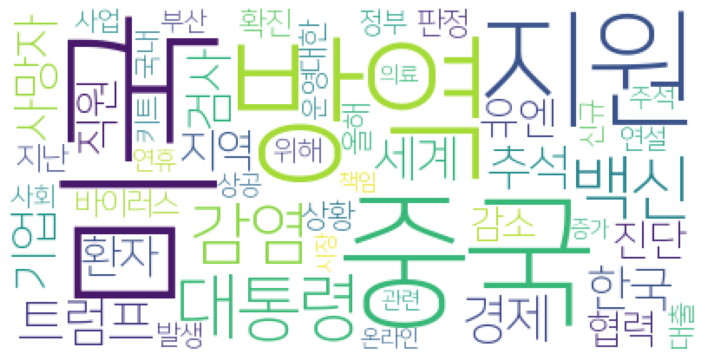

2020.09.22
['신규']
['신규']
['시상식', '에미상']
[]
['전화', '금리', '대출', '은행', '신용', '저축은행', '금융', '실제']
['보고']
['총리', '검사']
['백신', '중국', '임상시험']
['경제', '일본']
['백신', '중국', '임상시험']
['벌초', '작업', '대행']
['접종', '독감', '예방접종', '무료']
['경향신문', '부산시', '수상자', '선정', '부산', '부문']
[]
['사용', '백신', '승인', '중국']
['일본']
['영국']
['총리']
['신규', '보고']
['신규', '보고']
[]
['신규']
['환기', '실내', '에어컨', '방울', '공기', '실험', '기량', '시간', '경우', '사람', '최재영', '확산']
['환기', '실내', '에어컨', '방울', '공기', '실험', '시간', '사람', '경우', '최재영', '기량', '확산']
[]
[]
['신규', '경제', '대비']
['자가', '사실', '친척', '보건소', '격리', '북구', '순천시', '순천', '부산', '통보', '확진', '전화', '감염', '다음', '장례식', '확인']
['북구', '장례식', '확인', '보건소', '격리', '자가', '순천시', '순천', '부산', '다음', '친척', '감염', '사실', '전화', '통보', '확진']
['의료', '간호사', '하루', '지급', '추경']
['백화점', '정기']
['백신', '시험', '파키스탄']
['총리', '검사', '경향신문', '취소']
['퍼실리티', '개발', '백신', '코백스', '공급', '통해', '확보', '구매', '참여', '경향신문', '계약']
['총리', '검사', '부산']
['지원', '국민', '지급', '예산', '의원', '증액', '통신비', '아동', '접종', '확대', '경향신문', '특별', '백신', '명목', '대상', '이상',

['부본', '조사', '감염', '사례', '부장', '국내', '의심']
['수시', '도내', '학교', '등교', '수업', '전형', '수험생', '상황', '학년']
['회장', '우리', '취업', '환경', '영상']
['키트', '진단', '지노', '믹스', '미국', '보도', '문제', '지난', '신뢰', '양성', '호건', '메릴랜드', '국내', '랩건']
['노사', '활동', '사회', '일손', '고구마']
['의원', '감축', '정수', '이탈리아', '정당', '오성운동']
['판매', '소설', '한국', '올해']
[]
['대통령', '청와대', '부산']
['위축', '올해', '소비', '민간', '감소', '회복', '전망', '서비스']
['택시']
['면세점', '입찰', '사업', '유찰', '신라', '이번', '면세', '업계', '참여', '포기', '중국', '업체']
[]
['코백스', '확보', '백신', '정부', '퍼실리티', '개발', '계획', '수급', '실리']
['면세점', '이번', '영업', '사업', '입찰', '참여', '업체', '롯데', '신라', '유찰', '업계', '면세', '인천공항', '모두', '사태', '계약']
['감소', '매출', '업종', '카드', '서비스']
['센터', '여성', '김혜민', '이야기', '예방', '청년', '내용', '장님', '저희', '조금', '이분', '사회', '지금', '다음', '주지영', '생각', '서울시', '정신건강', '대해', '사실', '사람', '관계', '고민', '주시', '하나', '문제', '실제', '정말', '여러', '전화', '우리', '수가', '때문', '얘기', '마음', '가지', '상실', '자살', '말씀', '존재', '경제', '관련', '부분', '상담', '대한', '상황', '건강', '통계', '스스로', '호소']
['유통', '경우', '미국', '백신', '온도'

['한국', '바이러스', '치료']
['한국', '바이러스', '치료']
['증상', '감기', '유행', '인플루엔자', '호흡기', '감염병', '구분', '바이러스', '치료', '매우', '가능성']
['부산']
['유행', '거리', '두기', '백신']
['거리', '유행', '두기', '백신']
['부산', '주거지', '정비', '소득']
['회장', '우리', '환경', '기회']
['유행', '인플루엔자', '구분', '질병', '부본', '부장', '가능성']
['택배']
['하반기', '글로벌', '시장', '디아', '판매량', '노컷뉴스', '전자', '지난해']
['접촉', '총리', '청사', '검사', '총리실', '검체', '국장', '방역']
[]
[]
['영국', '조치', '하루', '증시']
['감염', '사례', '치료', '백신']
['지역', '중견', '노인', '식료품', '사회']
['격리', '해제', '미군']
['의료', '헌혈', '혈액', '센터', '관리', '본부', '참여', '예약', '상황', '유량', '연휴', '공급', '강남', '적십자사']
['총리', '검체', '검사', '접촉', '청사', '총리실', '국장']
['소비', '회복', '감소', '확산', '이후', '민간', '대면', '서비스', '향후']
[]
['여성', '전후', '감소', '집안', '병원', '밀도', '운동', '때문', '폐경', '우울증', '건강', '질환', '비타민', '실시', '결핍', '증가', '경우', '환자', '중년', '스트레스', '결과', '골다공증', '걷기', '우울', '자생']
['진단', '큐릭스', '키트']
[]
['추진', '경제', '활성화', '안정', '지원', '대책', '위해', '지역', '사업', '마이스', '자금', '소비', '비대', '추석', '특별', '확대']
['중국', '공산당', '공화당', '의원', '트럼프', '대통령',

['치료', '임상시험', '계절', '독감']
['접촉', '총리', '검사', '오늘', '총리실', '검체', '국장']
[]
['청원', '기간', '추석', '연휴', '금지', '이동', '명절', '자제']
[]
[]
[]
[]
['항체', '미국', '진단', '키트', '제품', '개발', '수젠텍']
[]
['키트', '진단', '멕시코', '회사', '승인']
['진단', '키트', '에이스', '바이', '오메', '투자', '획득']
['쿠우', '혐의', '회장', '점주', '매장', '본사', '가맹']
['키트', '진단', '멕시코', '회사', '경제']
['에미상', '시상식']
['감사', '비대', '충남교육청', '학교', '수감']
['기업', '고용', '지원', '고창', '컨설팅']
['필요', '백신', '사용', '문제', '지금', '실제', '사실', '전혀', '보고', '공급', '당국', '이상', '검사', '이번', '보이', '순영', '병원', '수도', '여러', '유지', '말씀', '감염', '앵커', '접종', '부분', '물량', '노출', '대면', '방역', '가지', '기간', '대규모', '학교', '정도', '교수', '시기', '생각', '이건', '차원', '사람', '수업', '바이러스', '얘기', '접촉', '수가', '만약', '폐기', '독감', '조금', '이기', '진단', '발생', '상온', '식사', '때문', '경우', '우리', '비대', '가운데', '상황', '추석', '예방접종', '중단']
['판정', '천안']
['예술인', '재난', '원금', '수원시', '가구']
['세계', '경향신문']
['국민', '지급', '합의', '여야', '원내대표', '추경', '대상', '지원', '민주당', '예산']
['기관', '감사', '증인', '국정감사', '교육부', '교육', '대상', '출석', '포함', '올해']
[]
[]
['대표',

['콘텐츠', '학습', '제공', '수업', '초등', '와이즈캠프', '수학', '학부모', '판다', '유형', '중학', '교과', '학생', '방향', '관리', '개념', '실시간', '맞춤', '화상', '진도']
['주석', '세계', '국제']
['택시', '승객', '기사', '호출', '업체', '서비스']
['기록', '국내', '사망자', '치명', '환자', '증가']
['지역', '격리']
['당국', '감염', '학생', '학교', '교사']
[]
['예술인', '원금', '재난', '문화', '긴급', '지급', '가구', '기준']
['의장', '의회', '협의', '연수', '전남']
['우유', '롯데', '푸드', '파스퇴르', '캠페인']
['회장']
['연금', '프로그램', '교직원', '경제', '사학', '스트레스', '센터', '정신건강']
['공기', '전염', '고문', '코로나바이러스', '개정', '감염', '통해', '사람', '입자']
['마스크', '착용']
['유엔', '주의', '중국', '주석', '국제', '대신', '다자']
['중국', '귀국', '취업', '올해', '이상', '유학', '대졸', '대학', '파의']
['올해', '취업', '중국', '이상', '유학', '귀국', '대졸', '대학', '파의']
['국민', '의원']
['방역', '소독', '성남시', '추석', '연휴', '차량']
['기업', '국민', '경제', '의원', '공정', '입장', '정무', '위원장', '위원회']
['아이', '신규', '격리']
['지원', '기업', '고용', '고창', '컨설팅', '사업']
['고창', '지원', '기업', '고용', '컨설팅', '사업']
['수도권', '자릿수', '명대', '신규', '감염', '연속', '관련', '지역']
['부산', '일보']
[]
['해외']
[]
[]
['국내']
['기록', '이데일리', '확진']
[]
['활동', '리턴',

['집중', '조명', '재택근무', '중심', '업계', '확산', '가정', '최소', '작업', '밝기', '공간', '스마트', '이상']
['환율', '달러', '증권', '전망', '하락']
['바이든', '후보', '미국', '말실수']
[]
['아르헨티나', '감염']
['브라질', '누적', '백신', '상파울루', '주민', '접종']
['백신', '접종', '문제', '유통', '과정', '독감']
[]
[]
['대통령', '한국', '믹타', '유엔', '연대', '협력', '국제', '개국', '다자', '주의', '극복', '위기']
['누적', '백신', '상파울루', '주민', '브라질', '접종']
[]
['사업']
['감염']
['입원', '유증', '무증상', '감염', '연구', '상자', '환자', '증상', '결과', '기침']
['전염', '공기', '고문', '코로나바이러스', '개정', '감염']
['학교', '경제', '우울', '문제', '심리', '방역']
['지원', '관광', '사업', '경기도', '여행', '관광업', '경기', '업체', '시즌', '업계', '개사']
['감기', '독감', '질환', '가능성', '인플루엔자', '가지', '감염', '의료', '경우', '백신', '코로나바이러스', '증상', '바이러스', '환자']
['영국', '영업']
['사람', '추석', '고향']
[]
['영국', '단계']
['파월', '의장', '경제']
['인플루엔자', '예방접종', '접종', '독감', '백신', '중단', '질병', '무료', '대한', '관리', '대상', '예정']
['하락', '지수', '거래', '미국', '주가']
['대통령']
['확진']
['접종', '유통', '백신', '문제', '독감', '중단', '질병', '앵커', '무료', '과정', '계획']
['에미상', '시상식']
['결과', '응답', '임금', '워드', '조사']
['하락', '미국', '지난'

['대통령', '유엔', '연대', '협력', '국제', '정상', '믹타', '한국', '백신']
['대통령', '한국', '정상', '국제']
['대통령', '한국', '정상', '국제']
['유엔', '대통령', '한국', '회의', '믹타', '위기', '출범']
['한국', '국제']
['국제', '대통령', '한국', '위기', '믹타', '다자']
['채용', '은행', '신입', '하반기', '진행', '지난해', '금융', '모집', '올해', '규모', '선발', '여명', '시험', '시작', '시중', '인원', '우리은행', '디지털', '비대', '분야']
['주민', '선교']
['일정', '과정', '백신', '접종', '문제', '독감', '폐기', '유통', '물량', '질병']
['백신', '접종', '문제', '독감', '일정', '폐기', '유통', '과정', '물량', '질병']
['주년', '유엔', '믹타', '우리', '개국', '지역', '대통령', '기후변화', '평화', '결의', '협력', '위기', '대표', '기념', '다자', '대응', '혁신', '연대', '역할', '주의', '파트너', '인류', '극복', '발전', '국제', '공동체']
['에르메스', '명품', '이코노미스트', '업계', '기업', '가방']
['센터', '시행', '시차', '출근', '제도', '근로시간', '기업', '근로자', '업무', '퇴근', '재택근무', '출퇴근', '고용', '장소', '선택', '지원', '유연근무제', '근무', '중앙', '일보', '무제', '컴퓨터', '회사', '재택근무제', '원금', '유형', '시간', '제출', '방식']
['사용자', '원격', '서비스', '온라인', '수요']
['경기', '회복']
['검사', '추석', '운영', '해외', '출국', '시행']
['공장', '역학', '조사', '검사', '광명시', '소하리', '발생', '실시', '검체', '대

['경제', '업계', '포장재', '식품', '인쇄', '사용', '용량', '친환경', '방식', '플라스틱', '용기', '지속', '외식', '포장', '가능']
[]
[]
['검체', '매트릭스', '검사', '진단', '키트', '제품', '채취', '바이러스', '적용', '타액']
['전자', '근무', '아이', '서관', '직원', '트윈타워']
['백신']
['물동량', '인천', '올해', '증가', '목표', '컨테이너', '항만', '지난해']
['수능', '시험', '방역', '치료', '개발', '지원', '대표', '대책', '모든', '평가', '올해', '교육부', '공연예술']
['수업', '학기', '장학금', '지급', '유원']
['영업', '사업', '팩토리', '한국', '증가', '평가', '신용']
['경향신문', '인천']
['양천구']
['양천구']
['후보', '결과', '바이러스', '개발', '치료', '실험', '메콕', '메드', '스큐어', '물질', '효능', '튜브', '파마', '진행', '공동']
['이씨', '아버지', '소송', '정부', '우한시', '중국', '장하', '은폐', '통해', '죽음']
['경제', '대구', '지난', '택시']
[]
['환자']
['고용', '유지', '휴직', '무급', '원금', '지급']
[]
[]
['회장', '경영', '환경', '경제', '우리']
['회장', '경영', '환경', '경제', '우리']
['경우', '현충원', '참배', '운영', '서비스', '추석', '연휴', '기간', '예정', '추모']
['참배', '운영', '서비스', '현충원', '추석', '연휴', '기간', '경우', '예정', '추모']
[]
['우울', '심리', '마음', '시민', '상담', '심리상담', '정신건강', '건강', '캠페인', '주치의', '원단', '극복']
['중국', '제품', '당국', '수입', '식품', '지난', '바이러

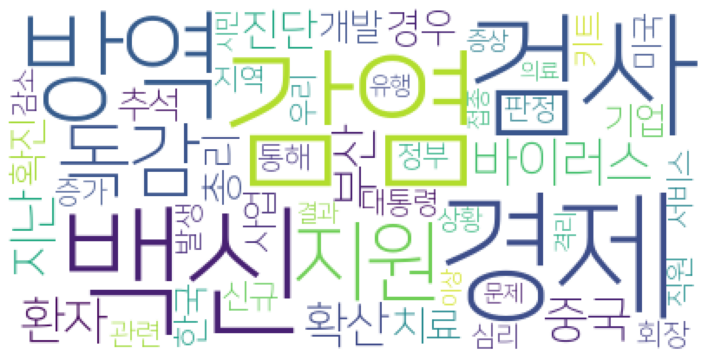

2020.09.21
[]
['정부', '택배', '원금', '사칭', '문자']
['부산', '격리', '장례식', '경제']
['의료', '설립']
['경로', '바이러스', '상황', '감염', '방역', '환자', '발생', '추가', '집단', '당국', '계속', '비율', '연휴', '관련', '주간', '사례']
['발생', '상황', '감염', '방역', '환자', '집단', '경로', '당국', '계속', '추가', '사례', '바이러스', '연휴', '비율', '주간', '관련']
['서울시', '대한항공', '송현동', '부지', '매각', '계획', '합의', '권익위']
['합의', '자동차', '위기', '노동조합', '노조', '기본', '동결', '현대차', '상황', '노사', '잠정', '위원장', '시장', '고용', '때문', '회사', '글로벌', '업체', '관계자', '미래', '동의', '다른', '업계', '교섭', '산업', '파업', '조합원', '국민', '규모', '임금']
['제약', '주가', '처분', '시간', '거래', '사주', '공시']
['교수', '조치', '영국', '휘티', '대응', '봉쇄']
['경향신문', '재테크', '금융']
[]
[]
['자동차', '산업', '협력', '노사', '합의', '품질', '잠정', '확보', '미래', '위기', '마련', '통해', '교섭', '고객', '향상', '임금']
['독감', '사망자', '미국']
['노사', '합의', '잠정', '미래', '자동차', '교섭', '산업', '동결', '이후', '위기']
['분규', '임금', '동결', '기본', '현대차', '노조', '위기', '합의', '지난해']
['노사', '교섭', '합의', '잠정', '산업', '미래', '품질', '경제', '변화', '협력', '올해', '위기', '위해', '자동차']
['노사', '잠정', '교섭', '합의', '자동차', '위기', '극복', 

['이코노미스트', '에르메스', '명품', '업계', '기업', '인수', '가방', '아르노', '회장', '방식']
[]
['입원', '병실', '격리', '병원', '환자', '세명', '기독', '포항', '확진', '검사']
['북구', '포항', '무증상', '조사', '지난']
['금호', '고속']
['교과서', '수업', '대해', '세계', '디지털', '사회', '교육부', '사진', '초등', '책형', '확인', '지적', '오마이', '유산']
['금지', '업종', '발생', '집합']
['학생', '대학', '학교', '중국', '시안', '봉쇄', '외출', '집단', '시위']
['포항시', '조사', '북구', '세명', '기독', '병원', '확진', '판정']
[]
['환자', '중증', '치료', '병상', '병동', '병원', '음압', '추가', '확보', '서울대', '위험', '격리']
[]
['취업', '교육', '구직', '지원', '포스코', '청년', '중소기업', '대상']
['증상', '감염', '사례', '바이러스', '의심', '대해']
['개발자']
['백신', '중국', '실험', '접종']
[]
[]
['대대장', '인권위', '모금']
[]
['피해', '확인', '사례', '개인정보', '스미싱', '장부', '문자', '식당', '유출', '허위', '작성', '우려', '번호']
['라이브', '아프리카', '학습', '진행', '방송', '온라인', '지원', '기술']
['시상식', '에미상', '수상자']
['상황', '국감', '금융', '증인', '국회', '출석', '정무', '채택']
['국감', '정무', '금융', '증인', '국회', '출석', '채택', '상황']
['감염', '바이러스', '사례', '다시']
['택시', '기사', '격려', '지급', '법인', '회사']
['터키', '인도', '협정', '개도국', '문제', '투자', '때문', '발효', '

['하루', '오늘', '택배', '물류', '물량', '추석', '센터', '작업', '연휴', '인력', '거부', '분류', '평균']
['혈장', '병원', '녹십자', '치료', '환자', '국내', '해외', '개발', '투여']
['병원', '포항', '지역', '포항시', '시설']
['서류', '결정', '피해', '신청', '지급', '복지', '지진', '주민', '원금']
[]
[]
['증권', '현대차', '그룹', '전기차', '시가총액', '목표']
['재난', '시민', '집합', '무료', '지원', '거제시', '지급', '지역', '대상', '위해', '거제', '경제', '원금', '출연', '위기', '극복', '통해', '시설']
['파산', '신청', '개인', '기업', '법인', '법원', '규제', '접수']
['탐방', '등산', '등산로']
['사례', '감염', '모스크바', '완치', '치료']
['단속', '음주운전', '음주']
['상품', '비행', '관광', '항공', '여행', '업계', '체험', '항공사', '관계자', '대상', '도착', '중이', '준비', '대한', '국내', '기내', '교육', '비행기']
['협약']
['다시', '재양', '방역', '검사', '감염', '바이러스', '사례', '확진', '판정', '양성', '성자', '치료']
['한국', '감정', '지역']
['증가', '통신비', '지원', '여야', '의원', '부담', '주장', '지급', '정부', '활동', '유지', '심사', '국민', '사람', '비대', '예산', '처리', '추경안', '원안', '추경']
['사실', '주장', '제기', '신탁', '회사', '라며', '공사', '국민', '위원회', '보도', '언론', '국토', '수주', '의혹', '의원', '통해', '소속', '거나', '기자회견', '국회의원', '골프장', '대한', '당시', '박덕흠', '활동', '해명'

['심사', '합병', '중공업', '아이', '대우조선', '기업', '결합', '중국', '싱가포르', '해양', '양사', '승인']
['후보', '바이든', '흑인']
[]
['휴게소']
[]
['관련', '누적', '사례', '발생', '추가', '확진', '확인', '현재', '이후']
['배출', '이산화탄소', '부유', '상위', '배출량']
['접종']
['기아차', '공장', '가동', '소하리', '생산', '중단', '카니발', '아이', '직원', '차질', '수출', '모델', '계약']
['문화', '칼텍스', '지역', '사회', '위해', '예술', '여수', '경북', '전달', '마루']
['회복', '무역', '세계']
['추석', '본부장', '연휴', '지역', '위험']
['사례', '감염', '그룹', '바이러스', '국내', '유형', '증상', '보고', '확진', '입원']
['경찰', '기관', '국민', '개혁', '권력', '입법', '국정원', '자치', '우리', '위원장', '검찰', '국가', '행정', '출범', '조속', '위해', '노력', '수사']
['사망자', '미국']
[]
['보도', '박사', '바늘', '바이러스', '논문', '언론', '연합뉴스', '기사', '홍콩', '인용', '라며']
['납부', '요금', '가구', '도시가스', '계층', '유예', '연장']
['방역', '수도권', '지역', '강남', '집단', '위험', '업체', '관련']
['이봉주', '발생', '앵커', '체력', '교수', '복지', '보호', '학과', '예산', '학대', '취약', '서울대', '기본', '양육', '사건', '징후', '대책', '비극', '생각', '가장', '사회', '아동', '문제', '가정', '인력', '기관', '최근', '때문', '지금', '경우', '말씀', '서비스', '사후', '사실', '측면', '체크', '아동학대', '우리', '처벌',

['탐구', '선택', '지원', '학년', '영역', '수능', '졸업생', '감소']
['방역', '추석', '기간', '특별', '조치', '거리', '두기', '이동', '이상', '정부', '주간', '이후', '단계', '사회', '발생', '전국', '시설', '유행', '수도권', '위험']
['우리', '대통령', '유엔', '믹타', '개국', '대응', '연대', '협력', '총회', '국제', '지역', '결의']
['유엔', '대통령', '주년', '다자', '믹타', '주의', '국제', '우리', '개국', '채택']
['한국', '개국', '회복', '대통령', '믹타', '국제', '라며', '다자', '유엔', '문재인', '대표', '정상', '주의', '연대', '협력', '인류', '지역', '위기', '발언']
['지역', '유엔', '한국', '국제', '우리', '다자', '위기', '연대', '대응', '협력', '개국', '채택', '백신', '인류', '대표', '결의', '안전', '믹타', '주의', '회의']
['대응', '유엔', '믹타', '대통령', '국제', '정상', '대표', '우리', '개최', '다자', '회의', '제안', '한국', '주의', '채택', '개국']
['위기', '한국', '대통령', '유엔', '연대', '회의', '극복', '협력', '지역', '우리', '국제', '정상', '다자', '주의', '믹타', '백신']
['한국', '대통령', '강조', '유엔', '방역', '위기', '이웃', '이야기', '안전', '주의', '인류', '국경', '다자', '국제']
['연대', '위기', '주의', '대통령', '한국', '믹타', '유엔', '협력', '국제', '극복', '개국', '다자']
['믹타', '대통령', '국제', '정상', '대표']
['유엔', '한국', '국제', '믹타', '우리', '위기', '연대', '협력', '다자', '안전', '대응'

[]
[]
['집단', '발생', '감염', '신규', '수도권', '관련', '전날', '자릿수', '지역', '명대', '환자', '연속', '누적']
['학생', '기숙사', '학교', '수업', '대면', '확진']
['중국']
['신규', '명대']
[]
['수출', '지사', '기업', '서비스', '비대', '지원', '긴급', '사업', '개사', '우리']
[]
[]
[]
['구매', '농가']
[]
['감염']
['전통', '올해', '시장', '대형', '마트', '품목', '가격', '비용', '지난해', '추석']
['감자']
[]
['신규', '명대']
['지역', '격리']
['키트', '진단', '필로', '시스', '항체', '항원']
['바자회']
['택배', '물량', '증가', '단가', '가격', '통운', '하락']
['감염']
[]
[]
[]
['확진', '방역']
[]
[]
['때문', '사망', '이전', '다수', '매우', '입장', '상원', '트럼프', '성향', '정치', '낙태', '강행', '결과', '이슈', '카드', '문제', '후임', '대법관', '민주당', '선거', '의원', '판사', '지지자', '보수', '공화당', '효과', '임명', '쟁점', '투표', '버그', '대통령', '후보', '의석', '인준', '인선', '유권자', '우리', '진보', '경우', '대한', '여론조사', '관련', '영향', '대선', '오히려', '대법원', '판결', '지명', '대해', '연방', '절차']
['추석', '생활', '위해', '기간', '안전', '상황', '연휴', '명절', '수거', '대책', '확산']
['경향신문']
['하수', '바이러스', '결과', '검사', '구진', '침전', '앞서', '감염', '변화', '분석', '농도', '지역', '시간', '증가']
[]
['신규', '명대']
['신규']
['신규']
['환자', '치료', '혈장', '투여', '

['트럼프', '후보', '여론조사', '대통령', '바이든', '유권자']
['전기차', '현대차', '그룹']
['이동', '조사', '결과', '응답']
['경제', '진행', '복지', '발행', '상담', '계층', '취약', '상품권', '제공', '위기', '추가', '혜택', '활용', '서비스']
['응답', '조사', '어려움', '감소', '정책']
['조사', '정책', '응답', '어려움', '감소']
['검사']
[]
[]
[]
['연설', '노컷뉴스', '유엔', '총회', '정상']
['시설', '경제', '명절', '추석', '대책']
['방역', '소독', '성남시', '추석', '연휴', '차량']
['사업']
[]
['경매', '예정', '일정', '진행', '아파트', '입찰', '휴정', '평균', '확산', '지역', '전체', '기록']
['대출', '은행', '신용', '시중', '이자']
['공채', '의료', '채용', '산업', '기업', '인피니트', '영상']
['도심', '변화', '산업']
['사망자', '미국', '집계']
['미국', '사망자', '집계']
['지급', '추석', '대금', '기간']
['모델', '전망', '라인업', '갤럭시', '전자', '아이폰', '애플', '아이', '하반기', '행사', '카메라', '인치', '보급', '스마트폰']
['재택근무', '직장']
['계획', '자의', '순위', '경우', '이번', '응답', '사회', '가족', '모임', '시민', '결과', '두기', '이동', '전환', '일정', '강화', '인식', '장거리', '취소', '일상', '위험', '가구', '조사', '이상', '거리', '상황', '감염', '단계', '수준', '경험', '주간']
['마스크', '착용', '국가', '방역', '통제', '서구', '정부', '과도', '문화', '프랑스', '아시아', '차이', '홍콩']
['교회', '우리', '갑옷']
['

['경남', '아이', '감염', '검사', '동아대', '수업']
['여행', '경제', '방역']
['매출', '식료품', '증가', '미국', '대비', '감소', '크로거', '모습', '소비자', '중순']
['분양', '이근형', '주택', '때문', '시장']
['감염', '관련', '발생', '최초', '확진', '병원', '경로', '집단', '사례', '전체']
['교회', '연구', '총회', '이단', '교단']
['진단', '키트', '메이트', '비드', '필로', '시스']
['주요', '산업', '지역', '자동차', '감소', '상반기', '조선', '부산', '생산', '업체', '지속', '동향', '대비', '중국', '유동성', '부진', '철강', '해운', '부품', '수요', '지원', '수출', '증가']
['바자회', '아이', '우리은행', '참여']
['성묘', '연휴', '기간', '시설']
[]
[]
[]
[]
['사망자', '트럼프', '대통령', '미국', '방역', '지난', '마스크', '경제', '기준']
[]
['재판', '원내대표', '혐의']
['관련', '환자', '감염', '집단', '발생', '기록', '전날', '수가', '확인', '일일']
['비정규직', '휴업', '상황', '보험', '조사', '수당', '지급', '지난', '응답', '직장인', '급여', '실직', '위기', '직장', '고용', '정규직', '실업', '감염', '변화']
['비행기', '설명', '감염', '비즈니스석', '확인', '보고서', '베트남', '승객', '확진', '모두']
[]
[]
[]
['협업', '관광', '스타트업', '공사', '하나투어', '한국']
['지원', '바이오', '산업', '그린', '기술', '육성', '개발', '식품', '성장', '유망', '정부', '방안', '핵심', '기업', '추진', '마련', '융합', '활용']
['원자력']
['감염', '응답',

['응답', '경험', '답변', '비정규직', '정규직', '실업', '실직', '휴직', '직장', '고용', '설문조사', '비자']
['원내대표', '처리', '국회']
['준비', '취업', '청년', '다른', '지난해']
['지난', '응답', '경험', '실직', '비정규직', '소득', '조사']
['대표', '대해', '국민', '공정', '장관']
['게이츠', '미국', '진단', '검사']
[]
['치킨', '할인', '버거']
['대표']
[]
[]
['의원', '패스트', '트랙', '자유', '한국']
['한국', '통제', '제한', '과정', '감염병', '우리', '재난', '빅데이터', '활용', '차원', '추적', '수도', '전쟁', '안전', '관련', '클럽', '초기', '정보', '국가', '상황', '제도', '감염', '장기', '권력', '이제', '방역', '제공', '정치', '관리', '이용', '보호', '행정권', '고민', '시민', '공동체', '자유', '중앙', '공포', '거버넌스', '확산', '종교', '기업', '스마트', '프라이버시', '존재', '시작', '문제', '행정', '의식', '민주주의', '개인정보', '체계', '대응', '세계', '위협', '민주', '논의', '미래', '개인', '사회', '강화', '가치', '위치', '감시', '테러', '시민권', '위기', '침해', '네트워크', '사생활']
['사회', '기업', '우리', '프라이버시', '관리', '이용', '빅데이터', '감염병', '대응', '체계', '활용', '강화', '거버넌스', '감염', '시스템', '논의', '고민', '정보', '테러', '차원', '위기', '민주', '관련', '행정부', '방역', '개인', '감시', '침해', '확산', '클럽', '국가', '공포', '과정', '존재', '초기', '행정권', '상황', '공동체', '제도', '장기', '제한', '

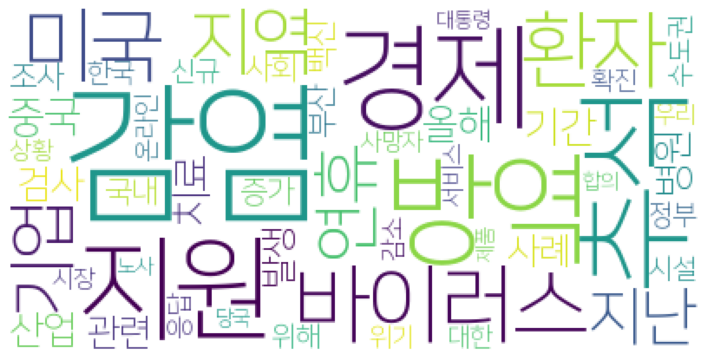

2020.09.20
['주민', '축제', '가요제']
['인승', '미니밴', '사용', '카니발', '공간', '차량', '대형', '시트', '경향신문', '여행']
['업계', '지난해', '실적', '전자', '가전', '이익', '영업', '전망', '증가', '판매', '예상', '스마트폰', '경향신문']
[]
['자녀', '청주', '판정', '충북', '퇴원', '검사', '확진']
['공장', '소하리', '가동', '중단']
['가족']
['조기투표', '투표', '우편물', '대선']
['공장']
['마드리드', '제한', '지역', '시위', '조치', '스페인']
['소리', '주목', '공연', '예술가', '무대', '관객', '전주', '노래', '방식', '참여', '축제', '도전', '의미', '기술', '지속', '현장', '온라인', '확인', '대한', '예술', '세계', '지역', '사업']
['의료', '감염병', '설립', '추진', '사업']
['의료', '감염병', '설립', '추진', '사업']
['추석', '벌초', '신청', '대행', '지난해']
[]
['공단', '국민']
['노동당']
['대전', '확진', '고모', '접촉']
['라이브', '커머스', '방송']
['공연', '추석', '거리', '마을']
['부산', '학생', '추가', '동아대', '조사']
['조정', '비판', '지사', '의원', '지역화폐', '국민', '주장', '중앙정부']
['태국', '집권']
['대전', '감염', '지난', '접촉']
['오후', '상가', '중구', '해당', '오전', '판정', '지난', '검사', '시간대', '카페', '확진']
['감염', '사례', '바이러스', '의심', '다시', '판정', '확진', '남성']
['가구', '발굴', '명예', '회복', '검침', '위기', '공무원', '전기', '매니저']
['위해', '지원', '부문', '주민', '새달', '자금'

['자가', '직원', '증상', '판정', '감염', '지난', '확진', '가족', '통해', '집단', '강남구', '거주', '검사', '발생', '관내', '경로', '공개', '관악구', '주민', '조치', '관련', '보건소', '발현', '소재', '접촉', '격리', '확인']
['면세점', '판매', '부산', '세관']
['장관', '영국', '봉쇄', '확산', '핸콕']
['북한', '수해', '열병', '준비']
['북한', '수해', '열병', '준비']
['환자', '부산', '동아대', '서구', '접촉', '추가']
['벌금', '자가', '격리', '위반', '영국', '정부', '규정', '파운드']
['출시', '미국', '제네시스', '시장', '신차', '개월', '지난', '판매량']
['업무', '기업', '근무', '비대', '재택근무', '시행', '결과', '응답', '도입', '두기', '이후', '사회', '생산', '조사', '확산', '효율', '직원', '거리']
['수익률', '미래에셋', '투자', '주식', '펀드', '최근', '상품', '자문', '최고', '토러스', '금융투자', '성과', '운용', '증권', '개월', '자산운용', '레버리지', '바이오', '의료기기', '코스닥', '직후', '투자자']
['자문', '토러스', '성과', '수익률', '미래에셋', '투자', '주식', '펀드', '최근', '상품', '자산운용', '운용', '최고', '금융투자', '증권', '의료기기', '바이오', '개월', '직후', '투자자', '레버리지', '코스닥']
['상태', '면세점', '롯데', '해외', '사업', '공항', '철수', '법인', '업계', '연내', '면세', '전략', '태국']
['운영', '센터', '해외', '계획', '연구', '상황', '위성', '구단', '공동', '중형', '추진', '연구자', '책임자', '입국', '연기', '구진', '

['시행', '제공', '신용정보', '정보', '금융위', '회의', '데이터', '마이', '업계', '전자상거래']
['지난달', '판매량', '제품', '장비', '영상', '회의', '기업', '온라인', '웹캠', '마이크', '근무', '시장', '노트북', '솔루션', '수요', '지난']
['영상', '제품', '장비', '회의', '기업', '지난달', '웹캠', '판매량', '노트북', '마이크', '수요', '지난', '솔루션', '근무', '온라인', '시장']
['김종철', '후보', '지사', '정책', '정의당', '민주당', '진보']
['도시', '산업', '대구시', '포럼', '국제', '협력', '세계', '개최', '온라인', '행사']
['신임', '총리', '회장', '한일', '일본', '노력', '관계']
['노동당', '대표', '온라인', '스타', '행사', '통해', '정부']
['격리', '입소', '추가', '코호트']
['발달장애', '훈련', '센터', '근로자', '장애인', '고용', '공단', '기업', '현재', '우리나라', '의무', '지원', '증장', '애인', '위해']
['조치', '방역', '정부', '수도권', '연장']
['교회', '손해배상', '사랑', '청구', '서울시', '확산', '발표']
[]
[]
['폴리텍', '대학', '취업률', '캠퍼스', '취업']
['도박', '센터', '시간', '중독', '상담']
['도박', '센터', '시간', '중독', '상담']
['유보', '과세', '배당', '기업', '소득', '대한', '기재부', '대해', '제도', '소득세', '중소기업', '사업', '건설', '법인']
['은행', '이자', '대출', '유예', '소상', '공인', '납부', '개인', '주방', '때문', '폐업', '황학동', '사업자', '거리']
['회장', '의원', '임원', '이사', '임시', '총회', '불신임', '의협', 

['조치', '방역', '정부', '수도권', '추석']
['충남', '상위', '선정', '평가']
['투표']
[]
['의원', '대해', '접종', '이야기', '정도', '주장', '내용', '국민', '상황', '제명', '이상직', '지급', '중소', '수주', '두기', '공인', '지사', '경우', '여당', '앵커', '정책', '지원', '때문', '수가', '여야', '김홍걸', '배종찬', '단계', '결정', '지지율', '결과', '추석', '추경', '처리', '연휴', '대통령', '가능성', '교수', '재난', '목소리', '독감', '관련', '효과', '원금', '입장', '조사', '지역화폐', '통신비', '여론', '박창환', '우리', '장관', '비판', '유지', '얘기', '정부', '민주당', '문제', '이제', '부동산', '거리', '지금', '논란', '무료', '계속', '야당', '사실', '말씀', '이재명', '조치', '그다음', '백신', '오히려']
['대책', '이용', '휴게소', '시간', '추석', '방역', '교통', '이동', '고속도로', '평균', '기간', '소요', '가장', '시설', '관리']
['방역', '확산', '수업', '수도권', '추석', '등교', '단계', '거리', '두기', '감염', '학교', '기간']
['기내', '노출', '바이러스', '감염', '사례', '비행기']
['학생', '번은', '동아대', '접촉', '부산', '캠퍼스', '수업', '추가', '부민']
['검사', '병원', '입원', '환자', '판정']
['교회', '사랑', '확산', '변호사', '목사', '책임', '서울시']
['역시', '미국', '항체', '사례', '결과', '연구', '환자', '확인', '감염', '코로나바이러스', '다시', '백신', '다른', '판정', '인체', '제기', '일정', '개월', '상태', '검사', '시간', '가능성

[]
[]
['오미자', '축제', '판매']
['직장인', '재택근무', '기업', '경험', '응답', '이후']
['재택근무', '직장인', '기업', '경험', '응답', '이후']
['국민', '아이', '공단', '운용', '국민연금']
['국민', '아이', '공단', '운용', '국민연금']
[]
['병원', '적십자', '보건복지부', '손실', '개산']
['경향신문', '수도권']
['수도권', '방역', '추석']
['마트', '의원', '지역화폐', '골목', '정책', '상권', '지역', '결론', '도입', '지적', '상공', '연구', '정부', '대형', '대기업', '소비자']
[]
[]
[]
[]
['감염', '사례', '바이러스', '국내', '완치', '의심', '환자', '경우', '다른', '확진', '보고', '방역', '대본']
['경향신문']
['경향신문']
['부과', '레스토랑', '뉴욕시', '수수료', '법안', '실내', '영업']
['지급', '추석', '원금', '대상자', '아동']
['회장', '의원', '임시', '총회', '집행', '의협']
['학과', '부교', '학생', '전형', '면접', '성적', '등록금', '수능', '수시']
['시위', '명판', '국민', '설치', '타이', '왕실']
['설치', '시위', '명판', '국민', '타이', '왕실']
['경향신문', '인천']
['아동', '이전', '원금', '지급', '추석', '정부', '특별', '신청', '지원', '시기', '다음', '청년', '문자', '경우', '긴급', '올해', '대상', '고용', '추경', '대상자', '안정']
['방문', '보호', '형제', '아동', '기관', '지난', '상담', '전화']
['승률', '지난', '지수', '경향신문', '한국', '기록', '바이오']
['경주', '지역', '사회', '감염']
['지급', '기업', '추석', '지난해', '올해', '

['행사', '슈퍼', '추석', '용품', '참여']
['학생', '부산', '접촉', '환자', '동아대', '부민', '전날', '포함', '캠퍼스', '추가', '누적', '관련', '경남', '감염', '확진', '검사', '동아리', '지역']
['호텔', '연휴', '추석', '기간', '업계', '리조트', '예약', '역시', '수도권', '객실', '마감', '제주도', '확산', '수준', '방역', '제주', '골프장', '상태', '상황']
['광주시', '금지', '조치', '이상', '체육', '집합', '실내', '시설']
['임대료', '임차', '조정', '금지']
[]
['이용', '올해', '송금', '카카오', '서비스', '증가', '용량']
['발생', '지난', '감염', '관련', '대본', '조사', '집단', '현재', '사례', '검사', '확진', '이후', '설명']
['완치', '처음', '감염', '판정', '사례', '바이러스', '다시', '양성', '조사', '환자', '유전자형', '백신', '확진', '의심', '다른', '유행']
['자녀', '청주', '판정', '확진', '충북', '퇴원']
['베트남', '항공기']
[]
['발생', '관련', '추가', '설명', '지인']
['연말', '투자자', '주주', '주식', '기준', '보유', '도세', '외국인', '내년', '요건', '올해', '개인', '종목', '한국', '정부', '국민', '청원', '개미']
['발생', '관련', '조사', '현재', '확진', '추가', '가족', '방역', '접촉', '당국', '누적', '지인', '이후']
['활동', '추석', '경찰']
['활동', '추석', '경찰']
['경찰', '활동', '추석']
['스타']
['스타']
['세트', '선물']
['추가', '감염', '경기', '관련', '발생', '조사', '시설', '설명', '접촉', '확진', '이후', '집단', '

['가격', '부동산', '시장', '아파트', '거래', '역시', '분양', '분위기', '변동', '영향']
['관광객', '회항', '대만', '제주', '상공', '관광', '상품', '한국', '공사', '출국', '해외여행']
['대덕', '로움', '이벤트', '추석']
['중국', '감염', '확산']
['사업', '노인', '일자리', '달서구', '평가', '운영', '시니어', '클럽']
['홈플러스', '간편식', '상품']
['상품권', '남도', '경향신문', '발행']
['임차', '조정', '임대료', '지사', '임대', '금지', '손실']
['감염', '지역', '접촉', '판정', '대구시', '확진', '동충하초', '사업', '발생', '대구', '여성', '격리', '설명']
['임상시험', '유행', '교수', '관리자', '프로젝트', '연구', '중단']
['확진', '감염', '대구', '접촉']
['충남도', '충남', '상위', '선정', '평가']
['판매', '포항']
['감염병', '브로드밴드', '위원회', '대응', '대표', '워킹', '그룹']
['감염병', '브로드밴드', '위원회', '대응', '대표', '워킹', '그룹']
['영국', '격리', '규정', '감염', '벌금']
['대회', '행정명령', '금지', '집합', '주최', '청주시', '포커']
['임대료', '조정', '손실', '임차', '금지']
['개봉', '뮬란', '중국', '영화', '대한', '상황']
['사회', '이노베이션', '기업', '소셜', '벤처기업', '제품']
[]
['주최', '행정명령', '대회', '포커', '청주시', '금지', '참가자', '방역', '집합', '위반']
[]
['마스크', '시장', '출원', '특허', '특허청']
[]
[]
[]
['출원', '마스크', '특허', '특허청', '시장']
['등교', '수업', '학생', '이내', '학교', '교육부', '밀집', '

['지수', '코스피']
['대통령', '총리', '트럼프', '통화']
['집합', '금지', '시설', '조치']
['단계', '집합', '충남', '지역', '조치', '연장', '금지']
['강원', '수업', '온라인', '교육', '대학', '강화', '사업', '실시', '비대', '프로그램', '혁신', '제작', '지원', '시스템', '교수', '춘천', '운영', '역량', '학기', '콘텐츠']
['금지', '운항', '러시아', '항공', '입국', '재개', '국민', '조치', '해제', '국가', '정부']
['탈북민', '지난', '경찰']
['부산', '의원', '민주당', '보좌']
['격리', '요양원', '코호트', '입소', '요양보호사']
['격리', '요양원', '코호트', '입소', '요양보호사']
['격리', '환자', '정부', '조치', '영국', '규정', '벌금', '봉쇄', '행콕', '장관', '감염']
['이용', '평균', '고속도로', '방역', '추석', '교통', '대책', '이동', '특별', '관리']
['이동', '대책', '방역', '추석', '교통', '이용', '평균', '특별', '고속도로', '관리']
['터키']
['프로그램', '경제', '온라인', '통해']
['제주', '대만']
['대법관', '대통령', '지명', '공화당', '대선', '트럼프', '여성', '보수', '버그', '미국', '대법원', '별세', '진보', '성향', '임명', '당시', '민주당', '상원', '인준', '후임']
['태국']
['의원', '보좌']
['지역', '중국', '확산', '감염', '통제']
['공정', '경제', '위원장', '추진', '국회', '대해']
['원금', '지급', '대상', '고용', '상공', '계층', '신청', '추석', '정부']
['상가', '조사', '해당', '센스', '타운', '오후']
[]
['추석']
['코로나바이러스', '바늘', '모

['음주', '단속', '음주운전']
['사회', '기업', '이노베이션', '소셜', '친환경', '세트', '회안', '전망', '구축', '벤처기업', '이번', '제품']
['이노베이션', '제품', '사회', '기업', '소셜', '친환경', '세트', '회안', '전망', '구축', '벤처기업', '이번']
['국민', '추경', '통신비', '지급']
[]
['음주운전', '면허', '단속', '경찰', '음주', '지난']
['제공', '재난', '문자', '정보', '이용자', '텔레콤', '발생', '지진', '체류', '일본', '국가', '긴급', '발송', '해당', '현지']
['고객', '텔레콤', '재난', '정보', '문자', '로밍', '서비스', '체류', '현지', '지진', '국가', '제공']
['신규']
['신규', '국내']
['연속', '수도권', '감염', '명대', '지역', '신규', '경기', '국내', '지난', '발생', '자릿수', '인천', '전날', '관련', '누적', '환자']
[]
['위원회', '디지털', '대표', '대응', '감염병', '글로벌', '제안', '브로드밴드', '회의', '위원']
['보호', '반려동물', '임시', '서비스']
[]
[]
[]
['사망자', '예보', '발표']
['국내', '발생', '지난', '신규']
['신규']
['이데일리']
['간편식', '홈플러스']
[]
['청년', '세션']
['위원', '대표', '디지털', '그룹', '공동', '위원회', '감염병', '브로드밴드', '글로벌', '세계', '대응', '회의', '참여', '워킹']
[]
['명대', '신규']
['환자', '수도권', '지역']
['환자', '수도권', '지역']
[]
['신규']
['신규', '감염', '수도권', '기준', '전날', '자릿수']
[]
['미국', '자산', '조처', '억만장자', '이상', '일자리', '베이', '조스', '올해']
['해외']


['카카오', '증가', '서비스', '용량', '기준', '연초', '대비', '송금']
['타로', '온라인', '카드', '취업', '선택', '콘텐트', '점집', '채널', '독자', '관련', '풀이', '경우']
['조두순', '안산', '블루', '준수', '사항']
['교습', '전쟁', '기사', '댓글', '독자', '전차', '추미애', '중국', '출고', '온라인', '흑표', '방역']
['기술', '미국', '관련', '증시', '중심', '변동성', '부양책', '규모']
['백신', '감염', '접종', '사례', '의심', '부본', '부장', '판정', '다시', '항체', '보고', '가능성', '세계', '바이러스']
['세대', '소비', '자동차', '가장', '경제', '비중', '이상', '아반떼', '국내']
['동명대', '단장', '시대', '지원', '시스템', '창업', '개발', '측정', '버섯', '경제', '발굴', '대학', '융합', '스마트', '기술', '사업', '대표', '프로젝트', '제품', '청년', '유니콘', '출입통제', '혁신', '통해', '상용', '부산']
['초등학생', '지급', '원금', '대상', '신청', '경우', '정부', '추석', '상공', '예정', '고용', '아동']
['정책', '후보', '정의당', '지사', '진보']
['기기', '헬스장', '대표', '회원', '폐업', '직원', '영업', '명의', '계약', '지속', '주장', '상황', '피해', '환불', '계좌', '운동', '해당', '법인']
['지역', '프로그램', '추진', '문화재', '활용', '문화', '사업', '향교', '순천', '선정', '서원', '산사']
['등교', '학교', '학생', '추가', '교육청', '유초', '특수', '밀집', '학사', '지침']
['부장', '감염', '경로', '지난', '방역', '연휴', '증가', '부본']
['

['법인', '아동', '백신', '국민', '확대', '지급', '정부', '무료', '택시', '독감', '봄비', '개인', '위해', '원금', '지원', '입장', '중고', '대상', '접종', '통신비', '기사', '예산', '결위', '국회', '여야', '최종', '가운데', '야당', '초등학생', '여당', '교생']
['와인', '세트', '이마트', '추석', '판매', '원대', '프리미엄', '아이', '선물', '명가', '이상', '상품', '너리']
['지원', '업종', '단란주점', '유흥주점', '대상', '정부', '기준', '라텍', '유흥', '자금', '접객', '노래']
['해경', '서해', '어선', '중국', '조업', '퇴거', '나포', '어기', '작업', '올해']
['선물', '고객', '픽업', '세트', '추석', '백화점', '방역', '드라이브', '서비스', '킨텍스', '아이', '매장', '스루', '차량', '방문', '주문']
['이상', '세트', '선물', '올해', '롯데', '백화점', '수요', '증가', '이색', '콜라보']
['올해', '이상', '증가', '세트', '선물', '롯데', '백화점', '수요', '이색', '콜라보']
['세트', '펜폴', '그랑크뤼', '와인', '이마트', '추석', '판매', '프리미엄', '선물', '이기', '너리', '루이자', '꽃바구니', '준비', '이상', '명가']
['브랜드', '명품', '갤러리아']
['혜택', '상품', '선물', '인기', '행사', '준비', '아이', '롯데', '구매', '추석', '최대', '할인', '가방']
['드라이브', '킨텍스', '선물', '세트', '추석', '고객', '백화점', '스루', '서비스', '운영', '방역', '픽업', '차량', '주문', '점포', '매장', '방문']
['서비스', '차량', '선물', '세트', '추석', '고객', '백화점', '드

['국내', '변종', '백신', '감염', '사례', '바이러스', '항체', '환자', '그룹', '다시', '경우', '지난', '구진', '미국', '보고', '유행', '개발', '의심', '판정', '지속']
['바이러스', '판정', '다시', '그룹', '지난', '감염', '사례', '국내', '변종', '항체', '경우', '유행', '환자', '미국', '백신', '구진', '지속', '개발', '의심', '보고']
['지급', '포스코건설', '협력', '추석', '중소', '거래']
['진단', '바이러스']
['가구', '일회용품']
['수출']
['공설', '시설']
['기획', '청년', '세션', '지역', '부산', '주간', '정책', '논의']
['수도권', '발생', '감염', '신규', '명대', '전날', '경기', '누적']
['택시', '법인', '지원', '회사', '정부', '운전자', '경제', '개인', '기사', '대상', '금액', '고용']
['파주시']
['드론', '배송', '실증', '경향신문', '활용', '배달']
['판매', '면세점', '면세', '추석', '롯데']
['학과', '학생', '전형', '면접', '부교']
['확산', '중국', '통제']
['확산', '중국', '통제']
['격리', '벌금', '자가', '사람', '영국', '파운드']
['회장', '일본', '총리', '경제', '신임', '양국', '개최', '회의']
['흡연', '마스크', '구역', '방역']
['유입', '신규', '명의', '거주', '지역', '누적', '발생', '해외', '증가', '일일', '수도권', '기록', '판정', '최근', '지난', '인천', '경기', '확진', '자릿수', '전날', '추가', '이후', '울산', '강남구', '감소', '접촉', '전일', '제외', '여성', '감염', '경로']
['사회', '구축', '이번', '기업', '소셜', '이노베이션', 

['수출', '경기', '기업', '여건', '예상', '회복', '대한']
['총리', '회장', '전경련', '양국', '노력', '회의']
['회의', '양국', '일본', '경제', '총리', '협력', '노력', '상호', '회장', '위해', '세계', '관계', '취임', '발전', '신임', '개최', '기업인', '미래', '통해', '지향', '분야', '교류', '교역', '한일', '전경련', '축하', '한일관계', '입국', '제한']
['국민', '도시', '녹지', '공원', '영상', '공모전']
['수출', '대한', '개선', '경기', '회복', '기업', '여건']
['시행', '방역', '안전', '항공사', '관리', '항공기', '항공', '지침', '운항']
['그림', '자녀', '직원', '작품', '사무실', '콘테스트', '헬로비전', '학년']
['자녀', '직원', '그림', '작품', '학년']
['수출', '경기', '대한', '전망', '기업', '개선', '회복']
['생각', '서민', '방송', '주인공', '자신', '가게', '시청자', '매우', '이야기', '출연', '영업', '프로그램', '마음', '창업', '갑부', '아들', '케냐', '인상', '성공', '인생', '촬영', '모습', '미디어오늘', '이상']
['경제', '미래', '발전', '양국', '협력', '한일관계', '지향', '전경련', '회장', '관계', '총리', '상호', '노력']
['금융시장', '연구원', '미국', '중국', '변동성', '기술']
['일본', '노력', '경제', '회장', '신임', '총리', '전경련', '한일관계', '협력']
['학년', '직원', '그림', '경제', '자녀']
['방역', '안전', '항공', '항공사', '지침', '위해', '방안', '국토부', '비행', '시설', '마련']
['기업', '의료', '상담', '국내']
['안전', '항공', '항

['거래', '시스템', '이용', '경제', '부동산', '계약', '전자']
['지원', '대출']
['북한', '주년', '선언', '평양', '대통령', '창건']
['임도']
['신규', '방역', '수가']
['신규', '방역', '수가']
['선물', '백화점', '세트', '올해', '롯데', '구성', '상품', '경제', '고객', '이상', '와인', '물량', '콜라보', '한우']
['발생', '신규']
['지급', '대금', '그룹', '추석', '협력', '납품', '현대차', '조기']
['발생', '명의', '거주', '대구', '확진', '기준', '판정', '전날', '이용', '여성', '지난', '확인', '신규', '접촉', '인천', '기록', '검사', '식당', '결과', '증상', '부산', '양성', '관내', '지역', '해외', '감염', '울산']
['신규']
['부산', '세션']
['부산', '세션']
['신규']
['관련']
['경제']
['환자', '신규', '발생', '수도권', '격리', '거리', '두기', '단계']
['관련', '격리', '지역', '수도권', '감염', '발생', '국내', '경기']
['지급', '위해', '협력', '경제', '거래']
['추석', '서비스', '시설']
['사회']
['수도권', '지역', '감염', '신규', '발생', '자릿수', '명대', '인천', '관련', '경기', '누적']
['부산', '환자', '전날']
['부산', '환자', '전날']
['대상', '지급', '원금', '고용', '예정', '신청', '상공', '정부', '자금']
['방호복', '수출', '유럽', '지역', '중국산', '독일', '입수', '의미', '위반', '이후', '무역', '위해', '공장', '중국', '생산', '대북', '결의', '해외', '해당', '의류', '실링', '올해', '사태', '안보리', '제품', '섬유', '우선', '제조', 

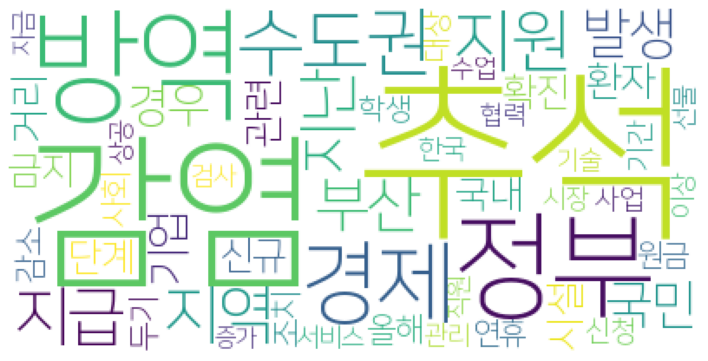

2020.09.19
['확진']
['확진']
['농장', '수확']
['시설', '고령']
['제한']
['감염', '바이러스', '이탈리아', '하루', '수가', '유럽', '증가']
['창업', '메뉴', '증가', '가맹', '매출', '기준', '샐러드', '키친', '매장', '지원', '주문', '설명']
['구미']
[]
[]
['경주', '지역', '감염', '경주시', '확진', '판정', '사회']
['대면', '학생', '수업']
['경제', '한국', '소비']
['남북', '북한', '합의', '이행']
['합의', '남북', '북한', '이행']
['예산', '사업', '지역', '과천시', '주요', '경제']
[]
['접종', '백신', '방역', '신종플루']
[]
[]
['과목', '문제', '수험생', '시험']
['평양', '남북', '김정은', '선언', '대통령', '북한', '주년', '기념', '행사', '부부']
['항공', '베트남', '운항', '노선', '모든']
['자릿수']
['조선', '산업', '자재', '사업', '거제시', '해양', '대우조선', '발전', '방향', '모색', '변광용', '김정호', '송영길', '세미나', '거제', '대한민국']
['경제', '위문', '전달', '이웃']
['남북', '북한', '공동', '합의', '이행']
['합의', '남북', '북한', '공동', '이행']
['접종', '백신', '방역', '신종플루']
['방문', '방역', '모임', '추석']
['수업', '학생', '대면', '일부', '캠퍼스', '학교']
['감염', '발생', '사례', '확인', '관련', '추가']
['감염', '발생', '사례', '확인', '관련', '추가']
['박물관', '방역']
['전국', '이번', '슈퍼', '참여', '행사', '기부', '추석', '일전', '나들가게', '동네']
['운전자', '일제', '단속', '음주운전', '음주']
['벨기에

['고양시']
[]
['감염', '사례', '의심', '판정', '바이러스', '그룹']
['판정', '파주시']
['용인시']
['확진', '택시', '방역', '환자', '감염', '지난', '대구', '기사', '증상', '검사']
['관내']
['관내']
['전날']
['쿠팡', '캠프']
['인도']
['고창', '낙찰', '멜론', '경매', '고창군', '농가', '농산물']
['병원', '치료']
['양성', '감염', '사례', '판정', '환자', '의심', '처음', '조사', '유전자형']
['감염', '처음', '의심', '사례', '판정', '환자', '조사', '양성', '유전자형']
['인도']
['관련', '설명', '방문', '감염', '전파', '판매', '각종', '사례', '이후', '집단']
['경로', '감염', '사례', '신규', '발생', '이상']
['악성코드', '메일', '파일', '유포', '실행', '에이전트', '악성', '정보', '파워포인트', '첨부', '확인', '사용자', '내용']
['감염']
['수도권', '감염', '관련', '연합뉴스']
['드론', '음식', '배달', '세종']
['부장', '접종', '수도권', '방역', '부본']
['수도권', '접종', '방역', '부본', '부장', '발생']
['접종', '수도권', '방역']
['사례', '감염', '의심', '판정', '경제', '국내']
['국민', '청원', '추돌사고', '사고', '운전자', '포르쉐', '발생', '부산', '당시', '상태']
['산소', '인도', '신규', '누적']
['행사', '드론', '배달', '음식', '실증']
['드론', '배송', '실증', '배달', '시연', '국토부', '세종', '대의', '활용']
['드론', '시험', '배송', '세종', '공원', '배달', '실증', '호수', '음식', '거리', '부산', '활용', '대의']
['상공', '유예', '납부', 

['감염', '사례']
[]
['추모', '공원', '부산', '영락', '경제', '봉안', '시설', '부산시', '봉안당', '홈페이지', '온라인']
['이후', '감염', '경로', '조사', '최근', '주간', '증가']
['유엔', '미국', '대통령', '남북', '평화', '한반도', '평양', '북미', '남북관계', '정상회담', '총회', '전쟁', '선언', '남북정상회담', '대화', '메시지', '다시', '연설', '북한', '당시', '공동', '대북', '협력', '진전', '위해', '진행', '지난', '제안', '주년', '역사']
['포르쉐', '추돌사고', '청원', '사고']
['채용', '의정부', '을지대', '병원', '직원', '지원']
['감염', '경로', '방역']
['감염', '경로', '방역']
['감염', '관련', '신규', '어제', '모두']
['접종']
['집회', '영업', '업주', '코인', '국회', '노래', '연습장', '대책', '재개']
['괴산', '충북', '증평', '교육지원청', '친절', '공무원']
['감염', '사례', '집단']
['부산', '환자', '부산시', '검사', '캠퍼스']
['부산', '환자', '부산시', '검사', '캠퍼스']
['판정', '최근', '감염', '지역', '학생', '경주', '학교', '발생', '집단', '경주시', '학년']
['벤츠', '변경', '국내', '시스템', '수입', '판매', '브랜드', '모델', '클래스', '차량', '액티브', '보조', '드라이빙', '코리아', '때문', '디자인', '세계', '지난해', '시장', '자리', '대수', '다음', '전체', '출시', '세대', '주행', '기능']
['재활용품', '처리', '대책', '화재', '수거', '수원시', '자원', '마련', '발생', '임시']
['관련', '감염', '추가', '발생', '집회', '이후', '조사', '명의',

['평가', '장성군', '우수', '점수']
['이름', '수기', '명부', '출입', '작성', '개인정보', '경제', '경우', '코드', '아시아', '전자']
['만화', '축제', '온라인', '행사', '부천', '이번', '진행', '콘서트']
['군사', '조항', '취재', '군사분계선', '남북', '합의', '금지', '이행', '공동', '국방부', '평양', '문재인', '지난', '활동', '당국', '석주', '선언']
['마라톤', '완주', '코스', '달리', '건강', '위해', '버킷리스트', '운동', '달리기', '사랑', '체력']
['공주', '벨기에', '엘리자베스', '왕위']
['회장', '면세점', '기부', '창업', '현대차', '추석', '미국', '지난', '상공', '공인', '전지', '화웨이', '기업', '올해', '지급', '반도체', '수소', '상여금', '스마트폰', '업체', '지난해', '사업', '그룹', '기술', '이상', '세계', '수출', '시스템', '이번', '연료', '연합', '소상']
['지적', '손실', '지역화폐', '지역', '사용', '소비', '경제', '지자체', '보고서', '지사', '업종', '효과', '지출', '정책', '국민', '상공']
['여성']
['학생', '경주', '판정', '학년']
['예배', '교회', '미만', '수도권']
['추석']
['빌보드', '청년', '방탄소년단', '멤버', '경향신문', '시작']
['코이카', '인지도', '국민', '기관', '한국', '대해', '위해']
['상생', '위해', '명절', '지급', '협력', '대금', '삼성', '추석', '참여', '조기', '그룹', '납품', '백화점', '경제', '확산', '사의', '자금', '장터', '지난', '중소', '온라인', '현대']
['투표', '사람', '보도', '우편', '현장', '선거', '대통령', '미네소타', '

['추석', '연합뉴스', '휴게소', '연휴', '사람', '이동', '고속도로']
['국감', '노조', '안위', '도청', '공무원']
['추석']
['추석']
['수술', '원숭이', '중성', '먹이', '태국', '마리', '진행', '도시']
['소하리', '공장', '발생', '직원', '용인']
['평양', '선언', '매체', '보도', '조선', '북한', '공동', '주년', '관련']
['울산']
['보령시', '보령']
['수도권', '발생', '누적', '지역', '전날', '신규', '기준', '경기']
['갯벌', '공연', '생명', '새만금', '화가', '세계']
[]
['관련', '지역', '감염', '대전', '발생', '확산', '경제']
['구름다리', '시민단체', '설치', '다리', '대구시', '사업', '계획', '팔공산', '반발', '관광', '반대', '관광객']
['업무', '대행', '기사', '업체', '감염', '심부름', '고객', '주문', '우려', '사람']
['게임', '콘솔', '발표', '엑스박스']
['비용', '격리', '서울시', '치료', '교회', '사랑', '손실', '금액', '생활', '자가', '전액', '부담', '운영', '발생', '센터']
['명대', '경기', '수도권', '발생', '지역', '신규', '자릿수', '지난', '사망자', '환자', '전날', '국내']
[]
[]
['대한', '재단', '사업', '예술인', '예술', '문화재단', '지원', '대구', '지역', '이번']
[]
['청년', '기념', '위해', '유공', '대통령', '정부', '참석', '대한민국', '대표']
['시민', '취소', '결정']
['신도시', '타운', '물량', '위해', '결혼', '이상', '민영', '신혼', '공급', '마련', '때문', '청약', '분양', '희망', '기회', '대출', '최근', '합리', '관심', '당첨', '주택',

['반려동물', '추석', '음식', '이용']
['가구', '건설', '순위', '지구', '호반', '단지', '대전', '써밋', '예정', '블록', '유성', '그랜드', '파크', '당첨', '상승', '공원', '가장', '분양']
['감염']
['열병', '광장', '평양', '북한', '김일성', '위성사진', '지난', '미국']
['피해', '복구', '경제', '대회']
['단속', '음주운전', '운전자', '음주', '적발', '일제']
['북한', '평양', '평화', '합의', '선언', '우리', '지난', '미국', '남북관계', '군사', '비핵화', '철수', '조치', '남북', '공동', '긴장', '위해', '대화', '한반도', '평가', '구체', '북미', '내용', '의미', '사실', '상황', '이행', '정상', '전략', '판문점']
['현장', '수업', '연수', '교육', '교직원', '직무', '참여', '교육청', '기관', '직속']
['상암동', '경제', '지역', '맛집', '산업', '진흥', '가이드북', '거슐랭', '시가지', '제작']
['청년', '행사', '위해']
[]
[]
['산사', '추출', '우울증', '식품', '기능', '스트레스', '코르', '코스', '테론', '소재', '결과', '연구']
['대구', '지원']
['백신', '트럼프', '생산', '우리', '드라이', '아이스']
[]
['인천', '엄마', '미추홀', '형제', '화상', '상태', '치료', '동생', '경찰', '호흡']
['지난']
['평양', '청와대', '예정', '청년', '대통령', '기념', '정부', '행사', '대한민국', '남북', '평화', '역사', '기본', '위해', '연설', '정책']
['청년']
['백신', '트럼프', '대통령']
['서울시', '교회', '사랑', '발생', '감염']
['장관', '경제', '양성', '판정']
['총리', '의원',

['서울시', '교회', '사랑', '소송', '전광훈', '목사']
['거리', '사람', '두기']
[]
['시장', '물류', '수요']
['백신', '대통령', '트럼프', '개발', '미국', '내년', '확보']
[]
['감염', '방역', '지난', '확진']
['복지관', '어르신', '디지털', '코드', '기기', '교육', '활용', '고령', '사회', '프로그램', '온라인', '스마트폰']
[]
['디지털', '코드', '기기', '복지관', '교육', '활용', '고령', '어르신', '온라인', '사회', '프로그램', '스마트폰']
['이익', '전자', '실적', '전망', '영업', '반도체', '주가', '증가', '증권']
['시약', '항체', '진단', '검사', '키트', '감염', '유전자', '여부', '바이러스', '민감', '정부', '방식', '결과', '방역', '국민', '사용', '질병', '항원', '본부장', '때문', '경우']
['국민', '민감', '진단', '검사', '시약', '항체', '키트', '감염', '항원', '방식', '유전자', '본부장', '여부', '때문', '방역', '정부', '경우', '결과', '사용', '바이러스', '질병']
['수도권', '감염', '상황', '방역']
['운항', '러시아', '재개']
['택배', '분류', '작업', '기사', '계약서']
['교과서', '디지털', '교사', '수업', '교육부', '개발']
['증인', '진행', '국감', '국회', '의원', '올해', '비대', '질의', '국정감사']
['브라질', '세금', '개혁', '사회', '정부', '지난', '경제', '기업']
['회의', '문화', '개최']
['취약', '계층', '지원', '대표']
['올해', '구매', '소비자', '추석', '선물', '식품', '과일', '가족', '응답', '온라인', '조리']
['정부', '대출']
['비대', '소개팅',

['경제', '성장', '전망', '기업', '결제', '디지털', '매출', '올해']
['비결', '소스', '계단', '다이어트', '홍지민', '박시은', '최완', '유지', '감량', '칼로리', '운동', '공복', '체중', '증가', '콩나물', '짜장면', '공개', '배우', '설명', '정도', '모델', '몸매', '한혜진']
['사업', '사태', '입찰', '롯데', '면세점', '인천공항', '매출', '상황', '영업', '신청', '국내', '유찰', '다른', '관계자', '조건', '전망', '면세', '신라', '참여', '업계', '지난', '임대료', '신세계', '운영']
['봉사', '무료', '사람', '식당', '사랑', '치과', '운영', '생명', '정도', '원장', '의료', '국민일보']
['개인', '대비', '증시', '지난', '투자자', '투자', '월간', '한국', '코스피', '주식', '코스닥', '수익', '이후']
['추석', '감염', '방역']
['프랑스']
['결제', '혜택', '할인', '최대', '온라인', '추석', '카드', '쇼핑몰', '진행', '이벤트', '마켓']
['백신', '트럼프', '대통령', '개발']
['과로', '사망', '과로사', '택배', '정부', '노동', '산업', '상반기', '관련']
['기업', '정보', '통신', '업무', '회사', '국내', '글로벌', '해커', '물리', '확산', '전자', '근무', '집계', '해킹', '시장', '사이버', '사태', '때문', '평균', '최근', '피해', '온라인', '재택근무', '데이터', '정보보호', '정보보안', '미국', '관리', '시스템', '개인', '업체', '트위터', '한국', '지난달', '사용', '수준', '프로그램', '보안', '대기업', '사업', '업계', '공격', '정도', '기술', '솔루션', '접속', '계정', '취약', '산업', '지

['방역', '두기', '이번', '수도권', '신규', '환자', '감염', '중앙', '단계', '일일', '거리', '경로', '당국', '정점']
['사회', '감염']
['경제', '정신건강', '증상', '재난', '업무']
['의원', '대표', '김홍걸', '민주당', '제명', '중앙', '최고', '김한정', '현장', '국회', '위원', '결정', '관련', '아들']
['수배', '분량', '독감', '택배', '백신', '국민', '적색', '정부', '무료', '인터폴', '분류', '의료', '접종', '주장', '윤씨', '작업', '기사', '예방접종']
['대출', '신용', '증가', '금융', '은행', '시작', '가계', '당국', '시중', '집계', '대비', '생활', '담대', '비율', '규제', '소득', '담보']
['북한', '열병', '발사', '준비', '지난', '로이터', '위성사진', '시험', '신포', '조선소']
[]
['집회', '금지', '이하', '방역', '대해', '신고', '강행', '불법']
['추석', '리조트', '연휴', '이상', '기간', '방역', '확산', '고향', '방문', '응답', '계획']
['보수', '한국', '집회', '극우', '우파', '극단', '주의', '세력', '주의자', '공동체', '극우파', '인종', '정치']
['중국', '대사', '브랜스태드', '트럼프', '관계', '대통령', '체제', '주장']
['수출', '감소', '강원', '강원도']
['수출', '감소', '강원', '강원도']
['통일전망대', '관광객', '다시']
['대출', '주택', '집주인']
['이탈리아', '경기', '스포츠', '관중']
['위원장', '국민']
['방역', '불교', '대통령', '적폐', '청산']
['기증', '판매', '명사']
['학생', '교육', '때문', '과거', '선택', '성적', '레벨', '점수', '영국', '

['의원', '장관', '질문', '육아', '관련', '국민', '휴직', '통일', '한국']
['개발', '후보', '배양', '통해', '공기', '대상포진', '진단', '국내', '모발', '특허', '제품', '기술', '에이', '네스', '효과', '확인', '고혈압', '시험', '물질', '회사', '임상시험', '탈모', '결과', '제로', '크론병', '휴대', '계획', '항체', '확보', '테라', '대상', '방식', '아이', '치료', '세포', '환자', '계약', '기업', '약물', '사이언스', '사업', '대한', '바이오', '신약', '미국', '허가', '모델', '셀트리온', '제출', '글로벌', '승인', '취득', '유두', '제약', '백신', '한국', '차세대', '피부', '이번', '질환', '현지', '기관', '측은']
['아이유', '유희열', '데뷔', '주년', '콘서트', '스케치북', '공연', '마음', '무대']
['어르신', '동작구', '편의점', '일자리', '회사', '지원', '행복주식회사', '학습']
[]
['국내', '증시', '미국', '기술', '대형', '포인트', '상승', '지난', '추가', '연구원', '추경안', '다음', '협상', '증권', '분석', '투자']
['고속', '산천', '정비', '열차', '바퀴', '운행', '정비단', '작업', '수도권', '확보', '차량', '편성', '부품']
['공장']
['경주', '판정', '학생', '지역', '지난', '발생', '학년', '경주시', '학교']
['지역', '감염', '누적', '수도권', '발생', '경기']
['정부', '오늘', '서로', '시대', '세대', '다시', '기성세대', '우리', '사회', '추진', '불공정', '여러분', '문제', '정책', '공정', '국민', '운동장', '위해', '청년', '기회', '지원', '푸른', '도전', '제정', '

['노동자', '인력', '과로사', '터미널', '주장', '택배', '분류', '작업', '배송', '대한', '기사', '회사', '물량', '투입', '계획']
['투쟁', '집행', '하반기', '대해', '노총', '민주', '대위', '사회', '의문', '경제', '조직', '대화', '평가', '문건', '교섭', '제기', '추인', '지적', '중앙', '문제', '위원장', '계속', '대한']
['인도', '애플', '온라인', '매장', '고객']
['해외']
['기록', '명대', '지역', '연속']
['감염', '연속', '발생', '지역', '명대', '전날', '자릿수', '수도권', '누적', '신규', '기록', '경기']
['신규', '자릿수', '명대']
[]
['건강', '집콕', '시민', '레시피']
['강조', '대남', '평화', '북한', '남북', '주년', '합의', '평양', '공동', '선언', '이행', '다시', '우리', '대화']
['감염', '확진', '신규', '판정', '관련', '발생', '수원', '사례', '전날', '대전', '증가', '추가', '누적', '지역', '가족', '명의', '집단', '격리', '접촉', '부산', '기준', '기존', '교회', '기록']
['봉쇄', '영국', '라며', '확산', '검토', '정부', '국가', '조치']
['가정', '제한', '복지부', '어린이집', '긴급', '보육', '등원', '단계', '학부모', '거리', '두기', '조치', '수도권', '사회', '이용']
[]
['저희', '노력', '시작', '시대', '일곱', '모습', '준비', '우리', '지금', '사회자', '세계', '사랑', '자신', '여러분', '마음', '대한민국', '서로', '데뷔', '스스로', '경제', '멤버', '오늘', '도전', '모두', '세대', '교육', '정책', '공정', '이제', '추진', '방탄소년단', '문제'

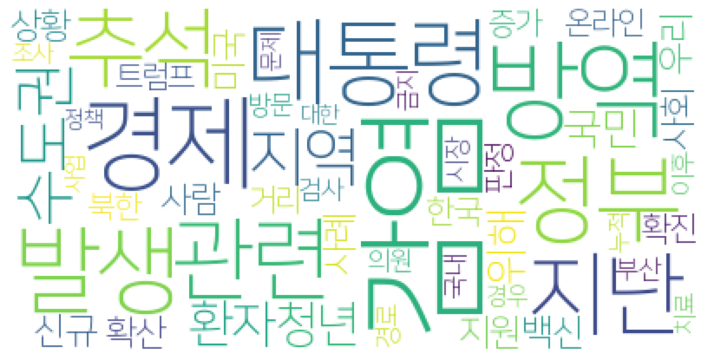

2020.09.18
[]
[]
['방역', '감염', '강남구', '세계', '누적', '격리', '경제', '주민', '이후', '보건소', '의료', '자가', '결과', '증상', '접촉', '검사']
['세계', '결과', '방역', '감염', '강남구', '누적', '격리', '증상', '접촉', '검사', '주민', '경제', '이후', '의료', '자가', '보건소']
['포르쉐', '운전자', '사고', '오토바이']
['불교', '대통령', '평화', '국민', '스님']
['집단', '감염', '공간', '입소', '요양', '시설', '박애', '코호트']
['사고', '운전자']
['교과서', '디지털', '교사', '교육부', '개발', '수업', '교육']
['언어', '표현', '전달', '사용']
['표현', '언어', '전달', '사용']
[]
['헌혈', '감염', '혈액', '거리', '두기']
['일본', '의원']
['전주']
['인천', '경제', '확진']
['제주', '동선', '제주도', '확인']
['호텔', '정장', '백화점', '도시락']
['총리']
[]
['헬스장', '회원', '폐업', '대표', '모집', '음성', '변조', '직원']
['사업', '대전', '계약', '해지']
['단체']
['단체']
['사고', '오토바이', '포르쉐', '운전자']
['이스라엘', '봉쇄', '전국']
['동생', '청원', '포르쉐', '운전자', '누나', '사고']
['투기', '불법', '쓰레기', '처리', '업체']
['환자']
['카스', '텍스', '총리']
[]
['자민당', '노컷뉴스', '일본', '다카', '토리', '의원', '참석']
['봉쇄', '이스라엘']
['사망자']
['카스', '텍스', '총리']
[]
['택배', '작업', '분류', '기사', '계약서']
['대통령', '불교', '적폐', '청산', '통합']
['요양보호사', '충북', '확진', '요양원', '판정',

['부부', '경찰', '보건소', '조사', '지난달', '직원', '방해', '검사']
['달러', '위안화', '환율']
['새마을', '행사', '재활용품', '청도', '대회']
['결혼식', '관련']
['마스크']
['시설', '원금', '전달', '후원', '봉사활동']
['수도권', '환자', '거리', '두기']
['시장', '대표', '추석']
['바이오', '에이', '비엘']
['교수', '경우', '자외선', '노출', '선글라스', '구름', '사람', '수정체', '각막염', '가을', '햇빛', '때문', '백내장', '황반변성', '건강']
['통신비', '위원회', '의원', '국민', '예산', '국회', '지원', '부총리', '특별', '부산', '결산', '지급', '전체', '지적', '통신사', '회의']
['아이']
['중국', '몰디브', '프로젝트', '차관', '달러', '거액', '대형', '상환', '말레', '스리랑카']
['환자', '폐렴', '대구', '감염', '입원', '증상', '발전', '구진']
['환자', '폐렴', '대구', '감염', '입원', '증상', '발전', '구진']
['국가', '모글', '교수', '자동화', '세계', '민주주의', '이후', '생산', '정부', '점점', '소득']
['세계', '마윈', '교육', '창업', '디지털', '강조', '모든', '사람']
['휴게소', '고객', '추석', '명절', '운영']
['불교', '대통령', '통합', '방역']
[]
[]
['복지관', '울산']
['기아차', '유럽', '판매', '점유', '지난달', '현대차', '그룹']
['태극기', '운동', '회장', '사랑', '마스크', '구리시', '지역', '센터', '나라', '대한민국']
['위해', '불교', '대통령', '적폐', '청산', '통합', '방역']
['방역', '추석', '시설', '운영']
['부부', '검사', '보건소', '직원']

[]
['분류', '정부', '택배', '작업', '대책위', '인력', '거부', '기사', '노동자', '업계', '추석', '과로사', '투입', '대책', '조치']
['대통령', '불교', '통합', '적폐', '청산', '국민', '방역', '간담']
['보건', '승인', '진의', '팬데믹', '모두', '인력', '의료', '감염', '신청', '국내', '사회', '치료', '노동자', '보호', '간호사', '업무', '권리', '경향신문', '발생', '병원', '종사', '거부', '의사', '지적', '대한', '세계', '교수', '지난']
['여서동', '경제', '새마을']
['그룹', '직원', '지역', '호반', '사회', '건설', '피해', '활동', '전달', '지속', '협력', '공헌', '지원', '지난', '집중호우', '위해']
['대통령', '협치', '통합', '갈등', '불교']
['텔레', '협박', '그램', '아동', '피해자']
['텔레', '협박', '그램', '아동', '피해자']
[]
['쓰레기']
['올해']
['은행', '농협', '빅데이터', '교육', '과정']
['순천', '사회', '순천시', '시민', '지난달', '확산', '두기', '자발', '거리']
['자발', '순천', '순천시', '시민', '지난달', '사회', '두기', '확산', '거리']
[]
['맥주', '배달', '생활', '서비스', '매장', '치킨', '고객']
['대통령', '의원', '오늘']
['임상실험', '접종', '백신', '중국', '아이', '긴급']
[]
[]
['호흡', '형제', '치료', '화상', '상태', '인천', '경찰', '미추홀']
['바이오', '에이', '비엘', '치료', '개발', '미국']
['에이', '치료', '바이오', '비엘', '개발', '미국']
['전환', '교육', '디지털', '정보', '미래', '경제', '고속', '클라우드']
['경찰관', 

['재무', '총재', '장관', '회의', '한중일']
['검사']
['의원', '왼쪽', '민주당', '워크숍', '소주', '온라인']
['광주', '격리', '경찰청']
['택배', '올해']
['의회', '관련', '허용', '도입', '원격회', '하원', '회의', '국회', '영국', '개국', '운영']
['바이오']
['농협', '글로벌', '금융', '사업', '은행']
['체중', '응답', '다이어트', '감소', '증가', '평균', '가장', '복수']
['대표', '아이']
['확산', '지난', '감염', '방역']
['경제']
['감소', '자동차', '생산', '영향', '수출']
['감소', '자동차', '생산', '영향', '수출']
['감소', '자동차', '생산', '영향', '수출']
['항공', '업종', '업계', '할당', '무상', '지정']
['항공', '업종', '업계', '할당', '무상', '지정']
['재단', '투자']
['고창군', '사회', '나눔', '기탁']
[]
['교회', '정부', '예배', '수도권', '예배당', '미만', '방안']
['혐의', '학원', '소송', '장관', '징역', '선고', '증거', '재판', '허위', '관련']
[]
['일본', '문제', '지지율', '시도', '공격', '정권', '교체', '아베', '수출', '헌법', '경제', '정치', '개정', '노력', '우지', '대한', '평화', '비판', '안보', '건립', '사임', '시기', '도쿄', '강행', '이후', '운동', '한국', '반대', '과정', '실시', '관심', '타격', '법제', '내각', '시민', '기념비', '한국인', '전개', '개최', '모습', '수상', '조직', '지난', '작년', '센다이', '역사', '사람', '가운데', '시작', '조치', '대해', '위원회', '강연', '여론', '규제', '퇴진', '통해', '집회', '방문', '동

[]
['심리', '지원']
['연휴', '리조트', '예약', '추석', '기간', '방역', '객실', '제주도', '호텔', '골프장', '주요', '운영', '면회', '사실', '시설', '경우', '제주', '마감', '업계', '수준']
[]
['백신', '접종', '독감', '무료', '국민', '의료', '대상']
['바이오', '에이', '비엘', '개발', '미국']
['영향', '저작권', '상반기', '적자', '흑자', '수출', '감소', '지급', '대한', '재산권', '지식', '생산', '국내']
['연휴', '기간', '발생', '추석', '방역', '활동', '우려', '휴가', '감염']
['손실', '공사', '서울시', '교회', '사랑', '감소', '손해', '교통', '조사', '확산', '목사', '건강', '자치구']
['적자', '기업', '흑자', '재산권', '동기', '대비', '저작권', '국내']
['이상', '계획', '응답']
['해외', '국민', '여행', '주의보', '특별', '발령', '외교부', '단계']
['사항', '조두순', '안산', '의원', '법무부', '재범', '준수']
['적자', '지급', '상반기', '기록', '저작권', '흑자', '감소', '대기업', '국내', '별로']
['적자', '흑자', '저작권', '재산권', '지급', '수지', '상반기', '감소', '규모', '작년', '무역수지', '전자제품', '지식']
['상반기', '적자', '저작권', '흑자', '지급', '규모', '재산권', '대기업', '특허', '기업', '실용신안', '확대']
['이란']
['집회', '목사', '금지', '방역', '교회', '대통령', '문재인', '불교', '협치', '갈등', '정치', '사랑', '통합']
['백신']
['의원', '일본', '다카', '토리', '자민당', '총리']
['적자', '수지']
['일본', '총리', '판정', '자민당

['방역', '부산', '정부', '총리']
['방역', '검사', '총리']
['방역', '검사', '총리']
['발신', '서비스', '아이', '방역', '정보', '리미', '지자체', '보건소', '제공']
['미쉐린', '대리점', '코리아', '안전', '파트너', '방역', '전국']
[]
['추가']
['박사', '주장', '논문']
['자릿수', '명대']
[]
[]
[]
['명대', '자릿수']
['주니어', '청소년', '이노텍', '교실', '사회', '소나무', '프로그램', '지원', '활동']
['차박', '캠핑', '장소', '명소', '주상절리', '박지']
['해외', '감소', '전날', '지역', '발생', '기록', '신규', '기준', '국내', '유입', '자릿수', '유지']
['환자', '아시아', '경제', '증가', '국내']
['무증상', '퇴원', '신규']
[]
['발생', '감염', '신규', '관련', '국내', '시설', '경기', '확인']
['할로윈', '상품', '파티', '용품']
['오바마', '상황', '틱톡', '대통령', '미국', '의료', '매각', '감염', '가운데', '이번', '최근', '연합뉴스', '기업', '관련', '확산', '세계', '앵커', '발생', '인도', '기술', '누적', '신규', '중국', '트럼프', '협상', '오라클', '대한', '회고록', '출판', '아시아']
[]
[]
['방역', '총리']
['효과', '경우', '화이자', '백신', '승인', '중간', '분석', '미국', '사용', '제출', '이상', '초기', '초안', '효능']
['중국']
['국내']
['신규', '봉쇄', '유럽', '확산', '프랑스', '수가', '조치', '검사', '지난', '다만', '최근', '스페인']
['검사', '방역', '결과', '주장']
['대응', '경제', '보건', '장관', '회의', '국제', '백신']
['미쉐린', '코

['영국', '이번', '생각', '당시', '세계', '교수', '사회', '미국', '정부', '라며', '통해', '노동', '오마이', '위기', '지난', '경제', '주의', '사다리', '면서', '보수', '모든', '자신', '나라', '자유', '장하준', '이후', '대한', '시장', '대공황']
['기업', '참여', '분야', '민간', '뉴딜', '디지털', '협력', '회의', '계획', '사업', '투자', '관련', '국내', '대표', '적극', '정통부', '한국']
['의료']
['로스', '의료', '워드', '사무', '총장', '국가']
['행사', '판매', '고객', '할인', '스타', '필드', '남성', '브랜드', '상생', '경제']
['유럽']
['데이터', '센터', '산업', '대한', '포럼', '이해']
['광명', '공장', '직원', '중단', '가동', '기아차']
[]
['전날', '확인', '감염', '확산', '고리', '집단', '확진', '경로', '수도권', '방역', '전파']
['발생', '포항시', '방문', '시설', '지역', '명의', '집합', '추가', '대한']
['의료', '스마트', '가든', '산업', '단지', '공간', '도내', '기관', '사업']
['프랑스', '증가', '검사']
['총장', '세계', '구테흐스']
['세계', '구테흐스', '총장']
['도시', '위해', '벌초', '이동', '차량']
['파우치', '소장']
['마스크', '공원', '관료', '추석', '중소기업', '자금', '착용']
['학생', '순찰', '마스크', '캠퍼스', '학교', '대학', '직접', '고려대', '재학생']
['택배', '분류', '작업', '거부', '기사']
['틱톡', '미국', '트럼프', '대통령', '오라클', '사업', '방안', '추가', '이후', '실업', '정부', '시장', '연방', '위원회', '투자', '합의', 

['대선', '레이', '러시아', '후보', '국장', '바이든', '시도', '미국', '개입', '관련', '중국']
['마스크', '증거', '백신']
['학기', '지급', '인하공전', '장학금', '학생']
['레드', '상반기', '사회', '부회장', '분노', '우울', '상담', '블루', '건강', '폭발', '정신건강', '우울증', '심리', '불안', '감정', '사태']
['할인', '구매', '온라인', '최대', '선물', '롯데', '제공', '혜택', '카드', '추석', '여행', '이상', '세트', '주요', '올해', '고객', '상품', '이벤트', '오프라인', '쇼핑몰', '국민카드']
['양성', '판정']
['적립금', '신설', '교육', '대학', '등록금', '지원', '개정안', '재난', '정책']
['대학', '정책', '등록금', '적립금', '교육', '신설', '지원', '개정안', '재난']
['공예', '주제', '문화', '주간', '행사', '개최', '두기', '지역']
['감염', '미성년', '증상']
['바이러스', '논문', '옌리멍', '중국', '주장', '미국', '세계', '인터뷰', '교수']
['감염', '깜깜', '위험', '지난', '비율', '신규', '요인', '방역', '환자']
['기간', '방역', '시설', '연휴', '방문', '전북도', '이용']
['권력', '코드', '감시', '마스크', '우리']
['아내', '윌리엄스', '친구', '사람', '외로움']
['회사', '재택근무', '업무', '근무', '방식', '매뉴얼']
['금리', '경제', '미국', '유지', '현재', '제로', '기준금리', '정책', '회복', '포인트']
['서울시', '방역']
['중간', '시험', '진행', '백신', '부작용', '치료', '효과', '개발', '감염', '용량', '접종', '항체', '릴리', '존슨']
['지구', '가장', '방

['지원', '복지', '이하', '긴급', '기준', '재산', '완화', '위기', '시민']
['선정', '매월', '공모']
['천안']
['휴게소', '추석', '명절', '도로공사', '연휴', '기간', '고속도로', '고객', '이번', '한국']
['폭스바겐', '부가티', '매각']
['백화점', '영업', '추석', '연장', '기간', '노동자', '기자회견', '노조']
['서울시', '사랑', '교회']
[]
['발생', '관련', '누적', '감염']
['비타민', '사람']
[]
[]
[]
['최근', '북미', '대화', '대통령', '협력', '미국', '방안', '한반도', '대한', '대선', '평화', '남북관계', '남북']
['일양약품', '러시아', '슈펙트', '공장', '경제', '생산', '실사']
[]
['시설']
['감소', '판매', '자동차', '수출', '지난달']
['신규', '확인']
['방문', '추석', '고향', '회원', '자제', '이동']
['추석', '고향', '회원', '방문', '자제', '이동']
['명대', '자릿수']
['증가', '석유화학', '화학', '가격', '수요', '플라스틱', '사용', '포장', '제품', '경제', '업계', '일회용', '사태', '상승']
['서울시', '사랑', '교회', '손해', '전광훈', '목사', '확산', '청구', '손해배상', '책임', '시민']
['인천', '중국', '전세기']
['신청', '보석', '목사', '위반', '재판', '집회', '조건', '지난', '취소', '법원']
['파트너', '롯데', '건설', '동반성']
['손해', '손해배상', '사랑', '교회', '전광훈', '목사']
['증권', '분류', '투입', '연구원', '택배', '통운', '증가', '투자', '추석', '작업', '업계', '인력', '배송', '실적', '이익', '네이버', '급증', '정부', '종사', '사업', '

['결과', '비타민', '사람', '연구', '면역']
['비타민', '사람', '결과', '연구', '면역']
['수가', '검사', '정부', '진단', '총리']
['스타', '행사', '고객', '할인', '필드', '남성', '브랜드', '상생', '판매']
[]
[]
[]
[]
['상가', '부동산', '분양', '투자자', '업무', '거래', '규제', '주택']
['여행', '특별', '주의보', '국민']
['센터', '물품', '기부', '자원봉사']
['물품', '기부', '자원봉사', '센터']
['증가', '수출', '광주', '감소', '지역', '전남']
['인도', '확산', '경제', '전망', '더욱', '아시아', '악화']
[]
['인류', '위해', '연대', '해결', '마윈', '위기', '세계', '총장', '생각', '포럼', '면서', '글로벌', '우리']
['상담', '관련', '예식', '서비스', '호텔', '펜션', '소비자', '가장', '부산']
['사회', '동서식품', '봉사활동', '맥심']
['여행', '특별', '주의보', '발령', '우리', '국민', '단계']
['혐의', '학원', '장관', '조씨']
['식량', '북한', '보고서', '태풍']
['방역', '휴게소', '케어', '마일', '게이트', '이용', '설치', '수출']
['감염', '지역', '수도권', '신규', '자릿수', '명대', '충남', '경기', '발생', '누적']
['누적', '신규', '지역', '경기']
[]
['식량', '북한', '나라', '태풍']
['배달', '계절', '밥상']
['감소', '투자', '해외', '대비']
['노컷뉴스', '해외', '달러', '감소', '투자', '직접투자']
['광주', '지역', '감염']
['백신', '치료', '개발', '지난']
['결과', '피로']
['해외여행']
['명의', '경로', '양성', '여성', '확진', '수도권', '전날',

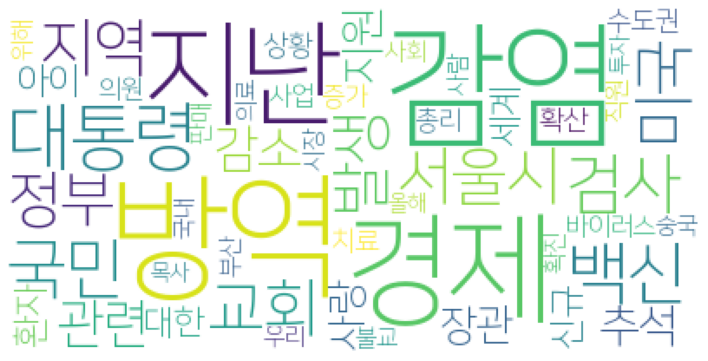

2020.09.17
[]
['일본']
['공연', '문화', '자체', '기획', '때문']
['제주', '입도', '오후']
['제주', '입도', '오후']
['셀트리온', '계획', '치료', '임상시험', '항체', '국내']
['대전']
['헌혈', '혈액', '시작', '참가자']
['판정']
['알로', '경향신문']
['판정']
['판정']
['전주시', '사회', '거리', '두기', '의회']
['충북도', '검사']
['백신']
['국내', '셀트리온', '임상시험', '대상', '계획', '노컷뉴스', '환자']
['이가혁', '미국', '팩트', '앵커', '옌리멍', '폭스뉴스', '체크', '인공', '우리', '주장', '국내', '평가']
['화제', '편지', '고향', '자녀', '마음']
[]
[]
['시장', '전통', '온라인', '연합뉴스']
['환자', '감염', '일본', '도쿄도']
['터미널', '부산', '통영', '감염', '지역', '확인', '입국', '검사', '병원']
['방역', '부산', '어촌', '센터', '마을', '봉사활동', '지원']
['여성', '노동', '휴가', '성노동자', '응답']
['노동', '여성', '휴가', '성노동자', '응답']
['방문', '군수', '남해', '고향', '자제', '방역', '군민', '지역', '청정']
['결과', '논의', '수치', '릴리', '치료', '일라이', '환자', '긴급', '사용승인', '바이오', '항체', '미국', '추리', '위약', '투약', '효과', '대한', '용량', '임상시험', '생산', '이번', '바이러스', '지난', '입원', '기업']
['약사', '백신', '미국', '임상시험', '부작용', '시험']
['결과', '수업', '응답', '학생', '온라인', '교수', '효과', '실험', '만족도']
['대상', '환자', '셀트리온', '치료', '임상시험', '승인', '진행']
['보고서

[]
['결과', '차장', '병원', '검사']
['건설업', '캠코', '건설', '개발', '간담', '방안']
['차장', '병원', '검사', '확인']
['추석', '위해']
['추석', '위해']
['공부', '관련', '도서']
['환자', '계획', '셀트리온', '임상시험', '국내', '대상']
['솔리티', '도어', '예방', '항균', '필름', '캠페인', '도어락', '사용', '국민']
['셀트리온', '치료', '임상시험', '승인']
['간호사', '병원']
['단계', '방역']
['심리', '지원', '시민', '광명시', '치료', '정신건강', '방역', '센터', '원단', '마음', '복지']
['국내', '대상', '임상시험', '셀트리온', '환자', '계획', '승인', '진행']
['충북']
['방역', '추석', '이동', '연휴', '정은경', '청장', '고향', '자제']
['식약처', '셀트리온', '임상시험', '대상', '환자', '국내', '승인', '계획']
['환자', '대상', '셀트리온', '임상시험', '치료', '승인', '계획']
['주장', '바이러스', '옌리멍', '박사', '논문', '인위', '조작', '부위', '경향신문', '근거', '퓨린', '증거', '트위터', '제시', '대해', '일치', '정보', '다른', '박쥐', '단백질', '자연', '구진', '발견']
['대상', '환자', '임상시험', '셀트리온', '국내', '계획', '진행']
['치료', '임상시험', '승인', '항체', '식약처', '대상', '안전성', '투여']
['백신', '미국', '트럼프', '대통령', '필드', '레드', '국장']
['미국', '자가진단', '키트', '검사', '여부', '국민', '방역', '감염', '결과']
['생활', '치료', '시설']
['방문', '방역', '시설', '전북', '운영']
['셀트리온', '대상', '임상시험', '계획', '

['의료', '전면', '병원', '간호사', '수업', '대학', '비대']
['판정', '감염', '대회', '경기', '심사', '위원', '종목', '접촉', '검사', '보건', '당국']
['전달']
['대책', '경제', '추석', '확산', '지역', '명절', '군민', '방역', '운영', '연휴']
['수업', '개교', '학교', '등교']
[]
['학교', '수업', '등교', '개교']
['간호사', '병원', '부산', '의료']
['투자', '대체', '위원', '이데일리', '해외', '부동산', '글로벌', '투자가', '기관']
['수업', '학생', '학교', '확진', '등교', '개교', '판정']
['지원']
['울산']
['비행', '항공', '여행', '콴타스', '항공사', '호주', '공항', '항공권', '상품', '대만']
['소하리', '공장', '중단', '가동', '생산', '기아차']
['마스크', '청장', '착용', '감염', '상황']
['공인', '소상', '지원']
[]
['부산', '환자']
['현장', '방사선', '지원', '분야', '기술', '이사장', '중소', '벤처기업']
['처리', '폐기물', '업체', '불법']
['편지', '우편함', '사연', '답장', '봉사자']
['안경', '콘택트렌즈', '수입', '국내', '감소', '산업', '렌즈', '가정', '사용', '브랜드', '한국', '시장']
['라다', '대성전', '완공', '건축', '성당', '위원회', '첨탑']
['직원', '금융', '재택근무', '접속', '분리', '규제']
[]
['관광', '관광업']
['관광', '관광업']
['심리', '거리', '소방', '지원', '심리상담', '현장', '스트레스', '현재', '공무원', '상황', '격리', '환자', '관리']
['금융', '재택근무', '허용', '접속', '분리', '업무', '직원', '제도', '위해', '보안']
['고향

['수업', '우리', '멕시코', '전화', '지난', '상황', '보고', '방문', '생각', '기술자', '회의', '시간', '접수', '작업', '일단', '다음', '오지', '통사정', '당신', '코로나바이러스', '디네', '각자', '과제', '다시', '오후', '개인', '조언', '설명', '다른', '인터넷', '신호', '시작', '온라인', '마음', '걱정', '당장', '기사', '정도', '역시', '그간', '정치인', '학사', '학생', '문제', '가장', '지역', '수리', '사정', '해결', '집의', '전화국', '학교', '동료', '어쩌면', '사실', '동안', '마을', '수도', '통해', '이후', '번개', '서비스', '고장', '지금', '사람', '우기']
['택시', '지원', '재단', '자녀', '금융', '그룹']
['디지털', '금융', '우리금융', '교육', '인력', '전략', '제휴', '협력']
['과목', '학습', '수업', '초등', '와이즈캠프', '제공', '학부모']
['환자', '당뇨', '바이러스', '박테리아', '비만', '세포', '염증', '존재', '사람', '구진', '하나', '중증', '증상', '체내', '원인']
['위해', '공단', '체육']
['브라질', '의장', '마이아', '판정', '연방', '대법원', '대통령', '양성']
['불교', '지도자']
['체험', '축제', '이성산성', '하남', '문화', '시민', '가족', '참여', '복원']
['백신', '중국', '최초', '공개', '개발']
['교수', '페이스북', '가짜', '주장', '바이러스', '트위터', '계정', '기사', '정지', '관련', '우한', '정보', '논문']
['주장', '바이러스', '교수', '트위터', '계정', '페이스북', '우한', '정지', '기사', '논문', '가짜', '관련', '정보']
['공원', '추모', '온라

['진단']
[]
['스웨덴', '상황', '유럽', '지난', '누적', '확산', '시도', '신규', '인구', '면역', '사망자', '집단']
[]
['해외']
[]
['연구', '학회', '교수', '환자', '의과대학']
[]
['경향신문', '접촉']
['국내', '환자', '해외', '경제']
['공장', '소하리']
['신규', '사망자']
['명대', '환자', '신규', '지역']
[]
[]
['진단']
['교회', '집회', '개천절']
['전북', '접촉']
[]
['박사', '바이러스', '트위터', '계정', '중국', '경고', '주장']
['결혼', '상담', '업소']
['로컬', '푸드', '매장']
[]
['마스크', '설명', '착용', '강의', '다과회']
[]
[]
[]
['환자']
['신규', '누적', '인도', '하루', '미국']
[]
[]
['아이', '항체', '미국']
[]
['동시', '진단', '인플루엔자', '키트', '바이오', '니아']
[]
['바이오', '진단', '독감', '니아', '동시', '검사']
['신규']
[]
['신규']
['신규']
[]
['트위터']
[]
['소비', '지원', '고용', '경제', '부산', '대응', '구조', '수출', '제조업', '분석']
['접촉']
['신규']
[]
['신규']
[]
[]
['접촉']
['접촉']
['업체', '배달', '평균', '공원', '매출', '매장', '여의도', '추정']
[]
['직원', '기아차', '공장', '소하리', '용인', '확진']
['인도', '세계']
['신규', '국내']
['누적']
['누적']
['박사', '트위터', '바이러스', '연구소', '계정', '트윗', '논문']
['면접', '학생', '수능', '지원']
['중국']
[]
['퇴원']
[]
['국내', '신규']
['환자']
[]
['소하리', '공장', '직원']
['광주', '전남', '추가']
[]
[]
['경향신문']
['

['정부', '장관', '질문']
['부담', '서비스', '통신비', '데이터', '가계', '증가', '지출', '소비', '통신', '무선', '영향', '지원', '동향', '매출', '식료품', '통계청', '국민', '사용', '평균', '차지', '대비', '비중', '물가']
['판매', '불황', '상반기', '복권', '연금복권', '당첨', '경기', '증가', '기준']
['척추관', '증상', '협착증', '허리', '질환', '치료']
[]
[]
['일자리', '사업', '달서구', '희망']
['집회', '추석', '명절', '차례', '매일신문']
['매일신문']
['의장', '마이아']
['바이러스']
['옌리멍', '미국', '단체', '바이러스', '주장', '박사']
['대통령', '메이', '한국', '총리', '영국', '연합뉴스']
['택배', '노동자', '배송', '분류', '고영준']
['대표', '미국', '성장', '헤지펀드', '재무', '사모펀드', '부동산', '세션', '시장', '환경', '이데일리', '국내', '전략', '대체', '글로벌', '투자', '금융', '분야', '해법', '이후', '운용', '자산', '사태', '전문가', '진행', '공동', '경제', '기회', '변화', '위험', '부문', '흐름', '시대', '관리', '불확실', '통해', '각종', '위기', '교수', '접목', '장관', '강연', '주제', '참여']
['동향', '보증', '신용', '위험', '지수', '올해', '재단', '지난해', '수요', '소상', '크게', '급등', '지역', '상공', '공인']
['보증', '지난해', '급등', '신용', '위험', '지수', '올해', '재단', '수요', '지역', '소상', '크게', '공인', '동향', '상공']
['백신', '임상시험', '옥스퍼드대']
['선언', '취재', '남북', '장관', '판문점', '공동', '합의', '주

['식음', '업체', '홈플러스', '입점', '매출', '홈슐랭', '클럽']
['구매', '단체', '중국', '전자상거래', '공동체', '스후이퇀', '지역', '고객', '식품']
['기아차', '공장', '소하리', '생산']
[]
[]
['업체', '결혼', '상담', '추가']
['결혼', '상담', '업체', '추가']
['판정', '직원', '접촉', '방송', '이티', '비시', '확진', '조치']
['무단', '경찰청', '부산', '시설']
[]
['물가', '브라질', '기준금리', '중앙은행', '동결', '승률']
['의료', '청원', '검사', '의료인', '임상병리사', '기사', '채취', '환자', '수당', '현장', '간호사', '지급', '검체', '대응', '형평성']
[]
['서울시', '총리']
['공원', '하늘', '축제', '서울시']
['임도', '개방', '취소']
['메이', '총리']
['총리', '서울시', '메이', '영국', '방역']
['공원', '하늘', '위해', '축제']
['총리', '서울시', '영국', '방역', '메이']
['뉴질랜드', '기록']
['검사']
[]
['발생', '퇴원', '제주도', '입원']
['현지', '우리', '최근', '확산', '사업', '감염', '국민', '직원', '기업']
[]
['검사', '서울시', '선제', '감염', '지난', '반시민', '집단']
['안경', '감염', '착용', '사람']
['착용', '독감', '질환', '증상', '예방접종', '경우', '유행', '접종', '치료', '다른', '이상', '감염', '백신', '올해', '마스크', '기침', '호흡기', '환자']
['마스크', '스트랩', '시간', '생활', '패션']
['확진', '대회', '전북', '경기', '심사', '위원', '판정', '진행', '검사']
[]
[]
['지역', '문화재단', '예술', '문화', '토론회', '정책', '과제

['수출', '부산', '지역', '감소', '수입']
['수출', '부산', '감소']
['검사', '긴급', '승인', '민감', '사용', '진단', '키트', '항체', '질병', '의원', '경우', '미국', '품목', '특이', '정확도', '무증상', '방식', '국내', '항원']
['부산']
['지난', '자릿수', '신규', '수도권', '누적', '전날', '발생', '경기', '감염', '증가', '지역', '유입', '해외', '다시']
['우리', '전세버스', '집회', '확산', '전국']
['금융', '원단', '운영', '안정', '사태', '경제', '정책', '지원', '상황']
['심근', '심장', '연구', '오하이오', '확진', '증세', '선수', '대학', '운동선수', '미국', '사이', '염증', '경기', '진단', '위험', '가운데', '검사', '협회', '한국', '결과', '논문', '감염', '주립대', '과학', '스포츠']
['관리', '부산', '건강', '키트']
['해수부', '사례', '우수']
['경남']
['논문', '바이러스', '박사', '중국', '인위', '증거', '주장', '동료', '코로나바이러스', '폭로', '게놈', '연구소', '서열', '부위']
['유지', '사망자', '증가', '환자', '위중', '기록']
['신규', '지역', '전날', '수도권', '다시', '지난', '발생', '자릿수']
['영국', '누적']
['울산']
['주장', '논문', '바이러스', '부위']
['검사', '학교']
['국회', '유통', '규제', '전통', '산업', '개정안', '처리', '지정', '대형', '마트', '제도']
[]
['정부', '질문', '장관', '분야']
['일본', '공연', '문화', '자체', '기획', '때문', '제주', '입도', '오후', '제주', '입도', '오후', '셀트리온', '계획', '치료', '임상시험', '항

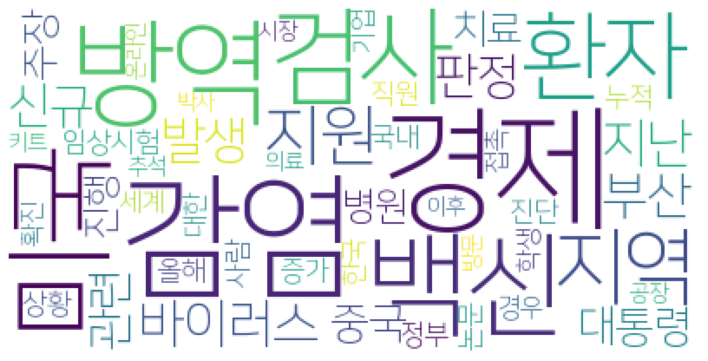

2020.09.16
['백신', '개발', '임상시험', '부작용']
['포르투갈']
['이산화탄소', '내일', '앵커', '김세현']
[]
[]
[]
['집회', '개천절', '교회']
['공장']
['바람', '태백', '풍경', '언덕', '백두대간', '매봉산', '배추', '낙동강', '구름']
[]
['공장']
['생산', '브루셀라병', '감염', '공장', '란저우', '주민', '지난해', '경향신문', '셀라', '브루', '백신']
['바이러스', '논문', '코로나바이러스', '연구소', '구진', '조작']
['총리', '대응', '메이', '영국', '협력', '한국', '대통령', '경제', '대해', '양국', '모두', '기여']
['공장']
['바이러스', '조작', '특성', '구진', '단백질', '연구소', '자연', '주장', '스파이크', '박사', '논문', '옌리멍', '발생', '코로나바이러스', '우한']
['확진', '판정', '보령', '검사', '등교']
['우한', '특성', '구진', '단백질', '바이러스', '연구소', '자연', '주장', '코로나바이러스', '스파이크', '박사', '조작', '옌리멍', '논문', '발생']
['학교', '개정안', '법안']
['방역']
['바이러스', '중국', '주장', '박사']
['노동자', '배송', '택배', '분류', '추석', '물량', '시간', '고영준']
['분류', '택배', '배송', '노동자', '추석', '물량', '시간', '고영준']
['아들']
['열차', '사실', '확진']
['신종', '코로나바이러스', '바이러스', '연구소', '구진']
['신종', '코로나바이러스', '바이러스', '연구소', '구진']
['보령', '경향신문', '등교']
['바이러스', '논문', '박사', '중국', '실험실']
['산업', '섬유', '영세', '업체', '뿌리', '업종', '국내']
['마음', '요즘', '나비']
['포럼

['확진', '치료', '종사', '관련', '병상', '시스템', '케어', '센터', '수도권', '경기도', '환자']
['미국', '당국', '백신', '사용', '긴급', '미나', '승인', '분량', '내년', '중국']
['나눔', '반려', '식물', '농협', '봉사', '제주', '직원']
[]
['환자', '렘데', '부작용', '치료', '메타', '시비르', '약물', '김수진', '저하']
['학교', '경향신문', '전략', '집단', '보건', '면역', '항체', '사망자', '스웨덴', '감염', '지난', '형성', '미국', '보유', '제기', '인구', '지난달']
['페덱스', '분기']
['회장', '사업', '위기', '국민']
['보호', '반려동물', '임시', '확진', '시민', '치료']
['서울시', '권한', '대행', '중심', '안정', '위기', '상황', '조직']
['감염병']
['시험', '수능', '올해', '평가', '응시', '모의', '정도', '접수', '입시', '오늘', '학원', '때문', '진행', '수험생', '예정', '수시']
[]
['주장', '학교', '교육', '학생', '총재', '세계', '어린이', '재개']
['귀성', '추석', '계획', '응답', '친지', '비용']
['확진', '전파', '누적', '판정', '관련', '추가', '감염', '접촉', '모임', '수도권', '가운데', '조사', '현재', '사례']
['감염병', '대응', '현장', '관리', '운영']
['검사']
['가족', '확진', '초등학교', '조사', '경남', '검사', '창녕', '현재', '접촉', '김해', '동선', '방문', '중이', '부산', '번의', '거주', '마스크', '파악', '감염', '진행', '오전', '오늘', '지난']
['홍보', '관광', '해외', '영상', '대구', '온라인', '진주']
['매장', '가전', '오프라인', 

['마스크', '설명', '감염', '각종', '정씨', '방역', '통해', '방문']
['방역']
[]
['본관']
['본관']
['시스템', '관련', '경기도', '케어', '확진', '환자', '수도권', '병상', '치료', '센터', '종사']
['현지', '홍보', '관광', '해외', '대구', '경제']
['가전', '상반기', '판매', '성장', '시장', '소형', '부문', '올해', '수요', '대비', '증가']
['개인', '정보보호', '보위', '방역', '출입', '명부', '강화', '대책', '현장', '점검', '개인정보']
['게이츠', '멀린', '정부', '질병', '확산', '미국']
['시스템', '케어', '병상', '환자', '치료', '센터']
['산업', '유치', '개발', '평가', '성과', '바이오', '혁신', '송도', '인천', '클러스터', '용지', '기존', '공구', '전략', '확대', '자유', '등급', '대한', '구역']
['가정', '시스템', '대기', '운영', '환자']
['안전', '방역', '경제', '국가', '부총리', '대응', '이데일리', '한국', '평가', '회복', '확인']
['접종']
['와리', '후유증']
['공항', '도민', '토론', '도의', '토론회', '합의']
['서울대', '장학금', '지급', '등록금', '긴급', '학생', '규모']
['논문', '바이러스', '박사', '주장', '중국', '신종', '이론', '박쥐', '자연', '실험실']
['학교']
['가운데', '감염', '환자']
['전자', '가전', '실적', '판매', '증가', '점유', '부문', '수요', '시장', '효과', '경우', '기록']
['방안', '개선', '다문화', '가정', '포럼', '가족', '연합뉴스', '지원', '실태', '정책']
['부천', '판정']
[]
[]
['구체', '상황', '감염', '추석', '교수', '

['인문학', '직원', '발전소', '포스코에너지', '소통', '강연']
['분기', '페덱스']
['경제']
['청사', '출입', '제한', '방역']
['단계', '검사', '병원', '환자', '건강', '보험', '의료', '기관', '입원', '진단', '비용']
['집회', '금지', '신고', '불법', '이하', '정부', '대해', '강행']
['출제', '평가', '학원', '모의', '시험', '영역', '종로']
['사망자', '미국', '이하', '인종', '보고서', '지적']
['사망자', '미국', '이하', '인종', '보고서', '지적']
['진단', '검사', '방역', '정부', '총괄', '대변인']
['헤럴드경제', '재학생', '학기']
['지역']
['복권', '상반기']
['복권', '상반기']
['지급', '장학금', '경향신문', '규모', '긴급']
['연휴', '명절', '방역', '시민', '발생']
['직원']
['용인']
['명절', '추석', '음식', '가루', '가족', '대신']
[]
['대통령', '트럼프', '우드워드']
['보험', '환자', '검사', '병원', '건강', '단계', '의료', '기관']
['직원', '확진']
['감소', '영업', '기업', '작년', '증가', '이익']
['브루셀라병', '중국', '란저우', '감염']
['병상', '중환자', '치료', '확보', '의료', '환자', '전담', '정부', '대변인', '총괄', '병원']
['병상', '중환자', '치료', '정부', '확보', '지정']
['택배', '노동자', '과로사', '노동', '분류']
['발생', '개발', '모델', '보험', '전염병', '평가', '팬더믹', '상품', '위험']
['확진', '관련', '누적', '감염', '추가', '발생', '집단']
[]
[]
['노컷뉴스', '의무']
['광주', '은행', '응원', '의료', '전남', '위해', '꾸러미']
['개

[]
[]
[]
[]
['누적', '부산', '신규', '지역', '경기', '관련']
[]
[]
[]
['환자', '국내', '전날']
['환자', '국내', '전날']
['직원', '노컷뉴스', '접촉', '사이언스', '근무']
[]
['시대', '고양이', '마스크', '캣츠', '객석', '무대', '관객', '장면']
[]
['백신', '임상시험', '화이자', '부작용']
['지역']
['학기', '특별', '재학생', '장학금', '남이공', '지급', '모집']
['기업', '증가', '대응', '변호사', '로펌', '올해', '법인', '회생', '법무', '분야', '대형', '자문']
[]
['화이자', '백신', '부작용', '임상시험']
['조사', '제주', '지난', '역학', '확인', '발인', '부부', '온천', '피고', '추가', '확진', '진술', '서귀포시', '고발']
['백신', '나발', '중국']
['창업', '국가', '프로그램', '투자', '유로', '정부', '기업', '지원', '파운드', '정책', '회사', '유럽', '대한', '자금', '분야', '한경비즈니스', '성장', '경제', '최대', '증가', '프랑스', '독일', '발표', '비대', '통해', '기술', '스타트업', '민간', '수요', '위기', '혁신']
['수업', '학생', '등교', '평가', '적용', '운영', '교사', '관찰', '단계']
['익산', '전북']
['사망자', '방역', '발생', '당국', '이상', '규모', '환자', '위중']
['모의', '평가', '시험', '수험생', '수능', '응시']
['관광', '기업', '사업']
['경향신문']
['에너지', '비량', '감소', '올해', '소비', '최종']
[]
['문자', '연구', '통화', '전화', '이메일', '대감', '연락']
['특별', '재학생', '장학금', '지급', '학기', '모집']
['설치', '광고', 

['화이자', '백신', '임상시험']
['백신', '화이자', '후보', '물질']
['시험', '백신', '부작용', '아스', '사례', '영국', '중단']
['가마솥', '반상', '보쌈', '메뉴', '브랜드', '보리', '굴비', '샤브', '샤브샤브', '제공', '우삼겹']
['반상', '보쌈', '가마솥', '메뉴', '브랜드', '보리', '굴비', '샤브샤브', '제공', '샤브', '우삼겹']
['개발', '백신', '항체', '러시아', '전세계', '결과', '바이오', '속도', '투여', '스푸트니크', '형성', '참여자', '대상', '발표', '미국', '물질']
['화이자', '백신']
['게이츠', '백신', '위기']
['존슨', '백신', '영국', '아스', '임상시험', '앤드', '시험']
['아스', '존슨', '백신', '영국', '임상시험', '앤드', '시험']
['지원', '상황', '회사', '생각', '면접', '사람', '변화', '질문', '요즘', '경험', '가장', '하나', '주도', '기업', '경우', '시간', '대답', '지금', '경력', '자신', '이직', '무엇', '무슨', '라면', '탈락', '이유', '대표', '방향', '관점', '철학']
['흡연', '전자담배', '과학', '연구', '코로나바이러스', '라만', '질환', '박사', '구진', '관련', '취약', '다른', '수용체', '로체스터', '발표', '영향', '사람', '바이러스']
['시설', '경북', '노인', '사망률', '전국']
['건강', '응답', '기능', '식품', '면역', '향상', '확산']
['태풍', '독감', '가을', '발생', '가능성', '단풍']
['조합', '생산', '백신', '바이오', '개발', '치료', '국내', '공장', '세계', '현재', '규모', '셀트리온', '최근', '계약', '직스', '체결', '기업', '관계자', '수탁']
[]

['지원', '회생', '개인', '캠코', '다시', '센터', '사업', '소득', '시작', '복지', '시민', '변호사', '위기', '신청']
['회생', '지원', '사업', '캠코', '다시', '개인', '시작', '위기', '복지', '센터', '통해']
['검사', '단계', '병원', '조치', '환자', '건강', '보험']
[]
[]
['지급', '규모', '장학금', '등록금', '학생', '긴급']
['앤드', '백신', '존슨', '부작용', '아스', '임상시험']
['감염', '병원', '통제']
['시장', '거래', '차량', '중고차', '셀카', '경차']
['한국', '판정', '감염', '중이', '인도네시아', '한국인', '전자', '한인', '자카르타', '동선', '현지', '귀국', '발생', '공장', '공개', '확진', '교민', '사회', '건설']
['경제']
['지급', '긴급', '규모', '장학금', '등록금', '학생', '학업']
['식품', '살균', '소독제', '살균제', '방역', '사용']
[]
['제주', '방문', '연휴', '기간', '방역', '수도권']


In [ ]:
# start date setting
s_date=datetime(2020,11,4)
for day in range(270):
    ss=day*-1
    start_date = s_date + relativedelta(days=ss)
    start_date=start_date.strftime("%Y.%m.%d")
    print((start_date))
    
    ## 특정 날짜 뉴스 dataframe
    df=xls[xls['date'].str.contains(start_date,na=False)]
    text=""
    
    ## 특정 날짜 뉴스들의 토픽 저장
    daliy_topic_list=[]
    
    ## 특정 날짜 뉴스 접근
    for index in range(len(df)):
        
        ## 뉴스 export 
        ## pre-procssing
        text=funPreplacement(str(df.iloc[index][2]))
        twitter = Twitter() 
        
        ## 명사만 추출
        morphs = twitter.nouns(text)
        #print(morphs)

        
        # model setting
        model = tp.LDAModel(k=10, alpha=0.1, eta=0.01, min_cf=4)

        model.add_doc(morphs) # tokenize함수를 이용해 전처리한 결과를 add_doc에 넣습니다.

        # model setting
        model.train(0)

        # model learning
        for i in range(200):
            #print('Iteration {}\tLL per word: {}'.format(i, model.ll_per_word))
            model.train(1)
        
        ## 기사 한개의 토픽 추출 리스트
        ## topic to text_list    
        topic_list=[]
        
        ## 기사 한개의 토픽 추출 
        ## topic export
        for k in range(model.k):
                #print('Topic #{}'.format(k))
                for word, prob in model.get_topic_words(k):
                    #print('\t', word, prob, sep='\t')
                    
                    ## 한글자 이상
                    if len(word)>=2:
                        ## 불용어 제거
                        word=stop_words(word)
                        if word !="":
                            ## 특정날짜, 특정 뉴스 토픽 저장
                            if word not in topic_list:
                                topic_list.append(word)
        
        ## 해당 뉴스의 토픽확인 
        print(topic_list)
        
        ## 날짜별 
        for text in topic_list:
            daliy_topic_list.append(text)
        
        
    print(daliy_topic_list)   
    count = Counter(daliy_topic_list)
    words = dict(count.most_common())
    wordcloud = WordCloud(font_path='C:\\Users\\You jae beom\\AppData\\Local\\Microsoft\\Windows\\Fonts\\NanumSquare_acL.ttf',background_color='white', max_words=50).generate_from_frequencies(words)
    wordcloud.to_file("D:\\ex code\\비정형데이터프로젝트\\1일간격\\{}.png".format(start_date))
    plt.figure(figsize=(10,8))
    plt.imshow(wordcloud)
    plt.tight_layout(pad=0)
    plt.axis('off')
    plt.show()
    

        

# 1주일 간격

In [ ]:
# start date setting
s_date=datetime(2020,11,4)
for day in range(270):
    if day%7==0:
        start_date=[]
        ss=day*-1
        start_date.append((s_date + relativedelta(days=ss)).strftime("%Y.%m.%d"))
    elif day%7!=0:
        ss=day*-1
        start_date.append((s_date + relativedelta(days=ss)).strftime("%Y.%m.%d"))
    if len(start_date)==7:
        print("",start_date)

        ## 특정 날짜 뉴스 dataframe
        df=xls[xls['date'].str.contains(start_date[0],na=False)| #1
              xls['date'].str.contains(start_date[1],na=False)| #2
              xls['date'].str.contains(start_date[2],na=False)| #3
              xls['date'].str.contains(start_date[3],na=False)| #4
              xls['date'].str.contains(start_date[4],na=False)| #5
              xls['date'].str.contains(start_date[5],na=False)| #6
              xls['date'].str.contains(start_date[6],na=False)] #7
        text=""
        ## 특정 날짜 뉴스들의 토픽 저장
        week_topic_list=[]

        ## 특정 날짜 뉴스 접근
        for index in range(len(df)):

            ## 뉴스 export 
            ## pre-procssing
            text=funPreplacement(str(df.iloc[index][2]))
            twitter = Twitter() 

            ## 명사만 추출
            morphs = twitter.nouns(text)
            #print(morphs)


            # model setting
            model = tp.LDAModel(k=10, alpha=0.1, eta=0.01, min_cf=4)

            model.add_doc(morphs) # tokenize함수를 이용해 전처리한 결과를 add_doc에 넣습니다.

            # model setting
            model.train(0)

            # model learning
            for i in range(200):
                #print('Iteration {}\tLL per word: {}'.format(i, model.ll_per_word))
                model.train(1)

            ## 기사 한개의 토픽 추출 리스트
            ## topic to text_list    
            topic_list=[]

            ## 기사 한개의 토픽 추출 
            ## topic export
            for k in range(model.k):
                    #print('Topic #{}'.format(k))
                    for word, prob in model.get_topic_words(k):
                        #print('\t', word, prob, sep='\t')

                        ## 한글자 이상
                        if len(word)>=2:
                            ## 불용어 제거
                            word=stop_words(word)
                            if word !="":
                                ## 특정날짜, 특정 뉴스 토픽 저장
                                if word not in topic_list:
                                    topic_list.append(word)

            ## 해당 뉴스의 토픽확인 
            print(topic_list)

            ## 날짜별 
            for text in topic_list:
                week_topic_list.append(text)


        print(week_topic_list)   
        count = Counter(week_topic_list)
        words = dict(count.most_common())
        wordcloud = WordCloud(font_path='C:\\Users\\You jae beom\\AppData\\Local\\Microsoft\\Windows\\Fonts\\NanumSquare_acL.ttf',background_color='white', max_words=50).generate_from_frequencies(words)
        wordcloud.to_file("D:\\ex code\\비정형데이터프로젝트\\1주일간격\\{}~{}.png".format(start_date[0],start_date[6]))
        plt.figure(figsize=(10,8))
        plt.imshow(wordcloud)
        plt.tight_layout(pad=0)
        plt.axis('off')
        plt.show()


# 1단간격

In [ ]:
# start date setting
s_date=datetime(2020,11,4)
for month in range(10):
    
    month_date = (s_date-relativedelta(months=month)).strftime('%Y.%m')
    ## 특정 날짜 뉴스 dataframe
    df=xls[xls['date'].str.contains(month_date,na=False)] #30
    text=""
    ## 특정 날짜 뉴스들의 토픽 저장
    month_topic_list=[]

    ## 특정 날짜 뉴스 접근
    for index in range(len(df)):

        ## 뉴스 export 
        ## pre-procssing
        text=funPreplacement(str(df.iloc[index][2]))
        twitter = Twitter() 

        ## 명사만 추출
        morphs = twitter.nouns(text)
        #print(morphs)


        # model setting
        model = tp.LDAModel(k=10, alpha=0.1, eta=0.01, min_cf=4)

        model.add_doc(morphs) # tokenize함수를 이용해 전처리한 결과를 add_doc에 넣습니다.

        # model setting
        model.train(0)

        # model learning
        for i in range(200):
            #print('Iteration {}\tLL per word: {}'.format(i, model.ll_per_word))
            model.train(1)

        ## 기사 한개의 토픽 추출 리스트
        ## topic to text_list    
        topic_list=[]

        ## 기사 한개의 토픽 추출 
        ## topic export
        for k in range(model.k):
                #print('Topic #{}'.format(k))
                for word, prob in model.get_topic_words(k):
                    #print('\t', word, prob, sep='\t')

                    ## 한글자 이상
                    if len(word)>=2:
                        ## 불용어 제거
                        word=stop_words(word)
                        if word !="":
                            ## 특정날짜, 특정 뉴스 토픽 저장
                            if word not in topic_list:
                                topic_list.append(word)

        ## 해당 뉴스의 토픽확인 
        print(topic_list)

        ## 날짜별 
        for text in topic_list:
            month_topic_list.append(text)


    print(month_topic_list)   
    count = Counter(month_topic_list)
    words = dict(count.most_common())
    wordcloud = WordCloud(font_path='C:\\Users\\You jae beom\\AppData\\Local\\Microsoft\\Windows\\Fonts\\NanumSquare_acL.ttf',background_color='white', max_words=50).generate_from_frequencies(words)
    wordcloud.to_file("D:\\ex code\\비정형데이터프로젝트\\1달간격\\{}.png".format(month_date))
    plt.figure(figsize=(10,8))
    plt.imshow(wordcloud)
    plt.tight_layout(pad=0)
    plt.axis('off')
    plt.show()

    